In [ ]:
from analysis import *

#   stuff for vol modelling
scaling = lambda x: np.abs(np.tanh((x-1)))
vol_metrics = pd.read_csv('vol_metrics.csv')

mle_all = pd.read_csv('mle_OU_ests.csv')
mle_an = pd.read_csv('mle_OU_stats.csv')

"""
#   this is just how the metrics were produced
lm_vol = sp.stats.linregress(vol_metrics['vol index'], mle_an['r_sigma'])
vol_index_regressed = lm_vol.intercept + lm_vol.slope * vol_index

vol_index_r_adjusted =(1-scaling(buy_vol_ratio)) * vol_index_regressed + scaling(buy_vol_ratio) * buy_vol_ratio
"""

#   some constants for mle estimation
def beta1(X):
    n = len(X)-1
    top = 1/n * np.sum(X[1:] * X[:-1]) - 1/(n**2) * np.sum(X[1:]) * np.sum(X[:-1])
    bottom = 1/n * np.sum(X[:-1]**2) - 1/(n**2) * (np.sum(X[1:]))**2
    return top/bottom

def beta2(X):
    n = len(X)-1
    return 1/n * np.sum(X[1:] - beta1(X)*X[:-1])/(1-beta1(X))

def beta3(X):
    b1 = beta1(X)
    b2 = beta2(X)
    n = len(X)-1

    inside = lambda x1, x0: (x1 - b1*x0 - b2 * (1-b1))**2
    inside = np.frompyfunc(inside, 2, 1)
    return 1/n * np.sum(inside(X[1:], X[:-1]))

def OU_process(dt, X0, N, theta, mu, sigma):
    X = np.zeros(N)
    X[0] = X0
    # Generate the OU process
    for t in range(1, N):
        dW = np.sqrt(dt) * np.random.normal(0, 1)
        X[t] = X[t-1] + theta * (mu - X[t-1]) * dt + sigma * dW

    return X

def mle_est(X, dt, est_mu = False):
    theta = -1/dt * np.log(beta1(X)) #  speed of mean reversion
    sigma = np.sqrt(2*theta*beta3(X)/(1-beta1(X)**2))  #    volatility
    mu = 0 if est_mu == False else beta2(X) #   mean
    return theta, mu, sigma

def bs_est(X, dt = 0.1, num = 10, est_mu = False):
    theta_mle, mu_mle, sigma_mle = mle_est(X, dt, est_mu)
    N = len(X)
    X0 = X[0]
    theta_bs = [theta_mle]
    mu_bs = [mu_mle]
    sigma_bs = [sigma_mle]

    for i in tqdm(range(num)):
        Y = OU_process(dt, X0, N, theta_bs[-1], mu_bs[-1], sigma_bs[-1])
        theta, mu, sigma = mle_est(Y, dt, est_mu)
        theta_bs.append(theta)
        mu_bs.append(mu)
        sigma_bs.append(sigma)

    theta_mean = np.mean(theta_bs)
    mu_mean = np.mean(mu_bs)
    sigma_mean = np.mean(sigma_bs)

    theta_b = 2*theta_mle - theta_mean
    mu_b = 2*mu_mle - mu_mean
    sigma_b = 2*sigma_mle - sigma_mean
    return theta_b, mu_b, sigma_b

def plot_OU_n(dt, X0, N, theta, mu, sigma):
    Y = OU_process(dt, X0, N, theta, mu, sigma)
    theta_est, mu_est, sigma_est = bs_est(Y, est_mu=True)
    theta_mle, mu_mle, sigma_mle = mle_est(Y, dt, est_mu=True)
    print(theta, mu, sigma)
    print("bootstrapped")
    print(theta_est, mu_est, sigma_est)
    print("mle")
    print(theta_mle, mu_mle, sigma_mle)

    # Plot the result
    fig, ax = plt.subplots()
    t = np.arange(0, N*dt, dt)
    ax.plot(t, Y)
    ax.axhline(y = mu, c = 'g')
    ax.set(title = r"$\mu = {0}, \theta = {1}, \sigma = {2}$".format(mu, theta, sigma), xlabel = "time", ylabel = 'X(t)', xmargin = 0)

def plot_OU(dt, X0, start, N, theta, mu, sigma, casenum):
    data = dev_from_rolling_price(td[casenum])['diff'].dropna()
    X0 = data[start]
    Y = OU_process(dt, X0, N, theta, mu, sigma)
    # Plot the result
    fig, ax = plt.subplots()
    ax.plot(data.index, data, label = 'original')
    ax.plot(data[start:].index, Y, label = 'simulated')
    ax.set(title = "OU MLE estimation vs real data, case {0}0".format(casenum), xlabel = "time", ylabel = 'X(t)', xmargin = 0)
    ax.legend()

def OU_diff(casenum, plot = True, est_mu = False, log=False):
    data = dev_from_rolling_price(td[casenum], log = log)['diff'].dropna()
    start = pos_drop_zero(to_df(pos[casenum])).index[0]

    pre_train = data[:start]
    post_train = data[start:]
    N = len(post_train)
    dt = 0.1

    theta_0, mu_0, sigma_0 = mle_est(pre_train.values, dt, est_mu)
    theta_1, mu_1, sigma_1 = mle_est(post_train.values, dt, est_mu)
    r_theta, r_mu, r_sigma = theta_1/theta_0, mu_1/mu_0 if mu_0 != 0 else 0 , sigma_1/sigma_0
    
    if plot == True:
        print("pre:", theta_0, mu_0, sigma_0)
        print("post:", theta_1, mu_1, sigma_1)
        print("ratio:", r_theta, r_mu, r_sigma)
        X0 = data[start]

        Y0 = OU_process(dt, X0, N, theta_0, mu_0, sigma_0)
        Y1 = OU_process(dt, X0, N, theta_1, mu_1, sigma_1)

        fig, ax = plt.subplots()
        ax.plot(data.index, data, label = 'original')
        ax.plot(data[start:].index, Y0, label = 'simulated (pre buy)')
        ax.plot(data[start:].index, Y1, label = 'simulated (post buy)')
        ax.set(title = "OU MLE estimation vs real data, case {0}0".format(casenum), xlabel = "time", ylabel = 'X(t)', xmargin = 0)
        ax.legend()
    else:
        cols = ['theta_0', 'theta_1', 'r_theta', 'mu_0', 'mu_1', 'r_mu', 'sigma_0', 'sigma_1', 'r_sigma']
        vals = np.array([theta_0, theta_1, r_theta, mu_0, mu_1, r_mu, sigma_0, sigma_1, r_sigma]).reshape(1, 9)
        caseid = casenum*10

        return pd.DataFrame(data=vals, columns = cols, index = [caseid])

def gof(casenum, v = False, alpha = 0.05, bs_num = 1, log = True, bins = 800, y_upper = 1.0, x_ran = 5, filter = False):
    data = dev_from_rolling_price(td[casenum], log = log)['diff'].dropna()
    start = pos_drop_zero(to_df(pos[casenum])).index[0]

    X = data[:start].values
    n = len(X)
    dt = 0.1 

    theta, mu, sigma = bs_est(X, dt, bs_num) if bs_num >0 else mle_est(X, dt)
    print(n, "| ", theta, sigma)
    emp_dist = 1/np.sqrt(0.1 * sigma**2) * (X[1:] - (1-theta * 0.1) * X[:-1]- 0.1 * theta * mu) 
    emp_dist_filtered = np.extract(np.abs(emp_dist) >= 0.05, emp_dist)
    print("prop small: ", 1- len(emp_dist_filtered)/len(emp_dist))

    def smoothed_emp_cdf(h, X):
        n = len(X)
        h_scale = lambda x: 100/(1+100*x**2)+5
        return lambda x: 1/n * np.sum(sp.stats.norm.cdf(h_scale(x) * (x-X)))
    
    smoothed_emp_cdf = np.frompyfunc(smoothed_emp_cdf(3, emp_dist),1,1)
    t = np.linspace(-5, 5, 1000)
    smoothed_pdf = 1/0.001 * (smoothed_emp_cdf(t+0.001) - smoothed_emp_cdf(t))
    #print(np.sum(smoothed_pdf)/100) makes sure that the area under pdf is approx 1

    fig, ax = plt.subplots()
    if filter == True:
        ax.hist(emp_dist_filtered, density = True, bins = bins, label = 'Empirical Distribution')
    else:
        ax.hist(emp_dist, density = True, bins = bins, label = 'Empirical Distribution')
    #ax.plot(t, smoothed_emp_cdf(t))
    ax.plot(t, smoothed_pdf, label = 'smoothed emp. dist.')
    ax.plot(t, (sp.stats.norm.pdf(t)), label = r'$Z \sim N(0, 1)$')
    ax.set(xlim = [-x_ran, x_ran], ylim = [-0, y_upper], title = 'Empirical dist. of ' + r"$\frac{1}{\sqrt{dt \sigma^2}}(X_t - (1-\theta dt)X_{t-1})$" + ' for case {0}0'.format(casenum))
    ax.legend()
    print(sp.stats.norm.fit(emp_dist), sp.stats.skew(emp_dist))
    test_stat = 1/np.sqrt(n * dt * sigma**2) * (X[-1]- X[0] + dt * theta * np.sum(X[:-1]))
    
    cf = sp.stats.norm.interval(1-alpha)
    if test_stat > cf[0] and test_stat < cf[1]:
        if v == True:
            print("the test statistic is {0} which is within the 5% conf. int. of {1}".format(test_stat, cf))
        return True
    else:
        if v == True:
            print("the test statistic is {0} which is not within the 5% conf. int. of {1}".format(test_stat, cf))
        return False

def mle_test(N, theta, sigma, bs_num = 10):
    X = OU_process(0.1, 0, N, theta, 0, sigma)
    dt = 0.1

    theta_est, mu_est, sigma_est = bs_est(X, dt, bs_num) if bs_num >0 else mle_est(X, dt)
    print("true")
    print(theta, sigma)
    
    print('est')
    print(theta_est, sigma_est)
    emp_dist = 1/np.sqrt(0.1 * sigma_est**2) * (X[1:] - (1-theta_est * 0.1) * X[:-1]- 0.1 *theta_est * mu_est) 
    t = np.linspace(-5, 5, 1000)

    fig, ax = plt.subplots()
    ax.hist(emp_dist, density = True, bins = 500, label = 'Empirical Distribution')
    ax.plot(t, sp.stats.norm.pdf(t), label = r'$Z \sim N(0, 1)$')

    print(sp.stats.norm.fit(emp_dist), sp.stats.skew(emp_dist))
    ax.set(xlim = [-5, 5], ylim = [-0, 0.5], title = 'Empirical dist. of ' + r"$\frac{1}{\sqrt{dt \sigma^2}}(X_t - (1-\theta dt)X_{t-1})$")
    ax.legend()

def gen_cdf(X, bs_num = 0, stepsize = 0.01, v = False):
    n = len(X)
    dt = 0.1 

    theta, mu, sigma = bs_est(X, dt, bs_num) if bs_num >0 else mle_est(X, dt)

    emp_dist = 1/np.sqrt(0.1 * sigma**2) * (X[1:] - (1-theta * 0.1) * X[:-1]- 0.1 * theta * mu) 

    if v == True:
        emp_dist_filtered = np.extract(np.abs(emp_dist) >= 0.05, emp_dist)

        print(n, "| ", theta, sigma)
        print("prop small: ", np.count_nonzero(np.abs(emp_dist)<=0.05)/len(emp_dist))

    smoothed_emp_cdf = lambda X: lambda x: 1/len(X) * np.sum(sp.stats.norm.cdf((100/(1+100*x**2)+5) * (x-X)))
    #h_scaling = lambda x: 100/(1+100*x**2)+5 
    
    smoothed_emp_cdf = np.frompyfunc(smoothed_emp_cdf(emp_dist),1,1)
    t = np.arange(-5, 5, stepsize)
    return t, smoothed_emp_cdf(t), theta, sigma

def OU_process_mod(dt, X0, N, theta, mu, sigma, cdf_ran, cdf):
    X = np.zeros(N)
    X[0] = X0
    # pre generate the random numbers 
    r = np.random.uniform(0, 1, size=N)
    
    # Generate the OU process
    for t in range(1, N):    
        rnum = cdf_ran[np.argmin(cdf < r[t])]
        dW = np.sqrt(dt) * rnum    
        X[t] = X[t-1] + theta * (mu - X[t-1]) * dt + sigma * dW

    return X

def OU_est(casenum, log = True, bs_num = 0, r_corrected = True, interval = 1):    
    data = dev_from_rolling_price(td[casenum], log = log, interval = interval)['diff'].dropna()
    start = pos_drop_zero(to_df(pos[casenum])).index[0]

    pre_train = data[:start]
    N = len(data) - len(pre_train) + 1
    dt = 0.1 * interval

    vol_ratio = mle_an['r_sigma'][casenum]
    pred_vol_ratio = vol_metrics['r_sigma pred.'][casenum]
    print('vol ratio: ', np.round(vol_ratio, decimals=4), ' | ', 'pred vol ratio: ', np.round(pred_vol_ratio, decimals=4))
    
    cdf_ran, cdf, theta, sigma = gen_cdf(pre_train.values, bs_num=bs_num)
    pred = OU_process_mod(dt, pre_train[-1], N, theta, 0, sigma, cdf_ran, cdf)
    pred_ratio_corrected = OU_process_mod(dt, pre_train[-1], N, theta, 0, pred_vol_ratio * sigma, cdf_ran, cdf)

    fig, ax = plt.subplots()
    ax.plot(data.index, data, label = 'true')
    ax.plot(data[start:].index, pred, label = 'predicted')
    ax.plot(data[start:].index, pred_ratio_corrected, label = 'predicted (vol corrected)')
    ax.set(xmargin = 0)
    ax.legend()

def pre_post_gof(casenum, log = True, bs_num = 0, err = False, v = False, r_corrected = True):
    data = dev_from_rolling_price(td[casenum], log = log)['diff'].dropna()
    start = pos_drop_zero(to_df(pos[casenum])).index[0]

    pre_train = data[:start]
    post_train = data[start:]
    N = len(post_train)
    dt = 0.1
    stepsize = 0.01

    cdf_ran, cdf_pre, theta_pre, sigma_pre = gen_cdf(pre_train.values, bs_num=bs_num, stepsize=stepsize, v = v)
    dummy_ran, cdf_post, theta_post, sigma_post = gen_cdf(post_train.values, bs_num=bs_num, stepsize=stepsize)

    pdf_pre = 1/stepsize * (cdf_pre[1:]-cdf_pre[:-1])
    pdf_post = 1/stepsize * (cdf_post[1:]-cdf_post[:-1])

    if r_corrected == True:
        r_sm = vol_metrics['r_sigma pred.'][casenum]
        print(r_sm)
        pdf_pre = pdf_pre / r_sm
        cdf_ran = cdf_ran * r_sm
        print(np.sum(pdf_pre) * (stepsize * r_sm))
    
    fig, (ax1, ax2) = plt.subplots(nrows = 2)
    ax1.plot(cdf_ran[1:], pdf_pre, label = 'pre')
    ax1.plot(dummy_ran[1:], pdf_post, label = 'post')

    ax2.plot(cdf_ran[1:], pdf_pre, label = 'pre')
    ax2.plot(dummy_ran[1:], pdf_post, label = 'post')
    ax1.set(xlim = [-4, 4], title = 'smoothed emp. dist. for case {0}, pre buy and post buy'.format(casenum*10))
    ax2.set(xlim = [-0.2, 0.2])
    ax2.axhline(1, c='black')
    ax1.legend()
    if r_corrected==False:
        diff = pdf_pre/pdf_post-1
        mae = 100 * np.sum(np.abs(pdf_pre - pdf_post))/np.sum(pdf_post)
        ax1.plot(cdf_ran[1:], diff, label = 'prop. diff')
        ax2.plot(cdf_ran[1:], diff, label = 'prop. diff')

        if err == True:
            return mae
        if v == True:
            print('mae (% area): ', mae)

def gen_OU_sample(casenum, log = True, N = 6000, M = 1, theoretical = False, interval = 1):
    data = dev_from_rolling_price(td[casenum], log = log, interval=interval)['diff'].dropna()
    pos_data = pos_drop_zero(to_df(pos[casenum]))
    start = pos_data.index[int((len(pos_data.index)/2))]
    train = data[:start]
    dt = 0.1 * interval

    vol_ratio = mle_an['r_sigma'][casenum]
    pred_vol_ratio = vol_metrics['r_sigma pred.'][casenum]
    print('vol ratio: ', np.round(vol_ratio, decimals=4), ' | ', 'pred vol ratio: ', np.round(pred_vol_ratio, decimals=4))
    
    cdf_ran, cdf, theta, sigma = gen_cdf(train.values, bs_num=0)
    paths = np.zeros((M, N))
    if theoretical == False:
        for i in tqdm(range(M)):
            paths[i, :] = OU_process_mod(dt, train[-1], N, theta, 0, pred_vol_ratio * sigma, cdf_ran, cdf)
    else:
        for i in tqdm(range(M)):
            paths[i, :] = OU_process(dt, train[-1], N, theta, 0, pred_vol_ratio* sigma)
    
    time_index = np.arange(0, N*dt, dt)
    return paths, time_index

Restarted Python 3.11.4

In [ ]:
from analysis import *

#   stuff for vol modelling
scaling = lambda x: np.abs(np.tanh((x-1)))
vol_metrics = pd.read_csv('vol_metrics.csv')

mle_all = pd.read_csv('mle_OU_ests.csv')
mle_an = pd.read_csv('mle_OU_stats.csv')

"""
#   this is just how the metrics were produced
lm_vol = sp.stats.linregress(vol_metrics['vol index'], mle_an['r_sigma'])
vol_index_regressed = lm_vol.intercept + lm_vol.slope * vol_index

vol_index_r_adjusted =(1-scaling(buy_vol_ratio)) * vol_index_regressed + scaling(buy_vol_ratio) * buy_vol_ratio
"""

#   some constants for mle estimation
def beta1(X):
    n = len(X)-1
    top = 1/n * np.sum(X[1:] * X[:-1]) - 1/(n**2) * np.sum(X[1:]) * np.sum(X[:-1])
    bottom = 1/n * np.sum(X[:-1]**2) - 1/(n**2) * (np.sum(X[1:]))**2
    return top/bottom

def beta2(X):
    n = len(X)-1
    return 1/n * np.sum(X[1:] - beta1(X)*X[:-1])/(1-beta1(X))

def beta3(X):
    b1 = beta1(X)
    b2 = beta2(X)
    n = len(X)-1

    inside = lambda x1, x0: (x1 - b1*x0 - b2 * (1-b1))**2
    inside = np.frompyfunc(inside, 2, 1)
    return 1/n * np.sum(inside(X[1:], X[:-1]))

def OU_process(dt, X0, N, theta, mu, sigma):
    X = np.zeros(N)
    X[0] = X0
    # Generate the OU process
    for t in range(1, N):
        dW = np.sqrt(dt) * np.random.normal(0, 1)
        X[t] = X[t-1] + theta * (mu - X[t-1]) * dt + sigma * dW

    return X

def mle_est(X, dt, est_mu = False):
    theta = -1/dt * np.log(beta1(X)) #  speed of mean reversion
    sigma = np.sqrt(2*theta*beta3(X)/(1-beta1(X)**2))  #    volatility
    mu = 0 if est_mu == False else beta2(X) #   mean
    return theta, mu, sigma

def bs_est(X, dt = 0.1, num = 10, est_mu = False):
    theta_mle, mu_mle, sigma_mle = mle_est(X, dt, est_mu)
    N = len(X)
    X0 = X[0]
    theta_bs = [theta_mle]
    mu_bs = [mu_mle]
    sigma_bs = [sigma_mle]

    for i in tqdm(range(num)):
        Y = OU_process(dt, X0, N, theta_bs[-1], mu_bs[-1], sigma_bs[-1])
        theta, mu, sigma = mle_est(Y, dt, est_mu)
        theta_bs.append(theta)
        mu_bs.append(mu)
        sigma_bs.append(sigma)

    theta_mean = np.mean(theta_bs)
    mu_mean = np.mean(mu_bs)
    sigma_mean = np.mean(sigma_bs)

    theta_b = 2*theta_mle - theta_mean
    mu_b = 2*mu_mle - mu_mean
    sigma_b = 2*sigma_mle - sigma_mean
    return theta_b, mu_b, sigma_b

def plot_OU_n(dt, X0, N, theta, mu, sigma):
    Y = OU_process(dt, X0, N, theta, mu, sigma)
    theta_est, mu_est, sigma_est = bs_est(Y, est_mu=True)
    theta_mle, mu_mle, sigma_mle = mle_est(Y, dt, est_mu=True)
    print(theta, mu, sigma)
    print("bootstrapped")
    print(theta_est, mu_est, sigma_est)
    print("mle")
    print(theta_mle, mu_mle, sigma_mle)

    # Plot the result
    fig, ax = plt.subplots()
    t = np.arange(0, N*dt, dt)
    ax.plot(t, Y)
    ax.axhline(y = mu, c = 'g')
    ax.set(title = r"$\mu = {0}, \theta = {1}, \sigma = {2}$".format(mu, theta, sigma), xlabel = "time", ylabel = 'X(t)', xmargin = 0)

def plot_OU(dt, X0, start, N, theta, mu, sigma, casenum):
    data = dev_from_rolling_price(td[casenum])['diff'].dropna()
    X0 = data[start]
    Y = OU_process(dt, X0, N, theta, mu, sigma)
    # Plot the result
    fig, ax = plt.subplots()
    ax.plot(data.index, data, label = 'original')
    ax.plot(data[start:].index, Y, label = 'simulated')
    ax.set(title = "OU MLE estimation vs real data, case {0}0".format(casenum), xlabel = "time", ylabel = 'X(t)', xmargin = 0)
    ax.legend()

def OU_diff(casenum, plot = True, est_mu = False, log=False):
    data = dev_from_rolling_price(td[casenum], log = log)['diff'].dropna()
    start = pos_drop_zero(to_df(pos[casenum])).index[0]

    pre_train = data[:start]
    post_train = data[start:]
    N = len(post_train)
    dt = 0.1

    theta_0, mu_0, sigma_0 = mle_est(pre_train.values, dt, est_mu)
    theta_1, mu_1, sigma_1 = mle_est(post_train.values, dt, est_mu)
    r_theta, r_mu, r_sigma = theta_1/theta_0, mu_1/mu_0 if mu_0 != 0 else 0 , sigma_1/sigma_0
    
    if plot == True:
        print("pre:", theta_0, mu_0, sigma_0)
        print("post:", theta_1, mu_1, sigma_1)
        print("ratio:", r_theta, r_mu, r_sigma)
        X0 = data[start]

        Y0 = OU_process(dt, X0, N, theta_0, mu_0, sigma_0)
        Y1 = OU_process(dt, X0, N, theta_1, mu_1, sigma_1)

        fig, ax = plt.subplots()
        ax.plot(data.index, data, label = 'original')
        ax.plot(data[start:].index, Y0, label = 'simulated (pre buy)')
        ax.plot(data[start:].index, Y1, label = 'simulated (post buy)')
        ax.set(title = "OU MLE estimation vs real data, case {0}0".format(casenum), xlabel = "time", ylabel = 'X(t)', xmargin = 0)
        ax.legend()
    else:
        cols = ['theta_0', 'theta_1', 'r_theta', 'mu_0', 'mu_1', 'r_mu', 'sigma_0', 'sigma_1', 'r_sigma']
        vals = np.array([theta_0, theta_1, r_theta, mu_0, mu_1, r_mu, sigma_0, sigma_1, r_sigma]).reshape(1, 9)
        caseid = casenum*10

        return pd.DataFrame(data=vals, columns = cols, index = [caseid])

def gof(casenum, v = False, alpha = 0.05, bs_num = 1, log = True, bins = 800, y_upper = 1.0, x_ran = 5, filter = False):
    data = dev_from_rolling_price(td[casenum], log = log)['diff'].dropna()
    start = pos_drop_zero(to_df(pos[casenum])).index[0]

    X = data[:start].values
    n = len(X)
    dt = 0.1 

    theta, mu, sigma = bs_est(X, dt, bs_num) if bs_num >0 else mle_est(X, dt)
    print(n, "| ", theta, sigma)
    emp_dist = 1/np.sqrt(0.1 * sigma**2) * (X[1:] - (1-theta * 0.1) * X[:-1]- 0.1 * theta * mu) 
    emp_dist_filtered = np.extract(np.abs(emp_dist) >= 0.05, emp_dist)
    print("prop small: ", 1- len(emp_dist_filtered)/len(emp_dist))

    def smoothed_emp_cdf(h, X):
        n = len(X)
        h_scale = lambda x: 100/(1+100*x**2)+5
        return lambda x: 1/n * np.sum(sp.stats.norm.cdf(h_scale(x) * (x-X)))
    
    smoothed_emp_cdf = np.frompyfunc(smoothed_emp_cdf(3, emp_dist),1,1)
    t = np.linspace(-5, 5, 1000)
    smoothed_pdf = 1/0.001 * (smoothed_emp_cdf(t+0.001) - smoothed_emp_cdf(t))
    #print(np.sum(smoothed_pdf)/100) makes sure that the area under pdf is approx 1

    fig, ax = plt.subplots()
    if filter == True:
        ax.hist(emp_dist_filtered, density = True, bins = bins, label = 'Empirical Distribution')
    else:
        ax.hist(emp_dist, density = True, bins = bins, label = 'Empirical Distribution')
    #ax.plot(t, smoothed_emp_cdf(t))
    ax.plot(t, smoothed_pdf, label = 'smoothed emp. dist.')
    ax.plot(t, (sp.stats.norm.pdf(t)), label = r'$Z \sim N(0, 1)$')
    ax.set(xlim = [-x_ran, x_ran], ylim = [-0, y_upper], title = 'Empirical dist. of ' + r"$\frac{1}{\sqrt{dt \sigma^2}}(X_t - (1-\theta dt)X_{t-1})$" + ' for case {0}0'.format(casenum))
    ax.legend()
    print(sp.stats.norm.fit(emp_dist), sp.stats.skew(emp_dist))
    test_stat = 1/np.sqrt(n * dt * sigma**2) * (X[-1]- X[0] + dt * theta * np.sum(X[:-1]))
    
    cf = sp.stats.norm.interval(1-alpha)
    if test_stat > cf[0] and test_stat < cf[1]:
        if v == True:
            print("the test statistic is {0} which is within the 5% conf. int. of {1}".format(test_stat, cf))
        return True
    else:
        if v == True:
            print("the test statistic is {0} which is not within the 5% conf. int. of {1}".format(test_stat, cf))
        return False

def mle_test(N, theta, sigma, bs_num = 10):
    X = OU_process(0.1, 0, N, theta, 0, sigma)
    dt = 0.1

    theta_est, mu_est, sigma_est = bs_est(X, dt, bs_num) if bs_num >0 else mle_est(X, dt)
    print("true")
    print(theta, sigma)
    
    print('est')
    print(theta_est, sigma_est)
    emp_dist = 1/np.sqrt(0.1 * sigma_est**2) * (X[1:] - (1-theta_est * 0.1) * X[:-1]- 0.1 *theta_est * mu_est) 
    t = np.linspace(-5, 5, 1000)

    fig, ax = plt.subplots()
    ax.hist(emp_dist, density = True, bins = 500, label = 'Empirical Distribution')
    ax.plot(t, sp.stats.norm.pdf(t), label = r'$Z \sim N(0, 1)$')

    print(sp.stats.norm.fit(emp_dist), sp.stats.skew(emp_dist))
    ax.set(xlim = [-5, 5], ylim = [-0, 0.5], title = 'Empirical dist. of ' + r"$\frac{1}{\sqrt{dt \sigma^2}}(X_t - (1-\theta dt)X_{t-1})$")
    ax.legend()

def gen_cdf(X, bs_num = 0, stepsize = 0.01, v = False):
    n = len(X)
    dt = 0.1 

    theta, mu, sigma = bs_est(X, dt, bs_num) if bs_num >0 else mle_est(X, dt)

    emp_dist = 1/np.sqrt(0.1 * sigma**2) * (X[1:] - (1-theta * 0.1) * X[:-1]- 0.1 * theta * mu) 

    if v == True:
        emp_dist_filtered = np.extract(np.abs(emp_dist) >= 0.05, emp_dist)

        print(n, "| ", theta, sigma)
        print("prop small: ", np.count_nonzero(np.abs(emp_dist)<=0.05)/len(emp_dist))

    smoothed_emp_cdf = lambda X: lambda x: 1/len(X) * np.sum(sp.stats.norm.cdf((100/(1+100*x**2)+5) * (x-X)))
    #h_scaling = lambda x: 100/(1+100*x**2)+5 
    
    smoothed_emp_cdf = np.frompyfunc(smoothed_emp_cdf(emp_dist),1,1)
    t = np.arange(-5, 5, stepsize)
    return t, smoothed_emp_cdf(t), theta, sigma

def OU_process_mod(dt, X0, N, theta, mu, sigma, cdf_ran, cdf):
    X = np.zeros(N)
    X[0] = X0
    # pre generate the random numbers 
    r = np.random.uniform(0, 1, size=N)
    
    # Generate the OU process
    for t in range(1, N):    
        rnum = cdf_ran[np.argmin(cdf < r[t])]
        dW = np.sqrt(dt) * rnum    
        X[t] = X[t-1] + theta * (mu - X[t-1]) * dt + sigma * dW

    return X

def OU_est(casenum, log = True, bs_num = 0, r_corrected = True, interval = 1):    
    data = dev_from_rolling_price(td[casenum], log = log, interval = interval)['diff'].dropna()
    start = pos_drop_zero(to_df(pos[casenum])).index[0]

    pre_train = data[:start]
    N = len(data) - len(pre_train) + 1
    dt = 0.1 * interval

    vol_ratio = mle_an['r_sigma'][casenum]
    pred_vol_ratio = vol_metrics['r_sigma pred.'][casenum]
    print('vol ratio: ', np.round(vol_ratio, decimals=4), ' | ', 'pred vol ratio: ', np.round(pred_vol_ratio, decimals=4))
    
    cdf_ran, cdf, theta, sigma = gen_cdf(pre_train.values, bs_num=bs_num)
    pred = OU_process_mod(dt, pre_train[-1], N, theta, 0, sigma, cdf_ran, cdf)
    pred_ratio_corrected = OU_process_mod(dt, pre_train[-1], N, theta, 0, pred_vol_ratio * sigma, cdf_ran, cdf)

    fig, ax = plt.subplots()
    ax.plot(data.index, data, label = 'true')
    ax.plot(data[start:].index, pred, label = 'predicted')
    ax.plot(data[start:].index, pred_ratio_corrected, label = 'predicted (vol corrected)')
    ax.set(xmargin = 0)
    ax.legend()

def pre_post_gof(casenum, log = True, bs_num = 0, err = False, v = False, r_corrected = True):
    data = dev_from_rolling_price(td[casenum], log = log)['diff'].dropna()
    start = pos_drop_zero(to_df(pos[casenum])).index[0]

    pre_train = data[:start]
    post_train = data[start:]
    N = len(post_train)
    dt = 0.1
    stepsize = 0.01

    cdf_ran, cdf_pre, theta_pre, sigma_pre = gen_cdf(pre_train.values, bs_num=bs_num, stepsize=stepsize, v = v)
    dummy_ran, cdf_post, theta_post, sigma_post = gen_cdf(post_train.values, bs_num=bs_num, stepsize=stepsize)

    pdf_pre = 1/stepsize * (cdf_pre[1:]-cdf_pre[:-1])
    pdf_post = 1/stepsize * (cdf_post[1:]-cdf_post[:-1])

    if r_corrected == True:
        r_sm = vol_metrics['r_sigma pred.'][casenum]
        print(r_sm)
        pdf_pre = pdf_pre / r_sm
        cdf_ran = cdf_ran * r_sm
        print(np.sum(pdf_pre) * (stepsize * r_sm))
    
    fig, (ax1, ax2) = plt.subplots(nrows = 2)
    ax1.plot(cdf_ran[1:], pdf_pre, label = 'pre')
    ax1.plot(dummy_ran[1:], pdf_post, label = 'post')

    ax2.plot(cdf_ran[1:], pdf_pre, label = 'pre')
    ax2.plot(dummy_ran[1:], pdf_post, label = 'post')
    ax1.set(xlim = [-4, 4], title = 'smoothed emp. dist. for case {0}, pre buy and post buy'.format(casenum*10))
    ax2.set(xlim = [-0.2, 0.2])
    ax2.axhline(1, c='black')
    ax1.legend()
    if r_corrected==False:
        diff = pdf_pre/pdf_post-1
        mae = 100 * np.sum(np.abs(pdf_pre - pdf_post))/np.sum(pdf_post)
        ax1.plot(cdf_ran[1:], diff, label = 'prop. diff')
        ax2.plot(cdf_ran[1:], diff, label = 'prop. diff')

        if err == True:
            return mae
        if v == True:
            print('mae (% area): ', mae)

def gen_OU_sample(casenum, log = True, N = 6000, M = 1, theoretical = False, interval = 1):
    data = dev_from_rolling_price(td[casenum], log = log, interval=interval)['diff'].dropna()
    pos_data = pos_drop_zero(to_df(pos[casenum]))
    start = pos_data.index[int((len(pos_data.index)/2))]
    train = data[:start]
    dt = 0.1 * interval

    vol_ratio = mle_an['r_sigma'][casenum]
    pred_vol_ratio = vol_metrics['r_sigma pred.'][casenum]
    print('vol ratio: ', np.round(vol_ratio, decimals=4), ' | ', 'pred vol ratio: ', np.round(pred_vol_ratio, decimals=4))
    
    cdf_ran, cdf, theta, sigma = gen_cdf(train.values, bs_num=0)
    paths = np.zeros((M, N))
    if theoretical == False:
        for i in tqdm(range(M)):
            paths[i, :] = OU_process_mod(dt, train[-1], N, theta, 0, pred_vol_ratio * sigma, cdf_ran, cdf)
    else:
        for i in tqdm(range(M)):
            paths[i, :] = OU_process(dt, train[-1], N, theta, 0, pred_vol_ratio* sigma)
    
    time_index = np.arange(0, N*dt, dt)
    return paths, time_index

In [ ]:
from optimal_stopping_times import *
buy_p = np.zeros(523)
sell_p = np.zeros(523)
for i in (range(523)):
    td_c = td[i]
    pos_c = pos[i]
    print(i)

    pos_data = pos_drop_zero(to_df(pos[i]))
    start = pos_data.index[int(np.round(len(pos_data.index)/2))]
    stop = start + get_opt_stopping_time(i, 10, 2, 15, v=False) * 10
    buy_p[i] = td['ask_p1'][int(np.round(len(pos_data.index)/2))]
    sell_p[i] = td['bid_p1'][int(stop)]

0
generating samples
vol ratio:  0.7694  |  pred vol ratio:  0.8109


100%|██████████| 10/10 [00:00<00:00, 21.57it/s]


ValueError: The truth value of an array with more than one element is ambiguous. Use a.any() or a.all()

In [ ]:
from optimal_stopping_times import *
buy_p = np.zeros(523)
sell_p = np.zeros(523)
for i in (range(523)):
    td_c = td[i]
    pos_c = pos[i]
    print(i)

    pos_data = pos_drop_zero(to_df(pos[i]))
    start = pos_data.index[int(np.round(len(pos_data.index)/2))]
    stop = start + get_opt_stopping_time(i, 10, 2, 15) * 10
    buy_p[i] = td['ask_p1'][int(np.round(len(pos_data.index)/2))]
    sell_p[i] = td['bid_p1'][int(stop)]

0
generating samples
vol ratio:  0.7694  |  pred vol ratio:  0.8109


100%|██████████| 10/10 [00:00<00:00, 22.08it/s]


ValueError: The truth value of an array with more than one element is ambiguous. Use a.any() or a.all()

Restarted Python 3.11.4

In [ ]:
from optimal_stopping_times import *
buy_p = np.zeros(523)
sell_p = np.zeros(523)
for i in (range(523)):
    td_c = td[i]
    pos_c = pos[i]
    print(i)

    pos_data = pos_drop_zero(to_df(pos[i]))
    start = pos_data.index[int(np.round(len(pos_data.index)/2))]
    stop = start + get_opt_stopping_time(i, 10, 2, 15) * 10
    buy_p[i] = td['ask_p1'][int(np.round(len(pos_data.index)/2))]
    sell_p[i] = td['bid_p1'][int(stop)]

0
generating samples
vol ratio:  0.7694  |  pred vol ratio:  0.8109


100%|██████████| 10/10 [00:00<00:00, 21.75it/s]


TypeError: loss_minimisation() got an unexpected keyword argument 'v'

In [ ]:
from optimal_stopping_times import *
buy_p = np.zeros(523)
sell_p = np.zeros(523)
for i in (range(523)):
    td_c = td[i]
    pos_c = pos[i]
    print(i)

    pos_data = pos_drop_zero(to_df(pos[i]))
    start = pos_data.index[int(np.round(len(pos_data.index)/2))]
    stop = start + get_opt_stopping_time(i, 10, 2, 15) * 10
    buy_p[i] = td['ask_p1'][int(np.round(len(pos_data.index)/2))]
    sell_p[i] = td['bid_p1'][int(stop)]

0
generating samples
vol ratio:  0.7694  |  pred vol ratio:  0.8109


100%|██████████| 10/10 [00:00<00:00, 22.46it/s]


TypeError: loss_minimisation() got an unexpected keyword argument 'v'

Restarted Python 3.11.4

In [ ]:
from optimal_stopping_times import *
buy_p = np.zeros(523)
sell_p = np.zeros(523)
for i in (range(523)):
    td_c = td[i]
    pos_c = pos[i]
    print(i)

    pos_data = pos_drop_zero(to_df(pos[i]))
    start = pos_data.index[int(np.round(len(pos_data.index)/2))]
    stop = start + get_opt_stopping_time(i, 10, 2, 15) * 10
    buy_p[i] = td['ask_p1'][int(np.round(len(pos_data.index)/2))]
    sell_p[i] = td['bid_p1'][int(stop)]

0
generating samples
vol ratio:  0.7694  |  pred vol ratio:  0.8109


100%|██████████| 10/10 [00:00<00:00, 21.91it/s]


3.2615431197009166e-06


100%|██████████| 120/120 [00:07<00:00, 16.30it/s]


ValueError: The truth value of an array with more than one element is ambiguous. Use a.any() or a.all()

Restarted Python 3.11.4

In [ ]:
from optimal_stopping_times import * 

def loss(l):
        #   inner product between l and signatures 
        in_prod = np.apply_along_axis(lambda x: np.inner(l, x), -1, partial_sigs)
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = np.apply_along_axis(np.cumsum, -1, sig_dist)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+np.exp(-20*(x-k)))
        partial_cdf_sums = np.apply_along_axis(G, -1, partial_sig_dist_sum)
        losses = np.einsum('ij, ij -> i', payoffs, partial_cdf_sums)

        return -np.mean(losses)

def grad(l):
    #   inner product between l and signatures 
    in_prod = np.apply_along_axis(lambda x: np.inner(l, x), -1, partial_sigs)
    #   inner prod squared
    sig_dist = in_prod**2

    #   partial sums of square of inner prod for increasing time M x (N-1)
    partial_sig_dist_sum = np.apply_along_axis(np.cumsum, -1, sig_dist)

    G_dash = lambda x: 20 * (1 + np.exp(-20*(x-k)))**(-2)
    #   partial signatures squared, M x (N-1) x (siglen+1)
    partial_sig_sq = partial_sigs**2

    #   cum sum of partial signatures in l_k, sum_{i=0}^j (X_i)k^2, M x (N-1) x (siglen+1)
    ps_sig_dist_cum =  np.apply_along_axis(np.cumsum, 1, partial_sig_sq)

    #   G'(sum over i (inner(l, x_i))), M x (N-1)
    partial_pdf_sums = np.apply_along_axis(G_dash, -1, partial_sig_dist_sum)

    #   (Y_j+1 - Y_j) * G'(sum), M x (N-1)
    partial_payoff_scaled = payoffs * partial_pdf_sums

    #   putting it together, M x (siglen + 1)
    grad_summed = np.einsum('ijk, ij -> ik',  2*ps_sig_dist_cum, partial_payoff_scaled)
    return -np.mean(grad_summed, axis=0) * l

def adam_opt(lr_max = 0.05, betas = (0, 0.2), eps = 1e-8, restart = 80, layers = 500):
    learn_rate = lambda T: 0.00005 + 1/2 * (lr_max - 0.00005) * (1 + np.cos((T % restart)/restart * np.pi))

    n = partial_sigs.shape[2]
    m = np.zeros(n)
    v = np.zeros(n)

    b1 = betas[0]
    b2 = betas[1]

    losses = np.zeros(layers)
    params = np.zeros((layers, n))

    l = np.random.normal(size=n)
    print(loss(l))

    def adm_update(m_prev, v_prev, l, t):
        lr = learn_rate(t)
        g = grad(l)
        m = b1 * m_prev + (1-b1)*g
        v = b2 * v_prev + (1-b2) * g**2

        m_hat = m/(1-b1**(t+1))
        v_hat = v/(1-b2**(t+1))

        l_opt = l - lr * m_hat / (np.sqrt(v_hat) + eps)
        return l_opt, m, v
    
    for t in tqdm(range(layers)):
        l, m, v = adm_update(m, v, l, t)
        cur_loss = loss(l)
        if abs(cur_loss) <= 1e-8:
            m = 0
            v = 0
            l = l + np.random.normal(scale = 0.5, size = len(l))
        
        losses[t] = cur_loss
        params[t, :] = l

    l_min = np.argmin(losses)
    plt.plot(np.arange(len(losses)), losses)
    return params[l_min, :]
    
"""partial_sigs, payoffs = gen_partial_sigs(100, 12, 2, theoretical=False)

k = 5

l_opt, losses = adam_opt(layers=100, restart = 80)
print(l_opt)
print(losses[-1])"""

'partial_sigs, payoffs = gen_partial_sigs(100, 12, 2, theoretical=False)\n\nk = 5\n\nl_opt, losses = adam_opt(layers=100, restart = 80)\nprint(l_opt)\nprint(losses[-1])'

0
generating samples
vol ratio:  0.7694  |  pred vol ratio:  0.8109


100%|██████████| 10/10 [00:00<00:00, 22.45it/s]


0.0001673384204125528


100%|██████████| 120/120 [00:07<00:00, 16.47it/s]


-0.000403830256195757
[-1.23507459e-04 -1.17662053e-04  1.59044807e-05  1.17399885e-04
 -1.17747490e-04  1.19726767e-04 -4.66313133e-01]


TypeError: unsupported operand type(s) for +: 'Timestamp' and 'float'

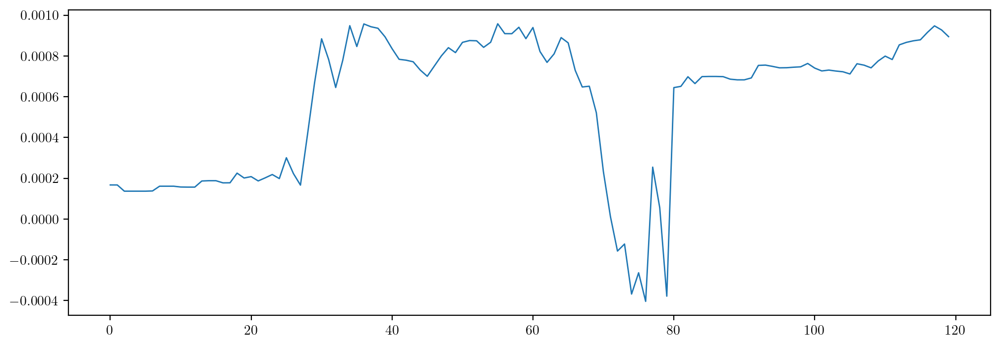

In [ ]:
from optimal_stopping_times import *
buy_p = np.zeros(523)
sell_p = np.zeros(523)
for i in (range(523)):
    td_c = td[i]
    pos_c = pos[i]
    print(i)

    pos_data = pos_drop_zero(to_df(pos[i]))
    start = pos_data.index[int(np.round(len(pos_data.index)/2))]
    stop = start + get_opt_stopping_time(i, 10, 2, 15) * 10
    buy_p[i] = td['ask_p1'][int(np.round(len(pos_data.index)/2))]
    sell_p[i] = td['bid_p1'][int(stop)]

0
generating samples
vol ratio:  0.7694  |  pred vol ratio:  0.8109


100%|██████████| 10/10 [00:00<00:00, 22.04it/s]


-3.178568878184654e-05


 88%|████████▊ | 106/120 [00:06<00:00, 16.21it/s]

soft restart
soft restart


100%|██████████| 120/120 [00:07<00:00, 15.98it/s]

-0.00011298180440552851
[ 1.74749988 -0.28848939 -1.17435703 -0.11866685  0.02176931  0.02177089
 -0.78192235]


TypeError: list indices must be integers or slices, not str

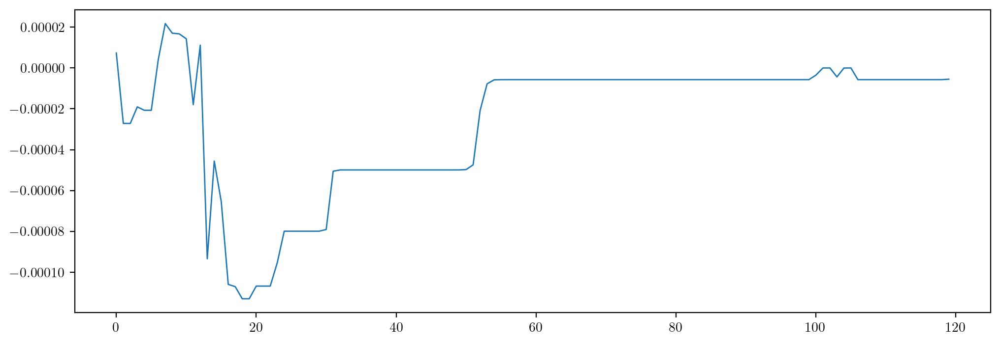

In [ ]:
from optimal_stopping_times import *
buy_p = np.zeros(523)
sell_p = np.zeros(523)
for i in (range(523)):
    td_c = td[i]
    pos_c = pos[i]
    print(i)

    pos_data = pos_drop_zero(to_df(pos[i]))
    start = pos_data.index[int(np.round(len(pos_data.index)/2))]
    stop = int(np.round(len(pos_data.index)/2)) + get_opt_stopping_time(i, 10, 2, 15) * 10
    buy_p[i] = td['ask_p1'][int(np.round(len(pos_data.index)/2))]
    sell_p[i] = td['bid_p1'][int(stop)]

0
generating samples
vol ratio:  0.7694  |  pred vol ratio:  0.8109


100%|██████████| 10/10 [00:00<00:00, 22.17it/s]


8.429388695076697e-05


 85%|████████▌ | 102/120 [00:06<00:01, 16.04it/s]

soft restart


 93%|█████████▎| 112/120 [00:06<00:00, 15.92it/s]

soft restart
soft restart


100%|██████████| 120/120 [00:07<00:00, 16.02it/s]

-2.5616386386554096e-05
[ 2.68658575 -1.4233493  -0.01678146 -1.98209278 -1.72401717  0.01648556
 -1.14199879]


TypeError: list indices must be integers or slices, not str

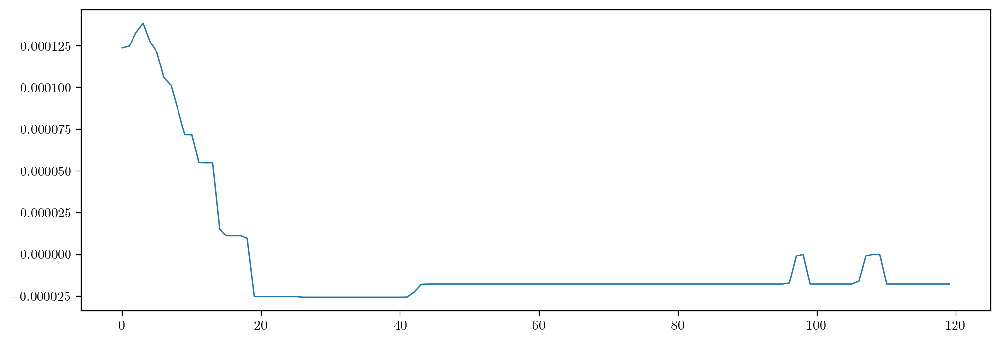

In [ ]:
from optimal_stopping_times import *
buy_p = np.zeros(523)
sell_p = np.zeros(523)
for i in (range(523)):
    td_c = td[i]
    pos_c = pos[i]
    print(i)

    pos_data = pos_drop_zero(to_df(pos[i]))
    start = pos_data.index[int(np.round(len(pos_data.index)/2))]
    stop = int(np.round(len(pos_data.index)/2)) + get_opt_stopping_time(i, 10, 2, 15) * 10
    buy_p[i] = td['ask_p1'][int((len(pos_data.index)/2))]
    sell_p[i] = td['bid_p1'][int(stop)]

0
8
generating samples
vol ratio:  0.7694  |  pred vol ratio:  0.8109


100%|██████████| 10/10 [00:00<00:00, 21.81it/s]


-0.0001674239821558753


100%|██████████| 120/120 [00:07<00:00, 16.05it/s]

-0.000398414097289927
[-1.57116488e-05  1.57451729e-05  4.85384898e-07 -1.44334406e-05
 -1.48518371e-05 -3.05059664e-01 -5.53237583e-01]


TypeError: list indices must be integers or slices, not str

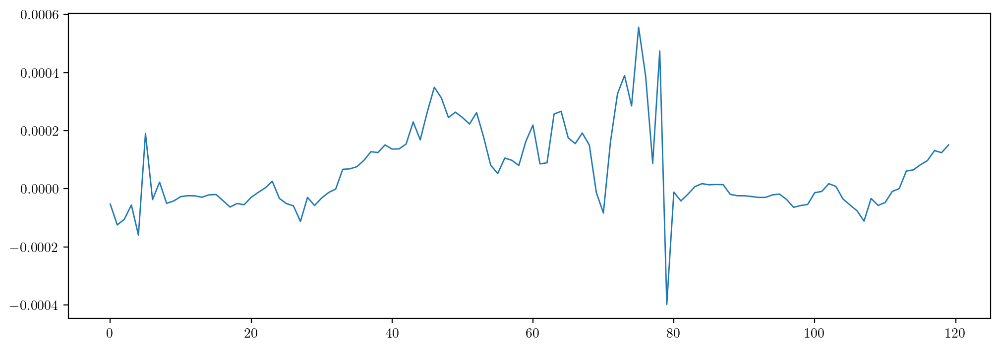

In [ ]:
from optimal_stopping_times import *
buy_p = np.zeros(523)
sell_p = np.zeros(523)
for i in (range(523)):
    td_c = td[i]
    pos_c = pos[i]
    print(i)

    pos_data = pos_drop_zero(to_df(pos[i]))
    start = pos_data.index[int(np.round(len(pos_data.index)/2))]
    start_ind = int(len(pos_data.index)/2)
    print(start_ind)
    stop_ind = start_ind + get_opt_stopping_time(i, 10, 2, 15) * 10
    buy_p[i] = td['ask_p1'][start_ind]
    sell_p[i] = td['bid_p1'][int(stop_ind)]

0
generating samples
vol ratio:  0.7694  |  pred vol ratio:  0.8109


100%|██████████| 10/10 [00:00<00:00, 21.86it/s]


-3.085217617452142e-06


 93%|█████████▎| 112/120 [00:06<00:00, 16.14it/s]

soft restart
soft restart
soft restart
soft restart


 97%|█████████▋| 116/120 [00:07<00:00, 16.09it/s]

soft restart
soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:07<00:00, 16.05it/s]

soft restart
soft restart
soft restart
soft restart
-8.86329515567795e-06
[ 0.12948855  2.09763298 -1.16067528  0.36294103  0.4930175  -0.29860465
 -0.93298283]
2024-06-10 16:10:58.300000


TypeError: list indices must be integers or slices, not str

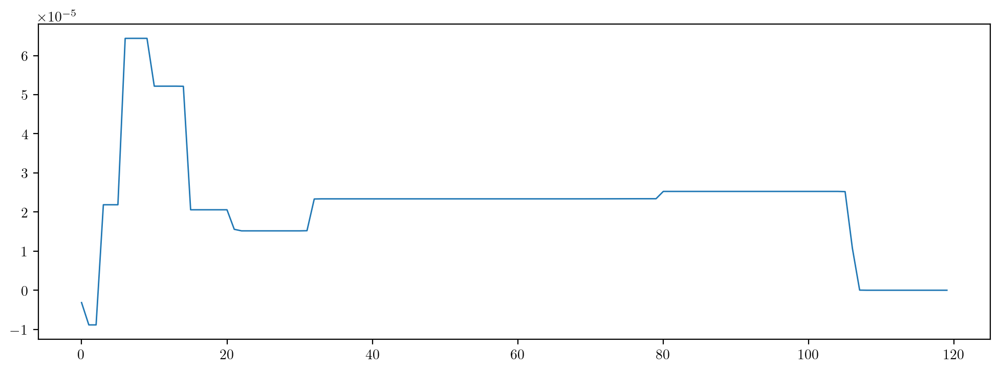

In [ ]:
from optimal_stopping_times import *
buy_p = np.zeros(523)
sell_p = np.zeros(523)
for i in (range(523)):
    td_c = td[i]
    pos_c = pos[i]
    print(i)

    pos_data = pos_drop_zero(to_df(pos[i]))
    start = pos_data.index[int(np.round(len(pos_data.index)/2))]
    stop = start + timedelta(seconds = get_opt_stopping_time(i, 10, 2, 15) * 10)
    print(stop)
    buy_p[i] = td['ask_p1'][start_ind]
    sell_p[i] = td['bid_p1'][int(stop_ind)]

0
generating samples
vol ratio:  0.7694  |  pred vol ratio:  0.8109


100%|██████████| 10/10 [00:00<00:00, 21.61it/s]


0.00010600517974206098


100%|██████████| 120/120 [00:07<00:00, 16.13it/s]

-0.0004181610114302699
[ 1.92641479e-04  1.89543842e-04 -3.78018048e-02 -1.89448949e-04
 -1.89415752e-04 -1.89235040e-04  9.55372511e-01]
2024-06-10 16:00:04.300000
2024-06-10 16:11:05.300000


TypeError: list indices must be integers or slices, not str

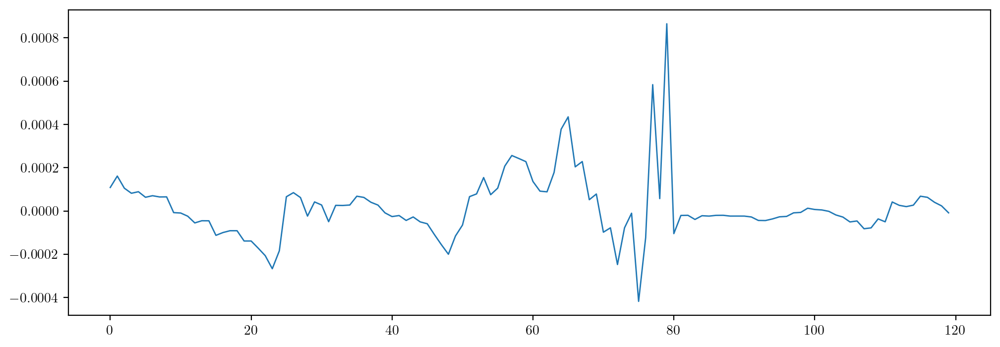

In [ ]:
from optimal_stopping_times import *
buy_p = np.zeros(523)
sell_p = np.zeros(523)
for i in (range(523)):
    td_c = td[i]
    pos_c = pos[i]
    print(i)

    pos_data = pos_drop_zero(to_df(pos[i]))
    start = pos_data.index[int(np.round(len(pos_data.index)/2))]
    stop = start + timedelta(seconds = get_opt_stopping_time(i, 10, 2, 15) * 10)
    print(start)
    print(stop)
    buy_p[i] = td['ask_p1'][start]
    sell_p[i] = td['bid_p1'][stop]

0
generating samples
vol ratio:  0.7694  |  pred vol ratio:  0.8109


100%|██████████| 10/10 [00:00<00:00, 22.51it/s]


7.713287394471157e-05


100%|██████████| 120/120 [00:07<00:00, 16.15it/s]

-0.00074766802795394
[-2.76915991e-05 -2.98911371e-05 -1.27961426e-06 -3.01740361e-05
  3.12471787e-05 -3.21124369e-05  7.89062933e-01]
2024-06-10 16:00:04.300000
2024-06-10 16:13:36.300000


TypeError: list indices must be integers or slices, not str

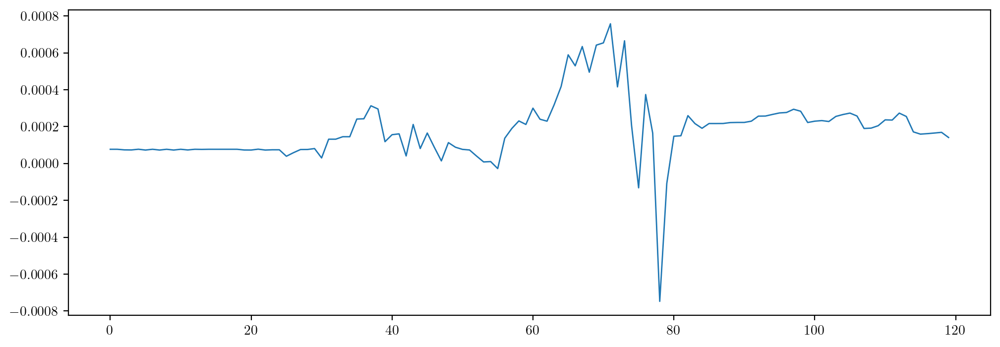

In [ ]:
from optimal_stopping_times import *
buy_p = np.zeros(523)
sell_p = np.zeros(523)
for i in (range(523)):
    td_c = td[i]
    pos_c = pos[i]
    print(i)

    pos_data = pos_drop_zero(to_df(pos[i]))
    start = pos_data.index[int(np.round(len(pos_data.index)/2))]
    stop = start + timedelta(seconds = get_opt_stopping_time(i, 10, 2, 15) * 10)
    print(start)
    print(stop)
    buy_p[i] = td['ask_p1'].at_time(start)
    sell_p[i] = td['bid_p1'].at_time(stop)

0
generating samples
vol ratio:  0.7694  |  pred vol ratio:  0.8109


100%|██████████| 10/10 [00:00<00:00, 22.38it/s]


-1.3748477505433185e-05


100%|██████████| 120/120 [00:07<00:00, 15.89it/s]

-0.0006034008487513664
[ 0.00283421  0.00277523  0.00239279 -0.00277513  0.00277517 -0.00277722
  0.26977684]
2024-06-10 16:00:04.300000
2024-06-10 16:04:22.300000


TypeError: string indices must be integers, not 'str'

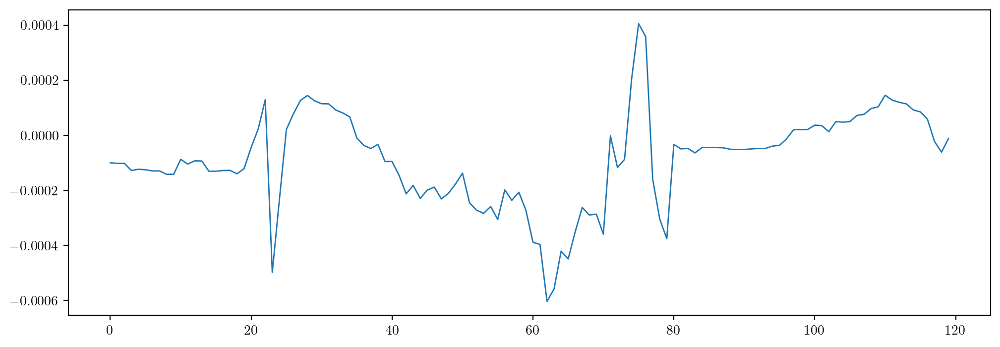

In [ ]:
from optimal_stopping_times import *
buy_p = np.zeros(523)
sell_p = np.zeros(523)
for i in (range(523)):
    td_c = td[i]
    pos_c = pos[i]
    print(i)

    pos_data = pos_drop_zero(to_df(pos[i]))
    start = pos_data.index[int(np.round(len(pos_data.index)/2))]
    stop = start + timedelta(seconds = get_opt_stopping_time(i, 10, 2, 15) * 10)
    print(start)
    print(stop)
    buy_p[i] = td_c['ask_p1'].at_time(start)
    sell_p[i] = td_c['bid_p1'].at_time(stop)

0
generating samples
vol ratio:  0.7694  |  pred vol ratio:  0.8109


100%|██████████| 10/10 [00:00<00:00, 22.82it/s]


-2.9644679190459428e-05


100%|██████████| 120/120 [00:07<00:00, 16.21it/s]

-0.0002412301526135318
[-1.21632145e-04 -1.17508018e-04  8.82378302e-05 -1.17390102e-04
  1.17433218e-04 -1.17511881e-04 -2.83822158e-01]
2024-06-10 16:00:04.300000
2024-06-10 16:07:56.300000


TypeError: string indices must be integers, not 'str'

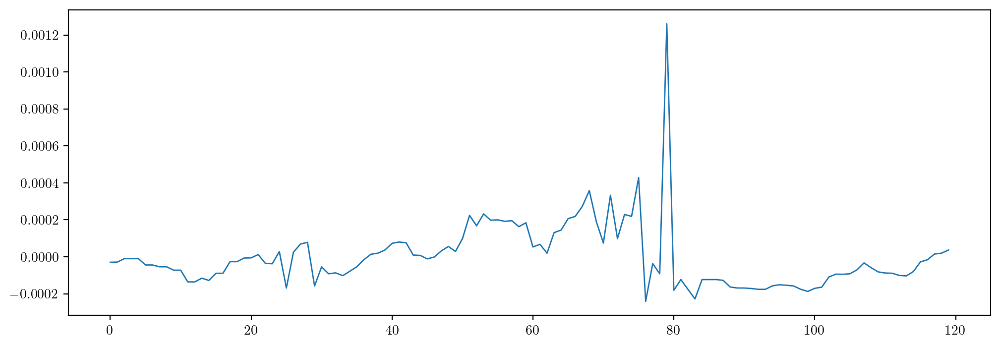

In [ ]:
from optimal_stopping_times import *
buy_p = np.zeros(523)
sell_p = np.zeros(523)
for i in (range(523)):
    td_c = td[i]
    pos_c = pos[i]
    print(i)

    pos_data = pos_drop_zero(to_df(pos[i]))
    start = pos_data.index[int(np.round(len(pos_data.index)/2))]
    stop = start + timedelta(seconds = get_opt_stopping_time(i, 10, 2, 15) * 10)
    print(start)
    print(stop)
    buy_p[i] = td_c['ask_p1'].at_time(start.time)
    sell_p[i] = td_c['bid_p1'].at_time(stop.time)

0
generating samples
vol ratio:  0.7694  |  pred vol ratio:  0.8109


100%|██████████| 10/10 [00:00<00:00, 22.16it/s]


3.4217408918689973e-05


 80%|████████  | 96/120 [00:05<00:01, 16.16it/s]

soft restart
soft restart
soft restart
soft restart


 83%|████████▎ | 100/120 [00:06<00:01, 16.20it/s]

soft restart
soft restart
soft restart
soft restart


 87%|████████▋ | 104/120 [00:06<00:00, 16.09it/s]

soft restart
soft restart


 90%|█████████ | 108/120 [00:06<00:00, 16.05it/s]

soft restart
soft restart
soft restart


 93%|█████████▎| 112/120 [00:06<00:00, 16.02it/s]

soft restart
soft restart
soft restart
soft restart


 97%|█████████▋| 116/120 [00:07<00:00, 15.88it/s]

soft restart
soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:07<00:00, 16.26it/s]

soft restart
soft restart
soft restart
-5.026891803095626e-05
[-1.59081028 -1.81148779 -2.22865825 -1.16666432  1.39851188  1.00293303
  0.91347821]
2024-06-10 16:00:04.300000
2024-06-10 16:08:35.300000


TypeError: string indices must be integers, not 'str'

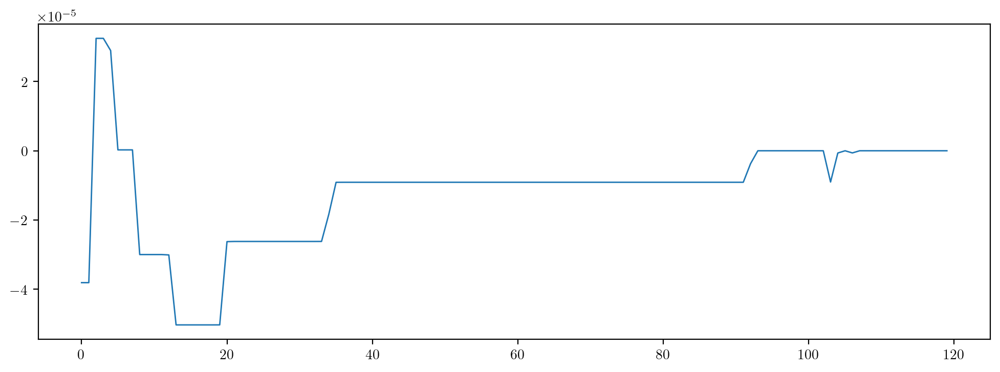

In [ ]:
from optimal_stopping_times import *
buy_p = np.zeros(523)
sell_p = np.zeros(523)
for i in range(523):
    td_c = td[i]
    pos_c = pos[i]
    print(i)

    pos_data = pos_drop_zero(to_df(pos[i]))
    start = pos_data.index[int(np.round(len(pos_data.index)/2))]
    stop = start + timedelta(seconds = get_opt_stopping_time(i, 10, 2, 15) * 10)
    print(start)
    print(stop)
    buy_p[int(i)] = td_c['ask_p1'].at_time(start.time)
    sell_p[int(i)] = td_c['bid_p1'].at_time(stop.time)

In [ ]:
from optimal_stopping_times import *
buy_p = np.zeros(523)
sell_p = np.zeros(523)
for i in range(523):
    td_c = td[i]
    pos_c = pos[i]
    print(i)
    

    pos_data = pos_drop_zero(to_df(pos[i]))
    start = pos_data.index[int(np.round(len(pos_data.index)/2))]
    print(start)
    print(td_c.at_time[start])
    stop = start + timedelta(seconds = get_opt_stopping_time(i, 10, 2, 15) * 10)
    print(stop)
    buy_p[i] = td_c['ask_p1'].at_time(start.time)
    sell_p[int(i)] = td_c['bid_p1'].at_time(stop.time)

0
2024-06-10 16:00:04.300000


AttributeError: 'numpy.str_' object has no attribute 'at_time'

In [ ]:
from optimal_stopping_times import *
buy_p = np.zeros(523)
sell_p = np.zeros(523)
for i in range(523):
    td_c = to_df(td[i])
    pos_c = to_df(pos[i])
    print(i)
    
    start = pos_c.index[int(np.round(len(pos_data.index)/2))]
    print(start)
    print(td_c.at_time[start])
    stop = start + timedelta(seconds = get_opt_stopping_time(i, 10, 2, 15) * 10)
    print(stop)
    buy_p[i] = td_c['ask_p1'].at_time(start.time)
    sell_p[int(i)] = td_c['bid_p1'].at_time(stop.time)

0
2024-06-10 16:00:04.300000


TypeError: 'method' object is not subscriptable

0
2024-06-10 16:00:04.300000
                         bid_p1  bid_v1  bid_p2  bid_v2  bid_p3  bid_v3  \
timestamp                                                                 
2024-06-10 16:00:04.300 0.01298   11577 0.01298   40240 0.01298  102149   

                         bid_p4  bid_v4  bid_p5   bid_v5  ...  ask_tt_volume  \
timestamp                                                 ...                  
2024-06-10 16:00:04.300 0.01298    3271 0.01298  3195915  ...         683582   

                         first_trade_id  last_trade_id   mid_p    ret1m  \
timestamp                                                                 
2024-06-10 16:00:04.300       804941946      804941976 0.01298 -0.00366   

                           ret5m   ret10m   ret15m   ret30m   ret60m  
timestamp                                                             
2024-06-10 16:00:04.300 -0.00857 -0.01463 -0.01349 -0.01530 -0.01189  

[1 rows x 53 columns]
generating samples
vol ratio:  0.7694  |  

100%|██████████| 10/10 [00:00<00:00, 22.26it/s]


4.567917234479169e-05


 78%|███████▊  | 94/120 [00:05<00:01, 15.98it/s]

soft restart
soft restart
soft restart
soft restart


 82%|████████▏ | 98/120 [00:06<00:01, 15.99it/s]

soft restart
soft restart
soft restart
soft restart


 95%|█████████▌| 114/120 [00:07<00:00, 15.74it/s]

soft restart
soft restart
soft restart


 98%|█████████▊| 118/120 [00:07<00:00, 16.00it/s]

soft restart


100%|██████████| 120/120 [00:07<00:00, 15.85it/s]


-0.0
[ 4.7077347   2.84355637 -2.71894854  3.46019148 -0.63396695  3.610039
  0.61015244]
2024-06-10 16:09:12.300000


AttributeError: 'builtin_function_or_method' object has no attribute 'tzinfo'

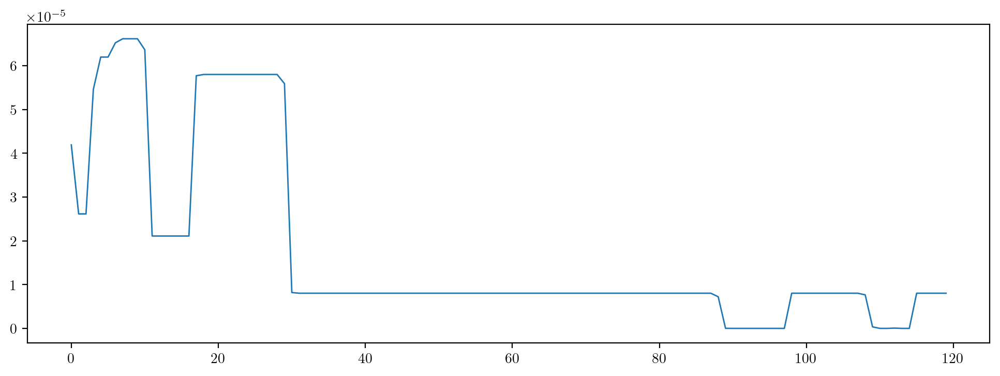

In [ ]:
from optimal_stopping_times import *
buy_p = np.zeros(523)
sell_p = np.zeros(523)
for i in range(523):
    td_c = to_df(td[i])
    pos_c = to_df(pos[i])
    print(i)
    
    start = pos_c.index[int(np.round(len(pos_data.index)/2))]
    print(start)
    print(td_c.at_time(start))
    stop = start + timedelta(seconds = get_opt_stopping_time(i, 10, 2, 15) * 10)
    print(stop)
    buy_p[i] = td_c['ask_p1'].at_time(start.time)
    sell_p[int(i)] = td_c['bid_p1'].at_time(stop.time)

0
2024-06-10 16:00:04.300000
generating samples
vol ratio:  0.7694  |  pred vol ratio:  0.8109


100%|██████████| 10/10 [00:00<00:00, 21.95it/s]


0.00019412828049749942


100%|██████████| 120/120 [00:07<00:00, 16.06it/s]
<ipython-input-15-9a34dcb13f09>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c['ask_p1'].at_time(start)
<ipython-input-15-9a34dcb13f09>:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c['bid_p1'].at_time(stop)


5.815540075495817e-05
[ 0.02297262  3.47325006 -0.02290026  3.23550544  3.47927999 -0.0229696
 -0.54900934]
2024-06-10 16:06:28.300000
1
2024-06-11 01:52:36.300000
generating samples
vol ratio:  7.9844  |  pred vol ratio:  7.7199


100%|██████████| 10/10 [00:00<00:00, 22.05it/s]


-0.002901300112541264


100%|██████████| 120/120 [00:07<00:00, 15.98it/s]
<ipython-input-15-9a34dcb13f09>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c['ask_p1'].at_time(start)
<ipython-input-15-9a34dcb13f09>:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c['bid_p1'].at_time(stop)


-0.0031769105935335754
[ 0.03163872  0.81536182  0.3757308   0.02295395  0.01166704  0.3697166
 -0.47318269]
2024-06-11 01:55:10.300000
2
2024-06-11 13:26:54.600000
generating samples
vol ratio:  1.4828  |  pred vol ratio:  0.952


100%|██████████| 10/10 [00:00<00:00, 20.91it/s]


4.4036753186144926e-05


100%|██████████| 120/120 [00:07<00:00, 15.76it/s]
<ipython-input-15-9a34dcb13f09>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c['ask_p1'].at_time(start)
<ipython-input-15-9a34dcb13f09>:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c['bid_p1'].at_time(stop)


-0.001619297520173315
[-4.34232297e-05 -6.21466966e-05  2.42479536e+00  6.41851345e-05
  5.07533624e-05 -3.38564586e+00 -5.50354863e-01]
2024-06-11 13:39:10.600000
3


IndexError: index 8 is out of bounds for axis 0 with size 3

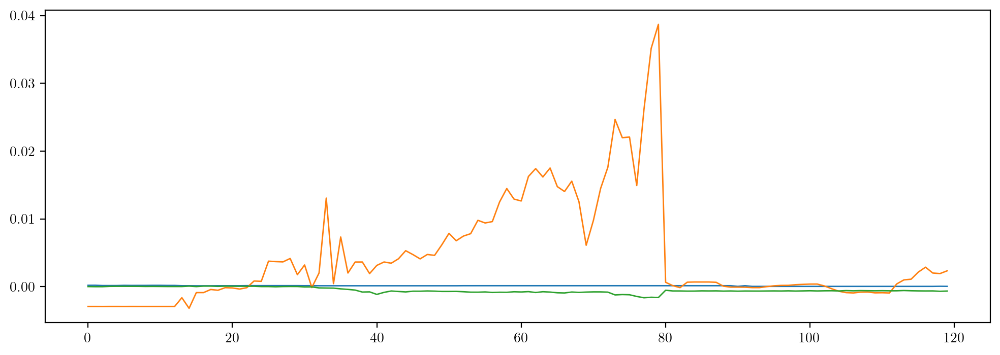

In [ ]:
from optimal_stopping_times import *
buy_p = np.zeros(523)
sell_p = np.zeros(523)
for i in range(523):
    td_c = to_df(td[i])
    pos_c = to_df(pos[i])
    print(i)
    
    start = pos_c.index[int(np.round(len(pos_data.index)/2))]
    print(start)
    stop = start + timedelta(seconds = get_opt_stopping_time(i, 10, 2, 15) * 10)
    print(stop)
    buy_p[i] = td_c['ask_p1'].at_time(start)
    sell_p[int(i)] = td_c['bid_p1'].at_time(stop)

0
2024-06-10 16:00:04.300000
generating samples
vol ratio:  0.7694  |  pred vol ratio:  0.8109


100%|██████████| 10/10 [00:00<00:00, 22.68it/s]


-0.0002613459017043177


100%|██████████| 120/120 [00:07<00:00, 16.01it/s]
<ipython-input-16-91fc1f7e0a34>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-16-91fc1f7e0a34>:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


-0.00029469146523004674
[ 0.79973144 -0.89511343  0.16934497 -0.74813581 -0.66665689  0.61208396
  1.15515598]
2024-06-10 16:06:04.300000
1
2024-06-11 01:52:36.300000
generating samples
vol ratio:  7.9844  |  pred vol ratio:  7.7199


100%|██████████| 10/10 [00:00<00:00, 21.97it/s]


0.0028432732811513512


100%|██████████| 120/120 [00:07<00:00, 15.85it/s]
<ipython-input-16-91fc1f7e0a34>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-16-91fc1f7e0a34>:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


0.0022426830135978348
[ 0.0123889  -0.01214412 -0.01212395 -0.0775228   0.01214126 -0.86926179
  0.01214287]
2024-06-11 02:01:49.300000
2
2024-06-11 13:26:54.600000
generating samples
vol ratio:  1.4828  |  pred vol ratio:  0.952


100%|██████████| 10/10 [00:00<00:00, 20.94it/s]


-2.944924513193541e-05


100%|██████████| 120/120 [00:07<00:00, 15.56it/s]
<ipython-input-16-91fc1f7e0a34>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-16-91fc1f7e0a34>:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


-2.948980579915827e-05
[ 0.65924754  0.54395771 -1.03560681  0.55292724 -0.83690897  0.55841582
  0.6380605 ]
2024-06-11 13:33:37.600000
3


IndexError: index 8 is out of bounds for axis 0 with size 3

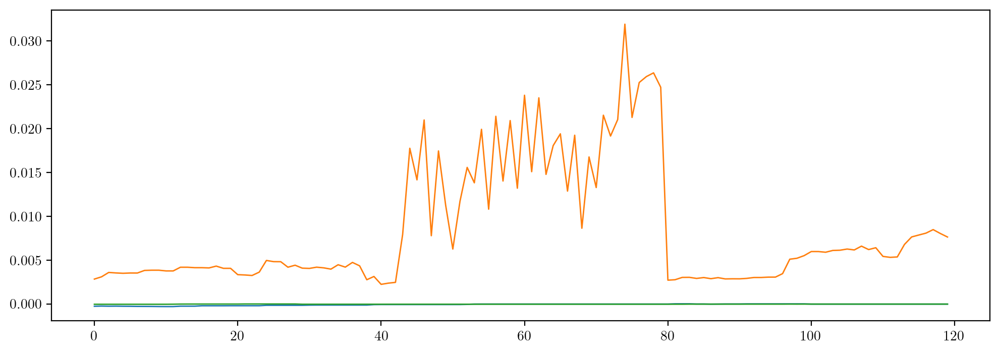

In [ ]:
from optimal_stopping_times import *
buy_p = np.zeros(523)
sell_p = np.zeros(523)
for i in range(523):
    td_c = to_df(td[i])
    pos_c = to_df(pos[i])
    print(i)
    
    start = pos_c.index[int(np.round(len(pos_data.index)/2))]
    print(start)
    stop = start + timedelta(seconds = get_opt_stopping_time(i, 10, 2, 15) * 10)
    print(stop)
    buy_p[i] = td_c.at_time(start)['ask_p1']
    sell_p[int(i)] = td_c.at_time(stop)['bid_p1']

In [ ]:
from optimal_stopping_times import *
buy_p = np.zeros(523)
sell_p = np.zeros(523)
for i in range(523):
    td_c = to_df(td[i])
    pos_c = to_df(pos[i])
    print(i)
    
    start = pos_c.index[int((len(pos_data.index)/2))]
    print(start)
    stop = start + timedelta(seconds = get_opt_stopping_time(i, 10, 2, 15) * 10)
    print(stop)
    buy_p[i] = td_c.at_time(start)['ask_p1']
    sell_p[int(i)] = td_c.at_time(stop)['bid_p1']

0
2024-06-10 16:00:04.300000
generating samples
vol ratio:  0.7694  |  pred vol ratio:  0.8109


100%|██████████| 10/10 [00:00<00:00, 22.22it/s]


0.00015766516987642413


 77%|███████▋  | 92/120 [00:05<00:01, 15.67it/s]

Restarted Python 3.11.4

In [ ]:
from optimal_stopping_times import *
buy_p = np.zeros(523)
sell_p = np.zeros(523)
for i in range(523):
    td_c = to_df(td[i])
    pos_c = to_df(pos[i])
    print(i)
    
    start = pos_c.index[int((len(pos_data.index)/2))]
    print(start)
    stop = start + timedelta(seconds = get_opt_stopping_time(i, 10, 2, 15) * 10)
    print(stop)
    buy_p[i] = td_c.at_time(start)['ask_p1']
    sell_p[int(i)] = td_c.at_time(stop)['bid_p1']

0


NameError: name 'pos_data' is not defined

In [ ]:
buy_p

array([0.012981 , 0.0117482, 0.012199 , 0.0122524, 0.013388 , 0.0131434,
       0.0126434, 0.0121235, 0.0117432, 0.0119261, 0.0120728, 0.011617 ,
       0.0109811, 0.0113854, 0.0118854, 0.0116856, 0.0120744, 0.0121658,
       0.01188  , 0.0114758, 0.0114308, 0.0111642, 0.0116602, 0.0111758,
       0.0105025, 0.0105977, 0.01032  , 0.0105977, 0.0103484, 0.0102286,
       0.0104849, 0.011304 , 0.0115196, 0.0112128, 0.0112376, 0.0118368,
       0.0114352, 0.0109647, 0.0108616, 0.0111881, 0.0114138, 0.0112155,
       0.0116088, 0.0109507, 0.010673 , 0.0104999, 0.0106717, 0.0106837,
       0.0107751, 0.0106591, 0.0114049, 0.0119267, 0.0116337, 0.0119258,
       0.0126919, 0.0128479, 0.       , 0.       , 0.       , 0.       ,
       0.       , 0.       , 0.       , 0.       , 0.       , 0.       ,
       0.       , 0.       , 0.       , 0.       , 0.       , 0.       ,
       0.       , 0.       , 0.       , 0.       , 0.       , 0.       ,
       0.       , 0.       , 0.       , 0.       , 

In [ ]:
sell_p-buy_p

array([-1.968e-04,  2.630e-05, -1.880e-05, -8.600e-06,  5.830e-05,
       -3.300e-05, -5.710e-05,  5.120e-05,  1.187e-04,  2.070e-05,
       -9.300e-06, -2.101e-04,  1.570e-05, -5.460e-05,  6.330e-05,
       -1.030e-05,  1.890e-05,  7.480e-05, -1.080e-04, -7.000e-07,
        2.780e-05, -1.021e-04,  3.240e-05,  4.280e-05, -8.874e-04,
       -1.000e-07,  1.830e-05,  2.300e-06,  2.320e-05,  6.470e-05,
       -6.350e-05,  5.180e-05,  1.198e-04,  1.120e-05,  3.380e-05,
       -1.370e-05,  1.062e-04, -2.500e-06,  7.210e-05,  9.890e-05,
        5.420e-05,  5.100e-06, -1.910e-05,  8.990e-05, -1.201e-04,
        1.560e-05, -8.430e-05,  2.620e-05, -2.950e-05,  2.500e-05,
       -7.500e-06, -1.700e-05, -1.410e-05, -1.510e-05,  1.950e-05,
        4.240e-05,  0.000e+00,  0.000e+00,  0.000e+00,  0.000e+00,
        0.000e+00,  0.000e+00,  0.000e+00,  0.000e+00,  0.000e+00,
        0.000e+00,  0.000e+00,  0.000e+00,  0.000e+00,  0.000e+00,
        0.000e+00,  0.000e+00,  0.000e+00,  0.000e+00,  0.000e

In [ ]:
np.nonzero(sell_p - buy_p)

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
        34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50,
        51, 52, 53, 54, 55]),)

In [ ]:
np.count_nonzero(sell_p - buy_p)

56

In [ ]:
np.count_nonzero(sell_p - buy_p >= 0)

498

In [ ]:
np.count_nonzero(sell_p - buy_p > 0)

31

In [ ]:
31/56

0.5535714285714286

In [ ]:
from optimal_stopping_times import *
buy_p = np.zeros(523)
sell_p = np.zeros(523)
for i in range(523):
    td_c = to_df(td[i])
    pos_c = to_df(pos[i])
    print(i)
    
    start = pos_c.index[int((len(pos_c.index)/2))]
    stop = start + timedelta(seconds = get_opt_stopping_time(i, 10, 2, 15) * 10)
    print(stop)
    buy_p[i] = td_c.at_time(start)['ask_p1']
    sell_p[int(i)] = td_c.at_time(stop)['bid_p1']

0
vol ratio:  0.7694  |  pred vol ratio:  0.8109


100%|██████████| 10/10 [00:00<00:00, 19.88it/s]


2.805699453465976e-05


100%|██████████| 120/120 [00:07<00:00, 15.35it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-10 16:08:55.300000
1
vol ratio:  7.9844  |  pred vol ratio:  7.7199


100%|██████████| 10/10 [00:00<00:00, 20.83it/s]


0.0016589135207462375


 73%|███████▎  | 88/120 [00:05<00:02, 15.74it/s]

soft restart


 83%|████████▎ | 100/120 [00:06<00:01, 15.64it/s]

soft restart


 93%|█████████▎| 112/120 [00:07<00:00, 15.44it/s]

soft restart
soft restart


100%|██████████| 120/120 [00:07<00:00, 15.34it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-11 02:04:30.100000
2
vol ratio:  1.4828  |  pred vol ratio:  0.952


100%|██████████| 10/10 [00:00<00:00, 22.50it/s]


-2.8517049454364325e-05


100%|██████████| 120/120 [00:07<00:00, 16.13it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-11 13:33:52
3
vol ratio:  0.9613  |  pred vol ratio:  0.8888


100%|██████████| 10/10 [00:00<00:00, 23.18it/s]


-4.9269694146375944e-05


100%|██████████| 120/120 [00:07<00:00, 15.78it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-11 17:20:40.600000
4
vol ratio:  1.2059  |  pred vol ratio:  1.0653


100%|██████████| 10/10 [00:00<00:00, 22.15it/s]


-4.6298805744000766e-05


100%|██████████| 120/120 [00:07<00:00, 15.88it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-12 16:40:18.900000
5
vol ratio:  1.0586  |  pred vol ratio:  0.982


100%|██████████| 10/10 [00:00<00:00, 23.22it/s]


2.1210936771958285e-05


100%|██████████| 120/120 [00:07<00:00, 16.09it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-13 02:00:30.300000
6
vol ratio:  0.8603  |  pred vol ratio:  0.9753


100%|██████████| 10/10 [00:00<00:00, 22.12it/s]


-7.80069433960009e-06


100%|██████████| 120/120 [00:07<00:00, 15.50it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-13 11:15:14.600000
7
vol ratio:  1.3753  |  pred vol ratio:  0.965


100%|██████████| 10/10 [00:00<00:00, 22.21it/s]


-0.000626179629925115


100%|██████████| 120/120 [00:08<00:00, 14.83it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-13 14:36:14.500000
8
vol ratio:  0.6621  |  pred vol ratio:  0.7874


100%|██████████| 10/10 [00:00<00:00, 22.00it/s]


-7.593873979561671e-05


100%|██████████| 120/120 [00:07<00:00, 15.31it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-13 15:52:44.200000
9
vol ratio:  1.2179  |  pred vol ratio:  1.1398


100%|██████████| 10/10 [00:00<00:00, 22.94it/s]


-4.246187505921856e-05


100%|██████████| 120/120 [00:07<00:00, 16.27it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-13 20:01:19.900000
10
vol ratio:  0.6489  |  pred vol ratio:  1.0109


100%|██████████| 10/10 [00:00<00:00, 22.97it/s]


-7.746199992894633e-05


 85%|████████▌ | 102/120 [00:06<00:01, 15.65it/s]

soft restart


 93%|█████████▎| 112/120 [00:07<00:00, 15.79it/s]

soft restart
soft restart


 98%|█████████▊| 118/120 [00:07<00:00, 15.81it/s]

soft restart
soft restart


100%|██████████| 120/120 [00:07<00:00, 15.50it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-14 11:43:24.400000
11
vol ratio:  1.5406  |  pred vol ratio:  0.9626


100%|██████████| 10/10 [00:00<00:00, 22.66it/s]


-6.586112221435757e-06


100%|██████████| 120/120 [00:07<00:00, 15.74it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-14 15:44:59.900000
12
vol ratio:  1.0426  |  pred vol ratio:  0.9307


100%|██████████| 10/10 [00:00<00:00, 22.70it/s]


2.4046531344421454e-05


100%|██████████| 120/120 [00:07<00:00, 15.91it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-14 17:57:02.300000
13
vol ratio:  0.9022  |  pred vol ratio:  0.9806


100%|██████████| 10/10 [00:00<00:00, 20.83it/s]


-3.00322027441026e-05


100%|██████████| 120/120 [00:07<00:00, 15.89it/s]

soft restart
soft restart
soft restart
2024-06-14 23:17:13



<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


14
vol ratio:  0.8519  |  pred vol ratio:  1.0774


100%|██████████| 10/10 [00:00<00:00, 21.20it/s]


-8.135243480862807e-05


100%|██████████| 120/120 [00:07<00:00, 15.88it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-15 08:16:04.100000
15
vol ratio:  1.2756  |  pred vol ratio:  1.1334


100%|██████████| 10/10 [00:00<00:00, 22.22it/s]


-0.00021163449312974606


 98%|█████████▊| 118/120 [00:07<00:00, 15.95it/s]

soft restart
soft restart


100%|██████████| 120/120 [00:07<00:00, 15.49it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-15 20:30:05.500000
16
vol ratio:  0.6783  |  pred vol ratio:  0.9251


100%|██████████| 10/10 [00:00<00:00, 22.89it/s]


3.4516890353906406e-05


 87%|████████▋ | 104/120 [00:06<00:00, 16.08it/s]

soft restart
soft restart
soft restart
soft restart


 90%|█████████ | 108/120 [00:06<00:00, 15.80it/s]

soft restart
soft restart
soft restart
soft restart


 93%|█████████▎| 112/120 [00:07<00:00, 15.87it/s]

soft restart
soft restart
soft restart
soft restart


 97%|█████████▋| 116/120 [00:07<00:00, 15.88it/s]

soft restart
soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:07<00:00, 15.80it/s]

soft restart
soft restart
soft restart
2024-06-16 14:34:56.700000



<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


17
vol ratio:  1.0047  |  pred vol ratio:  0.9927


100%|██████████| 10/10 [00:00<00:00, 22.87it/s]


-1.575869870628543e-05


100%|██████████| 120/120 [00:07<00:00, 15.48it/s]

soft restart
soft restart



<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-17 01:13:33.400000
18
vol ratio:  1.4202  |  pred vol ratio:  1.1877


100%|██████████| 10/10 [00:00<00:00, 22.26it/s]


3.398166702901695e-05


 90%|█████████ | 108/120 [00:06<00:00, 16.23it/s]

soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:07<00:00, 15.99it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-17 05:52:56.800000
19
vol ratio:  1.5136  |  pred vol ratio:  0.9987


100%|██████████| 10/10 [00:00<00:00, 20.44it/s]


3.2769293622027866e-05


100%|██████████| 120/120 [00:07<00:00, 16.00it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-17 09:55:20.800000
20
vol ratio:  1.9126  |  pred vol ratio:  0.9892


100%|██████████| 10/10 [00:00<00:00, 22.57it/s]


9.355113714917755e-05


100%|██████████| 120/120 [00:07<00:00, 16.01it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-17 13:41:19.300000
21
vol ratio:  2.7674  |  pred vol ratio:  0.8768


100%|██████████| 10/10 [00:00<00:00, 22.75it/s]


2.5695079310967628e-05


100%|██████████| 120/120 [00:07<00:00, 15.36it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-17 16:21:27.300000
22
vol ratio:  0.786  |  pred vol ratio:  1.0056


100%|██████████| 10/10 [00:00<00:00, 22.91it/s]


-3.0384836004797696e-06


 93%|█████████▎| 112/120 [00:06<00:00, 16.01it/s]

soft restart
soft restart
soft restart
soft restart


 97%|█████████▋| 116/120 [00:07<00:00, 15.73it/s]

soft restart
soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:07<00:00, 15.94it/s]

soft restart
soft restart
soft restart
2024-06-17 19:12:15.300000



<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


23
vol ratio:  0.7066  |  pred vol ratio:  0.9651


100%|██████████| 10/10 [00:00<00:00, 23.05it/s]


-0.00014973125584713786


100%|██████████| 120/120 [00:07<00:00, 15.68it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-17 23:33:25
24
vol ratio:  2.6517  |  pred vol ratio:  0.7235


100%|██████████| 10/10 [00:00<00:00, 22.30it/s]


-0.00016099658847865003


 77%|███████▋  | 92/120 [00:05<00:01, 16.00it/s]

soft restart


 87%|████████▋ | 104/120 [00:06<00:01, 15.95it/s]

soft restart
soft restart


 92%|█████████▏| 110/120 [00:06<00:00, 16.12it/s]

soft restart


 98%|█████████▊| 118/120 [00:07<00:00, 16.10it/s]

soft restart


100%|██████████| 120/120 [00:07<00:00, 15.77it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-18 01:42:47.200000
25
vol ratio:  1.0745  |  pred vol ratio:  1.0517


100%|██████████| 10/10 [00:00<00:00, 22.09it/s]


-2.5733826201496187e-05


100%|██████████| 120/120 [00:07<00:00, 16.09it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-18 10:44:05.500000
26
vol ratio:  0.7246  |  pred vol ratio:  0.8083


100%|██████████| 10/10 [00:00<00:00, 22.71it/s]


7.664659901001727e-05


 78%|███████▊  | 94/120 [00:05<00:01, 15.89it/s]

soft restart


100%|██████████| 120/120 [00:07<00:00, 16.04it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-18 12:41:23.900000
27
vol ratio:  0.971  |  pred vol ratio:  0.8244


100%|██████████| 10/10 [00:00<00:00, 22.98it/s]


3.1493674976839474e-05


100%|██████████| 120/120 [00:07<00:00, 15.94it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-18 14:51:13.300000
28
vol ratio:  0.8286  |  pred vol ratio:  0.8631


100%|██████████| 10/10 [00:00<00:00, 20.34it/s]


-0.00012882970089319413


100%|██████████| 120/120 [00:07<00:00, 15.90it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-18 16:32:04.800000
29
vol ratio:  0.9998  |  pred vol ratio:  0.8815


100%|██████████| 10/10 [00:00<00:00, 22.76it/s]


-0.0001940262987127761


100%|██████████| 120/120 [00:07<00:00, 15.87it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-18 17:57:25.100000
30
vol ratio:  0.7013  |  pred vol ratio:  0.8506


100%|██████████| 10/10 [00:00<00:00, 21.05it/s]


0.00035856636957341896


100%|██████████| 120/120 [00:07<00:00, 15.91it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-18 20:29:34.400000
31
vol ratio:  0.8183  |  pred vol ratio:  0.7973


100%|██████████| 10/10 [00:00<00:00, 22.76it/s]


-0.00013893091334472437


100%|██████████| 120/120 [00:07<00:00, 16.11it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-19 01:32:56
32
vol ratio:  0.809  |  pred vol ratio:  0.9166


100%|██████████| 10/10 [00:00<00:00, 22.51it/s]


-0.00029016200792613236


100%|██████████| 120/120 [00:07<00:00, 15.84it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-19 05:55:35.300000
33
vol ratio:  1.1775  |  pred vol ratio:  1.0523


100%|██████████| 10/10 [00:00<00:00, 22.22it/s]


6.024800781789919e-05


100%|██████████| 120/120 [00:07<00:00, 16.02it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-19 13:57:53.700000
34
vol ratio:  0.9964  |  pred vol ratio:  1.0506


100%|██████████| 10/10 [00:00<00:00, 22.75it/s]


1.172788124608013e-05


 90%|█████████ | 108/120 [00:06<00:00, 16.13it/s]

soft restart


100%|██████████| 120/120 [00:07<00:00, 16.06it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-20 00:52:47.400000
35
vol ratio:  0.9756  |  pred vol ratio:  1.0012


100%|██████████| 10/10 [00:00<00:00, 20.87it/s]


9.977085128073933e-05


100%|██████████| 120/120 [00:07<00:00, 16.13it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-20 08:41:36
36
vol ratio:  0.6952  |  pred vol ratio:  0.8201


100%|██████████| 10/10 [00:00<00:00, 22.91it/s]


-0.00024160461605989724


100%|██████████| 120/120 [00:07<00:00, 16.00it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-20 13:38:50.300000
37
vol ratio:  0.4468  |  pred vol ratio:  0.7303


100%|██████████| 10/10 [00:00<00:00, 22.88it/s]


-0.00013764948954235898


 93%|█████████▎| 112/120 [00:06<00:00, 16.15it/s]

soft restart


100%|██████████| 120/120 [00:07<00:00, 16.01it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-20 16:26:36.400000
38
vol ratio:  1.05  |  pred vol ratio:  1.0103


100%|██████████| 10/10 [00:00<00:00, 20.18it/s]


-9.887755413913541e-05


 95%|█████████▌| 114/120 [00:07<00:00, 15.88it/s]

soft restart
soft restart
soft restart


 98%|█████████▊| 118/120 [00:07<00:00, 15.88it/s]

soft restart
soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:07<00:00, 15.40it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


soft restart
soft restart
2024-06-21 01:13:47.600000
39
vol ratio:  0.6792  |  pred vol ratio:  0.8151


100%|██████████| 10/10 [00:00<00:00, 22.64it/s]


0.0001006619890619262


100%|██████████| 120/120 [00:07<00:00, 15.83it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-21 09:53:02.400000
40
vol ratio:  0.777  |  pred vol ratio:  0.8435


100%|██████████| 10/10 [00:00<00:00, 22.76it/s]


-8.03601701424824e-05


 77%|███████▋  | 92/120 [00:05<00:01, 15.80it/s]

soft restart


 95%|█████████▌| 114/120 [00:07<00:00, 15.95it/s]

soft restart


100%|██████████| 120/120 [00:07<00:00, 15.82it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-21 14:55:17.100000
41
vol ratio:  1.0086  |  pred vol ratio:  0.9597


100%|██████████| 10/10 [00:00<00:00, 22.63it/s]


-8.47583665189863e-05


 40%|████      | 48/120 [00:03<00:04, 16.21it/s]

soft restart


 73%|███████▎  | 88/120 [00:05<00:02, 14.94it/s]

soft restart
soft restart
soft restart
soft restart


 77%|███████▋  | 92/120 [00:05<00:01, 15.49it/s]

soft restart
soft restart
soft restart
soft restart


 88%|████████▊ | 106/120 [00:06<00:00, 16.10it/s]

soft restart
soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:07<00:00, 15.58it/s]

soft restart
soft restart
soft restart
soft restart



<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-21 17:33:16
42
vol ratio:  1.1724  |  pred vol ratio:  1.1906


100%|██████████| 10/10 [00:00<00:00, 23.11it/s]


-4.081045511764559e-05


100%|██████████| 120/120 [00:07<00:00, 15.86it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-23 09:39:41.600000
43
vol ratio:  0.7521  |  pred vol ratio:  1.0188


100%|██████████| 10/10 [00:00<00:00, 22.65it/s]


1.597339619003311e-06


100%|██████████| 120/120 [00:07<00:00, 15.76it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-23 21:24:14.500000
44
vol ratio:  2.4499  |  pred vol ratio:  1.1689


100%|██████████| 10/10 [00:00<00:00, 21.07it/s]


-7.984541259039672e-05


100%|██████████| 120/120 [00:07<00:00, 15.31it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-24 05:19:20.300000
45
vol ratio:  0.9201  |  pred vol ratio:  0.9699


100%|██████████| 10/10 [00:00<00:00, 22.54it/s]


-5.547484265803021e-05


100%|██████████| 120/120 [00:07<00:00, 15.50it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-24 09:06:26.600000
46
vol ratio:  0.9988  |  pred vol ratio:  0.9578


100%|██████████| 10/10 [00:00<00:00, 22.32it/s]


-6.16262659763682e-05


100%|██████████| 120/120 [00:07<00:00, 15.10it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-24 11:20:01.100000
47
vol ratio:  1.0251  |  pred vol ratio:  1.0347


100%|██████████| 10/10 [00:00<00:00, 21.80it/s]


4.619493080210574e-05


100%|██████████| 120/120 [00:07<00:00, 15.61it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-24 15:33:35.400000
48
vol ratio:  1.0096  |  pred vol ratio:  0.8287


100%|██████████| 10/10 [00:00<00:00, 21.37it/s]


-9.626679420453725e-05


100%|██████████| 120/120 [00:07<00:00, 15.74it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-24 17:41:38.500000
49
vol ratio:  1.4987  |  pred vol ratio:  1.083


100%|██████████| 10/10 [00:00<00:00, 20.42it/s]


-6.101413151664403e-05


 93%|█████████▎| 112/120 [00:07<00:00, 15.92it/s]

soft restart


 98%|█████████▊| 118/120 [00:07<00:00, 15.44it/s]

soft restart
soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:07<00:00, 15.41it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


soft restart
soft restart
2024-06-24 19:51:24.200000
50
vol ratio:  0.8098  |  pred vol ratio:  0.972


100%|██████████| 10/10 [00:00<00:00, 19.95it/s]


4.389137260866547e-06


 90%|█████████ | 108/120 [00:06<00:00, 15.42it/s]

soft restart
soft restart
soft restart


 95%|█████████▌| 114/120 [00:07<00:00, 15.18it/s]

soft restart


100%|██████████| 120/120 [00:07<00:00, 15.63it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-25 00:40:44.600000
51
vol ratio:  0.7367  |  pred vol ratio:  0.9141


100%|██████████| 10/10 [00:00<00:00, 20.34it/s]


-0.0001418665806997436


100%|██████████| 120/120 [00:08<00:00, 14.76it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-25 03:56:24.900000
52
vol ratio:  1.1026  |  pred vol ratio:  1.1411


100%|██████████| 10/10 [00:00<00:00, 21.22it/s]


-4.1528832237053196e-06


100%|██████████| 120/120 [00:07<00:00, 15.35it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-25 08:28:08.100000
53
vol ratio:  0.8284  |  pred vol ratio:  0.878


100%|██████████| 10/10 [00:00<00:00, 22.87it/s]


-1.7493558200835364e-05


 77%|███████▋  | 92/120 [00:05<00:01, 15.52it/s]

soft restart


 83%|████████▎ | 100/120 [00:06<00:01, 15.44it/s]

soft restart


100%|██████████| 120/120 [00:07<00:00, 15.69it/s]

soft restart
soft restart
soft restart



<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-25 11:49:08.800000
54
vol ratio:  0.9072  |  pred vol ratio:  0.8929


100%|██████████| 10/10 [00:00<00:00, 22.69it/s]


-9.20099868992502e-05


100%|██████████| 120/120 [00:07<00:00, 15.93it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-25 15:45:41.400000
55
vol ratio:  0.8551  |  pred vol ratio:  0.8659


100%|██████████| 10/10 [00:00<00:00, 22.41it/s]


-0.0001788050947886598


100%|██████████| 120/120 [00:07<00:00, 15.99it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-25 18:38:19.800000
56
vol ratio:  0.8827  |  pred vol ratio:  1.0918


100%|██████████| 10/10 [00:00<00:00, 22.67it/s]


-1.9755479614625293e-06


100%|██████████| 120/120 [00:07<00:00, 15.72it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-25 21:11:38.200000
57
vol ratio:  0.9063  |  pred vol ratio:  0.9072


100%|██████████| 10/10 [00:00<00:00, 22.67it/s]


-1.7249866095910228e-05


100%|██████████| 120/120 [00:07<00:00, 15.94it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-26 02:13:00.700000
58
vol ratio:  2.6026  |  pred vol ratio:  1.7945


100%|██████████| 10/10 [00:00<00:00, 23.01it/s]


-0.00019406428492567328


100%|██████████| 120/120 [00:07<00:00, 15.63it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-26 04:46:24.900000
59
vol ratio:  0.8231  |  pred vol ratio:  0.9585


100%|██████████| 10/10 [00:00<00:00, 22.58it/s]


-0.0001241707744284594


 85%|████████▌ | 102/120 [00:06<00:01, 15.71it/s]

soft restart


 95%|█████████▌| 114/120 [00:07<00:00, 15.83it/s]

soft restart
soft restart
soft restart
soft restart


 98%|█████████▊| 118/120 [00:07<00:00, 15.76it/s]

soft restart
soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:07<00:00, 15.89it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


soft restart
soft restart
2024-06-26 07:43:39.300000
60
vol ratio:  0.881  |  pred vol ratio:  0.9775


100%|██████████| 10/10 [00:00<00:00, 22.66it/s]


-0.00017092368315762708


100%|██████████| 120/120 [00:07<00:00, 15.97it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-26 10:12:57.600000
61
vol ratio:  1.2245  |  pred vol ratio:  1.0724


100%|██████████| 10/10 [00:00<00:00, 23.03it/s]


-1.3894359446737094e-05


 90%|█████████ | 108/120 [00:06<00:00, 15.83it/s]

soft restart


100%|██████████| 120/120 [00:07<00:00, 16.08it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-26 15:16:12.300000
62
vol ratio:  1.2385  |  pred vol ratio:  1.0424


100%|██████████| 10/10 [00:00<00:00, 22.60it/s]


-2.41004282198157e-05


 45%|████▌     | 54/120 [00:03<00:04, 15.71it/s]

soft restart


 73%|███████▎  | 88/120 [00:05<00:02, 15.70it/s]

soft restart
soft restart
soft restart
soft restart


 77%|███████▋  | 92/120 [00:05<00:01, 15.83it/s]

soft restart
soft restart
soft restart


 80%|████████  | 96/120 [00:06<00:01, 15.74it/s]

soft restart
soft restart
soft restart
soft restart


 83%|████████▎ | 100/120 [00:06<00:01, 15.69it/s]

soft restart
soft restart
soft restart
soft restart


 87%|████████▋ | 104/120 [00:06<00:01, 15.61it/s]

soft restart
soft restart
soft restart
soft restart


 90%|█████████ | 108/120 [00:06<00:00, 15.89it/s]

soft restart
soft restart
soft restart
soft restart


 93%|█████████▎| 112/120 [00:07<00:00, 15.44it/s]

soft restart
soft restart
soft restart
soft restart


 97%|█████████▋| 116/120 [00:07<00:00, 14.83it/s]

soft restart
soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:07<00:00, 15.41it/s]

soft restart
soft restart
soft restart
soft restart



<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-26 19:53:25.100000
63
vol ratio:  1.3535  |  pred vol ratio:  1.2321


100%|██████████| 10/10 [00:00<00:00, 22.87it/s]


-7.295652545605895e-05


 85%|████████▌ | 102/120 [00:06<00:01, 15.79it/s]

soft restart
soft restart
soft restart
soft restart


 88%|████████▊ | 106/120 [00:06<00:00, 15.60it/s]

soft restart


 97%|█████████▋| 116/120 [00:07<00:00, 15.37it/s]

soft restart
soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:07<00:00, 15.74it/s]

soft restart
soft restart
soft restart
2024-06-27 00:19:31.200000



<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


64
vol ratio:  0.7055  |  pred vol ratio:  1.0223


100%|██████████| 10/10 [00:00<00:00, 22.61it/s]


-0.00018387273921235205


 85%|████████▌ | 102/120 [00:06<00:01, 14.95it/s]

soft restart


 93%|█████████▎| 112/120 [00:07<00:00, 15.36it/s]

soft restart
soft restart
soft restart


 97%|█████████▋| 116/120 [00:07<00:00, 15.50it/s]

soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:07<00:00, 15.61it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-27 03:38:49.900000
65
vol ratio:  0.9825  |  pred vol ratio:  1.1432


100%|██████████| 10/10 [00:00<00:00, 22.21it/s]


-7.794895860070587e-05


100%|██████████| 120/120 [00:07<00:00, 15.65it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-27 06:34:57.300000
66
vol ratio:  1.0019  |  pred vol ratio:  1.0559


100%|██████████| 10/10 [00:00<00:00, 23.19it/s]


-0.0001369087518821964


100%|██████████| 120/120 [00:07<00:00, 15.69it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-27 11:05:55.200000
67
vol ratio:  0.8797  |  pred vol ratio:  0.8551


100%|██████████| 10/10 [00:00<00:00, 22.96it/s]


-0.0002097842194242469


100%|██████████| 120/120 [00:07<00:00, 15.70it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-27 13:43:22.100000
68
vol ratio:  0.9723  |  pred vol ratio:  1.0004


100%|██████████| 10/10 [00:00<00:00, 22.49it/s]


-3.708604628658461e-05


100%|██████████| 120/120 [00:07<00:00, 15.21it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-27 15:33:26
69
vol ratio:  1.0365  |  pred vol ratio:  1.1935


100%|██████████| 10/10 [00:00<00:00, 22.40it/s]


-8.023978724481967e-05


100%|██████████| 120/120 [00:07<00:00, 15.66it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-27 22:59:41.500000
70
vol ratio:  0.9844  |  pred vol ratio:  0.973


100%|██████████| 10/10 [00:00<00:00, 22.44it/s]


6.678828512621296e-05


 82%|████████▏ | 98/120 [00:06<00:01, 15.73it/s]

soft restart


100%|██████████| 120/120 [00:07<00:00, 15.70it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


soft restart
2024-06-28 01:36:58.100000
71
vol ratio:  0.8123  |  pred vol ratio:  0.9896


100%|██████████| 10/10 [00:00<00:00, 20.25it/s]


-0.00017940028629210623


100%|██████████| 120/120 [00:07<00:00, 15.58it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-28 02:58:20.200000
72
vol ratio:  1.0527  |  pred vol ratio:  1.2306


100%|██████████| 10/10 [00:00<00:00, 21.72it/s]


-0.00010065618236937773


100%|██████████| 120/120 [00:07<00:00, 15.19it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-28 06:06:58.200000
73
vol ratio:  0.8345  |  pred vol ratio:  0.971


100%|██████████| 10/10 [00:00<00:00, 22.39it/s]


-0.00021980099596984496


100%|██████████| 120/120 [00:07<00:00, 15.29it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-28 13:11:43
74
vol ratio:  1.0611  |  pred vol ratio:  1.0322


100%|██████████| 10/10 [00:00<00:00, 22.48it/s]


5.307537280303993e-05


100%|██████████| 120/120 [00:07<00:00, 15.51it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-28 15:24:02.100000
75
vol ratio:  0.7766  |  pred vol ratio:  0.8528


100%|██████████| 10/10 [00:00<00:00, 22.98it/s]


-0.0003096649574824847


100%|██████████| 120/120 [00:07<00:00, 15.67it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-28 17:17:18.100000
76
vol ratio:  1.21  |  pred vol ratio:  0.9568


100%|██████████| 10/10 [00:00<00:00, 20.85it/s]


-1.9611471560568025e-05


 93%|█████████▎| 112/120 [00:07<00:00, 15.57it/s]

soft restart
soft restart
soft restart
soft restart


 97%|█████████▋| 116/120 [00:07<00:00, 15.14it/s]

soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:07<00:00, 15.58it/s]

soft restart
soft restart
soft restart
soft restart



<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-28 19:24:49.800000
77
vol ratio:  0.4818  |  pred vol ratio:  1.0337


100%|██████████| 10/10 [00:00<00:00, 22.40it/s]


-5.983133787227063e-06


100%|██████████| 120/120 [00:07<00:00, 15.72it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-28 21:37:02.100000
78
vol ratio:  1.9462  |  pred vol ratio:  1.5374


100%|██████████| 10/10 [00:00<00:00, 22.60it/s]


5.817290731796542e-05


100%|██████████| 120/120 [00:07<00:00, 15.42it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-29 19:31:29.400000
79
vol ratio:  0.7306  |  pred vol ratio:  0.9943


100%|██████████| 10/10 [00:00<00:00, 21.98it/s]


-6.907938418888462e-05


100%|██████████| 120/120 [00:07<00:00, 15.53it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-30 01:25:55.400000
80
vol ratio:  0.8381  |  pred vol ratio:  0.9464


100%|██████████| 10/10 [00:00<00:00, 23.31it/s]


-3.558013555935035e-06


100%|██████████| 120/120 [00:07<00:00, 15.55it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-30 07:45:24.100000
81
vol ratio:  0.4068  |  pred vol ratio:  0.797


100%|██████████| 10/10 [00:00<00:00, 22.00it/s]


-2.1646652016478226e-05


100%|██████████| 120/120 [00:07<00:00, 15.53it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-30 16:13:49.200000
82
vol ratio:  0.9332  |  pred vol ratio:  1.1597


100%|██████████| 10/10 [00:00<00:00, 22.76it/s]


7.811467212182188e-05


100%|██████████| 120/120 [00:07<00:00, 15.46it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-06-30 20:58:08.300000
83
vol ratio:  0.825  |  pred vol ratio:  1.059


100%|██████████| 10/10 [00:00<00:00, 22.15it/s]


6.0831217423504725e-05


100%|██████████| 120/120 [00:07<00:00, 15.66it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-01 00:20:53.500000
84
vol ratio:  0.9508  |  pred vol ratio:  1.1845


100%|██████████| 10/10 [00:00<00:00, 22.98it/s]


8.680198497031898e-05


 82%|████████▏ | 98/120 [00:06<00:01, 15.64it/s]

soft restart
soft restart
soft restart
soft restart


 85%|████████▌ | 102/120 [00:06<00:01, 15.66it/s]

soft restart
soft restart
soft restart
soft restart


 88%|████████▊ | 106/120 [00:06<00:00, 15.48it/s]

soft restart
soft restart
soft restart
soft restart


 92%|█████████▏| 110/120 [00:07<00:00, 15.57it/s]

soft restart
soft restart
soft restart
soft restart


 95%|█████████▌| 114/120 [00:07<00:00, 14.85it/s]

soft restart
soft restart
soft restart
soft restart


 98%|█████████▊| 118/120 [00:07<00:00, 14.87it/s]

soft restart
soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:07<00:00, 15.48it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


soft restart
soft restart
2024-07-01 04:31:15.200000
85
vol ratio:  1.5733  |  pred vol ratio:  1.4211


100%|██████████| 10/10 [00:00<00:00, 23.44it/s]


-0.00015487280638658017


 87%|████████▋ | 104/120 [00:06<00:01, 15.55it/s]

soft restart
soft restart
soft restart
soft restart


 90%|█████████ | 108/120 [00:06<00:00, 15.45it/s]

soft restart
soft restart
soft restart
soft restart


 93%|█████████▎| 112/120 [00:07<00:00, 15.23it/s]

soft restart
soft restart
soft restart
soft restart


 97%|█████████▋| 116/120 [00:07<00:00, 15.21it/s]

soft restart
soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:07<00:00, 15.58it/s]

soft restart
soft restart
soft restart
2024-07-01 09:33:28.100000



<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


86
vol ratio:  0.9352  |  pred vol ratio:  1.0907


100%|██████████| 10/10 [00:00<00:00, 22.85it/s]


7.820387919863173e-05


100%|██████████| 120/120 [00:07<00:00, 15.45it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-01 13:15:26.500000
87
vol ratio:  0.9997  |  pred vol ratio:  1.2802


100%|██████████| 10/10 [00:00<00:00, 22.24it/s]


3.6063171423228426e-05


100%|██████████| 120/120 [00:07<00:00, 15.60it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-01 17:17:50.300000
88
vol ratio:  1.3712  |  pred vol ratio:  1.2041


100%|██████████| 10/10 [00:00<00:00, 22.77it/s]


2.535848080037078e-05


 70%|███████   | 84/120 [00:05<00:02, 15.55it/s]

soft restart
soft restart
soft restart


 73%|███████▎  | 88/120 [00:05<00:02, 15.61it/s]

soft restart
soft restart


 77%|███████▋  | 92/120 [00:05<00:01, 15.38it/s]

soft restart
soft restart
soft restart
soft restart


 78%|███████▊  | 94/120 [00:06<00:01, 15.35it/s]

soft restart
soft restart
soft restart


 82%|████████▏ | 98/120 [00:06<00:01, 14.87it/s]

soft restart
soft restart
soft restart
soft restart


 85%|████████▌ | 102/120 [00:06<00:01, 15.14it/s]

soft restart
soft restart
soft restart
soft restart


 88%|████████▊ | 106/120 [00:06<00:00, 15.14it/s]

soft restart
soft restart
soft restart


 92%|█████████▏| 110/120 [00:07<00:00, 15.14it/s]

soft restart
soft restart
soft restart
soft restart


 95%|█████████▌| 114/120 [00:07<00:00, 15.23it/s]

soft restart
soft restart
soft restart
soft restart


 98%|█████████▊| 118/120 [00:07<00:00, 15.46it/s]

soft restart
soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:07<00:00, 15.42it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


soft restart
soft restart
2024-07-01 22:30:40.600000
89
vol ratio:  1.0662  |  pred vol ratio:  1.3571


100%|██████████| 10/10 [00:00<00:00, 22.77it/s]


-3.6187211962297775e-05


100%|██████████| 120/120 [00:07<00:00, 15.79it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-02 06:17:03.400000
90
vol ratio:  0.8478  |  pred vol ratio:  1.2191


100%|██████████| 10/10 [00:00<00:00, 23.20it/s]


4.6607111859164544e-06


100%|██████████| 120/120 [00:07<00:00, 15.80it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-02 08:21:52.200000
91
vol ratio:  0.9892  |  pred vol ratio:  1.1682


100%|██████████| 10/10 [00:00<00:00, 22.76it/s]


5.2006680056382684e-05


100%|██████████| 120/120 [00:07<00:00, 15.90it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-02 15:34:30.700000
92
vol ratio:  0.8832  |  pred vol ratio:  1.2832


100%|██████████| 10/10 [00:00<00:00, 22.98it/s]


-1.1297792882744997e-05


 90%|█████████ | 108/120 [00:06<00:00, 15.56it/s]

soft restart
soft restart


 93%|█████████▎| 112/120 [00:07<00:00, 15.60it/s]

soft restart
soft restart
soft restart
soft restart


 97%|█████████▋| 116/120 [00:07<00:00, 15.80it/s]

soft restart
soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:07<00:00, 15.80it/s]

soft restart
soft restart
soft restart
2024-07-03 00:23:08.900000



<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


93
vol ratio:  0.7271  |  pred vol ratio:  1.0155


100%|██████████| 10/10 [00:00<00:00, 22.08it/s]


3.341814976352859e-05


100%|██████████| 120/120 [00:07<00:00, 15.52it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-03 03:55:20.100000
94
vol ratio:  0.9059  |  pred vol ratio:  1.1691


100%|██████████| 10/10 [00:00<00:00, 22.39it/s]


-6.577447996271185e-05


100%|██████████| 120/120 [00:07<00:00, 15.54it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-03 08:43:29.600000
95
vol ratio:  1.0539  |  pred vol ratio:  1.0124


100%|██████████| 10/10 [00:00<00:00, 22.66it/s]


1.5805653470972025e-05


100%|██████████| 120/120 [00:07<00:00, 15.36it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


soft restart
2024-07-03 12:05:38.300000
96
vol ratio:  1.0704  |  pred vol ratio:  0.9878


100%|██████████| 10/10 [00:00<00:00, 22.42it/s]


-6.52159657637625e-05


 88%|████████▊ | 106/120 [00:06<00:00, 15.60it/s]

soft restart


 95%|█████████▌| 114/120 [00:07<00:00, 15.50it/s]

soft restart


100%|██████████| 120/120 [00:07<00:00, 15.65it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-03 13:44:39.100000
97
vol ratio:  1.0039  |  pred vol ratio:  1.108


100%|██████████| 10/10 [00:00<00:00, 22.60it/s]


-3.869326920852467e-05


100%|██████████| 120/120 [00:07<00:00, 15.64it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-03 15:42:42.700000
98
vol ratio:  1.341  |  pred vol ratio:  1.2197


100%|██████████| 10/10 [00:00<00:00, 22.67it/s]


3.9747065609651853e-07


 83%|████████▎ | 100/120 [00:06<00:01, 15.72it/s]

soft restart


 87%|████████▋ | 104/120 [00:06<00:01, 15.17it/s]

soft restart


 97%|█████████▋| 116/120 [00:07<00:00, 15.73it/s]

soft restart


100%|██████████| 120/120 [00:07<00:00, 15.70it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-03 17:39:13.400000
99
vol ratio:  1.0429  |  pred vol ratio:  1.0546


100%|██████████| 10/10 [00:00<00:00, 20.86it/s]


-3.850743374943833e-05


100%|██████████| 120/120 [00:07<00:00, 15.47it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-03 20:01:21.200000
100
vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 10/10 [00:00<00:00, 19.60it/s]


4.472342212700369e-05


100%|██████████| 120/120 [00:07<00:00, 15.82it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-03 22:27:15
101
vol ratio:  0.8643  |  pred vol ratio:  0.7247


100%|██████████| 10/10 [00:00<00:00, 21.29it/s]


-0.00012042874831306437


100%|██████████| 120/120 [00:07<00:00, 15.93it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-04 02:03:13.800000
102
vol ratio:  1.4955  |  pred vol ratio:  1.0534


100%|██████████| 10/10 [00:00<00:00, 23.06it/s]


-7.438887156742584e-05


 92%|█████████▏| 110/120 [00:06<00:00, 16.02it/s]

soft restart
soft restart
soft restart
soft restart


 95%|█████████▌| 114/120 [00:07<00:00, 15.99it/s]

soft restart
soft restart
soft restart
soft restart


 98%|█████████▊| 118/120 [00:07<00:00, 15.95it/s]

soft restart
soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:07<00:00, 15.84it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


soft restart
2024-07-04 06:33:22.300000
103
vol ratio:  0.9501  |  pred vol ratio:  0.9405


100%|██████████| 10/10 [00:00<00:00, 19.66it/s]


-4.500684274977609e-05


100%|██████████| 120/120 [00:07<00:00, 15.68it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-04 07:32:35.700000
104
vol ratio:  1.2619  |  pred vol ratio:  1.0436


100%|██████████| 10/10 [00:00<00:00, 23.00it/s]


-6.0955334784987996e-05


 75%|███████▌  | 90/120 [00:05<00:01, 15.66it/s]

soft restart
soft restart
soft restart
soft restart


 78%|███████▊  | 94/120 [00:05<00:01, 15.59it/s]

soft restart
soft restart
soft restart
soft restart


 82%|████████▏ | 98/120 [00:06<00:01, 15.50it/s]

soft restart
soft restart
soft restart
soft restart


 85%|████████▌ | 102/120 [00:06<00:01, 15.60it/s]

soft restart
soft restart
soft restart
soft restart


 88%|████████▊ | 106/120 [00:06<00:00, 15.67it/s]

soft restart
soft restart
soft restart
soft restart


 92%|█████████▏| 110/120 [00:07<00:00, 15.61it/s]

soft restart
soft restart
soft restart
soft restart


 95%|█████████▌| 114/120 [00:07<00:00, 15.53it/s]

soft restart
soft restart
soft restart
soft restart


 98%|█████████▊| 118/120 [00:07<00:00, 15.73it/s]

soft restart
soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:07<00:00, 15.69it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


soft restart
2024-07-04 10:13:06.300000
105
vol ratio:  1.2943  |  pred vol ratio:  1.0405


100%|██████████| 10/10 [00:00<00:00, 22.87it/s]


2.3492351609880048e-05


100%|██████████| 120/120 [00:07<00:00, 15.78it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-04 12:14:13.400000
106
vol ratio:  1.2471  |  pred vol ratio:  0.9518


100%|██████████| 10/10 [00:00<00:00, 23.07it/s]


-3.818991602023877e-05


100%|██████████| 120/120 [00:07<00:00, 15.80it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-04 14:40:05.500000
107
vol ratio:  1.2682  |  pred vol ratio:  1.0782


100%|██████████| 10/10 [00:00<00:00, 22.85it/s]


7.442296864443704e-05


 70%|███████   | 84/120 [00:05<00:02, 15.82it/s]

soft restart
soft restart
soft restart
soft restart


 73%|███████▎  | 88/120 [00:05<00:02, 15.81it/s]

soft restart
soft restart
soft restart
soft restart


 77%|███████▋  | 92/120 [00:05<00:01, 15.85it/s]

soft restart


 82%|████████▏ | 98/120 [00:06<00:01, 15.31it/s]

soft restart
soft restart
soft restart
soft restart


 85%|████████▌ | 102/120 [00:06<00:01, 15.78it/s]

soft restart
soft restart
soft restart
soft restart


 88%|████████▊ | 106/120 [00:06<00:00, 15.64it/s]

soft restart


 93%|█████████▎| 112/120 [00:07<00:00, 15.85it/s]

soft restart
soft restart
soft restart
soft restart


 97%|█████████▋| 116/120 [00:07<00:00, 15.67it/s]

soft restart
soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:07<00:00, 15.47it/s]

soft restart
soft restart
soft restart
soft restart



<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-04 18:17:35.400000
108
vol ratio:  1.1212  |  pred vol ratio:  1.0266


100%|██████████| 10/10 [00:00<00:00, 22.85it/s]


-3.494250606675942e-05


100%|██████████| 120/120 [00:08<00:00, 14.90it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-04 22:31:27.800000
109
vol ratio:  1.813  |  pred vol ratio:  1.052


100%|██████████| 10/10 [00:00<00:00, 20.37it/s]


-0.00029824765457974747


100%|██████████| 120/120 [00:07<00:00, 15.07it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-04 23:44:36.400000
110
vol ratio:  1.0311  |  pred vol ratio:  0.7931


100%|██████████| 10/10 [00:00<00:00, 21.84it/s]


0.0001088157931356828


 83%|████████▎ | 100/120 [00:06<00:01, 14.56it/s]

soft restart


100%|██████████| 120/120 [00:07<00:00, 15.33it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-05 01:31:45.300000
111
vol ratio:  3.5178  |  pred vol ratio:  0.8168


100%|██████████| 10/10 [00:00<00:00, 22.04it/s]


6.567521411166467e-05


100%|██████████| 120/120 [00:07<00:00, 15.01it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-05 02:54:14.600000
112
vol ratio:  0.8423  |  pred vol ratio:  0.7751


100%|██████████| 10/10 [00:00<00:00, 22.11it/s]


-4.130006927164423e-05


 93%|█████████▎| 112/120 [00:07<00:00, 15.42it/s]

soft restart


 97%|█████████▋| 116/120 [00:07<00:00, 15.10it/s]

soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:07<00:00, 15.23it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-05 03:54:33.500000
113
vol ratio:  0.9597  |  pred vol ratio:  0.9121


100%|██████████| 10/10 [00:00<00:00, 21.40it/s]


1.7360670409746506e-05


100%|██████████| 120/120 [00:08<00:00, 14.47it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-05 06:02:44.100000
114
vol ratio:  1.4338  |  pred vol ratio:  0.9766


100%|██████████| 10/10 [00:00<00:00, 20.98it/s]


-2.8378938891621803e-06


 75%|███████▌  | 90/120 [00:06<00:01, 15.51it/s]

soft restart


 82%|████████▏ | 98/120 [00:06<00:01, 15.24it/s]

soft restart


 92%|█████████▏| 110/120 [00:07<00:00, 15.56it/s]

soft restart
soft restart
soft restart
soft restart


 95%|█████████▌| 114/120 [00:07<00:00, 15.28it/s]

soft restart
soft restart
soft restart
soft restart


 98%|█████████▊| 118/120 [00:07<00:00, 14.96it/s]

soft restart
soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:08<00:00, 14.95it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


soft restart
soft restart
2024-07-05 08:44:15.700000
115
vol ratio:  0.4751  |  pred vol ratio:  0.7892


100%|██████████| 10/10 [00:00<00:00, 17.74it/s]


-3.2937656167108685e-05


100%|██████████| 120/120 [00:08<00:00, 14.79it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-05 12:42:48.300000
116
vol ratio:  1.4791  |  pred vol ratio:  0.9092


100%|██████████| 10/10 [00:00<00:00, 23.12it/s]


3.411516489318208e-05


100%|██████████| 120/120 [00:07<00:00, 15.40it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-05 15:04:41
117
vol ratio:  1.017  |  pred vol ratio:  0.8758


100%|██████████| 10/10 [00:00<00:00, 22.88it/s]


-1.7910428905915968e-05


100%|██████████| 120/120 [00:07<00:00, 15.51it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-05 18:07:09.600000
118
vol ratio:  0.7371  |  pred vol ratio:  0.8299


100%|██████████| 10/10 [00:00<00:00, 22.87it/s]


0.00022599372882441067


100%|██████████| 120/120 [00:07<00:00, 15.53it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-06 00:53:35.600000
119
vol ratio:  0.8365  |  pred vol ratio:  0.9741


100%|██████████| 10/10 [00:00<00:00, 22.84it/s]


7.257644976677577e-08


100%|██████████| 120/120 [00:07<00:00, 15.77it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-06 16:00:15.600000
120
vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 10/10 [00:00<00:00, 23.07it/s]


-6.195497205868029e-05


100%|██████████| 120/120 [00:07<00:00, 15.65it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-07 07:42:28.200000
121
vol ratio:  1.1968  |  pred vol ratio:  0.9681


100%|██████████| 10/10 [00:00<00:00, 22.78it/s]


3.6161840865009994e-05


100%|██████████| 120/120 [00:07<00:00, 15.77it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-07 14:10:31.500000
122
vol ratio:  0.9205  |  pred vol ratio:  0.9492


100%|██████████| 10/10 [00:00<00:00, 23.68it/s]


7.385578024119727e-05


100%|██████████| 120/120 [00:07<00:00, 15.47it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-07 21:29:41
123
vol ratio:  1.1952  |  pred vol ratio:  0.8326


100%|██████████| 10/10 [00:00<00:00, 23.24it/s]


-0.0001492710536623367


100%|██████████| 120/120 [00:07<00:00, 15.80it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-08 01:10:20.600000
124
vol ratio:  0.8252  |  pred vol ratio:  0.8817


100%|██████████| 10/10 [00:00<00:00, 22.94it/s]


1.1772056807783e-05


 93%|█████████▎| 112/120 [00:07<00:00, 15.68it/s]

soft restart
soft restart


100%|██████████| 120/120 [00:07<00:00, 15.81it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


soft restart
soft restart
2024-07-08 03:52:08.800000
125
vol ratio:  0.8703  |  pred vol ratio:  0.8929


100%|██████████| 10/10 [00:00<00:00, 23.51it/s]


-0.0003462915640265315


100%|██████████| 120/120 [00:07<00:00, 15.82it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-08 09:54:56.700000
126
vol ratio:  1.0008  |  pred vol ratio:  0.9697


100%|██████████| 10/10 [00:00<00:00, 22.97it/s]


-4.528751894375539e-05


100%|██████████| 120/120 [00:07<00:00, 15.70it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-08 12:05:58.200000
127
vol ratio:  0.883  |  pred vol ratio:  0.8356


100%|██████████| 10/10 [00:00<00:00, 23.21it/s]


-0.0001695991596798344


100%|██████████| 120/120 [00:07<00:00, 15.73it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-08 15:48:34.100000
128
vol ratio:  0.7761  |  pred vol ratio:  0.9445


100%|██████████| 10/10 [00:00<00:00, 22.84it/s]


-4.3379835384172576e-05


 87%|████████▋ | 104/120 [00:06<00:01, 15.93it/s]

soft restart


100%|██████████| 120/120 [00:07<00:00, 15.91it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-08 19:45:38
129
vol ratio:  1.0454  |  pred vol ratio:  0.9702


100%|██████████| 10/10 [00:00<00:00, 22.86it/s]


-0.00010216631972539023


100%|██████████| 120/120 [00:07<00:00, 15.82it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-09 02:12:02.600000
130
vol ratio:  1.4707  |  pred vol ratio:  1.1367


100%|██████████| 10/10 [00:00<00:00, 23.27it/s]


-4.678435218133899e-05


100%|██████████| 120/120 [00:07<00:00, 15.40it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-09 13:49:36.900000
131
vol ratio:  1.2203  |  pred vol ratio:  1.0755


100%|██████████| 10/10 [00:00<00:00, 21.23it/s]


-3.292290617728071e-05


100%|██████████| 120/120 [00:07<00:00, 15.68it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-10 01:09:09.500000
132
vol ratio:  1.6372  |  pred vol ratio:  1.2642


100%|██████████| 10/10 [00:00<00:00, 22.93it/s]


6.825969938878793e-06


 93%|█████████▎| 112/120 [00:07<00:00, 15.75it/s]

soft restart


100%|██████████| 120/120 [00:07<00:00, 15.66it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-10 12:43:54.600000
133
vol ratio:  0.8273  |  pred vol ratio:  0.9891


100%|██████████| 10/10 [00:00<00:00, 22.08it/s]


-9.388177979629769e-05


100%|██████████| 120/120 [00:07<00:00, 15.84it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-11 02:17:52.100000
134
vol ratio:  0.736  |  pred vol ratio:  0.8358


100%|██████████| 10/10 [00:00<00:00, 23.19it/s]


-0.0002649377842639711


 97%|█████████▋| 116/120 [00:07<00:00, 14.85it/s]

soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:07<00:00, 15.53it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-11 13:07:10.600000
135
vol ratio:  1.4472  |  pred vol ratio:  1.0623


100%|██████████| 10/10 [00:00<00:00, 20.27it/s]


-0.00023535488892791195


100%|██████████| 120/120 [00:07<00:00, 15.49it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-11 15:40:11.500000
136
vol ratio:  1.1729  |  pred vol ratio:  1.2431


100%|██████████| 10/10 [00:00<00:00, 21.87it/s]


3.5521067967107366e-05


100%|██████████| 120/120 [00:07<00:00, 15.42it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-11 21:33:18.800000
137
vol ratio:  2.5834  |  pred vol ratio:  2.4054


100%|██████████| 10/10 [00:00<00:00, 22.12it/s]


-0.000294143129336608


100%|██████████| 120/120 [00:07<00:00, 15.60it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-12 04:38:43.500000
138
vol ratio:  0.7841  |  pred vol ratio:  0.919


100%|██████████| 10/10 [00:00<00:00, 21.99it/s]


-3.003024697500013e-05


100%|██████████| 120/120 [00:07<00:00, 15.34it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-12 13:32:43.900000
139
vol ratio:  0.9725  |  pred vol ratio:  1.0612


100%|██████████| 10/10 [00:00<00:00, 21.61it/s]


-3.035887512018358e-05


 57%|█████▋    | 68/120 [00:04<00:03, 15.38it/s]

soft restart
soft restart
soft restart
soft restart


 60%|██████    | 72/120 [00:04<00:03, 15.42it/s]

soft restart
soft restart
soft restart


 78%|███████▊  | 94/120 [00:06<00:01, 15.86it/s]

soft restart
soft restart
soft restart
soft restart


 82%|████████▏ | 98/120 [00:06<00:01, 15.84it/s]

soft restart
soft restart
soft restart
soft restart


 85%|████████▌ | 102/120 [00:06<00:01, 15.58it/s]

soft restart
soft restart
soft restart
soft restart


 88%|████████▊ | 106/120 [00:06<00:00, 15.61it/s]

soft restart
soft restart
soft restart
soft restart


 90%|█████████ | 108/120 [00:06<00:00, 15.50it/s]

soft restart
soft restart
soft restart


 93%|█████████▎| 112/120 [00:07<00:00, 14.70it/s]

soft restart
soft restart
soft restart


 95%|█████████▌| 114/120 [00:07<00:00, 14.09it/s]

soft restart
soft restart
soft restart


 98%|█████████▊| 118/120 [00:07<00:00, 14.91it/s]

soft restart
soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:07<00:00, 15.41it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


soft restart
2024-07-12 20:31:21.800000
140
vol ratio:  0.8318  |  pred vol ratio:  1.2109


100%|██████████| 10/10 [00:00<00:00, 21.95it/s]


-4.223019247651899e-05


100%|██████████| 120/120 [00:07<00:00, 15.47it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-13 18:26:09.700000
141
vol ratio:  0.6371  |  pred vol ratio:  1.0257


100%|██████████| 10/10 [00:00<00:00, 22.27it/s]


1.0094491677266498e-05


100%|██████████| 120/120 [00:07<00:00, 15.39it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-14 03:53:18.800000
142
vol ratio:  1.0386  |  pred vol ratio:  1.2495


100%|██████████| 10/10 [00:00<00:00, 22.12it/s]


0.00011612926398492898


100%|██████████| 120/120 [00:07<00:00, 15.51it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-14 13:44:51.300000
143
vol ratio:  1.1652  |  pred vol ratio:  1.0698


100%|██████████| 10/10 [00:00<00:00, 21.57it/s]


-5.34558685308617e-05


 83%|████████▎ | 100/120 [00:06<00:01, 15.59it/s]

soft restart


 92%|█████████▏| 110/120 [00:07<00:00, 15.13it/s]

soft restart
soft restart
soft restart
soft restart


 95%|█████████▌| 114/120 [00:07<00:00, 15.21it/s]

soft restart
soft restart
soft restart
soft restart


 98%|█████████▊| 118/120 [00:07<00:00, 15.24it/s]

soft restart
soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:07<00:00, 15.24it/s]


soft restart
soft restart
2024-07-14 23:54:54.400000


<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


144
vol ratio:  0.7762  |  pred vol ratio:  0.976


100%|██████████| 10/10 [00:00<00:00, 22.76it/s]


1.3484088391842533e-05


100%|██████████| 120/120 [00:07<00:00, 15.50it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-15 03:21:10.700000
145
vol ratio:  0.9307  |  pred vol ratio:  0.9594


100%|██████████| 10/10 [00:00<00:00, 21.88it/s]


-5.4902812943592133e-05


100%|██████████| 120/120 [00:07<00:00, 15.17it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-15 09:18:14.500000
146
vol ratio:  0.7927  |  pred vol ratio:  0.9297


100%|██████████| 10/10 [00:00<00:00, 22.23it/s]


0.00011167037909835581


100%|██████████| 120/120 [00:07<00:00, 15.33it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-15 15:20:48.900000
147
vol ratio:  0.7798  |  pred vol ratio:  0.9075


100%|██████████| 10/10 [00:00<00:00, 22.58it/s]


-0.00010428347310277217


100%|██████████| 120/120 [00:07<00:00, 15.37it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-15 17:48:22.300000
148
vol ratio:  0.7269  |  pred vol ratio:  0.8658


100%|██████████| 10/10 [00:00<00:00, 22.27it/s]


-0.0003666260269606491


100%|██████████| 120/120 [00:07<00:00, 15.17it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-15 20:00:34.300000
149
vol ratio:  1.768  |  pred vol ratio:  1.1021


100%|██████████| 10/10 [00:00<00:00, 22.51it/s]


-4.4786135341910965e-05


100%|██████████| 120/120 [00:07<00:00, 15.51it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-15 22:02:51.800000
150
vol ratio:  0.2103  |  pred vol ratio:  0.6593


100%|██████████| 10/10 [00:00<00:00, 22.40it/s]


-0.0002863582837994769


 72%|███████▎  | 87/120 [00:05<00:02, 15.82it/s]

soft restart
soft restart
soft restart


 76%|███████▌  | 91/120 [00:05<00:01, 15.25it/s]

soft restart
soft restart
soft restart
soft restart


 79%|███████▉  | 95/120 [00:06<00:01, 15.35it/s]

soft restart
soft restart
soft restart
soft restart


 82%|████████▎ | 99/120 [00:06<00:01, 15.32it/s]

soft restart
soft restart
soft restart
soft restart


 86%|████████▌ | 103/120 [00:06<00:01, 15.30it/s]

soft restart
soft restart
soft restart
soft restart


 89%|████████▉ | 107/120 [00:06<00:00, 15.25it/s]

soft restart
soft restart
soft restart
soft restart


 92%|█████████▎| 111/120 [00:07<00:00, 14.05it/s]

soft restart
soft restart
soft restart


 96%|█████████▌| 115/120 [00:07<00:00, 14.93it/s]

soft restart
soft restart
soft restart
soft restart


 99%|█████████▉| 119/120 [00:07<00:00, 15.38it/s]

soft restart
soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:07<00:00, 15.30it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


soft restart
2024-07-16 00:38:07.500000
151
vol ratio:  1.0464  |  pred vol ratio:  0.8648


100%|██████████| 10/10 [00:00<00:00, 23.69it/s]


-4.031403962029055e-05


100%|██████████| 120/120 [00:07<00:00, 15.64it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-16 02:27:38.700000
152
vol ratio:  1.4968  |  pred vol ratio:  0.9501


100%|██████████| 10/10 [00:00<00:00, 23.37it/s]


-0.00010851163231217927


100%|██████████| 120/120 [00:07<00:00, 15.54it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-16 05:33:01.300000
153
vol ratio:  0.9922  |  pred vol ratio:  0.8408


100%|██████████| 10/10 [00:00<00:00, 22.51it/s]


-6.837636798315626e-05


100%|██████████| 120/120 [00:07<00:00, 15.41it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-16 07:45:42.300000
154
vol ratio:  0.9888  |  pred vol ratio:  0.8423


100%|██████████| 10/10 [00:00<00:00, 20.61it/s]


2.6942024647703218e-05


 92%|█████████▏| 110/120 [00:07<00:00, 15.47it/s]

soft restart
soft restart
soft restart
soft restart


 95%|█████████▌| 114/120 [00:07<00:00, 15.73it/s]

soft restart
soft restart
soft restart
soft restart


 98%|█████████▊| 118/120 [00:07<00:00, 15.26it/s]

soft restart
soft restart


100%|██████████| 120/120 [00:07<00:00, 15.38it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-16 10:57:25.200000
155
vol ratio:  1.271  |  pred vol ratio:  0.8545


100%|██████████| 10/10 [00:00<00:00, 21.27it/s]


1.0816171068033897e-06


 80%|████████  | 96/120 [00:06<00:01, 15.48it/s]

soft restart
soft restart
soft restart
soft restart


 83%|████████▎ | 100/120 [00:06<00:01, 15.50it/s]

soft restart
soft restart
soft restart
soft restart


 87%|████████▋ | 104/120 [00:06<00:01, 15.46it/s]

soft restart
soft restart
soft restart
soft restart


 90%|█████████ | 108/120 [00:06<00:00, 15.33it/s]

soft restart
soft restart
soft restart
soft restart


 93%|█████████▎| 112/120 [00:07<00:00, 15.54it/s]

soft restart
soft restart
soft restart
soft restart


 97%|█████████▋| 116/120 [00:07<00:00, 15.56it/s]

soft restart
soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:07<00:00, 15.54it/s]

soft restart
soft restart
soft restart
soft restart



<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-16 12:59:34.200000
156
vol ratio:  0.9785  |  pred vol ratio:  0.9227


100%|██████████| 10/10 [00:00<00:00, 22.59it/s]


-2.798448460585412e-05


 82%|████████▏ | 98/120 [00:06<00:01, 15.51it/s]

soft restart


 88%|████████▊ | 106/120 [00:06<00:00, 15.51it/s]

soft restart
soft restart
soft restart
soft restart


 92%|█████████▏| 110/120 [00:07<00:00, 15.31it/s]

soft restart
soft restart
soft restart
soft restart


 95%|█████████▌| 114/120 [00:07<00:00, 15.59it/s]

soft restart
soft restart
soft restart
soft restart


 98%|█████████▊| 118/120 [00:07<00:00, 15.38it/s]

soft restart
soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:07<00:00, 15.26it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


soft restart
2024-07-16 14:57:29.900000
157
vol ratio:  0.7503  |  pred vol ratio:  0.7784


100%|██████████| 10/10 [00:00<00:00, 22.82it/s]


-0.00032636320516210576


100%|██████████| 120/120 [00:07<00:00, 15.36it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-16 17:18:15.800000
158
vol ratio:  1.0879  |  pred vol ratio:  0.9126


100%|██████████| 10/10 [00:00<00:00, 22.32it/s]


-9.625384044788331e-05


100%|██████████| 120/120 [00:07<00:00, 15.70it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-16 19:41:15.900000
159
vol ratio:  1.4991  |  pred vol ratio:  1.0269


100%|██████████| 10/10 [00:00<00:00, 22.55it/s]


4.162381323909231e-05


100%|██████████| 120/120 [00:07<00:00, 15.31it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-16 23:34:56.900000
160
vol ratio:  0.7524  |  pred vol ratio:  0.9479


100%|██████████| 10/10 [00:00<00:00, 21.62it/s]


-6.716133286371652e-05


100%|██████████| 120/120 [00:07<00:00, 15.42it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-17 02:29:22
161
vol ratio:  2.422  |  pred vol ratio:  2.1441


100%|██████████| 10/10 [00:00<00:00, 22.80it/s]


-7.892406910145442e-05


100%|██████████| 120/120 [00:07<00:00, 15.27it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-17 08:30:46.300000
162
vol ratio:  1.2986  |  pred vol ratio:  1.0441


100%|██████████| 10/10 [00:00<00:00, 22.13it/s]


-4.3309121960976544e-05


100%|██████████| 120/120 [00:07<00:00, 15.50it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-17 11:18:45.500000
163
vol ratio:  0.7584  |  pred vol ratio:  0.8699


100%|██████████| 10/10 [00:00<00:00, 22.87it/s]


0.00015059230569460752


100%|██████████| 120/120 [00:07<00:00, 15.47it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-17 14:13:51.200000
164
vol ratio:  0.7329  |  pred vol ratio:  0.923


100%|██████████| 10/10 [00:00<00:00, 22.51it/s]


3.520369282002168e-05


100%|██████████| 120/120 [00:07<00:00, 15.42it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-17 17:19:14.600000
165
vol ratio:  0.5082  |  pred vol ratio:  0.8344


100%|██████████| 10/10 [00:00<00:00, 22.63it/s]


-0.00021210247307099114


100%|██████████| 120/120 [00:07<00:00, 15.55it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-18 07:43:58.600000
166
vol ratio:  1.123  |  pred vol ratio:  0.9224


100%|██████████| 10/10 [00:00<00:00, 23.09it/s]


-0.00011632193042342702


100%|██████████| 120/120 [00:07<00:00, 15.38it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-18 14:18:49.100000
167
vol ratio:  1.4164  |  pred vol ratio:  1.7306


100%|██████████| 10/10 [00:00<00:00, 22.59it/s]


3.35663195685612e-05


 92%|█████████▏| 110/120 [00:07<00:00, 15.31it/s]

soft restart


100%|██████████| 120/120 [00:07<00:00, 15.50it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-18 16:12:43.300000
168
vol ratio:  1.2356  |  pred vol ratio:  1.0258


100%|██████████| 10/10 [00:00<00:00, 22.43it/s]


4.76279498839506e-07


 90%|█████████ | 108/120 [00:07<00:00, 15.39it/s]

soft restart
soft restart
soft restart
soft restart


 93%|█████████▎| 112/120 [00:07<00:00, 15.23it/s]

soft restart
soft restart
soft restart
soft restart


 97%|█████████▋| 116/120 [00:07<00:00, 15.31it/s]

soft restart
soft restart


100%|██████████| 120/120 [00:07<00:00, 15.12it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


soft restart
2024-07-19 08:18:22.700000
169
vol ratio:  0.8809  |  pred vol ratio:  0.967


100%|██████████| 10/10 [00:00<00:00, 23.08it/s]


4.603162679364691e-05


100%|██████████| 120/120 [00:07<00:00, 15.85it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-19 16:55:55.900000
170
vol ratio:  0.9903  |  pred vol ratio:  1.4996


100%|██████████| 10/10 [00:00<00:00, 20.84it/s]


-3.6330108957971457e-06


100%|██████████| 120/120 [00:07<00:00, 15.27it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-20 01:51:37.500000
171
vol ratio:  0.7361  |  pred vol ratio:  0.9637


100%|██████████| 10/10 [00:00<00:00, 21.97it/s]


-5.00146128246323e-05


100%|██████████| 120/120 [00:08<00:00, 14.96it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-20 16:56:31.300000
172
vol ratio:  1.4195  |  pred vol ratio:  1.2089


100%|██████████| 10/10 [00:00<00:00, 21.84it/s]


-3.415330062395886e-05


100%|██████████| 120/120 [00:07<00:00, 15.29it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-21 14:13:43.300000
173
vol ratio:  1.4134  |  pred vol ratio:  0.9971


100%|██████████| 10/10 [00:00<00:00, 21.75it/s]


-0.00011917090982746775


100%|██████████| 120/120 [00:07<00:00, 15.14it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-21 18:19:28.800000
174
vol ratio:  0.9318  |  pred vol ratio:  1.0577


100%|██████████| 10/10 [00:00<00:00, 22.66it/s]


-0.0003411137919697595


100%|██████████| 120/120 [00:07<00:00, 15.32it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-22 01:23:33.800000
175
vol ratio:  1.3088  |  pred vol ratio:  1.0188


100%|██████████| 10/10 [00:00<00:00, 21.10it/s]


-0.00015774101058136248


100%|██████████| 120/120 [00:07<00:00, 15.39it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-22 14:24:36.100000
176
vol ratio:  2.3413  |  pred vol ratio:  1.4805


100%|██████████| 10/10 [00:00<00:00, 22.16it/s]


-3.6958627705666634e-05


 98%|█████████▊| 118/120 [00:07<00:00, 15.83it/s]

soft restart
soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:07<00:00, 15.66it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-22 21:58:10.100000
177
vol ratio:  1.1646  |  pred vol ratio:  1.119


100%|██████████| 10/10 [00:00<00:00, 21.90it/s]


-0.00015472701043417085


100%|██████████| 120/120 [00:07<00:00, 15.53it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-23 05:08:34
178
vol ratio:  1.0906  |  pred vol ratio:  1.1248


100%|██████████| 10/10 [00:00<00:00, 22.67it/s]


-3.6908483061443105e-07


  2%|▏         | 2/120 [00:00<00:07, 15.09it/s]

soft restart


100%|██████████| 120/120 [00:07<00:00, 15.23it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-23 10:13:54.300000
179
vol ratio:  1.4174  |  pred vol ratio:  1.0564


100%|██████████| 10/10 [00:00<00:00, 22.42it/s]


4.489038587608286e-05


 23%|██▎       | 28/120 [00:01<00:06, 15.33it/s]

soft restart


100%|██████████| 120/120 [00:07<00:00, 15.13it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-23 13:17:04.100000
180
vol ratio:  0.6509  |  pred vol ratio:  0.8858


100%|██████████| 10/10 [00:00<00:00, 19.46it/s]


-3.0648416927136114e-05


100%|██████████| 120/120 [00:07<00:00, 15.31it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-23 15:58:36.200000
181
vol ratio:  0.6857  |  pred vol ratio:  0.8425


100%|██████████| 10/10 [00:00<00:00, 23.62it/s]


-0.0003073636365249175


 93%|█████████▎| 112/120 [00:07<00:00, 15.54it/s]

soft restart


100%|██████████| 120/120 [00:07<00:00, 15.27it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-23 17:16:00.100000
182
vol ratio:  1.1667  |  pred vol ratio:  0.9572


100%|██████████| 10/10 [00:00<00:00, 22.44it/s]


-0.00010989067906153664


 88%|████████▊ | 106/120 [00:06<00:00, 15.11it/s]

soft restart
soft restart
soft restart
soft restart


 92%|█████████▏| 110/120 [00:07<00:00, 15.18it/s]

soft restart


 97%|█████████▋| 116/120 [00:07<00:00, 14.83it/s]

soft restart


100%|██████████| 120/120 [00:07<00:00, 15.16it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-23 19:59:34
183
vol ratio:  0.5965  |  pred vol ratio:  0.8951


100%|██████████| 10/10 [00:00<00:00, 22.51it/s]


-6.37544666011215e-05


100%|██████████| 120/120 [00:07<00:00, 15.30it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-23 21:41:10.900000
184
vol ratio:  1.0088  |  pred vol ratio:  0.9014


100%|██████████| 10/10 [00:00<00:00, 23.05it/s]


-1.1274964006556543e-05


 85%|████████▌ | 102/120 [00:06<00:01, 15.34it/s]

soft restart
soft restart
soft restart


 92%|█████████▏| 110/120 [00:07<00:00, 14.94it/s]

soft restart


100%|██████████| 120/120 [00:07<00:00, 15.48it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-24 00:32:52
185
vol ratio:  0.7591  |  pred vol ratio:  0.883


100%|██████████| 10/10 [00:00<00:00, 23.45it/s]


-0.00017305722643857978


100%|██████████| 120/120 [00:07<00:00, 15.47it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-24 02:06:18.100000
186
vol ratio:  0.7395  |  pred vol ratio:  0.9192


100%|██████████| 10/10 [00:00<00:00, 22.51it/s]


6.0901127695760316e-05


 87%|████████▋ | 104/120 [00:06<00:01, 15.37it/s]

soft restart
soft restart


 90%|█████████ | 108/120 [00:07<00:00, 14.93it/s]

soft restart
soft restart
soft restart


 93%|█████████▎| 112/120 [00:07<00:00, 14.89it/s]

soft restart
soft restart
soft restart
soft restart


 97%|█████████▋| 116/120 [00:07<00:00, 15.12it/s]

soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:07<00:00, 15.20it/s]

soft restart
soft restart
soft restart
2024-07-24 09:14:56.200000



<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


187
vol ratio:  1.0118  |  pred vol ratio:  0.8531


100%|██████████| 10/10 [00:00<00:00, 23.19it/s]


-0.00011647427027064035


100%|██████████| 120/120 [00:07<00:00, 15.51it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-24 14:11:40.200000
188
vol ratio:  1.0537  |  pred vol ratio:  0.8864


100%|██████████| 10/10 [00:00<00:00, 22.84it/s]


4.546740310471699e-05


100%|██████████| 120/120 [00:07<00:00, 15.61it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-24 15:52:12.900000
189
vol ratio:  1.5821  |  pred vol ratio:  1.1009


100%|██████████| 10/10 [00:00<00:00, 22.62it/s]


-8.036823186610337e-07


100%|██████████| 120/120 [00:07<00:00, 15.47it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-24 18:29:23.500000
190
vol ratio:  1.3447  |  pred vol ratio:  1.1758


100%|██████████| 10/10 [00:00<00:00, 20.44it/s]


-2.984983858840298e-05


 38%|███▊      | 46/120 [00:03<00:05, 13.61it/s]

soft restart


 72%|███████▏  | 86/120 [00:05<00:02, 15.02it/s]

soft restart
soft restart
soft restart
soft restart


 75%|███████▌  | 90/120 [00:05<00:01, 15.23it/s]

soft restart
soft restart
soft restart
soft restart


 78%|███████▊  | 94/120 [00:06<00:01, 15.32it/s]

soft restart
soft restart
soft restart
soft restart


 82%|████████▏ | 98/120 [00:06<00:01, 15.27it/s]

soft restart
soft restart
soft restart


 92%|█████████▏| 110/120 [00:07<00:00, 15.47it/s]

soft restart
soft restart


100%|██████████| 120/120 [00:07<00:00, 15.15it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-24 22:12:00
191
vol ratio:  0.9202  |  pred vol ratio:  1.0931


100%|██████████| 10/10 [00:00<00:00, 23.03it/s]


-5.235445002726067e-05


100%|██████████| 120/120 [00:07<00:00, 16.02it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


soft restart
2024-07-25 00:39:24.900000
192
vol ratio:  0.7303  |  pred vol ratio:  0.9578


100%|██████████| 10/10 [00:00<00:00, 22.73it/s]


-2.0875746978606268e-05


100%|██████████| 120/120 [00:07<00:00, 15.70it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-25 03:39:13.500000
193
vol ratio:  0.5518  |  pred vol ratio:  0.8305


100%|██████████| 10/10 [00:00<00:00, 22.82it/s]


1.7965160670875572e-05


100%|██████████| 120/120 [00:07<00:00, 15.58it/s]

soft restart
soft restart
soft restart



<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-25 09:27:45.700000
194
vol ratio:  2.8284  |  pred vol ratio:  2.1104


100%|██████████| 10/10 [00:00<00:00, 23.40it/s]


-0.00035125119373339615


100%|██████████| 120/120 [00:07<00:00, 15.52it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-25 12:34:05.300000
195
vol ratio:  0.7945  |  pred vol ratio:  0.9617


100%|██████████| 10/10 [00:00<00:00, 21.92it/s]


-3.133468649654241e-05


 85%|████████▌ | 102/120 [00:06<00:01, 15.78it/s]

soft restart
soft restart
soft restart
soft restart


 88%|████████▊ | 106/120 [00:06<00:00, 15.67it/s]

soft restart
soft restart


 92%|█████████▏| 110/120 [00:06<00:00, 15.74it/s]

soft restart
soft restart
soft restart
soft restart


 95%|█████████▌| 114/120 [00:07<00:00, 15.66it/s]

soft restart
soft restart
soft restart


 98%|█████████▊| 118/120 [00:07<00:00, 15.49it/s]

soft restart
soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:07<00:00, 15.72it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


soft restart
soft restart
2024-07-25 15:37:25.300000
196
vol ratio:  0.9678  |  pred vol ratio:  1.0538


100%|██████████| 10/10 [00:00<00:00, 23.05it/s]


6.374892331779884e-06


100%|██████████| 120/120 [00:07<00:00, 15.39it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-25 18:02:10
197
vol ratio:  0.9048  |  pred vol ratio:  0.9709


100%|██████████| 10/10 [00:00<00:00, 22.90it/s]


2.042029676615092e-05


 87%|████████▋ | 104/120 [00:06<00:01, 14.95it/s]

soft restart
soft restart
soft restart
soft restart


 90%|█████████ | 108/120 [00:06<00:00, 15.23it/s]

soft restart
soft restart
soft restart
soft restart


 93%|█████████▎| 112/120 [00:07<00:00, 15.44it/s]

soft restart
soft restart
soft restart
soft restart


 97%|█████████▋| 116/120 [00:07<00:00, 15.61it/s]

soft restart
soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:07<00:00, 15.52it/s]

soft restart
soft restart
soft restart
2024-07-25 19:51:11.300000



<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


198
vol ratio:  0.9416  |  pred vol ratio:  1.048


100%|██████████| 10/10 [00:00<00:00, 23.23it/s]


-0.00010058578922175446


100%|██████████| 120/120 [00:07<00:00, 15.81it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-26 00:37:54.300000
199
vol ratio:  0.9006  |  pred vol ratio:  1.1804


100%|██████████| 10/10 [00:00<00:00, 21.58it/s]


2.0363155857568687e-05


100%|██████████| 120/120 [00:07<00:00, 15.53it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-26 05:14:38.100000
200
vol ratio:  0.9994  |  pred vol ratio:  0.9905


100%|██████████| 10/10 [00:00<00:00, 23.09it/s]


0.00011241975129165208


100%|██████████| 120/120 [00:07<00:00, 15.47it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-26 14:33:19.200000
201
vol ratio:  0.6859  |  pred vol ratio:  0.9336


100%|██████████| 10/10 [00:00<00:00, 22.32it/s]


0.00010164380504961161


100%|██████████| 120/120 [00:07<00:00, 15.49it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-27 13:01:33.300000
202
vol ratio:  0.8956  |  pred vol ratio:  1.0267


100%|██████████| 10/10 [00:00<00:00, 22.80it/s]


-4.368982400974598e-05


100%|██████████| 120/120 [00:07<00:00, 15.72it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-27 15:54:03.900000
203
vol ratio:  1.2703  |  pred vol ratio:  1.0227


100%|██████████| 10/10 [00:00<00:00, 22.30it/s]


-0.00011832892620985019


100%|██████████| 120/120 [00:07<00:00, 15.86it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-27 20:07:53.700000
204
vol ratio:  1.2034  |  pred vol ratio:  1.18


100%|██████████| 10/10 [00:00<00:00, 22.42it/s]


5.609629242495681e-07


 12%|█▏        | 14/120 [00:00<00:06, 15.77it/s]

soft restart


100%|██████████| 120/120 [00:07<00:00, 15.74it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-28 00:15:17.600000
205
vol ratio:  0.8246  |  pred vol ratio:  1.2327


100%|██████████| 10/10 [00:00<00:00, 22.46it/s]


3.4985481885783716e-05


100%|██████████| 120/120 [00:07<00:00, 15.74it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-28 22:42:20.600000
206
vol ratio:  0.7686  |  pred vol ratio:  1.2269


100%|██████████| 10/10 [00:00<00:00, 22.39it/s]


-3.350129765533418e-05


100%|██████████| 120/120 [00:07<00:00, 16.00it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-29 11:11:55
207
vol ratio:  0.7483  |  pred vol ratio:  1.0155


100%|██████████| 10/10 [00:00<00:00, 22.30it/s]


6.972154614139452e-05


100%|██████████| 120/120 [00:07<00:00, 15.80it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-29 15:43:23
208
vol ratio:  1.2818  |  pred vol ratio:  1.5964


100%|██████████| 10/10 [00:00<00:00, 22.60it/s]


8.171620100245016e-05


100%|██████████| 120/120 [00:07<00:00, 15.81it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-29 21:21:57.600000
209
vol ratio:  1.5965  |  pred vol ratio:  1.3178


100%|██████████| 10/10 [00:00<00:00, 21.96it/s]


5.653054961435399e-05


 83%|████████▎ | 100/120 [00:06<00:01, 15.75it/s]

soft restart
soft restart


 92%|█████████▏| 110/120 [00:07<00:00, 15.74it/s]

soft restart


100%|██████████| 120/120 [00:07<00:00, 15.46it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-30 02:39:58.200000
210
vol ratio:  1.2168  |  pred vol ratio:  1.1918


100%|██████████| 10/10 [00:00<00:00, 22.70it/s]


1.0988063286782772e-05


100%|██████████| 120/120 [00:07<00:00, 16.03it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-30 13:46:00.500000
211
vol ratio:  0.7825  |  pred vol ratio:  1.3309


100%|██████████| 10/10 [00:00<00:00, 22.60it/s]


4.519018299359332e-06


 72%|███████▏  | 86/120 [00:05<00:02, 15.74it/s]

soft restart


 85%|████████▌ | 102/120 [00:06<00:01, 15.82it/s]

soft restart


100%|██████████| 120/120 [00:07<00:00, 15.67it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-30 15:45:31.800000
212
vol ratio:  1.1511  |  pred vol ratio:  1.1786


100%|██████████| 10/10 [00:00<00:00, 22.50it/s]


-6.587052999162051e-06


100%|██████████| 120/120 [00:07<00:00, 15.92it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-30 19:13:08.600000
213
vol ratio:  0.8202  |  pred vol ratio:  1.3372


100%|██████████| 10/10 [00:00<00:00, 22.13it/s]


-1.6845038070921956e-05


 88%|████████▊ | 106/120 [00:06<00:00, 15.67it/s]

soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:07<00:00, 15.56it/s]

soft restart



<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-31 07:43:19.600000
214
vol ratio:  1.2383  |  pred vol ratio:  1.3588


100%|██████████| 10/10 [00:00<00:00, 22.57it/s]


-3.0338939497815993e-05


100%|██████████| 120/120 [00:07<00:00, 15.84it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-31 16:07:23
215
vol ratio:  1.2206  |  pred vol ratio:  1.1742


100%|██████████| 10/10 [00:00<00:00, 23.12it/s]


-5.2937731832454675e-05


100%|██████████| 120/120 [00:07<00:00, 15.99it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-31 19:13:16.900000
216
vol ratio:  0.9069  |  pred vol ratio:  1.0509


100%|██████████| 10/10 [00:00<00:00, 22.97it/s]


2.207225377789677e-05


100%|██████████| 120/120 [00:07<00:00, 16.01it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-07-31 21:21:37.700000
217
vol ratio:  1.0582  |  pred vol ratio:  1.1815


100%|██████████| 10/10 [00:00<00:00, 22.32it/s]


-1.1227175883238598e-05


100%|██████████| 120/120 [00:07<00:00, 15.78it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-01 00:36:19.900000
218
vol ratio:  0.8316  |  pred vol ratio:  1.2242


100%|██████████| 10/10 [00:00<00:00, 23.12it/s]


-1.5384903929656313e-05


 87%|████████▋ | 104/120 [00:06<00:01, 15.51it/s]

soft restart
soft restart


 93%|█████████▎| 112/120 [00:07<00:00, 15.01it/s]

soft restart


 98%|█████████▊| 118/120 [00:07<00:00, 15.56it/s]

soft restart


100%|██████████| 120/120 [00:07<00:00, 15.73it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-01 03:45:58.100000
219
vol ratio:  1.7775  |  pred vol ratio:  1.25


100%|██████████| 10/10 [00:00<00:00, 22.87it/s]


4.027231264436367e-06


 75%|███████▌  | 90/120 [00:05<00:01, 15.83it/s]

soft restart


 80%|████████  | 96/120 [00:06<00:01, 15.88it/s]

soft restart


 95%|█████████▌| 114/120 [00:07<00:00, 15.92it/s]

soft restart


100%|██████████| 120/120 [00:07<00:00, 15.56it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-01 07:02:16.400000
220
vol ratio:  0.6933  |  pred vol ratio:  0.9794


100%|██████████| 10/10 [00:00<00:00, 22.89it/s]


-8.249160858949701e-05


100%|██████████| 120/120 [00:07<00:00, 15.76it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-01 11:46:07.900000
221
vol ratio:  1.6875  |  pred vol ratio:  1.1683


100%|██████████| 10/10 [00:00<00:00, 22.71it/s]


5.208134630757009e-05


 87%|████████▋ | 104/120 [00:06<00:01, 15.48it/s]

soft restart
soft restart
soft restart


 97%|█████████▋| 116/120 [00:07<00:00, 15.60it/s]

soft restart
soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:07<00:00, 15.88it/s]

soft restart
soft restart
soft restart
2024-08-01 13:31:46.200000



<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


222
vol ratio:  1.5246  |  pred vol ratio:  1.0127


100%|██████████| 10/10 [00:00<00:00, 22.73it/s]


-6.191229907239412e-06


 78%|███████▊  | 94/120 [00:05<00:01, 15.59it/s]

soft restart


 87%|████████▋ | 104/120 [00:06<00:01, 15.20it/s]

soft restart


100%|██████████| 120/120 [00:07<00:00, 15.71it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-01 15:10:42.500000
223
vol ratio:  1.0461  |  pred vol ratio:  0.8636


100%|██████████| 10/10 [00:00<00:00, 22.72it/s]


-0.00010203948963079022


100%|██████████| 120/120 [00:07<00:00, 15.78it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-01 16:45:09
224
vol ratio:  0.6359  |  pred vol ratio:  0.8033


100%|██████████| 10/10 [00:00<00:00, 22.58it/s]


-9.658370008945229e-05


 95%|█████████▌| 114/120 [00:07<00:00, 15.98it/s]

soft restart
soft restart


100%|██████████| 120/120 [00:07<00:00, 15.65it/s]

soft restart
2024-08-01 18:30:49.300000



<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


225
vol ratio:  0.6896  |  pred vol ratio:  0.9844


100%|██████████| 10/10 [00:00<00:00, 22.97it/s]


-8.571956682556492e-05


 77%|███████▋  | 92/120 [00:05<00:01, 15.64it/s]

soft restart
soft restart
soft restart
soft restart


 80%|████████  | 96/120 [00:06<00:01, 15.66it/s]

soft restart
soft restart
soft restart
soft restart


 83%|████████▎ | 100/120 [00:06<00:01, 15.55it/s]

soft restart
soft restart
soft restart
soft restart


 87%|████████▋ | 104/120 [00:06<00:01, 15.58it/s]

soft restart
soft restart
soft restart


 90%|█████████ | 108/120 [00:06<00:00, 15.65it/s]

soft restart


 95%|█████████▌| 114/120 [00:07<00:00, 15.57it/s]

soft restart
soft restart
soft restart
soft restart


 98%|█████████▊| 118/120 [00:07<00:00, 15.49it/s]

soft restart
soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:07<00:00, 15.57it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


soft restart
2024-08-01 22:47:06.800000
226
vol ratio:  0.9356  |  pred vol ratio:  1.2017


100%|██████████| 10/10 [00:00<00:00, 23.02it/s]


-9.0790545918876e-05


100%|██████████| 120/120 [00:07<00:00, 15.67it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-02 01:37:21.600000
227
vol ratio:  0.7812  |  pred vol ratio:  1.0199


100%|██████████| 10/10 [00:00<00:00, 22.66it/s]


-4.060491109366172e-05


100%|██████████| 120/120 [00:07<00:00, 15.79it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-02 04:16:19.600000
228
vol ratio:  1.0944  |  pred vol ratio:  1.025


100%|██████████| 10/10 [00:00<00:00, 21.95it/s]


-2.5320853470821503e-05


100%|██████████| 120/120 [00:07<00:00, 16.00it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-02 06:28:22.700000
229
vol ratio:  1.0159  |  pred vol ratio:  1.1536


100%|██████████| 10/10 [00:00<00:00, 22.88it/s]


-2.809194345003193e-05


 72%|███████▏  | 86/120 [00:05<00:02, 15.91it/s]

soft restart
soft restart
soft restart
soft restart


 75%|███████▌  | 90/120 [00:05<00:01, 15.54it/s]

soft restart
soft restart


 95%|█████████▌| 114/120 [00:07<00:00, 15.54it/s]

soft restart
soft restart
soft restart
soft restart


 98%|█████████▊| 118/120 [00:07<00:00, 15.05it/s]

soft restart
soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:07<00:00, 15.63it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


soft restart
2024-08-02 09:21:31.600000
230
vol ratio:  2.1497  |  pred vol ratio:  1.0719


100%|██████████| 10/10 [00:00<00:00, 23.37it/s]


1.7107191872466514e-05


100%|██████████| 120/120 [00:08<00:00, 14.92it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-02 12:30:37.700000
231
vol ratio:  0.8378  |  pred vol ratio:  0.8764


100%|██████████| 10/10 [00:00<00:00, 20.07it/s]


-8.491791171153271e-05


 82%|████████▏ | 98/120 [00:06<00:01, 14.75it/s]

soft restart
soft restart
soft restart


 83%|████████▎ | 100/120 [00:06<00:01, 14.10it/s]

soft restart
soft restart
soft restart


 87%|████████▋ | 104/120 [00:07<00:01, 13.76it/s]

soft restart
soft restart
soft restart


 90%|█████████ | 108/120 [00:07<00:00, 13.80it/s]

soft restart
soft restart
soft restart
soft restart


 93%|█████████▎| 112/120 [00:07<00:00, 14.39it/s]

soft restart
soft restart
soft restart
soft restart


 97%|█████████▋| 116/120 [00:07<00:00, 13.86it/s]

soft restart
soft restart
soft restart
soft restart


 98%|█████████▊| 118/120 [00:08<00:00, 14.02it/s]

soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:08<00:00, 14.52it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']


soft restart
2024-08-02 14:15:41.900000
232


<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


vol ratio:  0.9845  |  pred vol ratio:  0.8827


100%|██████████| 10/10 [00:00<00:00, 21.68it/s]


0.00025819030052096146


 90%|█████████ | 108/120 [00:07<00:00, 14.51it/s]

soft restart
soft restart
soft restart
soft restart


 92%|█████████▏| 110/120 [00:07<00:00, 14.24it/s]

soft restart
soft restart
soft restart


 95%|█████████▌| 114/120 [00:07<00:00, 13.99it/s]

soft restart
soft restart
soft restart


 98%|█████████▊| 118/120 [00:08<00:00, 14.12it/s]

soft restart
soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:08<00:00, 14.53it/s]


soft restart
soft restart
2024-08-02 16:19:24.200000


<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


233
vol ratio:  1.239  |  pred vol ratio:  1.026


100%|██████████| 10/10 [00:00<00:00, 20.70it/s]


6.119856489593211e-05


 88%|████████▊ | 106/120 [00:07<00:00, 14.30it/s]

soft restart
soft restart
soft restart


 92%|█████████▏| 110/120 [00:07<00:00, 14.40it/s]

soft restart
soft restart
soft restart
soft restart


 95%|█████████▌| 114/120 [00:07<00:00, 14.17it/s]

soft restart
soft restart
soft restart
soft restart


 97%|█████████▋| 116/120 [00:07<00:00, 13.53it/s]

soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:08<00:00, 14.75it/s]

soft restart
soft restart
soft restart
2024-08-02 18:47:20.100000



<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


234
vol ratio:  1.0431  |  pred vol ratio:  0.9335


100%|██████████| 10/10 [00:00<00:00, 20.78it/s]


-2.6099863446017026e-05


 94%|█████████▍| 113/120 [00:07<00:00, 14.97it/s]

soft restart
soft restart
soft restart


 99%|█████████▉| 119/120 [00:08<00:00, 14.11it/s]

soft restart


100%|██████████| 120/120 [00:08<00:00, 14.57it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-02 20:19:19.300000
235
vol ratio:  0.8087  |  pred vol ratio:  0.9625


100%|██████████| 10/10 [00:00<00:00, 19.41it/s]


-1.6760354400121655e-05


 39%|███▉      | 47/120 [00:03<00:04, 15.26it/s]

soft restart
soft restart


 72%|███████▎  | 87/120 [00:05<00:02, 15.71it/s]

soft restart


 86%|████████▌ | 103/120 [00:06<00:01, 15.69it/s]

soft restart
soft restart
soft restart
soft restart


 89%|████████▉ | 107/120 [00:07<00:00, 15.22it/s]

soft restart
soft restart
soft restart
soft restart


 92%|█████████▎| 111/120 [00:07<00:00, 15.55it/s]

soft restart
soft restart
soft restart
soft restart


 96%|█████████▌| 115/120 [00:07<00:00, 15.40it/s]

soft restart
soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:07<00:00, 15.27it/s]

soft restart
soft restart
soft restart
soft restart



<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-02 23:31:39.700000
236
vol ratio:  0.8037  |  pred vol ratio:  0.7996


100%|██████████| 10/10 [00:00<00:00, 23.41it/s]


-2.581260345275434e-05


 88%|████████▊ | 106/120 [00:06<00:00, 16.23it/s]

soft restart


100%|██████████| 120/120 [00:07<00:00, 15.96it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-03 01:24:57.700000
237
vol ratio:  1.1298  |  pred vol ratio:  1.1633


100%|██████████| 10/10 [00:00<00:00, 22.85it/s]


-4.396083286417358e-06


 80%|████████  | 96/120 [00:06<00:01, 16.03it/s]

soft restart


 83%|████████▎ | 100/120 [00:06<00:01, 15.93it/s]

soft restart


 97%|█████████▋| 116/120 [00:07<00:00, 15.69it/s]

soft restart


100%|██████████| 120/120 [00:07<00:00, 15.94it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-03 08:24:43.300000
238
vol ratio:  1.9723  |  pred vol ratio:  1.5353


100%|██████████| 10/10 [00:00<00:00, 22.95it/s]


-2.291087220077461e-05


100%|██████████| 120/120 [00:07<00:00, 15.92it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-03 15:05:08.300000
239
vol ratio:  1.0595  |  pred vol ratio:  0.8084


100%|██████████| 10/10 [00:00<00:00, 23.09it/s]


-0.0002996142423577112


100%|██████████| 120/120 [00:07<00:00, 15.77it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-03 16:39:33
240
vol ratio:  1.045  |  pred vol ratio:  0.9009


100%|██████████| 10/10 [00:00<00:00, 22.02it/s]


2.142056431395883e-05


 90%|█████████ | 108/120 [00:06<00:00, 16.05it/s]

soft restart


 97%|█████████▋| 116/120 [00:07<00:00, 15.91it/s]

soft restart
soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:07<00:00, 15.88it/s]

soft restart
soft restart
soft restart
soft restart



<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-03 18:04:38.800000
241
vol ratio:  1.208  |  pred vol ratio:  1.1438


100%|██████████| 10/10 [00:00<00:00, 22.76it/s]


-3.3985647947469144e-05


100%|██████████| 120/120 [00:07<00:00, 15.86it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-03 22:06:53
242
vol ratio:  0.7382  |  pred vol ratio:  1.0505


100%|██████████| 10/10 [00:00<00:00, 22.88it/s]


-2.0054035754328126e-05


 93%|█████████▎| 112/120 [00:07<00:00, 15.84it/s]

soft restart


100%|██████████| 120/120 [00:07<00:00, 15.93it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-04 02:46:14.900000
243
vol ratio:  0.8813  |  pred vol ratio:  1.2428


100%|██████████| 10/10 [00:00<00:00, 23.04it/s]


2.9035464013376092e-05


100%|██████████| 120/120 [00:07<00:00, 15.87it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-04 07:13:16.400000
244
vol ratio:  0.6933  |  pred vol ratio:  0.8605


100%|██████████| 10/10 [00:00<00:00, 22.74it/s]


-0.00010028029643344471


 88%|████████▊ | 106/120 [00:06<00:00, 15.76it/s]

soft restart
soft restart
soft restart
soft restart


 92%|█████████▏| 110/120 [00:06<00:00, 15.01it/s]

soft restart
soft restart
soft restart


 98%|█████████▊| 118/120 [00:07<00:00, 15.62it/s]

soft restart
soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:07<00:00, 15.88it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


soft restart
soft restart
2024-08-04 12:40:46.300000
245
vol ratio:  1.2272  |  pred vol ratio:  0.8976


100%|██████████| 10/10 [00:00<00:00, 22.87it/s]


-3.5620217389099724e-05


100%|██████████| 120/120 [00:07<00:00, 16.11it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-04 14:44:05.700000
246
vol ratio:  1.0001  |  pred vol ratio:  0.8422


100%|██████████| 10/10 [00:00<00:00, 23.19it/s]


-5.905889304596707e-05


100%|██████████| 120/120 [00:07<00:00, 15.78it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-04 15:36:51.600000
247
vol ratio:  1.187  |  pred vol ratio:  0.8975


100%|██████████| 10/10 [00:00<00:00, 23.05it/s]


-0.00015087195319246478


 83%|████████▎ | 100/120 [00:06<00:01, 16.15it/s]

soft restart
soft restart


 98%|█████████▊| 118/120 [00:07<00:00, 15.66it/s]

soft restart
soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:07<00:00, 15.83it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-04 17:24:04.300000
248
vol ratio:  0.8346  |  pred vol ratio:  0.8641


100%|██████████| 10/10 [00:00<00:00, 22.98it/s]


6.492068405821507e-06


100%|██████████| 120/120 [00:07<00:00, 15.45it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-04 19:57:57.300000
249
vol ratio:  0.7053  |  pred vol ratio:  0.9997


100%|██████████| 10/10 [00:00<00:00, 23.13it/s]


-7.135974652582337e-06


 35%|███▌      | 42/120 [00:02<00:04, 15.70it/s]

soft restart


 50%|█████     | 60/120 [00:03<00:03, 15.61it/s]

soft restart
soft restart
soft restart
soft restart


 53%|█████▎    | 64/120 [00:04<00:03, 15.63it/s]

soft restart
soft restart
soft restart
soft restart


 57%|█████▋    | 68/120 [00:04<00:03, 15.44it/s]

soft restart
soft restart
soft restart
soft restart


 60%|██████    | 72/120 [00:04<00:03, 15.53it/s]

soft restart
soft restart
soft restart
soft restart


 63%|██████▎   | 76/120 [00:04<00:02, 15.57it/s]

soft restart
soft restart
soft restart
soft restart


 67%|██████▋   | 80/120 [00:05<00:02, 15.65it/s]

soft restart
soft restart


 70%|███████   | 84/120 [00:05<00:02, 15.73it/s]

soft restart


 75%|███████▌  | 90/120 [00:05<00:01, 15.79it/s]

soft restart
soft restart


100%|██████████| 120/120 [00:07<00:00, 15.69it/s]

soft restart
2024-08-04 21:31:30.300000



<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


250
vol ratio:  1.6956  |  pred vol ratio:  0.9132


100%|██████████| 10/10 [00:00<00:00, 23.31it/s]


-2.441468388455346e-05


100%|██████████| 120/120 [00:07<00:00, 15.86it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-05 00:24:16.500000
251
vol ratio:  0.5324  |  pred vol ratio:  0.8862


100%|██████████| 10/10 [00:00<00:00, 23.23it/s]


0.0005527773397288433


 95%|█████████▌| 114/120 [00:07<00:00, 14.94it/s]

soft restart
soft restart


100%|██████████| 120/120 [00:07<00:00, 15.86it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-05 01:41:25.600000
252
vol ratio:  0.955  |  pred vol ratio:  0.7903


100%|██████████| 10/10 [00:00<00:00, 23.25it/s]


-0.0006556203390862215


100%|██████████| 120/120 [00:07<00:00, 15.94it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-05 03:26:44.200000
253
vol ratio:  0.8685  |  pred vol ratio:  0.8141


100%|██████████| 10/10 [00:00<00:00, 23.28it/s]


-6.998148787135449e-05


100%|██████████| 120/120 [00:07<00:00, 15.82it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-05 04:34:26.200000
254
vol ratio:  2.3909  |  pred vol ratio:  0.7858


100%|██████████| 10/10 [00:00<00:00, 23.01it/s]


-0.00023320784795001492


100%|██████████| 120/120 [00:07<00:00, 15.89it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-05 06:13:53.300000
255
vol ratio:  1.024  |  pred vol ratio:  0.8156


100%|██████████| 10/10 [00:00<00:00, 22.78it/s]


4.3422672573615174e-05


 88%|████████▊ | 106/120 [00:08<00:01, 12.66it/s]

soft restart
soft restart
soft restart


 90%|█████████ | 108/120 [00:08<00:00, 12.53it/s]

soft restart
soft restart
soft restart


 93%|█████████▎| 112/120 [00:08<00:00, 12.47it/s]

soft restart
soft restart
soft restart


 95%|█████████▌| 114/120 [00:08<00:00, 12.49it/s]

soft restart
soft restart
soft restart


 98%|█████████▊| 118/120 [00:09<00:00, 12.59it/s]

soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:09<00:00, 13.02it/s]


soft restart
soft restart
2024-08-05 09:20:06.300000


<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


256
vol ratio:  1.2204  |  pred vol ratio:  0.7523


100%|██████████| 10/10 [00:00<00:00, 17.72it/s]


-6.8223574330466e-05


100%|██████████| 120/120 [00:09<00:00, 12.65it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-05 11:17:17.400000
257
vol ratio:  1.1101  |  pred vol ratio:  0.8843


100%|██████████| 10/10 [00:00<00:00, 17.64it/s]


-0.0010943615709301936


100%|██████████| 120/120 [00:09<00:00, 12.38it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-05 12:39:57.500000
258
vol ratio:  0.9791  |  pred vol ratio:  0.831


100%|██████████| 10/10 [00:00<00:00, 17.87it/s]


-0.00022082869171154796


 74%|███████▍  | 89/120 [00:07<00:02, 12.53it/s]

soft restart


 79%|███████▉  | 95/120 [00:07<00:02, 12.45it/s]

soft restart
soft restart
soft restart


 81%|████████  | 97/120 [00:07<00:01, 12.48it/s]

soft restart
soft restart
soft restart


 84%|████████▍ | 101/120 [00:08<00:01, 12.49it/s]

soft restart
soft restart
soft restart


 86%|████████▌ | 103/120 [00:08<00:01, 12.50it/s]

soft restart
soft restart
soft restart


 89%|████████▉ | 107/120 [00:08<00:01, 12.46it/s]

soft restart
soft restart
soft restart


 91%|█████████ | 109/120 [00:08<00:00, 12.03it/s]

soft restart
soft restart
soft restart


 94%|█████████▍| 113/120 [00:09<00:00, 12.33it/s]

soft restart
soft restart
soft restart


 96%|█████████▌| 115/120 [00:09<00:00, 12.39it/s]

soft restart
soft restart
soft restart


 99%|█████████▉| 119/120 [00:09<00:00, 12.40it/s]

soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:09<00:00, 12.44it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


soft restart
2024-08-05 14:37:27.700000
259
vol ratio:  0.8779  |  pred vol ratio:  0.81


100%|██████████| 10/10 [00:00<00:00, 17.71it/s]


-0.00026822556323625725


100%|██████████| 120/120 [00:09<00:00, 12.62it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-05 17:34:00.300000
260
vol ratio:  0.8833  |  pred vol ratio:  0.778


100%|██████████| 10/10 [00:00<00:00, 17.23it/s]


5.033472622941372e-05


100%|██████████| 120/120 [00:09<00:00, 12.49it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-06 13:47:21.600000
261
vol ratio:  0.8917  |  pred vol ratio:  0.8593


100%|██████████| 10/10 [00:00<00:00, 16.75it/s]


-0.00014715083064944644


100%|██████████| 120/120 [00:09<00:00, 12.51it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-07 05:33:51.800000
262
vol ratio:  1.1823  |  pred vol ratio:  0.9147


100%|██████████| 10/10 [00:00<00:00, 17.10it/s]


-0.0003757243992729832


100%|██████████| 120/120 [00:09<00:00, 12.66it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-07 17:13:53.500000
263
vol ratio:  0.8153  |  pred vol ratio:  0.8208


100%|██████████| 10/10 [00:00<00:00, 17.93it/s]


-5.2294075849596716e-05


 92%|█████████▏| 110/120 [00:08<00:00, 12.73it/s]

soft restart


 98%|█████████▊| 118/120 [00:09<00:00, 12.47it/s]

soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:09<00:00, 12.60it/s]


soft restart
2024-08-08 13:56:34.200000
264


<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


vol ratio:  0.9416  |  pred vol ratio:  0.8761


100%|██████████| 10/10 [00:00<00:00, 17.71it/s]


-0.00014991552452009284


100%|██████████| 120/120 [00:09<00:00, 12.70it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-09 14:20:27.300000
265
vol ratio:  0.9899  |  pred vol ratio:  1.1255


100%|██████████| 10/10 [00:00<00:00, 17.66it/s]


-0.00017016315722849086


100%|██████████| 120/120 [00:09<00:00, 12.21it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-11 14:21:48.400000
266
vol ratio:  0.7809  |  pred vol ratio:  0.9736


100%|██████████| 10/10 [00:00<00:00, 17.69it/s]


-6.980014270375025e-05


100%|██████████| 120/120 [00:09<00:00, 12.71it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-11 19:43:08.300000
267
vol ratio:  0.833  |  pred vol ratio:  1.0115


100%|██████████| 10/10 [00:00<00:00, 17.67it/s]


-0.0002911543401783559


100%|██████████| 120/120 [00:09<00:00, 12.63it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-12 01:44:22.900000
268
vol ratio:  1.0542  |  pred vol ratio:  1.0304


100%|██████████| 10/10 [00:00<00:00, 17.92it/s]


9.648538710870496e-05


100%|██████████| 120/120 [00:09<00:00, 12.50it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-12 08:52:46.100000
269
vol ratio:  1.1747  |  pred vol ratio:  1.0673


100%|██████████| 10/10 [00:00<00:00, 17.62it/s]


-8.258685120406741e-06


100%|██████████| 120/120 [00:09<00:00, 12.72it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-12 13:27:28.900000
270
vol ratio:  0.8369  |  pred vol ratio:  0.8245


100%|██████████| 10/10 [00:00<00:00, 17.63it/s]


-9.237647806438146e-05


100%|██████████| 120/120 [00:09<00:00, 12.68it/s]


soft restart
2024-08-12 15:41:24.100000
271


<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


vol ratio:  1.2147  |  pred vol ratio:  1.1899


100%|██████████| 10/10 [00:00<00:00, 17.78it/s]


-7.60086294743109e-05


100%|██████████| 120/120 [00:09<00:00, 12.37it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-12 19:50:43.400000
272
vol ratio:  0.8798  |  pred vol ratio:  0.9586


100%|██████████| 10/10 [00:00<00:00, 17.75it/s]


2.2065161515706818e-05


100%|██████████| 120/120 [00:09<00:00, 12.70it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-13 00:47:24.700000
273
vol ratio:  1.7558  |  pred vol ratio:  1.3171


100%|██████████| 10/10 [00:00<00:00, 16.99it/s]


-0.00015478624606007395


100%|██████████| 120/120 [00:09<00:00, 12.61it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-13 03:16:38.700000
274
vol ratio:  0.7519  |  pred vol ratio:  0.9414


100%|██████████| 10/10 [00:00<00:00, 17.74it/s]


1.1708800193954003e-05


100%|██████████| 120/120 [00:09<00:00, 12.70it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-13 12:42:30.900000
275
vol ratio:  0.867  |  pred vol ratio:  0.9719


100%|██████████| 10/10 [00:00<00:00, 17.93it/s]


-0.00010389629588276638


 80%|████████  | 96/120 [00:07<00:01, 12.58it/s]

soft restart


 90%|█████████ | 108/120 [00:08<00:00, 12.64it/s]

soft restart


 93%|█████████▎| 112/120 [00:08<00:00, 12.60it/s]

soft restart
soft restart
soft restart


 95%|█████████▌| 114/120 [00:08<00:00, 12.60it/s]

soft restart
soft restart
soft restart


 98%|█████████▊| 118/120 [00:09<00:00, 12.56it/s]

soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:09<00:00, 12.69it/s]


soft restart
soft restart
2024-08-13 17:11:41.300000


<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


276
vol ratio:  1.0821  |  pred vol ratio:  1.2423


100%|██████████| 10/10 [00:00<00:00, 17.91it/s]


5.003299967094009e-05


100%|██████████| 120/120 [00:09<00:00, 12.49it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-13 22:17:10.500000
277
vol ratio:  0.9347  |  pred vol ratio:  1.2083


100%|██████████| 10/10 [00:00<00:00, 17.69it/s]


4.130142701498443e-05


 92%|█████████▏| 110/120 [00:08<00:00, 12.53it/s]

soft restart
soft restart
soft restart


 95%|█████████▌| 114/120 [00:09<00:00, 12.47it/s]

soft restart
soft restart
soft restart


 97%|█████████▋| 116/120 [00:09<00:00, 12.50it/s]

soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:09<00:00, 12.37it/s]

soft restart
soft restart
soft restart



<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-14 11:09:40.200000
278
vol ratio:  0.9396  |  pred vol ratio:  0.8444


100%|██████████| 10/10 [00:00<00:00, 17.64it/s]


-6.365508103602611e-06


100%|██████████| 120/120 [00:09<00:00, 12.53it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-14 14:02:26.100000
279
vol ratio:  1.0494  |  pred vol ratio:  1.0795


100%|██████████| 10/10 [00:00<00:00, 17.85it/s]


-6.420930970738387e-05


100%|██████████| 120/120 [00:09<00:00, 12.35it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-14 16:47:02.600000
280
vol ratio:  0.8614  |  pred vol ratio:  1.0581


100%|██████████| 10/10 [00:00<00:00, 17.52it/s]


-2.909508898113714e-05


100%|██████████| 120/120 [00:09<00:00, 12.68it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-15 06:41:46
281
vol ratio:  0.8242  |  pred vol ratio:  1.0423


100%|██████████| 10/10 [00:00<00:00, 17.69it/s]


-2.8596407600580636e-05


100%|██████████| 120/120 [00:09<00:00, 12.36it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-15 14:16:35.100000
282
vol ratio:  1.1694  |  pred vol ratio:  1.2497


100%|██████████| 10/10 [00:00<00:00, 17.74it/s]


2.6606420288461547e-05


100%|██████████| 120/120 [00:09<00:00, 12.61it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-15 17:41:25.500000
283
vol ratio:  0.8426  |  pred vol ratio:  0.9123


100%|██████████| 10/10 [00:00<00:00, 17.78it/s]


3.57578119690928e-05


100%|██████████| 120/120 [00:09<00:00, 12.53it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-15 19:30:09.400000
284
vol ratio:  0.8249  |  pred vol ratio:  1.0484


100%|██████████| 10/10 [00:00<00:00, 17.86it/s]


5.570109134860146e-05


100%|██████████| 120/120 [00:09<00:00, 12.44it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-15 22:58:28.400000
285
vol ratio:  0.9755  |  pred vol ratio:  1.2129


100%|██████████| 10/10 [00:00<00:00, 17.89it/s]


-0.0001030417941384607


100%|██████████| 120/120 [00:09<00:00, 12.68it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-16 03:28:34.600000
286
vol ratio:  1.0224  |  pred vol ratio:  0.8806


100%|██████████| 10/10 [00:00<00:00, 17.56it/s]


6.981629835592423e-05


100%|██████████| 120/120 [00:09<00:00, 12.57it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-16 13:33:16.300000
287
vol ratio:  1.0448  |  pred vol ratio:  0.9486


100%|██████████| 10/10 [00:00<00:00, 17.46it/s]


-4.8979788949168685e-06


 78%|███████▊  | 94/120 [00:07<00:02, 12.62it/s]

soft restart


 82%|████████▏ | 98/120 [00:07<00:01, 12.54it/s]

soft restart


 97%|█████████▋| 116/120 [00:09<00:00, 12.59it/s]

soft restart


100%|██████████| 120/120 [00:09<00:00, 12.67it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-16 15:21:14.400000
288
vol ratio:  1.4749  |  pred vol ratio:  1.006


100%|██████████| 10/10 [00:00<00:00, 17.65it/s]


2.4439238359962255e-05


 97%|█████████▋| 116/120 [00:09<00:00, 12.66it/s]

soft restart
soft restart
soft restart


 98%|█████████▊| 118/120 [00:09<00:00, 12.68it/s]

soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:09<00:00, 12.38it/s]


soft restart
2024-08-16 17:20:19.700000
289


<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


vol ratio:  0.8892  |  pred vol ratio:  1.4636


100%|██████████| 10/10 [00:00<00:00, 17.47it/s]


3.5401415111522916e-05


 83%|████████▎ | 100/120 [00:08<00:01, 12.44it/s]

soft restart


 92%|█████████▏| 110/120 [00:08<00:00, 12.24it/s]

soft restart
soft restart
soft restart


 93%|█████████▎| 112/120 [00:09<00:00, 12.26it/s]

soft restart
soft restart
soft restart


 97%|█████████▋| 116/120 [00:09<00:00, 12.18it/s]

soft restart
soft restart
soft restart


 98%|█████████▊| 118/120 [00:09<00:00, 12.15it/s]

soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:09<00:00, 12.41it/s]


soft restart
2024-08-17 02:25:58.900000
290


<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


vol ratio:  0.974  |  pred vol ratio:  1.1253


100%|██████████| 10/10 [00:00<00:00, 17.62it/s]


2.0408305914349847e-05


 72%|███████▏  | 86/120 [00:06<00:02, 12.69it/s]

soft restart


 90%|█████████ | 108/120 [00:08<00:00, 12.55it/s]

soft restart


100%|██████████| 120/120 [00:09<00:00, 12.59it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-17 16:05:24.700000
291
vol ratio:  0.9074  |  pred vol ratio:  1.2468


100%|██████████| 10/10 [00:00<00:00, 17.91it/s]


-0.00012833930817140638


100%|██████████| 120/120 [00:09<00:00, 12.49it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-18 01:31:10.100000
292
vol ratio:  1.0837  |  pred vol ratio:  1.3216


100%|██████████| 10/10 [00:00<00:00, 18.03it/s]


-2.63735014314234e-05


100%|██████████| 120/120 [00:09<00:00, 12.65it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-18 14:00:35.200000
293
vol ratio:  1.1335  |  pred vol ratio:  1.0797


100%|██████████| 10/10 [00:00<00:00, 17.66it/s]


-6.330822394618776e-05


100%|██████████| 120/120 [00:09<00:00, 12.43it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-19 00:01:53.900000
294
vol ratio:  0.7278  |  pred vol ratio:  0.9987


100%|██████████| 10/10 [00:00<00:00, 17.73it/s]


8.497130578485323e-05


100%|██████████| 120/120 [00:09<00:00, 12.48it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-19 10:20:46.200000
295
vol ratio:  2.6397  |  pred vol ratio:  1.2641


100%|██████████| 10/10 [00:00<00:00, 17.92it/s]


-9.098101615207577e-05


 97%|█████████▋| 116/120 [00:09<00:00, 12.20it/s]

soft restart
soft restart
soft restart


 98%|█████████▊| 118/120 [00:09<00:00, 12.31it/s]

soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:09<00:00, 12.40it/s]


soft restart
2024-08-19 17:18:41
296


<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


vol ratio:  0.9689  |  pred vol ratio:  1.1916


100%|██████████| 10/10 [00:00<00:00, 17.79it/s]


-6.416640391814693e-05


100%|██████████| 120/120 [00:09<00:00, 12.63it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-19 19:25:41.500000
297
vol ratio:  0.6845  |  pred vol ratio:  0.8926


100%|██████████| 10/10 [00:00<00:00, 17.57it/s]


0.0001320298236401323


100%|██████████| 120/120 [00:09<00:00, 12.73it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-20 00:53:58.100000
298
vol ratio:  0.9948  |  pred vol ratio:  1.1642


100%|██████████| 10/10 [00:00<00:00, 18.04it/s]


-0.00013478185783044554


100%|██████████| 120/120 [00:09<00:00, 12.33it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-20 06:18:13.100000
299
vol ratio:  0.9297  |  pred vol ratio:  0.9475


100%|██████████| 10/10 [00:00<00:00, 17.71it/s]


-2.061343575358768e-05


100%|██████████| 120/120 [00:09<00:00, 12.61it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-20 09:59:11.500000
300
vol ratio:  1.292  |  pred vol ratio:  1.2051


100%|██████████| 10/10 [00:00<00:00, 17.53it/s]


7.500000237478312e-05


 25%|██▌       | 30/120 [00:02<00:07, 12.60it/s]

soft restart
soft restart
soft restart


 28%|██▊       | 34/120 [00:02<00:07, 12.14it/s]

soft restart


 37%|███▋      | 44/120 [00:03<00:06, 12.64it/s]

soft restart


 42%|████▏     | 50/120 [00:03<00:05, 12.63it/s]

soft restart


 47%|████▋     | 56/120 [00:04<00:05, 12.71it/s]

soft restart
soft restart


 83%|████████▎ | 100/120 [00:07<00:01, 12.77it/s]

soft restart


 92%|█████████▏| 110/120 [00:08<00:00, 12.63it/s]

soft restart
soft restart
soft restart


 93%|█████████▎| 112/120 [00:08<00:00, 12.62it/s]

soft restart
soft restart
soft restart


 97%|█████████▋| 116/120 [00:09<00:00, 12.62it/s]

soft restart


100%|██████████| 120/120 [00:09<00:00, 12.63it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


soft restart
2024-08-20 13:10:29.700000
301
vol ratio:  0.7893  |  pred vol ratio:  1.0456


100%|██████████| 10/10 [00:00<00:00, 17.16it/s]


0.00011470866848755879


100%|██████████| 120/120 [00:09<00:00, 12.49it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-20 16:23:42.100000
302
vol ratio:  1.2664  |  pred vol ratio:  1.3701


100%|██████████| 10/10 [00:00<00:00, 17.69it/s]


-2.659682106925248e-05


100%|██████████| 120/120 [00:09<00:00, 12.67it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-21 09:18:21
303
vol ratio:  0.7876  |  pred vol ratio:  1.0919


100%|██████████| 10/10 [00:00<00:00, 17.71it/s]


8.20918143494071e-06


 90%|█████████ | 108/120 [00:08<00:00, 12.70it/s]

soft restart


100%|██████████| 120/120 [00:09<00:00, 12.71it/s]

soft restart
soft restart
soft restart



<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-21 17:46:28.400000
304
vol ratio:  0.8547  |  pred vol ratio:  1.0587


100%|██████████| 10/10 [00:00<00:00, 17.85it/s]


-2.4346499778550607e-05


100%|██████████| 120/120 [00:09<00:00, 12.60it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-22 12:48:29.500000
305
vol ratio:  1.2353  |  pred vol ratio:  1.2091


100%|██████████| 10/10 [00:00<00:00, 14.82it/s]


1.7568750121648595e-05


100%|██████████| 120/120 [00:09<00:00, 12.36it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-22 15:56:49.100000
306
vol ratio:  0.7091  |  pred vol ratio:  1.1633


100%|██████████| 10/10 [00:00<00:00, 17.11it/s]


-0.00014749296904287504


100%|██████████| 120/120 [00:09<00:00, 12.68it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-23 09:53:25.900000
307
vol ratio:  0.6203  |  pred vol ratio:  0.9275


100%|██████████| 10/10 [00:00<00:00, 17.78it/s]


-6.87380053212703e-05


100%|██████████| 120/120 [00:09<00:00, 12.63it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-23 16:17:23.200000
308
vol ratio:  0.8107  |  pred vol ratio:  0.932


100%|██████████| 10/10 [00:00<00:00, 17.94it/s]


-2.074035920490937e-05


100%|██████████| 120/120 [00:09<00:00, 12.81it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-23 19:33:34
309
vol ratio:  0.6562  |  pred vol ratio:  0.8206


100%|██████████| 10/10 [00:00<00:00, 17.95it/s]


-4.768882647566512e-05


  7%|▋         | 8/120 [00:00<00:08, 12.80it/s]

soft restart


 13%|█▎        | 16/120 [00:01<00:08, 12.80it/s]

soft restart


100%|██████████| 120/120 [00:09<00:00, 12.77it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-23 23:07:09.700000
310
vol ratio:  0.8284  |  pred vol ratio:  1.1255


100%|██████████| 10/10 [00:00<00:00, 17.53it/s]


-1.7893050577138296e-05


100%|██████████| 120/120 [00:09<00:00, 12.40it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-24 01:12:51.600000
311
vol ratio:  1.0766  |  pred vol ratio:  1.252


100%|██████████| 10/10 [00:00<00:00, 17.98it/s]


6.225736724515572e-05


100%|██████████| 120/120 [00:09<00:00, 12.80it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-24 07:54:58.600000
312
vol ratio:  0.7581  |  pred vol ratio:  1.1308


100%|██████████| 10/10 [00:00<00:00, 18.13it/s]


-3.841352543665242e-05


100%|██████████| 120/120 [00:09<00:00, 12.81it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-24 11:18:44
313
vol ratio:  1.1445  |  pred vol ratio:  1.1247


100%|██████████| 10/10 [00:00<00:00, 17.93it/s]


6.348185431334947e-05


100%|██████████| 120/120 [00:09<00:00, 12.72it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-24 16:01:06.900000
314
vol ratio:  1.1056  |  pred vol ratio:  1.2668


100%|██████████| 10/10 [00:00<00:00, 17.92it/s]


1.9875749014476285e-05


100%|██████████| 120/120 [00:09<00:00, 12.79it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-24 19:15:36.400000
315
vol ratio:  0.8361  |  pred vol ratio:  0.9712


100%|██████████| 10/10 [00:00<00:00, 14.81it/s]


-1.3183069391303986e-05


100%|██████████| 120/120 [00:10<00:00, 11.30it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-24 22:18:09.600000
316
vol ratio:  1.4291  |  pred vol ratio:  1.1653


100%|██████████| 10/10 [00:00<00:00, 14.67it/s]


-2.500569951778901e-05


 93%|█████████▎| 112/120 [00:10<00:00, 11.61it/s]

soft restart
soft restart
soft restart


 97%|█████████▋| 116/120 [00:10<00:00, 11.15it/s]

soft restart
soft restart
soft restart


 98%|█████████▊| 118/120 [00:10<00:00, 10.90it/s]

soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:10<00:00, 11.11it/s]


soft restart
2024-08-25 01:46:45.700000
317


<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


vol ratio:  0.8949  |  pred vol ratio:  1.0771


100%|██████████| 10/10 [00:00<00:00, 15.13it/s]


2.9585885057072033e-05


100%|██████████| 120/120 [00:10<00:00, 11.53it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-25 06:39:11.100000
318
vol ratio:  1.0512  |  pred vol ratio:  1.2438


100%|██████████| 10/10 [00:00<00:00, 16.28it/s]


-2.392699494103054e-06


100%|██████████| 120/120 [00:10<00:00, 11.60it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-25 10:17:14.900000
319
vol ratio:  0.7587  |  pred vol ratio:  1.1424


100%|██████████| 10/10 [00:00<00:00, 14.50it/s]


1.0723891922055024e-05


 93%|█████████▎| 112/120 [00:09<00:00, 12.81it/s]

soft restart
soft restart


 98%|█████████▊| 118/120 [00:09<00:00, 12.79it/s]

soft restart


100%|██████████| 120/120 [00:09<00:00, 12.05it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-25 14:55:27.400000
320
vol ratio:  1.7461  |  pred vol ratio:  1.3949


100%|██████████| 10/10 [00:00<00:00, 17.89it/s]


2.1416673593377e-05


100%|██████████| 120/120 [00:09<00:00, 12.54it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-25 22:14:22.900000
321
vol ratio:  1.0617  |  pred vol ratio:  1.1335


100%|██████████| 10/10 [00:00<00:00, 18.02it/s]


-1.1583213042267522e-05


100%|██████████| 120/120 [00:09<00:00, 12.73it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-26 00:49:03.800000
322
vol ratio:  1.2389  |  pred vol ratio:  1.3738


100%|██████████| 10/10 [00:00<00:00, 18.05it/s]


-3.351231423561943e-05


100%|██████████| 120/120 [00:09<00:00, 12.70it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-26 05:34:41.100000
323
vol ratio:  1.4766  |  pred vol ratio:  1.1176


100%|██████████| 10/10 [00:00<00:00, 17.95it/s]


-8.701337033270256e-05


100%|██████████| 120/120 [00:09<00:00, 12.66it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-26 09:42:10.500000
324
vol ratio:  1.1181  |  pred vol ratio:  1.0397


100%|██████████| 10/10 [00:00<00:00, 18.03it/s]


-1.7073972370109443e-05


 90%|█████████ | 108/120 [00:08<00:00, 12.82it/s]

soft restart
soft restart


100%|██████████| 120/120 [00:09<00:00, 12.75it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-26 13:47:35.900000
325
vol ratio:  1.1787  |  pred vol ratio:  1.1803


100%|██████████| 10/10 [00:00<00:00, 18.13it/s]


0.00012079139063715071


100%|██████████| 120/120 [00:09<00:00, 12.58it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-26 16:15:54.800000
326
vol ratio:  0.9212  |  pred vol ratio:  0.9148


100%|██████████| 10/10 [00:00<00:00, 18.05it/s]


3.455545162289319e-06


100%|██████████| 120/120 [00:09<00:00, 12.81it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-26 18:00:42.300000
327
vol ratio:  0.9195  |  pred vol ratio:  1.2929


100%|██████████| 10/10 [00:00<00:00, 17.94it/s]


4.8026693899885004e-05


100%|██████████| 120/120 [00:09<00:00, 12.76it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-26 22:20:02.100000
328
vol ratio:  1.0345  |  pred vol ratio:  1.3243


100%|██████████| 10/10 [00:00<00:00, 18.14it/s]


-3.4234953279439095e-05


 78%|███████▊  | 94/120 [00:07<00:02, 12.72it/s]

soft restart


 82%|████████▏ | 98/120 [00:07<00:01, 12.28it/s]

soft restart
soft restart
soft restart


 83%|████████▎ | 100/120 [00:07<00:01, 12.34it/s]

soft restart
soft restart
soft restart


 87%|████████▋ | 104/120 [00:08<00:01, 12.47it/s]

soft restart
soft restart
soft restart


 88%|████████▊ | 106/120 [00:08<00:01, 12.40it/s]

soft restart
soft restart
soft restart


 92%|█████████▏| 110/120 [00:08<00:00, 12.56it/s]

soft restart
soft restart
soft restart


 93%|█████████▎| 112/120 [00:08<00:00, 12.58it/s]

soft restart
soft restart
soft restart


 97%|█████████▋| 116/120 [00:09<00:00, 12.64it/s]

soft restart
soft restart
soft restart


 98%|█████████▊| 118/120 [00:09<00:00, 12.65it/s]

soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:09<00:00, 12.62it/s]


soft restart
2024-08-27 03:11:50.800000
329


<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


vol ratio:  1.0794  |  pred vol ratio:  1.0321


100%|██████████| 10/10 [00:00<00:00, 17.76it/s]


4.5350364787408774e-05


 88%|████████▊ | 106/120 [00:08<00:01, 12.43it/s]

soft restart


 90%|█████████ | 108/120 [00:08<00:00, 12.23it/s]

soft restart
soft restart
soft restart


 93%|█████████▎| 112/120 [00:08<00:00, 11.74it/s]

soft restart
soft restart
soft restart


 95%|█████████▌| 114/120 [00:09<00:00, 12.01it/s]

soft restart
soft restart
soft restart


 98%|█████████▊| 118/120 [00:09<00:00, 12.23it/s]

soft restart


100%|██████████| 120/120 [00:09<00:00, 12.48it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-27 10:13:02.200000
330
vol ratio:  0.866  |  pred vol ratio:  1.0195


100%|██████████| 10/10 [00:00<00:00, 17.99it/s]


-1.361647388859917e-05


100%|██████████| 120/120 [00:09<00:00, 12.74it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-27 13:47:04.100000
331
vol ratio:  1.0013  |  pred vol ratio:  1.1044


100%|██████████| 10/10 [00:00<00:00, 18.14it/s]


0.00011796112109501392


100%|██████████| 120/120 [00:09<00:00, 12.73it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-27 15:54:14.600000
332
vol ratio:  1.0819  |  pred vol ratio:  1.399


100%|██████████| 10/10 [00:00<00:00, 17.61it/s]


-4.192044501290548e-05


100%|██████████| 120/120 [00:09<00:00, 12.82it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-27 19:44:31.200000
333
vol ratio:  0.943  |  pred vol ratio:  0.7311


100%|██████████| 10/10 [00:00<00:00, 18.00it/s]


-9.073060541583407e-06


100%|██████████| 120/120 [00:09<00:00, 12.77it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-27 22:13:02.400000
334
vol ratio:  1.4919  |  pred vol ratio:  1.1246


100%|██████████| 10/10 [00:00<00:00, 18.02it/s]


-6.992790133176223e-05


 50%|█████     | 60/120 [00:04<00:04, 12.75it/s]

soft restart
soft restart
soft restart


 52%|█████▏    | 62/120 [00:04<00:04, 12.76it/s]

soft restart
soft restart
soft restart


 55%|█████▌    | 66/120 [00:05<00:04, 12.72it/s]

soft restart
soft restart
soft restart


 57%|█████▋    | 68/120 [00:05<00:04, 12.59it/s]

soft restart
soft restart
soft restart


 60%|██████    | 72/120 [00:05<00:03, 12.61it/s]

soft restart
soft restart
soft restart


 62%|██████▏   | 74/120 [00:05<00:03, 12.63it/s]

soft restart
soft restart
soft restart


 65%|██████▌   | 78/120 [00:06<00:03, 11.99it/s]

soft restart
soft restart


 75%|███████▌  | 90/120 [00:07<00:02, 12.64it/s]

soft restart


 90%|█████████ | 108/120 [00:08<00:00, 12.78it/s]

soft restart
soft restart
soft restart


 92%|█████████▏| 110/120 [00:08<00:00, 12.74it/s]

soft restart
soft restart
soft restart


 95%|█████████▌| 114/120 [00:08<00:00, 12.71it/s]

soft restart
soft restart
soft restart


 97%|█████████▋| 116/120 [00:09<00:00, 12.69it/s]

soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:09<00:00, 12.67it/s]

soft restart
soft restart
soft restart
2024-08-28 00:04:58.400000



<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


335
vol ratio:  0.846  |  pred vol ratio:  0.9958


100%|██████████| 10/10 [00:00<00:00, 18.12it/s]


-7.573800793764613e-05


 85%|████████▌ | 102/120 [00:07<00:01, 12.92it/s]

soft restart


 93%|█████████▎| 112/120 [00:08<00:00, 12.82it/s]

soft restart


100%|██████████| 120/120 [00:09<00:00, 12.84it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-28 02:11:42.200000
336
vol ratio:  0.6761  |  pred vol ratio:  0.8815


100%|██████████| 10/10 [00:00<00:00, 17.98it/s]


1.0557091635901658e-05


100%|██████████| 120/120 [00:09<00:00, 12.85it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-28 10:26:54.300000
337
vol ratio:  0.7313  |  pred vol ratio:  0.9423


100%|██████████| 10/10 [00:00<00:00, 18.03it/s]


4.6249253714202564e-05


100%|██████████| 120/120 [00:09<00:00, 12.77it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-28 14:27:07.600000
338
vol ratio:  1.0255  |  pred vol ratio:  0.9974


100%|██████████| 10/10 [00:00<00:00, 18.02it/s]


1.540710357233559e-05


100%|██████████| 120/120 [00:09<00:00, 12.75it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-28 15:51:20.600000
339
vol ratio:  1.0915  |  pred vol ratio:  1.0569


100%|██████████| 10/10 [00:00<00:00, 18.08it/s]


-3.71241040915243e-05


100%|██████████| 120/120 [00:09<00:00, 12.87it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-28 18:09:49.500000
340
vol ratio:  0.7298  |  pred vol ratio:  0.9973


100%|██████████| 10/10 [00:00<00:00, 18.06it/s]


-6.85687121182806e-05


100%|██████████| 120/120 [00:09<00:00, 12.51it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-28 22:39:46.100000
341
vol ratio:  0.8949  |  pred vol ratio:  1.1887


100%|██████████| 10/10 [00:00<00:00, 18.06it/s]


4.6842949942278244e-05


100%|██████████| 120/120 [00:09<00:00, 12.74it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-29 08:29:07.600000
342
vol ratio:  0.6957  |  pred vol ratio:  0.9694


100%|██████████| 10/10 [00:00<00:00, 17.91it/s]


-3.537380115141949e-05


 43%|████▎     | 52/120 [00:04<00:05, 12.59it/s]

soft restart
soft restart
soft restart


 47%|████▋     | 56/120 [00:04<00:05, 12.58it/s]

soft restart
soft restart
soft restart


 48%|████▊     | 58/120 [00:04<00:04, 12.54it/s]

soft restart
soft restart
soft restart


 52%|█████▏    | 62/120 [00:04<00:04, 12.56it/s]

soft restart
soft restart
soft restart


 70%|███████   | 84/120 [00:06<00:02, 12.74it/s]

soft restart


 77%|███████▋  | 92/120 [00:07<00:02, 12.74it/s]

soft restart
soft restart
soft restart


 78%|███████▊  | 94/120 [00:07<00:02, 12.68it/s]

soft restart
soft restart
soft restart


 82%|████████▏ | 98/120 [00:07<00:01, 12.50it/s]

soft restart
soft restart
soft restart


 83%|████████▎ | 100/120 [00:07<00:01, 11.99it/s]

soft restart
soft restart
soft restart


 87%|████████▋ | 104/120 [00:08<00:01, 12.06it/s]

soft restart


 98%|█████████▊| 118/120 [00:09<00:00, 12.76it/s]

soft restart


100%|██████████| 120/120 [00:09<00:00, 12.54it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-29 14:35:29
343
vol ratio:  0.8077  |  pred vol ratio:  0.8613


100%|██████████| 10/10 [00:00<00:00, 17.48it/s]


2.7548603456475072e-05


100%|██████████| 120/120 [00:09<00:00, 12.60it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-29 18:37:34.200000
344
vol ratio:  0.9388  |  pred vol ratio:  1.1256


100%|██████████| 10/10 [00:00<00:00, 18.04it/s]


2.4161373709395523e-05


100%|██████████| 120/120 [00:09<00:00, 12.85it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-29 20:17:40
345
vol ratio:  1.104  |  pred vol ratio:  1.2611


100%|██████████| 10/10 [00:00<00:00, 17.44it/s]


1.2415460171868776e-05


100%|██████████| 120/120 [00:09<00:00, 12.85it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-30 06:12:50.900000
346
vol ratio:  0.8324  |  pred vol ratio:  0.8702


100%|██████████| 10/10 [00:00<00:00, 18.33it/s]


-0.00046944808826026414


100%|██████████| 120/120 [00:09<00:00, 12.67it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-30 14:21:02.500000
347
vol ratio:  0.896  |  pred vol ratio:  0.8699


100%|██████████| 10/10 [00:00<00:00, 18.27it/s]


-5.362235056557975e-06


100%|██████████| 120/120 [00:09<00:00, 12.78it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-08-30 15:31:57.600000
348
vol ratio:  1.3935  |  pred vol ratio:  1.4512


100%|██████████| 10/10 [00:00<00:00, 17.99it/s]


-1.5186947207165164e-05


 77%|███████▋  | 92/120 [00:07<00:02, 12.45it/s]

soft restart


 80%|████████  | 96/120 [00:07<00:02, 11.74it/s]

soft restart
soft restart
soft restart


 82%|████████▏ | 98/120 [00:07<00:01, 11.50it/s]

soft restart
soft restart
soft restart


 85%|████████▌ | 102/120 [00:08<00:01, 12.06it/s]

soft restart
soft restart
soft restart


 87%|████████▋ | 104/120 [00:08<00:01, 12.19it/s]

soft restart
soft restart
soft restart


 90%|█████████ | 108/120 [00:08<00:00, 12.46it/s]

soft restart
soft restart
soft restart


 92%|█████████▏| 110/120 [00:08<00:00, 12.53it/s]

soft restart
soft restart
soft restart


 95%|█████████▌| 114/120 [00:09<00:00, 12.62it/s]

soft restart
soft restart
soft restart


 97%|█████████▋| 116/120 [00:09<00:00, 12.62it/s]

soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:09<00:00, 12.44it/s]

soft restart
soft restart
soft restart
2024-08-31 16:54:38.500000



<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


349
vol ratio:  1.1969  |  pred vol ratio:  0.9569


100%|██████████| 10/10 [00:00<00:00, 18.14it/s]


-0.00010050392132466432


 98%|█████████▊| 118/120 [00:09<00:00, 12.81it/s]

soft restart


100%|██████████| 120/120 [00:09<00:00, 12.78it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-01 14:16:44.400000
350
vol ratio:  0.8433  |  pred vol ratio:  1.0477


100%|██████████| 10/10 [00:00<00:00, 18.09it/s]


1.801500859998984e-05


100%|██████████| 120/120 [00:09<00:00, 12.83it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-01 19:09:47.100000
351
vol ratio:  0.7659  |  pred vol ratio:  0.9734


100%|██████████| 10/10 [00:00<00:00, 18.21it/s]


-1.1229386408734352e-07


 75%|███████▌  | 90/120 [00:07<00:02, 12.61it/s]

soft restart


 80%|████████  | 96/120 [00:07<00:01, 12.42it/s]

soft restart


 90%|█████████ | 108/120 [00:08<00:00, 12.58it/s]

soft restart
soft restart
soft restart


 92%|█████████▏| 110/120 [00:08<00:00, 12.61it/s]

soft restart
soft restart
soft restart


 97%|█████████▋| 116/120 [00:09<00:00, 12.59it/s]

soft restart


100%|██████████| 120/120 [00:09<00:00, 12.51it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-01 23:36:06.900000
352
vol ratio:  0.8967  |  pred vol ratio:  1.1105


100%|██████████| 10/10 [00:00<00:00, 18.23it/s]


3.873846707512021e-05


100%|██████████| 120/120 [00:09<00:00, 12.71it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-02 06:10:08.500000
353
vol ratio:  0.8599  |  pred vol ratio:  1.1199


100%|██████████| 10/10 [00:00<00:00, 18.33it/s]


5.718054827048228e-05


 90%|█████████ | 108/120 [00:08<00:01, 10.47it/s]

soft restart
soft restart
soft restart


 95%|█████████▌| 114/120 [00:09<00:00, 11.44it/s]

soft restart


100%|██████████| 120/120 [00:09<00:00, 12.52it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-02 13:42:06.100000
354
vol ratio:  0.5945  |  pred vol ratio:  0.9145


100%|██████████| 10/10 [00:00<00:00, 17.93it/s]


-9.000003746198701e-05


100%|██████████| 120/120 [00:09<00:00, 12.73it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-02 21:14:19.800000
355
vol ratio:  0.7703  |  pred vol ratio:  0.8916


100%|██████████| 10/10 [00:00<00:00, 18.04it/s]


-0.00013963117521325098


100%|██████████| 120/120 [00:09<00:00, 12.78it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-03 14:00:43
356
vol ratio:  0.9122  |  pred vol ratio:  1.191


100%|██████████| 10/10 [00:00<00:00, 18.33it/s]


-3.889164764915231e-05


100%|██████████| 120/120 [00:09<00:00, 12.80it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-03 16:38:31.800000
357
vol ratio:  0.9022  |  pred vol ratio:  1.1825


100%|██████████| 10/10 [00:00<00:00, 18.01it/s]


-6.846639841778336e-05


100%|██████████| 120/120 [00:09<00:00, 12.74it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-04 11:22:51.100000
358
vol ratio:  1.3268  |  pred vol ratio:  1.0037


100%|██████████| 10/10 [00:00<00:00, 18.05it/s]


-0.00015477467670682417


100%|██████████| 120/120 [00:09<00:00, 12.83it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-04 15:48:03.900000
359
vol ratio:  0.9599  |  pred vol ratio:  1.1774


100%|██████████| 10/10 [00:00<00:00, 17.43it/s]


3.065771025024046e-05


100%|██████████| 120/120 [00:09<00:00, 12.87it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-04 18:47:01.300000
360
vol ratio:  1.0174  |  pred vol ratio:  1.4659


100%|██████████| 10/10 [00:00<00:00, 17.95it/s]


6.32215127851606e-05


100%|██████████| 120/120 [00:09<00:00, 12.57it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-05 08:41:20.800000
361
vol ratio:  0.5705  |  pred vol ratio:  0.9589


100%|██████████| 10/10 [00:00<00:00, 18.15it/s]


5.2917064648685766e-05


100%|██████████| 120/120 [00:09<00:00, 12.84it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-05 15:53:38.900000
362
vol ratio:  1.4453  |  pred vol ratio:  1.7423


100%|██████████| 10/10 [00:00<00:00, 18.10it/s]


-1.2527616087250244e-06


100%|██████████| 120/120 [00:09<00:00, 12.81it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-05 22:12:24.900000
363
vol ratio:  0.7293  |  pred vol ratio:  0.962


100%|██████████| 10/10 [00:00<00:00, 17.82it/s]


-3.3063202263683814e-05


100%|██████████| 120/120 [00:09<00:00, 12.84it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-06 13:09:04.800000
364
vol ratio:  1.1487  |  pred vol ratio:  0.9743


100%|██████████| 10/10 [00:00<00:00, 18.03it/s]


-0.00021273554159822642


 90%|█████████ | 108/120 [00:08<00:00, 12.76it/s]

soft restart


 93%|█████████▎| 112/120 [00:08<00:00, 12.74it/s]

soft restart


100%|██████████| 120/120 [00:09<00:00, 12.66it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-06 15:02:56.500000
365
vol ratio:  0.8296  |  pred vol ratio:  0.9968


100%|██████████| 10/10 [00:00<00:00, 18.00it/s]


5.9062009488335686e-05


 78%|███████▊  | 94/120 [00:07<00:02, 12.80it/s]

soft restart


 85%|████████▌ | 102/120 [00:07<00:01, 12.59it/s]

soft restart


100%|██████████| 120/120 [00:09<00:00, 12.80it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-06 17:18:11.900000
366
vol ratio:  1.68  |  pred vol ratio:  1.0799


100%|██████████| 10/10 [00:00<00:00, 17.86it/s]


0.00010871507665261778


 83%|████████▎ | 100/120 [00:07<00:01, 12.73it/s]

soft restart
soft restart
soft restart


 87%|████████▋ | 104/120 [00:08<00:01, 12.73it/s]

soft restart
soft restart
soft restart


 88%|████████▊ | 106/120 [00:08<00:01, 12.67it/s]

soft restart
soft restart
soft restart


 92%|█████████▏| 110/120 [00:08<00:00, 12.14it/s]

soft restart
soft restart
soft restart


 93%|█████████▎| 112/120 [00:08<00:00, 12.27it/s]

soft restart
soft restart
soft restart


 97%|█████████▋| 116/120 [00:09<00:00, 12.45it/s]

soft restart
soft restart
soft restart


 98%|█████████▊| 118/120 [00:09<00:00, 12.53it/s]

soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:09<00:00, 12.59it/s]


soft restart
2024-09-06 19:47:31.300000
367


<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


vol ratio:  0.8987  |  pred vol ratio:  1.192


100%|██████████| 10/10 [00:00<00:00, 18.10it/s]


5.494151368095264e-05


 78%|███████▊  | 94/120 [00:07<00:02, 12.79it/s]

soft restart
soft restart
soft restart


 88%|████████▊ | 106/120 [00:08<00:01, 12.81it/s]

soft restart
soft restart
soft restart


 92%|█████████▏| 110/120 [00:08<00:00, 12.71it/s]

soft restart
soft restart
soft restart


 93%|█████████▎| 112/120 [00:09<00:00, 12.55it/s]

soft restart
soft restart


100%|██████████| 120/120 [00:09<00:00, 12.38it/s]

soft restart
2024-09-07 01:07:31.800000



<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


368
vol ratio:  1.4969  |  pred vol ratio:  1.3205


100%|██████████| 10/10 [00:00<00:00, 17.95it/s]


6.593907173001556e-05


 82%|████████▎ | 99/120 [00:07<00:01, 12.89it/s]

soft restart


 96%|█████████▌| 115/120 [00:08<00:00, 12.82it/s]

soft restart
soft restart
soft restart


 99%|█████████▉| 119/120 [00:09<00:00, 12.62it/s]

soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:09<00:00, 12.81it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


soft restart
2024-09-07 18:04:04.900000
369
vol ratio:  0.9414  |  pred vol ratio:  1.377


100%|██████████| 10/10 [00:00<00:00, 17.91it/s]


-5.6549626337408855e-05


100%|██████████| 120/120 [00:09<00:00, 12.83it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-07 23:40:54.800000
370
vol ratio:  0.5449  |  pred vol ratio:  0.8804


100%|██████████| 10/10 [00:00<00:00, 18.01it/s]


6.141231646402416e-05


100%|██████████| 120/120 [00:09<00:00, 12.76it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-08 14:25:09.500000
371
vol ratio:  0.4605  |  pred vol ratio:  0.835


100%|██████████| 10/10 [00:00<00:00, 17.79it/s]


2.6091876024127114e-06


100%|██████████| 120/120 [00:09<00:00, 12.82it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-08 21:31:50.600000
372
vol ratio:  0.8687  |  pred vol ratio:  0.9521


100%|██████████| 10/10 [00:00<00:00, 17.96it/s]


-9.163683255487915e-05


 97%|█████████▋| 116/120 [00:08<00:00, 12.99it/s]

soft restart


100%|██████████| 120/120 [00:09<00:00, 12.91it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-09 01:25:17.200000
373
vol ratio:  0.7986  |  pred vol ratio:  1.1278


100%|██████████| 10/10 [00:00<00:00, 18.00it/s]


6.925730810565615e-05


 82%|████████▏ | 98/120 [00:07<00:01, 12.82it/s]

soft restart


 98%|█████████▊| 118/120 [00:09<00:00, 12.74it/s]

soft restart


100%|██████████| 120/120 [00:09<00:00, 12.74it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-09 09:26:27.400000
374
vol ratio:  0.785  |  pred vol ratio:  0.9781


100%|██████████| 10/10 [00:00<00:00, 18.16it/s]


-6.604415981048735e-05


100%|██████████| 120/120 [00:09<00:00, 12.86it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-09 17:25:40.100000
375
vol ratio:  0.5233  |  pred vol ratio:  0.8551


100%|██████████| 10/10 [00:00<00:00, 17.96it/s]


-0.00022258663271227646


100%|██████████| 120/120 [00:09<00:00, 12.78it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-09 21:28:34.100000
376
vol ratio:  1.1193  |  pred vol ratio:  1.4794


100%|██████████| 10/10 [00:00<00:00, 17.96it/s]


3.398559912281821e-05


100%|██████████| 120/120 [00:09<00:00, 12.43it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-10 04:42:36.300000
377
vol ratio:  1.0798  |  pred vol ratio:  1.0954


100%|██████████| 10/10 [00:00<00:00, 17.21it/s]


-8.586005082638567e-05


100%|██████████| 120/120 [00:09<00:00, 12.78it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-10 14:22:28.900000
378
vol ratio:  1.3198  |  pred vol ratio:  1.0913


100%|██████████| 10/10 [00:00<00:00, 17.91it/s]


-1.765689863569975e-05


100%|██████████| 120/120 [00:09<00:00, 12.83it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-11 01:28:03.100000
379
vol ratio:  0.5939  |  pred vol ratio:  0.8655


100%|██████████| 10/10 [00:00<00:00, 18.06it/s]


5.449374087155221e-05


100%|██████████| 120/120 [00:09<00:00, 12.75it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-11 12:54:36
380
vol ratio:  0.974  |  pred vol ratio:  1.1325


100%|██████████| 10/10 [00:00<00:00, 17.92it/s]


-2.3505779653845668e-05


 83%|████████▎ | 100/120 [00:07<00:01, 12.86it/s]

soft restart
soft restart
soft restart


 85%|████████▌ | 102/120 [00:07<00:01, 12.85it/s]

soft restart
soft restart
soft restart


 88%|████████▊ | 106/120 [00:08<00:01, 12.82it/s]

soft restart
soft restart
soft restart


 95%|█████████▌| 114/120 [00:08<00:00, 12.81it/s]

soft restart
soft restart


100%|██████████| 120/120 [00:09<00:00, 12.81it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


soft restart
2024-09-11 17:38:57.600000
381
vol ratio:  0.6821  |  pred vol ratio:  1.0396


100%|██████████| 10/10 [00:00<00:00, 17.80it/s]


-5.0971713010929524e-05


100%|██████████| 120/120 [00:09<00:00, 12.81it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-12 02:29:21.300000
382
vol ratio:  1.0742  |  pred vol ratio:  1.171


100%|██████████| 10/10 [00:00<00:00, 17.97it/s]


1.9437482047280636e-05


 90%|█████████ | 108/120 [00:08<00:00, 12.82it/s]

soft restart


 95%|█████████▌| 114/120 [00:08<00:00, 12.41it/s]

soft restart


100%|██████████| 120/120 [00:09<00:00, 12.71it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-12 15:34:34.600000
383
vol ratio:  1.1272  |  pred vol ratio:  1.2952


100%|██████████| 10/10 [00:00<00:00, 18.02it/s]


-0.000137670454499957


 95%|█████████▌| 114/120 [00:08<00:00, 12.77it/s]

soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:09<00:00, 12.85it/s]

soft restart
soft restart
soft restart
2024-09-13 14:38:25.400000



<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


384
vol ratio:  0.9754  |  pred vol ratio:  1.038


100%|██████████| 10/10 [00:00<00:00, 18.14it/s]


9.321370732076697e-05


 93%|█████████▎| 112/120 [00:08<00:00, 12.69it/s]

soft restart
soft restart
soft restart


 97%|█████████▋| 116/120 [00:09<00:00, 12.58it/s]

soft restart
soft restart
soft restart


 98%|█████████▊| 118/120 [00:09<00:00, 12.52it/s]

soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:09<00:00, 12.61it/s]


soft restart
2024-09-13 17:52:30.100000
385


<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


vol ratio:  1.1444  |  pred vol ratio:  1.4831


100%|██████████| 10/10 [00:00<00:00, 17.95it/s]


8.529191208247771e-06


100%|██████████| 120/120 [00:09<00:00, 12.81it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-13 23:17:28.800000
386
vol ratio:  0.8904  |  pred vol ratio:  1.7155


100%|██████████| 10/10 [00:00<00:00, 18.08it/s]


4.185853690300428e-05


 87%|████████▋ | 104/120 [00:08<00:01, 12.84it/s]

soft restart


100%|██████████| 120/120 [00:09<00:00, 12.81it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


soft restart
soft restart
2024-09-15 01:30:44.300000
387
vol ratio:  0.9783  |  pred vol ratio:  1.4132


100%|██████████| 10/10 [00:00<00:00, 17.73it/s]


4.838644296761693e-05


100%|██████████| 120/120 [00:09<00:00, 12.88it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-15 16:34:36.200000
388
vol ratio:  1.1969  |  pred vol ratio:  1.5363


100%|██████████| 10/10 [00:00<00:00, 17.47it/s]


1.9634192980194205e-05


100%|██████████| 120/120 [00:09<00:00, 12.44it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-15 20:14:13.900000
389
vol ratio:  0.6591  |  pred vol ratio:  1.0504


100%|██████████| 10/10 [00:00<00:00, 17.98it/s]


-4.99535672319874e-05


100%|██████████| 120/120 [00:09<00:00, 12.83it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-15 23:41:05.300000
390
vol ratio:  1.2399  |  pred vol ratio:  1.0507


100%|██████████| 10/10 [00:00<00:00, 18.17it/s]


-0.00010224403500703745


100%|██████████| 120/120 [00:09<00:00, 12.58it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-16 01:55:27.100000
391
vol ratio:  0.9267  |  pred vol ratio:  1.2126


100%|██████████| 10/10 [00:00<00:00, 16.42it/s]


3.528069780885608e-05


 75%|███████▌  | 90/120 [00:07<00:02, 12.71it/s]

soft restart


 78%|███████▊  | 94/120 [00:07<00:02, 12.72it/s]

soft restart
soft restart
soft restart


 82%|████████▏ | 98/120 [00:07<00:01, 12.73it/s]

soft restart
soft restart
soft restart


 90%|█████████ | 108/120 [00:08<00:00, 12.66it/s]

soft restart


100%|██████████| 120/120 [00:09<00:00, 12.70it/s]


soft restart
soft restart
2024-09-16 06:13:33.100000


<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


392
vol ratio:  0.8713  |  pred vol ratio:  1.3266


100%|██████████| 10/10 [00:00<00:00, 17.94it/s]


-3.314884100208902e-05


 89%|████████▉ | 107/120 [00:08<00:01, 12.77it/s]

soft restart
soft restart
soft restart


 92%|█████████▎| 111/120 [00:08<00:00, 12.58it/s]

soft restart
soft restart
soft restart


 94%|█████████▍| 113/120 [00:08<00:00, 12.21it/s]

soft restart
soft restart
soft restart


 98%|█████████▊| 117/120 [00:09<00:00, 12.35it/s]

soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:09<00:00, 12.66it/s]

soft restart
soft restart
2024-09-16 10:13:11



<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


393
vol ratio:  0.9511  |  pred vol ratio:  1.1161


100%|██████████| 10/10 [00:00<00:00, 18.13it/s]


-3.246682438641061e-05


 75%|███████▌  | 90/120 [00:07<00:02, 12.58it/s]

soft restart
soft restart
soft restart


 78%|███████▊  | 94/120 [00:07<00:02, 12.51it/s]

soft restart
soft restart
soft restart


 80%|████████  | 96/120 [00:07<00:01, 12.29it/s]

soft restart
soft restart


 82%|████████▏ | 98/120 [00:07<00:01, 11.73it/s]

soft restart
soft restart


 83%|████████▎ | 100/120 [00:07<00:01, 10.93it/s]

soft restart
soft restart


 87%|████████▋ | 104/120 [00:08<00:01, 10.69it/s]

soft restart
soft restart
soft restart


 88%|████████▊ | 106/120 [00:08<00:01, 11.20it/s]

soft restart
soft restart
soft restart


 92%|█████████▏| 110/120 [00:08<00:00, 11.88it/s]

soft restart
soft restart
soft restart


 93%|█████████▎| 112/120 [00:09<00:00, 12.06it/s]

soft restart
soft restart
soft restart


 97%|█████████▋| 116/120 [00:09<00:00, 12.22it/s]

soft restart
soft restart
soft restart


 98%|█████████▊| 118/120 [00:09<00:00, 12.33it/s]

soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:09<00:00, 12.36it/s]

soft restart
2024-09-16 14:18:11.600000
394



<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


vol ratio:  0.9809  |  pred vol ratio:  1.3808


100%|██████████| 10/10 [00:00<00:00, 17.85it/s]


-1.445480078669385e-05


100%|██████████| 120/120 [00:09<00:00, 12.73it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-16 16:54:53
395
vol ratio:  0.8203  |  pred vol ratio:  1.4503


100%|██████████| 10/10 [00:00<00:00, 17.42it/s]


9.921277316936941e-05


 78%|███████▊  | 94/120 [00:07<00:02, 12.67it/s]

soft restart
soft restart


 82%|████████▏ | 98/120 [00:07<00:01, 12.62it/s]

soft restart
soft restart
soft restart


 85%|████████▌ | 102/120 [00:08<00:01, 12.57it/s]

soft restart
soft restart
soft restart


 87%|████████▋ | 104/120 [00:08<00:01, 12.43it/s]

soft restart
soft restart
soft restart


 90%|█████████ | 108/120 [00:08<00:00, 12.52it/s]

soft restart


 97%|█████████▋| 116/120 [00:09<00:00, 12.52it/s]

soft restart


100%|██████████| 120/120 [00:09<00:00, 12.67it/s]

soft restart
soft restart
soft restart
2024-09-16 18:48:17.600000



<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


396
vol ratio:  1.3341  |  pred vol ratio:  1.4673


100%|██████████| 10/10 [00:00<00:00, 18.11it/s]


6.961719322609059e-05


100%|██████████| 120/120 [00:09<00:00, 12.71it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-17 01:07:06.600000
397
vol ratio:  0.697  |  pred vol ratio:  1.1054


100%|██████████| 10/10 [00:00<00:00, 18.06it/s]


-2.0125235217388042e-05


100%|██████████| 120/120 [00:09<00:00, 12.66it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-17 10:29:20.200000
398
vol ratio:  0.9547  |  pred vol ratio:  0.9209


100%|██████████| 10/10 [00:00<00:00, 18.00it/s]


-9.51020611742011e-05


100%|██████████| 120/120 [00:09<00:00, 12.64it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-17 14:39:20.300000
399
vol ratio:  0.6017  |  pred vol ratio:  0.9127


100%|██████████| 10/10 [00:00<00:00, 18.05it/s]


2.577204943186709e-05


100%|██████████| 120/120 [00:09<00:00, 12.37it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-17 15:30:15.300000
400
vol ratio:  0.8701  |  pred vol ratio:  1.1342


100%|██████████| 10/10 [00:00<00:00, 18.01it/s]


-3.711538029182406e-05


100%|██████████| 120/120 [00:09<00:00, 12.73it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-17 17:23:23.300000
401
vol ratio:  0.8651  |  pred vol ratio:  1.1183


100%|██████████| 10/10 [00:00<00:00, 18.14it/s]


1.4605999947233292e-05


100%|██████████| 120/120 [00:09<00:00, 12.79it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-17 18:58:56.900000
402
vol ratio:  1.5304  |  pred vol ratio:  1.4699


100%|██████████| 10/10 [00:00<00:00, 17.87it/s]


-2.171629388210851e-05


 89%|████████▉ | 107/120 [00:08<00:01, 12.61it/s]

soft restart


 94%|█████████▍| 113/120 [00:09<00:00, 12.63it/s]

soft restart
soft restart
soft restart


 98%|█████████▊| 117/120 [00:09<00:00, 12.64it/s]

soft restart
soft restart


100%|██████████| 120/120 [00:09<00:00, 12.53it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-18 00:31:35.400000
403
vol ratio:  0.9661  |  pred vol ratio:  1.5237


100%|██████████| 10/10 [00:00<00:00, 18.15it/s]


-2.6166446179163965e-05


100%|██████████| 120/120 [00:09<00:00, 12.64it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-18 05:15:37.800000
404
vol ratio:  1.078  |  pred vol ratio:  1.512


100%|██████████| 10/10 [00:00<00:00, 17.99it/s]


2.3784058499885266e-05


100%|██████████| 120/120 [00:09<00:00, 12.54it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-18 12:03:41.900000
405
vol ratio:  1.1706  |  pred vol ratio:  1.174


100%|██████████| 10/10 [00:00<00:00, 17.75it/s]


-1.4128183997458118e-05


100%|██████████| 120/120 [00:09<00:00, 12.71it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-18 14:28:26
406
vol ratio:  1.0825  |  pred vol ratio:  1.2993


100%|██████████| 10/10 [00:00<00:00, 18.01it/s]


6.229833440388463e-06


 70%|███████   | 84/120 [00:06<00:02, 12.81it/s]

soft restart


 90%|█████████ | 108/120 [00:08<00:00, 12.79it/s]

soft restart


100%|██████████| 120/120 [00:09<00:00, 12.75it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


soft restart
soft restart
2024-09-18 17:25:09.900000
407
vol ratio:  0.9415  |  pred vol ratio:  0.8826


100%|██████████| 10/10 [00:00<00:00, 17.97it/s]


-7.248585333233575e-05


100%|██████████| 120/120 [00:09<00:00, 12.67it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-18 19:29:55.600000
408
vol ratio:  0.7923  |  pred vol ratio:  0.9348


100%|██████████| 10/10 [00:00<00:00, 18.16it/s]


4.072053558766062e-06


 77%|███████▋  | 92/120 [00:07<00:02, 12.78it/s]

soft restart
soft restart


 78%|███████▊  | 94/120 [00:07<00:02, 12.62it/s]

soft restart
soft restart
soft restart


 82%|████████▏ | 98/120 [00:07<00:01, 12.23it/s]

soft restart
soft restart
soft restart


 83%|████████▎ | 100/120 [00:07<00:01, 12.36it/s]

soft restart
soft restart
soft restart


 87%|████████▋ | 104/120 [00:08<00:01, 12.52it/s]

soft restart
soft restart
soft restart


 88%|████████▊ | 106/120 [00:08<00:01, 12.50it/s]

soft restart
soft restart
soft restart


 92%|█████████▏| 110/120 [00:08<00:00, 12.60it/s]

soft restart
soft restart
soft restart


 93%|█████████▎| 112/120 [00:08<00:00, 12.46it/s]

soft restart
soft restart
soft restart


 97%|█████████▋| 116/120 [00:09<00:00, 12.56it/s]

soft restart
soft restart
soft restart


 98%|█████████▊| 118/120 [00:09<00:00, 12.60it/s]

soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:09<00:00, 12.63it/s]


soft restart
2024-09-19 00:20:27.900000
409


<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


vol ratio:  0.9922  |  pred vol ratio:  1.1025


100%|██████████| 10/10 [00:00<00:00, 17.99it/s]


-2.9398951193982797e-06


 87%|████████▋ | 104/120 [00:08<00:01, 11.17it/s]

soft restart
soft restart


100%|██████████| 120/120 [00:09<00:00, 12.50it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-19 01:40:57.100000
410
vol ratio:  0.704  |  pred vol ratio:  1.0856


100%|██████████| 10/10 [00:00<00:00, 18.28it/s]


-3.271124181273723e-05


100%|██████████| 120/120 [00:09<00:00, 12.77it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-19 06:18:12.700000
411
vol ratio:  0.8923  |  pred vol ratio:  1.0651


100%|██████████| 10/10 [00:00<00:00, 17.61it/s]


3.0297432059231997e-05


 85%|████████▌ | 102/120 [00:07<00:01, 12.83it/s]

soft restart
soft restart


 87%|████████▋ | 104/120 [00:08<00:01, 12.79it/s]

soft restart
soft restart
soft restart


 90%|█████████ | 108/120 [00:08<00:00, 12.73it/s]

soft restart
soft restart
soft restart


 92%|█████████▏| 110/120 [00:08<00:00, 12.55it/s]

soft restart
soft restart
soft restart


 95%|█████████▌| 114/120 [00:08<00:00, 12.63it/s]

soft restart
soft restart
soft restart


 97%|█████████▋| 116/120 [00:09<00:00, 12.59it/s]

soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:09<00:00, 12.69it/s]

soft restart
soft restart
soft restart



<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-19 08:44:37
412
vol ratio:  1.2739  |  pred vol ratio:  1.2142


100%|██████████| 10/10 [00:00<00:00, 17.62it/s]


3.9986817619933285e-05


100%|██████████| 120/120 [00:09<00:00, 12.68it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-19 13:10:28.800000
413
vol ratio:  0.8547  |  pred vol ratio:  0.9792


100%|██████████| 10/10 [00:00<00:00, 18.16it/s]


2.3726919545669897e-05


100%|██████████| 120/120 [00:09<00:00, 12.81it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-19 14:53:04.100000
414
vol ratio:  0.6929  |  pred vol ratio:  0.8623


100%|██████████| 10/10 [00:00<00:00, 17.96it/s]


-8.44389456860616e-05


100%|██████████| 120/120 [00:09<00:00, 12.85it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-19 16:48:01.200000
415
vol ratio:  0.9641  |  pred vol ratio:  0.9791


100%|██████████| 10/10 [00:00<00:00, 17.31it/s]


-1.542191022165066e-05


 73%|███████▎  | 88/120 [00:06<00:02, 12.86it/s]

soft restart
soft restart
soft restart


 75%|███████▌  | 90/120 [00:07<00:02, 12.83it/s]

soft restart
soft restart


 82%|████████▏ | 98/120 [00:07<00:01, 12.73it/s]

soft restart
soft restart


 87%|████████▋ | 104/120 [00:08<00:01, 12.67it/s]

soft restart


100%|██████████| 120/120 [00:09<00:00, 12.78it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-19 18:35:59.100000
416
vol ratio:  1.0596  |  pred vol ratio:  1.2023


100%|██████████| 10/10 [00:00<00:00, 17.89it/s]


2.7495723720983607e-05


100%|██████████| 120/120 [00:09<00:00, 12.58it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-19 20:00:03.100000
417
vol ratio:  1.4137  |  pred vol ratio:  1.2349


100%|██████████| 10/10 [00:00<00:00, 17.72it/s]


1.2087526885458731e-05


 82%|████████▎ | 99/120 [00:07<00:01, 12.92it/s]

soft restart
soft restart
soft restart


 86%|████████▌ | 103/120 [00:08<00:01, 12.76it/s]

soft restart


 92%|█████████▎| 111/120 [00:08<00:00, 12.74it/s]

soft restart


100%|██████████| 120/120 [00:09<00:00, 12.76it/s]

soft restart
2024-09-19 22:25:21.700000



<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


418
vol ratio:  0.8849  |  pred vol ratio:  1.118


100%|██████████| 10/10 [00:00<00:00, 17.92it/s]


0.00011011505680533467


 85%|████████▌ | 102/120 [00:07<00:01, 12.84it/s]

soft restart
soft restart
soft restart


 92%|█████████▏| 110/120 [00:08<00:00, 12.78it/s]

soft restart
soft restart
soft restart


 95%|█████████▌| 114/120 [00:08<00:00, 12.79it/s]

soft restart
soft restart
soft restart


 97%|█████████▋| 116/120 [00:09<00:00, 12.75it/s]

soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:09<00:00, 12.74it/s]

soft restart
soft restart
soft restart
2024-09-20 00:44:47.600000



<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


419
vol ratio:  0.9793  |  pred vol ratio:  1.0042


100%|██████████| 10/10 [00:00<00:00, 17.84it/s]


9.156591856392196e-05


 98%|█████████▊| 118/120 [00:09<00:00, 12.81it/s]

soft restart
soft restart


100%|██████████| 120/120 [00:09<00:00, 12.79it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-20 04:56:46.900000
420
vol ratio:  0.8013  |  pred vol ratio:  0.9611


100%|██████████| 10/10 [00:00<00:00, 18.02it/s]


-0.00041127152049674694


100%|██████████| 120/120 [00:09<00:00, 12.84it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-20 07:10:52.100000
421
vol ratio:  1.0784  |  pred vol ratio:  1.1475


100%|██████████| 10/10 [00:00<00:00, 17.98it/s]


4.6539620203070395e-05


 90%|█████████ | 108/120 [00:08<00:00, 12.76it/s]

soft restart
soft restart
soft restart


 93%|█████████▎| 112/120 [00:08<00:00, 12.75it/s]

soft restart
soft restart


100%|██████████| 120/120 [00:09<00:00, 12.76it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-20 08:08:21.800000
422
vol ratio:  1.5078  |  pred vol ratio:  1.231


100%|██████████| 10/10 [00:00<00:00, 18.05it/s]


-5.258856115311792e-05


100%|██████████| 120/120 [00:09<00:00, 12.84it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-20 11:15:45.800000
423
vol ratio:  0.9336  |  pred vol ratio:  0.9808


100%|██████████| 10/10 [00:00<00:00, 17.95it/s]


-5.151847677220446e-05


100%|██████████| 120/120 [00:09<00:00, 12.19it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-20 13:34:40.100000
424
vol ratio:  0.8777  |  pred vol ratio:  1.043


100%|██████████| 10/10 [00:00<00:00, 15.30it/s]


-0.00011808163536363202


 12%|█▏        | 14/120 [00:01<00:09, 11.76it/s]

soft restart


100%|██████████| 120/120 [00:10<00:00, 11.58it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-20 15:26:53.200000
425
vol ratio:  0.9768  |  pred vol ratio:  1.1556


100%|██████████| 10/10 [00:00<00:00, 15.46it/s]


-0.00020214280314792308


100%|██████████| 120/120 [00:10<00:00, 11.51it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-20 17:14:49.300000
426
vol ratio:  0.7255  |  pred vol ratio:  1.0776


100%|██████████| 10/10 [00:00<00:00, 15.27it/s]


-7.06351682913642e-05


 89%|████████▉ | 107/120 [00:08<00:01, 12.18it/s]

soft restart
soft restart
soft restart


 92%|█████████▎| 111/120 [00:09<00:00, 11.64it/s]

soft restart
soft restart
soft restart


 94%|█████████▍| 113/120 [00:09<00:00, 11.67it/s]

soft restart
soft restart
soft restart


 98%|█████████▊| 117/120 [00:09<00:00, 11.68it/s]

soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:10<00:00, 11.83it/s]

soft restart
soft restart
soft restart



<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-21 00:53:25.400000
427
vol ratio:  1.2504  |  pred vol ratio:  1.5546


100%|██████████| 10/10 [00:00<00:00, 15.87it/s]


-1.4797285249060818e-05


100%|██████████| 120/120 [00:10<00:00, 11.87it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-21 04:03:45.300000
428
vol ratio:  1.1512  |  pred vol ratio:  1.3268


100%|██████████| 10/10 [00:00<00:00, 14.31it/s]


-3.509478231448301e-05


100%|██████████| 120/120 [00:10<00:00, 11.72it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-21 15:18:51.800000
429
vol ratio:  0.7528  |  pred vol ratio:  1.0828


100%|██████████| 10/10 [00:00<00:00, 15.08it/s]


-0.00010150836802999133


 95%|█████████▌| 114/120 [00:08<00:00, 12.74it/s]

soft restart
soft restart
soft restart


 97%|█████████▋| 116/120 [00:09<00:00, 12.60it/s]

soft restart


100%|██████████| 120/120 [00:09<00:00, 12.71it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


soft restart
2024-09-22 00:39:50
430
vol ratio:  0.723  |  pred vol ratio:  1.2204


100%|██████████| 10/10 [00:00<00:00, 17.91it/s]


-2.051415810988116e-06


 42%|████▏     | 50/120 [00:03<00:05, 12.68it/s]

soft restart
soft restart
soft restart


 70%|███████   | 84/120 [00:06<00:02, 12.74it/s]

soft restart
soft restart
soft restart


 73%|███████▎  | 88/120 [00:06<00:02, 12.12it/s]

soft restart
soft restart
soft restart


 75%|███████▌  | 90/120 [00:07<00:02, 12.29it/s]

soft restart
soft restart
soft restart


 78%|███████▊  | 94/120 [00:07<00:02, 12.45it/s]

soft restart
soft restart
soft restart


 82%|████████▏ | 98/120 [00:07<00:01, 12.54it/s]

soft restart
soft restart


 85%|████████▌ | 102/120 [00:08<00:01, 12.56it/s]

soft restart
soft restart
soft restart


 87%|████████▋ | 104/120 [00:08<00:01, 12.62it/s]

soft restart


 93%|█████████▎| 112/120 [00:08<00:00, 12.64it/s]

soft restart


100%|██████████| 120/120 [00:09<00:00, 12.58it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-22 05:24:27.200000
431
vol ratio:  1.4774  |  pred vol ratio:  1.5495


100%|██████████| 10/10 [00:00<00:00, 17.84it/s]


-1.417689670298319e-05


 17%|█▋        | 20/120 [00:01<00:07, 12.67it/s]

soft restart


 20%|██        | 24/120 [00:01<00:07, 12.72it/s]

soft restart
soft restart
soft restart


 23%|██▎       | 28/120 [00:02<00:07, 12.71it/s]

soft restart
soft restart


 28%|██▊       | 34/120 [00:02<00:06, 12.30it/s]

soft restart
soft restart
soft restart


 30%|███       | 36/120 [00:02<00:06, 12.42it/s]

soft restart
soft restart
soft restart


 33%|███▎      | 40/120 [00:03<00:06, 12.56it/s]

soft restart
soft restart
soft restart


 35%|███▌      | 42/120 [00:03<00:06, 12.59it/s]

soft restart
soft restart
soft restart


 38%|███▊      | 46/120 [00:03<00:06, 12.17it/s]

soft restart
soft restart
soft restart


 40%|████      | 48/120 [00:03<00:05, 12.33it/s]

soft restart
soft restart
soft restart


 43%|████▎     | 52/120 [00:04<00:05, 12.49it/s]

soft restart
soft restart
soft restart


 45%|████▌     | 54/120 [00:04<00:05, 12.56it/s]

soft restart


 82%|████████▏ | 98/120 [00:07<00:01, 12.85it/s]

soft restart
soft restart


 83%|████████▎ | 100/120 [00:07<00:01, 12.80it/s]

soft restart
soft restart
soft restart


 87%|████████▋ | 104/120 [00:08<00:01, 12.80it/s]

soft restart
soft restart
soft restart


 88%|████████▊ | 106/120 [00:08<00:01, 12.74it/s]

soft restart


 93%|█████████▎| 112/120 [00:08<00:00, 12.82it/s]

soft restart
soft restart
soft restart


 97%|█████████▋| 116/120 [00:09<00:00, 12.19it/s]

soft restart
soft restart
soft restart


 98%|█████████▊| 118/120 [00:09<00:00, 12.31it/s]

soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:09<00:00, 12.55it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


soft restart
2024-09-22 10:42:07.400000
432
vol ratio:  0.9212  |  pred vol ratio:  1.1999


100%|██████████| 10/10 [00:00<00:00, 17.87it/s]


6.920305161203932e-06


100%|██████████| 120/120 [00:09<00:00, 12.55it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-22 14:09:59.900000
433
vol ratio:  0.9173  |  pred vol ratio:  1.4138


100%|██████████| 10/10 [00:00<00:00, 17.93it/s]


4.9444129116182176e-06


 78%|███████▊  | 94/120 [00:07<00:02, 12.66it/s]

soft restart
soft restart
soft restart


 82%|████████▏ | 98/120 [00:07<00:01, 12.35it/s]

soft restart
soft restart
soft restart


 83%|████████▎ | 100/120 [00:07<00:01, 12.40it/s]

soft restart
soft restart
soft restart


 87%|████████▋ | 104/120 [00:08<00:01, 12.35it/s]

soft restart
soft restart
soft restart


 88%|████████▊ | 106/120 [00:08<00:01, 11.97it/s]

soft restart
soft restart
soft restart


 92%|█████████▏| 110/120 [00:08<00:00, 12.33it/s]

soft restart
soft restart
soft restart


 93%|█████████▎| 112/120 [00:08<00:00, 12.50it/s]

soft restart
soft restart
soft restart


 97%|█████████▋| 116/120 [00:09<00:00, 12.56it/s]

soft restart
soft restart
soft restart


 98%|█████████▊| 118/120 [00:09<00:00, 12.61it/s]

soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:09<00:00, 12.68it/s]


soft restart
2024-09-22 15:46:19.600000
434


<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


vol ratio:  0.7308  |  pred vol ratio:  0.9404


100%|██████████| 10/10 [00:00<00:00, 17.36it/s]


-3.4891583241139055e-05


100%|██████████| 120/120 [00:09<00:00, 12.83it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-22 22:17:16.800000
435
vol ratio:  0.7972  |  pred vol ratio:  1.1036


100%|██████████| 10/10 [00:00<00:00, 18.00it/s]


4.1798545452602e-06


 55%|█████▌    | 66/120 [00:05<00:04, 12.89it/s]

soft restart
soft restart
soft restart


 57%|█████▋    | 68/120 [00:05<00:04, 12.82it/s]

soft restart
soft restart
soft restart


 60%|██████    | 72/120 [00:05<00:03, 12.63it/s]

soft restart
soft restart
soft restart


 62%|██████▏   | 74/120 [00:05<00:03, 12.63it/s]

soft restart


 72%|███████▏  | 86/120 [00:06<00:02, 12.69it/s]

soft restart


 75%|███████▌  | 90/120 [00:07<00:02, 12.67it/s]

soft restart
soft restart
soft restart


 77%|███████▋  | 92/120 [00:07<00:02, 12.61it/s]

soft restart
soft restart
soft restart


 80%|████████  | 96/120 [00:07<00:01, 12.60it/s]

soft restart
soft restart
soft restart


 82%|████████▏ | 98/120 [00:07<00:01, 12.64it/s]

soft restart
soft restart
soft restart


 85%|████████▌ | 102/120 [00:08<00:01, 12.61it/s]

soft restart
soft restart
soft restart


 87%|████████▋ | 104/120 [00:08<00:01, 12.12it/s]

soft restart
soft restart
soft restart


 90%|█████████ | 108/120 [00:08<00:00, 12.40it/s]

soft restart
soft restart
soft restart


 92%|█████████▏| 110/120 [00:08<00:00, 12.48it/s]

soft restart
soft restart
soft restart


 95%|█████████▌| 114/120 [00:09<00:00, 12.44it/s]

soft restart
soft restart
soft restart


 97%|█████████▋| 116/120 [00:09<00:00, 12.49it/s]

soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:09<00:00, 12.65it/s]

soft restart
soft restart
soft restart
2024-09-23 01:53:10.200000



<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


436
vol ratio:  0.7542  |  pred vol ratio:  1.1425


100%|██████████| 10/10 [00:00<00:00, 18.18it/s]


8.836112758247173e-05


 88%|████████▊ | 106/120 [00:08<00:01, 12.70it/s]

soft restart


100%|██████████| 120/120 [00:09<00:00, 12.77it/s]

soft restart
soft restart
soft restart
2024-09-23 04:43:35.400000



<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


437
vol ratio:  0.9626  |  pred vol ratio:  1.1955


100%|██████████| 10/10 [00:00<00:00, 17.12it/s]


-0.00035582722286695587


100%|██████████| 120/120 [00:09<00:00, 12.39it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-23 07:25:08.700000
438
vol ratio:  1.0885  |  pred vol ratio:  1.4012


100%|██████████| 10/10 [00:00<00:00, 18.01it/s]


-3.634331732923705e-06


 78%|███████▊  | 94/120 [00:07<00:02, 12.70it/s]

soft restart
soft restart
soft restart


 80%|████████  | 96/120 [00:07<00:01, 12.17it/s]

soft restart
soft restart
soft restart


 83%|████████▎ | 100/120 [00:07<00:01, 12.42it/s]

soft restart
soft restart
soft restart


 85%|████████▌ | 102/120 [00:08<00:01, 12.50it/s]

soft restart
soft restart
soft restart


 88%|████████▊ | 106/120 [00:08<00:01, 12.63it/s]

soft restart
soft restart
soft restart


 90%|█████████ | 108/120 [00:08<00:00, 12.65it/s]

soft restart
soft restart
soft restart


 93%|█████████▎| 112/120 [00:08<00:00, 12.63it/s]

soft restart
soft restart
soft restart


 95%|█████████▌| 114/120 [00:08<00:00, 12.12it/s]

soft restart
soft restart
soft restart


 98%|█████████▊| 118/120 [00:09<00:00, 12.34it/s]

soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:09<00:00, 12.68it/s]


soft restart
soft restart
2024-09-23 10:20:02.300000


<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


439
vol ratio:  0.9621  |  pred vol ratio:  1.0414


100%|██████████| 10/10 [00:00<00:00, 18.02it/s]


-5.564633084859886e-05


100%|██████████| 120/120 [00:09<00:00, 12.74it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-23 14:44:45.900000
440
vol ratio:  1.9023  |  pred vol ratio:  1.5976


100%|██████████| 10/10 [00:00<00:00, 18.00it/s]


1.3960100672421824e-06


 82%|████████▏ | 98/120 [00:07<00:01, 12.93it/s]

soft restart
soft restart
soft restart


 85%|████████▌ | 102/120 [00:08<00:01, 12.42it/s]

soft restart
soft restart
soft restart


 87%|████████▋ | 104/120 [00:08<00:01, 12.50it/s]

soft restart
soft restart
soft restart


 90%|█████████ | 108/120 [00:08<00:00, 12.62it/s]

soft restart
soft restart
soft restart


 93%|█████████▎| 112/120 [00:08<00:00, 12.72it/s]

soft restart


100%|██████████| 120/120 [00:09<00:00, 12.73it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-23 21:29:22.900000
441
vol ratio:  1.0503  |  pred vol ratio:  1.1425


100%|██████████| 10/10 [00:00<00:00, 18.05it/s]


-5.4819221016454885e-05


100%|██████████| 120/120 [00:09<00:00, 12.76it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-24 01:42:09.700000
442
vol ratio:  0.9357  |  pred vol ratio:  1.17


100%|██████████| 10/10 [00:00<00:00, 18.05it/s]


4.6089579513087635e-05


 95%|█████████▌| 114/120 [00:09<00:00, 11.91it/s]

soft restart


100%|██████████| 120/120 [00:09<00:00, 12.38it/s]

soft restart
soft restart



<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-24 09:31:07.500000
443
vol ratio:  0.86  |  pred vol ratio:  0.9262


100%|██████████| 10/10 [00:00<00:00, 16.68it/s]


-9.804652757779389e-05


100%|██████████| 120/120 [00:09<00:00, 12.69it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-24 14:29:15
444
vol ratio:  0.9185  |  pred vol ratio:  1.0726


100%|██████████| 10/10 [00:00<00:00, 18.03it/s]


0.00017793513215519935


 91%|█████████ | 109/120 [00:08<00:00, 12.74it/s]

soft restart
soft restart
soft restart


 92%|█████████▎| 111/120 [00:08<00:00, 12.74it/s]

soft restart


 98%|█████████▊| 117/120 [00:09<00:00, 12.73it/s]

soft restart


100%|██████████| 120/120 [00:09<00:00, 12.72it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-24 17:00:59.700000
445
vol ratio:  1.4352  |  pred vol ratio:  1.1355


100%|██████████| 10/10 [00:00<00:00, 17.42it/s]


3.1293029894580335e-05


100%|██████████| 120/120 [00:09<00:00, 12.72it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-24 22:46:26
446
vol ratio:  1.5312  |  pred vol ratio:  1.1808


100%|██████████| 10/10 [00:00<00:00, 18.08it/s]


7.149689043858006e-05


100%|██████████| 120/120 [00:09<00:00, 12.74it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-25 01:32:35
447
vol ratio:  1.8546  |  pred vol ratio:  1.6475


100%|██████████| 10/10 [00:00<00:00, 17.91it/s]


-7.633278606366095e-05


100%|██████████| 120/120 [00:09<00:00, 12.80it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-25 04:25:43.600000
448
vol ratio:  0.8306  |  pred vol ratio:  1.1472


100%|██████████| 10/10 [00:00<00:00, 17.90it/s]


5.510544603041078e-05


100%|██████████| 120/120 [00:09<00:00, 12.54it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-25 07:21:06.900000
449
vol ratio:  0.9161  |  pred vol ratio:  1.1784


100%|██████████| 10/10 [00:00<00:00, 17.39it/s]


0.00021688509692036057


100%|██████████| 120/120 [00:09<00:00, 12.78it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-25 14:47:47.700000
450
vol ratio:  1.0256  |  pred vol ratio:  1.2394


100%|██████████| 10/10 [00:00<00:00, 17.12it/s]


2.7142709325319668e-06


100%|██████████| 120/120 [00:09<00:00, 12.74it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-25 16:54:32.300000
451
vol ratio:  0.6029  |  pred vol ratio:  1.0341


100%|██████████| 10/10 [00:00<00:00, 18.20it/s]


2.357930364556562e-05


 92%|█████████▏| 110/120 [00:08<00:00, 12.74it/s]

soft restart
soft restart
soft restart


 95%|█████████▌| 114/120 [00:08<00:00, 12.73it/s]

soft restart


100%|██████████| 120/120 [00:09<00:00, 12.67it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-25 19:50:34.500000
452
vol ratio:  0.9549  |  pred vol ratio:  1.1603


100%|██████████| 10/10 [00:00<00:00, 17.86it/s]


-5.1619708444501774e-05


100%|██████████| 120/120 [00:09<00:00, 12.50it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-25 23:19:05.300000
453
vol ratio:  0.9075  |  pred vol ratio:  1.0863


100%|██████████| 10/10 [00:00<00:00, 17.32it/s]


9.274301620932115e-06


100%|██████████| 120/120 [00:09<00:00, 12.52it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-26 01:25:59.100000
454
vol ratio:  0.9483  |  pred vol ratio:  1.1109


100%|██████████| 10/10 [00:00<00:00, 17.95it/s]


1.455337059770848e-05


100%|██████████| 120/120 [00:09<00:00, 12.68it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-26 06:33:34.200000
455
vol ratio:  0.5931  |  pred vol ratio:  0.9495


100%|██████████| 10/10 [00:00<00:00, 18.00it/s]


-9.902875641435835e-06


100%|██████████| 120/120 [00:09<00:00, 12.73it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-26 09:37:01.500000
456
vol ratio:  1.1728  |  pred vol ratio:  1.2432


100%|██████████| 10/10 [00:00<00:00, 17.92it/s]


1.888448662880867e-05


 32%|███▎      | 39/120 [00:03<00:06, 12.81it/s]

soft restart


 72%|███████▎  | 87/120 [00:06<00:02, 12.83it/s]

soft restart
soft restart


 79%|███████▉  | 95/120 [00:07<00:01, 12.72it/s]

soft restart
soft restart


 84%|████████▍ | 101/120 [00:07<00:01, 12.77it/s]

soft restart


100%|██████████| 120/120 [00:09<00:00, 12.69it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-26 12:02:40.100000
457
vol ratio:  0.8214  |  pred vol ratio:  0.9754


100%|██████████| 10/10 [00:00<00:00, 17.82it/s]


-8.877221345399781e-05


 77%|███████▋  | 92/120 [00:07<00:02, 12.51it/s]

soft restart
soft restart
soft restart


 80%|████████  | 96/120 [00:07<00:01, 12.54it/s]

soft restart
soft restart
soft restart


 82%|████████▏ | 98/120 [00:07<00:01, 12.53it/s]

soft restart
soft restart
soft restart


 85%|████████▌ | 102/120 [00:08<00:01, 12.58it/s]

soft restart
soft restart
soft restart


 87%|████████▋ | 104/120 [00:08<00:01, 11.96it/s]

soft restart
soft restart
soft restart


 90%|█████████ | 108/120 [00:08<00:00, 12.22it/s]

soft restart
soft restart
soft restart


 92%|█████████▏| 110/120 [00:08<00:00, 12.31it/s]

soft restart
soft restart
soft restart


 95%|█████████▌| 114/120 [00:09<00:00, 12.51it/s]

soft restart
soft restart
soft restart


 97%|█████████▋| 116/120 [00:09<00:00, 12.50it/s]

soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:09<00:00, 12.58it/s]

soft restart
soft restart
soft restart
2024-09-26 13:52:51.600000



<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


458
vol ratio:  0.7125  |  pred vol ratio:  0.9303


100%|██████████| 10/10 [00:00<00:00, 17.91it/s]


8.744805024187694e-05


100%|██████████| 120/120 [00:09<00:00, 12.67it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-26 15:54:10.500000
459
vol ratio:  0.8581  |  pred vol ratio:  0.9065


100%|██████████| 10/10 [00:00<00:00, 18.15it/s]


0.0001183447792743861


100%|██████████| 120/120 [00:09<00:00, 12.75it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-26 17:47:16.600000
460
vol ratio:  1.2267  |  pred vol ratio:  1.2262


100%|██████████| 10/10 [00:00<00:00, 15.22it/s]


-0.00011177325595542492


100%|██████████| 120/120 [00:09<00:00, 12.39it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-26 20:11:15.400000
461
vol ratio:  0.8165  |  pred vol ratio:  1.2591


100%|██████████| 10/10 [00:00<00:00, 18.26it/s]


-0.00012753946501220287


100%|██████████| 120/120 [00:09<00:00, 12.83it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-26 22:54:52.900000
462
vol ratio:  1.009  |  pred vol ratio:  1.2164


100%|██████████| 10/10 [00:00<00:00, 17.39it/s]


6.644228732481351e-06


100%|██████████| 120/120 [00:09<00:00, 12.76it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-27 01:43:58.300000
463
vol ratio:  0.6565  |  pred vol ratio:  0.8415


100%|██████████| 10/10 [00:00<00:00, 17.03it/s]


8.14680398632479e-05


100%|██████████| 120/120 [00:09<00:00, 12.67it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-27 06:50:14.600000
464
vol ratio:  0.7406  |  pred vol ratio:  0.9418


100%|██████████| 10/10 [00:00<00:00, 18.05it/s]


7.587336937693477e-05


100%|██████████| 120/120 [00:09<00:00, 12.65it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-27 09:29:14.800000
465
vol ratio:  0.8434  |  pred vol ratio:  1.1201


100%|██████████| 10/10 [00:00<00:00, 18.16it/s]


4.7727797944624014e-08


100%|██████████| 120/120 [00:09<00:00, 12.45it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-27 11:04:36.300000
466
vol ratio:  0.9593  |  pred vol ratio:  0.8338


100%|██████████| 10/10 [00:00<00:00, 18.22it/s]


4.814745808340029e-05


100%|██████████| 120/120 [00:09<00:00, 12.46it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-27 14:27:20.400000
467
vol ratio:  1.2109  |  pred vol ratio:  1.0625


100%|██████████| 10/10 [00:00<00:00, 18.21it/s]


-6.366842364543197e-05


100%|██████████| 120/120 [00:09<00:00, 12.79it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-27 17:29:40.200000
468
vol ratio:  1.2332  |  pred vol ratio:  1.2295


100%|██████████| 10/10 [00:00<00:00, 18.16it/s]


4.500342157943135e-05


100%|██████████| 120/120 [00:09<00:00, 12.53it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-27 20:05:31.700000
469
vol ratio:  1.2141  |  pred vol ratio:  1.1815


100%|██████████| 10/10 [00:00<00:00, 17.93it/s]


-1.9642754636669918e-05


100%|██████████| 120/120 [00:09<00:00, 12.65it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-28 01:41:28.500000
470
vol ratio:  1.024  |  pred vol ratio:  1.0433


100%|██████████| 10/10 [00:00<00:00, 17.95it/s]


-7.710599531227983e-05


 83%|████████▎ | 100/120 [00:07<00:01, 12.88it/s]

soft restart


 93%|█████████▎| 112/120 [00:08<00:00, 12.67it/s]

soft restart
soft restart
soft restart


 95%|█████████▌| 114/120 [00:08<00:00, 12.66it/s]

soft restart
soft restart
soft restart


 98%|█████████▊| 118/120 [00:09<00:00, 12.70it/s]

soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:09<00:00, 12.84it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


soft restart
soft restart
2024-09-28 04:58:44.400000
471
vol ratio:  1.6051  |  pred vol ratio:  1.2572


100%|██████████| 10/10 [00:00<00:00, 17.94it/s]


-1.3360026775258356e-06


100%|██████████| 120/120 [00:09<00:00, 12.36it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-28 08:16:50.800000
472
vol ratio:  1.1766  |  pred vol ratio:  1.1168


100%|██████████| 10/10 [00:00<00:00, 17.48it/s]


0.00010529318809026736


100%|██████████| 120/120 [00:09<00:00, 12.80it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-28 12:11:29.400000
473
vol ratio:  0.6226  |  pred vol ratio:  0.8653


100%|██████████| 10/10 [00:00<00:00, 18.04it/s]


5.3691516379799426e-05


 98%|█████████▊| 117/120 [00:09<00:00, 12.72it/s]

soft restart


100%|██████████| 120/120 [00:09<00:00, 12.79it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-28 14:46:10.500000
474
vol ratio:  1.0739  |  pred vol ratio:  1.118


100%|██████████| 10/10 [00:00<00:00, 17.83it/s]


3.825649079263459e-05


100%|██████████| 120/120 [00:09<00:00, 12.78it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-28 18:05:34.100000
475
vol ratio:  0.9365  |  pred vol ratio:  1.2684


100%|██████████| 10/10 [00:00<00:00, 18.09it/s]


-3.0617209873721634e-05


100%|██████████| 120/120 [00:09<00:00, 12.79it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-28 23:25:48.200000
476
vol ratio:  1.7136  |  pred vol ratio:  1.0404


100%|██████████| 10/10 [00:00<00:00, 18.03it/s]


7.63968102132606e-06


100%|██████████| 120/120 [00:09<00:00, 12.81it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-29 01:39:34.900000
477
vol ratio:  0.8963  |  pred vol ratio:  0.9538


100%|██████████| 10/10 [00:00<00:00, 17.96it/s]


-0.00010936950812564765


100%|██████████| 120/120 [00:09<00:00, 12.76it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-29 04:42:38.600000
478
vol ratio:  1.0551  |  pred vol ratio:  1.1199


100%|██████████| 10/10 [00:00<00:00, 17.87it/s]


-3.0148074895125803e-05


 70%|███████   | 84/120 [00:06<00:02, 12.86it/s]

soft restart


 78%|███████▊  | 94/120 [00:07<00:02, 12.79it/s]

soft restart


 85%|████████▌ | 102/120 [00:08<00:01, 12.64it/s]

soft restart


 88%|████████▊ | 106/120 [00:08<00:01, 12.03it/s]

soft restart


 92%|█████████▏| 110/120 [00:08<00:00, 12.39it/s]

soft restart


 98%|█████████▊| 118/120 [00:09<00:00, 12.65it/s]

soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:09<00:00, 12.67it/s]


soft restart
soft restart
2024-09-29 07:09:11.100000


<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


479
vol ratio:  0.8703  |  pred vol ratio:  1.0547


100%|██████████| 10/10 [00:00<00:00, 17.31it/s]


8.001197634261582e-05


 90%|█████████ | 108/120 [00:08<00:00, 12.84it/s]

soft restart
soft restart
soft restart


 93%|█████████▎| 112/120 [00:08<00:00, 12.72it/s]

soft restart
soft restart
soft restart


 95%|█████████▌| 114/120 [00:08<00:00, 12.68it/s]

soft restart
soft restart
soft restart


 98%|█████████▊| 118/120 [00:09<00:00, 12.73it/s]

soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:09<00:00, 12.73it/s]


soft restart
soft restart
2024-09-29 08:57:36.400000


<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


480
vol ratio:  1.5532  |  pred vol ratio:  1.0697


100%|██████████| 10/10 [00:00<00:00, 17.91it/s]


4.0524496374597174e-05


100%|██████████| 120/120 [00:09<00:00, 12.64it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-29 12:58:56.700000
481
vol ratio:  1.0363  |  pred vol ratio:  1.0494


100%|██████████| 10/10 [00:00<00:00, 17.92it/s]


-7.699637523866443e-05


100%|██████████| 120/120 [00:09<00:00, 12.74it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-29 15:37:42.400000
482
vol ratio:  0.6191  |  pred vol ratio:  0.8655


100%|██████████| 10/10 [00:00<00:00, 17.71it/s]


9.80064572488476e-05


100%|██████████| 120/120 [00:09<00:00, 12.63it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-29 20:31:31.600000
483
vol ratio:  1.2713  |  pred vol ratio:  1.0854


100%|██████████| 10/10 [00:00<00:00, 16.37it/s]


3.922625686220319e-05


100%|██████████| 120/120 [00:09<00:00, 12.58it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-30 00:11:52
484
vol ratio:  1.7044  |  pred vol ratio:  0.9908


100%|██████████| 10/10 [00:00<00:00, 17.29it/s]


0.00015901951526059988


100%|██████████| 120/120 [00:09<00:00, 12.80it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-30 01:44:36.400000
485
vol ratio:  0.9557  |  pred vol ratio:  0.9798


100%|██████████| 10/10 [00:00<00:00, 18.08it/s]


-2.2889351939949196e-05


100%|██████████| 120/120 [00:09<00:00, 12.77it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-30 03:03:05
486
vol ratio:  0.7006  |  pred vol ratio:  0.9176


100%|██████████| 10/10 [00:00<00:00, 18.04it/s]


-0.00011250456235048201


100%|██████████| 120/120 [00:09<00:00, 12.54it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-30 05:51:51.700000
487
vol ratio:  0.7927  |  pred vol ratio:  1.0448


100%|██████████| 10/10 [00:00<00:00, 18.17it/s]


-4.1417706300621545e-05


100%|██████████| 120/120 [00:09<00:00, 12.70it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-30 07:35:50.600000
488
vol ratio:  0.8681  |  pred vol ratio:  0.9459


100%|██████████| 10/10 [00:00<00:00, 17.81it/s]


0.00010643155344546379


100%|██████████| 120/120 [00:09<00:00, 12.74it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-30 11:48:48.900000
489
vol ratio:  1.1301  |  pred vol ratio:  1.0281


100%|██████████| 10/10 [00:00<00:00, 18.03it/s]


-4.061904314981921e-06


 32%|███▏      | 38/120 [00:03<00:06, 12.69it/s]

soft restart


 35%|███▌      | 42/120 [00:03<00:06, 12.65it/s]

soft restart


 40%|████      | 48/120 [00:03<00:05, 12.72it/s]

soft restart
soft restart
soft restart


 42%|████▏     | 50/120 [00:03<00:05, 12.69it/s]

soft restart
soft restart


 68%|██████▊   | 82/120 [00:06<00:03, 12.63it/s]

soft restart


 80%|████████  | 96/120 [00:07<00:01, 12.73it/s]

soft restart
soft restart


 92%|█████████▏| 110/120 [00:08<00:00, 12.80it/s]

soft restart
soft restart
soft restart


 95%|█████████▌| 114/120 [00:09<00:00, 12.84it/s]

soft restart
soft restart
soft restart


 97%|█████████▋| 116/120 [00:09<00:00, 12.71it/s]

soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:09<00:00, 12.62it/s]

soft restart
soft restart
soft restart



<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-30 14:18:01.100000
490
vol ratio:  0.849  |  pred vol ratio:  0.9878


100%|██████████| 10/10 [00:00<00:00, 18.09it/s]


4.508336633980224e-05


100%|██████████| 120/120 [00:09<00:00, 12.61it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-30 16:28:15.400000
491
vol ratio:  0.7703  |  pred vol ratio:  0.9486


100%|██████████| 10/10 [00:00<00:00, 18.21it/s]


-0.00021077733910032344


 77%|███████▋  | 92/120 [00:07<00:02, 12.73it/s]

soft restart


100%|██████████| 120/120 [00:09<00:00, 12.81it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-30 20:41:38.800000
492
vol ratio:  1.2263  |  pred vol ratio:  1.0286


100%|██████████| 10/10 [00:00<00:00, 18.21it/s]


-8.965104640580257e-05


100%|██████████| 120/120 [00:09<00:00, 12.59it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-09-30 23:42:58.600000
493
vol ratio:  0.8249  |  pred vol ratio:  1.0466


100%|██████████| 10/10 [00:00<00:00, 17.78it/s]


2.3602731689868262e-05


100%|██████████| 120/120 [00:09<00:00, 12.36it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-10-01 05:10:56
494
vol ratio:  1.4955  |  pred vol ratio:  1.242


100%|██████████| 10/10 [00:00<00:00, 18.03it/s]


-2.741293900151253e-05


100%|██████████| 120/120 [00:09<00:00, 12.90it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-10-01 10:06:16.800000
495
vol ratio:  1.3578  |  pred vol ratio:  0.9612


100%|██████████| 10/10 [00:00<00:00, 18.31it/s]


4.175967140061051e-06


 55%|█████▌    | 66/120 [00:05<00:04, 12.55it/s]

soft restart
soft restart
soft restart


 57%|█████▋    | 68/120 [00:05<00:04, 12.49it/s]

soft restart
soft restart
soft restart


 60%|██████    | 72/120 [00:05<00:03, 12.43it/s]

soft restart
soft restart
soft restart


 62%|██████▏   | 74/120 [00:05<00:03, 12.43it/s]

soft restart
soft restart
soft restart


 65%|██████▌   | 78/120 [00:06<00:03, 12.04it/s]

soft restart
soft restart
soft restart


 67%|██████▋   | 80/120 [00:06<00:03, 12.19it/s]

soft restart
soft restart
soft restart


 70%|███████   | 84/120 [00:06<00:02, 12.28it/s]

soft restart
soft restart
soft restart


 72%|███████▏  | 86/120 [00:06<00:02, 12.30it/s]

soft restart
soft restart
soft restart


 75%|███████▌  | 90/120 [00:07<00:02, 11.97it/s]

soft restart
soft restart
soft restart


 77%|███████▋  | 92/120 [00:07<00:02, 12.06it/s]

soft restart
soft restart
soft restart


 80%|████████  | 96/120 [00:07<00:01, 12.27it/s]

soft restart
soft restart
soft restart


 82%|████████▏ | 98/120 [00:07<00:01, 12.29it/s]

soft restart
soft restart
soft restart


 85%|████████▌ | 102/120 [00:08<00:01, 11.86it/s]

soft restart
soft restart
soft restart


 87%|████████▋ | 104/120 [00:08<00:01, 12.03it/s]

soft restart
soft restart
soft restart


 90%|█████████ | 108/120 [00:08<00:00, 12.00it/s]

soft restart
soft restart
soft restart


 92%|█████████▏| 110/120 [00:08<00:00, 12.21it/s]

soft restart
soft restart
soft restart


 95%|█████████▌| 114/120 [00:09<00:00, 11.61it/s]

soft restart
soft restart
soft restart


 97%|█████████▋| 116/120 [00:09<00:00, 11.83it/s]

soft restart


100%|██████████| 120/120 [00:09<00:00, 12.42it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


soft restart
2024-10-01 13:51:33.600000
496
vol ratio:  0.5672  |  pred vol ratio:  0.7319


100%|██████████| 10/10 [00:00<00:00, 17.99it/s]


-2.0168382776075777e-05


 78%|███████▊  | 94/120 [00:07<00:02, 12.77it/s]

soft restart
soft restart


 80%|████████  | 96/120 [00:07<00:01, 12.76it/s]

soft restart
soft restart
soft restart


 83%|████████▎ | 100/120 [00:07<00:01, 12.71it/s]

soft restart
soft restart
soft restart


 85%|████████▌ | 102/120 [00:08<00:01, 12.62it/s]

soft restart
soft restart
soft restart


 88%|████████▊ | 106/120 [00:08<00:01, 12.51it/s]

soft restart
soft restart
soft restart


 90%|█████████ | 108/120 [00:08<00:00, 12.53it/s]

soft restart
soft restart


100%|██████████| 120/120 [00:09<00:00, 12.68it/s]


soft restart
soft restart
2024-10-01 15:33:45.300000


<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


497
vol ratio:  1.4349  |  pred vol ratio:  0.9456


100%|██████████| 10/10 [00:00<00:00, 17.99it/s]


-5.5021167369956735e-05


100%|██████████| 120/120 [00:09<00:00, 12.76it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-10-01 17:25:42.400000
498
vol ratio:  1.0275  |  pred vol ratio:  0.845


100%|██████████| 10/10 [00:00<00:00, 17.94it/s]


-0.00013750792655170692


100%|██████████| 120/120 [00:09<00:00, 12.56it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-10-01 18:52:21.900000
499
vol ratio:  0.9256  |  pred vol ratio:  0.8471


100%|██████████| 10/10 [00:00<00:00, 17.74it/s]


4.5524448891867884e-05


100%|██████████| 120/120 [00:09<00:00, 12.25it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-10-01 19:22:12.400000
500
vol ratio:  0.741  |  pred vol ratio:  0.8333


100%|██████████| 10/10 [00:00<00:00, 17.31it/s]


2.8105155976374326e-05


100%|██████████| 120/120 [00:09<00:00, 12.05it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-10-01 21:25:31.500000
501
vol ratio:  1.1765  |  pred vol ratio:  0.9541


100%|██████████| 10/10 [00:00<00:00, 17.16it/s]


-3.3153819018644326e-05


100%|██████████| 120/120 [00:09<00:00, 12.58it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-10-02 00:05:38.300000
502
vol ratio:  0.8781  |  pred vol ratio:  0.9192


100%|██████████| 10/10 [00:00<00:00, 17.96it/s]


0.00023035869446449845


100%|██████████| 120/120 [00:09<00:00, 12.52it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-10-02 02:43:10.800000
503
vol ratio:  0.7655  |  pred vol ratio:  0.9412


100%|██████████| 10/10 [00:00<00:00, 16.90it/s]


-5.820195020513403e-05


100%|██████████| 120/120 [00:09<00:00, 12.75it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-10-02 08:16:23
504
vol ratio:  0.8393  |  pred vol ratio:  0.8727


100%|██████████| 10/10 [00:00<00:00, 17.87it/s]


0.00013541850996644933


 88%|████████▊ | 106/120 [00:08<00:01, 12.80it/s]

soft restart
soft restart
soft restart


 90%|█████████ | 108/120 [00:08<00:00, 12.74it/s]

soft restart
soft restart
soft restart


 93%|█████████▎| 112/120 [00:08<00:00, 12.30it/s]

soft restart
soft restart
soft restart


 95%|█████████▌| 114/120 [00:08<00:00, 12.37it/s]

soft restart
soft restart
soft restart


 98%|█████████▊| 118/120 [00:09<00:00, 12.53it/s]

soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:09<00:00, 12.71it/s]


soft restart
soft restart
2024-10-02 11:29:48.200000


<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


505
vol ratio:  0.8313  |  pred vol ratio:  0.8015


100%|██████████| 10/10 [00:00<00:00, 17.80it/s]


-0.00015675792017582854


100%|██████████| 120/120 [00:09<00:00, 12.80it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-10-02 14:12:03.400000
506
vol ratio:  1.1311  |  pred vol ratio:  0.925


100%|██████████| 10/10 [00:00<00:00, 17.35it/s]


-4.918758992042702e-05


100%|██████████| 120/120 [00:09<00:00, 12.78it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-10-02 16:49:41.200000
507
vol ratio:  1.3061  |  pred vol ratio:  0.8978


100%|██████████| 10/10 [00:00<00:00, 17.87it/s]


8.470655331934282e-05


100%|██████████| 120/120 [00:09<00:00, 12.50it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-10-02 18:59:30.200000
508
vol ratio:  0.9014  |  pred vol ratio:  0.8638


100%|██████████| 10/10 [00:00<00:00, 18.03it/s]


-0.00016182309964397345


100%|██████████| 120/120 [00:09<00:00, 12.76it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-10-02 20:33:09.600000
509
vol ratio:  0.8702  |  pred vol ratio:  0.8802


100%|██████████| 10/10 [00:00<00:00, 18.08it/s]


6.764804854515714e-05


 74%|███████▍  | 89/120 [00:06<00:02, 12.83it/s]

soft restart
soft restart
soft restart


 78%|███████▊  | 93/120 [00:07<00:02, 12.74it/s]

soft restart
soft restart
soft restart


 79%|███████▉  | 95/120 [00:07<00:01, 12.73it/s]

soft restart
soft restart
soft restart


 82%|████████▎ | 99/120 [00:07<00:01, 12.70it/s]

soft restart
soft restart
soft restart


 84%|████████▍ | 101/120 [00:07<00:01, 12.68it/s]

soft restart
soft restart
soft restart


 88%|████████▊ | 105/120 [00:08<00:01, 12.29it/s]

soft restart
soft restart
soft restart


 89%|████████▉ | 107/120 [00:08<00:01, 12.37it/s]

soft restart
soft restart
soft restart


 92%|█████████▎| 111/120 [00:08<00:00, 12.55it/s]

soft restart
soft restart
soft restart


 94%|█████████▍| 113/120 [00:08<00:00, 12.48it/s]

soft restart
soft restart
soft restart


 98%|█████████▊| 117/120 [00:09<00:00, 12.17it/s]

soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:09<00:00, 12.69it/s]

soft restart
soft restart
soft restart
2024-10-03 01:01:52.400000



<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


510
vol ratio:  1.0895  |  pred vol ratio:  1.082


100%|██████████| 10/10 [00:00<00:00, 17.27it/s]


2.3865373295497425e-05


100%|██████████| 120/120 [00:09<00:00, 12.75it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-10-03 05:45:56.200000
511
vol ratio:  1.0029  |  pred vol ratio:  0.8611


100%|██████████| 10/10 [00:00<00:00, 17.99it/s]


-0.00022583964677078128


100%|██████████| 120/120 [00:09<00:00, 12.23it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-10-03 09:20:03.300000
512
vol ratio:  0.7851  |  pred vol ratio:  0.7954


100%|██████████| 10/10 [00:00<00:00, 17.76it/s]


0.00011604618441493351


100%|██████████| 120/120 [00:09<00:00, 12.79it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-10-03 14:32:36.700000
513
vol ratio:  1.1558  |  pred vol ratio:  0.8771


100%|██████████| 10/10 [00:00<00:00, 17.77it/s]


0.00013140068758780892


100%|██████████| 120/120 [00:09<00:00, 12.80it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-10-03 16:27:53.900000
514
vol ratio:  0.9524  |  pred vol ratio:  0.9548


100%|██████████| 10/10 [00:00<00:00, 17.89it/s]


5.139751655567487e-05


 80%|████████  | 96/120 [00:07<00:01, 12.74it/s]

soft restart
soft restart
soft restart


 82%|████████▏ | 98/120 [00:07<00:01, 12.70it/s]

soft restart
soft restart
soft restart


 85%|████████▌ | 102/120 [00:08<00:01, 12.68it/s]

soft restart
soft restart
soft restart


 87%|████████▋ | 104/120 [00:08<00:01, 12.70it/s]

soft restart
soft restart
soft restart


 90%|█████████ | 108/120 [00:08<00:00, 12.70it/s]

soft restart
soft restart
soft restart


 92%|█████████▏| 110/120 [00:08<00:00, 12.11it/s]

soft restart
soft restart
soft restart


 95%|█████████▌| 114/120 [00:09<00:00, 12.33it/s]

soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:09<00:00, 12.61it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-10-03 18:42:33
515
vol ratio:  0.8167  |  pred vol ratio:  0.8574


100%|██████████| 10/10 [00:00<00:00, 17.38it/s]


-0.00028040113582866527


100%|██████████| 120/120 [00:09<00:00, 12.53it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-10-04 00:47:16.100000
516
vol ratio:  0.9155  |  pred vol ratio:  1.071


100%|██████████| 10/10 [00:00<00:00, 17.70it/s]


9.283632325567248e-06


 82%|████████▏ | 98/120 [00:07<00:01, 12.82it/s]

soft restart
soft restart


 83%|████████▎ | 100/120 [00:07<00:01, 12.30it/s]

soft restart
soft restart
soft restart


 87%|████████▋ | 104/120 [00:08<00:01, 12.42it/s]

soft restart


 92%|█████████▏| 110/120 [00:08<00:00, 12.59it/s]

soft restart
soft restart
soft restart


 95%|█████████▌| 114/120 [00:08<00:00, 12.58it/s]

soft restart
soft restart
soft restart


 97%|█████████▋| 116/120 [00:09<00:00, 12.62it/s]

soft restart
soft restart
soft restart


100%|██████████| 120/120 [00:09<00:00, 12.73it/s]

soft restart
soft restart
soft restart
2024-10-04 05:00:16.900000



<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


517
vol ratio:  1.0343  |  pred vol ratio:  0.8531


100%|██████████| 10/10 [00:00<00:00, 17.91it/s]


-8.025986680207241e-05


100%|██████████| 120/120 [00:09<00:00, 12.70it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-10-04 14:04:31.900000
518
vol ratio:  0.7797  |  pred vol ratio:  1.1906


100%|██████████| 10/10 [00:00<00:00, 17.96it/s]


-1.7011614128553916e-05


100%|██████████| 120/120 [00:09<00:00, 12.73it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-10-04 21:40:31.200000
519
vol ratio:  0.85  |  pred vol ratio:  0.9014


100%|██████████| 10/10 [00:00<00:00, 18.03it/s]


3.293281825513802e-05


100%|██████████| 120/120 [00:09<00:00, 12.81it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-10-06 15:08:45.600000
520
vol ratio:  1.1604  |  pred vol ratio:  1.0745


100%|██████████| 10/10 [00:00<00:00, 18.23it/s]


-5.5775051403031165e-05


100%|██████████| 120/120 [00:09<00:00, 12.58it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-10-06 17:53:47.700000
521
vol ratio:  0.9449  |  pred vol ratio:  0.8179


100%|██████████| 10/10 [00:00<00:00, 17.89it/s]


9.49173869746278e-05


100%|██████████| 120/120 [00:09<00:00, 12.81it/s]
<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


2024-10-07 00:39:00.100000
522
vol ratio:  0.873  |  pred vol ratio:  0.9329


100%|██████████| 10/10 [00:00<00:00, 17.93it/s]


-5.194586605296394e-05


100%|██████████| 120/120 [00:09<00:00, 12.87it/s]


2024-10-07 09:33:32.200000


<ipython-input-10-2c651fdf3c11>:12: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  buy_p[i] = td_c.at_time(start)['ask_p1']
<ipython-input-10-2c651fdf3c11>:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  sell_p[int(i)] = td_c.at_time(stop)['bid_p1']


In [ ]:
buy_p

array([0.012981 , 0.0117482, 0.012199 , 0.0122524, 0.013388 , 0.0131434,
       0.0126434, 0.0121235, 0.0117432, 0.0119261, 0.0120728, 0.011617 ,
       0.0109811, 0.0113854, 0.0118854, 0.0116856, 0.0120744, 0.0121658,
       0.01188  , 0.0114758, 0.0114308, 0.0111642, 0.0116602, 0.0111758,
       0.0105025, 0.0105977, 0.01032  , 0.0105977, 0.0103484, 0.0102286,
       0.0104849, 0.011304 , 0.0115196, 0.0112128, 0.0112376, 0.0118368,
       0.0114352, 0.0109647, 0.0108616, 0.0111881, 0.0114138, 0.0112155,
       0.0116088, 0.0109507, 0.010673 , 0.0104999, 0.0106717, 0.0106837,
       0.0107751, 0.0106591, 0.0114049, 0.0119267, 0.0116337, 0.0119258,
       0.0126919, 0.0128479, 0.0128538, 0.0130568, 0.0125853, 0.012585 ,
       0.0126357, 0.0123818, 0.0123902, 0.0124949, 0.0125938, 0.0121707,
       0.0122196, 0.0124354, 0.0123174, 0.012499 , 0.0125633, 0.0122264,
       0.0123012, 0.0121623, 0.0121607, 0.011896 , 0.0117016, 0.011518 ,
       0.0115722, 0.0112009, 0.0112501, 0.0114725, 

In [ ]:
sell_p

array([0.0128085, 0.0117532, 0.0121808, 0.01219  , 0.0134928, 0.013079 ,
       0.0125903, 0.0121967, 0.0118863, 0.0119355, 0.0120625, 0.011557 ,
       0.0109963, 0.0113443, 0.0118935, 0.0116959, 0.0121088, 0.012219 ,
       0.0117888, 0.01153  , 0.0114404, 0.0109364, 0.0116833, 0.0112605,
       0.0101927, 0.0106415, 0.0103493, 0.0105449, 0.0103867, 0.0102799,
       0.0104708, 0.0113184, 0.011659 , 0.0112146, 0.0112308, 0.0118168,
       0.0115298, 0.0109662, 0.0108981, 0.0112743, 0.0115209, 0.0112627,
       0.0116183, 0.0110135, 0.0106187, 0.0104656, 0.0106153, 0.0106868,
       0.010849 , 0.0106686, 0.0114071, 0.0119236, 0.0116174, 0.0118972,
       0.0127077, 0.0129041, 0.0128598, 0.0131668, 0.0126095, 0.0126838,
       0.0126375, 0.0123672, 0.0125236, 0.0125098, 0.0126316, 0.0122338,
       0.0122572, 0.0125379, 0.0123419, 0.0125437, 0.0125724, 0.0122911,
       0.0123551, 0.0121909, 0.0122544, 0.0119251, 0.011652 , 0.0115512,
       0.0114527, 0.0112601, 0.0112661, 0.0114313, 

In [ ]:
sell_p-buy_p

array([-1.7250e-04,  5.0000e-06, -1.8200e-05, -6.2400e-05,  1.0480e-04,
       -6.4400e-05, -5.3100e-05,  7.3200e-05,  1.4310e-04,  9.4000e-06,
       -1.0300e-05, -6.0000e-05,  1.5200e-05, -4.1100e-05,  8.1000e-06,
        1.0300e-05,  3.4400e-05,  5.3200e-05, -9.1200e-05,  5.4200e-05,
        9.6000e-06, -2.2780e-04,  2.3100e-05,  8.4700e-05, -3.0980e-04,
        4.3800e-05,  2.9300e-05, -5.2800e-05,  3.8300e-05,  5.1300e-05,
       -1.4100e-05,  1.4400e-05,  1.3940e-04,  1.8000e-06, -6.8000e-06,
       -2.0000e-05,  9.4600e-05,  1.5000e-06,  3.6500e-05,  8.6200e-05,
        1.0710e-04,  4.7200e-05,  9.5000e-06,  6.2800e-05, -5.4300e-05,
       -3.4300e-05, -5.6400e-05,  3.1000e-06,  7.3900e-05,  9.5000e-06,
        2.2000e-06, -3.1000e-06, -1.6300e-05, -2.8600e-05,  1.5800e-05,
        5.6200e-05,  6.0000e-06,  1.1000e-04,  2.4200e-05,  9.8800e-05,
        1.8000e-06, -1.4600e-05,  1.3340e-04,  1.4900e-05,  3.7800e-05,
        6.3100e-05,  3.7600e-05,  1.0250e-04,  2.4500e-05,  4.47

In [ ]:
np.count_nonzero(sell_p-buy_p >0)

358

In [ ]:
358/523

0.6845124282982792

Connected to Python 3.11.4

In [ ]:
buy_p

NameError: name 'buy_p' is not defined

In [ ]:
from optimal_stopping_times import *
from torch import nn

class Model(nn.Module):
    def __init__(self):
        parameters = nn.parameters

    def forward(self, x):
        # forward function

model = Model()
max_epochs = ...
optimiser = torch.optim.Adam(parameters, lr=0.01)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

train_dataloader = DataLoader(dataset) # this is pseudocode, idk time series dataloader offhand
model.train()
for epoch in range(max_epochs):
    for x, y in train_dataloader:
        optimiser.zero_grad() # don't use old gradients
        out = model(x)
        loss = f(out, y) # any function of your choice returning a one-element tensor
        loss.backward() # compute gradients wrt loss
        optimiser.step() # update parameters
        scheduler.step() # update optimiser parameters
model.eval()

IndentationError: expected an indented block after function definition on line 8 (<ipython-input-2-05ee7a0cb723>, line 11)

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss(l):
        #   inner product between l and signatures 
        in_prod = np.apply_along_axis(lambda x: np.inner(l, x), -1, partial_sigs)
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = np.apply_along_axis(np.cumsum, -1, sig_dist)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+np.exp(-20*(x-k)))
        partial_cdf_sums = np.apply_along_axis(G, -1, partial_sig_dist_sum)
        losses = np.einsum('ij, ij -> i', payoffs, partial_cdf_sums)

        return -np.mean(losses)
    
class Model(nn.Module):
    def __init__(self, l):
        super(self).__init__()
        self.l = nn.Parameter(torch.tensor(l))
        self.l.requires_grad = True

    def forward(self):
        return torch.tensor(loss(self.l))

model = Model()
max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.01)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

#train_dataloader = DataLoader(dataset) # this is pseudocode, idk time series dataloader offhand
#model.train()
for epoch in range(max_epochs):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = torch.tensor(out) # any function of your choice returning a one-element tensor
    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters
    
    scheduler.step() # update optimiser parameters
model.eval()

TypeError: Model.__init__() missing 1 required positional argument: 'l'

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss(l, partial_sigs):
        #   inner product between l and signatures 
        in_prod = np.apply_along_axis(lambda x: np.inner(l, x), -1, partial_sigs)
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = np.apply_along_axis(np.cumsum, -1, sig_dist)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+np.exp(-20*(x-k)))
        partial_cdf_sums = np.apply_along_axis(G, -1, partial_sig_dist_sum)
        losses = np.einsum('ij, ij -> i', payoffs, partial_cdf_sums)

        return -np.mean(losses)
    
class Model(nn.Module):
    def __init__(self, l, ps):
        super(self).__init__()
        self.l = nn.Parameter(torch.tensor(l))
        self.l.requires_grad = True
        self.ps = ps

    def forward(self):
        return torch.tensor(loss(self.l, self.ps))

partial_sigs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
model = Model(l0, partial_sigs)

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.01)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

#train_dataloader = DataLoader(dataset) # this is pseudocode, idk time series dataloader offhand
#model.train()
for epoch in range(max_epochs):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = torch.tensor(out) # any function of your choice returning a one-element tensor
    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters
    
    scheduler.step() # update optimiser parameters
model.eval()

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.59it/s]


AttributeError: 'tuple' object has no attribute 'shape'

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss(l, partial_sigs):
        #   inner product between l and signatures 
        in_prod = np.apply_along_axis(lambda x: np.inner(l, x), -1, partial_sigs)
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = np.apply_along_axis(np.cumsum, -1, sig_dist)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+np.exp(-20*(x-k)))
        partial_cdf_sums = np.apply_along_axis(G, -1, partial_sig_dist_sum)
        losses = np.einsum('ij, ij -> i', payoffs, partial_cdf_sums)

        return -np.mean(losses)
    
class Model(nn.Module):
    def __init__(self, l, ps, pf):
        super(self).__init__()
        self.l = nn.Parameter(torch.tensor(l))
        self.l.requires_grad = True
        self.ps = ps
        self.pf = pf

    def forward(self):
        return torch.tensor(loss(self.l, self.ps, self.pf))

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
model = Model(l0, partial_sigs, payoffs)

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.01)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

#train_dataloader = DataLoader(dataset) # this is pseudocode, idk time series dataloader offhand
#model.train()
for epoch in range(max_epochs):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = torch.tensor(out) # any function of your choice returning a one-element tensor
    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters
    
    scheduler.step() # update optimiser parameters
model.eval()

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.81it/s]


TypeError: super() argument 1 must be a type, not Model

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss(l, partial_sigs):
        #   inner product between l and signatures 
        in_prod = np.apply_along_axis(lambda x: np.inner(l, x), -1, partial_sigs)
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = np.apply_along_axis(np.cumsum, -1, sig_dist)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+np.exp(-20*(x-k)))
        partial_cdf_sums = np.apply_along_axis(G, -1, partial_sig_dist_sum)
        losses = np.einsum('ij, ij -> i', payoffs, partial_cdf_sums)

        return -np.mean(losses)
    
class Model(nn.Module):
    def __init__(self, l, ps, pf):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.tensor(l))
        self.l.requires_grad = True
        self.ps = ps
        self.pf = pf

    def forward(self):
        return torch.tensor(loss(self.l, self.ps, self.pf))

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
model = Model(l0, partial_sigs, payoffs)

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.01)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

#train_dataloader = DataLoader(dataset) # this is pseudocode, idk time series dataloader offhand
#model.train()
for epoch in range(max_epochs):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = torch.tensor(out) # any function of your choice returning a one-element tensor
    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters
    
    scheduler.step() # update optimiser parameters
model.eval()

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 16.86it/s]


TypeError: loss() takes 2 positional arguments but 3 were given

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss(l, partial_sigs, payoffs):
        #   inner product between l and signatures 
        in_prod = np.apply_along_axis(lambda x: np.inner(l, x), -1, partial_sigs)
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = np.apply_along_axis(np.cumsum, -1, sig_dist)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+np.exp(-20*(x-k)))
        partial_cdf_sums = np.apply_along_axis(G, -1, partial_sig_dist_sum)
        losses = np.einsum('ij, ij -> i', payoffs, partial_cdf_sums)

        return -np.mean(losses)
    
class Model(nn.Module):
    def __init__(self, l, ps, pf):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.tensor(l))
        self.l.requires_grad = True
        self.ps = ps
        self.pf = pf

    def forward(self):
        return torch.tensor(loss(self.l, self.ps, self.pf))

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
model = Model(l0, partial_sigs, payoffs)

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.01)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

#train_dataloader = DataLoader(dataset) # this is pseudocode, idk time series dataloader offhand
#model.train()
for epoch in range(max_epochs):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = torch.tensor(out) # any function of your choice returning a one-element tensor
    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters
    
    scheduler.step() # update optimiser parameters
model.eval()

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.50it/s]


RuntimeError: Can't call numpy() on Tensor that requires grad. Use tensor.detach().numpy() instead.

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss(l, partial_sigs, payoffs):
        #   inner product between l and signatures 
        in_prod = np.apply_along_axis(lambda x: np.inner(l, x), -1, partial_sigs)
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = np.apply_along_axis(np.cumsum, -1, sig_dist)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+np.exp(-20*(x-k)))
        partial_cdf_sums = np.apply_along_axis(G, -1, partial_sig_dist_sum)
        losses = np.einsum('ij, ij -> i', payoffs, partial_cdf_sums)

        return -np.mean(losses)
    
class Model(nn.Module):
    def __init__(self, l, ps, pf):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.tensor(l))
        self.l.requires_grad = True
        self.ps = ps
        self.pf = pf

    def forward(self):
        return torch.tensor(loss(self.l, self.ps, self.pf))

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
model = Model(l0, partial_sigs, payoffs)

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.01)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

#train_dataloader = DataLoader(dataset) # this is pseudocode, idk time series dataloader offhand
#model.train()
for epoch in range(max_epochs):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters
    
    scheduler.step() # update optimiser parameters
model.eval()

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.23it/s]


RuntimeError: Can't call numpy() on Tensor that requires grad. Use tensor.detach().numpy() instead.

In [ ]:
loss(l0, partial_sigs, payoffs)

NameError: name 'k' is not defined

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = np.apply_along_axis(lambda x: np.inner(l, x), -1, partial_sigs)
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = np.apply_along_axis(np.cumsum, -1, sig_dist)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+np.exp(-20*(x-k)))
        partial_cdf_sums = np.apply_along_axis(G, -1, partial_sig_dist_sum)
        losses = np.einsum('ij, ij -> i', payoffs, partial_cdf_sums)

        return -np.mean(losses)
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.tensor(l))
        self.l.requires_grad = True
        self.ps = ps
        self.pf = pf
        self.k = k

    def forward(self):
        return torch.tensor(loss(self.l, self.ps, self.pf, self.k))

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
model = Model(l0, partial_sigs, payoffs)

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.01)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

#train_dataloader = DataLoader(dataset) # this is pseudocode, idk time series dataloader offhand
#model.train()
for epoch in range(max_epochs):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters
    
    scheduler.step() # update optimiser parameters
model.eval()

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.55it/s]


TypeError: Model.__init__() missing 1 required positional argument: 'k'

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = np.apply_along_axis(lambda x: np.inner(l, x), -1, partial_sigs)
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = np.apply_along_axis(np.cumsum, -1, sig_dist)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+np.exp(-20*(x-k)))
        partial_cdf_sums = np.apply_along_axis(G, -1, partial_sig_dist_sum)
        losses = np.einsum('ij, ij -> i', payoffs, partial_cdf_sums)

        return -np.mean(losses)
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.tensor(l))
        self.l.requires_grad = True
        self.ps = ps
        self.pf = pf
        self.k = k

    def forward(self):
        return torch.tensor(loss(self.l, self.ps, self.pf, self.k))

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
model = Model(l0, partial_sigs, payoffs, 10)

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.01)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

#train_dataloader = DataLoader(dataset) # this is pseudocode, idk time series dataloader offhand
#model.train()
for epoch in range(max_epochs):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters
    
    scheduler.step() # update optimiser parameters
model.eval()

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.72it/s]


RuntimeError: Can't call numpy() on Tensor that requires grad. Use tensor.detach().numpy() instead.

In [ ]:
model()

RuntimeError: Can't call numpy() on Tensor that requires grad. Use tensor.detach().numpy() instead.

In [ ]:
model.forward()

RuntimeError: Can't call numpy() on Tensor that requires grad. Use tensor.detach().numpy() instead.

In [ ]:
test = np.random.normal(15)

In [ ]:
test = torch.tensor(test)

In [ ]:
test = np.random.normal(size=(15, 10))

In [ ]:
test = torch.tensor(test)

In [ ]:
test.apply_along_axis(np.sum, -1, test)

AttributeError: 'Tensor' object has no attribute 'apply_along_axis'

In [ ]:
np.apply_along_axis(np.sum, -1, test)

array([ 1.48355622,  0.30821894,  0.03237994, -1.80760035, -4.45068731,
        2.49750381,  5.58060999, -2.86942665,  2.95039028, -2.45856473,
        1.12783176,  0.55331632, -3.65794323, -1.84623006,  0.92931607])

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = np.apply_along_axis(lambda x: np.inner(l, x), -1, partial_sigs)
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = np.apply_along_axis(np.cumsum, -1, sig_dist)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+np.exp(-20*(x-k)))
        partial_cdf_sums = np.apply_along_axis(G, -1, partial_sig_dist_sum)
        losses = np.einsum('ij, ij -> i', payoffs, partial_cdf_sums)

        return -np.mean(losses)
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.tensor(l))
        self.l.requires_grad = True
        self.ps = torch.tensor(ps)
        self.pf = torch.tensor(pf)
        self.k = k

    def forward(self):
        return torch.tensor(loss(self.l, self.ps, self.pf, self.k))

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
model = Model(l0, partial_sigs, payoffs, 10)

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.01)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

#train_dataloader = DataLoader(dataset) # this is pseudocode, idk time series dataloader offhand
#model.train()
for epoch in range(max_epochs):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters
    
    scheduler.step() # update optimiser parameters
model.eval()

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 16.98it/s]


RuntimeError: Can't call numpy() on Tensor that requires grad. Use tensor.detach().numpy() instead.

In [ ]:
test

tensor([[ 1.1891e-01, -2.5108e+00, -4.3476e-01, -8.7794e-03, -8.5296e-02,
          4.4306e-02, -1.8061e+00,  3.4813e+00,  8.0270e-01,  1.8820e+00],
        [-8.8279e-01,  5.0220e-01,  5.3916e-01,  6.4665e-01, -1.4137e+00,
         -9.1313e-02,  3.8046e-01,  2.9971e-01, -1.5354e-01,  4.8133e-01],
        [-9.9182e-01,  3.5989e-01,  2.3577e-01, -9.5606e-01,  9.2204e-01,
          1.8800e-01, -4.0199e-01,  6.6961e-01, -8.8131e-01,  8.8823e-01],
        [ 9.3925e-01, -8.7670e-01, -8.1353e-01, -5.6995e-01,  1.6042e+00,
         -9.6908e-01,  1.0187e-01, -1.4813e+00,  8.0805e-01, -5.5036e-01],
        [-2.5228e-01, -5.0290e-01, -3.1367e-01,  6.4486e-01, -9.3817e-01,
          3.6932e-01, -2.9825e-01,  2.2565e-01, -1.9513e+00, -1.4340e+00],
        [ 5.9464e-01,  1.0638e+00,  1.6806e+00,  3.8045e-01,  1.0779e+00,
         -1.9536e+00, -7.4317e-01, -6.1118e-01,  3.7082e-01,  6.3729e-01],
        [ 1.8351e+00,  1.6946e+00,  1.1433e-01, -4.7840e-01, -1.8598e-01,
          1.7736e-01,  2.3318e+0

In [ ]:
np.apply_along_axis(np.sum, -1, test).dtype()

TypeError: 'numpy.dtypes.Float64DType' object is not callable

In [ ]:
np.apply_along_axis(np.sum, -1, test).dtype

dtype('float64')

In [ ]:
type(np.apply_along_axis(np.sum, -1, test))

numpy.ndarray

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = torch.from_numpy(np.apply_along_axis(lambda x: np.inner(l, x), -1, partial_sigs))
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = np.apply_along_axis(np.cumsum, -1, sig_dist)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+np.exp(-20*(x-k)))
        partial_cdf_sums = np.apply_along_axis(G, -1, partial_sig_dist_sum)
        losses = np.einsum('ij, ij -> i', payoffs, partial_cdf_sums)

        return -np.mean(losses)
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.tensor(l))
        self.l.requires_grad = True
        self.ps = ps
        self.pf = pf
        self.k = k

    def forward(self):
        return torch.tensor(loss(self.l, self.ps, self.pf, self.k))

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
model = Model(l0, partial_sigs, payoffs, 10)

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.01)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

#train_dataloader = DataLoader(dataset) # this is pseudocode, idk time series dataloader offhand
#model.train()
for epoch in range(max_epochs):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters
    
    scheduler.step() # update optimiser parameters
model.eval()

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 16.72it/s]


RuntimeError: Can't call numpy() on Tensor that requires grad. Use tensor.detach().numpy() instead.

In [ ]:
model.forward()

RuntimeError: Can't call numpy() on Tensor that requires grad. Use tensor.detach().numpy() instead.

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = torch.from_numpy(np.apply_along_axis(lambda x: np.inner(l, x), -1, partial_sigs))
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = np.apply_along_axis(np.cumsum, -1, sig_dist)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+np.exp(-20*(x-k)))
        partial_cdf_sums = np.apply_along_axis(G, -1, partial_sig_dist_sum)
        losses = np.einsum('ij, ij -> i', payoffs, partial_cdf_sums)

        return -np.mean(losses)
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.tensor(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return torch.tensor(loss(self.l, self.ps, self.pf, self.k))

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
model = Model(l0, partial_sigs, payoffs, 10)

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.01)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

#train_dataloader = DataLoader(dataset) # this is pseudocode, idk time series dataloader offhand
#model.train()
for epoch in range(max_epochs):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters
    
    scheduler.step() # update optimiser parameters
model.eval()

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 16.87it/s]


RuntimeError: Can't call numpy() on Tensor that requires grad. Use tensor.detach().numpy() instead.

In [ ]:
model.forward()

RuntimeError: Can't call numpy() on Tensor that requires grad. Use tensor.detach().numpy() instead.

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = torch.from_numpy(np.apply_along_axis(lambda x: np.inner(l, x), -1, partial_sigs))
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = np.apply_along_axis(np.cumsum, -1, sig_dist)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+np.exp(-20*(x-k)))
        partial_cdf_sums = np.apply_along_axis(G, -1, partial_sig_dist_sum)
        losses = np.einsum('ij, ij -> i', payoffs, partial_cdf_sums)

        return -np.mean(losses)
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.tensor(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return torch.tensor(loss(self.l, self.ps, self.pf, self.k))

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
model = Model(l0, partial_sigs, payoffs, 10)

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.01)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

#train_dataloader = DataLoader(dataset) # this is pseudocode, idk time series dataloader offhand
#model.train()
for epoch in range(max_epochs):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters
    
    scheduler.step() # update optimiser parameters
model.eval()

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.24it/s]


RuntimeError: Can't call numpy() on Tensor that requires grad. Use tensor.detach().numpy() instead.

In [ ]:
model()

RuntimeError: Can't call numpy() on Tensor that requires grad. Use tensor.detach().numpy() instead.

In [ ]:
model.forward()

RuntimeError: Can't call numpy() on Tensor that requires grad. Use tensor.detach().numpy() instead.

In [ ]:
partial_sigs @ l0

array([[-1.01548530e+00, -9.98849071e-01, -9.63012132e-01, ...,
        -2.18173841e+06, -2.18395421e+06, -2.18617039e+06],
       [-1.01573947e+00, -9.98977940e-01, -9.63144668e-01, ...,
        -2.18170352e+06, -2.18391835e+06, -2.18613476e+06],
       [-1.01558740e+00, -9.99027563e-01, -9.63190157e-01, ...,
        -2.18170506e+06, -2.18392018e+06, -2.18613674e+06],
       ...,
       [-1.01557871e+00, -9.98944530e-01, -9.63107357e-01, ...,
        -2.18167556e+06, -2.18389068e+06, -2.18610724e+06],
       [-1.01557871e+00, -9.98944530e-01, -9.63101077e-01, ...,
        -2.18166798e+06, -2.18388299e+06, -2.18609941e+06],
       [-1.01588720e+00, -9.99247831e-01, -9.63399122e-01, ...,
        -2.18170922e+06, -2.18392668e+06, -2.18614305e+06]])

In [ ]:
(partial_sigs @ l0).shape()

TypeError: 'tuple' object is not callable

In [ ]:
(partial_sigs @ l0).shape


(12, 2999)

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = np.apply_along_axis(np.cumsum, -1, sig_dist)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+np.exp(-20*(x-k)))
        partial_cdf_sums = np.apply_along_axis(G, -1, partial_sig_dist_sum)
        losses = np.einsum('ij, ij -> i', payoffs, partial_cdf_sums)

        return -np.mean(losses)
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.tensor(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return torch.tensor(loss(self.l, self.ps, self.pf, self.k))

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
model = Model(l0, partial_sigs, payoffs, 10)

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.01)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

#train_dataloader = DataLoader(dataset) # this is pseudocode, idk time series dataloader offhand
#model.train()
for epoch in range(max_epochs):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters
    
    scheduler.step() # update optimiser parameters
model.eval()

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.51it/s]


RuntimeError: Can't call numpy() on Tensor that requires grad. Use tensor.detach().numpy() instead.

In [ ]:
model.forward()

RuntimeError: Can't call numpy() on Tensor that requires grad. Use tensor.detach().numpy() instead.

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = torch.from_numpy(in_prod**2)
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = np.apply_along_axis(np.cumsum, -1, sig_dist)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+np.exp(-20*(x-k)))
        partial_cdf_sums = np.apply_along_axis(G, -1, partial_sig_dist_sum)
        losses = np.einsum('ij, ij -> i', payoffs, partial_cdf_sums)

        return -np.mean(losses)
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.tensor(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return torch.tensor(loss(self.l, self.ps, self.pf, self.k))

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
model = Model(l0, partial_sigs, payoffs, 10)

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.01)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

#train_dataloader = DataLoader(dataset) # this is pseudocode, idk time series dataloader offhand
#model.train()
for epoch in range(max_epochs):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters
    
    scheduler.step() # update optimiser parameters
model.eval()

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.94it/s]


TypeError: expected np.ndarray (got Tensor)

In [ ]:
model.forward()

TypeError: expected np.ndarray (got Tensor)

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = np.apply_along_axis(np.cumsum, -1, sig_dist)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+np.exp(-20*(x-k)))
        partial_cdf_sums = np.apply_along_axis(G, -1, partial_sig_dist_sum)
        losses = np.einsum('ij, ij -> i', payoffs, partial_cdf_sums)

        return -np.mean(losses)
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.tensor(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return torch.tensor(loss(self.l, self.ps, self.pf, self.k))

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
model = Model(l0, partial_sigs, payoffs, 10)

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.01)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

#train_dataloader = DataLoader(dataset) # this is pseudocode, idk time series dataloader offhand
#model.train()
for epoch in range(max_epochs):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters
    
    scheduler.step() # update optimiser parameters
model.eval()

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.09it/s]


RuntimeError: Can't call numpy() on Tensor that requires grad. Use tensor.detach().numpy() instead.

In [ ]:
model.forward()

RuntimeError: Can't call numpy() on Tensor that requires grad. Use tensor.detach().numpy() instead.

In [ ]:
test

tensor([[ 1.1891e-01, -2.5108e+00, -4.3476e-01, -8.7794e-03, -8.5296e-02,
          4.4306e-02, -1.8061e+00,  3.4813e+00,  8.0270e-01,  1.8820e+00],
        [-8.8279e-01,  5.0220e-01,  5.3916e-01,  6.4665e-01, -1.4137e+00,
         -9.1313e-02,  3.8046e-01,  2.9971e-01, -1.5354e-01,  4.8133e-01],
        [-9.9182e-01,  3.5989e-01,  2.3577e-01, -9.5606e-01,  9.2204e-01,
          1.8800e-01, -4.0199e-01,  6.6961e-01, -8.8131e-01,  8.8823e-01],
        [ 9.3925e-01, -8.7670e-01, -8.1353e-01, -5.6995e-01,  1.6042e+00,
         -9.6908e-01,  1.0187e-01, -1.4813e+00,  8.0805e-01, -5.5036e-01],
        [-2.5228e-01, -5.0290e-01, -3.1367e-01,  6.4486e-01, -9.3817e-01,
          3.6932e-01, -2.9825e-01,  2.2565e-01, -1.9513e+00, -1.4340e+00],
        [ 5.9464e-01,  1.0638e+00,  1.6806e+00,  3.8045e-01,  1.0779e+00,
         -1.9536e+00, -7.4317e-01, -6.1118e-01,  3.7082e-01,  6.3729e-01],
        [ 1.8351e+00,  1.6946e+00,  1.1433e-01, -4.7840e-01, -1.8598e-01,
          1.7736e-01,  2.3318e+0

In [ ]:
test.shape

torch.Size([15, 10])

In [ ]:
torch.cumsum(test, dim = -1)

tensor([[ 0.1189, -2.3919, -2.8266, -2.8354, -2.9207, -2.8764, -4.6825, -1.2012,
         -0.3985,  1.4836],
        [-0.8828, -0.3806,  0.1586,  0.8052, -0.6084, -0.6997, -0.3193, -0.0196,
         -0.1731,  0.3082],
        [-0.9918, -0.6319, -0.3962, -1.3522, -0.4302, -0.2422, -0.6442,  0.0255,
         -0.8559,  0.0324],
        [ 0.9393,  0.0625, -0.7510, -1.3209,  0.2832, -0.6859, -0.5840, -2.0653,
         -1.2572, -1.8076],
        [-0.2523, -0.7552, -1.0688, -0.4240, -1.3622, -0.9928, -1.2911, -1.0655,
         -3.0167, -4.4507],
        [ 0.5946,  1.6584,  3.3390,  3.7195,  4.7973,  2.8437,  2.1006,  1.4894,
          1.8602,  2.4975],
        [ 1.8351,  3.5297,  3.6440,  3.1656,  2.9796,  3.1570,  5.4888,  5.5165,
          5.9234,  5.5806],
        [ 0.4064,  0.2492,  0.7168, -0.9000, -1.5893, -2.8719, -3.3985, -2.4168,
         -2.9909, -2.8694],
        [ 0.7755,  2.3689,  0.3558, -0.7083,  0.4887,  1.5802,  2.1688,  1.7193,
          1.5936,  2.9504],
        [ 0.2311,  

In [ ]:
torch.sum(test, dim = -1)

tensor([ 1.4836,  0.3082,  0.0324, -1.8076, -4.4507,  2.4975,  5.5806, -2.8694,
         2.9504, -2.4586,  1.1278,  0.5533, -3.6579, -1.8462,  0.9293],
       dtype=torch.float64)

In [ ]:
torch.sum(test, dim = -1).shape

torch.Size([15])

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+np.exp(-20*(x-k)))
        partial_cdf_sums = np.apply_along_axis(G, -1, partial_sig_dist_sum)
        losses = np.einsum('ij, ij -> i', payoffs, partial_cdf_sums)

        return -np.mean(losses)
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.tensor(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return torch.tensor(loss(self.l, self.ps, self.pf, self.k))

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
model = Model(l0, partial_sigs, payoffs, 10)

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.01)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

#train_dataloader = DataLoader(dataset) # this is pseudocode, idk time series dataloader offhand
#model.train()
for epoch in range(max_epochs):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters
    
    scheduler.step() # update optimiser parameters
model.eval()

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.49it/s]


RuntimeError: Can't call numpy() on Tensor that requires grad. Use tensor.detach().numpy() instead.

In [ ]:
model.forward()

RuntimeError: Can't call numpy() on Tensor that requires grad. Use tensor.detach().numpy() instead.

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+np.exp(-20*(x-k)))
        partial_cdf_sums = torch.from_numpy(np.apply_along_axis(G, -1, partial_sig_dist_sum))
        losses = np.einsum('ij, ij -> i', payoffs, partial_cdf_sums)

        return -np.mean(losses)
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.tensor(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return torch.tensor(loss(self.l, self.ps, self.pf, self.k))

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
model = Model(l0, partial_sigs, payoffs, 10)

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.01)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

#train_dataloader = DataLoader(dataset) # this is pseudocode, idk time series dataloader offhand
#model.train()
for epoch in range(max_epochs):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters
    
    scheduler.step() # update optimiser parameters
model.eval()

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 16.79it/s]


RuntimeError: Can't call numpy() on Tensor that requires grad. Use tensor.detach().numpy() instead.

In [ ]:
model.forward()

RuntimeError: Can't call numpy() on Tensor that requires grad. Use tensor.detach().numpy() instead.

In [ ]:
payoffs

array([[ 8.39382856e-06,  8.36196063e-06,  6.67736816e-06, ...,
         2.52114022e-06,  2.51156848e-06,  8.49187560e-07],
       [ 7.56740580e-06,  9.19152098e-06, -9.24933750e-05, ...,
        -1.43444520e-06, -2.37785909e-04, -2.17906895e-06],
       [ 9.22025132e-06,  7.53240028e-06,  1.16359166e-05, ...,
         3.26333225e-06,  5.94476904e-05, -2.11844674e-04],
       ...,
       [ 8.35982998e-05,  4.03069277e-05,  8.74983389e-06, ...,
         4.08191849e-06,  7.60730076e-07,  2.41068742e-06],
       [ 4.97149666e-05,  1.06843495e-05,  7.33809432e-06, ...,
         1.82687860e-04, -4.77727450e-06,  1.02582218e-06],
       [ 9.22025132e-06,  1.57966279e-05,  2.48273049e-05, ...,
         3.04860274e-06, -9.53072801e-05, -7.33242627e-07]])

In [ ]:
payoffs.shape

(12, 2999)

In [ ]:
partial_sigs @ payoffs


ValueError: matmul: Input operand 1 has a mismatch in its core dimension 0, with gufunc signature (n?,k),(k,m?)->(n?,m?) (size 12 is different from 15)

In [ ]:
partial_sigs.shape

(12, 2999, 15)

In [ ]:
in_prod = partial_sigs @ l0
        #   inner prod squared
sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
G = lambda x: 1-1/(1+np.exp(-20*(x-k)))
partial_cdf_sums = G(partial_sig_dist_sum)

TypeError: cumsum() received an invalid combination of arguments - got (numpy.ndarray, dim=int), but expected one of:
 * (Tensor input, int dim, *, torch.dtype dtype = None, Tensor out = None)
 * (Tensor input, name dim, *, torch.dtype dtype = None, Tensor out = None)


In [ ]:
partial_sigs = torch.from_numpy(partial_sigs)
in_prod = partial_sigs @ l0
        #   inner prod squared
sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
G = lambda x: 1-1/(1+np.exp(-20*(x-k)))
partial_cdf_sums = G(partial_sig_dist_sum)

NameError: name 'k' is not defined

In [ ]:
partial_sigs = torch.from_numpy(partial_sigs)
k = 10
in_prod = partial_sigs @ l0
        #   inner prod squared
sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
G = lambda x: 1-1/(1+np.exp(-20*(x-k)))
partial_cdf_sums = G(partial_sig_dist_sum)

TypeError: expected np.ndarray (got Tensor)

In [ ]:
partial_sigs = torch.from_numpy(partial_sigs)
k = 10
in_prod = partial_sigs @ l0
        #   inner prod squared
sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
G = lambda x: 1-1/(1+np.exp(-20*(x-k)))
partial_cdf_sums = G(partial_sig_dist_sum)

TypeError: expected np.ndarray (got Tensor)

In [ ]:
k = 10
in_prod = partial_sigs @ l0
        #   inner prod squared
sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
G = lambda x: 1-1/(1+np.exp(-20*(x-k)))
partial_cdf_sums = G(partial_sig_dist_sum)

In [ ]:
partial_cdf_sums.shape

torch.Size([12, 2999])

In [ ]:
partial_cdf_sums @ payoffs

ValueError: matmul: Input operand 1 has a mismatch in its core dimension 0, with gufunc signature (n?,k),(k,m?)->(n?,m?) (size 12 is different from 2999)

In [ ]:
payoffs

array([[ 8.39382856e-06,  8.36196063e-06,  6.67736816e-06, ...,
         2.52114022e-06,  2.51156848e-06,  8.49187560e-07],
       [ 7.56740580e-06,  9.19152098e-06, -9.24933750e-05, ...,
        -1.43444520e-06, -2.37785909e-04, -2.17906895e-06],
       [ 9.22025132e-06,  7.53240028e-06,  1.16359166e-05, ...,
         3.26333225e-06,  5.94476904e-05, -2.11844674e-04],
       ...,
       [ 8.35982998e-05,  4.03069277e-05,  8.74983389e-06, ...,
         4.08191849e-06,  7.60730076e-07,  2.41068742e-06],
       [ 4.97149666e-05,  1.06843495e-05,  7.33809432e-06, ...,
         1.82687860e-04, -4.77727450e-06,  1.02582218e-06],
       [ 9.22025132e-06,  1.57966279e-05,  2.48273049e-05, ...,
         3.04860274e-06, -9.53072801e-05, -7.33242627e-07]])

In [ ]:
payoffs.shape

(12, 2999)

In [ ]:
partial_cdf_sums.t

<function Tensor.t>

In [ ]:
partial_cdf_sums.t()

tensor([[1., 1., 1.,  ..., 1., 1., 1.],
        [1., 1., 1.,  ..., 1., 1., 1.],
        [1., 1., 1.,  ..., 1., 1., 1.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], dtype=torch.float64)

In [ ]:
partial_cdf_sums.t() @ payoffs

tensor([[ 1.9990e-04,  1.4211e-04, -1.7908e-04,  ...,  1.9448e-04,
         -3.2856e-04, -6.2030e-05],
        [ 1.9990e-04,  1.4211e-04, -1.7908e-04,  ...,  1.9448e-04,
         -3.2856e-04, -6.2030e-05],
        [ 1.9990e-04,  1.4211e-04, -1.7908e-04,  ...,  1.9448e-04,
         -3.2856e-04, -6.2030e-05],
        ...,
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  ...,  0.0000e+00,
          0.0000e+00,  0.0000e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  ...,  0.0000e+00,
          0.0000e+00,  0.0000e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  ...,  0.0000e+00,
          0.0000e+00,  0.0000e+00]], dtype=torch.float64)

In [ ]:
(partial_cdf_sums.t() @ payoffs).shape()

TypeError: 'torch.Size' object is not callable

In [ ]:
(partial_cdf_sums.t() @ payoffs).shape

torch.Size([2999, 2999])

In [ ]:
payoffs @ partial_cdf_sums.t()

TypeError: unsupported operand type(s) for @: 'numpy.ndarray' and 'Tensor'

In [ ]:
torch.from_numpy(payoffs) @ partial_cdf_sums.t()

tensor([[ 2.9189e-04,  2.9189e-04,  2.9190e-04,  2.9190e-04,  2.9189e-04,
          2.9189e-04,  2.9189e-04,  2.9189e-04,  2.9190e-04,  2.9189e-04,
          2.9189e-04,  2.9189e-04],
        [-8.1610e-05, -8.1613e-05, -8.1606e-05, -8.1607e-05, -8.1610e-05,
         -8.1608e-05, -8.1611e-05, -8.1611e-05, -8.1607e-05, -8.1608e-05,
         -8.1608e-05, -8.1610e-05],
        [-6.0567e-05, -6.0544e-05, -6.0587e-05, -6.0581e-05, -6.0565e-05,
         -6.0577e-05, -6.0556e-05, -6.0558e-05, -6.0583e-05, -6.0576e-05,
         -6.0576e-05, -6.0564e-05],
        [-7.8336e-05, -7.8339e-05, -7.8332e-05, -7.8333e-05, -7.8336e-05,
         -7.8334e-05, -7.8337e-05, -7.8337e-05, -7.8333e-05, -7.8334e-05,
         -7.8334e-05, -7.8336e-05],
        [ 1.7876e-04,  1.7877e-04,  1.7875e-04,  1.7876e-04,  1.7876e-04,
          1.7876e-04,  1.7876e-04,  1.7876e-04,  1.7876e-04,  1.7876e-04,
          1.7876e-04,  1.7876e-04],
        [ 4.3505e-05,  4.3502e-05,  4.3509e-05,  4.3508e-05,  4.3505e-05,
      

In [ ]:
(torch.from_numpy(payoffs) @ partial_cdf_sums.t()).shape

torch.Size([12, 12])

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+np.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -np.mean(losses.diag())
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.tensor(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return torch.tensor(loss(self.l, self.ps, self.pf, self.k))

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
model = Model(l0, partial_sigs, payoffs, 10)

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.01)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

#train_dataloader = DataLoader(dataset) # this is pseudocode, idk time series dataloader offhand
#model.train()
for epoch in range(max_epochs):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters
    
    scheduler.step() # update optimiser parameters
model.eval()

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.81it/s]


RuntimeError: Can't call numpy() on Tensor that requires grad. Use tensor.detach().numpy() instead.

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+np.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.tensor(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return torch.tensor(loss(self.l, self.ps, self.pf, self.k))

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
model = Model(l0, partial_sigs, payoffs, 10)

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.01)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

#train_dataloader = DataLoader(dataset) # this is pseudocode, idk time series dataloader offhand
#model.train()
for epoch in range(max_epochs):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters
    
    scheduler.step() # update optimiser parameters
model.eval()

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.34it/s]


RuntimeError: Can't call numpy() on Tensor that requires grad. Use tensor.detach().numpy() instead.

In [ ]:
model.forward()

RuntimeError: Can't call numpy() on Tensor that requires grad. Use tensor.detach().numpy() instead.

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.tensor(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return torch.tensor(loss(self.l, self.ps, self.pf, self.k))

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
model = Model(l0, partial_sigs, payoffs, 10)

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.01)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

#train_dataloader = DataLoader(dataset) # this is pseudocode, idk time series dataloader offhand
#model.train()
for epoch in range(max_epochs):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters
    
    scheduler.step() # update optimiser parameters
model.eval()

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.34it/s]
<ipython-input-74-47b26de84e12>:28: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  return torch.tensor(loss(self.l, self.ps, self.pf, self.k))


RuntimeError: element 0 of tensors does not require grad and does not have a grad_fn

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.tensor(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return torch.tensor(loss(self.l, self.ps, self.pf, self.k))

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
model = Model(l0, partial_sigs, payoffs, 10)

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.01)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

#train_dataloader = DataLoader(dataset) # this is pseudocode, idk time series dataloader offhand
#model.train()
for epoch in range(max_epochs):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    out.backward() # compute gradients wrt loss
    optimiser.step() # update parameters
    
    scheduler.step() # update optimiser parameters
model.eval()

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.73it/s]
<ipython-input-75-3ff301562718>:28: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  return torch.tensor(loss(self.l, self.ps, self.pf, self.k))


RuntimeError: element 0 of tensors does not require grad and does not have a grad_fn

In [ ]:
model()

TypeError: 'Tensor' object is not callable

In [ ]:
model

Model()

In [ ]:
Model()

TypeError: Model.__init__() missing 4 required positional arguments: 'l', 'ps', 'pf', and 'k'

In [ ]:
model.forward

<bound method Model.forward of Model()>

In [ ]:
model.forward()

TypeError: 'Tensor' object is not callable

In [ ]:
loss(l0, torch.from_numpy(partial_sigs), torch.from_numpy(payoffs), 10)

TypeError: 'Tensor' object is not callable

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.tensor(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return torch.tensor(loss(self.l, self.ps, self.pf, self.k))

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
model = Model(l0, partial_sigs, payoffs, 10)

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.01)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

#train_dataloader = DataLoader(dataset) # this is pseudocode, idk time series dataloader offhand
#model.train()
for epoch in range(max_epochs):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    out.backward() # compute gradients wrt loss
    optimiser.step() # update parameters
    
    scheduler.step() # update optimiser parameters
model.eval()

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.37it/s]


TypeError: 'Tensor' object is not callable

Restarted Python 3.11.4

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.tensor(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return torch.tensor(loss_fn(self.l, self.ps, self.pf, self.k))

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
model = Model(l0, partial_sigs, payoffs, 10)

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.01)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

#train_dataloader = DataLoader(dataset) # this is pseudocode, idk time series dataloader offhand
#model.train()
for epoch in range(max_epochs):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    out.backward() # compute gradients wrt loss
    optimiser.step() # update parameters
    
    scheduler.step() # update optimiser parameters
model.eval()

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.42it/s]
<ipython-input-1-1b5af52a4479>:28: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  return torch.tensor(loss_fn(self.l, self.ps, self.pf, self.k))


RuntimeError: element 0 of tensors does not require grad and does not have a grad_fn

In [ ]:
model

Model()

In [ ]:
model()

<ipython-input-1-1b5af52a4479>:28: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  return torch.tensor(loss_fn(self.l, self.ps, self.pf, self.k))


tensor(-7.1181e-05, dtype=torch.float64)

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.tensor(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
model = Model(l0, partial_sigs, payoffs, 10)

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.01)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

#train_dataloader = DataLoader(dataset) # this is pseudocode, idk time series dataloader offhand
#model.train()
for epoch in range(max_epochs):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    out.backward() # compute gradients wrt loss
    optimiser.step() # update parameters
    
    scheduler.step() # update optimiser parameters
model.eval()

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.22it/s]


Model()

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.tensor(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
model = Model(l0, partial_sigs, payoffs, 10)

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.01)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

#train_dataloader = DataLoader(dataset) # this is pseudocode, idk time series dataloader offhand
#model.train()
for epoch in range(max_epochs):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    out.backward() # compute gradients wrt loss
    optimiser.step() # update parameters
    
    scheduler.step() # update optimiser parameters
model.eval()

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.83it/s]


Model()

In [ ]:
model.forward()

tensor(-5.0170e-05, dtype=torch.float64, grad_fn=<NegBackward0>)

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.tensor(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
model = Model(l0, partial_sigs, payoffs, 10)

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.01)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

#train_dataloader = DataLoader(dataset) # this is pseudocode, idk time series dataloader offhand
#model.train()
for epoch in range(max_epochs):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    out.backward() # compute gradients wrt loss
    optimiser.step() # update parameters
    print(loss)
    
    scheduler.step() # update optimiser parameters
model.eval()

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.95it/s]


tensor(-0.0002, dtype=torch.float64, grad_fn=<NegBackward0>)
tensor(-0.0002, dtype=torch.float64, grad_fn=<NegBackward0>)
tensor(-0.0002, dtype=torch.float64, grad_fn=<NegBackward0>)
tensor(-0.0002, dtype=torch.float64, grad_fn=<NegBackward0>)
tensor(-0.0002, dtype=torch.float64, grad_fn=<NegBackward0>)
tensor(-0.0002, dtype=torch.float64, grad_fn=<NegBackward0>)
tensor(-0.0002, dtype=torch.float64, grad_fn=<NegBackward0>)
tensor(-0.0002, dtype=torch.float64, grad_fn=<NegBackward0>)
tensor(-0.0002, dtype=torch.float64, grad_fn=<NegBackward0>)
tensor(-0.0002, dtype=torch.float64, grad_fn=<NegBackward0>)
tensor(-0.0002, dtype=torch.float64, grad_fn=<NegBackward0>)
tensor(-0.0002, dtype=torch.float64, grad_fn=<NegBackward0>)
tensor(-0.0002, dtype=torch.float64, grad_fn=<NegBackward0>)
tensor(-0.0002, dtype=torch.float64, grad_fn=<NegBackward0>)
tensor(-0.0002, dtype=torch.float64, grad_fn=<NegBackward0>)
tensor(-0.0002, dtype=torch.float64, grad_fn=<NegBackward0>)
tensor(-0.0002, dtype=to

Model()

In [ ]:
out.grad()

<ipython-input-8-09dbac6a2ebb>:1: UserWarning: The .grad attribute of a Tensor that is not a leaf Tensor is being accessed. Its .grad attribute won't be populated during autograd.backward(). If you indeed want the .grad field to be populated for a non-leaf Tensor, use .retain_grad() on the non-leaf Tensor. If you access the non-leaf Tensor by mistake, make sure you access the leaf Tensor instead. See github.com/pytorch/pytorch/pull/30531 for more informations. (Triggered internally at /Users/runner/work/pytorch/pytorch/pytorch/build/aten/src/ATen/core/TensorBody.h:494.)
  out.grad()


TypeError: 'NoneType' object is not callable

In [ ]:
out.grad

<ipython-input-9-0141362a5131>:1: UserWarning: The .grad attribute of a Tensor that is not a leaf Tensor is being accessed. Its .grad attribute won't be populated during autograd.backward(). If you indeed want the .grad field to be populated for a non-leaf Tensor, use .retain_grad() on the non-leaf Tensor. If you access the non-leaf Tensor by mistake, make sure you access the leaf Tensor instead. See github.com/pytorch/pytorch/pull/30531 for more informations. (Triggered internally at /Users/runner/work/pytorch/pytorch/pytorch/build/aten/src/ATen/core/TensorBody.h:494.)
  out.grad


In [ ]:
out.autograd

AttributeError: 'Tensor' object has no attribute 'autograd'

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.tensor(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
model = Model(l0, partial_sigs, payoffs, 10)
print(loss_fn(l0, torch.from_numpy(partial_sigs), torch.from_numpy(payoffs)))

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.01)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

#train_dataloader = DataLoader(dataset) # this is pseudocode, idk time series dataloader offhand
#model.train()
for epoch in range(max_epochs):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    out.backward() # compute gradients wrt loss
    optimiser.step() # update parameters
    print(loss)
    
    scheduler.step() # update optimiser parameters
model.eval()

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.16it/s]


TypeError: loss_fn() missing 1 required positional argument: 'k'

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.tensor(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
model = Model(l0, partial_sigs, payoffs, 10)
print(loss_fn(l0, torch.from_numpy(partial_sigs), torch.from_numpy(payoffs), 10))

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.01)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

#train_dataloader = DataLoader(dataset) # this is pseudocode, idk time series dataloader offhand
#model.train()
for epoch in range(max_epochs):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    out.backward() # compute gradients wrt loss
    optimiser.step() # update parameters
    print(loss)
    
    scheduler.step() # update optimiser parameters
model.eval()

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.71it/s]


tensor(-5.3537e-05, dtype=torch.float64)
tensor(-5.3537e-05, dtype=torch.float64, grad_fn=<NegBackward0>)
tensor(-5.4823e-05, dtype=torch.float64, grad_fn=<NegBackward0>)
tensor(-5.6601e-05, dtype=torch.float64, grad_fn=<NegBackward0>)
tensor(-5.6739e-05, dtype=torch.float64, grad_fn=<NegBackward0>)
tensor(-5.6745e-05, dtype=torch.float64, grad_fn=<NegBackward0>)
tensor(-5.6745e-05, dtype=torch.float64, grad_fn=<NegBackward0>)
tensor(-5.6746e-05, dtype=torch.float64, grad_fn=<NegBackward0>)
tensor(-5.6746e-05, dtype=torch.float64, grad_fn=<NegBackward0>)
tensor(-5.6746e-05, dtype=torch.float64, grad_fn=<NegBackward0>)
tensor(-5.6746e-05, dtype=torch.float64, grad_fn=<NegBackward0>)
tensor(-5.6746e-05, dtype=torch.float64, grad_fn=<NegBackward0>)
tensor(-5.6746e-05, dtype=torch.float64, grad_fn=<NegBackward0>)
tensor(-5.6746e-05, dtype=torch.float64, grad_fn=<NegBackward0>)
tensor(-5.6746e-05, dtype=torch.float64, grad_fn=<NegBackward0>)
tensor(-5.6746e-05, dtype=torch.float64, grad_fn=

Model()

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
model = Model(l0, partial_sigs, payoffs, 10)
print(loss_fn(l0, torch.from_numpy(partial_sigs), torch.from_numpy(payoffs), 10))

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.01)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

#train_dataloader = DataLoader(dataset) # this is pseudocode, idk time series dataloader offhand
#model.train()
for epoch in range(max_epochs):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    out.backward() # compute gradients wrt loss
    optimiser.step() # update parameters
    print(loss)
    
    scheduler.step() # update optimiser parameters
model.eval()

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.82it/s]


tensor(-1.0767e-05, dtype=torch.float64)
tensor(-1.0767e-05, dtype=torch.float64, grad_fn=<NegBackward0>)
tensor(-1.3656e-05, dtype=torch.float64, grad_fn=<NegBackward0>)
tensor(-2.1255e-05, dtype=torch.float64, grad_fn=<NegBackward0>)
tensor(-2.8319e-05, dtype=torch.float64, grad_fn=<NegBackward0>)
tensor(-3.0398e-05, dtype=torch.float64, grad_fn=<NegBackward0>)
tensor(-3.0757e-05, dtype=torch.float64, grad_fn=<NegBackward0>)
tensor(-3.0824e-05, dtype=torch.float64, grad_fn=<NegBackward0>)
tensor(-3.0839e-05, dtype=torch.float64, grad_fn=<NegBackward0>)
tensor(-3.0843e-05, dtype=torch.float64, grad_fn=<NegBackward0>)
tensor(-3.0844e-05, dtype=torch.float64, grad_fn=<NegBackward0>)
tensor(-3.0845e-05, dtype=torch.float64, grad_fn=<NegBackward0>)
tensor(-3.0845e-05, dtype=torch.float64, grad_fn=<NegBackward0>)
tensor(-3.0845e-05, dtype=torch.float64, grad_fn=<NegBackward0>)
tensor(-3.0845e-05, dtype=torch.float64, grad_fn=<NegBackward0>)
tensor(-3.0845e-05, dtype=torch.float64, grad_fn=

Model()

In [ ]:
out.autograd

AttributeError: 'Tensor' object has no attribute 'autograd'

In [ ]:
out.grad_fn()

TypeError: expected 1 arguments, got 0 instead

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
model = Model(l0, partial_sigs, payoffs, 10)
print(loss_fn(l0, torch.from_numpy(partial_sigs), torch.from_numpy(payoffs), 10))

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.01)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

#train_dataloader = DataLoader(dataset) # this is pseudocode, idk time series dataloader offhand
#model.train()
for epoch in range(max_epochs):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters
    print(loss)
    
    scheduler.step() # update optimiser parameters
model.eval()

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.69it/s]


tensor(7.0616e-06, dtype=torch.float64)
tensor(7.0616e-06, dtype=torch.float64, grad_fn=<NegBackward0>)
tensor(-2.0915e-06, dtype=torch.float64, grad_fn=<NegBackward0>)
tensor(-2.2521e-06, dtype=torch.float64, grad_fn=<NegBackward0>)
tensor(-2.2521e-06, dtype=torch.float64, grad_fn=<NegBackward0>)
tensor(-2.2887e-06, dtype=torch.float64, grad_fn=<NegBackward0>)
tensor(-4.8424e-06, dtype=torch.float64, grad_fn=<NegBackward0>)
tensor(-4.9901e-06, dtype=torch.float64, grad_fn=<NegBackward0>)
tensor(-4.9909e-06, dtype=torch.float64, grad_fn=<NegBackward0>)
tensor(-6.7667e-06, dtype=torch.float64, grad_fn=<NegBackward0>)
tensor(-1.0951e-05, dtype=torch.float64, grad_fn=<NegBackward0>)
tensor(-1.0955e-05, dtype=torch.float64, grad_fn=<NegBackward0>)
tensor(-1.0983e-05, dtype=torch.float64, grad_fn=<NegBackward0>)
tensor(-2.0490e-05, dtype=torch.float64, grad_fn=<NegBackward0>)
tensor(-2.5229e-05, dtype=torch.float64, grad_fn=<NegBackward0>)
tensor(-2.5230e-05, dtype=torch.float64, grad_fn=<N

Model()

In [ ]:
loss

tensor(-0.0002, dtype=torch.float64, grad_fn=<NegBackward0>)

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
model = Model(l0, partial_sigs, payoffs, 10)
print(loss_fn(l0, torch.from_numpy(partial_sigs), torch.from_numpy(payoffs), 10))

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.01)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = 50)

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters
model.eval()

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.83it/s]


tensor(-8.6828e-05, dtype=torch.float64)


100%|██████████| 500/500 [00:00<00:00, 565.56it/s]


Model()

In [ ]:
model.l

Parameter containing:
tensor([-0.0458, -0.7541, -0.6382, -1.7766, -0.7010, -0.4792,  0.4716,  1.6621,
         0.1531,  0.2430, -1.3869, -2.7127, -1.1197,  1.2801, -1.7874],
       dtype=torch.float64, requires_grad=True)

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
model = Model(l0, partial_sigs, payoffs, 10)

print(l0)

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.01)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = 50)

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.67it/s]


[-1.88653738  0.11859228  0.31275526  1.18469997  0.83982366 -1.51657691
  1.2201901  -0.0406462  -1.19671719  1.16086067 -2.0648184   0.07913789
  0.58181032 -0.81927502  0.09457922]


100%|██████████| 500/500 [00:00<00:00, 714.30it/s]


In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
model = Model(l0, partial_sigs, payoffs, 10)

print(l0)

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.01)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = 50)

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.l)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.79it/s]


[ 0.66219029  0.4839434  -1.17061257  0.03456417 -2.49186377 -0.01829808
  0.54831838 -0.53792917  0.14456099  0.34009461 -3.19883225  0.21986301
 -0.86369924  0.41780805  0.99685027]


100%|██████████| 500/500 [00:00<00:00, 716.67it/s]

Parameter containing:
tensor([ 0.6900,  0.5140, -1.2350,  0.0667, -2.5577, -0.0739,  0.5486, -0.5044,
         0.0834,  0.2935, -3.1987,  0.1749, -0.8637,  0.4179,  0.9969],
       dtype=torch.float64, requires_grad=True)


In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
model = Model(l0, partial_sigs, payoffs, 10)

print(l0)

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.01)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = 50)

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.l, model.forward())

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.77it/s]


[-0.56247617  0.5471862  -1.76973543 -0.94973217  0.45410975 -0.57656583
  0.19246268  0.12056107 -1.16490341 -0.38517841  1.2865537  -0.12386249
 -0.63705179  0.32892094 -0.7809687 ]


100%|██████████| 500/500 [00:00<00:00, 734.14it/s]

Parameter containing:
tensor([-0.6034,  0.5042, -1.7451, -0.9924,  0.4889, -0.5724,  0.1925,  0.0792,
        -1.1288, -0.3757,  1.2864, -0.1275, -0.6370,  0.3290, -0.7810],
       dtype=torch.float64, requires_grad=True) tensor(-0.0002, dtype=torch.float64, grad_fn=<NegBackward0>)


In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
model = Model(l0, partial_sigs, payoffs, 10)

print(l0)

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.05)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = 50)

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.l, model.forward())

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.90it/s]


[-0.35329595  0.15790998 -0.75205543 -0.29824606  1.86424775  0.88343721
 -0.6228675   1.50460976 -0.16550653  1.05613218 -1.17303677 -1.29183158
  0.96253653 -2.86717126  0.58505428]


100%|██████████| 500/500 [00:00<00:00, 710.07it/s]

Parameter containing:
tensor([-0.3533,  0.1579, -0.7521, -0.2982,  1.8642,  0.8834, -0.6229,  1.5046,
        -0.1655,  1.0561, -1.1730, -1.2918,  0.9625, -2.8672,  0.5851],
       dtype=torch.float64, requires_grad=True) tensor(-7.8023e-05, dtype=torch.float64, grad_fn=<NegBackward0>)


In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
model = Model(l0, partial_sigs, payoffs, 10)

print(l0, model.forward())

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.05)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = 50)

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.l, model.forward())

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.16it/s]


[ 0.10049101 -1.07332351 -0.09059026  0.52679292  0.25882546 -0.172614
 -1.43020999 -0.29843332 -0.41933927  1.13986262  0.47285804 -0.32392872
  0.65779943  0.56075096 -0.67057518] tensor(-3.0351e-05, dtype=torch.float64, grad_fn=<NegBackward0>)


100%|██████████| 500/500 [00:00<00:00, 717.83it/s]

Parameter containing:
tensor([ 4.3548e-01, -7.8153e-01, -7.3640e-02,  7.7780e-01,  1.3713e-01,
        -8.5568e-05, -1.4301e+00, -8.5666e-02, -5.4556e-01,  1.0896e+00,
         4.7040e-01, -8.9284e-02,  6.5734e-01,  5.6251e-01, -6.7058e-01],
       dtype=torch.float64, requires_grad=True) tensor(-0.0001, dtype=torch.float64, grad_fn=<NegBackward0>)


vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.59it/s]


[-2.08392953 -1.418554   -0.20684349  0.65720855 -0.90451561  1.11629687
 -0.14983148 -0.56808023 -0.0496787   0.32262507  1.52478091 -0.13296597
  0.04333093 -1.03726729  0.20696337] tensor(-6.6726e-06, dtype=torch.float64, grad_fn=<NegBackward0>)


100%|██████████| 500/500 [00:00<00:00, 628.99it/s]

Parameter containing:
tensor([-1.7981, -1.1486, -0.1302,  0.9018, -0.8909,  1.1235, -0.1498, -0.3490,
        -0.0486,  0.3233,  1.5248, -0.1326,  0.0433, -1.0373,  0.2070],
       dtype=torch.float64, requires_grad=True) tensor(-1.5454e-05, dtype=torch.float64, grad_fn=<NegBackward0>)


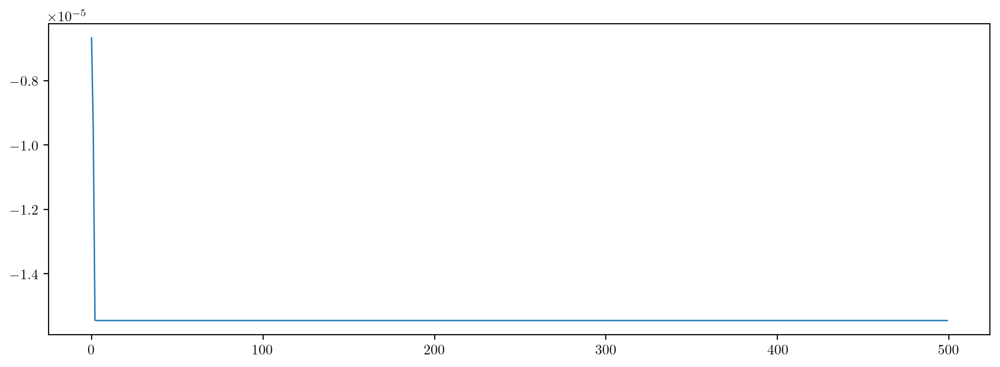

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
model = Model(l0, partial_sigs, payoffs, 10)

print(l0, model.forward())

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.05)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = 50)

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.l, model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.33it/s]


[-0.17919265  1.54098461 -1.21336099  0.35247524  0.2692877   0.91329632
  0.27533264  0.675261   -0.16243996  0.24491646  0.19817927  0.02728909
 -0.4282567   0.47573241  1.31870511] tensor(-0.0001, dtype=torch.float64, grad_fn=<NegBackward0>)


100%|██████████| 500/500 [00:00<00:00, 570.95it/s]

Parameter containing:
tensor([-0.1793,  1.5409, -1.2134,  0.3524,  0.2693,  0.9133,  0.2753,  0.6752,
        -0.1624,  0.2449,  0.1982,  0.0273, -0.4283,  0.4757,  1.3187],
       dtype=torch.float64, requires_grad=True) tensor(-0.0001, dtype=torch.float64, grad_fn=<NegBackward0>)


[None]

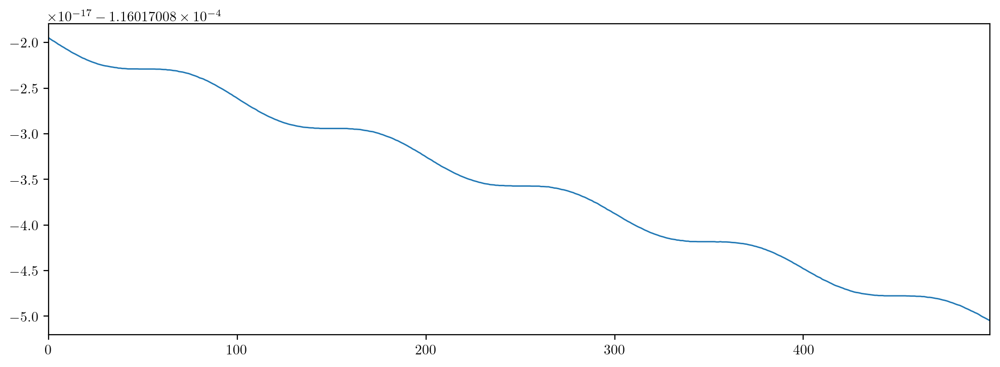

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
model = Model(l0, partial_sigs, payoffs, 10)

print(l0, model.forward())

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.05)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = 50)

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.l, model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 16.75it/s]


[ 0.61425258  0.36240747  0.23576762 -2.15874387 -0.50492147 -2.63940117
  1.8153501  -0.14282536 -1.07099549  0.99799694  2.25035522  1.10200613
  0.08046497 -0.35409419  0.62320974] tensor(-7.7162e-05, dtype=torch.float64, grad_fn=<NegBackward0>)


100%|██████████| 1000/1000 [00:01<00:00, 712.85it/s]

Parameter containing:
tensor([-0.6020,  0.2227,  0.1619, -1.7927, -0.2094, -3.1915,  1.8151,  0.1768,
        -0.9264,  0.6530,  2.2498,  0.4258,  0.0800, -0.3546,  0.6232],
       dtype=torch.float64, requires_grad=True) tensor(-9.1299e-05, dtype=torch.float64, grad_fn=<NegBackward0>)


[None]

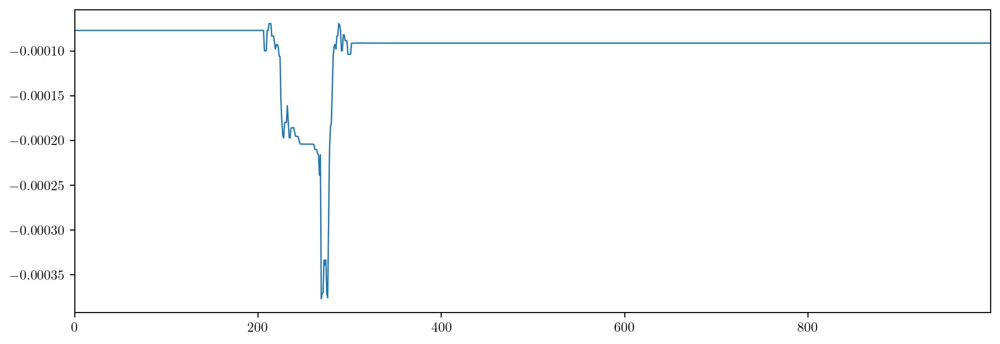

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
model = Model(l0, partial_sigs, payoffs, 10)

print(l0, model.forward())

max_epochs = 1000
optimiser = torch.optim.Adam(model.parameters(), lr=0.05)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = 50)

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.l, model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.87it/s]


[ 0.18325846  0.05668283  2.578043   -2.27779345  0.01094038  1.11160819
 -0.86726728  1.39127256 -1.27587016 -0.21680004 -1.07553732 -0.30757747
 -1.01598533 -1.58746445  0.27647258] tensor(-0.0001, dtype=torch.float64, grad_fn=<NegBackward0>)


100%|██████████| 1000/1000 [00:01<00:00, 724.45it/s]

Parameter containing:
tensor([ 0.0207, -0.1404,  2.6973, -2.4971, -0.1454,  1.3191, -0.8673,  1.1559,
        -1.4260, -0.2375, -1.0757, -0.1212, -1.0158, -1.5875,  0.2765],
       dtype=torch.float64, requires_grad=True) tensor(-0.0001, dtype=torch.float64, grad_fn=<NegBackward0>)


[None]

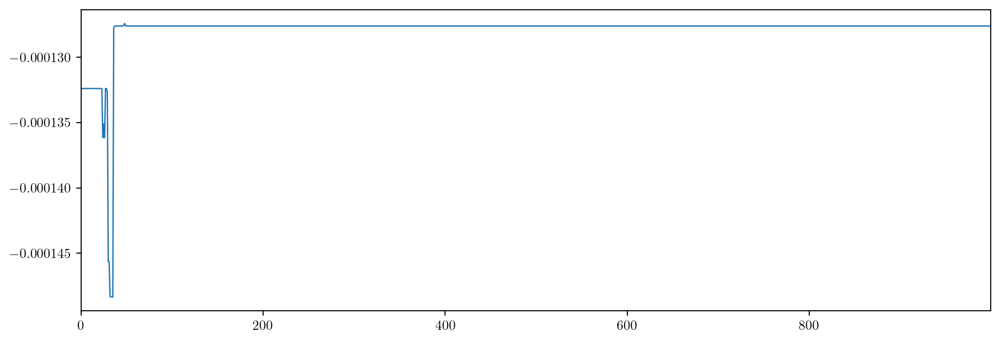

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
model = Model(l0, partial_sigs, payoffs, 10)

print(l0, model.forward())

max_epochs = 1000
optimiser = torch.optim.Adam(model.parameters(), lr=0.05)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = 200)

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.l, model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.81it/s]


[ 0.18694231 -0.64238092 -0.07049321  1.24289361 -0.94436143  0.64570722
 -0.80174137  0.11546509  0.1975335   0.28857642  0.71291416 -1.08106155
 -0.41566839  0.34781622  1.456857  ] tensor(-1.5386e-05, dtype=torch.float64, grad_fn=<NegBackward0>)


100%|██████████| 1000/1000 [00:01<00:00, 699.75it/s]


Parameter containing:
tensor([ 0.1869, -0.6424, -0.0705,  1.2429, -0.9444,  0.6457, -0.8017,  0.1155,
         0.1975,  0.2886,  0.7129, -1.0811, -0.4157,  0.3478,  1.4569],
       dtype=torch.float64, requires_grad=True) tensor(-1.5386e-05, dtype=torch.float64, grad_fn=<NegBackward0>)


[None]

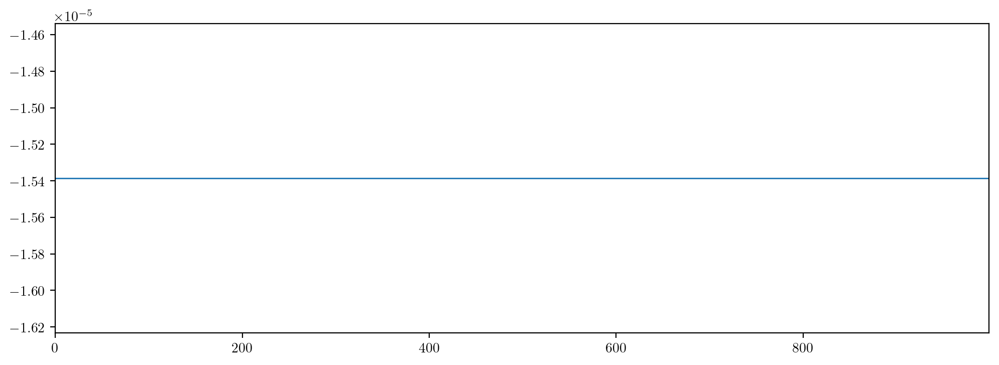

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
model = Model(l0, partial_sigs, payoffs, 10)

print(l0, model.forward())

max_epochs = 1000
optimiser = torch.optim.Adam(model.parameters(), lr=0.05)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = int(max_epochs/3))

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.l, model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.98it/s]


[ 0.54378606  0.35531825 -1.0592966  -0.22871471  1.14587582 -1.07702193
  1.13682172 -0.33098601 -0.29753605 -1.24502157 -0.77968579 -1.72526068
 -0.4168121   0.08153697 -1.26916698] tensor(-0.0003, dtype=torch.float64, grad_fn=<NegBackward0>)


100%|██████████| 1000/1000 [00:01<00:00, 709.51it/s]


Parameter containing:
tensor([ 0.3605,  0.5031, -0.7451,  0.6840,  1.8773, -0.5928,  1.1435,  0.6418,
         0.6274, -0.8520, -0.7581, -1.0956, -0.4060,  0.1024, -1.2692],
       dtype=torch.float64, requires_grad=True) tensor(-0.0001, dtype=torch.float64, grad_fn=<NegBackward0>)


[None]

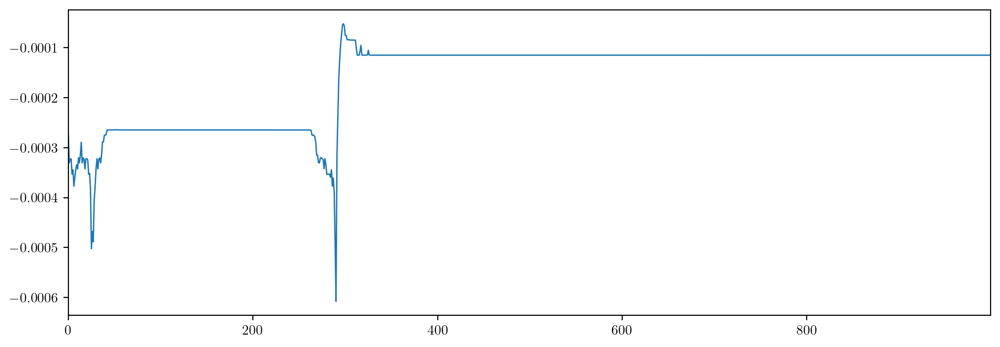

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
model = Model(l0, partial_sigs, payoffs, 10)

print(l0, model.forward())

max_epochs = 1000
optimiser = torch.optim.Adam(model.parameters(), lr=0.05)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.l, model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 16.87it/s]


[-0.1524873   0.17753828 -1.2545616  -0.27542827  0.52682405 -0.68001949
  2.11361135  0.6982857  -0.20802986  0.01858828 -0.48240737  1.41798489
 -0.48224713  1.04121361  0.83360432] tensor(-0.0002, dtype=torch.float64, grad_fn=<NegBackward0>)


100%|██████████| 200/200 [00:00<00:00, 749.83it/s]

Parameter containing:
tensor([-0.2839, -0.0907, -0.9175, -0.5888,  0.8183, -0.3439,  2.1140,  0.3410,
         0.0203,  0.2751, -0.4821,  1.7407, -0.4821,  1.0414,  0.8336],
       dtype=torch.float64, requires_grad=True) tensor(-0.0001, dtype=torch.float64, grad_fn=<NegBackward0>)


[None]

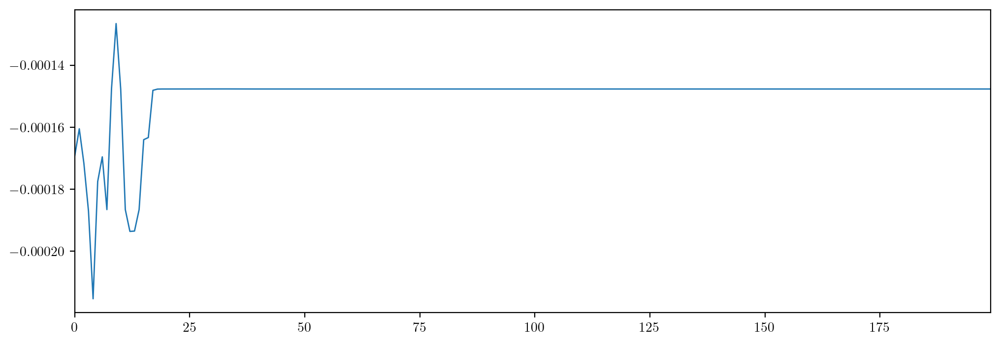

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
model = Model(l0, partial_sigs, payoffs, 10)

print(l0, model.forward())

max_epochs = 200
optimiser = torch.optim.Adam(model.parameters(), lr=0.05)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.l, model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.82it/s]


[ 1.4377091   0.1414033  -0.52444694  0.56717167 -1.01954439  1.71956199
  1.36001655 -1.11698556 -1.52037221  0.1772282  -0.28855529  0.36666716
  1.23080442 -2.01231345  0.2030826 ] tensor(-7.3452e-05, dtype=torch.float64, grad_fn=<NegBackward0>)


100%|██████████| 200/200 [00:00<00:00, 749.27it/s]

Parameter containing:
tensor([ 1.4376,  0.1414, -0.5244,  0.5672, -1.0195,  1.7196,  1.3600, -1.1170,
        -1.5204,  0.1772, -0.2886,  0.3667,  1.2308, -2.0123,  0.2031],
       dtype=torch.float64, requires_grad=True) tensor(-7.3452e-05, dtype=torch.float64, grad_fn=<NegBackward0>)


[None]

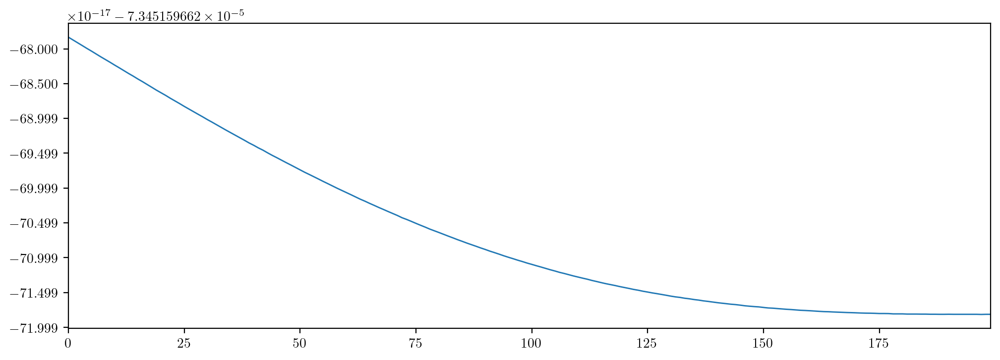

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
model = Model(l0, partial_sigs, payoffs, 10)

print(l0, model.forward())

max_epochs = 200
optimiser = torch.optim.Adam(model.parameters(), lr=0.05)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.l, model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.20it/s]


[ 1.95543645  1.44246281  0.72006971  1.15330832  0.24546669  0.77011186
  3.27657375  0.51216059  0.52578683 -0.97310546 -0.59589516  0.21749937
  1.73530534  0.01943363 -1.11043126] tensor(-1.1817e-05, dtype=torch.float64, grad_fn=<NegBackward0>)


100%|██████████| 500/500 [00:00<00:00, 744.30it/s]

Parameter containing:
tensor([ 1.8903,  1.3954,  0.7199,  1.1418,  0.2454,  0.7701,  3.2766,  0.5113,
         0.5258, -0.9731, -0.5959,  0.2175,  1.7353,  0.0194, -1.1104],
       dtype=torch.float64, requires_grad=True) tensor(-1.1818e-05, dtype=torch.float64, grad_fn=<NegBackward0>)


[None]

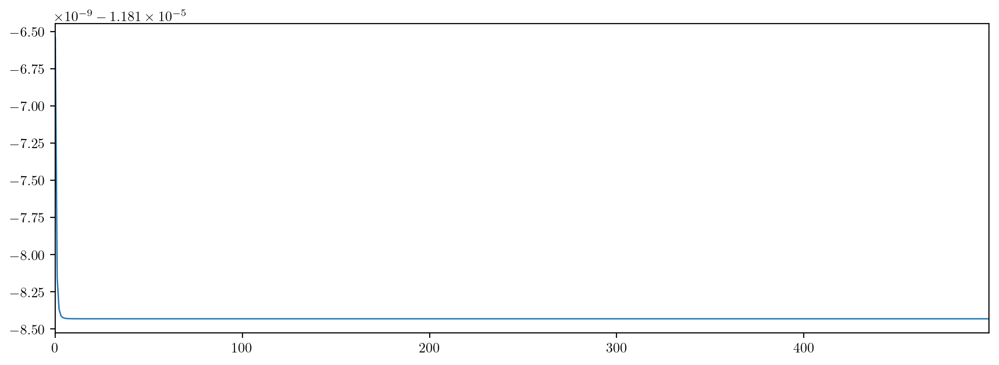

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
model = Model(l0, partial_sigs, payoffs, 10)

print(l0, model.forward())

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.01)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.l, model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.94it/s]


[-1.5633875   0.77369716  0.74635951  0.26337085 -0.0490204  -1.21253025
 -0.10086656 -0.77215253 -1.40355425  0.5076147  -1.11513275 -0.55178611
 -0.66129938  1.27795618  0.49586718] tensor(-6.5888e-05, dtype=torch.float64, grad_fn=<NegBackward0>)


100%|██████████| 500/500 [00:00<00:00, 722.83it/s]

Parameter containing:
tensor([-1.1592,  0.5753, -0.3478, -0.2420, -1.3559, -1.4670, -0.1022, -1.6158,
        -2.6951, -0.8196, -1.1167, -0.3244, -0.6613,  1.2765,  0.4959],
       dtype=torch.float64, requires_grad=True) tensor(-0.0001, dtype=torch.float64, grad_fn=<NegBackward0>)


[None]

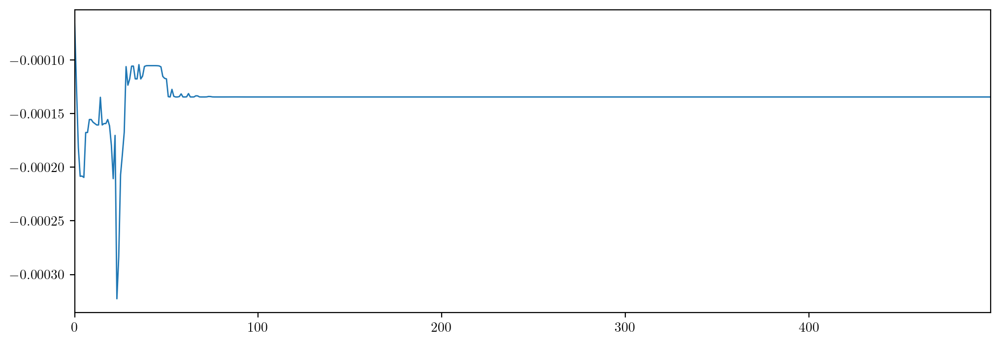

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
model = Model(l0, partial_sigs, payoffs, 10)

print(l0, model.forward())

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.1)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.l, model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.67it/s]


[-1.0597544   2.20974069  0.55721322 -1.53002211  0.38876038  0.1461413
  1.07831716  0.81938356  0.45374209  0.47175636  1.22792311 -0.84721966
  1.95553246 -1.43655893  0.2917803 ] tensor(-0.0002, dtype=torch.float64, grad_fn=<NegBackward0>)


100%|██████████| 500/500 [00:00<00:00, 699.17it/s]


Parameter containing:
tensor([-1.2113,  2.3081,  0.8089, -1.1502,  0.3237,  0.6912,  1.0797,  1.3999,
         0.2746,  0.9052,  1.2308, -0.3222,  1.9562, -1.4338,  0.2918],
       dtype=torch.float64, requires_grad=True) tensor(-0.0001, dtype=torch.float64, grad_fn=<NegBackward0>)


[None]

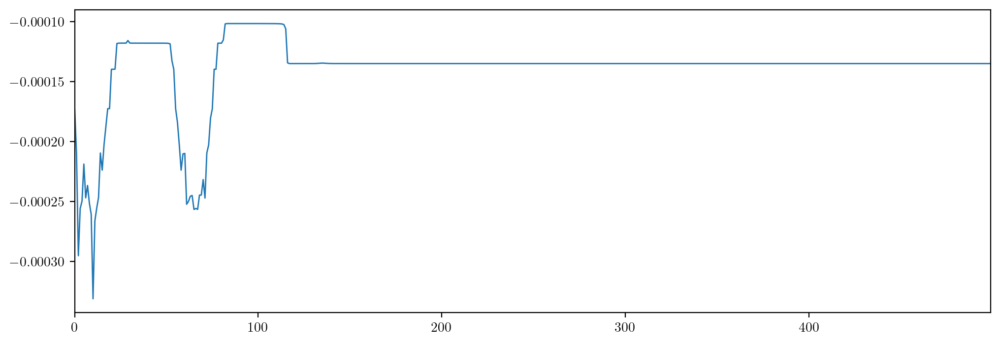

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
model = Model(l0, partial_sigs, payoffs, 10)

print(l0, model.forward())

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.1)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = 250)

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.l, model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.32it/s]


[-1.49021908  1.10906199 -0.81334662 -1.09732486 -0.74113048  0.42022405
  0.74218126  0.02222191 -0.22988088  0.18211474  1.23622846 -0.47018865
 -0.76610151 -1.79810595 -0.62775414] tensor(-5.5148e-05, dtype=torch.float64, grad_fn=<NegBackward0>)


100%|██████████| 300/300 [00:00<00:00, 684.66it/s]

Parameter containing:
tensor([-1.7636,  0.6528, -0.8078, -1.6674, -0.4761,  0.0793,  0.7423, -0.5458,
        -0.0387,  0.0617,  1.2362, -0.6643, -0.7661, -1.7981, -0.6278],
       dtype=torch.float64, requires_grad=True) tensor(-6.1998e-05, dtype=torch.float64, grad_fn=<NegBackward0>)


[None]

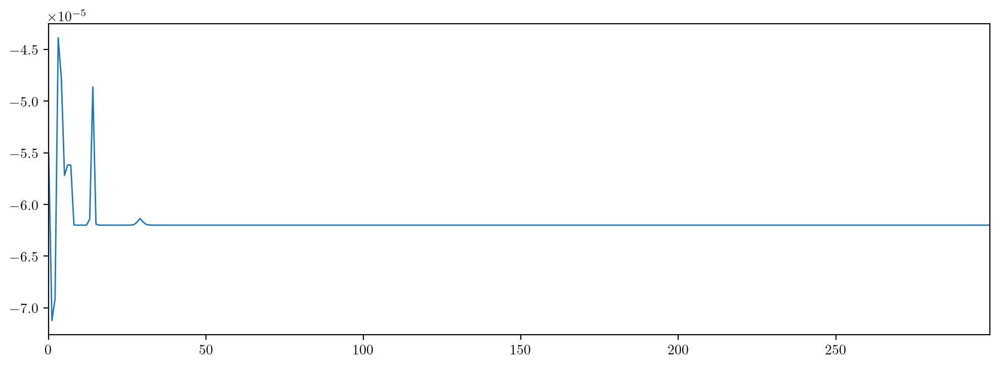

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
model = Model(l0, partial_sigs, payoffs, 10)

print(l0, model.forward())

max_epochs = 300
optimiser = torch.optim.Adam(model.parameters(), lr=0.1)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = int(max_epochs/2))

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.l, model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 16.87it/s]


[ 2.32920366 -0.30677821  1.19119629  2.43883737 -0.83626854 -1.49083138
  0.44786769 -0.26247088 -0.2656826   0.45538568  0.10950238 -1.19779739
 -0.3393481  -1.86511072  0.61502766] tensor(1.8258e-05, dtype=torch.float64, grad_fn=<NegBackward0>)


100%|██████████| 300/300 [00:00<00:00, 695.71it/s]

Parameter containing:
tensor([ 2.0323, -0.4792,  1.0952,  2.3832, -0.9015, -1.4702,  0.4478, -0.2367,
        -0.2731,  0.4532,  0.1095, -1.1952, -0.3393, -1.8651,  0.6150],
       dtype=torch.float64, requires_grad=True) tensor(1.3307e-05, dtype=torch.float64, grad_fn=<NegBackward0>)


[None]

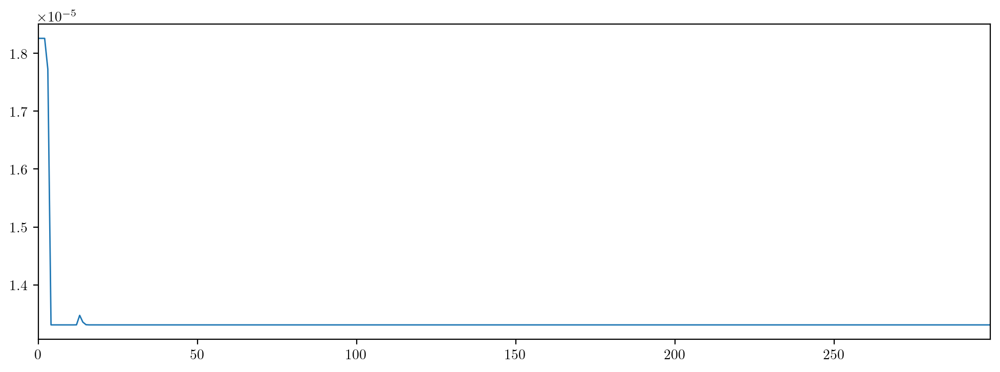

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
model = Model(l0, partial_sigs, payoffs, 10)

print(l0, model.forward())

max_epochs = 300
optimiser = torch.optim.Adam(model.parameters(), lr=0.1)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = int(max_epochs/2))

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    #scheduler.step() # update optimiser parameters


print(model.l, model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.11it/s]


[-0.69012043  0.29945924  0.95888125 -0.89295902  1.06974794 -0.2985572
  0.18859827 -0.79668673  0.7766029   0.95069251 -0.50369753 -0.72446335
 -0.35872226  0.1335894  -0.53884823] tensor(1.9307e-05, dtype=torch.float64, grad_fn=<NegBackward0>)


100%|██████████| 300/300 [00:00<00:00, 672.38it/s]

Parameter containing:
tensor([ 3.7320,  5.7596, -2.5270,  4.8424, -1.8540, -0.2417,  0.1909,  5.0395,
        -0.6451,  0.2383, -0.5021, -0.2418, -0.3584,  0.1344, -0.5388],
       dtype=torch.float64, requires_grad=True) tensor(-0., dtype=torch.float64, grad_fn=<NegBackward0>)


[None]

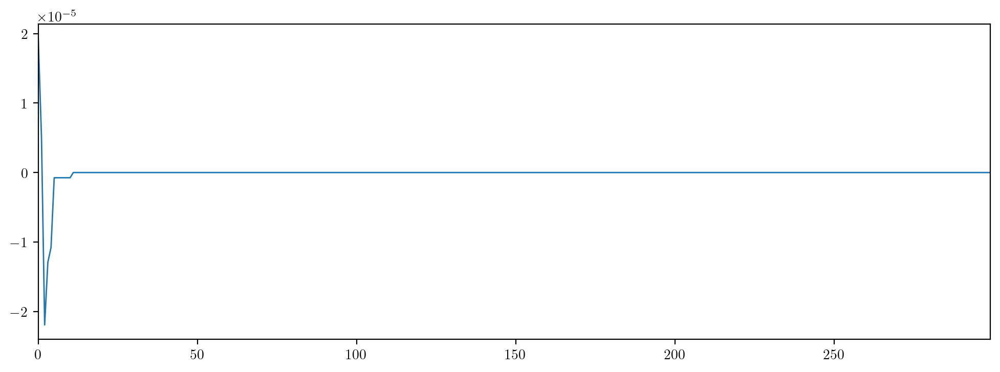

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
model = Model(l0, partial_sigs, payoffs, 10)

print(l0, model.forward())

max_epochs = 300
optimiser = torch.optim.Adam(model.parameters(), lr=1)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = int(max_epochs/2))

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    #scheduler.step() # update optimiser parameters


print(model.l, model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.28it/s]


[ 0.43541264 -0.38357558 -0.11050651 -0.11483104  0.18436463  0.58908027
  2.43230067  0.38363055 -0.46438276 -0.18950484 -0.34019224  0.4747517
 -0.42560025 -0.38399122  0.4588593 ] tensor(-0.0003, dtype=torch.float64, grad_fn=<NegBackward0>)


100%|██████████| 300/300 [00:00<00:00, 707.59it/s]

Parameter containing:
tensor([ 2.5495, -4.9294, -0.1123, -6.5808,  0.1789,  0.5857,  2.4323, -6.3967,
        -0.4729, -0.1938, -0.3402,  0.4714, -0.4256, -0.3840,  0.4589],
       dtype=torch.float64, requires_grad=True) tensor(-4.0639e-05, dtype=torch.float64, grad_fn=<NegBackward0>)


[None]

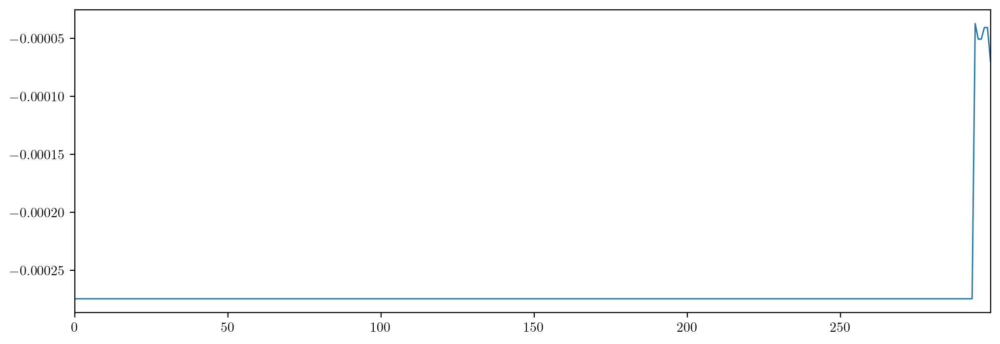

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
model = Model(l0, partial_sigs, payoffs, 10)

print(l0, model.forward())

max_epochs = 300
optimiser = torch.optim.Adam(model.parameters(), lr=1)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = int(max_epochs/2))

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.l, model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.29it/s]


[-0.65390531 -1.75699378  0.04460746 -0.76547478 -0.79948534 -1.36312304
 -0.97908097  0.68571402  0.12245096 -0.68994142  1.11648046 -1.78804996
  0.23085545 -1.23905177 -0.13087133] tensor(-2.4072e-05, dtype=torch.float64, grad_fn=<NegBackward0>)


100%|██████████| 300/300 [00:00<00:00, 744.96it/s]

Parameter containing:
tensor([-0.6476, -1.7545,  0.0446, -0.7649, -0.7995, -1.3631, -0.9791,  0.6858,
         0.1225, -0.6899,  1.1165, -1.7881,  0.2309, -1.2391, -0.1309],
       dtype=torch.float64, requires_grad=True) tensor(-2.4072e-05, dtype=torch.float64, grad_fn=<NegBackward0>)


[None]

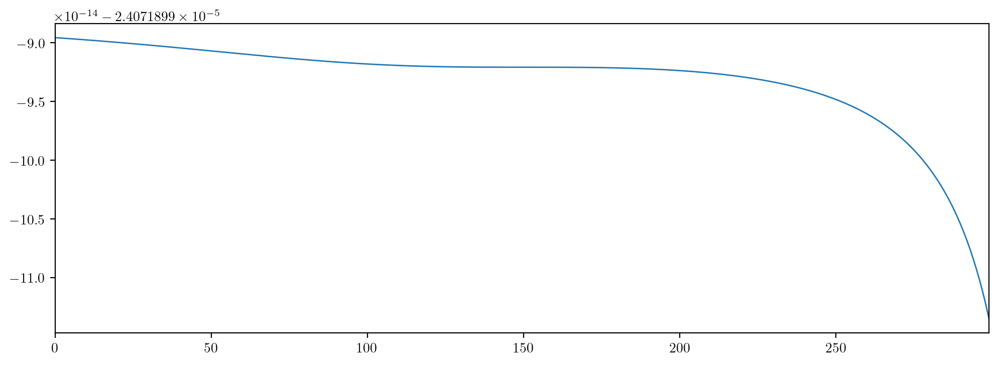

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
model = Model(l0, partial_sigs, payoffs, 10)

print(l0, model.forward())

max_epochs = 300
optimiser = torch.optim.Adam(model.parameters(), lr=0.2)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = int(max_epochs/2))

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.l, model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.31it/s]


[ 0.674702   -0.72222733  1.2329222  -0.02702994  0.99633532 -0.76633135
 -0.27489433 -0.29603712  1.50292596 -0.11339066  0.4928141   0.35730709
 -0.92315193  0.9806003  -1.41901823] tensor(-0.0002, dtype=torch.float64, grad_fn=<NegBackward0>)


100%|██████████| 500/500 [00:00<00:00, 727.78it/s]

Parameter containing:
tensor([ 0.6902, -0.7039,  1.2411, -0.0088,  1.0051, -0.7601, -0.2749, -0.2794,
         1.5116, -0.1064,  0.4928,  0.3608, -0.9231,  0.9806, -1.4190],
       dtype=torch.float64, requires_grad=True) tensor(-0.0002, dtype=torch.float64, grad_fn=<NegBackward0>)


[None]

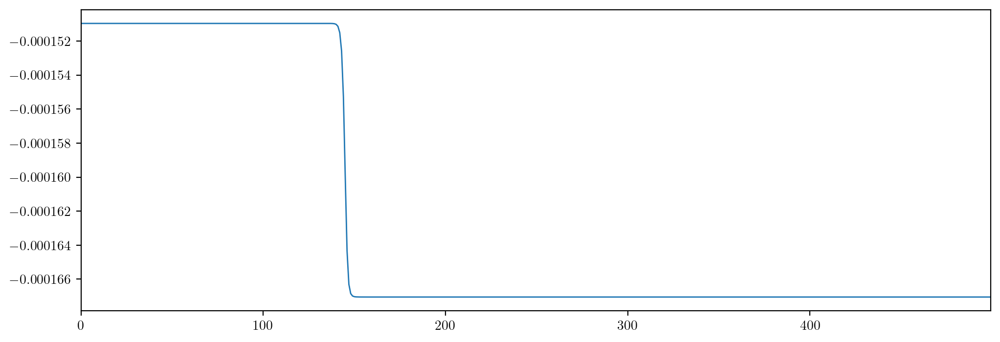

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
model = Model(l0, partial_sigs, payoffs, 10)

print(l0, model.forward())

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.001)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = int(max_epochs/2))

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.l, model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.76it/s]


[-0.41920251 -0.03821632 -1.23955824  0.58137108  0.50047842  0.00390329
  1.21037364  0.74162594  1.07970333  0.32805767  0.69099501  0.63278454
  0.77122607  0.55307531 -1.07111909] tensor(-7.5675e-05, dtype=torch.float64, grad_fn=<NegBackward0>)


100%|██████████| 500/500 [00:00<00:00, 752.82it/s]

Parameter containing:
tensor([-0.4526,  0.1354, -1.3499,  0.7560,  0.3609,  0.1189,  1.2103,  0.9117,
         0.9549,  0.3557,  0.6910,  0.7063,  0.7712,  0.5531, -1.0711],
       dtype=torch.float64, requires_grad=True) tensor(-9.2623e-05, dtype=torch.float64, grad_fn=<NegBackward0>)


[None]

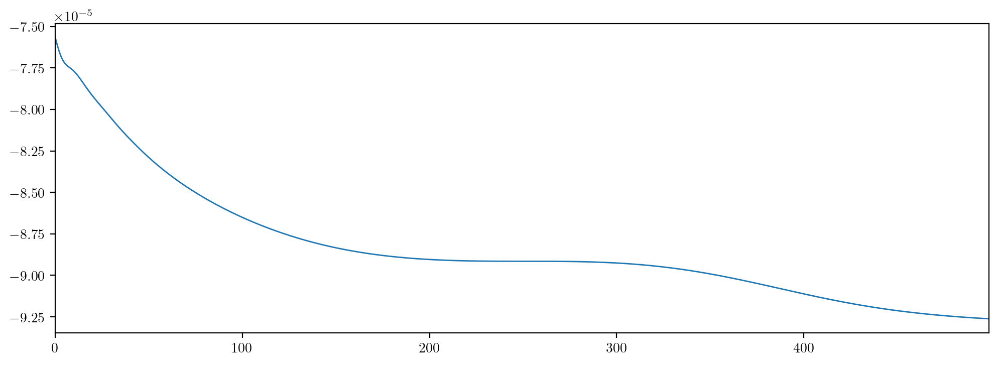

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
model = Model(l0, partial_sigs, payoffs, 1)

print(l0, model.forward())

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.001)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = int(max_epochs/2))

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.l, model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
model = Model(l0, partial_sigs, payoffs, 1)

print(loss(l0, partial_sigs, payoffs, 1))

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.001)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = int(max_epochs/2))

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.98it/s]


TypeError: 'Tensor' object is not callable

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
model = Model(l0, partial_sigs, payoffs, 1)

print(loss_fn(l0, partial_sigs, payoffs, 1))

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.001)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = int(max_epochs/2))

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.94it/s]


TypeError: cumsum() received an invalid combination of arguments - got (numpy.ndarray, dim=int), but expected one of:
 * (Tensor input, int dim, *, torch.dtype dtype = None, Tensor out = None)
 * (Tensor input, name dim, *, torch.dtype dtype = None, Tensor out = None)


vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.13it/s]


tensor(-0., dtype=torch.float64)


100%|██████████| 500/500 [00:00<00:00, 560.37it/s]

tensor(-0., dtype=torch.float64, grad_fn=<NegBackward0>)


[None]

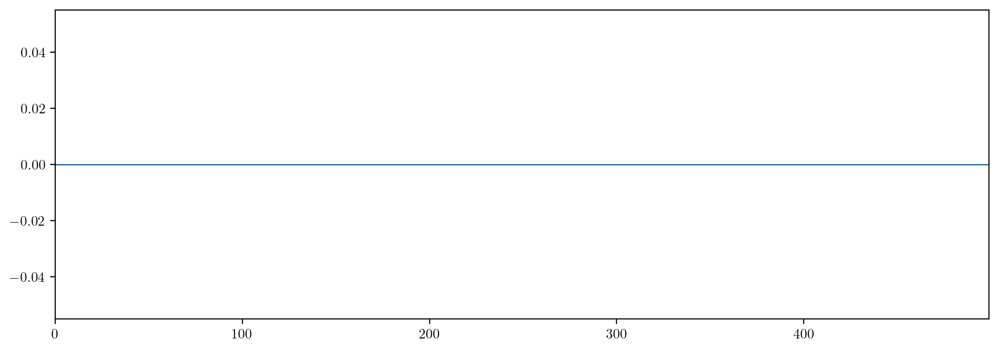

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
model = Model(l0, partial_sigs, payoffs, 1)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), 1))

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.001)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = int(max_epochs/2))

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.65it/s]


tensor(2.3234e-17, dtype=torch.float64)


100%|██████████| 500/500 [00:00<00:00, 563.44it/s]

tensor(2.3234e-17, dtype=torch.float64, grad_fn=<NegBackward0>)


[None]

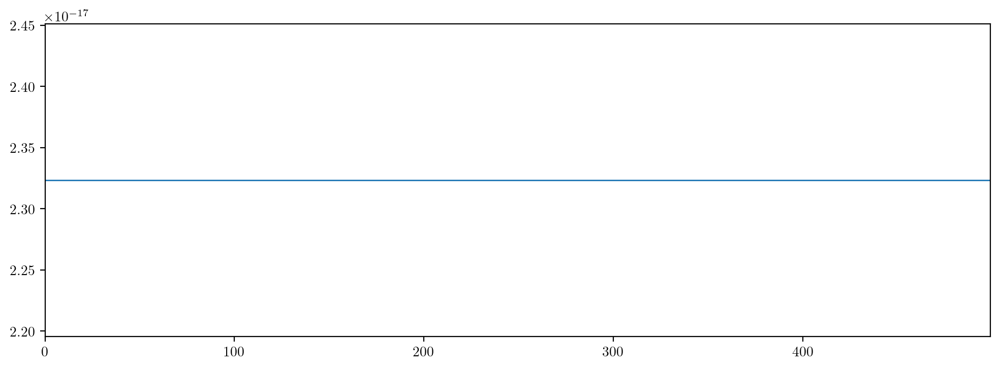

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
model = Model(l0, partial_sigs, payoffs, 1)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), 1))

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.001)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = int(max_epochs/2))

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 18.14it/s]


tensor(-3.4918e-17, dtype=torch.float64)


100%|██████████| 500/500 [00:00<00:00, 545.93it/s]

tensor(-3.4918e-17, dtype=torch.float64, grad_fn=<NegBackward0>)


[None]

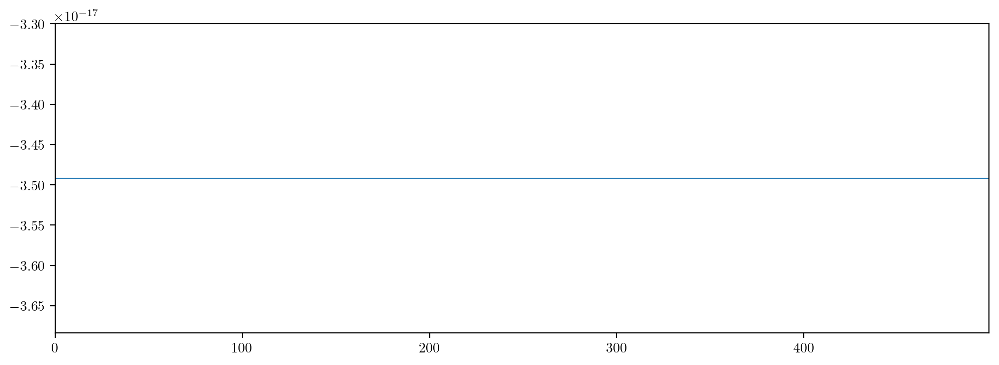

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
model = Model(l0, partial_sigs, payoffs, 1)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), 1))

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.01)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = int(max_epochs/2))

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

In [ ]:
model()

tensor(-3.4918e-17, dtype=torch.float64, grad_fn=<NegBackward0>)

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
model = Model(l0, partial_sigs, payoffs, 1)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), 1))

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.01)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = int(max_epochs/2))

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward(), np.sum(abs(l0 - model.l)))
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.60it/s]


tensor(-2.2113e-05, dtype=torch.float64)


100%|██████████| 500/500 [00:00<00:00, 569.77it/s]


TypeError: unsupported operand type(s) for -: 'numpy.ndarray' and 'Parameter'

In [ ]:
model.lo

AttributeError: 'Model' object has no attribute 'lo'

In [ ]:
model.l

Parameter containing:
tensor([ 0.3285,  0.8450,  0.1424,  0.3061, -0.0615,  0.5622, -1.1942, -0.4640,
        -0.4603, -0.0895,  1.2915, -1.7352, -0.0578, -0.1705, -1.1721],
       dtype=torch.float64, requires_grad=True)

In [ ]:
model.l.values

<function Parameter.values>

In [ ]:
model.l.values()

RuntimeError: values expected sparse tensor layout but got Strided

In [ ]:
model.l

Parameter containing:
tensor([ 0.3285,  0.8450,  0.1424,  0.3061, -0.0615,  0.5622, -1.1942, -0.4640,
        -0.4603, -0.0895,  1.2915, -1.7352, -0.0578, -0.1705, -1.1721],
       dtype=torch.float64, requires_grad=True)

In [ ]:
l0

array([ 0.32852137,  0.84498739,  0.14241973,  0.30612739, -0.06147829,
        0.56224155, -1.19420146, -0.46402986, -0.46026571, -0.08952309,
        1.29148287, -1.73515417, -0.05781887, -0.17045604, -1.172127  ])

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
model = Model(l0, partial_sigs, payoffs, 1)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), 0.1))

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.01)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = int(max_epochs/2))

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward(), np.sum(abs(l0 - model.l)))
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.88it/s]


tensor(-1.7233e-15, dtype=torch.float64)


100%|██████████| 500/500 [00:00<00:00, 550.52it/s]


TypeError: unsupported operand type(s) for -: 'numpy.ndarray' and 'Parameter'

In [ ]:
model.l.data

tensor([ 0.3330, -0.2874,  1.5499,  0.0784,  0.6467,  0.5992, -0.9353, -1.0822,
         0.3204,  0.8610,  1.0804, -0.3965,  1.2652,  0.1849,  1.4401],
       dtype=torch.float64)

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
model = Model(l0, partial_sigs, payoffs, 1)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), 0.1))

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.01)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = int(max_epochs/2))

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward(), np.sum(abs(l0 - model.l.data)))
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 18.17it/s]


tensor(-1.2143e-21, dtype=torch.float64)


100%|██████████| 500/500 [00:00<00:00, 584.85it/s]


TypeError: unsupported operand type(s) for -: 'numpy.ndarray' and 'Tensor'

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.65it/s]


tensor(-5.0139e-21, dtype=torch.float64)


100%|██████████| 500/500 [00:00<00:00, 576.22it/s]

tensor(-2.1294e-13, dtype=torch.float64, grad_fn=<NegBackward0>) 0.0


[None]

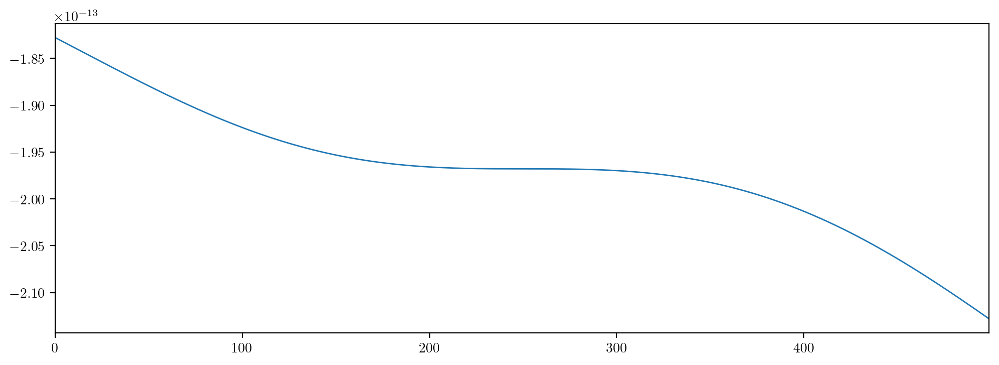

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
model = Model(l0, partial_sigs, payoffs, 1)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), 0.1))

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.01)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = int(max_epochs/2))

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward(), np.sum(abs(l0 - np.array(model.l.data))))
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.65it/s]


tensor(-0., dtype=torch.float64)


100%|██████████| 500/500 [00:00<00:00, 555.68it/s]

tensor(-2.3793e-14, dtype=torch.float64, grad_fn=<NegBackward0>) 0.0


[None]

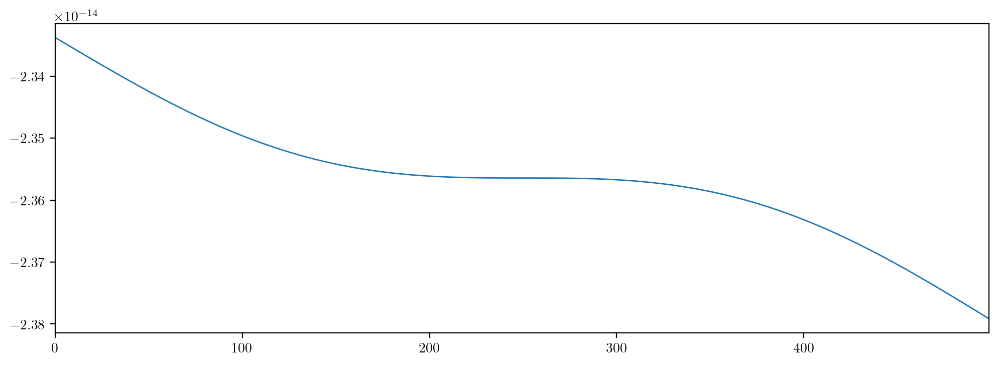

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
model = Model(l0, partial_sigs, payoffs, 1)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), 0.1))

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.01)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = int(max_epochs/2))

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward(), np.sum(abs(l0 - np.array(model.l.data))))
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.93it/s]


tensor(-0.0001, dtype=torch.float64)


100%|██████████| 500/500 [00:00<00:00, 541.84it/s]

tensor(-0.0001, dtype=torch.float64, grad_fn=<NegBackward0>) 0.0


[None]

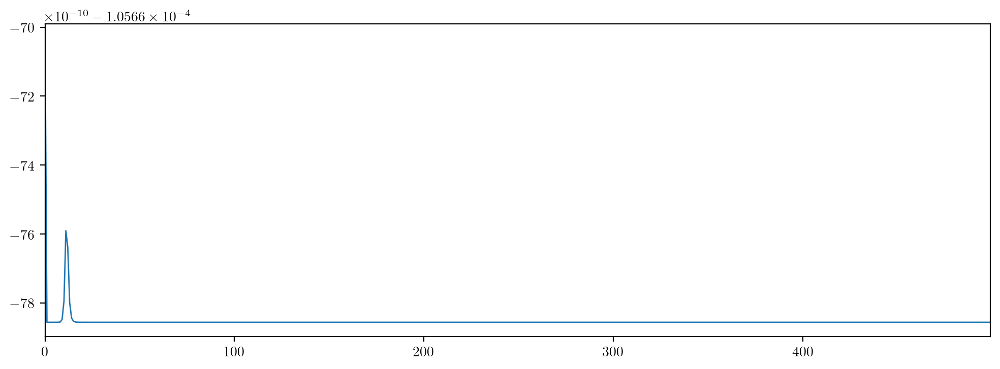

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
k=10
model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.01)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = int(max_epochs/2))

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward(), np.sum(abs(l0 - np.array(model.l.data))))
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.91it/s]


tensor(-0.0001, dtype=torch.float64)


100%|██████████| 500/500 [00:00<00:00, 589.95it/s]

tensor(-0.0004, dtype=torch.float64, grad_fn=<NegBackward0>) 0.0


[None]

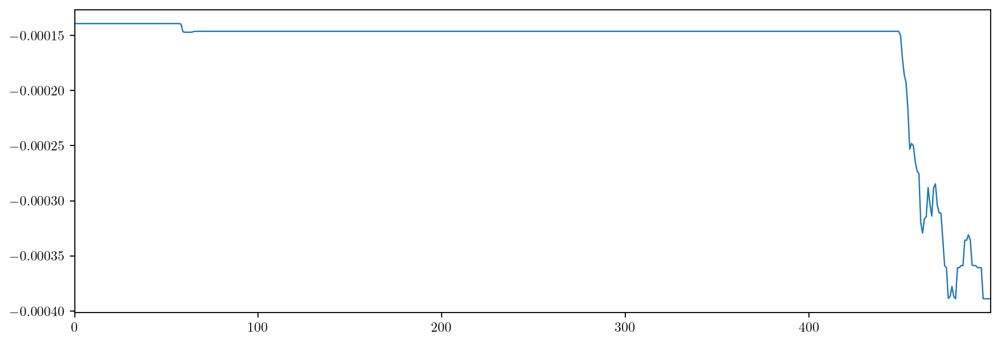

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
k=10
model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.01)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = int(max_epochs/2))

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward(), np.sum(abs(l0 - np.array(model.l.data))))
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 18.01it/s]


tensor(-6.5146e-05, dtype=torch.float64)


100%|██████████| 500/500 [00:00<00:00, 571.20it/s]

tensor(-6.5146e-05, dtype=torch.float64, grad_fn=<NegBackward0>) 0.0


[None]

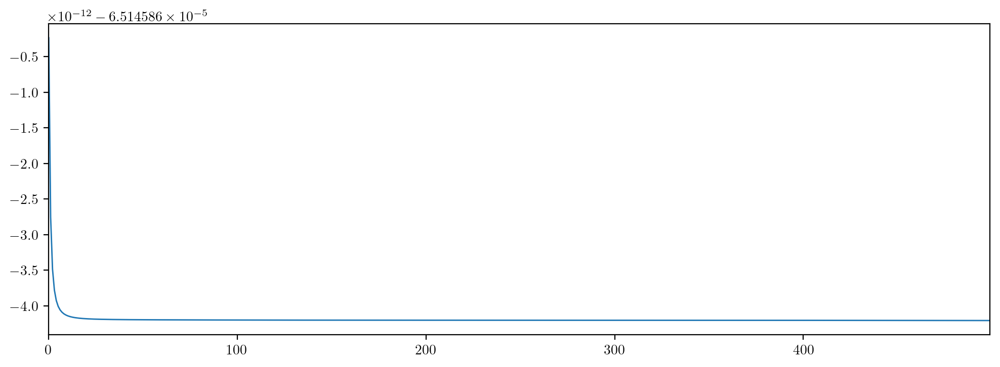

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
k=15
model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.01)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = int(max_epochs/2))

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward(), np.sum(abs(l0 - np.array(model.l.data))))
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 18.03it/s]


tensor(-9.7147e-05, dtype=torch.float64)


100%|██████████| 500/500 [00:00<00:00, 565.75it/s]

tensor(-0.0001, dtype=torch.float64, grad_fn=<NegBackward0>) 0.0


[None]

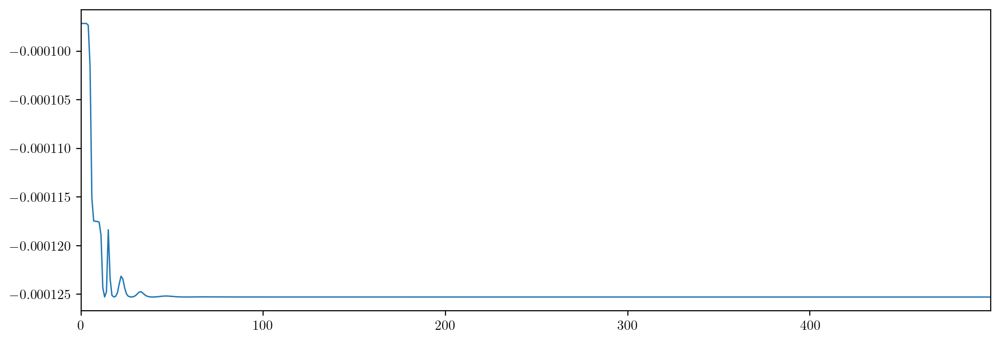

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2], scale = 2)
k=15
model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.01)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = int(max_epochs/2))

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward(), np.sum(abs(l0 - np.array(model.l.data))))
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.81it/s]


tensor(-5.4064e-06, dtype=torch.float64)


100%|██████████| 500/500 [00:00<00:00, 557.38it/s]

tensor(-5.7171e-06, dtype=torch.float64, grad_fn=<NegBackward0>) 0.0


[None]

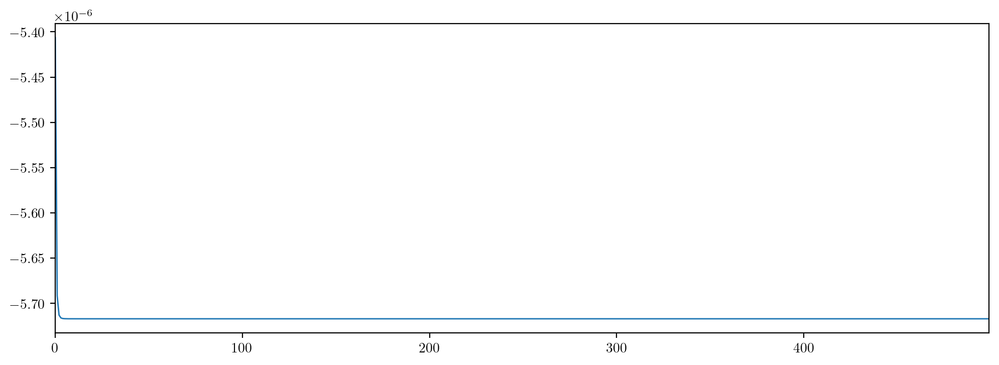

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2], scale = 2)
k=15
model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.01)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = int(max_epochs/2))

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward(), np.sum(abs(l0 - np.array(model.l.data))))
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

In [ ]:
np.array(model.l.data)

array([ 2.30950356,  2.24388821, -3.34546175, -0.09863956,  0.73791108,
        1.37059128, -0.66296297, -0.14469305, -0.91062468, -1.93451776,
        0.26348371,  0.03633165, -2.01438033,  0.98020277, -1.66156925])

In [ ]:
l0

array([ 2.30950356,  2.24388821, -3.34546175, -0.09863956,  0.73791108,
        1.37059128, -0.66296297, -0.14469305, -0.91062468, -1.93451776,
        0.26348371,  0.03633165, -2.01438033,  0.98020277, -1.66156925])

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 18.15it/s]


tensor(-2.0751e-05, dtype=torch.float64)


100%|██████████| 500/500 [00:00<00:00, 560.20it/s]

tensor(-2.0751e-05, dtype=torch.float64, grad_fn=<NegBackward0>) 0.0


[None]

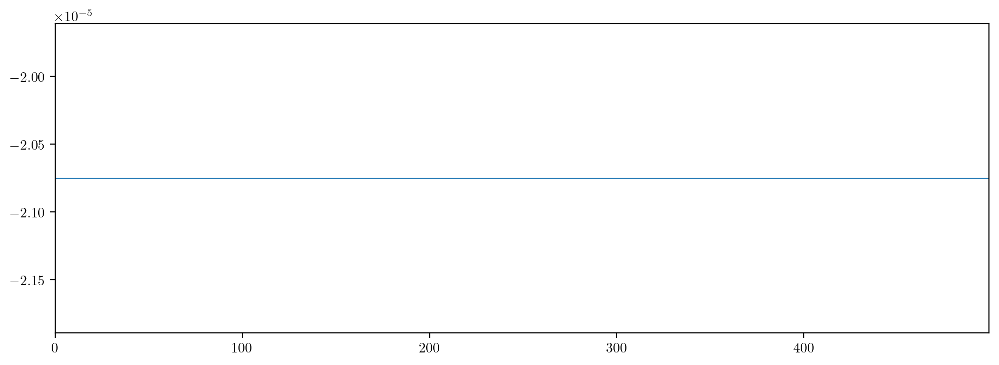

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2], scale = 2)
k=15
model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.01)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = int(max_epochs/2))

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters
model.eval()

print(model.forward(), np.sum(abs(l0 - np.array(model.l.data))))
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.94it/s]


tensor(3.2924e-05, dtype=torch.float64)


100%|██████████| 500/500 [00:00<00:00, 570.86it/s]

tensor(1.4534e-05, dtype=torch.float64, grad_fn=<NegBackward0>) 0.0


[None]

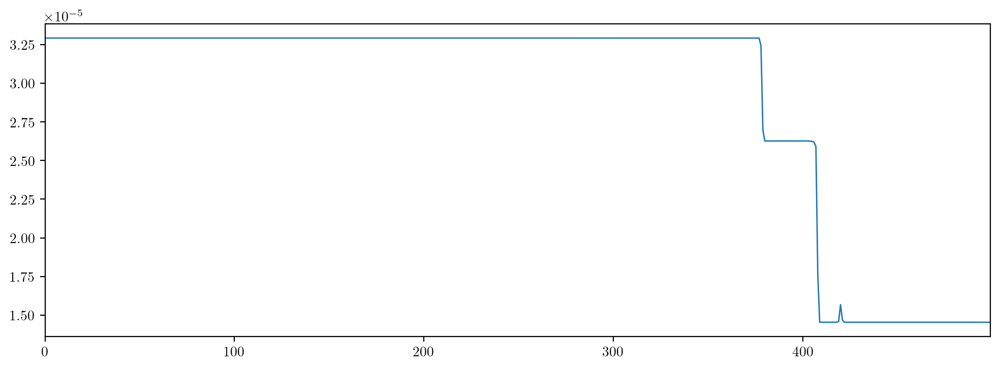

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2], scale = 2)
k=15
model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.01)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = int(max_epochs/2))

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters
model.eval()

print(model.forward(), np.sum(abs(l0 - np.array(model.l.data))))
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

In [ ]:
model

Model()

In [ ]:
model.l

Parameter containing:
tensor([-1.3553,  0.1847,  2.7752, -2.4689, -0.2420,  2.4082,  0.8052, -0.2142,
        -0.1130,  0.1086, -1.3859,  2.3002, -3.4118,  0.0077, -1.0456],
       dtype=torch.float64, requires_grad=True)

In [ ]:
l0

array([-1.35534184,  0.18470821,  2.77520534, -2.46889241, -0.24203866,
        2.40821006,  0.80518613, -0.21416837, -0.11295498,  0.10864346,
       -1.38594996,  2.30016026, -3.41184157,  0.00766472, -1.04560568])

In [ ]:
model.backward()

AttributeError: 'Model' object has no attribute 'backward'

In [ ]:
optimiser.zero_grad()

In [ ]:
out = model()

In [ ]:
out.backward

<bound method Tensor.backward of tensor(1.4534e-05, dtype=torch.float64, grad_fn=<NegBackward0>)>

In [ ]:
out.backward()

In [ ]:
print(out.backward())

RuntimeError: Trying to backward through the graph a second time (or directly access saved tensors after they have already been freed). Saved intermediate values of the graph are freed when you call .backward() or autograd.grad(). Specify retain_graph=True if you need to backward through the graph a second time or if you need to access saved tensors after calling backward.

In [ ]:
out

tensor(1.4534e-05, dtype=torch.float64, grad_fn=<NegBackward0>)

In [ ]:
out.grad_fn(l0)

TypeError: argument 0 is not a Variable

In [ ]:
out.grad_fn(l)

NameError: name 'l' is not defined

In [ ]:
out.grad_fn(model.l)

tensor([ 1.3553, -0.1847, -2.7752,  2.4689,  0.2420, -2.4082, -0.8052,  0.2142,
         0.1130, -0.1086,  1.3859, -2.3002,  3.4118, -0.0077,  1.0456],
       dtype=torch.float64, grad_fn=<NegBackward0>)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.82it/s]


tensor(-0.0002, dtype=torch.float64)


100%|██████████| 500/500 [00:00<00:00, 590.62it/s]

tensor(-0.0002, dtype=torch.float64, grad_fn=<NegBackward0>) 0.0


[None]

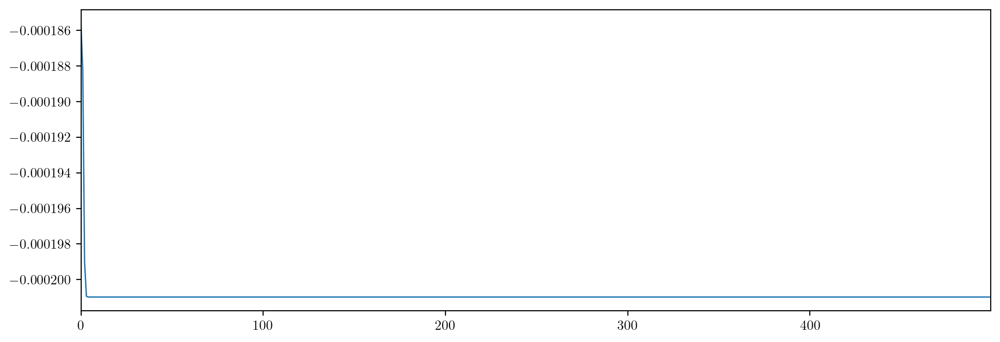

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2], scale = 2)
k=15
model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.01)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters
model.eval()

print(model.forward(), np.sum(abs(l0 - np.array(model.l.data))))
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.76it/s]


tensor(1.4821e-06, dtype=torch.float64)


100%|██████████| 500/500 [00:00<00:00, 569.79it/s]

tensor(1.4821e-06, dtype=torch.float64, grad_fn=<NegBackward0>) 0.0


[None]

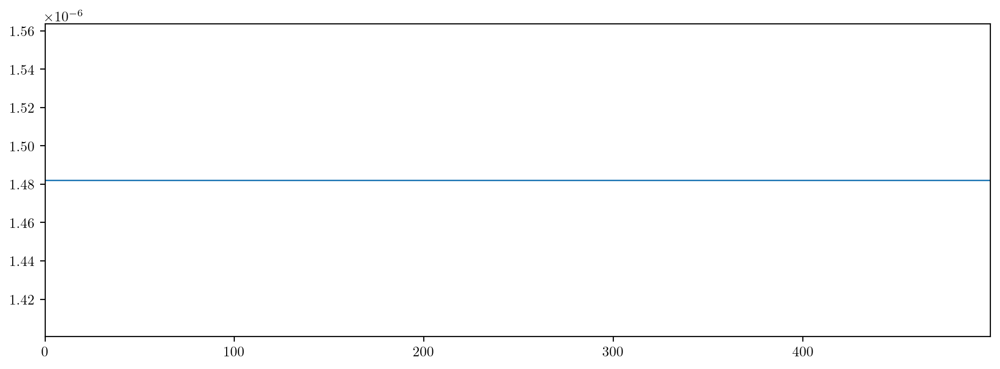

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2], scale = 2)
k=15
model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.01)
#scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    #scheduler.step() # update optimiser parameters
model.eval()

print(model.forward(), np.sum(abs(l0 - np.array(model.l.data))))
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 18.02it/s]


tensor(3.0304e-05, dtype=torch.float64)


100%|██████████| 500/500 [00:00<00:00, 566.34it/s]

tensor(8.0138e-06, dtype=torch.float64, grad_fn=<NegBackward0>) 0.0


[None]

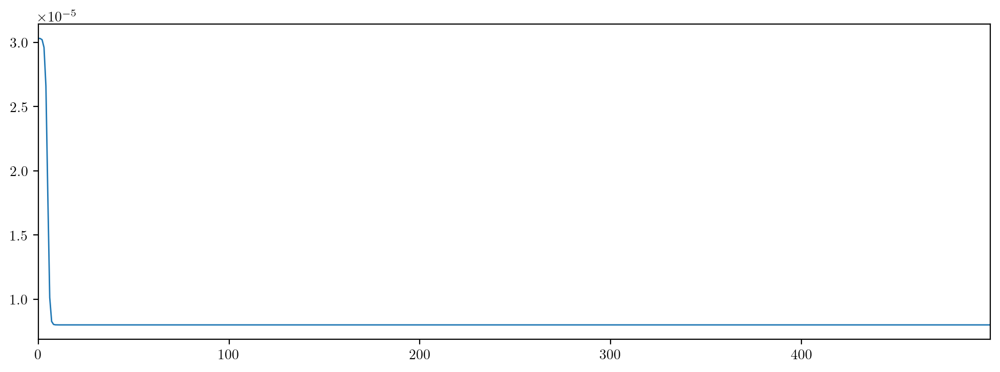

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2], scale = 2)
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.01)
#scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    #scheduler.step() # update optimiser parameters
model.eval()

print(model.forward(), np.sum(abs(l0 - np.array(model.l.data))))
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.59it/s]


tensor(-4.8408e-05, dtype=torch.float64)


100%|██████████| 500/500 [00:00<00:00, 542.04it/s]

tensor(-5.6204e-05, dtype=torch.float64, grad_fn=<NegBackward0>) 0.0


[None]

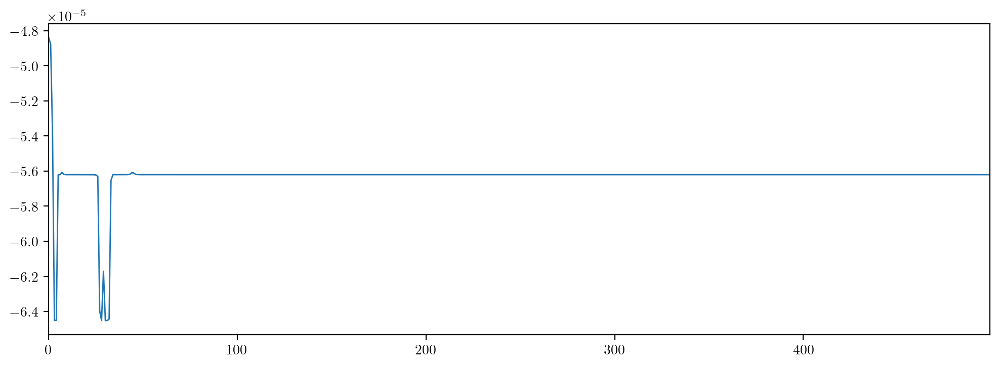

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.random.normal(size=partial_sigs.shape[2], scale = 2)
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.05)
#scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    #scheduler.step() # update optimiser parameters
model.eval()

print(model.forward(), np.sum(abs(l0 - np.array(model.l.data))))
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

In [ ]:
loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k)

tensor(-5.6204e-05, dtype=torch.float64)

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.ones(size=partial_sigs.shape[2])
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.05)
#scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    #scheduler.step() # update optimiser parameters
model.eval()

print(model.forward(), np.sum(abs(l0 - np.array(model.l.data))))
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 18.18it/s]


TypeError: ones() got an unexpected keyword argument 'size'

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 18.03it/s]


tensor(-5.3308e-05, dtype=torch.float64)


100%|██████████| 500/500 [00:00<00:00, 609.36it/s]

tensor(-5.3309e-05, dtype=torch.float64, grad_fn=<NegBackward0>) 0.0


[None]

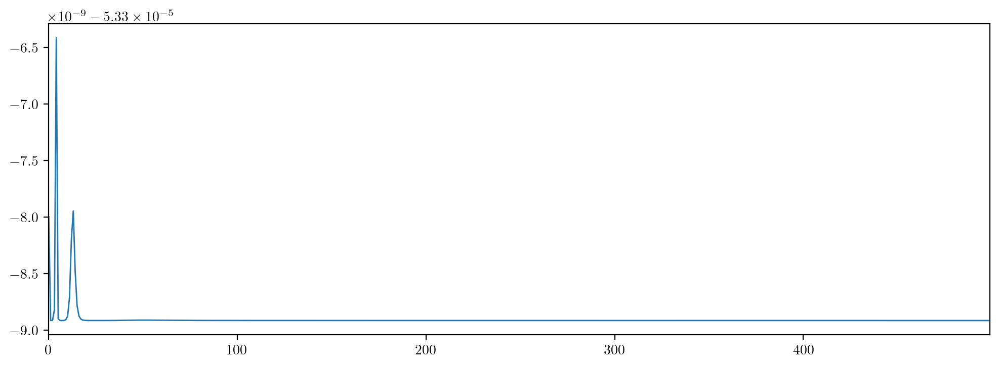

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.ones(partial_sigs.shape[2])
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.05)
#scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    #scheduler.step() # update optimiser parameters
model.eval()

print(model.forward(), np.sum(abs(l0 - np.array(model.l.data))))
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.92it/s]


tensor(-2.3821e-05, dtype=torch.float64)


100%|██████████| 500/500 [00:00<00:00, 561.62it/s]

tensor(-2.3824e-05, dtype=torch.float64, grad_fn=<NegBackward0>) 0.0


[None]

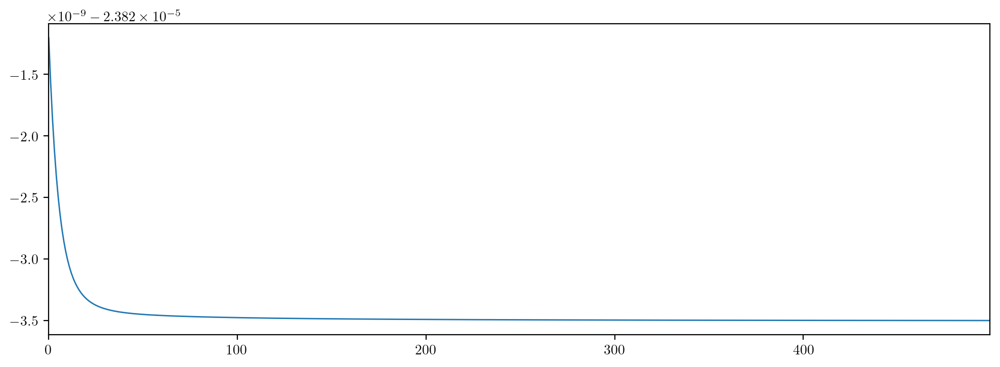

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.ones(partial_sigs.shape[2])
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.001)
#scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    #scheduler.step() # update optimiser parameters
model.eval()

print(model.forward(), np.sum(abs(l0 - np.array(model.l.data))))
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

In [ ]:
from optimal_stopping_times import * 

def loss(l):
        #   inner product between l and signatures 
        in_prod = np.apply_along_axis(lambda x: np.inner(l, x), -1, partial_sigs)
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = np.apply_along_axis(np.cumsum, -1, sig_dist)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+np.exp(-20*(x-k)))
        partial_cdf_sums = np.apply_along_axis(G, -1, partial_sig_dist_sum)
        losses = np.einsum('ij, ij -> i', payoffs, partial_cdf_sums)

        return -np.mean(losses)

def grad(l):
    #   inner product between l and signatures 
    in_prod = np.apply_along_axis(lambda x: np.inner(l, x), -1, partial_sigs)
    #   inner prod squared
    sig_dist = in_prod**2

    #   partial sums of square of inner prod for increasing time M x (N-1)
    partial_sig_dist_sum = np.apply_along_axis(np.cumsum, -1, sig_dist)

    G_dash = lambda x: 20 * (1 + np.exp(-20*(x-k)))**(-2)
    #   partial signatures squared, M x (N-1) x (siglen+1)
    partial_sig_sq = partial_sigs**2

    #   cum sum of partial signatures in l_k, sum_{i=0}^j (X_i)k^2, M x (N-1) x (siglen+1)
    ps_sig_dist_cum =  np.apply_along_axis(np.cumsum, 1, partial_sig_sq)

    #   G'(sum over i (inner(l, x_i))), M x (N-1)
    partial_pdf_sums = np.apply_along_axis(G_dash, -1, partial_sig_dist_sum)

    #   (Y_j+1 - Y_j) * G'(sum), M x (N-1)
    partial_payoff_scaled = payoffs * partial_pdf_sums

    #   putting it together, M x (siglen + 1)
    grad_summed = np.einsum('ijk, ij -> ik',  2*ps_sig_dist_cum, partial_payoff_scaled)
    return -np.mean(grad_summed, axis=0) * l

def adam_opt(lr_max = 0.05, betas = (0, 0.2), eps = 1e-8, restart = 80, layers = 500):
    learn_rate = lambda T: 0.00005 + 1/2 * (lr_max - 0.00005) * (1 + np.cos((T % restart)/restart * np.pi))

    n = partial_sigs.shape[2]
    m = np.zeros(n)
    v = np.zeros(n)

    b1 = betas[0]
    b2 = betas[1]

    losses = np.zeros(layers)
    params = np.zeros((layers, n))

    l = np.random.normal(size=n)
    print(loss(l))

    def adm_update(m_prev, v_prev, l, t):
        lr = learn_rate(t)
        g = grad(l)
        m = b1 * m_prev + (1-b1)*g
        v = b2 * v_prev + (1-b2) * g**2

        m_hat = m/(1-b1**(t+1))
        v_hat = v/(1-b2**(t+1))

        l_opt = l - lr * m_hat / (np.sqrt(v_hat) + eps)
        return l_opt, m, v
    
    for t in tqdm(range(layers)):
        l, m, v = adm_update(m, v, l, t)
        cur_loss = loss(l)
        if abs(cur_loss) <= 1e-8:
            m = 0
            v = 0
            l = l + np.random.normal(scale = 0.5, size = len(l))
        
        losses[t] = cur_loss
        params[t, :] = l

    l_min = np.argmin(losses)
    plt.plot(np.arange(len(losses)), losses)
    return params[l_min, :]
    
"""partial_sigs, payoffs = gen_partial_sigs(100, 12, 2, theoretical=False)

k = 5

l_opt, losses = adam_opt(layers=100, restart = 80)
print(l_opt)
print(losses[-1])"""

'partial_sigs, payoffs = gen_partial_sigs(100, 12, 2, theoretical=False)\n\nk = 5\n\nl_opt, losses = adam_opt(layers=100, restart = 80)\nprint(l_opt)\nprint(losses[-1])'

In [ ]:
loss(l0)

-2.38235016767841e-05

In [ ]:
l0

array([0.96211976, 0.97243208, 0.99998843, 0.99082125, 0.9999949 ,
       1.00000061, 1.        , 0.99891069, 0.99999935, 0.99999976,
       1.        , 1.00000016, 1.        , 1.        , 1.        ])

In [ ]:
l0 = np.ones(15)

In [ ]:
loss(l0)

-2.3821202867683316e-05

vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 12/12 [00:00<00:00, 17.87it/s]


-3.115595437730085e-05


100%|██████████| 100/100 [00:09<00:00, 10.48it/s]


ValueError: too many values to unpack (expected 2)

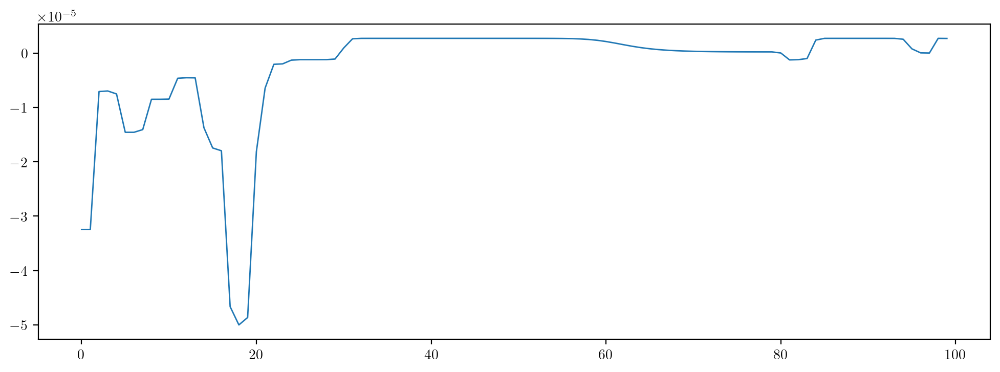

In [ ]:
from optimal_stopping_times import * 

def loss(l):
        #   inner product between l and signatures 
        in_prod = np.apply_along_axis(lambda x: np.inner(l, x), -1, partial_sigs)
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = np.apply_along_axis(np.cumsum, -1, sig_dist)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+np.exp(-20*(x-k)))
        partial_cdf_sums = np.apply_along_axis(G, -1, partial_sig_dist_sum)
        losses = np.einsum('ij, ij -> i', payoffs, partial_cdf_sums)

        return -np.mean(losses)

def grad(l):
    #   inner product between l and signatures 
    in_prod = np.apply_along_axis(lambda x: np.inner(l, x), -1, partial_sigs)
    #   inner prod squared
    sig_dist = in_prod**2

    #   partial sums of square of inner prod for increasing time M x (N-1)
    partial_sig_dist_sum = np.apply_along_axis(np.cumsum, -1, sig_dist)

    G_dash = lambda x: 20 * (1 + np.exp(-20*(x-k)))**(-2)
    #   partial signatures squared, M x (N-1) x (siglen+1)
    partial_sig_sq = partial_sigs**2

    #   cum sum of partial signatures in l_k, sum_{i=0}^j (X_i)k^2, M x (N-1) x (siglen+1)
    ps_sig_dist_cum =  np.apply_along_axis(np.cumsum, 1, partial_sig_sq)

    #   G'(sum over i (inner(l, x_i))), M x (N-1)
    partial_pdf_sums = np.apply_along_axis(G_dash, -1, partial_sig_dist_sum)

    #   (Y_j+1 - Y_j) * G'(sum), M x (N-1)
    partial_payoff_scaled = payoffs * partial_pdf_sums

    #   putting it together, M x (siglen + 1)
    grad_summed = np.einsum('ijk, ij -> ik',  2*ps_sig_dist_cum, partial_payoff_scaled)
    return -np.mean(grad_summed, axis=0) * l

def adam_opt(lr_max = 0.05, betas = (0, 0.2), eps = 1e-8, restart = 80, layers = 500):
    learn_rate = lambda T: 0.00005 + 1/2 * (lr_max - 0.00005) * (1 + np.cos((T % restart)/restart * np.pi))

    n = partial_sigs.shape[2]
    m = np.zeros(n)
    v = np.zeros(n)

    b1 = betas[0]
    b2 = betas[1]

    losses = np.zeros(layers)
    params = np.zeros((layers, n))

    l = np.random.normal(size=n)
    print(loss(l))

    def adm_update(m_prev, v_prev, l, t):
        lr = learn_rate(t)
        g = grad(l)
        m = b1 * m_prev + (1-b1)*g
        v = b2 * v_prev + (1-b2) * g**2

        m_hat = m/(1-b1**(t+1))
        v_hat = v/(1-b2**(t+1))

        l_opt = l - lr * m_hat / (np.sqrt(v_hat) + eps)
        return l_opt, m, v
    
    for t in tqdm(range(layers)):
        l, m, v = adm_update(m, v, l, t)
        cur_loss = loss(l)
        if abs(cur_loss) <= 1e-8:
            m = 0
            v = 0
            l = l + np.random.normal(scale = 0.5, size = len(l))
        
        losses[t] = cur_loss
        params[t, :] = l

    l_min = np.argmin(losses)
    plt.plot(np.arange(len(losses)), losses)
    return params[l_min, :]
    
partial_sigs, payoffs = gen_partial_sigs(100, 12, 2, theoretical=False)

k = 5

l_opt, losses = adam_opt(layers=100, restart = 80)
print(l_opt)
print(losses[-1])

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 18.22it/s]


tensor(1.1850e-05, dtype=torch.float64)


100%|██████████| 500/500 [00:00<00:00, 559.50it/s]

tensor(1.1848e-05, dtype=torch.float64, grad_fn=<NegBackward0>) 0.0


[None]

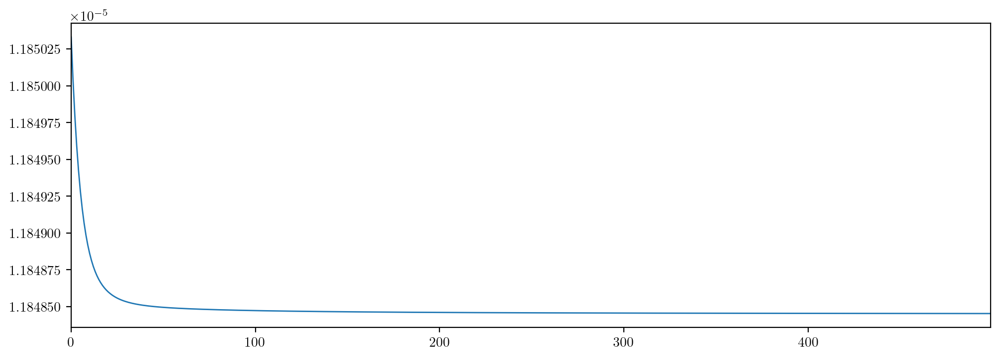

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.ones(partial_sigs.shape[2])
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.001)
#scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    #scheduler.step() # update optimiser parameters
model.eval()

print(model.forward(), np.sum(abs(l0 - np.array(model.l.data))))
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.91it/s]


tensor(-3.8339e-05, dtype=torch.float64)


100%|██████████| 500/500 [00:00<00:00, 582.12it/s]

tensor(-3.8341e-05, dtype=torch.float64, grad_fn=<NegBackward0>) 0.0


[None]

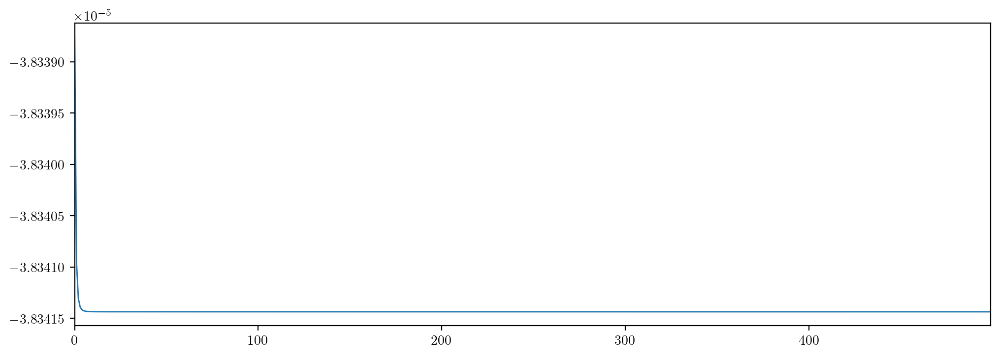

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.ones(partial_sigs.shape[2])
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.01)
#scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    #scheduler.step() # update optimiser parameters
model.eval()

print(model.forward(), np.sum(abs(l0 - np.array(model.l.data))))
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 18.21it/s]


tensor(-2.0872e-05, dtype=torch.float64)


100%|██████████| 500/500 [00:00<00:00, 503.67it/s]

tensor(-2.0874e-05, dtype=torch.float64, grad_fn=<NegBackward0>) 0.0


[None]

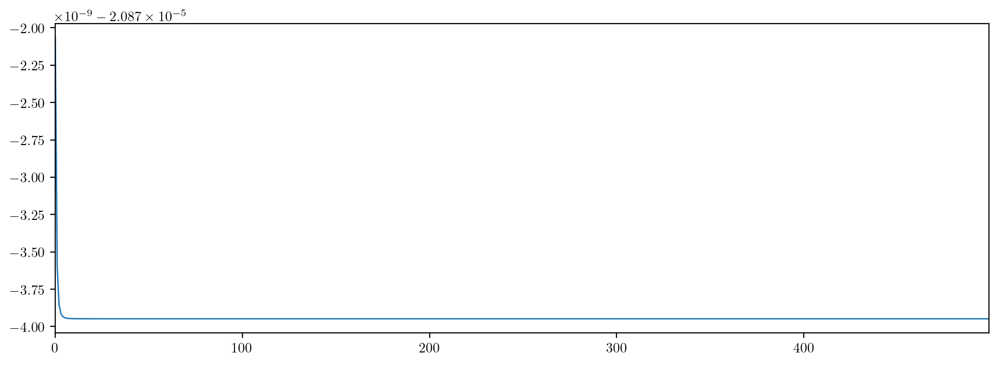

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.ones(partial_sigs.shape[2])
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.01)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters
model.eval()

print(model.forward(), np.sum(abs(l0 - np.array(model.l.data))))
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.77it/s]


tensor(-2.3202e-05, dtype=torch.float64)


100%|██████████| 500/500 [00:00<00:00, 546.79it/s]

Model() 0.0


[None]

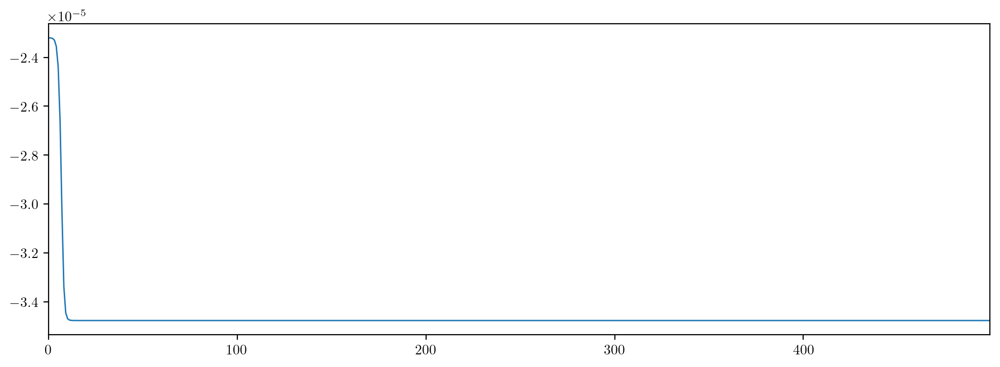

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.ones(partial_sigs.shape[2])
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.01)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model, np.sum(abs(l0 - np.array(model.l.data))))
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.84it/s]


tensor(-2.6944e-05, dtype=torch.float64)


100%|██████████| 500/500 [00:00<00:00, 559.32it/s]

Parameter containing:
tensor([0.9345, 0.9579, 1.0000, 0.9893, 1.0000, 1.0000, 1.0000, 0.9989, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000], dtype=torch.float64,
       requires_grad=True) 0.0


[None]

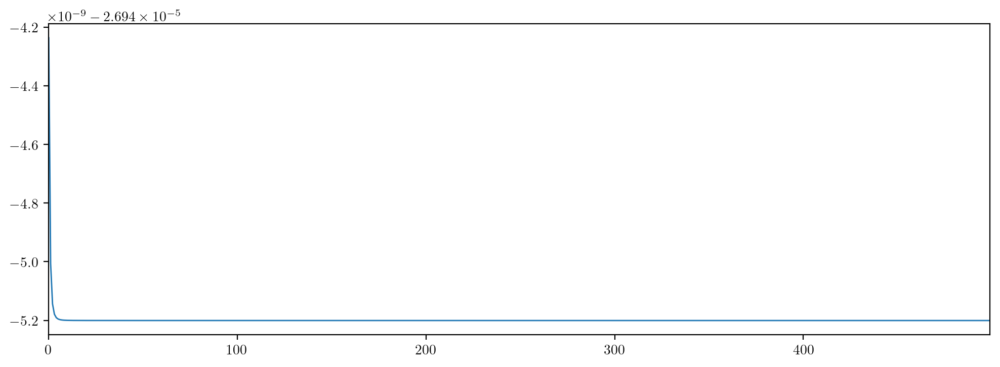

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.ones(partial_sigs.shape[2])
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.01)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.l, np.sum(abs(l0 - np.array(model.l.data))))
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.83it/s]


tensor(-2.6475e-05, dtype=torch.float64)


100%|██████████| 500/500 [00:00<00:00, 567.75it/s]

Parameter containing:
tensor([0.9347, 0.9572, 1.0000, 0.9889, 1.0000, 1.0000, 1.0000, 0.9988, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000], dtype=torch.float64,
       requires_grad=True) [0.93469984 0.95719343 0.99999945 0.9888773  0.99999991 0.99999994
 1.         0.99884084 0.99999995 1.00000004 1.         0.99999998
 1.         1.         1.        ]


[None]

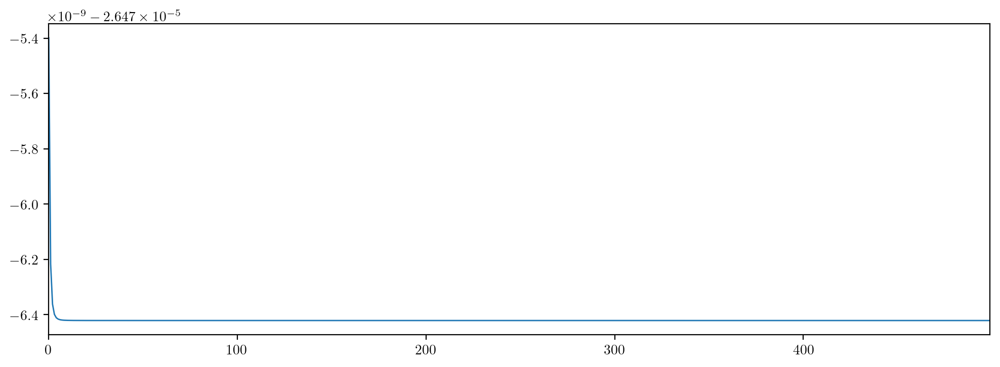

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.ones(partial_sigs.shape[2])
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.01)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.l, l0)
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.98it/s]


tensor(1.8885e-05, dtype=torch.float64)


100%|██████████| 500/500 [00:00<00:00, 576.29it/s]


Parameter containing:
tensor([ 0.1881, -0.1222,  0.3245, -0.4610,  0.6399,  0.6495,  0.9996, -0.8457,
         0.7855,  0.2606,  0.9986,  0.7854,  0.9997,  1.0000,  1.0000],
       dtype=torch.float64, requires_grad=True) [ 0.18807088 -0.12224922  0.32447405 -0.46101929  0.63988744  0.64948097
  0.99962445 -0.84567946  0.78545287  0.26056166  0.99864078  0.78537284
  0.99966042  0.99996591  1.00000002]


[None]

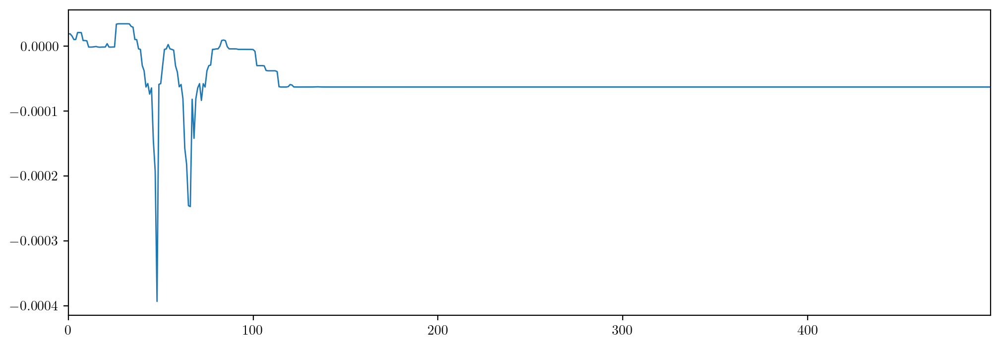

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.ones(partial_sigs.shape[2])
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.1)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.l, l0)
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.71it/s]


tensor(8.3861e-06, dtype=torch.float64)


100%|██████████| 500/500 [00:00<00:00, 550.27it/s]

tensor(-1.1768e-05, dtype=torch.float64, grad_fn=<NegBackward0>) 0.0


[None]

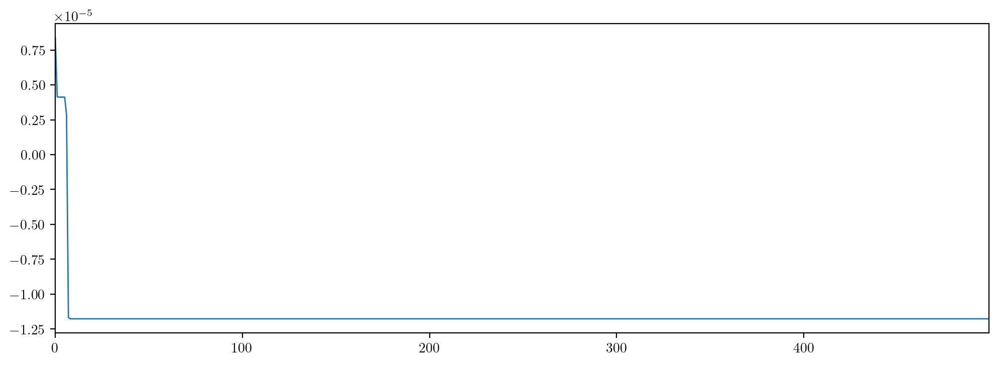

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.ones(partial_sigs.shape[2])
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 500
optimiser = torch.optim.Adam(model.parameters(), lr=0.1)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward(), np.sum(abs(l0 - np.array(model.l.data))))
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.12it/s]


tensor(-1.5372e-05, dtype=torch.float64)


100%|██████████| 300/300 [00:00<00:00, 480.08it/s]

tensor(-3.2036e-06, dtype=torch.float64, grad_fn=<NegBackward0>) 0.0


[None]

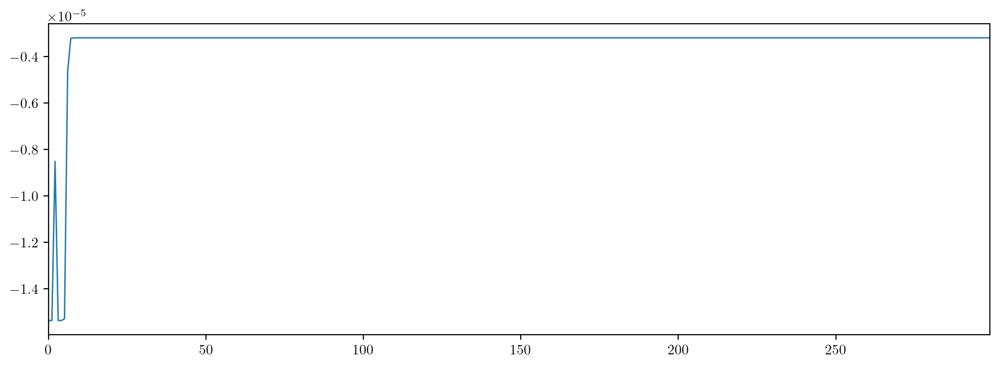

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.ones(partial_sigs.shape[2])
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 300
optimiser = torch.optim.Adam(model.parameters(), lr=0.1)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward(), np.sum(abs(l0 - np.array(model.l.data))))
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.55it/s]


tensor(-5.4840e-06, dtype=torch.float64)


100%|██████████| 300/300 [00:00<00:00, 491.03it/s]

tensor(-1.7817e-05, dtype=torch.float64, grad_fn=<NegBackward0>) 0.0


[None]

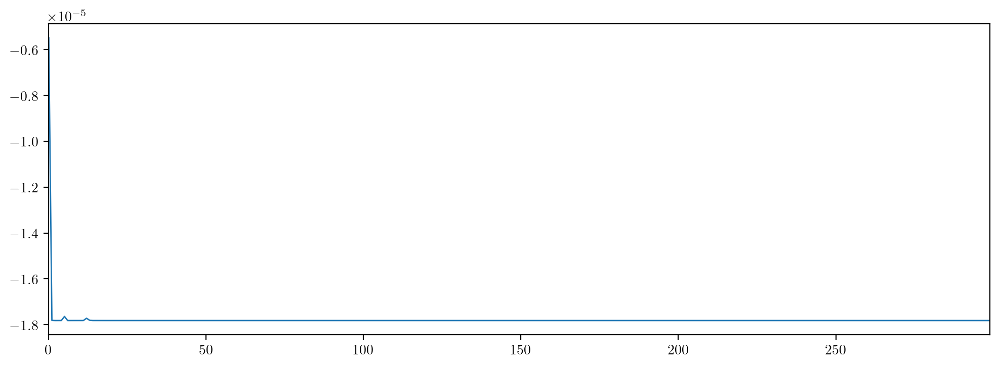

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.ones(partial_sigs.shape[2])
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 300
optimiser = torch.optim.Adam(model.parameters(), lr=0.1)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = int(max_epochs/2))

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward(), np.sum(abs(l0 - np.array(model.l.data))))
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

In [ ]:
np.array(model.l.data))

SyntaxError: unmatched ')' (<ipython-input-107-6ae1092da6a3>, line 1)

In [ ]:
np.array(model.l.data)

array([1.22036889, 1.27847459, 0.95185709, 1.23910182, 0.98780129,
       0.99847973, 1.00000171, 1.12171012, 0.99855153, 0.9994587 ,
       1.00000064, 1.00006463, 0.99999994, 1.00000005, 1.        ])

In [ ]:
l0

array([1.22036889, 1.27847459, 0.95185709, 1.23910182, 0.98780129,
       0.99847973, 1.00000171, 1.12171012, 0.99855153, 0.9994587 ,
       1.00000064, 1.00006463, 0.99999994, 1.00000005, 1.        ])

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.46it/s]


tensor(-1.1705e-05, dtype=torch.float64)


100%|██████████| 300/300 [00:00<00:00, 487.38it/s]

tensor(-4.2587e-05, dtype=torch.float64, grad_fn=<NegBackward0>) 0.0


[None]

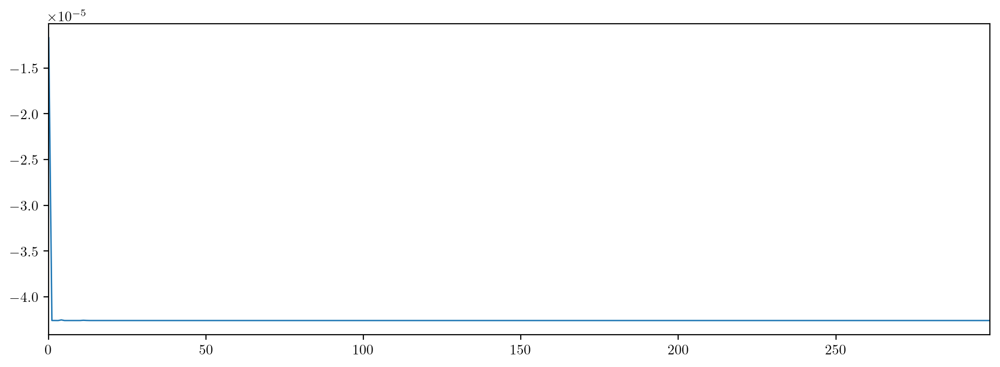

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.ones(partial_sigs.shape[2])
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 300
optimiser = torch.optim.Adam(model.parameters(), lr=0.1)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = int(max_epochs/2))

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward(), np.sum(abs(l0 - np.array(model.l.data))))
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

In [ ]:
l0

array([1.21245657, 1.29466882, 0.97517091, 1.2746121 , 0.99441731,
       0.99882017, 1.00000269, 1.08913962, 0.99936288, 0.99974317,
       1.00000069, 0.99996688, 1.00000005, 1.00000009, 1.        ])

In [ ]:
model.l

Parameter containing:
tensor([1.2125, 1.2947, 0.9752, 1.2746, 0.9944, 0.9988, 1.0000, 1.0891, 0.9994,
        0.9997, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000], dtype=torch.float64,
       requires_grad=True)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 18.07it/s]


tensor(3.2117e-06, dtype=torch.float64)


100%|██████████| 300/300 [00:00<00:00, 470.12it/s]

tensor(-0.0002, dtype=torch.float64, grad_fn=<NegBackward0>) 0.0


[None]

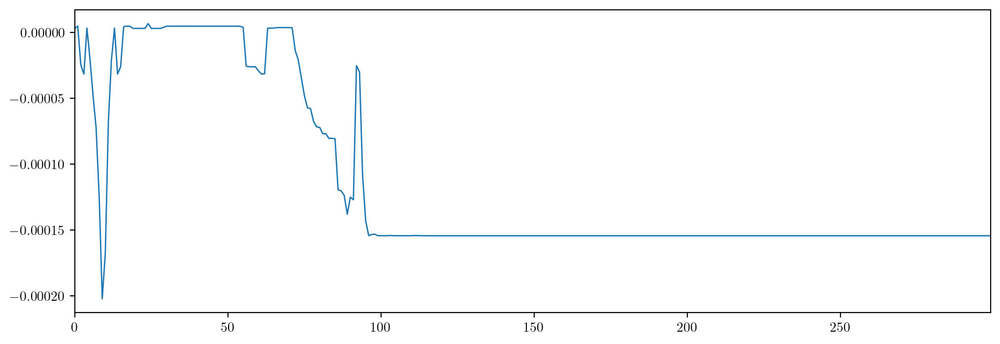

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.ones(partial_sigs.shape[2])
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 300
optimiser = torch.optim.Adam(model.parameters(), lr=0.2)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = int(max_epochs/2))

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward(), np.sum(abs(l0 - np.array(model.l.data))))
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

In [ ]:
model.l

Parameter containing:
tensor([ 0.1484, -0.3061,  1.1338, -0.1386,  1.9981,  0.7981,  1.0021, -0.0872,
         2.1832,  1.8698,  1.0005,  1.0535,  1.0010,  1.0012,  1.0000],
       dtype=torch.float64, requires_grad=True)

In [ ]:
l0

array([ 0.14841239, -0.30606158,  1.13376842, -0.13859536,  1.9980974 ,
        0.79814829,  1.00214877, -0.08722324,  2.18323376,  1.86980017,
        1.00054743,  1.05346772,  1.00099837,  1.00121352,  0.9999998 ])

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.77it/s]


tensor(-4.0885e-05, dtype=torch.float64)


100%|██████████| 300/300 [00:00<00:00, 486.39it/s]

tensor(-7.4881e-05, dtype=torch.float64, grad_fn=<NegBackward0>) 0.0


[None]

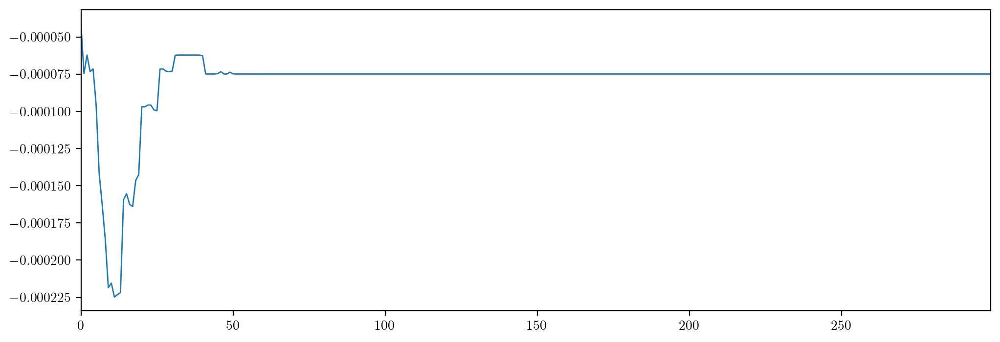

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l_0 = l0 = np.ones(partial_sigs.shape[2])
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 300
optimiser = torch.optim.Adam(model.parameters(), lr=0.2)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = int(max_epochs/2))

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward(), np.sum(abs(l0 - np.array(model.l.data))))
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

In [ ]:
l0

array([ 0.61541825,  1.39419912, -1.35307092,  1.36908811, -0.64010775,
       -0.16717986,  0.99844555,  1.26421015, -0.24741823, -0.00258617,
        0.99953526,  0.04938078,  0.99957823,  0.99792821,  0.99999962])

In [ ]:
l_0

array([ 0.61541825,  1.39419912, -1.35307092,  1.36908811, -0.64010775,
       -0.16717986,  0.99844555,  1.26421015, -0.24741823, -0.00258617,
        0.99953526,  0.04938078,  0.99957823,  0.99792821,  0.99999962])

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 18.10it/s]


[1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.]
tensor(-7.9581e-05, dtype=torch.float64)


100%|██████████| 300/300 [00:00<00:00, 461.96it/s]

tensor(-0.0002, dtype=torch.float64, grad_fn=<NegBackward0>) 0.0


[None]

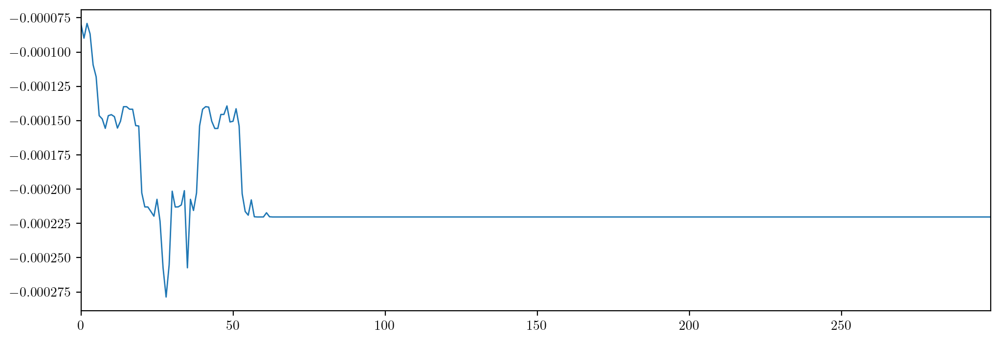

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.from_numpy(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.ones(partial_sigs.shape[2])
print(l0)
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 300
optimiser = torch.optim.Adam(model.parameters(), lr=0.2)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = int(max_epochs/2))

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward(), np.sum(abs(l0 - np.array(model.l.data))))
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(l))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.ones(partial_sigs.shape[2])
print(l0)
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 300
optimiser = torch.optim.Adam(model.parameters(), lr=0.2)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = int(max_epochs/2))

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward(), np.sum(abs(l0 - np.array(model.l.data))))
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.79it/s]

[1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.]


TypeError: clone(): argument 'input' (position 1) must be Tensor, not numpy.ndarray

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tesnor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.ones(partial_sigs.shape[2])
print(l0)
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 300
optimiser = torch.optim.Adam(model.parameters(), lr=0.2)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = int(max_epochs/2))

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward(), np.sum(abs(l0 - np.array(model.l.data))))
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.24it/s]

[1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.]


AttributeError: module 'torch' has no attribute 'tesnor'

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 18.02it/s]


[1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.]
tensor(-8.4154e-06, dtype=torch.float64)


100%|██████████| 300/300 [00:00<00:00, 491.15it/s]

tensor(-8.4176e-06, dtype=torch.float64, grad_fn=<NegBackward0>) 12.471206875968942


[None]

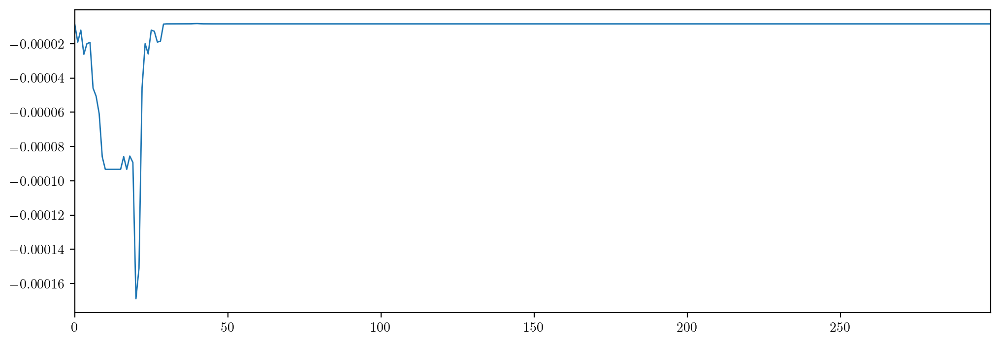

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.ones(partial_sigs.shape[2])
print(l0)
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 300
optimiser = torch.optim.Adam(model.parameters(), lr=0.2)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = int(max_epochs/2))

loss_hist = np.zeros(max_epochs)
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward(), np.sum(abs(l0 - np.array(model.l.data))))
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.ones(partial_sigs.shape[2])
print(l0)
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 300
optimiser = torch.optim.Adam(model.parameters(), lr=0.2)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = int(max_epochs/2))

loss_hist = np.zeros(max_epochs)
param_hist = np.zeros(size=(max_epochs, len(l0)))
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    param_hist[epoch, :] = np.array(model.l.data)

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward(), np.sum(abs(l0 - np.array(model.l.data))))
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.91it/s]

[1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.]
tensor(-2.9413e-05, dtype=torch.float64)


TypeError: zeros() got an unexpected keyword argument 'size'

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.86it/s]


[1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.]
tensor(-7.2321e-05, dtype=torch.float64)


100%|██████████| 300/300 [00:00<00:00, 445.40it/s]

tensor(-0.0003, dtype=torch.float64, grad_fn=<NegBackward0>) 12.897121846181172


[None]

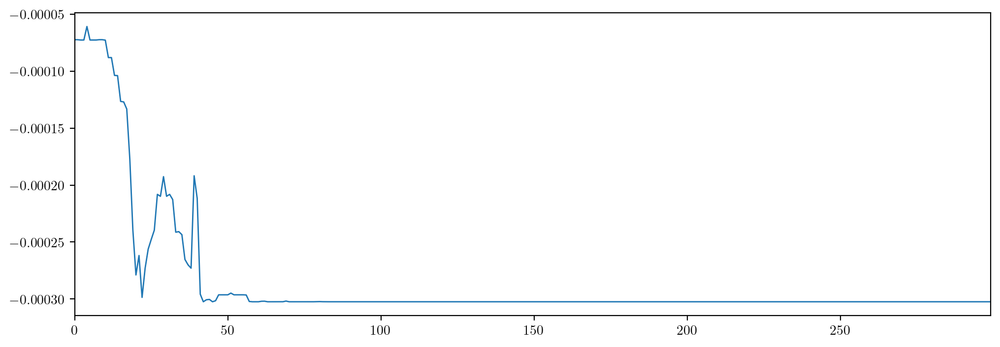

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.ones(partial_sigs.shape[2])
print(l0)
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 300
optimiser = torch.optim.Adam(model.parameters(), lr=0.2)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = int(max_epochs/2))

loss_hist = np.zeros(max_epochs)
param_hist = np.zeros((max_epochs, len(l0)))
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    param_hist[epoch, :] = np.array(model.l.data)

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward(), np.sum(abs(l0 - np.array(model.l.data))))
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.72it/s]


tensor(3.2845e-06, dtype=torch.float64)


100%|██████████| 300/300 [00:00<00:00, 455.18it/s]


tensor(1.2680e-05, dtype=torch.float64, grad_fn=<NegBackward0>) 4.694032251336298


[None]

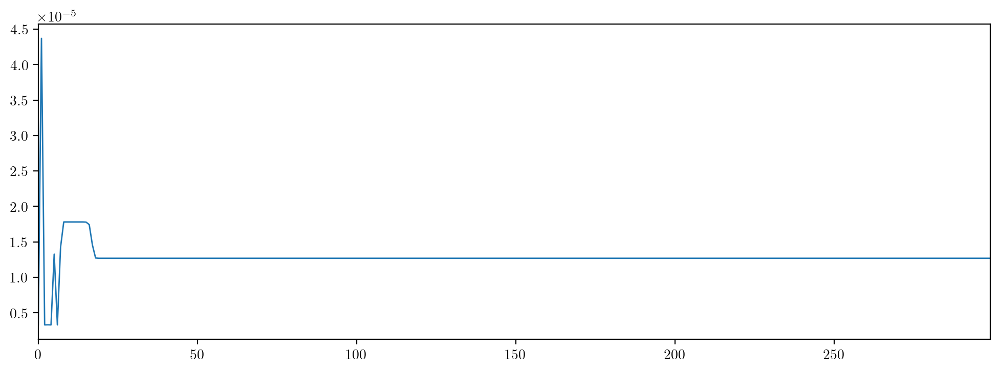

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.ones(partial_sigs.shape[2])
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 300
optimiser = torch.optim.Adam(model.parameters(), lr=0.2)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = int(max_epochs/2))

loss_hist = np.zeros(max_epochs)
param_hist = np.zeros((max_epochs, len(l0)))
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    param_hist[epoch, :] = np.array(model.l.data)

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward(), np.sum(abs(l0 - np.array(model.l.data))))
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 12/12 [00:00<00:00, 17.93it/s]


tensor(-4.3958e-05, dtype=torch.float64)


100%|██████████| 300/300 [00:00<00:00, 456.17it/s]

tensor(-3.3212e-05, dtype=torch.float64, grad_fn=<NegBackward0>) 7.1250727863447


[None]

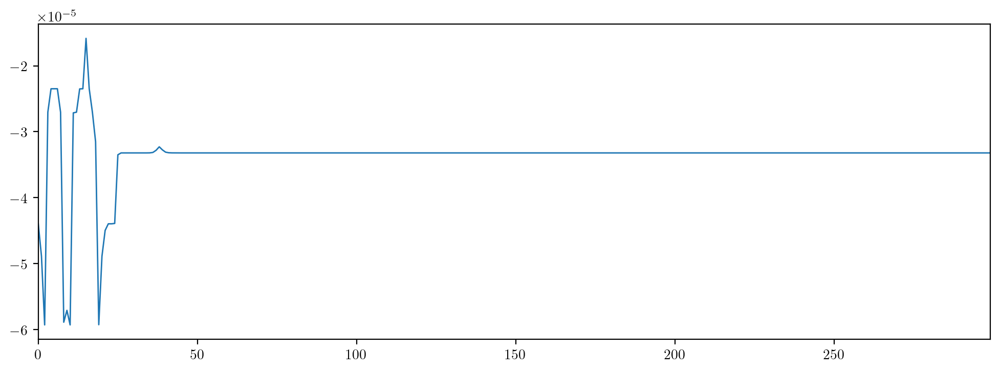

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 12, 3)
l0 = np.ones(partial_sigs.shape[2])
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 300
optimiser = torch.optim.Adam(model.parameters(), lr=0.2)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = int(max_epochs/2))

loss_hist = np.zeros(max_epochs)
param_hist = np.zeros((max_epochs, len(l0)))
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    param_hist[epoch, :] = np.array(model.l.data)

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward(), np.sum(abs(l0 - np.array(model.l.data))))
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 20/20 [00:01<00:00, 17.96it/s]


tensor(-2.5373e-05, dtype=torch.float64)


100%|██████████| 300/300 [00:00<00:00, 394.00it/s]

tensor(-2.5374e-05, dtype=torch.float64, grad_fn=<NegBackward0>) 5.849638716537548


[None]

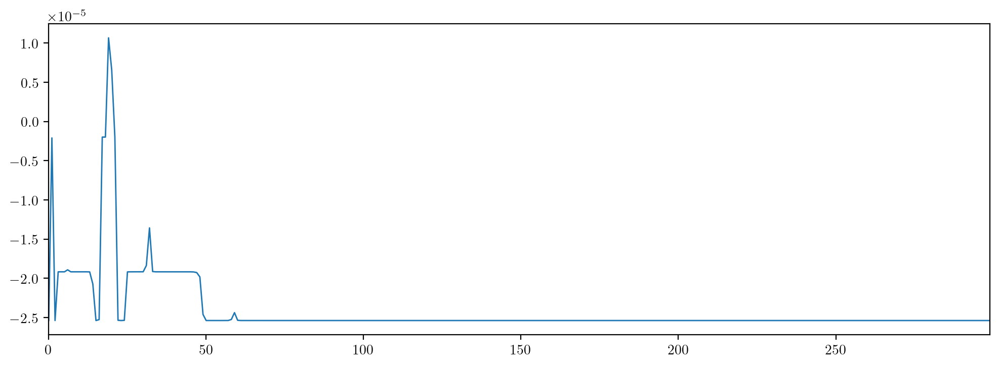

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 20, 3)
l0 = np.ones(partial_sigs.shape[2])
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 300
optimiser = torch.optim.Adam(model.parameters(), lr=0.2)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = int(max_epochs/2))

loss_hist = np.zeros(max_epochs)
param_hist = np.zeros((max_epochs, len(l0)))
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    param_hist[epoch, :] = np.array(model.l.data)

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward(), np.sum(abs(l0 - np.array(model.l.data))))
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 20/20 [00:01<00:00, 18.03it/s]


tensor(-2.2756e-06, dtype=torch.float64)


100%|██████████| 300/300 [00:00<00:00, 381.23it/s]

tensor(-7.5699e-05, dtype=torch.float64, grad_fn=<NegBackward0>)


[None]

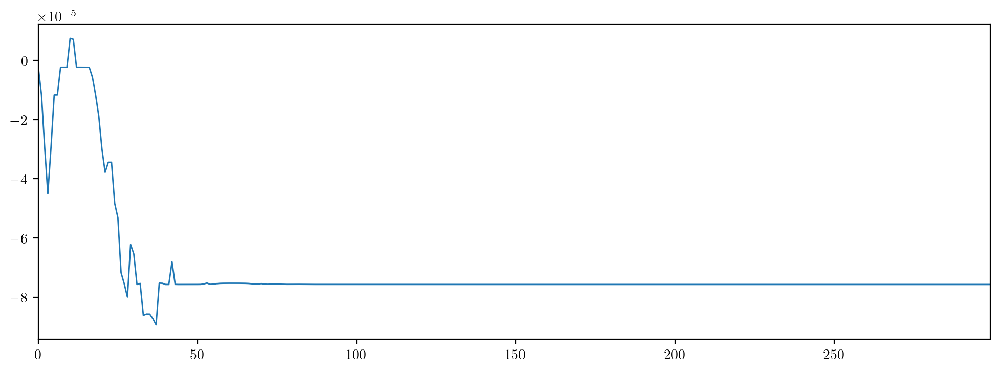

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 20, 3)
l0 = np.ones(partial_sigs.shape[2])
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 300
optimiser = torch.optim.Adam(model.parameters(), lr=0.2)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = int(max_epochs/2))

loss_hist = np.zeros(max_epochs)
param_hist = np.zeros((max_epochs, len(l0)))
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    param_hist[epoch, :] = np.array(model.l.data)

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 20/20 [00:01<00:00, 18.02it/s]


tensor(-2.5002e-05, dtype=torch.float64)


100%|██████████| 300/300 [00:00<00:00, 376.49it/s]

tensor(-5.2621e-05, dtype=torch.float64, grad_fn=<NegBackward0>)


[None]

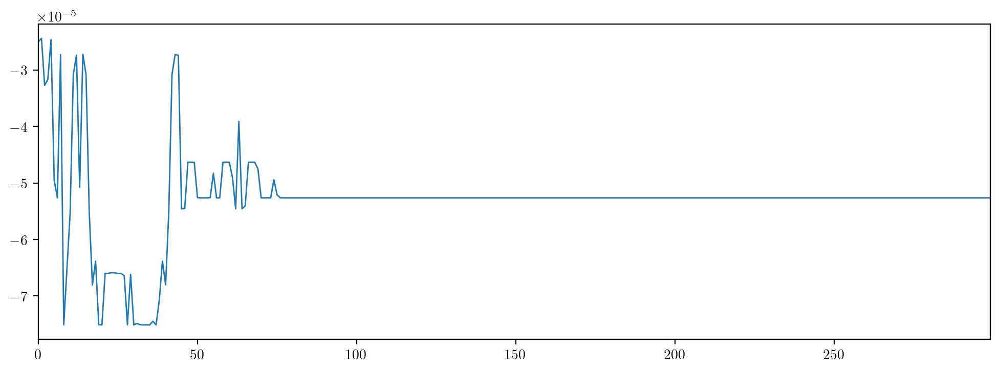

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 20, 3)
l0 = np.ones(partial_sigs.shape[2])
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 300
optimiser = torch.optim.Adam(model.parameters(), lr=0.2)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = int(max_epochs/2))

loss_hist = np.zeros(max_epochs)
param_hist = np.zeros((max_epochs, len(l0)))
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    param_hist[epoch, :] = np.array(model.l.data)

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

In [ ]:
model.l

Parameter containing:
tensor([-0.6395,  0.4071, -1.5871,  1.1404, -1.7525, -0.9507,  1.0003,  1.6840,
        -1.7452,  0.1194,  1.0008, -0.3234,  0.9999,  1.0002,  1.0000],
       dtype=torch.float64, requires_grad=True)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 20/20 [00:01<00:00, 18.09it/s]


tensor(3.0902e-05, dtype=torch.float64)


100%|██████████| 300/300 [00:00<00:00, 414.68it/s]

tensor(1.5232e-06, dtype=torch.float64, grad_fn=<NegBackward0>)


[None]

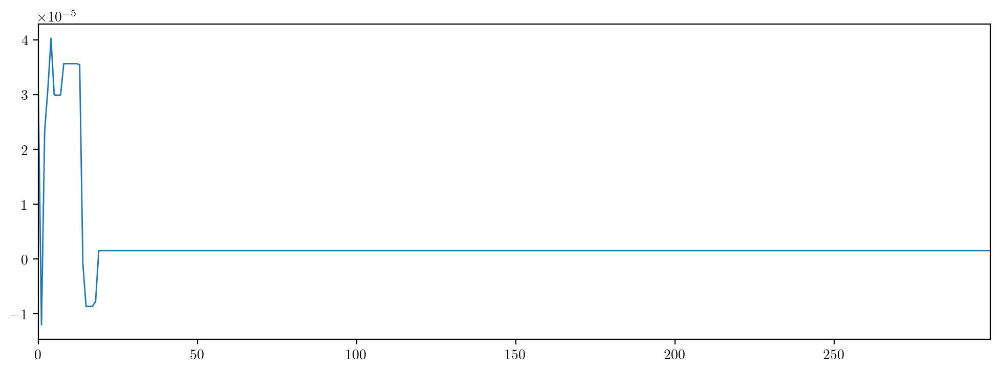

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 20, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 300
optimiser = torch.optim.Adam(model.parameters(), lr=0.2)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = int(max_epochs/2))

loss_hist = np.zeros(max_epochs)
param_hist = np.zeros((max_epochs, len(l0)))
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    param_hist[epoch, :] = np.array(model.l.data)

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 20/20 [00:01<00:00, 17.57it/s]


tensor(-6.7340e-06, dtype=torch.float64)


100%|██████████| 300/300 [00:00<00:00, 397.40it/s]

tensor(-1.1189e-05, dtype=torch.float64, grad_fn=<NegBackward0>)


[None]

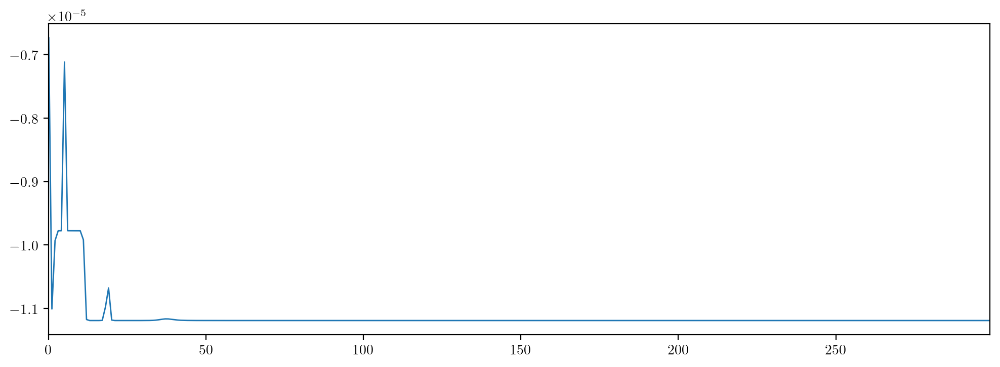

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 20, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 300
optimiser = torch.optim.Adam(model.parameters(), lr=0.2)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = int(max_epochs/2))

loss_hist = np.zeros(max_epochs)
param_hist = np.zeros((max_epochs, len(l0)))
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    param_hist[epoch, :] = np.array(model.l.data)

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 20/20 [00:01<00:00, 17.96it/s]


tensor(-5.6009e-05, dtype=torch.float64)


100%|██████████| 300/300 [00:00<00:00, 417.62it/s]

tensor(-0.0001, dtype=torch.float64, grad_fn=<NegBackward0>)


[None]

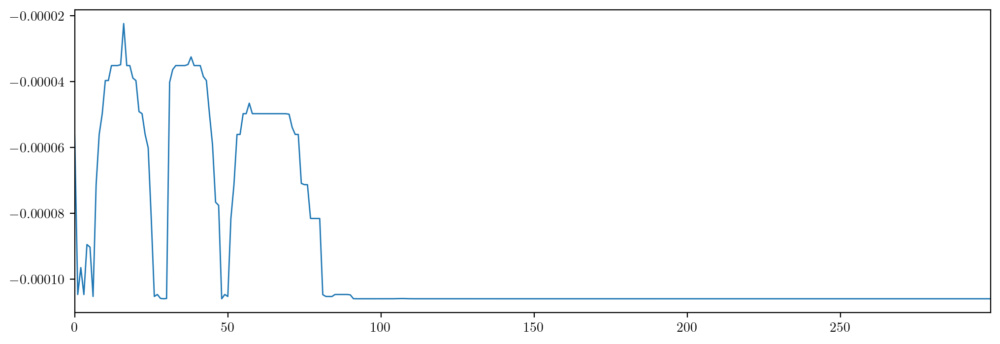

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 20, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 300
optimiser = torch.optim.Adam(model.parameters(), lr=0.4)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
param_hist = np.zeros((max_epochs, len(l0)))
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    param_hist[epoch, :] = np.array(model.l.data)

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 20/20 [00:01<00:00, 18.12it/s]


tensor(-0.0002, dtype=torch.float64)


100%|██████████| 300/300 [00:00<00:00, 397.55it/s]

tensor(-1.7898e-05, dtype=torch.float64, grad_fn=<NegBackward0>)


[None]

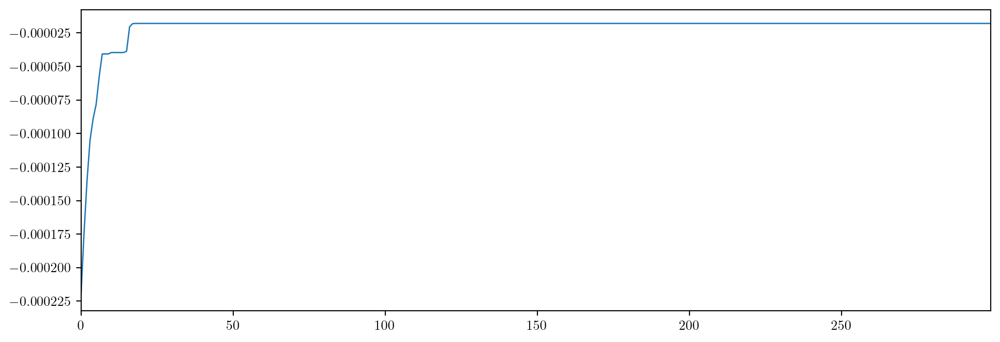

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 20, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 300
optimiser = torch.optim.Adam(model.parameters(), lr=0.4)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
param_hist = np.zeros((max_epochs, len(l0)))
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    param_hist[epoch, :] = np.array(model.l.data)

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 20/20 [00:01<00:00, 18.10it/s]


tensor(-0.0001, dtype=torch.float64)


100%|██████████| 1000/1000 [00:01<00:00, 522.00it/s]


tensor(-2.2774e-05, dtype=torch.float64, grad_fn=<NegBackward0>)


[None]

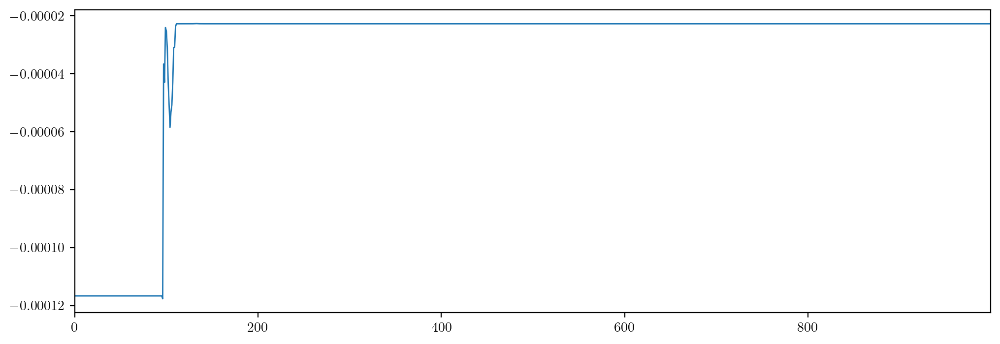

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 20, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 1000
optimiser = torch.optim.Adam(model.parameters(), lr=0.4)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
param_hist = np.zeros((max_epochs, len(l0)))
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    param_hist[epoch, :] = np.array(model.l.data)

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 20, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 1000
optimiser = torch.optim.Adam(model.parameters(), lr=0.4, betas=(0.1, 0,5))
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
param_hist = np.zeros((max_epochs, len(l0)))
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    param_hist[epoch, :] = np.array(model.l.data)

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 20/20 [00:01<00:00, 17.84it/s]


tensor(-0.0001, dtype=torch.float64)


  0%|          | 0/1000 [00:00<?, ?it/s]


ValueError: too many values to unpack (expected 2)

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 20, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 1000
optimiser = torch.optim.Adam(model.parameters(), lr=0.4, betas=Tuple(0.1, 0,5))
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
param_hist = np.zeros((max_epochs, len(l0)))
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    param_hist[epoch, :] = np.array(model.l.data)

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 20/20 [00:01<00:00, 17.59it/s]

tensor(-6.1510e-05, dtype=torch.float64)


NameError: name 'Tuple' is not defined

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 20, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 1000
optimiser = torch.optim.Adam(model.parameters(), lr=0.4, betas=(0.1, 0,5))
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
param_hist = np.zeros((max_epochs, len(l0)))
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    param_hist[epoch, :] = np.array(model.l.data)

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 20/20 [00:01<00:00, 17.76it/s]


tensor(-6.6963e-06, dtype=torch.float64)


  0%|          | 0/1000 [00:00<?, ?it/s]


ValueError: too many values to unpack (expected 2)

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 20, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 1000
optimiser = torch.optim.Adam(model.parameters(), lr=0.4, betas=(0.1, 0,5), weight_decay=0.001)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
param_hist = np.zeros((max_epochs, len(l0)))
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    param_hist[epoch, :] = np.array(model.l.data)

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 20/20 [00:01<00:00, 17.50it/s]


tensor(-4.8816e-06, dtype=torch.float64)


  0%|          | 0/1000 [00:00<?, ?it/s]


ValueError: too many values to unpack (expected 2)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 20/20 [00:01<00:00, 18.08it/s]


tensor(-0.0001, dtype=torch.float64)


100%|██████████| 1000/1000 [00:01<00:00, 509.56it/s]

tensor(-0.0010, dtype=torch.float64, grad_fn=<NegBackward0>)


[None]

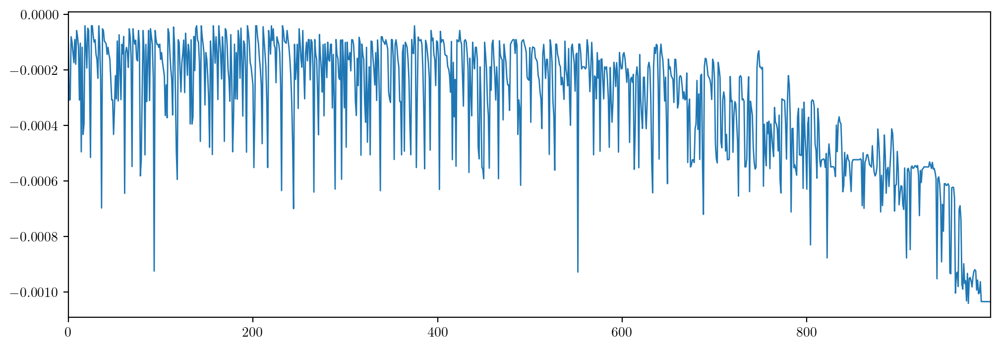

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 20, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 1000
optimiser = torch.optim.Adam(model.parameters(), lr=0.4, betas=(0.1, 0.5), weight_decay=0.001)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
param_hist = np.zeros((max_epochs, len(l0)))
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    param_hist[epoch, :] = np.array(model.l.data)

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 20/20 [00:01<00:00, 18.12it/s]


tensor(-5.0825e-05, dtype=torch.float64)


100%|██████████| 1000/1000 [00:01<00:00, 508.84it/s]

tensor(-0.0007, dtype=torch.float64, grad_fn=<NegBackward0>)


[None]

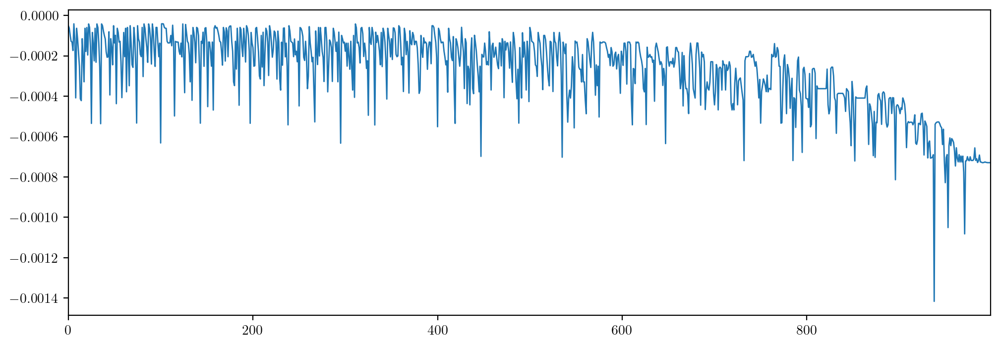

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 20, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 1000
optimiser = torch.optim.Adam(model.parameters(), lr=0.4, betas=(0.1, 0.5), weight_decay=0.001)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
param_hist = np.zeros((max_epochs, len(l0)))
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    param_hist[epoch, :] = np.array(model.l.data)

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 20/20 [00:01<00:00, 18.05it/s]


tensor(-3.4525e-05, dtype=torch.float64)


100%|██████████| 1000/1000 [00:01<00:00, 518.91it/s]


tensor(-0.0005, dtype=torch.float64, grad_fn=<NegBackward0>)


[None]

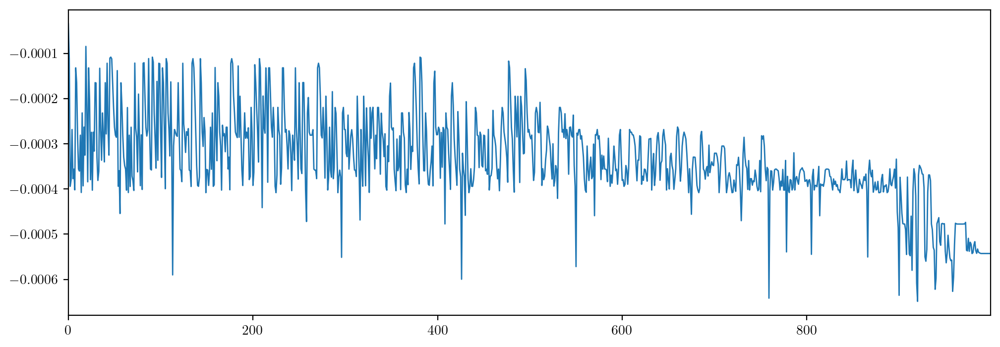

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 20, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 1000
optimiser = torch.optim.Adam(model.parameters(), lr=0.4, betas=(0.2, 0.5), weight_decay=0.001)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
param_hist = np.zeros((max_epochs, len(l0)))
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    param_hist[epoch, :] = np.array(model.l.data)

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 20/20 [00:01<00:00, 17.22it/s]


tensor(-0.0002, dtype=torch.float64)


100%|██████████| 1000/1000 [00:02<00:00, 466.12it/s]

tensor(-0.0009, dtype=torch.float64, grad_fn=<NegBackward0>)


[None]

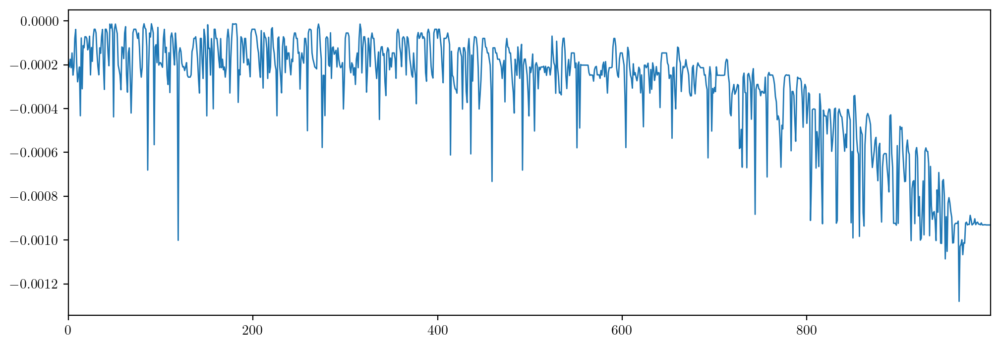

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 20, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 1000
optimiser = torch.optim.Adam(model.parameters(), lr=0.4, betas=(0.2, 0.5), weight_decay=0.0001)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
param_hist = np.zeros((max_epochs, len(l0)))
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    param_hist[epoch, :] = np.array(model.l.data)

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 20/20 [00:01<00:00, 17.78it/s]


tensor(-6.4110e-06, dtype=torch.float64)


100%|██████████| 1000/1000 [00:02<00:00, 480.60it/s]


tensor(-2.8155e-06, dtype=torch.float64, grad_fn=<NegBackward0>)


[None]

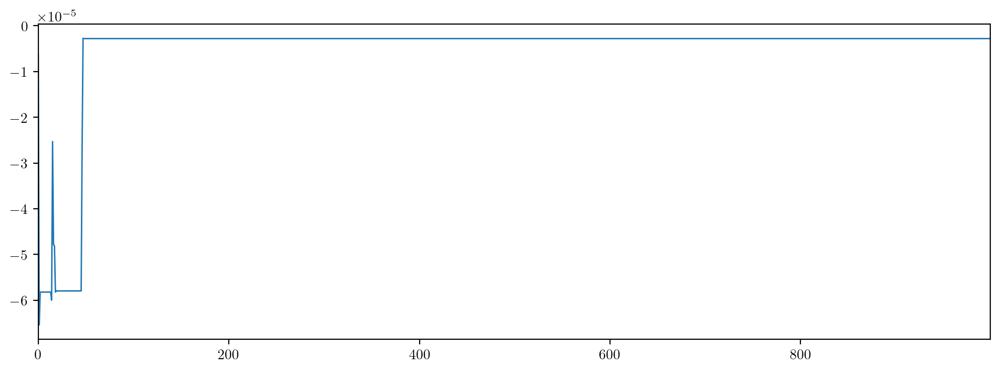

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 20, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 1000
optimiser = torch.optim.Adam(model.parameters(), lr=0.4, betas=(0.2, 0.5), weight_decay=0.0)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
param_hist = np.zeros((max_epochs, len(l0)))
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    param_hist[epoch, :] = np.array(model.l.data)

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 20/20 [00:01<00:00, 17.57it/s]


tensor(-6.0100e-05, dtype=torch.float64)


100%|██████████| 1000/1000 [00:02<00:00, 468.68it/s]


tensor(-0.0001, dtype=torch.float64, grad_fn=<NegBackward0>)


[None]

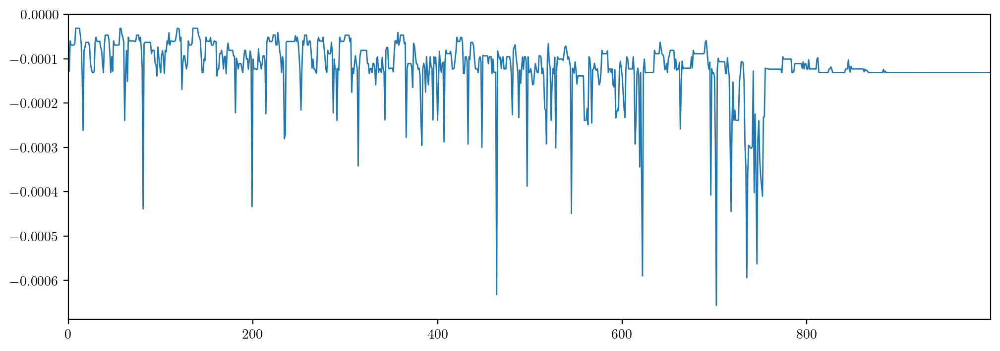

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 20, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 1000
optimiser = torch.optim.Adam(model.parameters(), lr=0.4, betas=(0.2, 0.5), weight_decay=0.00001)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
param_hist = np.zeros((max_epochs, len(l0)))
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    param_hist[epoch, :] = np.array(model.l.data)

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 20/20 [00:01<00:00, 17.86it/s]


tensor(-7.2883e-05, dtype=torch.float64)


100%|██████████| 1000/1000 [00:02<00:00, 463.18it/s]

tensor(-0.0008, dtype=torch.float64, grad_fn=<NegBackward0>)


[None]

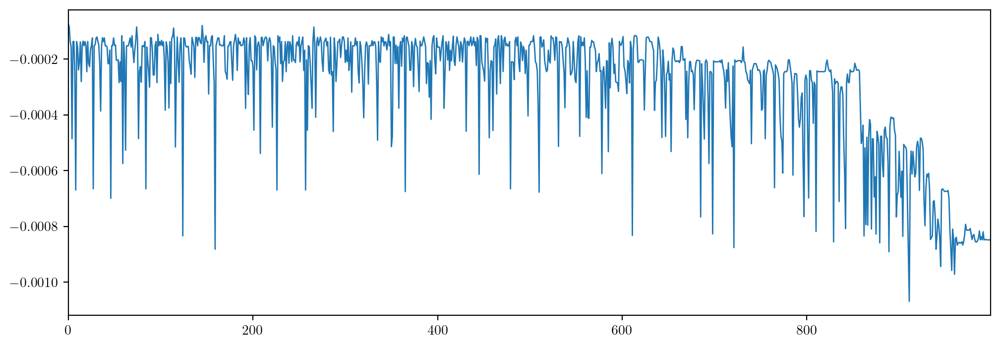

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 20, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 1000
optimiser = torch.optim.Adam(model.parameters(), lr=0.4, betas=(0.2, 0.5), weight_decay=0.001)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
param_hist = np.zeros((max_epochs, len(l0)))
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    param_hist[epoch, :] = np.array(model.l.data)

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 20/20 [00:01<00:00, 17.41it/s]


tensor(-0.0002, dtype=torch.float64)


100%|██████████| 1000/1000 [00:02<00:00, 471.68it/s]

tensor(-0.0003, dtype=torch.float64, grad_fn=<NegBackward0>)


[None]

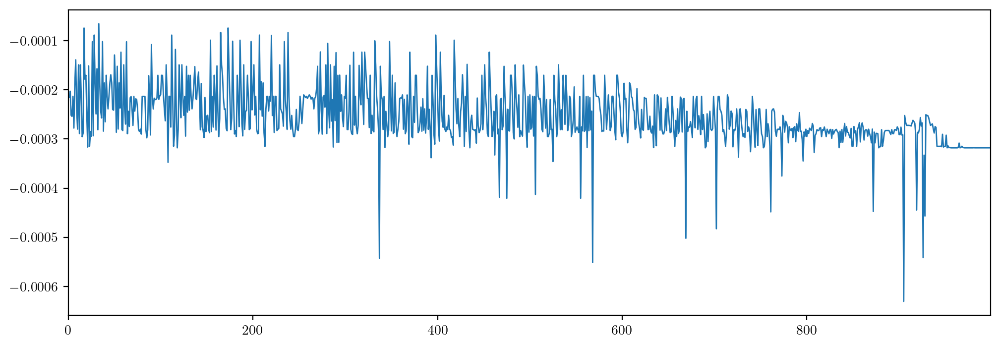

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 20, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 1000
optimiser = torch.optim.Adam(model.parameters(), lr=0.4, betas=(0.2, 0.5), weight_decay=0.01)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
param_hist = np.zeros((max_epochs, len(l0)))
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    param_hist[epoch, :] = np.array(model.l.data)

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 20/20 [00:01<00:00, 16.98it/s]


tensor(-0.0002, dtype=torch.float64)


100%|██████████| 1000/1000 [00:02<00:00, 449.75it/s]

tensor(-0.0006, dtype=torch.float64, grad_fn=<NegBackward0>)


[None]

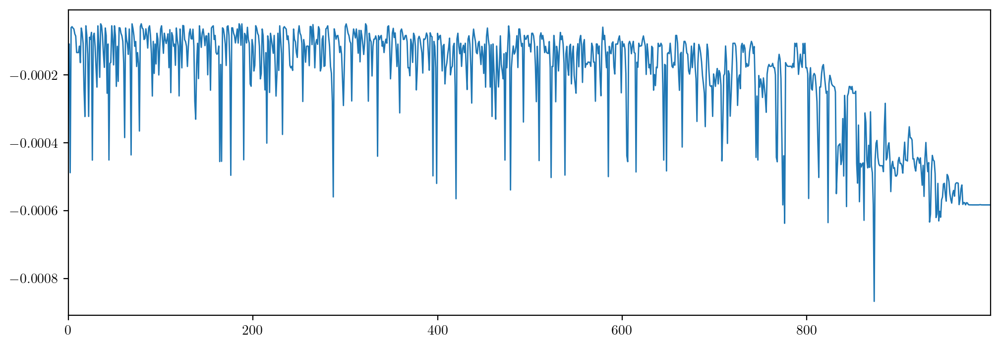

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 20, 3)
l0 = np.random.normal(size=partial_sigs.shape[2])
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 1000
optimiser = torch.optim.Adam(model.parameters(), lr=0.4, betas=(0.2, 0.5), weight_decay=0.001)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
param_hist = np.zeros((max_epochs, len(l0)))
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    param_hist[epoch, :] = np.array(model.l.data)

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 20/20 [00:01<00:00, 16.50it/s]


tensor(-3.5434e-06, dtype=torch.float64)


100%|██████████| 1000/1000 [00:02<00:00, 477.74it/s]

tensor(-0.0012, dtype=torch.float64, grad_fn=<NegBackward0>)


[None]

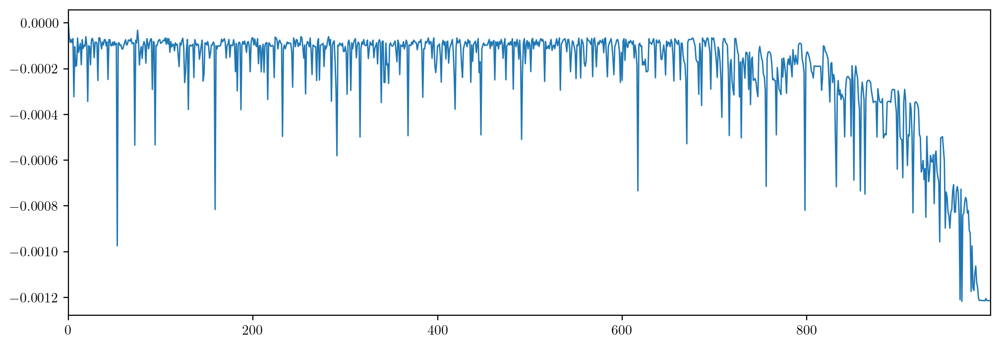

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 20, 3)
#l0 = np.random.normal(size=partial_sigs.shape[2])
l0 = np.ones(partial_sigs.shape[2])
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 1000
optimiser = torch.optim.Adam(model.parameters(), lr=0.4, betas=(0.2, 0.5), weight_decay=0.001)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
param_hist = np.zeros((max_epochs, len(l0)))
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    param_hist[epoch, :] = np.array(model.l.data)

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 20/20 [00:01<00:00, 16.63it/s]


tensor(-1.4333e-05, dtype=torch.float64)


100%|██████████| 1000/1000 [00:02<00:00, 477.63it/s]

tensor(-0.0005, dtype=torch.float64, grad_fn=<NegBackward0>)


[None]

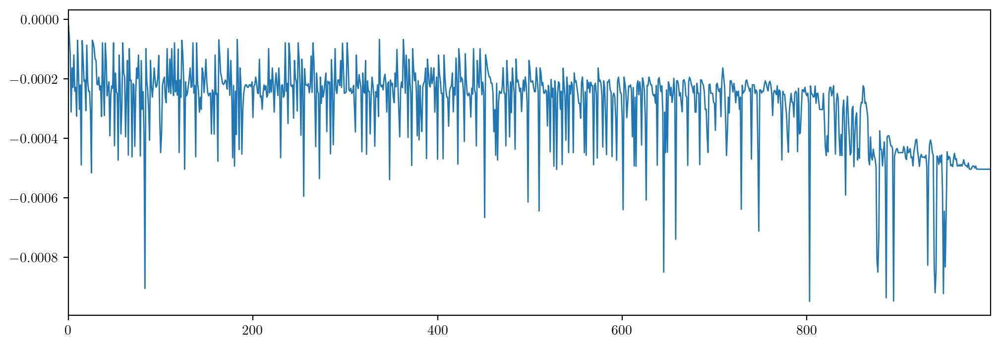

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 20, 3)
#l0 = np.random.normal(size=partial_sigs.shape[2])
l0 = np.ones(partial_sigs.shape[2])
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 1000
optimiser = torch.optim.Adam(model.parameters(), lr=0.4, betas=(0.2, 0.5), weight_decay=0.01)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
param_hist = np.zeros((max_epochs, len(l0)))
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    param_hist[epoch, :] = np.array(model.l.data)

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 20/20 [00:01<00:00, 17.50it/s]


tensor(-4.5893e-05, dtype=torch.float64)


100%|██████████| 1000/1000 [00:02<00:00, 448.78it/s]

tensor(-0.0007, dtype=torch.float64, grad_fn=<NegBackward0>)


[None]

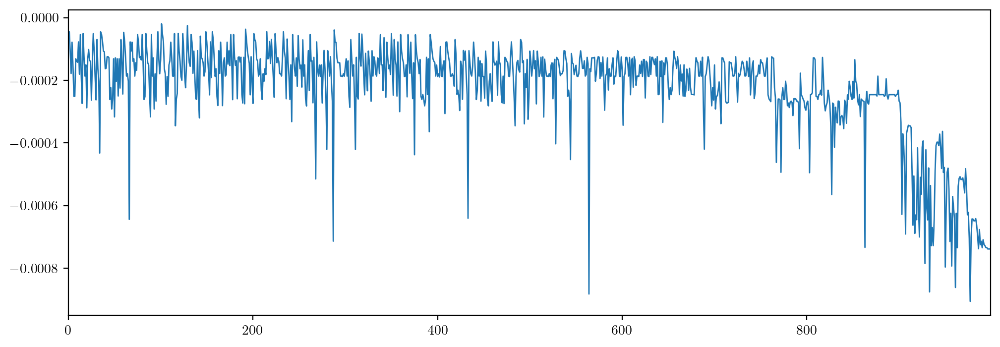

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 20, 3)
#l0 = np.random.normal(size=partial_sigs.shape[2])
l0 = np.ones(partial_sigs.shape[2])
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 1000
optimiser = torch.optim.Adam(model.parameters(), lr=0.4, betas=(0.0, 0.5), weight_decay=0.001)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
param_hist = np.zeros((max_epochs, len(l0)))
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    param_hist[epoch, :] = np.array(model.l.data)

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 20/20 [00:01<00:00, 17.19it/s]


tensor(4.4683e-07, dtype=torch.float64)


100%|██████████| 1500/1500 [00:02<00:00, 502.82it/s]

tensor(-0.0008, dtype=torch.float64, grad_fn=<NegBackward0>)


[None]

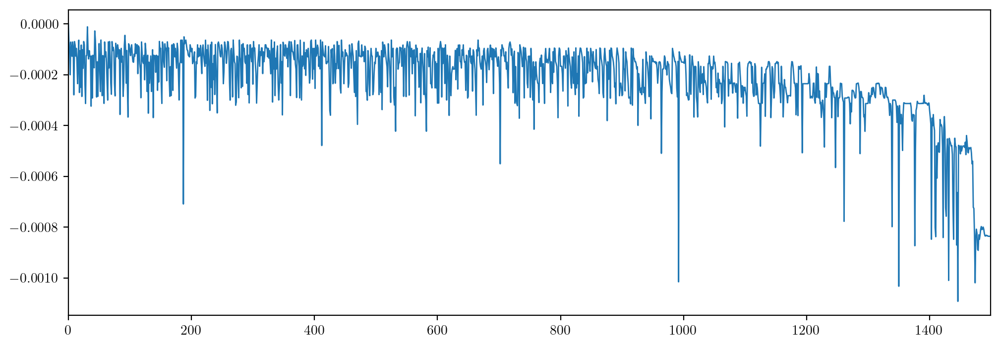

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 20, 3)
#l0 = np.random.normal(size=partial_sigs.shape[2])
l0 = np.ones(partial_sigs.shape[2])
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 1500
optimiser = torch.optim.Adam(model.parameters(), lr=0.4, betas=(0.0, 0.5), weight_decay=0.001)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
param_hist = np.zeros((max_epochs, len(l0)))
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    param_hist[epoch, :] = np.array(model.l.data)

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 20/20 [00:01<00:00, 17.40it/s]


tensor(-5.4763e-05, dtype=torch.float64)


100%|██████████| 1500/1500 [00:03<00:00, 437.04it/s]

tensor(-0.0007, dtype=torch.float64, grad_fn=<NegBackward0>)


[None]

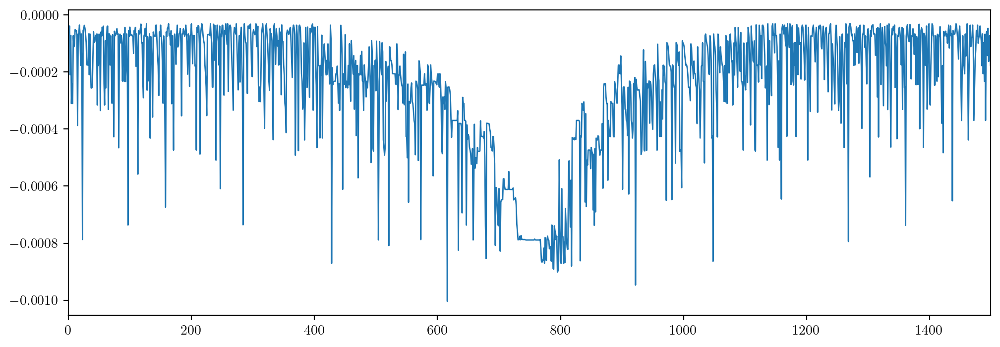

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 20, 3)
#l0 = np.random.normal(size=partial_sigs.shape[2])
l0 = np.ones(partial_sigs.shape[2])
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 1500
optimiser = torch.optim.Adam(model.parameters(), lr=0.4, betas=(0.0, 0.5), weight_decay=0.001)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = int(max_epochs/2))

loss_hist = np.zeros(max_epochs)
param_hist = np.zeros((max_epochs, len(l0)))
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    param_hist[epoch, :] = np.array(model.l.data)

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 20/20 [00:01<00:00, 17.80it/s]


tensor(-2.1580e-05, dtype=torch.float64)


100%|██████████| 1500/1500 [00:03<00:00, 477.57it/s]

tensor(-0.0005, dtype=torch.float64, grad_fn=<NegBackward0>)


[None]

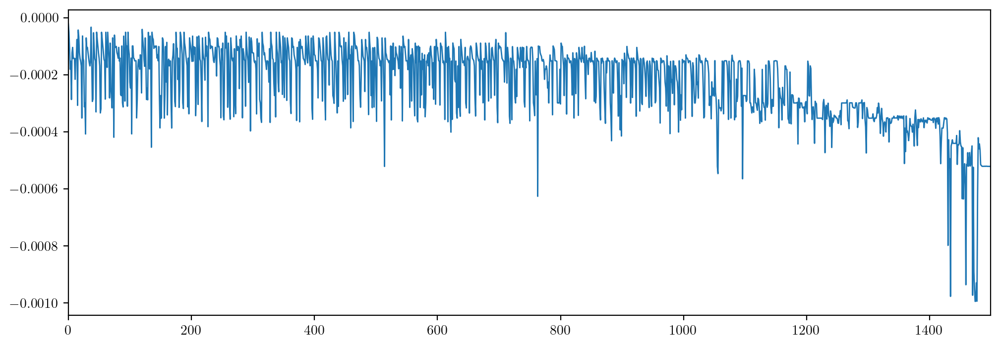

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 20, 3)
#l0 = np.random.normal(size=partial_sigs.shape[2])
l0 = np.ones(partial_sigs.shape[2])
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 1500
optimiser = torch.optim.Adam(model.parameters(), lr=0.4, betas=(0.0, 0.5), weight_decay=0.001)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
param_hist = np.zeros((max_epochs, len(l0)))
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    param_hist[epoch, :] = np.array(model.l.data)

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 20/20 [00:01<00:00, 17.00it/s]


tensor(-4.3156e-06, dtype=torch.float64)


100%|██████████| 1500/1500 [00:03<00:00, 494.92it/s]

tensor(-0.0011, dtype=torch.float64, grad_fn=<NegBackward0>)


[None]

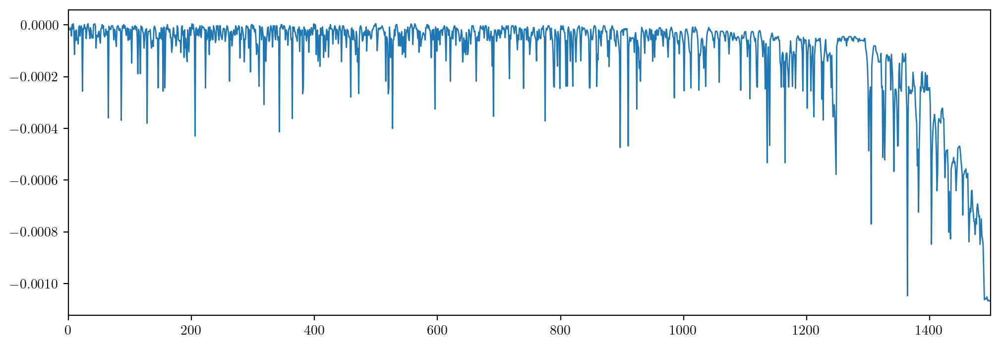

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 20, 3)
#l0 = np.random.normal(size=partial_sigs.shape[2])
l0 = np.ones(partial_sigs.shape[2])
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 1500
optimiser = torch.optim.Adam(model.parameters(), lr=0.4, betas=(0.5, 0.5), weight_decay=0.001)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
param_hist = np.zeros((max_epochs, len(l0)))
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    param_hist[epoch, :] = np.array(model.l.data)

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 20/20 [00:01<00:00, 17.58it/s]


tensor(1.2914e-05, dtype=torch.float64)


100%|██████████| 1500/1500 [00:02<00:00, 503.71it/s]

tensor(-0.0002, dtype=torch.float64, grad_fn=<NegBackward0>)


[None]

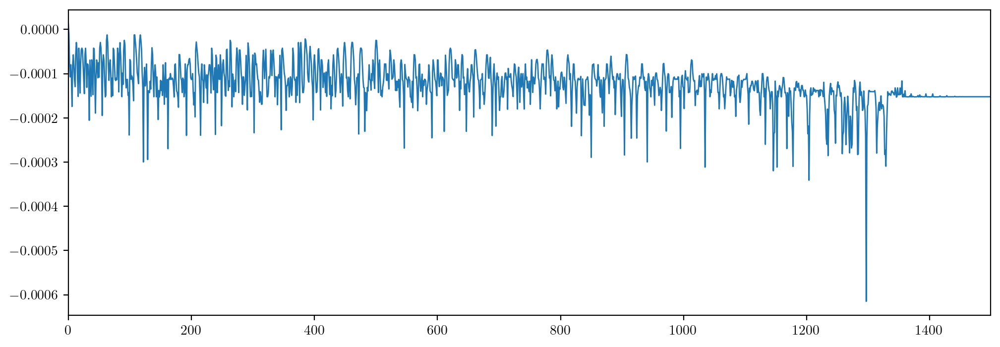

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 20, 3)
#l0 = np.random.normal(size=partial_sigs.shape[2])
l0 = np.ones(partial_sigs.shape[2])
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 1500
optimiser = torch.optim.Adam(model.parameters(), lr=0.4, betas=(0.5, 0.5), weight_decay=0.001)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
param_hist = np.zeros((max_epochs, len(l0)))
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    param_hist[epoch, :] = np.array(model.l.data)

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 20/20 [00:01<00:00, 17.36it/s]


tensor(4.0260e-05, dtype=torch.float64)


100%|██████████| 1500/1500 [00:02<00:00, 528.16it/s]

tensor(-0.0008, dtype=torch.float64, grad_fn=<NegBackward0>)


[None]

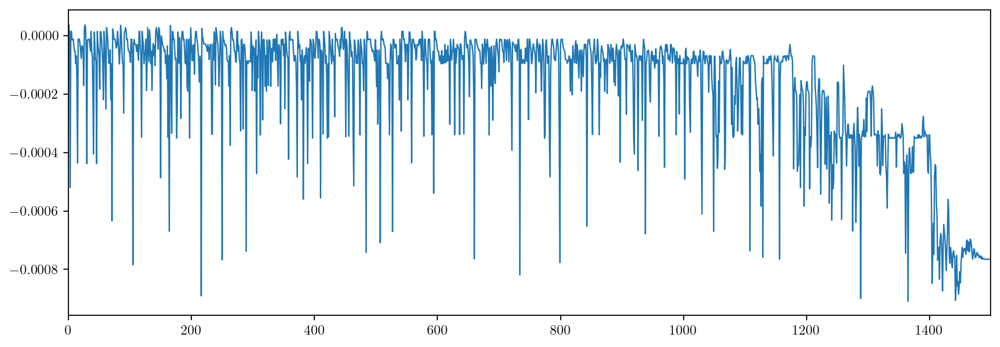

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 20, 3)
#l0 = np.random.normal(size=partial_sigs.shape[2])
l0 = np.ones(partial_sigs.shape[2])
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 1500
optimiser = torch.optim.Adam(model.parameters(), lr=0.4, betas=(0.2, 0.5), weight_decay=0.001)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
param_hist = np.zeros((max_epochs, len(l0)))
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    param_hist[epoch, :] = np.array(model.l.data)

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 20/20 [00:01<00:00, 17.83it/s]


tensor(-4.2137e-05, dtype=torch.float64)


100%|██████████| 1500/1500 [00:02<00:00, 531.65it/s]

tensor(-0.0011, dtype=torch.float64, grad_fn=<NegBackward0>)


[None]

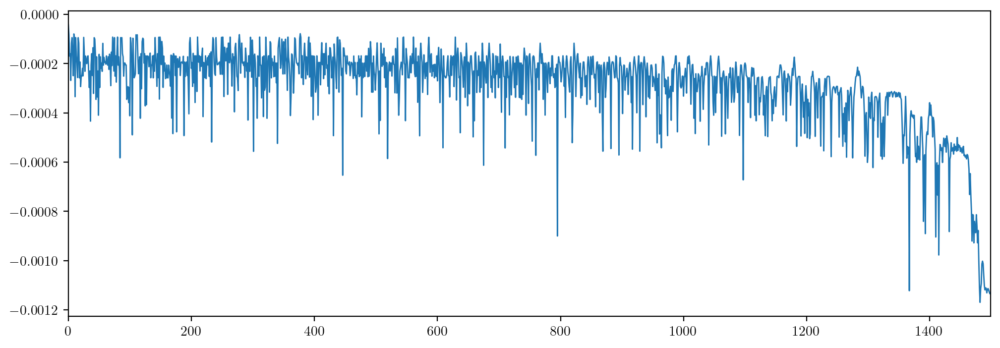

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 20, 3)
#l0 = np.random.normal(size=partial_sigs.shape[2])
l0 = np.ones(partial_sigs.shape[2])
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 1500
optimiser = torch.optim.Adam(model.parameters(), lr=0.4, betas=(0.2, 0.1), weight_decay=0.001)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
param_hist = np.zeros((max_epochs, len(l0)))
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    param_hist[epoch, :] = np.array(model.l.data)

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 20/20 [00:01<00:00, 17.88it/s]


tensor(-3.7252e-05, dtype=torch.float64)


100%|██████████| 1500/1500 [00:03<00:00, 499.23it/s]


tensor(-0.0006, dtype=torch.float64, grad_fn=<NegBackward0>)


[None]

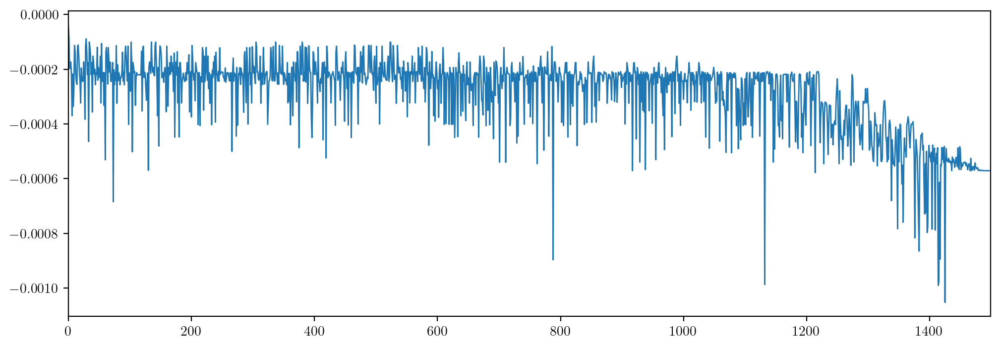

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 20, 3)
#l0 = np.random.normal(size=partial_sigs.shape[2])
l0 = np.ones(partial_sigs.shape[2])
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 1500
optimiser = torch.optim.Adam(model.parameters(), lr=0.4, betas=(0.2, 0.1), weight_decay=0.001)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
param_hist = np.zeros((max_epochs, len(l0)))
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    param_hist[epoch, :] = np.array(model.l.data)

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 20/20 [00:01<00:00, 17.82it/s]


tensor(-2.4842e-05, dtype=torch.float64)


100%|██████████| 1500/1500 [00:02<00:00, 529.39it/s]

tensor(-0.0002, dtype=torch.float64, grad_fn=<NegBackward0>)


[None]

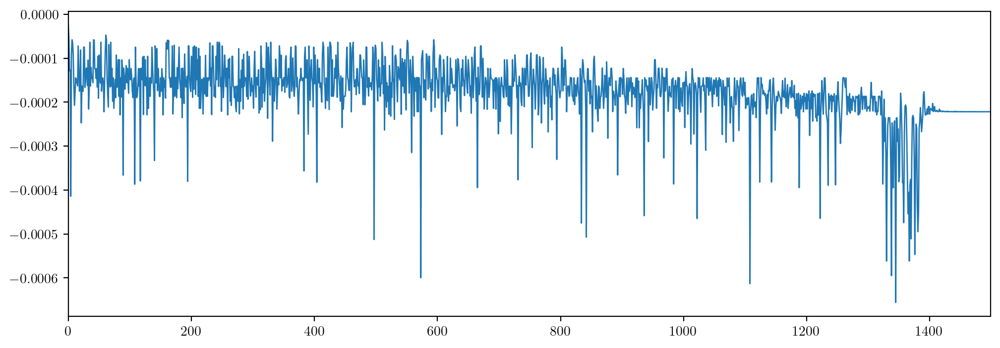

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 20, 3)
#l0 = np.random.normal(size=partial_sigs.shape[2])
l0 = np.ones(partial_sigs.shape[2])
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 1500
optimiser = torch.optim.Adam(model.parameters(), lr=0.4, betas=(0.2, 0.1), weight_decay=0.001)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
param_hist = np.zeros((max_epochs, len(l0)))
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    param_hist[epoch, :] = np.array(model.l.data)

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 20/20 [00:01<00:00, 18.30it/s]


tensor(-3.4894e-05, dtype=torch.float64)


100%|██████████| 1500/1500 [00:02<00:00, 548.66it/s]

tensor(-0., dtype=torch.float64, grad_fn=<NegBackward0>)


[None]

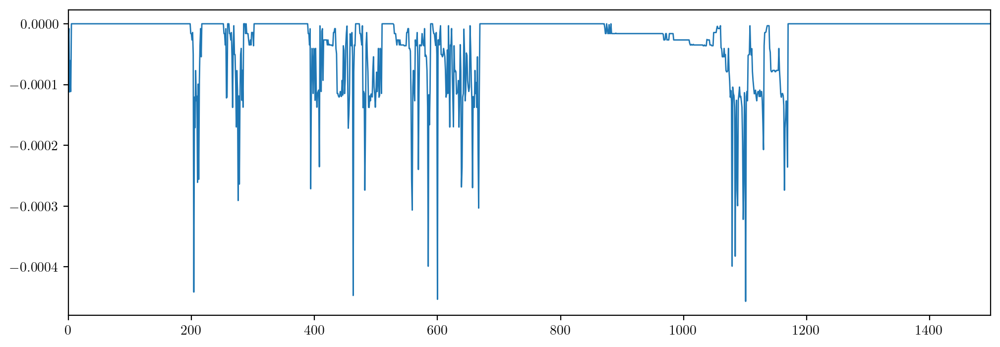

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 20, 3)
#l0 = np.random.normal(size=partial_sigs.shape[2])
l0 = np.ones(partial_sigs.shape[2])
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 1500
optimiser = torch.optim.Adam(model.parameters(), lr=0.4, betas=(0.2, 0.0), weight_decay=0.001)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
param_hist = np.zeros((max_epochs, len(l0)))
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    param_hist[epoch, :] = np.array(model.l.data)

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 20/20 [00:01<00:00, 17.91it/s]


tensor(-2.2491e-05, dtype=torch.float64)


100%|██████████| 1500/1500 [00:02<00:00, 539.00it/s]

tensor(-0.0007, dtype=torch.float64, grad_fn=<NegBackward0>)


[None]

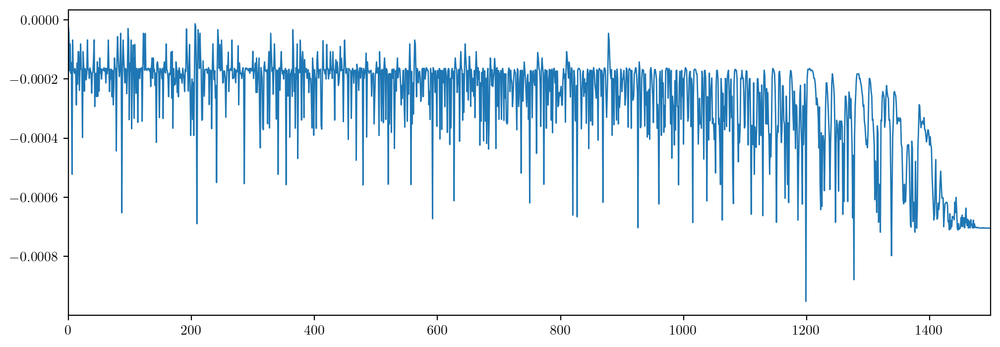

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 20, 3)
#l0 = np.random.normal(size=partial_sigs.shape[2])
l0 = np.ones(partial_sigs.shape[2])
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 1500
optimiser = torch.optim.Adam(model.parameters(), lr=0.4, betas=(0.2, 0.01), weight_decay=0.001)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
param_hist = np.zeros((max_epochs, len(l0)))
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    param_hist[epoch, :] = np.array(model.l.data)

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 20/20 [00:01<00:00, 18.13it/s]


tensor(-2.7385e-05, dtype=torch.float64)


100%|██████████| 1500/1500 [00:02<00:00, 509.37it/s]

tensor(-0.0008, dtype=torch.float64, grad_fn=<NegBackward0>)


[None]

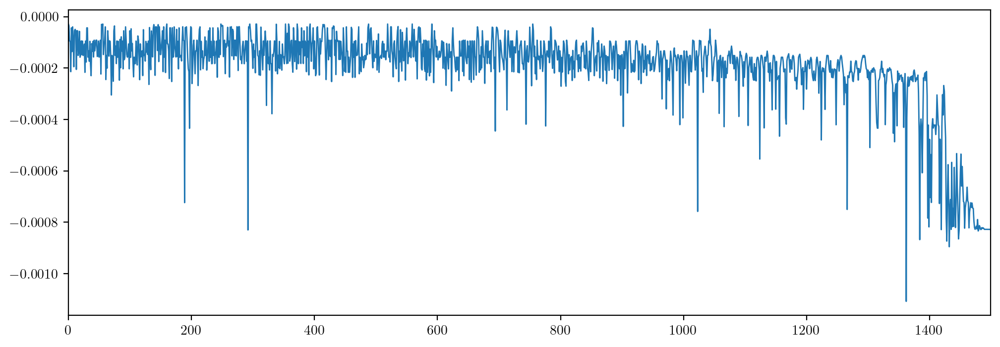

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 20, 3)
#l0 = np.random.normal(size=partial_sigs.shape[2])
l0 = np.ones(partial_sigs.shape[2])
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 1500
optimiser = torch.optim.Adam(model.parameters(), lr=0.4, betas=(0.2, 0.1), weight_decay=0.001)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
param_hist = np.zeros((max_epochs, len(l0)))
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    param_hist[epoch, :] = np.array(model.l.data)

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 20/20 [00:01<00:00, 17.74it/s]


tensor(-4.0013e-05, dtype=torch.float64)


100%|██████████| 1500/1500 [00:03<00:00, 495.12it/s]

tensor(-0.0006, dtype=torch.float64, grad_fn=<NegBackward0>)


[None]

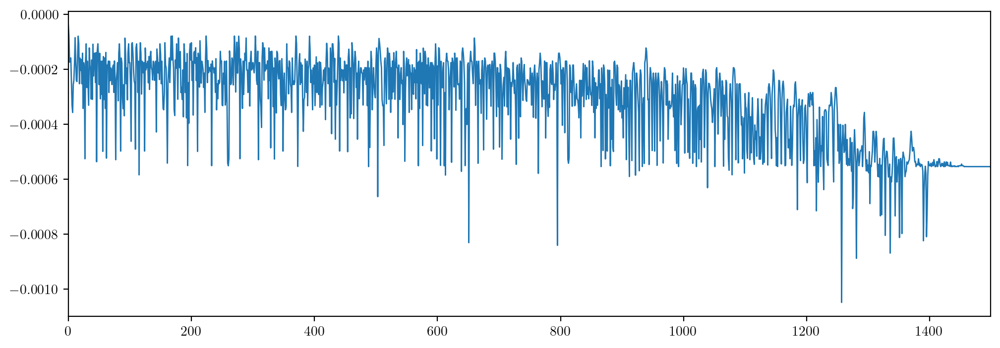

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 20, 3)
#l0 = np.random.normal(size=partial_sigs.shape[2])
l0 = np.ones(partial_sigs.shape[2])
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 1500
optimiser = torch.optim.Adam(model.parameters(), lr=0.4, betas=(0.2, 0.1), weight_decay=0.001)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
param_hist = np.zeros((max_epochs, len(l0)))
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    param_hist[epoch, :] = np.array(model.l.data)

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 20/20 [00:01<00:00, 17.41it/s]


tensor(-3.1941e-05, dtype=torch.float64)


100%|██████████| 1500/1500 [00:02<00:00, 540.55it/s]

tensor(-0.0006, dtype=torch.float64, grad_fn=<NegBackward0>)


[None]

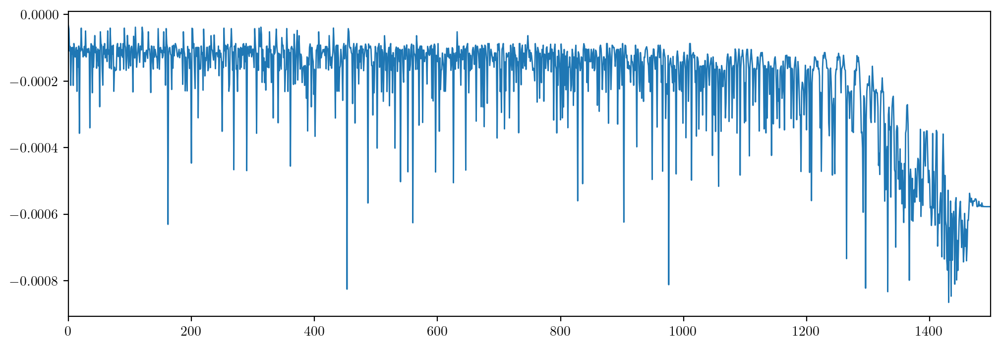

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 20, 3)
#l0 = np.random.normal(size=partial_sigs.shape[2])
l0 = np.ones(partial_sigs.shape[2])
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 1500
optimiser = torch.optim.Adam(model.parameters(), lr=0.4, betas=(0.2, 0.1), weight_decay=0.002)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
param_hist = np.zeros((max_epochs, len(l0)))
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    param_hist[epoch, :] = np.array(model.l.data)

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 20, 3)
#l0 = np.random.normal(size=partial_sigs.shape[2])
l0 = np.ones(partial_sigs.shape[2])
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 10s00
optimiser = torch.optim.Adam(model.parameters(), lr=0.4, betas=(0.2, 0.1), weight_decay=0.002)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
param_hist = np.zeros((max_epochs, len(l0)))
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    param_hist[epoch, :] = np.array(model.l.data)

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

SyntaxError: invalid decimal literal (<ipython-input-166-cb05c905384c>, line 39)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 20/20 [00:01<00:00, 18.07it/s]


tensor(-1.5091e-05, dtype=torch.float64)


100%|██████████| 1000/1000 [00:01<00:00, 508.44it/s]

tensor(-0.0006, dtype=torch.float64, grad_fn=<NegBackward0>)


[None]

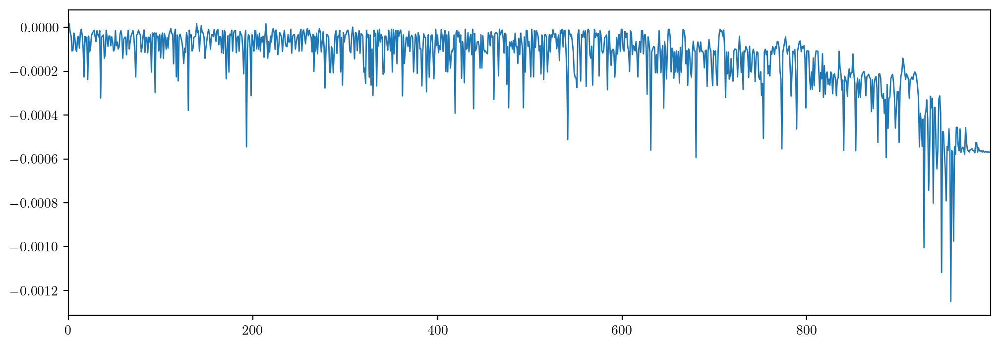

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 20, 3)
#l0 = np.random.normal(size=partial_sigs.shape[2])
l0 = np.ones(partial_sigs.shape[2])
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 1000
optimiser = torch.optim.Adam(model.parameters(), lr=0.4, betas=(0.2, 0.1), weight_decay=0.002)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
param_hist = np.zeros((max_epochs, len(l0)))
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    param_hist[epoch, :] = np.array(model.l.data)

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 20/20 [00:01<00:00, 17.97it/s]


tensor(2.5909e-05, dtype=torch.float64)


100%|██████████| 1500/1500 [00:03<00:00, 495.18it/s]

tensor(-0.0011, dtype=torch.float64, grad_fn=<NegBackward0>)


[None]

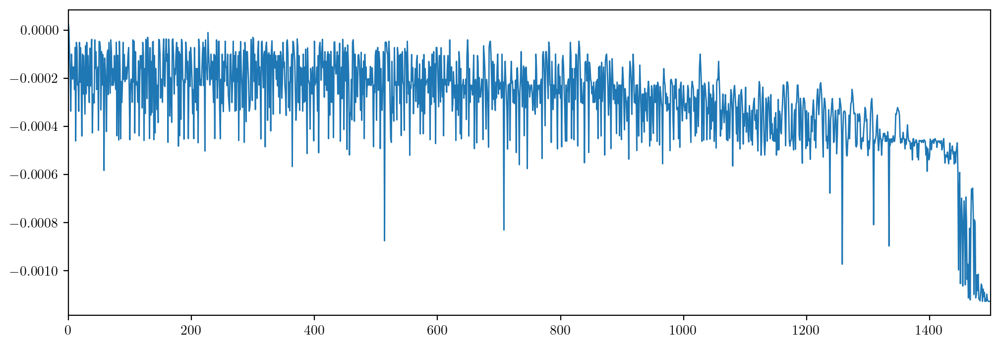

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 20, 3)
#l0 = np.random.normal(size=partial_sigs.shape[2])
l0 = np.ones(partial_sigs.shape[2])
k=5

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 1500
optimiser = torch.optim.Adam(model.parameters(), lr=0.4, betas=(0.2, 0.1), weight_decay=0.002)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
param_hist = np.zeros((max_epochs, len(l0)))
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    param_hist[epoch, :] = np.array(model.l.data)

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 20/20 [00:01<00:00, 17.60it/s]


tensor(-7.0222e-05, dtype=torch.float64)


100%|██████████| 1500/1500 [00:02<00:00, 521.96it/s]

tensor(-0.0006, dtype=torch.float64, grad_fn=<NegBackward0>)


[None]

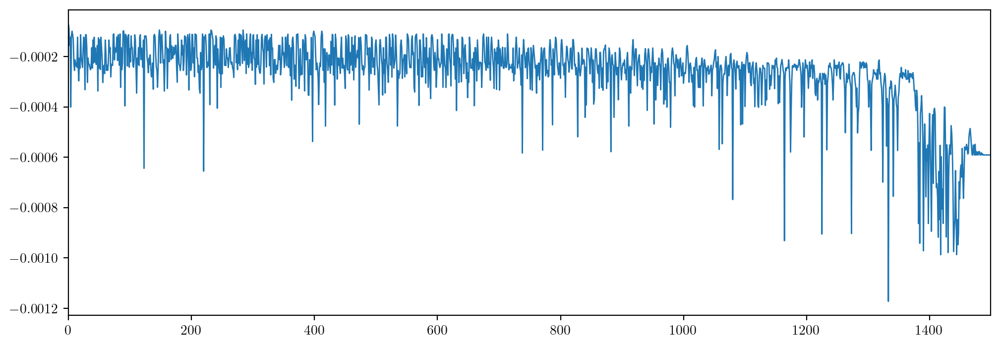

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 20, 3)
#l0 = np.random.normal(size=partial_sigs.shape[2])
l0 = np.ones(partial_sigs.shape[2])
k=10

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 1500
optimiser = torch.optim.Adam(model.parameters(), lr=0.4, betas=(0.2, 0.1), weight_decay=0.002)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
param_hist = np.zeros((max_epochs, len(l0)))
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    param_hist[epoch, :] = np.array(model.l.data)

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 20/20 [00:01<00:00, 17.71it/s]


tensor(-3.3467e-15, dtype=torch.float64)


100%|██████████| 1500/1500 [00:02<00:00, 515.20it/s]

tensor(-0.0009, dtype=torch.float64, grad_fn=<NegBackward0>)


[None]

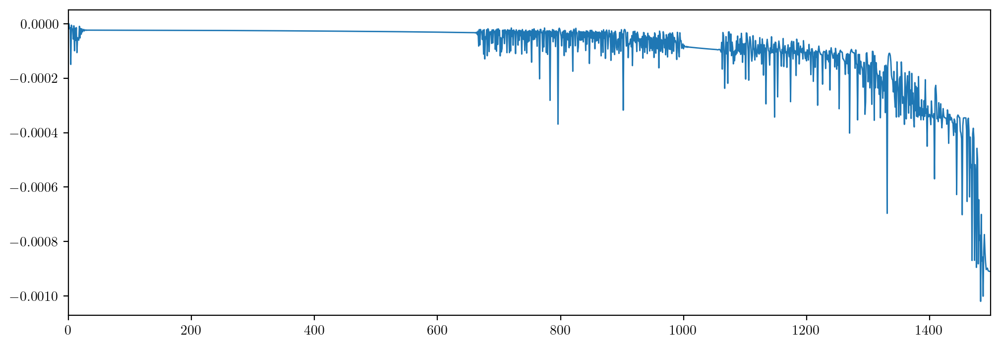

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 20, 3)
#l0 = np.random.normal(size=partial_sigs.shape[2])
l0 = np.ones(partial_sigs.shape[2])
k=0.1

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 1500
optimiser = torch.optim.Adam(model.parameters(), lr=0.4, betas=(0.2, 0.1), weight_decay=0.002)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
param_hist = np.zeros((max_epochs, len(l0)))
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    param_hist[epoch, :] = np.array(model.l.data)

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 20/20 [00:01<00:00, 17.82it/s]


tensor(-7.4884e-05, dtype=torch.float64)


100%|██████████| 1500/1500 [00:03<00:00, 487.79it/s]


tensor(-0.0007, dtype=torch.float64, grad_fn=<NegBackward0>)


[None]

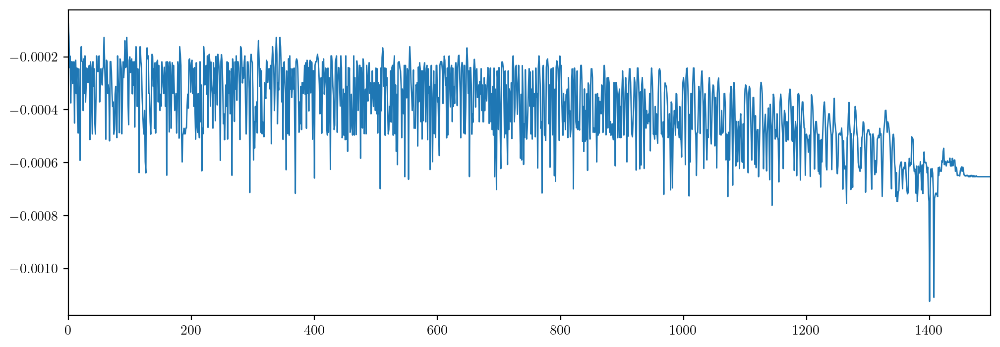

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 20, 3)
#l0 = np.random.normal(size=partial_sigs.shape[2])
l0 = np.ones(partial_sigs.shape[2])
k=10

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 1500
optimiser = torch.optim.Adam(model.parameters(), lr=0.4, betas=(0.2, 0.1), weight_decay=0.002)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
param_hist = np.zeros((max_epochs, len(l0)))
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    param_hist[epoch, :] = np.array(model.l.data)

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

In [ ]:
param_hist

array([[ 1.00000000e+00,  1.00000000e+00,  1.00000000e+00, ...,
         1.00000000e+00,  1.00000000e+00,  1.00000000e+00],
       [ 6.00002000e-01,  6.00002000e-01,  6.00002000e-01, ...,
         6.00002000e-01,  6.00002000e-01,  6.00002000e-01],
       [ 2.02195747e-01,  1.95831022e-01,  1.87637073e-01, ...,
         1.87636544e-01,  1.87636544e-01,  1.87636544e-01],
       ...,
       [-1.09276398e-03, -4.87711943e-04, -2.39001906e-08, ...,
        -5.28565075e-08, -5.29785322e-08, -5.26897771e-08],
       [-1.08885859e-03, -4.83892677e-04,  2.22133839e-08, ...,
        -3.95790282e-08, -3.97929562e-08, -3.94608308e-08],
       [-1.08710829e-03, -4.82138091e-04,  6.27092777e-09, ...,
        -2.74503805e-08, -2.76228473e-08, -2.73013823e-08]])

In [ ]:
param_hist[np.argmin(loss_hist), :]

array([ 0.01119038,  0.00132338, -0.0018422 ,  0.00296309,  0.00307615,
        0.00292129, -0.00145831, -0.00040792,  0.00263057,  0.00256259,
       -0.00145839,  0.00115219, -0.00145822, -0.00145844, -0.00145824])

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 20/20 [00:01<00:00, 17.94it/s]


tensor(-2.5806e-08, dtype=torch.float64)


100%|██████████| 1500/1500 [00:02<00:00, 507.08it/s]


tensor(-0.0013, dtype=torch.float64, grad_fn=<NegBackward0>)
[-2.10285799e-02 -7.24588521e-03 -4.09916934e-04  5.99482634e-03
 -6.15085755e-05 -1.06070387e-03 -6.29044263e-07 -7.99602353e-04
 -1.16867081e-03 -4.35378323e-03 -3.48018224e-06 -3.50296168e-03
 -1.53926026e-06 -1.12800485e-06 -2.76083914e-08]


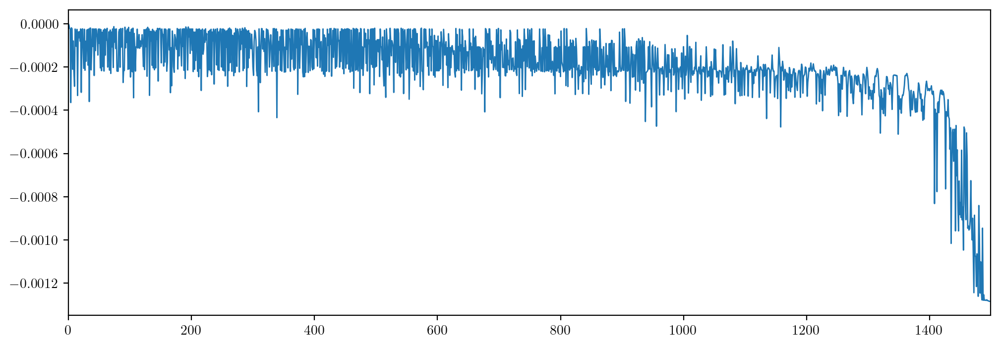

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 20, 3)
#l0 = np.random.normal(size=partial_sigs.shape[2])
l0 = np.ones(partial_sigs.shape[2])
k=1

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 1500
optimiser = torch.optim.Adam(model.parameters(), lr=0.4, betas=(0.2, 0.1), weight_decay=0.002)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
param_hist = np.zeros((max_epochs, len(l0)))
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    param_hist[epoch, :] = np.array(model.l.data)

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

print(param_hist[np.argmin(loss_hist), :])

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 20/20 [00:01<00:00, 17.97it/s]


tensor(-0.0001, dtype=torch.float64)


100%|██████████| 1500/1500 [00:02<00:00, 535.41it/s]


tensor(-0.0008, dtype=torch.float64, grad_fn=<NegBackward0>)
[-0.04537122  0.00338444  0.02416028 -0.00305201  0.0240468   0.02383181
  0.02451418  0.000341    0.0239109   0.02392865  0.02451424  0.02367603
  0.02451418  0.02451407  0.02451432]


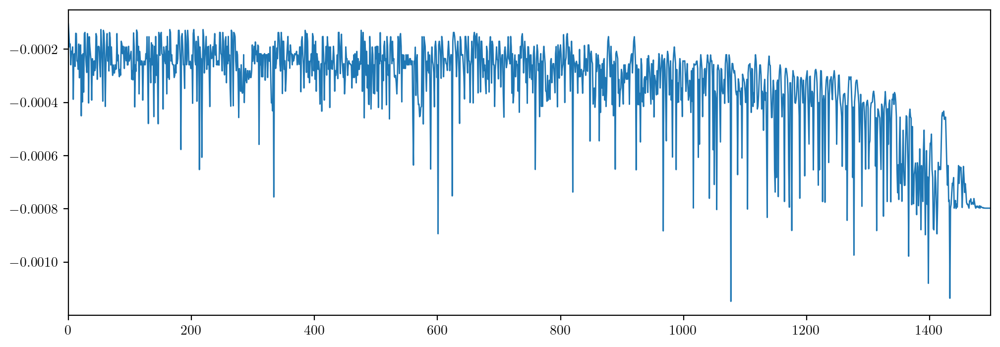

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 20, 3)
#l0 = np.random.normal(size=partial_sigs.shape[2])
l0 = np.ones(partial_sigs.shape[2])
k=10

model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 1500
optimiser = torch.optim.Adam(model.parameters(), lr=0.4, betas=(0.2, 0.1), weight_decay=0.002)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
param_hist = np.zeros((max_epochs, len(l0)))
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    param_hist[epoch, :] = np.array(model.l.data)

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

print(param_hist[np.argmin(loss_hist), :])

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 20, 3)
#l0 = np.random.normal(size=partial_sigs.shape[2])
k=10

l0 = np.random.noraml(size = partial_sigs.shape[2], scale = 5 * 10**(-3) * k)
model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 1500
optimiser = torch.optim.Adam(model.parameters(), lr=0.4, betas=(0.2, 0.1), weight_decay=0.002)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
param_hist = np.zeros((max_epochs, len(l0)))
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    param_hist[epoch, :] = np.array(model.l.data)

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

print(param_hist[np.argmin(loss_hist), :])

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 20/20 [00:01<00:00, 15.98it/s]


AttributeError: module 'numpy.random' has no attribute 'noraml'

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 20/20 [00:01<00:00, 17.51it/s]


tensor(-0.0004, dtype=torch.float64)


100%|██████████| 1500/1500 [00:02<00:00, 518.29it/s]


tensor(-0.0006, dtype=torch.float64, grad_fn=<NegBackward0>)
[ 0.01491326  0.00693492  0.00034168 -0.00217777 -0.00021084  0.00016884
  0.00037811  0.00035279 -0.00191341  0.00107282 -0.0003781   0.00299739
  0.00037767  0.00037595  0.00037824]


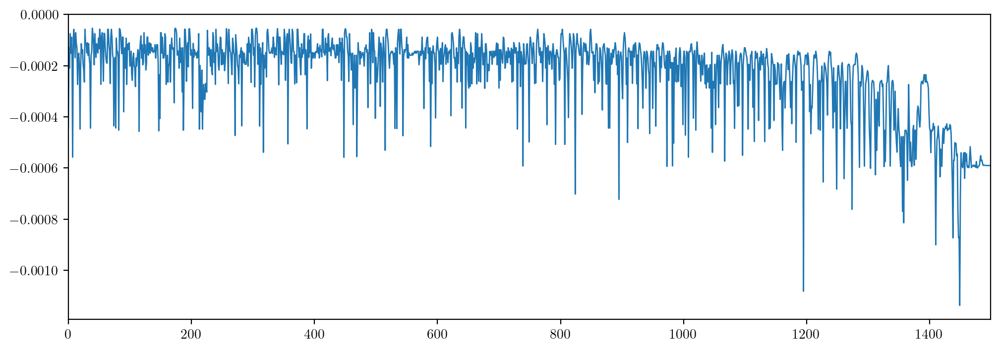

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 20, 3)
#l0 = np.random.normal(size=partial_sigs.shape[2])
k=10

l0 = np.random.normal(size = partial_sigs.shape[2], scale = 5 * 10**(-3) * k)
model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 1500
optimiser = torch.optim.Adam(model.parameters(), lr=0.4, betas=(0.2, 0.1), weight_decay=0.002)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
param_hist = np.zeros((max_epochs, len(l0)))
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    param_hist[epoch, :] = np.array(model.l.data)

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

print(param_hist[np.argmin(loss_hist), :])

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 20/20 [00:01<00:00, 17.94it/s]


tensor(-0.0003, dtype=torch.float64)


100%|██████████| 1500/1500 [00:02<00:00, 512.64it/s]


tensor(-0.0008, dtype=torch.float64, grad_fn=<NegBackward0>)
[ 1.65403627e-02  1.74647996e-02 -3.10929931e-04  4.51565076e-03
  8.37479844e-05  2.84474411e-04  1.46548867e-04 -1.05904562e-03
  7.20267051e-04 -1.94139795e-04  1.44027616e-04  5.40357843e-04
  1.51271209e-04  1.45331730e-04 -1.46774767e-04]


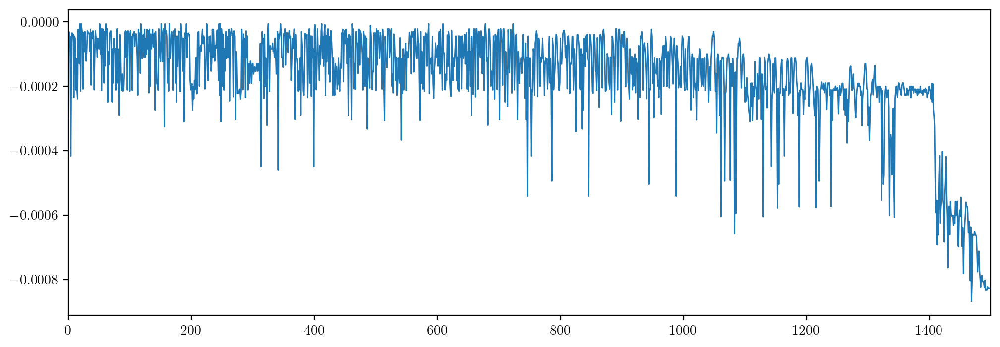

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 20, 3)
#l0 = np.random.normal(size=partial_sigs.shape[2])
k=10

l0 = np.random.normal(size = partial_sigs.shape[2], scale = 10**(-2) * k)
model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 1500
optimiser = torch.optim.Adam(model.parameters(), lr=0.4, betas=(0.2, 0.1), weight_decay=0.002)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
param_hist = np.zeros((max_epochs, len(l0)))
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    param_hist[epoch, :] = np.array(model.l.data)

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

print(param_hist[np.argmin(loss_hist), :])

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 20/20 [00:01<00:00, 17.87it/s]


tensor(-0.0001, dtype=torch.float64)


100%|██████████| 1500/1500 [00:02<00:00, 545.57it/s]


tensor(-0.0003, dtype=torch.float64, grad_fn=<NegBackward0>)
[-0.00611726 -0.01075921  0.00196664 -0.00440269  0.00177009  0.00059966
  0.00079899  0.00087096  0.00319408 -0.00153702 -0.00079822  0.00096199
 -0.00079915 -0.0007981   0.00079884]


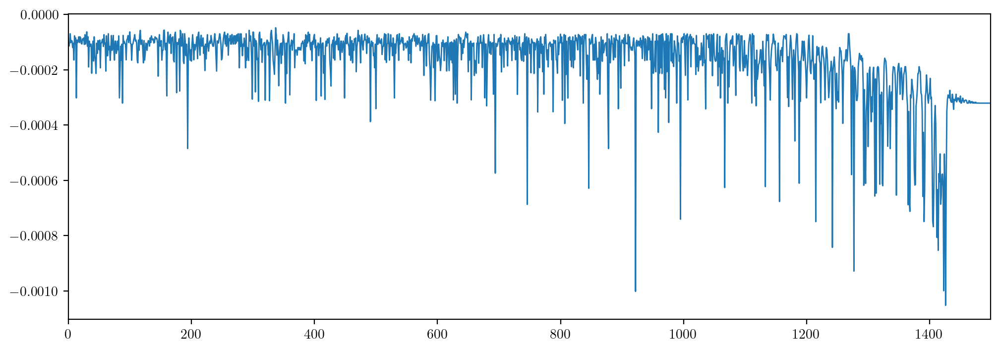

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 20, 3)
#l0 = np.random.normal(size=partial_sigs.shape[2])
k=10

l0 = np.random.normal(size = partial_sigs.shape[2], scale = 10**(-1) * k)
model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 1500
optimiser = torch.optim.Adam(model.parameters(), lr=0.4, betas=(0.2, 0.1), weight_decay=0.002)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
param_hist = np.zeros((max_epochs, len(l0)))
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    param_hist[epoch, :] = np.array(model.l.data)

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

print(param_hist[np.argmin(loss_hist), :])

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 20/20 [00:01<00:00, 18.09it/s]


tensor(-0.0003, dtype=torch.float64)


100%|██████████| 1500/1500 [00:02<00:00, 554.57it/s]


tensor(-0.0013, dtype=torch.float64, grad_fn=<NegBackward0>)
[ 0.00042913 -0.00103287 -0.00161581 -0.00451453  0.00026278  0.00128339
  0.00160727  0.00078003 -0.00032366  0.00017578  0.00160711 -0.00026574
 -0.00160758 -0.00160713  0.00160727]


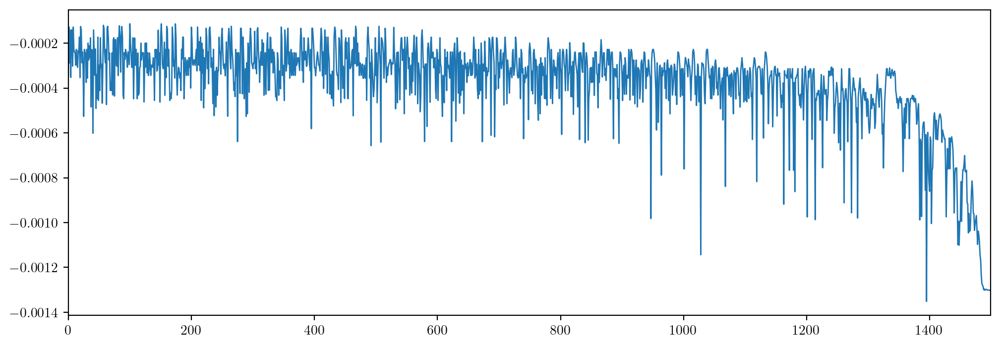

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 20, 3)
#l0 = np.random.normal(size=partial_sigs.shape[2])
k=10

l0 = np.random.normal(size = partial_sigs.shape[2], scale = 10**(-2) * k)
model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 1500
optimiser = torch.optim.Adam(model.parameters(), lr=0.4, betas=(0.2, 0.1), weight_decay=0.002)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
param_hist = np.zeros((max_epochs, len(l0)))
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    param_hist[epoch, :] = np.array(model.l.data)

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

print(param_hist[np.argmin(loss_hist), :])

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 20/20 [00:01<00:00, 17.45it/s]


tensor(-0.0004, dtype=torch.float64)


100%|██████████| 1500/1500 [00:02<00:00, 548.01it/s]


tensor(-0.0005, dtype=torch.float64, grad_fn=<NegBackward0>)
[ 0.00082509  0.01242698 -0.01119948  0.00639815  0.01052878 -0.01115405
  0.01099648 -0.00203855 -0.01162125  0.01003667 -0.0109966   0.01065254
 -0.01099658 -0.01099659  0.01099655]


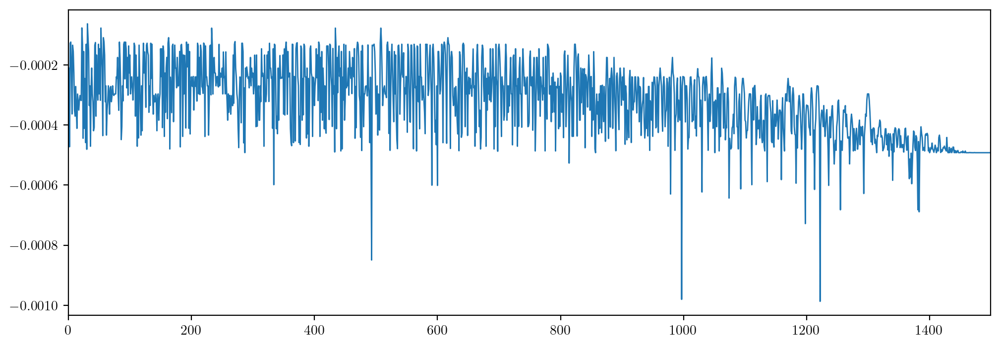

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 20, 3)
#l0 = np.random.normal(size=partial_sigs.shape[2])
k=10

l0 = np.random.normal(size = partial_sigs.shape[2], scale = 5* 10**(-3) * k)
model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 1500
optimiser = torch.optim.Adam(model.parameters(), lr=0.4, betas=(0.2, 0.1), weight_decay=0.002)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
param_hist = np.zeros((max_epochs, len(l0)))
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    param_hist[epoch, :] = np.array(model.l.data)

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

print(param_hist[np.argmin(loss_hist), :])

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 20/20 [00:01<00:00, 17.96it/s]


tensor(-0.0002, dtype=torch.float64)


100%|██████████| 1500/1500 [00:02<00:00, 512.91it/s]


tensor(-0.0014, dtype=torch.float64, grad_fn=<NegBackward0>)
[-6.07014468e-03  4.55875083e-03 -5.35806486e-04  3.87466512e-04
 -6.59055862e-05 -4.78567733e-04  5.88364178e-05 -8.12082523e-05
  3.05202845e-03  9.20369839e-05 -6.16581584e-05  1.49411082e-03
  5.07385799e-05 -6.12922867e-05 -5.94081259e-05]


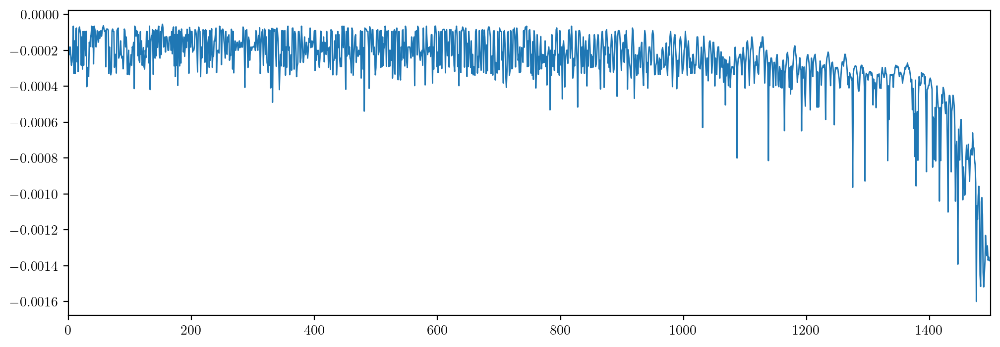

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 20, 3)
#l0 = np.random.normal(size=partial_sigs.shape[2])
k=10

l0 = np.random.normal(size = partial_sigs.shape[2], scale = 5* 10**(-3) * k)
model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 1500
optimiser = torch.optim.Adam(model.parameters(), lr=0.3, betas=(0.2, 0.1), weight_decay=0.002)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
param_hist = np.zeros((max_epochs, len(l0)))
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    param_hist[epoch, :] = np.array(model.l.data)

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

print(param_hist[np.argmin(loss_hist), :])

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 20/20 [00:01<00:00, 17.72it/s]


tensor(-0.0002, dtype=torch.float64)


100%|██████████| 1500/1500 [00:02<00:00, 527.24it/s]


tensor(-0.0003, dtype=torch.float64, grad_fn=<NegBackward0>)
[-0.01739936  0.00476026 -0.00347088  0.00691188  0.00122063  0.00201961
  0.00332424 -0.00135201 -0.00231957  0.00265258  0.00332423 -0.0045889
  0.00332417 -0.00332432 -0.00332428]


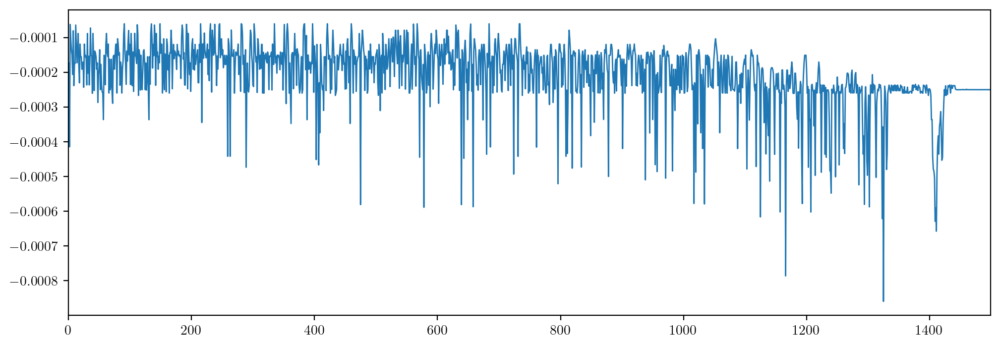

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 20, 3)
#l0 = np.random.normal(size=partial_sigs.shape[2])
k=10

l0 = np.random.normal(size = partial_sigs.shape[2], scale = 5* 10**(-3) * k)
model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 1500
optimiser = torch.optim.Adam(model.parameters(), lr=0.3, betas=(0.2, 0.1), weight_decay=0.002)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
param_hist = np.zeros((max_epochs, len(l0)))
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    param_hist[epoch, :] = np.array(model.l.data)

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

print(param_hist[np.argmin(loss_hist), :])

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 20/20 [00:01<00:00, 18.03it/s]


tensor(-0.0002, dtype=torch.float64)


100%|██████████| 1500/1500 [00:02<00:00, 541.48it/s]


tensor(-0.0012, dtype=torch.float64, grad_fn=<NegBackward0>)
-0.0012994011350017148


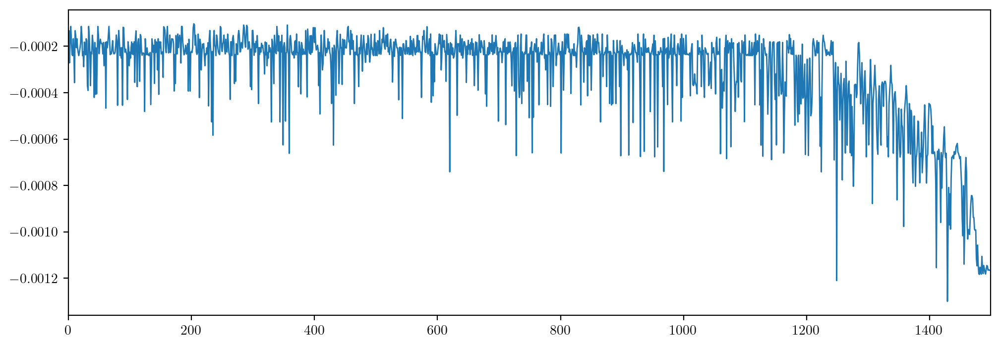

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 20, 3)
#l0 = np.random.normal(size=partial_sigs.shape[2])
k=10

l0 = np.random.normal(size = partial_sigs.shape[2], scale = 5* 10**(-3) * k)
model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 1500
optimiser = torch.optim.Adam(model.parameters(), lr=0.3, betas=(0.2, 0.1), weight_decay=0.002)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
param_hist = np.zeros((max_epochs, len(l0)))
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    param_hist[epoch, :] = np.array(model.l.data)

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

print(np.min(loss_hist))

vol ratio:  0.6811  |  pred vol ratio:  0.9189


100%|██████████| 20/20 [00:01<00:00, 17.93it/s]


tensor(-0.0004, dtype=torch.float64)


100%|██████████| 1500/1500 [00:02<00:00, 539.57it/s]


tensor(-0.0006, dtype=torch.float64, grad_fn=<NegBackward0>)
-0.0015336211917613418


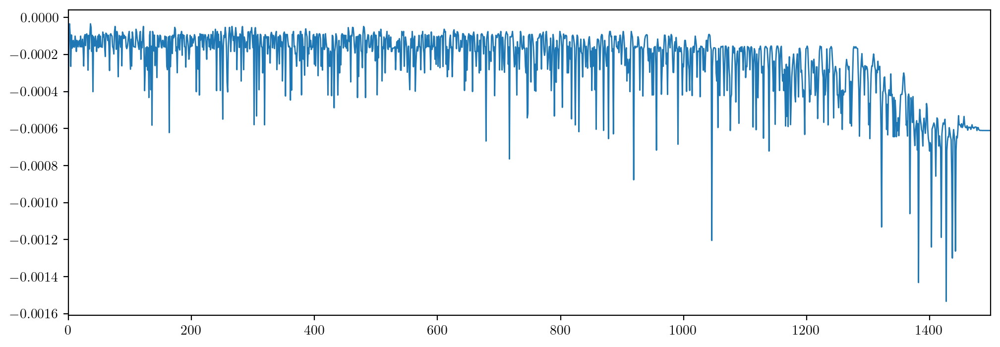

In [ ]:
from optimal_stopping_times import *
from torch import nn

def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
    
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
        return loss_fn(self.l, self.ps, self.pf, self.k)

partial_sigs, payoffs = gen_partial_sigs(120, 20, 3)
#l0 = np.random.normal(size=partial_sigs.shape[2])
k=10

l0 = np.random.normal(size = partial_sigs.shape[2], scale = 5* 10**(-3) * k)
model = Model(l0, partial_sigs, payoffs, k)

print(loss_fn(l0, torch.tensor(partial_sigs), torch.tensor(payoffs), k))

max_epochs = 1500
optimiser = torch.optim.Adam(model.parameters(), lr=0.3, betas=(0.2, 0.1), weight_decay=0.002)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = max_epochs)

loss_hist = np.zeros(max_epochs)
param_hist = np.zeros((max_epochs, len(l0)))
for epoch in tqdm(range(max_epochs)):
    optimiser.zero_grad() # don't use old gradients
    out = model()
    loss = out # any function of your choice returning a one-element tensor
    loss_hist[epoch] = loss
    param_hist[epoch, :] = np.array(model.l.data)

    loss.backward() # compute gradients wrt loss
    optimiser.step() # update parameters    
    scheduler.step() # update optimiser parameters


print(model.forward())
fig, ax = plt.subplots()
ax.plot(np.arange(max_epochs), loss_hist)
ax.set(xmargin = 0)

print(np.min(loss_hist))

Connected to Python 3.11.4

In [ ]:
import torch
from torch import nn

from optimal_stopping_times import *

"""
def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
"""
    
#   defines pytorch model

class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
         #   inner product between l and signatures 
        in_prod = self.ps @ self.l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-10*(x-self.k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = self.pf @ partial_cdf_sums.t()

        return -(losses.diag()).mean()

#   adam opt.

def adam_opt(ps, pf, M, depth, k, epochs = 2000, plot = False, lr = 0.1, sc = 5 * 10**(-3)):
    l0 = np.random.normal(size = ps.shape[2], scale = sc * k)
    model = Model(l0, ps, pf, k)
    print(float(model.forward()))

    optimiser = torch.optim.Adam(model.parameters(), lr=lr, betas=(0.2, 0.1), weight_decay=0.002)
    scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = epochs)

    loss_hist = np.zeros(epochs)
    param_hist = np.zeros((epochs, len(l0)))

    for epoch in tqdm(range(epochs)):
        optimiser.zero_grad() # don't use old gradients
        out = model()
        loss = out # any function of your choice returning a one-element tensor
        loss_hist[epoch] = float(loss)
        param_hist[epoch, :] = np.array(model.l.data)

        loss.backward() # compute gradients wrt loss
        optimiser.step() # update parameters    
        scheduler.step() # update optimiser parameters

    if plot == True:
        fig, ax = plt.subplots()
        ax.plot(np.arange(epochs), loss_hist)
        ax.set(xmargin = 0)

    return param_hist[np.argmin(loss_hist), :], float(np.mean(loss_hist))

ps, pf = gen_partial_sigs(100, 20, 3)

adm = lambda lr, sc: adam_opt(ps, pf, 20, 3, 30, lr = lr, sc = sc,plot = True)

#   hyperparameter tuning
import optuna

NameError: name 'gen_partial_sigs' is not defined

In [ ]:
import torch
from torch import nn

from optimal_stopping_times import *

"""
def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
"""
    
#   defines pytorch model

class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
         #   inner product between l and signatures 
        in_prod = self.ps @ self.l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-10*(x-self.k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = self.pf @ partial_cdf_sums.t()

        return -(losses.diag()).mean()

#   adam opt.

def adam_opt(ps, pf, M, depth, k, epochs = 2000, plot = False, lr = 0.1, sc = 5 * 10**(-3)):
    l0 = np.random.normal(size = ps.shape[2], scale = sc * k)
    model = Model(l0, ps, pf, k)
    print(float(model.forward()))

    optimiser = torch.optim.Adam(model.parameters(), lr=lr, betas=(0.2, 0.1), weight_decay=0.002)
    scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = epochs)

    loss_hist = np.zeros(epochs)
    param_hist = np.zeros((epochs, len(l0)))

    for epoch in tqdm(range(epochs)):
        optimiser.zero_grad() # don't use old gradients
        out = model()
        loss = out # any function of your choice returning a one-element tensor
        loss_hist[epoch] = float(loss)
        param_hist[epoch, :] = np.array(model.l.data)

        loss.backward() # compute gradients wrt loss
        optimiser.step() # update parameters    
        scheduler.step() # update optimiser parameters

    if plot == True:
        fig, ax = plt.subplots()
        ax.plot(np.arange(epochs), loss_hist)
        ax.set(xmargin = 0)

    return param_hist[np.argmin(loss_hist), :], float(np.mean(loss_hist))

ps, pf = gen_partial_sigs(100, 20, 3)

adm = lambda lr, sc: adam_opt(ps, pf, 20, 3, 30, lr = lr, sc = sc,plot = True)

#   hyperparameter tuning
import optuna

NameError: name 'gen_partial_sigs' is not defined

In [ ]:
adam

NameError: name 'adam' is not defined

Restarted Python 3.11.4

In [ ]:
import torch
from torch import nn

from optimal_stopping_times import *

"""
def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
"""
    
#   defines pytorch model

class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
         #   inner product between l and signatures 
        in_prod = self.ps @ self.l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-10*(x-self.k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = self.pf @ partial_cdf_sums.t()

        return -(losses.diag()).mean()

#   adam opt.

def adam_opt(ps, pf, M, depth, k, epochs = 2000, plot = False, lr = 0.1, sc = 5 * 10**(-3)):
    l0 = np.random.normal(size = ps.shape[2], scale = sc * k)
    model = Model(l0, ps, pf, k)
    print(float(model.forward()))

    optimiser = torch.optim.Adam(model.parameters(), lr=lr, betas=(0.2, 0.1), weight_decay=0.002)
    scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = epochs)

    loss_hist = np.zeros(epochs)
    param_hist = np.zeros((epochs, len(l0)))

    for epoch in tqdm(range(epochs)):
        optimiser.zero_grad() # don't use old gradients
        out = model()
        loss = out # any function of your choice returning a one-element tensor
        loss_hist[epoch] = float(loss)
        param_hist[epoch, :] = np.array(model.l.data)

        loss.backward() # compute gradients wrt loss
        optimiser.step() # update parameters    
        scheduler.step() # update optimiser parameters

    if plot == True:
        fig, ax = plt.subplots()
        ax.plot(np.arange(epochs), loss_hist)
        ax.set(xmargin = 0)

    return param_hist[np.argmin(loss_hist), :], float(np.mean(loss_hist))

ps, pf = gen_partial_sigs(100, 20, 3)

adm = lambda lr, sc: adam_opt(ps, pf, 20, 3, 30, lr = lr, sc = sc,plot = True)

#   hyperparameter tuning
import optuna

NameError: name 'gen_partial_sigs' is not defined

In [ ]:
from OU_simulation import *
#from pytorch_opt import adam_opt

import iisignature as iis

T = 600
dt = 0.1
N = int(T/dt)

def aug_sig(id, end_time = 'pos', log = True, depth = 3, price = False, structure = 1):
    data = dev_from_rolling_price(td[id], log = log).dropna()
    if end_time == 'pos':
        end = to_df(pos[id]).index[0]
        data = data[:end]
    else:
        data = data[:end_time]
    
    n = len(data.index)

    if price == False:
        data = data['diff'].values.reshape(n, 1)
    else:
        data = data[['price', 'diff']].values.reshape(n, 2)

    index = np.arange(0, n).reshape(n, 1) * dt
    aug_path = np.hstack((index, data))
    #print(aug_path.shape)
    signature =  iis.sig(aug_path, depth, structure)
    return signature

def gen_partial_sigs(id, M, depth, theoretical = False):
    paths, time_index = gen_OU_sample(id, N = N, M = M, theoretical = theoretical)
    #the sample generation is very slow due to pd stuff, optimise later
    payoffs = paths[:, 1:] - paths[:, :-1]
    sl = iis.siglength(2, depth)

    partial_sigs = np.zeros((M, N-1, sl+1))
    partial_sigs[:, :, 0] = 1

    for i in range(M):
        aug_path = np.vstack((time_index, paths[i, :])).transpose()
        partial_sigs[i, :, 1:] = iis.sig(aug_path, depth, 2)

    return partial_sigs, payoffs

def get_opt_stopping_time(id, M, depth, k, theoretical=False, v= False):
    #print('generating samples')
    partial_sigs, payoffs = gen_partial_sigs(id, M, depth, theoretical=theoretical)

    l_opt, loss = adam_opt(partial_sigs, payoffs, M, depth, k, epochs = 2000, plot = v)
    print(loss)
    #print(l_opt)

    in_prod = np.apply_along_axis(lambda x: np.inner(l_opt, x), -1, partial_sigs)
    sig_dist = in_prod**2

    sig_dist_cumsum = np.apply_along_axis(np.cumsum, -1, sig_dist)
    opt_stopping_times = np.argmax(sig_dist_cumsum > k, axis = 1)

    #opt_stopping_time = dt * np.argmin(mean_sig_dist_cumsum < k)
    return np.mean(opt_stopping_times)

#get_opt_stopping_time(100, 20, 3, 30, v=True)

In [ ]:
import torch
from torch import nn

from optimal_stopping_times import *

"""
def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
"""
    
#   defines pytorch model

class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
         #   inner product between l and signatures 
        in_prod = self.ps @ self.l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-10*(x-self.k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = self.pf @ partial_cdf_sums.t()

        return -(losses.diag()).mean()

#   adam opt.

def adam_opt(ps, pf, M, depth, k, epochs = 2000, plot = False, lr = 0.1, sc = 5 * 10**(-3)):
    l0 = np.random.normal(size = ps.shape[2], scale = sc * k)
    model = Model(l0, ps, pf, k)
    print(float(model.forward()))

    optimiser = torch.optim.Adam(model.parameters(), lr=lr, betas=(0.2, 0.1), weight_decay=0.002)
    scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = epochs)

    loss_hist = np.zeros(epochs)
    param_hist = np.zeros((epochs, len(l0)))

    for epoch in tqdm(range(epochs)):
        optimiser.zero_grad() # don't use old gradients
        out = model()
        loss = out # any function of your choice returning a one-element tensor
        loss_hist[epoch] = float(loss)
        param_hist[epoch, :] = np.array(model.l.data)

        loss.backward() # compute gradients wrt loss
        optimiser.step() # update parameters    
        scheduler.step() # update optimiser parameters

    if plot == True:
        fig, ax = plt.subplots()
        ax.plot(np.arange(epochs), loss_hist)
        ax.set(xmargin = 0)

    return param_hist[np.argmin(loss_hist), :], float(np.mean(loss_hist))

ps, pf = gen_partial_sigs(100, 20, 3)

adm = lambda lr, sc: adam_opt(ps, pf, 20, 3, 30, lr = lr, sc = sc,plot = True)

#   hyperparameter tuning
import optuna

vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:02<00:00,  9.69it/s]
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [ ]:
import torch
from torch import nn

from optimal_stopping_times import *

"""
def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
"""
    
#   defines pytorch model

class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
         #   inner product between l and signatures 
        in_prod = self.ps @ self.l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-10*(x-self.k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = self.pf @ partial_cdf_sums.t()

        return -(losses.diag()).mean()

#   adam opt.

def adam_opt(ps, pf, M, depth, k, epochs = 2000, plot = False, lr = 0.1, sc = 5 * 10**(-3)):
    l0 = np.random.normal(size = ps.shape[2], scale = sc * k)
    model = Model(l0, ps, pf, k)
    print(float(model.forward()))

    optimiser = torch.optim.Adam(model.parameters(), lr=lr, betas=(0.2, 0.1), weight_decay=0.002)
    scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = epochs)

    loss_hist = np.zeros(epochs)
    param_hist = np.zeros((epochs, len(l0)))

    for epoch in tqdm(range(epochs)):
        optimiser.zero_grad() # don't use old gradients
        out = model()
        loss = out # any function of your choice returning a one-element tensor
        loss_hist[epoch] = float(loss)
        param_hist[epoch, :] = np.array(model.l.data)

        loss.backward() # compute gradients wrt loss
        optimiser.step() # update parameters    
        scheduler.step() # update optimiser parameters

    if plot == True:
        fig, ax = plt.subplots()
        ax.plot(np.arange(epochs), loss_hist)
        ax.set(xmargin = 0)

    return param_hist[np.argmin(loss_hist), :], float(np.mean(loss_hist))

ps, pf = gen_partial_sigs(100, 20, 3)

adm = lambda lr, sc: adam_opt(ps, pf, 20, 3, 30, lr = lr, sc = sc,plot = True)

#   hyperparameter tuning
import optuna

vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:02<00:00,  9.63it/s]


Restarted Python 3.11.4

In [ ]:
import torch
from torch import nn

from optimal_stopping_times import *

"""
def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
"""
    
#   defines pytorch model

class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
         #   inner product between l and signatures 
        in_prod = self.ps @ self.l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-10*(x-self.k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = self.pf @ partial_cdf_sums.t()

        return -(losses.diag()).mean()

#   adam opt.

def adam_opt(ps, pf, M, depth, k, epochs = 2000, plot = False, lr = 0.1, sc = 5 * 10**(-3)):
    l0 = np.random.normal(size = ps.shape[2], scale = sc * k)
    model = Model(l0, ps, pf, k)
    print(float(model.forward()))

    optimiser = torch.optim.Adam(model.parameters(), lr=lr, betas=(0.2, 0.1), weight_decay=0.002)
    scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = epochs)

    loss_hist = np.zeros(epochs)
    param_hist = np.zeros((epochs, len(l0)))

    for epoch in tqdm(range(epochs)):
        optimiser.zero_grad() # don't use old gradients
        out = model()
        loss = out # any function of your choice returning a one-element tensor
        loss_hist[epoch] = float(loss)
        param_hist[epoch, :] = np.array(model.l.data)

        loss.backward() # compute gradients wrt loss
        optimiser.step() # update parameters    
        scheduler.step() # update optimiser parameters

    if plot == True:
        fig, ax = plt.subplots()
        ax.plot(np.arange(epochs), loss_hist)
        ax.set(xmargin = 0)

    return param_hist[np.argmin(loss_hist), :], float(np.mean(loss_hist))

ps, pf = gen_partial_sigs(100, 20, 3)

adm = lambda lr, sc: adam_opt(ps, pf, 20, 3, 30, lr = lr, sc = sc, plot = False)

#   hyperparameter tuning
import optuna

def objective(trial):
    lr = trial.suggest_float('lr', 0.0001, 0.5)
    sc = trial.suggest_float('sc', 10**(-4), 0.1)

    return adm(lr, sc)[1]

study = optuna.create_study()
study.optimize(objective, n_trials=10)

vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.58it/s]
[I 2024-12-17 13:30:06,741] A new study created in memory with name: no-name-aa4aba65-5b71-45de-8fe3-f129b2b9b3af


-0.00014312922928448875


100%|██████████| 2000/2000 [00:05<00:00, 387.81it/s]
[I 2024-12-17 13:30:11,903] Trial 0 finished with value: -0.0001217816170479721 and parameters: {'lr': 0.2523202691041988, 'sc': 0.02039565108217253}. Best is trial 0 with value: -0.0001217816170479721.


6.481170201370434e-06


100%|██████████| 2000/2000 [00:05<00:00, 379.39it/s]
[I 2024-12-17 13:30:17,178] Trial 1 finished with value: -0.00012383755964398893 and parameters: {'lr': 0.3201413360299183, 'sc': 0.09997631761721266}. Best is trial 1 with value: -0.00012383755964398893.


-5.5997994937724614e-05


100%|██████████| 2000/2000 [00:04<00:00, 409.19it/s]
[I 2024-12-17 13:30:22,070] Trial 2 finished with value: -0.00012274560026621502 and parameters: {'lr': 0.13381067735419155, 'sc': 0.053227779309850023}. Best is trial 1 with value: -0.00012383755964398893.


-9.3164505282989e-05


100%|██████████| 2000/2000 [00:05<00:00, 374.49it/s]
[I 2024-12-17 13:30:27,414] Trial 3 finished with value: -0.0001246059927161284 and parameters: {'lr': 0.27528950825579207, 'sc': 0.09780916393541216}. Best is trial 3 with value: -0.0001246059927161284.


-3.4474515816665614e-05


100%|██████████| 2000/2000 [00:05<00:00, 393.74it/s]
[I 2024-12-17 13:30:32,497] Trial 4 finished with value: -0.00012334079360050825 and parameters: {'lr': 0.06772846658404258, 'sc': 0.03927430815320723}. Best is trial 3 with value: -0.0001246059927161284.


-8.747648101430697e-05


100%|██████████| 2000/2000 [00:05<00:00, 395.96it/s]
[I 2024-12-17 13:30:37,552] Trial 5 finished with value: -0.00012055306596934579 and parameters: {'lr': 0.39177887489428737, 'sc': 0.0716360378305402}. Best is trial 3 with value: -0.0001246059927161284.


-1.769066280775239e-05


100%|██████████| 2000/2000 [00:04<00:00, 410.26it/s]
[I 2024-12-17 13:30:42,442] Trial 6 finished with value: -0.00012280217734971286 and parameters: {'lr': 0.47749803289253734, 'sc': 0.08514532859040579}. Best is trial 3 with value: -0.0001246059927161284.


1.608863416507873e-05


100%|██████████| 2000/2000 [00:05<00:00, 391.38it/s]
[I 2024-12-17 13:30:47,556] Trial 7 finished with value: -0.00012197155838348442 and parameters: {'lr': 0.12392130279416141, 'sc': 0.0915241962499461}. Best is trial 3 with value: -0.0001246059927161284.


2.8093405825586417e-05


100%|██████████| 2000/2000 [00:04<00:00, 403.89it/s]
[I 2024-12-17 13:30:52,512] Trial 8 finished with value: -0.00012421728636672404 and parameters: {'lr': 0.19368040477998236, 'sc': 0.06627725007254309}. Best is trial 3 with value: -0.0001246059927161284.


-0.0001480772753586342


100%|██████████| 2000/2000 [00:04<00:00, 427.67it/s]
[I 2024-12-17 13:30:57,193] Trial 9 finished with value: -0.00012278525369367876 and parameters: {'lr': 0.2087406965397901, 'sc': 0.053282301722369405}. Best is trial 3 with value: -0.0001246059927161284.


In [ ]:
study

In [ ]:
study.best_trials

[FrozenTrial(number=3, state=1, values=[-0.0001246059927161284], datetime_start=datetime.datetime(2024, 12, 17, 13, 30, 22, 70369), datetime_complete=datetime.datetime(2024, 12, 17, 13, 30, 27, 414255), params={'lr': 0.27528950825579207, 'sc': 0.09780916393541216}, user_attrs={}, system_attrs={}, intermediate_values={}, distributions={'lr': FloatDistribution(high=0.5, log=False, low=0.0001, step=None), 'sc': FloatDistribution(high=0.1, log=False, low=0.0001, step=None)}, trial_id=3, value=None)]

In [ ]:
study.best_params

{'lr': 0.27528950825579207, 'sc': 0.09780916393541216}

In [ ]:
import torch
from torch import nn

from optimal_stopping_times import *

"""
def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
"""
    
#   defines pytorch model

class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
         #   inner product between l and signatures 
        in_prod = self.ps @ self.l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-10*(x-self.k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = self.pf @ partial_cdf_sums.t()

        return -(losses.diag()).mean()

#   adam opt.

def adam_opt(ps, pf, M, depth, k, epochs = 2000, plot = False, lr = 0.1, sc = 5 * 10**(-3)):
    l0 = np.random.normal(size = ps.shape[2], scale = sc * k)
    model = Model(l0, ps, pf, k)
    print(float(model.forward()))

    optimiser = torch.optim.Adam(model.parameters(), lr=lr, betas=(0.2, 0.1), weight_decay=0.002)
    scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = epochs)

    loss_hist = np.zeros(epochs)
    param_hist = np.zeros((epochs, len(l0)))

    for epoch in tqdm(range(epochs)):
        optimiser.zero_grad() # don't use old gradients
        out = model()
        loss = out # any function of your choice returning a one-element tensor
        loss_hist[epoch] = float(loss)
        param_hist[epoch, :] = np.array(model.l.data)

        loss.backward() # compute gradients wrt loss
        optimiser.step() # update parameters    
        scheduler.step() # update optimiser parameters

    if plot == True:
        fig, ax = plt.subplots()
        ax.plot(np.arange(epochs), loss_hist)
        ax.set(xmargin = 0)

    return param_hist[np.argmin(loss_hist), :], float(np.mean(loss_hist))

ps, pf = gen_partial_sigs(100, 20, 3)

adm = lambda lr, sc: adam_opt(ps, pf, 20, 3, 30, lr = lr, sc = sc, plot = False)

#   hyperparameter tuning
import optuna

def objective(trial):
    lr = trial.suggest_float('lr', 0.0001, 0.5)
    sc = trial.suggest_float('sc', 10**(-4), 0.1)

    return adm(lr, sc)[1]

study = optuna.create_study()
study.optimize(objective, n_trials=100)

print(study.best_params)

vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.58it/s]
[I 2024-12-17 13:32:16,750] A new study created in memory with name: no-name-84355aab-1482-4c83-beba-421fa236b953


-8.993129255443585e-05


100%|██████████| 2000/2000 [00:05<00:00, 376.06it/s]
[I 2024-12-17 13:32:22,073] Trial 0 finished with value: -0.00016177318595792862 and parameters: {'lr': 0.13065173829407495, 'sc': 0.06408261981355583}. Best is trial 0 with value: -0.00016177318595792862.


-6.310285290889736e-06


100%|██████████| 2000/2000 [00:04<00:00, 401.04it/s]
[I 2024-12-17 13:32:27,063] Trial 1 finished with value: -0.0001374941196441001 and parameters: {'lr': 0.3869464335030286, 'sc': 0.08574216148785771}. Best is trial 0 with value: -0.00016177318595792862.


-4.9199969882572286e-05


100%|██████████| 2000/2000 [00:04<00:00, 402.43it/s]
[I 2024-12-17 13:32:32,037] Trial 2 finished with value: -0.00015266993452346165 and parameters: {'lr': 0.2103139597060386, 'sc': 0.017232409535656693}. Best is trial 0 with value: -0.00016177318595792862.


-7.203482757007273e-05


100%|██████████| 2000/2000 [00:04<00:00, 402.51it/s]
[I 2024-12-17 13:32:37,009] Trial 3 finished with value: -0.0001664784541586915 and parameters: {'lr': 0.11961931885695329, 'sc': 0.00507535645537454}. Best is trial 3 with value: -0.0001664784541586915.


-0.0002790177004640625


100%|██████████| 2000/2000 [00:04<00:00, 400.02it/s]
[I 2024-12-17 13:32:42,012] Trial 4 finished with value: -0.00014255292218741882 and parameters: {'lr': 0.34078206206425765, 'sc': 0.0006751845298396601}. Best is trial 3 with value: -0.0001664784541586915.


-8.182891033853179e-05


100%|██████████| 2000/2000 [00:05<00:00, 391.50it/s]
[I 2024-12-17 13:32:47,125] Trial 5 finished with value: -0.00017830319967933819 and parameters: {'lr': 0.07270360563641184, 'sc': 0.0412400182967002}. Best is trial 5 with value: -0.00017830319967933819.


-5.270115106733773e-06


100%|██████████| 2000/2000 [00:05<00:00, 397.38it/s]
[I 2024-12-17 13:32:52,161] Trial 6 finished with value: -0.0001639785662194727 and parameters: {'lr': 0.10946420085006028, 'sc': 0.09710530008668658}. Best is trial 5 with value: -0.00017830319967933819.


-0.00010465924855672909


100%|██████████| 2000/2000 [00:04<00:00, 410.32it/s]
[I 2024-12-17 13:32:57,039] Trial 7 finished with value: -0.000134921062339076 and parameters: {'lr': 0.4220407341703138, 'sc': 0.030977821588537815}. Best is trial 5 with value: -0.00017830319967933819.


-1.607714735999346e-05


100%|██████████| 2000/2000 [00:04<00:00, 411.84it/s]
[I 2024-12-17 13:33:01,899] Trial 8 finished with value: -0.00015414230274307815 and parameters: {'lr': 0.20203202726382388, 'sc': 0.038516902584542524}. Best is trial 5 with value: -0.00017830319967933819.


-7.143171658017713e-05


100%|██████████| 2000/2000 [00:04<00:00, 418.27it/s]
[I 2024-12-17 13:33:06,684] Trial 9 finished with value: -0.00015050291733230333 and parameters: {'lr': 0.22437438736204582, 'sc': 0.011849889393836978}. Best is trial 5 with value: -0.00017830319967933819.


-8.682867674041746e-06


100%|██████████| 2000/2000 [00:04<00:00, 418.54it/s]
[I 2024-12-17 13:33:11,470] Trial 10 finished with value: -0.00020655733672349412 and parameters: {'lr': 0.035321067683966784, 'sc': 0.062417911189301296}. Best is trial 10 with value: -0.00020655733672349412.


-7.656295343245356e-06


100%|██████████| 2000/2000 [00:04<00:00, 414.36it/s]
[I 2024-12-17 13:33:16,304] Trial 11 finished with value: -0.00020325124668687657 and parameters: {'lr': 0.04523277181836549, 'sc': 0.05901209923606228}. Best is trial 10 with value: -0.00020655733672349412.


-7.655886971862687e-06


100%|██████████| 2000/2000 [00:05<00:00, 397.51it/s]
[I 2024-12-17 13:33:21,343] Trial 12 finished with value: -0.0002168524985656183 and parameters: {'lr': 0.029432164487741656, 'sc': 0.06381636227231711}. Best is trial 12 with value: -0.0002168524985656183.


-1.6077147359756778e-05


100%|██████████| 2000/2000 [00:04<00:00, 420.61it/s]
[I 2024-12-17 13:33:26,105] Trial 13 finished with value: -7.123385580882225e-05 and parameters: {'lr': 0.001612356470054272, 'sc': 0.07123505809856467}. Best is trial 12 with value: -0.0002168524985656183.


-8.16860882038866e-05


100%|██████████| 2000/2000 [00:04<00:00, 420.96it/s]
[I 2024-12-17 13:33:30,862] Trial 14 finished with value: -0.00013068390441797257 and parameters: {'lr': 0.4967678666826114, 'sc': 0.0769961370591242}. Best is trial 12 with value: -0.0002168524985656183.


-6.08219083607719e-06


100%|██████████| 2000/2000 [00:04<00:00, 416.04it/s]
[I 2024-12-17 13:33:35,676] Trial 15 finished with value: -0.00023399451071539674 and parameters: {'lr': 0.015951056742852694, 'sc': 0.05153049409471389}. Best is trial 15 with value: -0.00023399451071539674.


-8.633197050017087e-05


100%|██████████| 2000/2000 [00:04<00:00, 403.95it/s]
[I 2024-12-17 13:33:40,634] Trial 16 finished with value: -0.00014330215537270729 and parameters: {'lr': 0.29619156119731554, 'sc': 0.04993768977810333}. Best is trial 15 with value: -0.00023399451071539674.


-3.074059381870807e-05


100%|██████████| 2000/2000 [00:04<00:00, 419.57it/s]
[I 2024-12-17 13:33:45,407] Trial 17 finished with value: -0.0001589028390533276 and parameters: {'lr': 0.1512340910799788, 'sc': 0.02636031732839363}. Best is trial 15 with value: -0.00023399451071539674.


-3.074059381869789e-05


100%|██████████| 2000/2000 [00:04<00:00, 418.95it/s]
[I 2024-12-17 13:33:50,188] Trial 18 finished with value: -0.00024062252987200826 and parameters: {'lr': 0.015320895307099307, 'sc': 0.04529432977715591}. Best is trial 18 with value: -0.00024062252987200826.


-1.6077149387585427e-05


100%|██████████| 2000/2000 [00:04<00:00, 424.82it/s]
[I 2024-12-17 13:33:54,919] Trial 19 finished with value: -0.0001600517521343078 and parameters: {'lr': 0.1662660148482213, 'sc': 0.048930332417825954}. Best is trial 18 with value: -0.00024062252987200826.


-8.168596898947129e-05


100%|██████████| 2000/2000 [00:04<00:00, 420.40it/s]
[I 2024-12-17 13:33:59,684] Trial 20 finished with value: -0.00014417227952655037 and parameters: {'lr': 0.2771384682114986, 'sc': 0.026625174828391072}. Best is trial 18 with value: -0.00024062252987200826.


-4.042866869869638e-05


100%|██████████| 2000/2000 [00:04<00:00, 418.45it/s]
[I 2024-12-17 13:34:04,470] Trial 21 finished with value: -0.00021940344593965569 and parameters: {'lr': 0.024506275790181456, 'sc': 0.05727994059075787}. Best is trial 18 with value: -0.00024062252987200826.


-4.400436467254422e-05


100%|██████████| 2000/2000 [00:05<00:00, 377.35it/s]
[I 2024-12-17 13:34:09,778] Trial 22 finished with value: -0.000178986514199045 and parameters: {'lr': 0.0780524185257769, 'sc': 0.04358989102451111}. Best is trial 18 with value: -0.00024062252987200826.


-6.084421008971691e-05


100%|██████████| 2000/2000 [00:05<00:00, 366.35it/s]
[I 2024-12-17 13:34:15,244] Trial 23 finished with value: -0.0002487566739977718 and parameters: {'lr': 0.011162908481399496, 'sc': 0.05335085605528159}. Best is trial 23 with value: -0.0002487566739977718.


-4.5508855478335834e-05


100%|██████████| 2000/2000 [00:04<00:00, 413.40it/s]
[I 2024-12-17 13:34:20,089] Trial 24 finished with value: -0.00018042509861172237 and parameters: {'lr': 0.07451447100984605, 'sc': 0.03422095342120632}. Best is trial 23 with value: -0.0002487566739977718.


-4.971618480325579e-05


100%|██████████| 2000/2000 [00:05<00:00, 375.23it/s]
[I 2024-12-17 13:34:25,426] Trial 25 finished with value: -0.0002501188043966738 and parameters: {'lr': 0.00380614735157897, 'sc': 0.05032469417899137}. Best is trial 25 with value: -0.0002501188043966738.


-9.539548986167128e-05


100%|██████████| 2000/2000 [00:05<00:00, 382.47it/s]
[I 2024-12-17 13:34:30,662] Trial 26 finished with value: -0.0001777531170328588 and parameters: {'lr': 0.0784042047521207, 'sc': 0.07058082298785599}. Best is trial 25 with value: -0.0002501188043966738.


-1.0081249798460798e-05


100%|██████████| 2000/2000 [00:05<00:00, 396.95it/s]
[I 2024-12-17 13:34:35,707] Trial 27 finished with value: -2.909468038050244e-05 and parameters: {'lr': 0.0014942712935537162, 'sc': 0.04677033786296296}. Best is trial 25 with value: -0.0002501188043966738.


-6.310285290886424e-06


100%|██████████| 2000/2000 [00:04<00:00, 409.28it/s]
[I 2024-12-17 13:34:40,601] Trial 28 finished with value: -0.00015462222791491474 and parameters: {'lr': 0.17920095457161422, 'sc': 0.0547785973548609}. Best is trial 25 with value: -0.0002501188043966738.


-4.5635013331151686e-05


100%|██████████| 2000/2000 [00:04<00:00, 420.44it/s]
[I 2024-12-17 13:34:45,365] Trial 29 finished with value: -0.00016584465516206648 and parameters: {'lr': 0.11794508618128821, 'sc': 0.07849478195078277}. Best is trial 25 with value: -0.0002501188043966738.


-8.160173844616108e-05


100%|██████████| 2000/2000 [00:04<00:00, 418.67it/s]
[I 2024-12-17 13:34:50,149] Trial 30 finished with value: -0.00018944010077324953 and parameters: {'lr': 0.062260201172446135, 'sc': 0.034991891539880346}. Best is trial 25 with value: -0.0002501188043966738.


-1.9588854879194635e-05


100%|██████████| 2000/2000 [00:05<00:00, 378.10it/s]
[I 2024-12-17 13:34:55,445] Trial 31 finished with value: -0.00016917095404489214 and parameters: {'lr': 0.09881869501488436, 'sc': 0.05313931476802918}. Best is trial 25 with value: -0.0002501188043966738.


-8.319014553768966e-06


100%|██████████| 2000/2000 [00:04<00:00, 425.91it/s]
[I 2024-12-17 13:35:00,150] Trial 32 finished with value: -0.00021373635222853352 and parameters: {'lr': 0.02055585334096604, 'sc': 0.06855823161456209}. Best is trial 25 with value: -0.0002501188043966738.


-9.947319943254352e-05


100%|██████████| 2000/2000 [00:04<00:00, 423.16it/s]
[I 2024-12-17 13:35:04,883] Trial 33 finished with value: -0.0002016740276489784 and parameters: {'lr': 0.04553353943684188, 'sc': 0.04336875444246706}. Best is trial 25 with value: -0.0002501188043966738.


-9.608711233069777e-06


100%|██████████| 2000/2000 [00:04<00:00, 424.91it/s]
[I 2024-12-17 13:35:09,597] Trial 34 finished with value: -0.0002392621631837317 and parameters: {'lr': 0.00757886991159587, 'sc': 0.05168382050315783}. Best is trial 25 with value: -0.0002501188043966738.


-8.978999962247738e-05


100%|██████████| 2000/2000 [00:04<00:00, 410.68it/s]
[I 2024-12-17 13:35:14,475] Trial 35 finished with value: -0.00016384289863219183 and parameters: {'lr': 0.13616950891401997, 'sc': 0.02152984266470045}. Best is trial 25 with value: -0.0002501188043966738.


-1.6044065316928296e-05


100%|██████████| 2000/2000 [00:04<00:00, 417.74it/s]
[I 2024-12-17 13:35:19,269] Trial 36 finished with value: -1.7424462192958623e-05 and parameters: {'lr': 0.00013893778783202054, 'sc': 0.059808291975939246}. Best is trial 25 with value: -0.0002501188043966738.


-1.9759606560023873e-05


100%|██████████| 2000/2000 [00:04<00:00, 407.97it/s]
[I 2024-12-17 13:35:24,178] Trial 37 finished with value: -0.00019289950955467578 and parameters: {'lr': 0.05430636686105292, 'sc': 0.03883215798476079}. Best is trial 25 with value: -0.0002501188043966738.


-8.319014553768966e-06


100%|██████████| 2000/2000 [00:04<00:00, 407.31it/s]
[I 2024-12-17 13:35:29,096] Trial 38 finished with value: -0.00017444234643103197 and parameters: {'lr': 0.09201645096310522, 'sc': 0.09206161217945674}. Best is trial 25 with value: -0.0002501188043966738.


-4.042866869772645e-05


100%|██████████| 2000/2000 [00:04<00:00, 403.69it/s]
[I 2024-12-17 13:35:34,057] Trial 39 finished with value: -0.00013870379167521047 and parameters: {'lr': 0.3443294903727071, 'sc': 0.045236788227959734}. Best is trial 25 with value: -0.0002501188043966738.


-1.9588803023567895e-05


100%|██████████| 2000/2000 [00:04<00:00, 426.26it/s]
[I 2024-12-17 13:35:38,756] Trial 40 finished with value: -0.00016447867649554016 and parameters: {'lr': 0.13333971035855233, 'sc': 0.06738645982358524}. Best is trial 25 with value: -0.0002501188043966738.


-4.39582445236277e-05


100%|██████████| 2000/2000 [00:04<00:00, 424.15it/s]
[I 2024-12-17 13:35:43,478] Trial 41 finished with value: -0.00021361679207449572 and parameters: {'lr': 0.03136223166902599, 'sc': 0.05372115951097904}. Best is trial 25 with value: -0.0002501188043966738.


-4.4004364672871064e-05


100%|██████████| 2000/2000 [00:04<00:00, 420.49it/s]
[I 2024-12-17 13:35:48,242] Trial 42 finished with value: -0.0002375661883442357 and parameters: {'lr': 0.016322305373266316, 'sc': 0.051018545807281386}. Best is trial 25 with value: -0.0002501188043966738.


-7.655887236780862e-06


100%|██████████| 2000/2000 [00:04<00:00, 423.29it/s]
[I 2024-12-17 13:35:52,974] Trial 43 finished with value: -0.00019304403732621738 and parameters: {'lr': 0.054746473285335745, 'sc': 0.041668151272796966}. Best is trial 25 with value: -0.0002501188043966738.


-1.9588711416608802e-05


100%|██████████| 2000/2000 [00:04<00:00, 419.86it/s]
[I 2024-12-17 13:35:57,745] Trial 44 finished with value: -0.00019393325374682607 and parameters: {'lr': 0.050536064359803554, 'sc': 0.057389679624421694}. Best is trial 25 with value: -0.0002501188043966738.


-5.943168370174904e-05


100%|██████████| 2000/2000 [00:04<00:00, 411.77it/s]
[I 2024-12-17 13:36:02,610] Trial 45 finished with value: -0.00017307769160767515 and parameters: {'lr': 0.1028947486235677, 'sc': 0.03415122997998594}. Best is trial 25 with value: -0.0002501188043966738.


-8.993494844040743e-05


100%|██████████| 2000/2000 [00:05<00:00, 389.98it/s]
[I 2024-12-17 13:36:07,746] Trial 46 finished with value: -0.00023263824041870295 and parameters: {'lr': 0.01938921040344685, 'sc': 0.06461633883545899}. Best is trial 25 with value: -0.0002501188043966738.


-8.737040650134363e-05


100%|██████████| 2000/2000 [00:04<00:00, 402.64it/s]
[I 2024-12-17 13:36:12,721] Trial 47 finished with value: -8.595148129449194e-05 and parameters: {'lr': 0.0030576815617065663, 'sc': 0.04862878380604989}. Best is trial 25 with value: -0.0002501188043966738.


-6.310285290889736e-06


100%|██████████| 2000/2000 [00:04<00:00, 412.99it/s]
[I 2024-12-17 13:36:17,571] Trial 48 finished with value: -0.0001488149295098157 and parameters: {'lr': 0.2339348824014528, 'sc': 0.06096119942608509}. Best is trial 25 with value: -0.0002501188043966738.


-8.977084018756685e-05


100%|██████████| 2000/2000 [00:04<00:00, 407.69it/s]
[I 2024-12-17 13:36:22,485] Trial 49 finished with value: -0.00013199477654546207 and parameters: {'lr': 0.4632747791930474, 'sc': 0.0378271015891211}. Best is trial 25 with value: -0.0002501188043966738.


-5.2701151067341795e-06


100%|██████████| 2000/2000 [00:04<00:00, 421.83it/s]
[I 2024-12-17 13:36:27,234] Trial 50 finished with value: -0.0002076757543421739 and parameters: {'lr': 0.036652243071145355, 'sc': 0.07502999256779071}. Best is trial 25 with value: -0.0002501188043966738.


-8.871980040413218e-05


100%|██████████| 2000/2000 [00:04<00:00, 421.64it/s]
[I 2024-12-17 13:36:31,986] Trial 51 finished with value: -0.00023142580216174523 and parameters: {'lr': 0.02248974191569427, 'sc': 0.05226468082316155}. Best is trial 25 with value: -0.0002501188043966738.


-6.711466859060873e-05


100%|██████████| 2000/2000 [00:04<00:00, 418.86it/s]
[I 2024-12-17 13:36:36,769] Trial 52 finished with value: -0.00023915374304548176 and parameters: {'lr': 0.01563118318074678, 'sc': 0.05046067016637059}. Best is trial 25 with value: -0.0002501188043966738.


-2.4612255444541815e-05


100%|██████████| 2000/2000 [00:04<00:00, 412.06it/s]
[I 2024-12-17 13:36:41,630] Trial 53 finished with value: -0.00017628988033013774 and parameters: {'lr': 0.08350265263450762, 'sc': 0.04813112908941333}. Best is trial 25 with value: -0.0002501188043966738.


-1.9683699987913012e-05


100%|██████████| 2000/2000 [00:04<00:00, 420.16it/s]
[I 2024-12-17 13:36:46,404] Trial 54 finished with value: -0.0001825291359202363 and parameters: {'lr': 0.06451754983863758, 'sc': 0.03934250756429451}. Best is trial 25 with value: -0.0002501188043966738.


-5.270115106822749e-06


100%|██████████| 2000/2000 [00:04<00:00, 421.30it/s]
[I 2024-12-17 13:36:51,159] Trial 55 finished with value: -0.00021024700647921053 and parameters: {'lr': 0.03613096954778051, 'sc': 0.05500830225924394}. Best is trial 25 with value: -0.0002501188043966738.


-4.0428668697937544e-05


100%|██████████| 2000/2000 [00:04<00:00, 416.40it/s]
[I 2024-12-17 13:36:55,969] Trial 56 finished with value: -0.0002445703276770243 and parameters: {'lr': 0.013250802826860072, 'sc': 0.04485142865485743}. Best is trial 25 with value: -0.0002501188043966738.


-0.00012278097981781772


100%|██████████| 2000/2000 [00:04<00:00, 419.26it/s]
[I 2024-12-17 13:37:00,746] Trial 57 finished with value: -0.00026185517009639353 and parameters: {'lr': 0.0018900967365351623, 'sc': 0.028318453703118935}. Best is trial 57 with value: -0.00026185517009639353.


-0.00012332300143641446


100%|██████████| 2000/2000 [00:04<00:00, 422.62it/s]
[I 2024-12-17 13:37:05,486] Trial 58 finished with value: -0.00024391241234447092 and parameters: {'lr': 0.0006741992307569217, 'sc': 0.008646229498390709}. Best is trial 57 with value: -0.00026185517009639353.


-9.947521175557764e-05


100%|██████████| 2000/2000 [00:04<00:00, 414.33it/s]
[I 2024-12-17 13:37:10,321] Trial 59 finished with value: -0.0002066843045741964 and parameters: {'lr': 0.04189487878371727, 'sc': 0.010728010910961233}. Best is trial 57 with value: -0.00026185517009639353.


-4.4008972115186914e-05


100%|██████████| 2000/2000 [00:04<00:00, 420.85it/s]
[I 2024-12-17 13:37:15,081] Trial 60 finished with value: -0.00019086338968710392 and parameters: {'lr': 0.062325179621637423, 'sc': 0.00492168279579331}. Best is trial 57 with value: -0.00026185517009639353.


-8.633740920304911e-05


100%|██████████| 2000/2000 [00:05<00:00, 397.62it/s]
[I 2024-12-17 13:37:20,118] Trial 61 finished with value: -0.00025907961052110254 and parameters: {'lr': 0.005537138161457294, 'sc': 0.022923957265274443}. Best is trial 57 with value: -0.00026185517009639353.


-8.580471539536092e-05


100%|██████████| 2000/2000 [00:04<00:00, 404.48it/s]
[I 2024-12-17 13:37:25,071] Trial 62 finished with value: -8.955004545206321e-05 and parameters: {'lr': 0.00026546684407426514, 'sc': 0.015706752656484198}. Best is trial 57 with value: -0.00026185517009639353.


-9.020750900499423e-05


100%|██████████| 2000/2000 [00:04<00:00, 417.50it/s]
[I 2024-12-17 13:37:29,869] Trial 63 finished with value: -0.00020344786707639183 and parameters: {'lr': 0.04033911661616111, 'sc': 0.028098411795465298}. Best is trial 57 with value: -0.00026185517009639353.


-9.18025965271988e-05


100%|██████████| 2000/2000 [00:04<00:00, 426.87it/s]
[I 2024-12-17 13:37:34,562] Trial 64 finished with value: -0.00022187357725076627 and parameters: {'lr': 0.02762585612723139, 'sc': 0.022239828679876814}. Best is trial 57 with value: -0.00026185517009639353.


-0.00024957045592957606


100%|██████████| 2000/2000 [00:04<00:00, 419.55it/s]
[I 2024-12-17 13:37:39,336] Trial 65 finished with value: -0.00018217184528574026 and parameters: {'lr': 0.07524491091906478, 'sc': 0.0001168659386826705}. Best is trial 57 with value: -0.00026185517009639353.


-6.484586036566151e-05


100%|██████████| 2000/2000 [00:04<00:00, 431.30it/s]
[I 2024-12-17 13:37:43,981] Trial 66 finished with value: -0.00014699288176950608 and parameters: {'lr': 0.26837822307622267, 'sc': 0.011071680330763223}. Best is trial 57 with value: -0.00026185517009639353.


-8.733286754918636e-05


100%|██████████| 2000/2000 [00:04<00:00, 417.07it/s]
[I 2024-12-17 13:37:48,783] Trial 67 finished with value: -0.0001381844008595187 and parameters: {'lr': 0.36522559762757667, 'sc': 0.030542130672096206}. Best is trial 57 with value: -0.00026185517009639353.


-9.04332921309227e-05


100%|██████████| 2000/2000 [00:04<00:00, 407.27it/s]
[I 2024-12-17 13:37:53,701] Trial 68 finished with value: -0.0002517170769569275 and parameters: {'lr': 0.013417316929488079, 'sc': 0.020362867008145}. Best is trial 57 with value: -0.00026185517009639353.


-4.563553450036683e-05


100%|██████████| 2000/2000 [00:05<00:00, 378.47it/s]
[I 2024-12-17 13:37:58,993] Trial 69 finished with value: -0.00013539817004033533 and parameters: {'lr': 0.4048523494213895, 'sc': 0.020622443742179197}. Best is trial 57 with value: -0.00026185517009639353.


-8.9912491911673e-05


 32%|███▏      | 641/2000 [00:01<00:03, 413.48it/s]
[W 2024-12-17 13:38:00,551] Trial 70 failed with parameters: {'lr': 0.03109058649609889, 'sc': 0.015286736090325562} because of the following error: KeyboardInterrupt().
Traceback (most recent call last):
  File "/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/optuna/study/_optimize.py", line 197, in _run_trial
    value_or_values = func(trial)
                      ^^^^^^^^^^^
  File "<ipython-input-6-44c6f949b357>", line 89, in objective
    return adm(lr, sc)[1]
           ^^^^^^^^^^^
  File "<ipython-input-6-44c6f949b357>", line 80, in <lambda>
    adm = lambda lr, sc: adam_opt(ps, pf, 20, 3, 30, lr = lr, sc = sc, plot = False)
                         ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "<ipython-input-6-44c6f949b357>", line 62, in adam_opt
    out = model()
          ^^^^^^^
  File "/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/torch

KeyboardInterrupt: 

In [ ]:
import torch
from torch import nn

from optimal_stopping_times import *

"""
def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
"""
    
#   defines pytorch model

class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
         #   inner product between l and signatures 
        in_prod = self.ps @ self.l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-10*(x-self.k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = self.pf @ partial_cdf_sums.t()

        return -(losses.diag()).mean()

#   adam opt.

def adam_opt(ps, pf, M, depth, k, epochs = 2000, plot = False, lr = 0.1, sc = 5 * 10**(-3)):
    l0 = np.random.normal(size = ps.shape[2], scale = sc * k)
    model = Model(l0, ps, pf, k)
    print(float(model.forward()))

    optimiser = torch.optim.Adam(model.parameters(), lr=lr, betas=(0.2, 0.1), weight_decay=0.002)
    scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = epochs)

    loss_hist = np.zeros(epochs)
    param_hist = np.zeros((epochs, len(l0)))

    for epoch in tqdm(range(epochs)):
        optimiser.zero_grad() # don't use old gradients
        out = model()
        loss = out # any function of your choice returning a one-element tensor
        loss_hist[epoch] = float(loss)
        param_hist[epoch, :] = np.array(model.l.data)

        loss.backward() # compute gradients wrt loss
        optimiser.step() # update parameters    
        scheduler.step() # update optimiser parameters

    if plot == True:
        fig, ax = plt.subplots()
        ax.plot(np.arange(epochs), loss_hist)
        ax.set(xmargin = 0)

    return param_hist[np.argmin(loss_hist), :], float(np.mean(loss_hist))

ps, pf = gen_partial_sigs(100, 20, 3)

adm = lambda lr, sc: adam_opt(ps, pf, 20, 3, 30, lr = lr, sc = sc, plot = False)

#   hyperparameter tuning
import optuna

def objective_single(trial):
    lr = trial.suggest_float('lr', 0.0001, 0.5)
    sc = trial.suggest_float('sc', 10**(-4), 0.1)

    return adm(lr, sc)[1]

study = optuna.create_study()
study.optimize(objective_single, n_trials=50, show_progress_bar=True)

print(study.best_params)

def objective_mult(trial):
    lr = trial.suggest_float('lr', 0.0001, 0.5)
    sc = trial.suggest_float('sc', 10**(-4), 0.1)

    mins = np.zeros(10)
    for i in range(10):
        ps, pf = gen_partial_sigs(100, 20, 3)
        mins[i] = adam_opt(ps, pf, 20, 3, 30, lr = lr, sc = sc, plot = False)
    return np.var(mins) + np.sign(mean(mins)) * np.mean(mins)**2

study_m = optuna.create_study()
study_m.optimize(objective_mult, n_trials=12, show_progress_bar=True)

print(study_m.best_params)

vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.34it/s]
[I 2024-12-17 13:41:11,424] A new study created in memory with name: no-name-7492b787-0db2-40bc-bb46-766f7b8b7bab


  0%|          | 0/50 [00:00<?, ?it/s]

-1.1780354323270759e-05


100%|██████████| 2000/2000 [00:05<00:00, 373.67it/s]


[I 2024-12-17 13:41:16,786] Trial 0 finished with value: -0.00011609106442022802 and parameters: {'lr': 0.25548190945055443, 'sc': 0.024322604272171415}. Best is trial 0 with value: -0.00011609106442022802.
2.830177118299001e-06


100%|██████████| 2000/2000 [00:05<00:00, 370.46it/s]


[I 2024-12-17 13:41:22,191] Trial 1 finished with value: -0.00012453429880064336 and parameters: {'lr': 0.2617031017171555, 'sc': 0.05782431997516227}. Best is trial 1 with value: -0.00012453429880064336.
7.274441971920299e-06


100%|██████████| 2000/2000 [00:05<00:00, 379.66it/s]


[I 2024-12-17 13:41:27,464] Trial 2 finished with value: -0.00012030371748787996 and parameters: {'lr': 0.2809571388960641, 'sc': 0.06760354953248175}. Best is trial 1 with value: -0.00012453429880064336.
-1.9878756197404582e-05


100%|██████████| 2000/2000 [00:05<00:00, 373.39it/s]


[I 2024-12-17 13:41:32,826] Trial 3 finished with value: -0.00010750878255530603 and parameters: {'lr': 0.41065743077610095, 'sc': 0.08515944090087225}. Best is trial 1 with value: -0.00012453429880064336.
2.9178698397931646e-06


100%|██████████| 2000/2000 [00:05<00:00, 388.37it/s]


[I 2024-12-17 13:41:37,981] Trial 4 finished with value: -0.0001023871594518789 and parameters: {'lr': 0.4443359948666837, 'sc': 0.044329059589696365}. Best is trial 1 with value: -0.00012453429880064336.
-1.5014923059904076e-05


100%|██████████| 2000/2000 [00:05<00:00, 351.06it/s]


[I 2024-12-17 13:41:43,683] Trial 5 finished with value: -0.00010196347546628284 and parameters: {'lr': 0.42811078499436894, 'sc': 0.09888931663819721}. Best is trial 1 with value: -0.00012453429880064336.
2.2814339703767087e-06


100%|██████████| 2000/2000 [00:05<00:00, 372.28it/s]


[I 2024-12-17 13:41:49,062] Trial 6 finished with value: -0.00010021533194390313 and parameters: {'lr': 0.4310430332882808, 'sc': 0.08945897268201604}. Best is trial 1 with value: -0.00012453429880064336.
-0.0001533159870106388


100%|██████████| 2000/2000 [00:05<00:00, 340.24it/s]


[I 2024-12-17 13:41:54,946] Trial 7 finished with value: -0.00018668288227344216 and parameters: {'lr': 0.06089091850414969, 'sc': 0.0003701698270121909}. Best is trial 7 with value: -0.00018668288227344216.
1.718175290395073e-07


100%|██████████| 2000/2000 [00:05<00:00, 356.92it/s]


[I 2024-12-17 13:42:00,556] Trial 8 finished with value: -0.00016889546042392128 and parameters: {'lr': 0.07980863299616701, 'sc': 0.0768636471351103}. Best is trial 7 with value: -0.00018668288227344216.
1.4495980716557617e-05


100%|██████████| 2000/2000 [00:05<00:00, 370.98it/s]


[I 2024-12-17 13:42:05,952] Trial 9 finished with value: -0.00010420286839071435 and parameters: {'lr': 0.4260707820871719, 'sc': 0.07572287669748576}. Best is trial 7 with value: -0.00018668288227344216.
-0.00014987927347629386


100%|██████████| 2000/2000 [00:05<00:00, 377.85it/s]


[I 2024-12-17 13:42:11,253] Trial 10 finished with value: -0.00019521644700508346 and parameters: {'lr': 0.05467737043894341, 'sc': 0.0013215920098928746}. Best is trial 10 with value: -0.00019521644700508346.
-0.00012714920503313453


100%|██████████| 2000/2000 [00:05<00:00, 399.42it/s]


[I 2024-12-17 13:42:16,270] Trial 11 finished with value: -0.00026249198826132234 and parameters: {'lr': 0.01231703799209475, 'sc': 0.0020490895970571603}. Best is trial 11 with value: -0.00026249198826132234.
-0.0001484419524852519


100%|██████████| 2000/2000 [00:04<00:00, 409.80it/s]


[I 2024-12-17 13:42:21,158] Trial 12 finished with value: -0.00034865508416259954 and parameters: {'lr': 0.005390586948987293, 'sc': 0.0024484298486088874}. Best is trial 12 with value: -0.00034865508416259954.
-2.2961354658396237e-06


100%|██████████| 2000/2000 [00:05<00:00, 396.14it/s]


[I 2024-12-17 13:42:26,215] Trial 13 finished with value: -0.00015346439283763159 and parameters: {'lr': 0.15267490908742912, 'sc': 0.021988598841569545}. Best is trial 12 with value: -0.00034865508416259954.
-4.933828350835594e-05


100%|██████████| 2000/2000 [00:04<00:00, 416.67it/s]


[I 2024-12-17 13:42:31,023] Trial 14 finished with value: -0.00021190586818327207 and parameters: {'lr': 0.006345763306903521, 'sc': 0.01556104182899468}. Best is trial 12 with value: -0.00034865508416259954.
2.2814339809004747e-06


100%|██████████| 2000/2000 [00:04<00:00, 410.85it/s]


[I 2024-12-17 13:42:35,899] Trial 15 finished with value: -0.00013627443326662392 and parameters: {'lr': 0.16047875740964104, 'sc': 0.039239268846644235}. Best is trial 12 with value: -0.00034865508416259954.
-6.80557884940448e-06


100%|██████████| 2000/2000 [00:04<00:00, 407.46it/s]


[I 2024-12-17 13:42:40,816] Trial 16 finished with value: -0.00014580170855578691 and parameters: {'lr': 0.14979569360869746, 'sc': 0.012630253518914066}. Best is trial 12 with value: -0.00034865508416259954.
-3.4893556051183986e-05


100%|██████████| 2000/2000 [00:05<00:00, 379.92it/s]


[I 2024-12-17 13:42:46,089] Trial 17 finished with value: -0.00028982478160148275 and parameters: {'lr': 0.008948200929703347, 'sc': 0.03149219999197274}. Best is trial 12 with value: -0.00034865508416259954.
-3.7247850623956055e-07


100%|██████████| 2000/2000 [00:04<00:00, 416.10it/s]


[I 2024-12-17 13:42:50,903] Trial 18 finished with value: -0.00011588594109299178 and parameters: {'lr': 0.3226483320047522, 'sc': 0.03391394926940747}. Best is trial 12 with value: -0.00034865508416259954.
-1.3271529350449408e-05


100%|██████████| 2000/2000 [00:04<00:00, 414.08it/s]


[I 2024-12-17 13:42:55,742] Trial 19 finished with value: -0.00015977968220029281 and parameters: {'lr': 0.10766791846051754, 'sc': 0.05495655287585722}. Best is trial 12 with value: -0.00034865508416259954.
-3.128107086739136e-07


100%|██████████| 2000/2000 [00:04<00:00, 406.81it/s]


[I 2024-12-17 13:43:00,666] Trial 20 finished with value: -0.00011554288444558686 and parameters: {'lr': 0.20088916006904897, 'sc': 0.030785340729189013}. Best is trial 12 with value: -0.00034865508416259954.
7.275847233803654e-06


100%|██████████| 2000/2000 [00:04<00:00, 421.20it/s]


[I 2024-12-17 13:43:05,422] Trial 21 finished with value: -0.0002991135483502973 and parameters: {'lr': 0.007870407940296253, 'sc': 0.01008548878456909}. Best is trial 12 with value: -0.00034865508416259954.
-4.427951845663434e-06


100%|██████████| 2000/2000 [00:04<00:00, 417.49it/s]


[I 2024-12-17 13:43:10,221] Trial 22 finished with value: -5.439674270185056e-05 and parameters: {'lr': 0.0012620998601353744, 'sc': 0.011658207628879955}. Best is trial 12 with value: -0.00034865508416259954.
7.277846813904629e-06


100%|██████████| 2000/2000 [00:04<00:00, 410.84it/s]


[I 2024-12-17 13:43:15,098] Trial 23 finished with value: -0.0001350176500233498 and parameters: {'lr': 0.09946900648273098, 'sc': 0.021034327172622377}. Best is trial 12 with value: -0.00034865508416259954.
-4.662910931927656e-05


100%|██████████| 2000/2000 [00:05<00:00, 395.21it/s]


[I 2024-12-17 13:43:20,167] Trial 24 finished with value: -0.0001917861977696909 and parameters: {'lr': 0.044740670211913434, 'sc': 0.01151366071237072}. Best is trial 12 with value: -0.00034865508416259954.
-5.291898413817733e-06


100%|██████████| 2000/2000 [00:05<00:00, 351.69it/s]


[I 2024-12-17 13:43:25,863] Trial 25 finished with value: -0.0001552185768083663 and parameters: {'lr': 0.12134369269679508, 'sc': 0.027379001764294114}. Best is trial 12 with value: -0.00034865508416259954.
-2.0006155801708585e-05


100%|██████████| 2000/2000 [00:05<00:00, 372.90it/s]


[I 2024-12-17 13:43:31,235] Trial 26 finished with value: -0.00022041770535595115 and parameters: {'lr': 0.03546613285149736, 'sc': 0.008874343100605695}. Best is trial 12 with value: -0.00034865508416259954.
-4.650702935655279e-05


100%|██████████| 2000/2000 [00:05<00:00, 356.47it/s]


[I 2024-12-17 13:43:36,859] Trial 27 finished with value: -0.0001306097239655279 and parameters: {'lr': 0.20504486290396384, 'sc': 0.04054651570125863}. Best is trial 12 with value: -0.00034865508416259954.
-1.998671521962292e-05


100%|██████████| 2000/2000 [00:06<00:00, 330.49it/s]


[I 2024-12-17 13:43:42,919] Trial 28 finished with value: -0.00017910482578698794 and parameters: {'lr': 0.07505446436210216, 'sc': 0.021319000200119634}. Best is trial 12 with value: -0.00034865508416259954.
-0.00015459630086436403


100%|██████████| 2000/2000 [00:06<00:00, 313.72it/s]


[I 2024-12-17 13:43:49,305] Trial 29 finished with value: -0.0001135847595744594 and parameters: {'lr': 0.3627222893087964, 'sc': 0.006559225020995986}. Best is trial 12 with value: -0.00034865508416259954.
-4.9330533489752866e-05


100%|██████████| 2000/2000 [00:05<00:00, 374.04it/s]


[I 2024-12-17 13:43:54,663] Trial 30 finished with value: -9.991068976004616e-05 and parameters: {'lr': 0.4931546657585611, 'sc': 0.01784265909416432}. Best is trial 12 with value: -0.00034865508416259954.
-0.00012653963460656538


100%|██████████| 2000/2000 [00:04<00:00, 404.40it/s]


[I 2024-12-17 13:43:59,617] Trial 31 finished with value: -0.00021291192078089671 and parameters: {'lr': 0.028021144594113048, 'sc': 0.004833957178996205}. Best is trial 12 with value: -0.00034865508416259954.
-0.0004190233774320123


100%|██████████| 2000/2000 [00:05<00:00, 349.92it/s]


[I 2024-12-17 13:44:05,341] Trial 32 finished with value: -0.00037884155783533856 and parameters: {'lr': 0.003134529664947705, 'sc': 0.00027696984655277814}. Best is trial 32 with value: -0.00037884155783533856.
-1.6487140914993395e-05


100%|██████████| 2000/2000 [00:05<00:00, 339.25it/s]


[I 2024-12-17 13:44:11,247] Trial 33 finished with value: -0.0002205186534862483 and parameters: {'lr': 0.03672183925265449, 'sc': 0.02685307887060889}. Best is trial 32 with value: -0.00037884155783533856.
-3.7247875771911536e-07


100%|██████████| 2000/2000 [00:05<00:00, 393.88it/s]


[I 2024-12-17 13:44:16,334] Trial 34 finished with value: -1.4325017045525555e-05 and parameters: {'lr': 0.0033858555149305666, 'sc': 0.05056222371646934}. Best is trial 32 with value: -0.00037884155783533856.
-4.6657293485613644e-05


100%|██████████| 2000/2000 [00:05<00:00, 381.58it/s]


[I 2024-12-17 13:44:21,585] Trial 35 finished with value: -0.00016271044975246145 and parameters: {'lr': 0.08272881566890013, 'sc': 0.008411190372052783}. Best is trial 32 with value: -0.00037884155783533856.
-3.328712157548115e-07


100%|██████████| 2000/2000 [00:06<00:00, 324.72it/s]


[I 2024-12-17 13:44:27,753] Trial 36 finished with value: -0.00012426576519643508 and parameters: {'lr': 0.1284320719471908, 'sc': 0.01498571491851058}. Best is trial 32 with value: -0.00037884155783533856.
8.662357099148733e-06


100%|██████████| 2000/2000 [00:05<00:00, 384.92it/s]


[I 2024-12-17 13:44:32,961] Trial 37 finished with value: -0.00018838294633535517 and parameters: {'lr': 0.05851375165715825, 'sc': 0.063475152397753}. Best is trial 32 with value: -0.00037884155783533856.
-3.944386707155367e-07


100%|██████████| 2000/2000 [00:04<00:00, 401.26it/s]


[I 2024-12-17 13:44:37,955] Trial 38 finished with value: -0.00012495040486859568 and parameters: {'lr': 0.2270543451131542, 'sc': 0.03166446891915585}. Best is trial 32 with value: -0.00037884155783533856.
-0.00012239069547712955


100%|██████████| 2000/2000 [00:04<00:00, 406.89it/s]


[I 2024-12-17 13:44:42,880] Trial 39 finished with value: -0.00022770628982392025 and parameters: {'lr': 0.028925590238529607, 'sc': 0.0053508716911811974}. Best is trial 32 with value: -0.00037884155783533856.
-5.100959102168776e-05


100%|██████████| 2000/2000 [00:05<00:00, 397.56it/s]


[I 2024-12-17 13:44:47,919] Trial 40 finished with value: -0.00016970964608132438 and parameters: {'lr': 0.09011555193172036, 'sc': 0.017932907718713455}. Best is trial 32 with value: -0.00037884155783533856.
-0.0001578326247481959


100%|██████████| 2000/2000 [00:05<00:00, 392.67it/s]


[I 2024-12-17 13:44:53,021] Trial 41 finished with value: -0.0001636712400854499 and parameters: {'lr': 0.0005833623150806296, 'sc': 0.00175683294141895}. Best is trial 32 with value: -0.00037884155783533856.
-0.00016117557780929116


100%|██████████| 2000/2000 [00:04<00:00, 409.90it/s]


[I 2024-12-17 13:44:57,913] Trial 42 finished with value: -0.00021801014851217715 and parameters: {'lr': 0.022497555135615577, 'sc': 0.0017518833459926123}. Best is trial 32 with value: -0.00037884155783533856.
-5.774910992267981e-06


100%|██████████| 2000/2000 [00:04<00:00, 401.05it/s]


[I 2024-12-17 13:45:02,909] Trial 43 finished with value: -0.00017100110161674125 and parameters: {'lr': 0.06251486372140504, 'sc': 0.008276424831260306}. Best is trial 32 with value: -0.00037884155783533856.
-0.00036923422262465663


100%|██████████| 2000/2000 [00:04<00:00, 407.15it/s]


[I 2024-12-17 13:45:07,831] Trial 44 finished with value: -0.00022864684366325676 and parameters: {'lr': 0.02638185098106963, 'sc': 0.00017389509958505686}. Best is trial 32 with value: -0.00037884155783533856.
-0.00016244448983980463


100%|██████████| 2000/2000 [00:04<00:00, 402.12it/s]


[I 2024-12-17 13:45:12,813] Trial 45 finished with value: -0.00019311616382526687 and parameters: {'lr': 0.05001158526293385, 'sc': 0.005737935428475531}. Best is trial 32 with value: -0.00037884155783533856.
-0.00015842149174526105


100%|██████████| 2000/2000 [00:04<00:00, 405.58it/s]


[I 2024-12-17 13:45:17,754] Trial 46 finished with value: -0.00017773543944243173 and parameters: {'lr': 0.07097006133654736, 'sc': 0.013508090464056726}. Best is trial 32 with value: -0.00037884155783533856.
1.4500737088927637e-05


100%|██████████| 2000/2000 [00:04<00:00, 403.22it/s]


[I 2024-12-17 13:45:22,723] Trial 47 finished with value: -0.00012065318178959492 and parameters: {'lr': 0.29076826914671644, 'sc': 0.03783911751785933}. Best is trial 32 with value: -0.00037884155783533856.
-1.4657018753822643e-05


100%|██████████| 2000/2000 [00:05<00:00, 396.66it/s]


[I 2024-12-17 13:45:27,775] Trial 48 finished with value: -0.000241509423964622 and parameters: {'lr': 0.016489800305428907, 'sc': 0.04471717648507714}. Best is trial 32 with value: -0.00037884155783533856.
-1.6857294377647094e-05


100%|██████████| 2000/2000 [00:04<00:00, 402.94it/s]
[I 2024-12-17 13:45:32,748] A new study created in memory with name: no-name-746fea3a-68fc-4a67-afa7-2e84661d6917


[I 2024-12-17 13:45:32,746] Trial 49 finished with value: -0.00020122253508182865 and parameters: {'lr': 0.04620129184471347, 'sc': 0.025472585651469412}. Best is trial 32 with value: -0.00037884155783533856.
{'lr': 0.003134529664947705, 'sc': 0.00027696984655277814}


  0%|          | 0/12 [00:00<?, ?it/s]

vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.27it/s]


-1.05884776575387e-05


100%|██████████| 2000/2000 [00:05<00:00, 381.65it/s]


[W 2024-12-17 13:45:40,143] Trial 0 failed with parameters: {'lr': 0.3544595315512526, 'sc': 0.08611070332370818} because of the following error: ValueError('setting an array element with a sequence.').
TypeError: float() argument must be a string or a real number, not 'tuple'

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/optuna/study/_optimize.py", line 197, in _run_trial
    value_or_values = func(trial)
                      ^^^^^^^^^^^
  File "<ipython-input-7-a619f473e32f>", line 103, in objective_mult
    mins[i] = adam_opt(ps, pf, 20, 3, 30, lr = lr, sc = sc, plot = False)
    ~~~~^^^
ValueError: setting an array element with a sequence.
[W 2024-12-17 13:45:40,143] Trial 0 failed with value None.


ValueError: setting an array element with a sequence.

In [ ]:

def objective_mult(trial):
    lr = trial.suggest_float('lr', 0.0001, 0.5)
    sc = trial.suggest_float('sc', 10**(-4), 0.1)

    mins = np.zeros(10)
    for i in range(10):
        ps, pf = gen_partial_sigs(100, 20, 3)
        mins[i] = adam_opt(ps, pf, 20, 3, 30, lr = lr, sc = sc, plot = False)[1]
    return np.var(mins) + np.sign(mean(mins)) * np.mean(mins)**2

study_m = optuna.create_study()
study_m.optimize(objective_mult, n_trials=12, show_progress_bar=True)

print(study_m.best_params)

[I 2024-12-17 13:46:29,755] A new study created in memory with name: no-name-cfb28fd5-64df-47d6-bec2-cd4142e420c2


  0%|          | 0/12 [00:00<?, ?it/s]

vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 10.98it/s]


-1.0762862497800568e-05


100%|██████████| 2000/2000 [00:05<00:00, 352.82it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.13it/s]


-0.00014231312353155828


100%|██████████| 2000/2000 [00:05<00:00, 353.27it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 10.95it/s]


-2.264445920295473e-05


100%|██████████| 2000/2000 [00:06<00:00, 332.01it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 10.80it/s]


-2.2362377931274038e-05


100%|██████████| 2000/2000 [00:05<00:00, 340.18it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.23it/s]


-5.338279024690089e-06


100%|██████████| 2000/2000 [00:05<00:00, 357.70it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 10.27it/s]


-3.747361041158895e-06


100%|██████████| 2000/2000 [00:05<00:00, 380.77it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.21it/s]


-1.0418041165840948e-05


100%|██████████| 2000/2000 [00:05<00:00, 380.04it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.31it/s]


-9.572112439534702e-05


100%|██████████| 2000/2000 [00:05<00:00, 369.63it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.41it/s]


-6.96153962978763e-05


100%|██████████| 2000/2000 [00:05<00:00, 374.30it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.06it/s]


2.9474368437805665e-05


100%|██████████| 2000/2000 [00:05<00:00, 364.32it/s]


[W 2024-12-17 13:47:47,190] Trial 0 failed with parameters: {'lr': 0.42922227767286175, 'sc': 0.05726532119942867} because of the following error: NameError("name 'mean' is not defined").
Traceback (most recent call last):
  File "/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/optuna/study/_optimize.py", line 197, in _run_trial
    value_or_values = func(trial)
                      ^^^^^^^^^^^
  File "<ipython-input-8-90be85f8f2bd>", line 9, in objective_mult
    return np.var(mins) + np.sign(mean(mins)) * np.mean(mins)**2
                                  ^^^^
NameError: name 'mean' is not defined
[W 2024-12-17 13:47:47,190] Trial 0 failed with value None.


NameError: name 'mean' is not defined

In [ ]:

def objective_mult(trial):
    lr = trial.suggest_float('lr', 0.0001, 0.5)
    sc = trial.suggest_float('sc', 10**(-4), 0.1)

    mins = np.zeros(10)
    for i in range(10):
        ps, pf = gen_partial_sigs(100, 20, 3)
        mins[i] = adam_opt(ps, pf, 20, 3, 30, lr = lr, sc = sc, plot = False)[1]
    
    mn = np.mean(mins)
    var = np.var(mins)
    return var - np.sign(mn) * mn**2

study_m = optuna.create_study()
study_m.optimize(objective_mult, n_trials=12, show_progress_bar=True)

print(study_m.best_params)

[I 2024-12-17 13:49:19,482] A new study created in memory with name: no-name-05393648-ef25-491a-ad76-840cbb4f3765


  0%|          | 0/12 [00:00<?, ?it/s]

vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 10.98it/s]


1.7292588123997233e-05


100%|██████████| 2000/2000 [00:06<00:00, 329.09it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.21it/s]


5.803606922133249e-05


100%|██████████| 2000/2000 [00:05<00:00, 363.85it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.18it/s]


2.4529087281746343e-05


100%|██████████| 2000/2000 [00:05<00:00, 367.66it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.18it/s]


8.87533275980066e-06


100%|██████████| 2000/2000 [00:05<00:00, 363.19it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:02<00:00,  9.97it/s]


-4.421159191521934e-05


100%|██████████| 2000/2000 [00:05<00:00, 365.10it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.20it/s]


-2.575571519803092e-05


100%|██████████| 2000/2000 [00:05<00:00, 368.33it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.27it/s]


-3.3022212323886173e-06


100%|██████████| 2000/2000 [00:05<00:00, 363.49it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.17it/s]


-1.633044891236717e-05


100%|██████████| 2000/2000 [00:05<00:00, 363.19it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 10.97it/s]


-1.208094038003646e-05


100%|██████████| 2000/2000 [00:05<00:00, 366.99it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.21it/s]


-1.075395470124003e-06


100%|██████████| 2000/2000 [00:05<00:00, 351.56it/s]


[I 2024-12-17 13:50:37,047] Trial 0 finished with value: 9.173850677876e-09 and parameters: {'lr': 0.4855777488214212, 'sc': 0.05208114821467099}. Best is trial 0 with value: 9.173850677876e-09.
vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.17it/s]


-0.00010099121483420526


100%|██████████| 2000/2000 [00:05<00:00, 363.94it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.20it/s]


-4.7989075769503414e-05


100%|██████████| 2000/2000 [00:05<00:00, 362.93it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.15it/s]


7.28255586127649e-05


100%|██████████| 2000/2000 [00:05<00:00, 367.04it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.20it/s]


-2.506236018281497e-05


100%|██████████| 2000/2000 [00:05<00:00, 359.59it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.07it/s]


-3.934326916603605e-05


100%|██████████| 2000/2000 [00:05<00:00, 355.04it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.39it/s]


-5.897751558417027e-05


100%|██████████| 2000/2000 [00:05<00:00, 338.67it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 10.85it/s]


-0.00012264459340340428


100%|██████████| 2000/2000 [00:06<00:00, 327.96it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.11it/s]


-3.546443123696283e-05


100%|██████████| 2000/2000 [00:05<00:00, 348.95it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.11it/s]


-5.544807988834996e-05


100%|██████████| 2000/2000 [00:05<00:00, 348.29it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.32it/s]


4.452347426601463e-05


100%|██████████| 2000/2000 [00:05<00:00, 346.05it/s]


[I 2024-12-17 13:51:55,686] Trial 1 finished with value: 3.0930882599413145e-08 and parameters: {'lr': 0.03595256966610646, 'sc': 0.017881813836518032}. Best is trial 0 with value: 9.173850677876e-09.
vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 10.96it/s]


3.956943122524564e-05


100%|██████████| 2000/2000 [00:05<00:00, 350.79it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.39it/s]


-3.2587938414423837e-05


100%|██████████| 2000/2000 [00:05<00:00, 346.09it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.10it/s]


-7.58658331247084e-05


100%|██████████| 2000/2000 [00:05<00:00, 348.53it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.22it/s]


-3.875498869220305e-05


100%|██████████| 2000/2000 [00:05<00:00, 347.39it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.01it/s]


-1.00002096798865e-05


100%|██████████| 2000/2000 [00:05<00:00, 338.44it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.29it/s]


-6.583438660655345e-05


100%|██████████| 2000/2000 [00:06<00:00, 325.41it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.16it/s]


-1.6762134290109777e-05


100%|██████████| 2000/2000 [00:05<00:00, 341.66it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.04it/s]


-4.219640289867552e-05


100%|██████████| 2000/2000 [00:05<00:00, 343.86it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.09it/s]


-6.999124062361396e-06


100%|██████████| 2000/2000 [00:05<00:00, 343.25it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 10.98it/s]


1.046551725370317e-05


100%|██████████| 2000/2000 [00:05<00:00, 343.75it/s]


[I 2024-12-17 13:53:15,997] Trial 2 finished with value: 1.4995513755827772e-08 and parameters: {'lr': 0.1797485643033656, 'sc': 0.027386031602844692}. Best is trial 0 with value: 9.173850677876e-09.
vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.08it/s]


-0.0


100%|██████████| 2000/2000 [00:05<00:00, 345.00it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.26it/s]


-2.075962972532356e-05


100%|██████████| 2000/2000 [00:05<00:00, 335.07it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.34it/s]


2.062489568119507e-05


100%|██████████| 2000/2000 [00:05<00:00, 339.64it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.10it/s]


-2.4347358173106147e-05


100%|██████████| 2000/2000 [00:05<00:00, 348.48it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.15it/s]


5.4257232579050995e-05


100%|██████████| 2000/2000 [00:05<00:00, 345.38it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.00it/s]


-7.976406531763837e-05


100%|██████████| 2000/2000 [00:05<00:00, 351.45it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.29it/s]


-6.510519104198833e-05


100%|██████████| 2000/2000 [00:05<00:00, 339.88it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.34it/s]


-3.3843843720146314e-05


100%|██████████| 2000/2000 [00:05<00:00, 338.60it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.21it/s]


-4.117473398128247e-05


100%|██████████| 2000/2000 [00:05<00:00, 341.39it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.16it/s]


-0.0


100%|██████████| 2000/2000 [00:05<00:00, 349.40it/s]


[I 2024-12-17 13:54:36,059] Trial 3 finished with value: 9.746227802919794e-09 and parameters: {'lr': 0.38975620253518783, 'sc': 0.08686784054611979}. Best is trial 0 with value: 9.173850677876e-09.
vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.23it/s]


-4.7490078705756763e-05


100%|██████████| 2000/2000 [00:05<00:00, 344.09it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.17it/s]


-9.437376320712723e-05


100%|██████████| 2000/2000 [00:06<00:00, 324.13it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 10.96it/s]


-2.2404039900179532e-05


100%|██████████| 2000/2000 [00:05<00:00, 343.60it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.23it/s]


-3.5862074070124495e-05


100%|██████████| 2000/2000 [00:06<00:00, 330.70it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.03it/s]


1.4154526191658746e-05


100%|██████████| 2000/2000 [00:06<00:00, 314.02it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.18it/s]


1.2533679326990807e-05


100%|██████████| 2000/2000 [00:05<00:00, 341.57it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 10.91it/s]


3.16682111448821e-05


100%|██████████| 2000/2000 [00:05<00:00, 344.56it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.34it/s]


-3.4996274765163416e-05


100%|██████████| 2000/2000 [00:05<00:00, 349.42it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.12it/s]


1.638523267535304e-05


100%|██████████| 2000/2000 [00:06<00:00, 321.35it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.04it/s]


4.8527456479681255e-05


100%|██████████| 2000/2000 [00:07<00:00, 271.06it/s]


[I 2024-12-17 13:55:59,096] Trial 4 finished with value: 1.3807392849297338e-08 and parameters: {'lr': 0.28168493860819077, 'sc': 0.08115494044445344}. Best is trial 0 with value: 9.173850677876e-09.
vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 10.24it/s]


3.7210939934289125e-05


100%|██████████| 2000/2000 [00:06<00:00, 294.38it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.50it/s]


-1.7233283436036817e-05


100%|██████████| 2000/2000 [00:06<00:00, 327.24it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.41it/s]


-1.8232461102924205e-05


100%|██████████| 2000/2000 [00:06<00:00, 322.19it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.38it/s]


1.625807252379255e-05


100%|██████████| 2000/2000 [00:05<00:00, 347.57it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.52it/s]


-7.414751211899182e-05


100%|██████████| 2000/2000 [00:05<00:00, 350.68it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 10.81it/s]


-8.572282157891527e-05


100%|██████████| 2000/2000 [00:06<00:00, 315.65it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.33it/s]


3.527616739099433e-06


100%|██████████| 2000/2000 [00:07<00:00, 278.68it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.53it/s]


-5.480743312165619e-06


100%|██████████| 2000/2000 [00:06<00:00, 323.21it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.14it/s]


-6.772272228622479e-07


100%|██████████| 2000/2000 [00:06<00:00, 320.21it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.45it/s]


-1.0976045975738619e-05


100%|██████████| 2000/2000 [00:05<00:00, 351.25it/s]


[I 2024-12-17 13:57:23,048] Trial 5 finished with value: 1.5661461475315372e-08 and parameters: {'lr': 0.3145181914717559, 'sc': 0.07873629965963828}. Best is trial 0 with value: 9.173850677876e-09.
vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.27it/s]


1.4684321502458479e-05


100%|██████████| 2000/2000 [00:06<00:00, 326.96it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.23it/s]


1.5728966543737573e-05


100%|██████████| 2000/2000 [00:05<00:00, 347.04it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.26it/s]


-2.1398832987354526e-05


100%|██████████| 2000/2000 [00:06<00:00, 320.73it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.04it/s]


-1.052423796849424e-05


100%|██████████| 2000/2000 [00:06<00:00, 321.16it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.34it/s]


5.5782378320935264e-05


100%|██████████| 2000/2000 [00:05<00:00, 347.79it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.38it/s]


4.17575786706434e-06


100%|██████████| 2000/2000 [00:05<00:00, 360.20it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.29it/s]


-3.328512078280832e-06


100%|██████████| 2000/2000 [00:05<00:00, 339.16it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.20it/s]


-5.072055540074936e-06


100%|██████████| 2000/2000 [00:05<00:00, 342.33it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.33it/s]


-1.5941172955833532e-05


100%|██████████| 2000/2000 [00:05<00:00, 352.57it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.29it/s]


-4.6051931055411943e-05


100%|██████████| 2000/2000 [00:05<00:00, 350.80it/s]


[I 2024-12-17 13:58:43,393] Trial 6 finished with value: 1.6722492693699487e-08 and parameters: {'lr': 0.06577649813799602, 'sc': 0.0543736894809869}. Best is trial 0 with value: 9.173850677876e-09.
vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.17it/s]


-0.00015364751410028827


100%|██████████| 2000/2000 [00:05<00:00, 358.09it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.25it/s]


-0.00013440138214003915


100%|██████████| 2000/2000 [00:05<00:00, 347.98it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.53it/s]


-0.00010726136791044205


100%|██████████| 2000/2000 [00:05<00:00, 354.92it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.49it/s]


-2.0718783004417028e-06


100%|██████████| 2000/2000 [00:05<00:00, 355.69it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.24it/s]


-9.328741380610824e-05


100%|██████████| 2000/2000 [00:05<00:00, 358.14it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.09it/s]


-5.1432880151265074e-05


100%|██████████| 2000/2000 [00:05<00:00, 357.75it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.26it/s]


-0.0001669149231487499


100%|██████████| 2000/2000 [00:05<00:00, 353.55it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.05it/s]


1.27213234062784e-05


100%|██████████| 2000/2000 [00:05<00:00, 346.27it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.32it/s]


-0.00012052370604329724


100%|██████████| 2000/2000 [00:06<00:00, 328.24it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.18it/s]


-3.796748468769437e-05


100%|██████████| 2000/2000 [00:06<00:00, 324.53it/s]


[I 2024-12-17 14:00:02,379] Trial 7 finished with value: 1.5667429591577662e-08 and parameters: {'lr': 0.187131450808286, 'sc': 0.00978810063738648}. Best is trial 0 with value: 9.173850677876e-09.
vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.00it/s]


-0.00016333127892958758


100%|██████████| 2000/2000 [00:05<00:00, 344.01it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 10.96it/s]


-8.685318197388755e-05


100%|██████████| 2000/2000 [00:05<00:00, 345.54it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.22it/s]


-5.5605977819281905e-05


100%|██████████| 2000/2000 [00:05<00:00, 333.79it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.00it/s]


-0.00013901488829714815


100%|██████████| 2000/2000 [00:06<00:00, 332.22it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.23it/s]


-0.00017023213982522793


100%|██████████| 2000/2000 [00:05<00:00, 339.00it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.14it/s]


1.050427179077696e-05


100%|██████████| 2000/2000 [00:06<00:00, 330.18it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.15it/s]


-7.082798875392631e-05


100%|██████████| 2000/2000 [00:05<00:00, 342.21it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.05it/s]


-0.0003094645094010694


100%|██████████| 2000/2000 [00:05<00:00, 338.71it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.17it/s]


-1.7795133739788526e-05


100%|██████████| 2000/2000 [00:05<00:00, 346.73it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 10.92it/s]


-8.682171378549404e-05


100%|██████████| 2000/2000 [00:05<00:00, 342.44it/s]


[I 2024-12-17 14:01:23,281] Trial 8 finished with value: 1.6761664465623008e-08 and parameters: {'lr': 0.2059104602992257, 'sc': 0.007578259471548185}. Best is trial 0 with value: 9.173850677876e-09.
vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.00it/s]


-2.1943482744612324e-05


100%|██████████| 2000/2000 [00:05<00:00, 343.97it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.24it/s]


3.382291599005171e-05


100%|██████████| 2000/2000 [00:05<00:00, 347.29it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 10.35it/s]


-0.0


100%|██████████| 2000/2000 [00:05<00:00, 336.62it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.22it/s]


1.1905050693290325e-05


100%|██████████| 2000/2000 [00:05<00:00, 347.09it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 10.91it/s]


-1.1623982153294429e-05


100%|██████████| 2000/2000 [00:05<00:00, 342.28it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 10.97it/s]


-1.3628689070749659e-05


100%|██████████| 2000/2000 [00:05<00:00, 347.04it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.11it/s]


-4.194566176228953e-05


100%|██████████| 2000/2000 [00:05<00:00, 344.08it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.08it/s]


-1.2873976278597924e-05


100%|██████████| 2000/2000 [00:05<00:00, 338.57it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 10.56it/s]


3.2136872552754516e-06


100%|██████████| 2000/2000 [00:05<00:00, 338.74it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.22it/s]


-3.953903335862151e-05


100%|██████████| 2000/2000 [00:05<00:00, 344.81it/s]


[I 2024-12-17 14:02:43,961] Trial 9 finished with value: 1.793845830561738e-08 and parameters: {'lr': 0.1460978752774743, 'sc': 0.08364447289374906}. Best is trial 0 with value: 9.173850677876e-09.
vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.11it/s]


-3.1391398066237075e-05


100%|██████████| 2000/2000 [00:05<00:00, 355.34it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.25it/s]


4.655994972037141e-06


100%|██████████| 2000/2000 [00:05<00:00, 347.82it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.22it/s]


7.21600404866258e-06


100%|██████████| 2000/2000 [00:05<00:00, 345.59it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.00it/s]


-3.4998409450083904e-05


100%|██████████| 2000/2000 [00:05<00:00, 350.18it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 10.98it/s]


-5.6813732873635666e-05


100%|██████████| 2000/2000 [00:05<00:00, 345.68it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.02it/s]


-1.936290977560202e-05


100%|██████████| 2000/2000 [00:05<00:00, 348.03it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.20it/s]


-2.9739294953806433e-05


100%|██████████| 2000/2000 [00:05<00:00, 337.98it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.01it/s]


-7.179000771271949e-06


100%|██████████| 2000/2000 [00:05<00:00, 344.17it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.07it/s]


-3.518353374991079e-05


100%|██████████| 2000/2000 [00:05<00:00, 344.67it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.19it/s]


-5.412814496066269e-06


100%|██████████| 2000/2000 [00:05<00:00, 343.01it/s]


[I 2024-12-17 14:04:03,857] Trial 10 finished with value: 1.3042620498218764e-08 and parameters: {'lr': 0.48843537274989735, 'sc': 0.05410456441249703}. Best is trial 0 with value: 9.173850677876e-09.
vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.05it/s]


-0.00018185632273544944


100%|██████████| 2000/2000 [00:05<00:00, 342.11it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 10.96it/s]


-3.9703515552056974e-05


100%|██████████| 2000/2000 [00:05<00:00, 334.60it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.31it/s]


-3.13947571603335e-05


100%|██████████| 2000/2000 [00:05<00:00, 344.17it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.11it/s]


-4.645866314281162e-05


100%|██████████| 2000/2000 [00:05<00:00, 349.10it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 10.27it/s]


-9.99745965344641e-06


100%|██████████| 2000/2000 [00:05<00:00, 337.53it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.03it/s]


-0.00010303048494305947


100%|██████████| 2000/2000 [00:05<00:00, 339.61it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.11it/s]


-1.9492415774848025e-05


100%|██████████| 2000/2000 [00:05<00:00, 347.87it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 10.79it/s]


-0.0001631468232014464


100%|██████████| 2000/2000 [00:05<00:00, 339.74it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.02it/s]


2.7416258141931482e-05


100%|██████████| 2000/2000 [00:05<00:00, 351.02it/s]


vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.03it/s]


-0.00010311987762713416


100%|██████████| 2000/2000 [00:05<00:00, 346.35it/s]


[I 2024-12-17 14:05:24,294] Trial 11 finished with value: 1.652042907060713e-08 and parameters: {'lr': 0.47370381144834245, 'sc': 0.03718076982449658}. Best is trial 0 with value: 9.173850677876e-09.
{'lr': 0.4855777488214212, 'sc': 0.05208114821467099}


In [ ]:
study.best_params

{'lr': 0.003134529664947705, 'sc': 0.00027696984655277814}

In [ ]:
from analysis import *

#   stuff for vol modelling
scaling = lambda x: np.abs(np.tanh((x-1)))
vol_metrics = pd.read_csv('vol_metrics.csv')

mle_all = pd.read_csv('mle_OU_ests.csv')
mle_an = pd.read_csv('mle_OU_stats.csv')

"""
#   this is just how the metrics were produced
lm_vol = sp.stats.linregress(vol_metrics['vol index'], mle_an['r_sigma'])
vol_index_regressed = lm_vol.intercept + lm_vol.slope * vol_index

vol_index_r_adjusted =(1-scaling(buy_vol_ratio)) * vol_index_regressed + scaling(buy_vol_ratio) * buy_vol_ratio
"""

#   some constants for mle estimation
def beta1(X):
    n = len(X)-1
    top = 1/n * np.sum(X[1:] * X[:-1]) - 1/(n**2) * np.sum(X[1:]) * np.sum(X[:-1])
    bottom = 1/n * np.sum(X[:-1]**2) - 1/(n**2) * (np.sum(X[1:]))**2
    return top/bottom

def beta2(X):
    n = len(X)-1
    return 1/n * np.sum(X[1:] - beta1(X)*X[:-1])/(1-beta1(X))

def beta3(X):
    b1 = beta1(X)
    b2 = beta2(X)
    n = len(X)-1

    inside = lambda x1, x0: (x1 - b1*x0 - b2 * (1-b1))**2
    inside = np.frompyfunc(inside, 2, 1)
    return 1/n * np.sum(inside(X[1:], X[:-1]))

def OU_process(dt, X0, N, theta, mu, sigma):
    X = np.zeros(N)
    X[0] = X0
    # Generate the OU process
    for t in range(1, N):
        dW = np.sqrt(dt) * np.random.normal(0, 1)
        X[t] = X[t-1] + theta * (mu - X[t-1]) * dt + sigma * dW

    return X

def mle_est(X, dt, est_mu = False):
    theta = -1/dt * np.log(beta1(X)) #  speed of mean reversion
    sigma = np.sqrt(2*theta*beta3(X)/(1-beta1(X)**2))  #    volatility
    mu = 0 if est_mu == False else beta2(X) #   mean
    return theta, mu, sigma

def bs_est(X, dt = 0.1, num = 10, est_mu = False):
    theta_mle, mu_mle, sigma_mle = mle_est(X, dt, est_mu)
    N = len(X)
    X0 = X[0]
    theta_bs = [theta_mle]
    mu_bs = [mu_mle]
    sigma_bs = [sigma_mle]

    for i in tqdm(range(num)):
        Y = OU_process(dt, X0, N, theta_bs[-1], mu_bs[-1], sigma_bs[-1])
        theta, mu, sigma = mle_est(Y, dt, est_mu)
        theta_bs.append(theta)
        mu_bs.append(mu)
        sigma_bs.append(sigma)

    theta_mean = np.mean(theta_bs)
    mu_mean = np.mean(mu_bs)
    sigma_mean = np.mean(sigma_bs)

    theta_b = 2*theta_mle - theta_mean
    mu_b = 2*mu_mle - mu_mean
    sigma_b = 2*sigma_mle - sigma_mean
    return theta_b, mu_b, sigma_b

def plot_OU_n(dt, X0, N, theta, mu, sigma):
    Y = OU_process(dt, X0, N, theta, mu, sigma)
    theta_est, mu_est, sigma_est = bs_est(Y, est_mu=True)
    theta_mle, mu_mle, sigma_mle = mle_est(Y, dt, est_mu=True)
    print(theta, mu, sigma)
    print("bootstrapped")
    print(theta_est, mu_est, sigma_est)
    print("mle")
    print(theta_mle, mu_mle, sigma_mle)

    # Plot the result
    fig, ax = plt.subplots()
    t = np.arange(0, N*dt, dt)
    ax.plot(t, Y)
    ax.axhline(y = mu, c = 'g')
    ax.set(title = r"$\mu = {0}, \theta = {1}, \sigma = {2}$".format(mu, theta, sigma), xlabel = "time", ylabel = 'X(t)', xmargin = 0)

def plot_OU(dt, X0, start, N, theta, mu, sigma, casenum):
    data = dev_from_rolling_price(td[casenum])['diff'].dropna()
    X0 = data[start]
    Y = OU_process(dt, X0, N, theta, mu, sigma)
    # Plot the result
    fig, ax = plt.subplots()
    ax.plot(data.index, data, label = 'original')
    ax.plot(data[start:].index, Y, label = 'simulated')
    ax.set(title = "OU MLE estimation vs real data, case {0}0".format(casenum), xlabel = "time", ylabel = 'X(t)', xmargin = 0)
    ax.legend()

def OU_diff(casenum, plot = True, est_mu = False, log=False):
    data = dev_from_rolling_price(td[casenum], log = log)['diff'].dropna()
    start = pos_drop_zero(to_df(pos[casenum])).index[0]

    pre_train = data[:start]
    post_train = data[start:]
    N = len(post_train)
    dt = 0.1

    theta_0, mu_0, sigma_0 = mle_est(pre_train.values, dt, est_mu)
    theta_1, mu_1, sigma_1 = mle_est(post_train.values, dt, est_mu)
    r_theta, r_mu, r_sigma = theta_1/theta_0, mu_1/mu_0 if mu_0 != 0 else 0 , sigma_1/sigma_0
    
    if plot == True:
        print("pre:", theta_0, mu_0, sigma_0)
        print("post:", theta_1, mu_1, sigma_1)
        print("ratio:", r_theta, r_mu, r_sigma)
        X0 = data[start]

        Y0 = OU_process(dt, X0, N, theta_0, mu_0, sigma_0)
        Y1 = OU_process(dt, X0, N, theta_1, mu_1, sigma_1)

        fig, ax = plt.subplots()
        ax.plot(data.index, data, label = 'original')
        ax.plot(data[start:].index, Y0, label = 'simulated (pre buy)')
        ax.plot(data[start:].index, Y1, label = 'simulated (post buy)')
        ax.set(title = "OU MLE estimation vs real data, case {0}0".format(casenum), xlabel = "time", ylabel = 'X(t)', xmargin = 0)
        ax.legend()
    else:
        cols = ['theta_0', 'theta_1', 'r_theta', 'mu_0', 'mu_1', 'r_mu', 'sigma_0', 'sigma_1', 'r_sigma']
        vals = np.array([theta_0, theta_1, r_theta, mu_0, mu_1, r_mu, sigma_0, sigma_1, r_sigma]).reshape(1, 9)
        caseid = casenum*10

        return pd.DataFrame(data=vals, columns = cols, index = [caseid])

def gof(casenum, v = False, alpha = 0.05, bs_num = 1, log = True, bins = 800, y_upper = 1.0, x_ran = 5, filter = False):
    data = dev_from_rolling_price(td[casenum], log = log)['diff'].dropna()
    start = pos_drop_zero(to_df(pos[casenum])).index[0]

    X = data[:start].values
    n = len(X)
    dt = 0.1 

    theta, mu, sigma = bs_est(X, dt, bs_num) if bs_num >0 else mle_est(X, dt)
    print(n, "| ", theta, sigma)
    emp_dist = 1/np.sqrt(0.1 * sigma**2) * (X[1:] - (1-theta * 0.1) * X[:-1]- 0.1 * theta * mu) 
    emp_dist_filtered = np.extract(np.abs(emp_dist) >= 0.05, emp_dist)
    print("prop small: ", 1- len(emp_dist_filtered)/len(emp_dist))

    def smoothed_emp_cdf(h, X):
        n = len(X)
        h_scale = lambda x: 100/(1+100*x**2)+5
        return lambda x: 1/n * np.sum(sp.stats.norm.cdf(h_scale(x) * (x-X)))
    
    smoothed_emp_cdf = np.frompyfunc(smoothed_emp_cdf(3, emp_dist),1,1)
    t = np.linspace(-5, 5, 1000)
    smoothed_pdf = 1/0.001 * (smoothed_emp_cdf(t+0.001) - smoothed_emp_cdf(t))
    #print(np.sum(smoothed_pdf)/100) makes sure that the area under pdf is approx 1

    fig, ax = plt.subplots()
    if filter == True:
        ax.hist(emp_dist_filtered, density = True, bins = bins, label = 'Empirical Distribution')
    else:
        ax.hist(emp_dist, density = True, bins = bins, label = 'Empirical Distribution')
    #ax.plot(t, smoothed_emp_cdf(t))
    ax.plot(t, smoothed_pdf, label = 'smoothed emp. dist.')
    ax.plot(t, (sp.stats.norm.pdf(t)), label = r'$Z \sim N(0, 1)$')
    ax.set(xlim = [-x_ran, x_ran], ylim = [-0, y_upper], title = 'Empirical dist. of ' + r"$\frac{1}{\sqrt{dt \sigma^2}}(X_t - (1-\theta dt)X_{t-1})$" + ' for case {0}0'.format(casenum))
    ax.legend()
    print(sp.stats.norm.fit(emp_dist), sp.stats.skew(emp_dist))
    test_stat = 1/np.sqrt(n * dt * sigma**2) * (X[-1]- X[0] + dt * theta * np.sum(X[:-1]))
    
    cf = sp.stats.norm.interval(1-alpha)
    if test_stat > cf[0] and test_stat < cf[1]:
        if v == True:
            print("the test statistic is {0} which is within the 5% conf. int. of {1}".format(test_stat, cf))
        return True
    else:
        if v == True:
            print("the test statistic is {0} which is not within the 5% conf. int. of {1}".format(test_stat, cf))
        return False

def mle_test(N, theta, sigma, bs_num = 10):
    X = OU_process(0.1, 0, N, theta, 0, sigma)
    dt = 0.1

    theta_est, mu_est, sigma_est = bs_est(X, dt, bs_num) if bs_num >0 else mle_est(X, dt)
    print("true")
    print(theta, sigma)
    
    print('est')
    print(theta_est, sigma_est)
    emp_dist = 1/np.sqrt(0.1 * sigma_est**2) * (X[1:] - (1-theta_est * 0.1) * X[:-1]- 0.1 *theta_est * mu_est) 
    t = np.linspace(-5, 5, 1000)

    fig, ax = plt.subplots()
    ax.hist(emp_dist, density = True, bins = 500, label = 'Empirical Distribution')
    ax.plot(t, sp.stats.norm.pdf(t), label = r'$Z \sim N(0, 1)$')

    print(sp.stats.norm.fit(emp_dist), sp.stats.skew(emp_dist))
    ax.set(xlim = [-5, 5], ylim = [-0, 0.5], title = 'Empirical dist. of ' + r"$\frac{1}{\sqrt{dt \sigma^2}}(X_t - (1-\theta dt)X_{t-1})$")
    ax.legend()

def gen_cdf(X, bs_num = 0, stepsize = 0.01, v = False):
    n = len(X)
    dt = 0.1 

    theta, mu, sigma = bs_est(X, dt, bs_num) if bs_num >0 else mle_est(X, dt)

    emp_dist = 1/np.sqrt(0.1 * sigma**2) * (X[1:] - (1-theta * 0.1) * X[:-1]- 0.1 * theta * mu) 

    if v == True:
        emp_dist_filtered = np.extract(np.abs(emp_dist) >= 0.05, emp_dist)

        print(n, "| ", theta, sigma)
        print("prop small: ", np.count_nonzero(np.abs(emp_dist)<=0.05)/len(emp_dist))

    smoothed_emp_cdf = lambda X: lambda x: 1/len(X) * np.sum(sp.stats.norm.cdf((100/(1+100*x**2)+5) * (x-X)))
    #h_scaling = lambda x: 100/(1+100*x**2)+5 
    
    smoothed_emp_cdf = np.frompyfunc(smoothed_emp_cdf(emp_dist),1,1)
    t = np.arange(-5, 5, stepsize)
    return t, smoothed_emp_cdf(t), theta, sigma

def OU_process_mod(dt, X0, N, theta, mu, sigma, cdf_ran, cdf):
    X = np.zeros(N)
    X[0] = X0
    # pre generate the random numbers 
    r = np.random.uniform(0, 1, size=N)
    
    # Generate the OU process
    for t in range(1, N):    
        rnum = cdf_ran[np.argmin(cdf < r[t])]
        dW = np.sqrt(dt) * rnum    
        X[t] = X[t-1] + theta * (mu - X[t-1]) * dt + sigma * dW

    return X

def OU_est(casenum, log = True, bs_num = 0, r_corrected = True, interval = 1):    
    data = dev_from_rolling_price(td[casenum], log = log, interval = interval)['diff'].dropna()
    start = pos_drop_zero(to_df(pos[casenum])).index[0]

    pre_train = data[:start]
    N = len(data) - len(pre_train) + 1
    dt = 0.1 * interval

    vol_ratio = mle_an['r_sigma'][casenum]
    pred_vol_ratio = vol_metrics['r_sigma pred.'][casenum]
    print('vol ratio: ', np.round(vol_ratio, decimals=4), ' | ', 'pred vol ratio: ', np.round(pred_vol_ratio, decimals=4))
    
    cdf_ran, cdf, theta, sigma = gen_cdf(pre_train.values, bs_num=bs_num)
    pred = OU_process_mod(dt, pre_train[-1], N, theta, 0, sigma, cdf_ran, cdf)
    pred_ratio_corrected = OU_process_mod(dt, pre_train[-1], N, theta, 0, pred_vol_ratio * sigma, cdf_ran, cdf)

    fig, ax = plt.subplots()
    ax.plot(data.index, data, label = 'true')
    ax.plot(data[start:].index, pred, label = 'predicted')
    ax.plot(data[start:].index, pred_ratio_corrected, label = 'predicted (vol corrected)')
    ax.set(xmargin = 0)
    ax.legend()

def pre_post_gof(casenum, log = True, bs_num = 0, err = False, v = False, r_corrected = True):
    data = dev_from_rolling_price(td[casenum], log = log)['diff'].dropna()
    start = pos_drop_zero(to_df(pos[casenum])).index[0]

    pre_train = data[:start]
    post_train = data[start:]
    N = len(post_train)
    dt = 0.1
    stepsize = 0.01

    cdf_ran, cdf_pre, theta_pre, sigma_pre = gen_cdf(pre_train.values, bs_num=bs_num, stepsize=stepsize, v = v)
    dummy_ran, cdf_post, theta_post, sigma_post = gen_cdf(post_train.values, bs_num=bs_num, stepsize=stepsize)

    pdf_pre = 1/stepsize * (cdf_pre[1:]-cdf_pre[:-1])
    pdf_post = 1/stepsize * (cdf_post[1:]-cdf_post[:-1])

    if r_corrected == True:
        r_sm = vol_metrics['r_sigma pred.'][casenum]
        print(r_sm)
        pdf_pre = pdf_pre / r_sm
        cdf_ran = cdf_ran * r_sm
        print(np.sum(pdf_pre) * (stepsize * r_sm))
    
    fig, (ax1, ax2) = plt.subplots(nrows = 2)
    ax1.plot(cdf_ran[1:], pdf_pre, label = 'pre')
    ax1.plot(dummy_ran[1:], pdf_post, label = 'post')

    ax2.plot(cdf_ran[1:], pdf_pre, label = 'pre')
    ax2.plot(dummy_ran[1:], pdf_post, label = 'post')
    ax1.set(xlim = [-4, 4], title = 'smoothed emp. dist. for case {0}, pre buy and post buy'.format(casenum*10))
    ax2.set(xlim = [-0.2, 0.2])
    ax2.axhline(1, c='black')
    ax1.legend()
    if r_corrected==False:
        diff = pdf_pre/pdf_post-1
        mae = 100 * np.sum(np.abs(pdf_pre - pdf_post))/np.sum(pdf_post)
        ax1.plot(cdf_ran[1:], diff, label = 'prop. diff')
        ax2.plot(cdf_ran[1:], diff, label = 'prop. diff')

        if err == True:
            return mae
        if v == True:
            print('mae (% area): ', mae)

def gen_OU_sample(casenum, log = True, N = 6000, M = 1, theoretical = False, interval = 1, v=True):
    data = dev_from_rolling_price(td[casenum], log = log, interval=interval)['diff'].dropna()
    pos_data = pos_drop_zero(to_df(pos[casenum]))
    start = pos_data.index[int((len(pos_data.index)/2))]
    train = data[:start]
    dt = 0.1 * interval

    vol_ratio = mle_an['r_sigma'][casenum]
    pred_vol_ratio = vol_metrics['r_sigma pred.'][casenum]
    print('vol ratio: ', np.round(vol_ratio, decimals=4), ' | ', 'pred vol ratio: ', np.round(pred_vol_ratio, decimals=4))
    
    cdf_ran, cdf, theta, sigma = gen_cdf(train.values, bs_num=0)
    paths = np.zeros((M, N))
    ticker = range(M) if v == False else tqdm(range(M))

    if theoretical == False:
        for i in ticker:
            paths[i, :] = OU_process_mod(dt, train[-1], N, theta, 0, pred_vol_ratio * sigma, cdf_ran, cdf)
    else:
        for i in ticker:
            paths[i, :] = OU_process(dt, train[-1], N, theta, 0, pred_vol_ratio* sigma)
    
    time_index = np.arange(0, N*dt, dt)
    return paths, time_index

In [ ]:
import torch
from torch import nn

from optimal_stopping_times import *

"""
def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
"""
    
#   defines pytorch model

class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
         #   inner product between l and signatures 
        in_prod = self.ps @ self.l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-10*(x-self.k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = self.pf @ partial_cdf_sums.t()

        return -(losses.diag()).mean()

#   adam opt.

def adam_opt(ps, pf, M, depth, k, epochs = 2000, plot = False, lr = 0.1, sc = 5 * 10**(-3)):
    l0 = np.random.normal(size = ps.shape[2], scale = sc * k)
    model = Model(l0, ps, pf, k)
    #print(float(model.forward()))

    optimiser = torch.optim.Adam(model.parameters(), lr=lr, betas=(0.2, 0.1), weight_decay=0.002)
    scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = epochs)

    loss_hist = np.zeros(epochs)
    param_hist = np.zeros((epochs, len(l0)))

    for epoch in tqdm(range(epochs)):
        optimiser.zero_grad() # don't use old gradients
        out = model()
        loss = out # any function of your choice returning a one-element tensor
        loss_hist[epoch] = float(loss)
        param_hist[epoch, :] = np.array(model.l.data)

        loss.backward() # compute gradients wrt loss
        optimiser.step() # update parameters    
        scheduler.step() # update optimiser parameters

    if plot == True:
        fig, ax = plt.subplots()
        ax.plot(np.arange(epochs), loss_hist)
        ax.set(xmargin = 0)

    return param_hist[np.argmin(loss_hist), :], float(np.mean(loss_hist))

ps, pf = gen_partial_sigs(100, 20, 3)

adm = lambda lr, sc: adam_opt(ps, pf, 20, 3, 30, lr = lr, sc = sc, plot = False)

#   hyperparameter tuning
import optuna

def objective_single(trial):
    lr = trial.suggest_float('lr', 0.0001, 0.5)
    sc = trial.suggest_float('sc', 10**(-4), 0.1)

    return adm(lr, sc)[1]

#study = optuna.create_study()
#study.optimize(objective_single, n_trials=50, show_progress_bar=True)

#print(study.best_params)

def objective_mult(trial):
    lr = trial.suggest_float('lr', 0.0001, 0.5)
    sc = trial.suggest_float('sc', 10**(-4), 0.1)

    mins = np.zeros(10)
    for i in range(10):
        ps, pf = gen_partial_sigs(100, 20, 3)
        mins[i] = adam_opt(ps, pf, 20, 3, 30, lr = lr, sc = sc, plot = False)[1]
    
    mn = np.mean(mins)
    var = np.var(mins)
    return var - np.sign(mn) * mn**2

#study_m = optuna.create_study()
#study_m.optimize(objective_mult, n_trials=12, show_progress_bar=True)

#print(study_m.best_params)

vol ratio:  0.8063  |  pred vol ratio:  1.0685


100%|██████████| 20/20 [00:01<00:00, 11.01it/s]


In [ ]:
import torch
from torch import nn

from optimal_stopping_times import *

"""
def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
"""
    
#   defines pytorch model

class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
         #   inner product between l and signatures 
        in_prod = self.ps @ self.l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-10*(x-self.k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = self.pf @ partial_cdf_sums.t()

        return -(losses.diag()).mean()

#   adam opt.

def adam_opt(ps, pf, M, depth, k, epochs = 2000, plot = False, lr = 0.1, sc = 5 * 10**(-3)):
    l0 = np.random.normal(size = ps.shape[2], scale = sc * k)
    model = Model(l0, ps, pf, k)
    #print(float(model.forward()))

    optimiser = torch.optim.Adam(model.parameters(), lr=lr, betas=(0.2, 0.1), weight_decay=0.002)
    scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = epochs)

    loss_hist = np.zeros(epochs)
    param_hist = np.zeros((epochs, len(l0)))

    for epoch in tqdm(range(epochs)):
        optimiser.zero_grad() # don't use old gradients
        out = model()
        loss = out # any function of your choice returning a one-element tensor
        loss_hist[epoch] = float(loss)
        param_hist[epoch, :] = np.array(model.l.data)

        loss.backward() # compute gradients wrt loss
        optimiser.step() # update parameters    
        scheduler.step() # update optimiser parameters

    if plot == True:
        fig, ax = plt.subplots()
        ax.plot(np.arange(epochs), loss_hist)
        ax.set(xmargin = 0)

    return param_hist[np.argmin(loss_hist), :], float(np.mean(loss_hist))

ps, pf = gen_partial_sigs(100, 20, 3,v=False)

adm = lambda lr, sc: adam_opt(ps, pf, 20, 3, 30, lr = lr, sc = sc, plot = False)

#   hyperparameter tuning
import optuna

def objective_single(trial):
    lr = trial.suggest_float('lr', 0.0001, 0.5)
    sc = trial.suggest_float('sc', 10**(-4), 0.1)

    return adm(lr, sc)[1]

#study = optuna.create_study()
#study.optimize(objective_single, n_trials=50, show_progress_bar=True)

#print(study.best_params)

def objective_mult(trial):
    lr = trial.suggest_float('lr', 0.0001, 0.5)
    sc = trial.suggest_float('sc', 10**(-4), 0.1)

    mins = np.zeros(10)
    for i in range(10):
        ps, pf = gen_partial_sigs(100, 20, 3)
        mins[i] = adam_opt(ps, pf, 20, 3, 30, lr = lr, sc = sc, plot = False)[1]
    
    mn = np.mean(mins)
    var = np.var(mins)
    return var - np.sign(mn) * mn**2

#study_m = optuna.create_study()
#study_m.optimize(objective_mult, n_trials=12, show_progress_bar=True)

#print(study_m.best_params)

TypeError: gen_partial_sigs() got an unexpected keyword argument 'v'

Restarted Python 3.11.4

In [ ]:
import torch
from torch import nn

from optimal_stopping_times import *

"""
def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
"""
    
#   defines pytorch model

class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
         #   inner product between l and signatures 
        in_prod = self.ps @ self.l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-10*(x-self.k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = self.pf @ partial_cdf_sums.t()

        return -(losses.diag()).mean()

#   adam opt.

def adam_opt(ps, pf, M, depth, k, epochs = 2000, plot = False, lr = 0.1, sc = 5 * 10**(-3)):
    l0 = np.random.normal(size = ps.shape[2], scale = sc * k)
    model = Model(l0, ps, pf, k)
    #print(float(model.forward()))

    optimiser = torch.optim.Adam(model.parameters(), lr=lr, betas=(0.2, 0.1), weight_decay=0.002)
    scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = epochs)

    loss_hist = np.zeros(epochs)
    param_hist = np.zeros((epochs, len(l0)))

    for epoch in tqdm(range(epochs)):
        optimiser.zero_grad() # don't use old gradients
        out = model()
        loss = out # any function of your choice returning a one-element tensor
        loss_hist[epoch] = float(loss)
        param_hist[epoch, :] = np.array(model.l.data)

        loss.backward() # compute gradients wrt loss
        optimiser.step() # update parameters    
        scheduler.step() # update optimiser parameters

    if plot == True:
        fig, ax = plt.subplots()
        ax.plot(np.arange(epochs), loss_hist)
        ax.set(xmargin = 0)

    return param_hist[np.argmin(loss_hist), :], float(np.mean(loss_hist))

ps, pf = gen_partial_sigs(100, 20, 3,v=False)

adm = lambda lr, sc: adam_opt(ps, pf, 20, 3, 30, lr = lr, sc = sc, plot = False)

#   hyperparameter tuning
import optuna

def objective_single(trial):
    lr = trial.suggest_float('lr', 0.0001, 0.5)
    sc = trial.suggest_float('sc', 10**(-4), 0.1)

    return adm(lr, sc)[1]

#study = optuna.create_study()
#study.optimize(objective_single, n_trials=50, show_progress_bar=True)

#print(study.best_params)

def objective_mult(trial):
    lr = trial.suggest_float('lr', 0.0001, 0.5)
    sc = trial.suggest_float('sc', 10**(-4), 0.1)

    mins = np.zeros(10)
    for i in range(10):
        ps, pf = gen_partial_sigs(100, 20, 3)
        mins[i] = adam_opt(ps, pf, 20, 3, 30, lr = lr, sc = sc, plot = False)[1]
    
    mn = np.mean(mins)
    var = np.var(mins)
    return var - np.sign(mn) * mn**2

#study_m = optuna.create_study()
#study_m.optimize(objective_mult, n_trials=12, show_progress_bar=True)

#print(study_m.best_params)

TypeError: gen_partial_sigs() got an unexpected keyword argument 'v'

In [ ]:
from OU_simulation import *
#from pytorch_opt import adam_opt

import iisignature as iis

T = 600
dt = 0.1
N = int(T/dt)

def aug_sig(id, end_time = 'pos', log = True, depth = 3, price = False, structure = 1):
    data = dev_from_rolling_price(td[id], log = log).dropna()
    if end_time == 'pos':
        end = to_df(pos[id]).index[0]
        data = data[:end]
    else:
        data = data[:end_time]
    
    n = len(data.index)

    if price == False:
        data = data['diff'].values.reshape(n, 1)
    else:
        data = data[['price', 'diff']].values.reshape(n, 2)

    index = np.arange(0, n).reshape(n, 1) * dt
    aug_path = np.hstack((index, data))
    #print(aug_path.shape)
    signature =  iis.sig(aug_path, depth, structure)
    return signature

def gen_partial_sigs(id, M, depth, theoretical = False, v = False):
    paths, time_index = gen_OU_sample(id, N = N, M = M, theoretical = theoretical, v= v)
    #the sample generation is very slow due to pd stuff, optimise later
    payoffs = paths[:, 1:] - paths[:, :-1]
    sl = iis.siglength(2, depth)

    partial_sigs = np.zeros((M, N-1, sl+1))
    partial_sigs[:, :, 0] = 1

    for i in range(M):
        aug_path = np.vstack((time_index, paths[i, :])).transpose()
        partial_sigs[i, :, 1:] = iis.sig(aug_path, depth, 2)

    return partial_sigs, payoffs

def get_opt_stopping_time(id, M, depth, k, theoretical=False, v= False):
    #print('generating samples')
    partial_sigs, payoffs = gen_partial_sigs(id, M, depth, theoretical=theoretical)

    l_opt, loss = adam_opt(partial_sigs, payoffs, M, depth, k, epochs = 2000, plot = v)
    print(loss)
    #print(l_opt)

    in_prod = np.apply_along_axis(lambda x: np.inner(l_opt, x), -1, partial_sigs)
    sig_dist = in_prod**2

    sig_dist_cumsum = np.apply_along_axis(np.cumsum, -1, sig_dist)
    opt_stopping_times = np.argmax(sig_dist_cumsum > k, axis = 1)

    #opt_stopping_time = dt * np.argmin(mean_sig_dist_cumsum < k)
    return np.mean(opt_stopping_times)

#get_opt_stopping_time(100, 20, 3, 30, v=True)

In [ ]:
import torch
from torch import nn

from optimal_stopping_times import *

"""
def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
"""
    
#   defines pytorch model

class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
         #   inner product between l and signatures 
        in_prod = self.ps @ self.l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-10*(x-self.k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = self.pf @ partial_cdf_sums.t()

        return -(losses.diag()).mean()

#   adam opt.

def adam_opt(ps, pf, M, depth, k, epochs = 2000, plot = False, lr = 0.1, sc = 5 * 10**(-3)):
    l0 = np.random.normal(size = ps.shape[2], scale = sc * k)
    model = Model(l0, ps, pf, k)
    #print(float(model.forward()))

    optimiser = torch.optim.Adam(model.parameters(), lr=lr, betas=(0.2, 0.1), weight_decay=0.002)
    scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = epochs)

    loss_hist = np.zeros(epochs)
    param_hist = np.zeros((epochs, len(l0)))

    for epoch in tqdm(range(epochs)):
        optimiser.zero_grad() # don't use old gradients
        out = model()
        loss = out # any function of your choice returning a one-element tensor
        loss_hist[epoch] = float(loss)
        param_hist[epoch, :] = np.array(model.l.data)

        loss.backward() # compute gradients wrt loss
        optimiser.step() # update parameters    
        scheduler.step() # update optimiser parameters

    if plot == True:
        fig, ax = plt.subplots()
        ax.plot(np.arange(epochs), loss_hist)
        ax.set(xmargin = 0)

    return param_hist[np.argmin(loss_hist), :], float(np.mean(loss_hist))

ps, pf = gen_partial_sigs(100, 20, 3,v=False)

adm = lambda lr, sc: adam_opt(ps, pf, 20, 3, 30, lr = lr, sc = sc, plot = False)

#   hyperparameter tuning
import optuna

def objective_single(trial):
    lr = trial.suggest_float('lr', 0.0001, 0.5)
    sc = trial.suggest_float('sc', 10**(-4), 0.1)

    return adm(lr, sc)[1]

#study = optuna.create_study()
#study.optimize(objective_single, n_trials=50, show_progress_bar=True)

#print(study.best_params)

def objective_mult(trial):
    lr = trial.suggest_float('lr', 0.0001, 0.5)
    sc = trial.suggest_float('sc', 10**(-4), 0.1)

    mins = np.zeros(10)
    for i in range(10):
        ps, pf = gen_partial_sigs(100, 20, 3)
        mins[i] = adam_opt(ps, pf, 20, 3, 30, lr = lr, sc = sc, plot = False)[1]
    
    mn = np.mean(mins)
    var = np.var(mins)
    return var - np.sign(mn) * mn**2

#study_m = optuna.create_study()
#study_m.optimize(objective_mult, n_trials=12, show_progress_bar=True)

#print(study_m.best_params)

TypeError: gen_partial_sigs() got an unexpected keyword argument 'v'

Restarted Python 3.11.4

In [ ]:
import torch
from torch import nn

from optimal_stopping_times import *

"""
def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
"""
    
#   defines pytorch model

class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
         #   inner product between l and signatures 
        in_prod = self.ps @ self.l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-10*(x-self.k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = self.pf @ partial_cdf_sums.t()

        return -(losses.diag()).mean()

#   adam opt.

def adam_opt(ps, pf, M, depth, k, epochs = 2000, plot = False, lr = 0.1, sc = 5 * 10**(-3)):
    l0 = np.random.normal(size = ps.shape[2], scale = sc * k)
    model = Model(l0, ps, pf, k)
    #print(float(model.forward()))

    optimiser = torch.optim.Adam(model.parameters(), lr=lr, betas=(0.2, 0.1), weight_decay=0.002)
    scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = epochs)

    loss_hist = np.zeros(epochs)
    param_hist = np.zeros((epochs, len(l0)))

    for epoch in tqdm(range(epochs)):
        optimiser.zero_grad() # don't use old gradients
        out = model()
        loss = out # any function of your choice returning a one-element tensor
        loss_hist[epoch] = float(loss)
        param_hist[epoch, :] = np.array(model.l.data)

        loss.backward() # compute gradients wrt loss
        optimiser.step() # update parameters    
        scheduler.step() # update optimiser parameters

    if plot == True:
        fig, ax = plt.subplots()
        ax.plot(np.arange(epochs), loss_hist)
        ax.set(xmargin = 0)

    return param_hist[np.argmin(loss_hist), :], float(np.mean(loss_hist))

ps, pf = gen_partial_sigs(100, 20, 3,v=False)

adm = lambda lr, sc: adam_opt(ps, pf, 20, 3, 30, lr = lr, sc = sc, plot = False)

#   hyperparameter tuning
import optuna

def objective_single(trial):
    lr = trial.suggest_float('lr', 0.0001, 0.5)
    sc = trial.suggest_float('sc', 10**(-4), 0.1)

    return adm(lr, sc)[1]

#study = optuna.create_study()
#study.optimize(objective_single, n_trials=50, show_progress_bar=True)

#print(study.best_params)

def objective_mult(trial):
    lr = trial.suggest_float('lr', 0.0001, 0.5)
    sc = trial.suggest_float('sc', 10**(-4), 0.1)

    mins = np.zeros(10)
    for i in range(10):
        ps, pf = gen_partial_sigs(100, 20, 3)
        mins[i] = adam_opt(ps, pf, 20, 3, 30, lr = lr, sc = sc, plot = False)[1]
    
    mn = np.mean(mins)
    var = np.var(mins)
    return var - np.sign(mn) * mn**2

#study_m = optuna.create_study()
#study_m.optimize(objective_mult, n_trials=12, show_progress_bar=True)

#print(study_m.best_params)

vol ratio:  0.8063  |  pred vol ratio:  1.0685


In [ ]:
from OU_simulation import *
#from pytorch_opt import adam_opt

import iisignature as iis

T = 600
dt = 0.1
N = int(T/dt)

def aug_sig(id, end_time = 'pos', log = True, depth = 3, price = False, structure = 1):
    data = dev_from_rolling_price(td[id], log = log).dropna()
    if end_time == 'pos':
        end = to_df(pos[id]).index[0]
        data = data[:end]
    else:
        data = data[:end_time]
    
    n = len(data.index)

    if price == False:
        data = data['diff'].values.reshape(n, 1)
    else:
        data = data[['price', 'diff']].values.reshape(n, 2)

    index = np.arange(0, n).reshape(n, 1) * dt
    aug_path = np.hstack((index, data))
    #print(aug_path.shape)
    signature =  iis.sig(aug_path, depth, structure)
    return signature

def gen_partial_sigs(id, M, depth, theoretical = False, v = False):
    paths, time_index = gen_OU_sample(id, N = N, M = M, theoretical = theoretical, v= v)
    #the sample generation is very slow due to pd stuff, optimise later
    payoffs = paths[:, 1:] - paths[:, :-1]
    sl = iis.siglength(2, depth)

    partial_sigs = np.zeros((M, N-1, sl+1))
    partial_sigs[:, :, 0] = 1

    for i in range(M):
        aug_path = np.vstack((time_index, paths[i, :])).transpose()
        partial_sigs[i, :, 1:] = iis.sig(aug_path, depth, 2)

    return partial_sigs, payoffs

def get_opt_stopping_time(id, M, depth, k, theoretical=False, v= False):
    #print('generating samples')
    partial_sigs, payoffs = gen_partial_sigs(id, M, depth, theoretical=theoretical)

    l_opt, loss = adam_opt(partial_sigs, payoffs, M, depth, k, epochs = 2000, plot = v)
    print(loss)
    #print(l_opt)

    in_prod = np.apply_along_axis(lambda x: np.inner(l_opt, x), -1, partial_sigs)
    sig_dist = in_prod**2

    sig_dist_cumsum = np.apply_along_axis(np.cumsum, -1, sig_dist)
    opt_stopping_times = np.argmax(sig_dist_cumsum > k, axis = 1)

    #opt_stopping_time = dt * np.argmin(mean_sig_dist_cumsum < k)
    return np.mean(opt_stopping_times)

#get_opt_stopping_time(100, 20, 3, 30, v=True)

In [ ]:
import torch
from torch import nn

from optimal_stopping_times import *

"""
def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
"""
    
#   defines pytorch model

class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
         #   inner product between l and signatures 
        in_prod = self.ps @ self.l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-10*(x-self.k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = self.pf @ partial_cdf_sums.t()

        return -(losses.diag()).mean()

#   adam opt.

def adam_opt(ps, pf, M, depth, k, epochs = 2000, plot = False, lr = 0.1, sc = 5 * 10**(-3)):
    l0 = np.random.normal(size = ps.shape[2], scale = sc * k)
    model = Model(l0, ps, pf, k)
    #print(float(model.forward()))

    optimiser = torch.optim.Adam(model.parameters(), lr=lr, betas=(0.2, 0.1), weight_decay=0.002)
    scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = epochs)

    loss_hist = np.zeros(epochs)
    param_hist = np.zeros((epochs, len(l0)))

    for epoch in tqdm(range(epochs)):
        optimiser.zero_grad() # don't use old gradients
        out = model()
        loss = out # any function of your choice returning a one-element tensor
        loss_hist[epoch] = float(loss)
        param_hist[epoch, :] = np.array(model.l.data)

        loss.backward() # compute gradients wrt loss
        optimiser.step() # update parameters    
        scheduler.step() # update optimiser parameters

    if plot == True:
        fig, ax = plt.subplots()
        ax.plot(np.arange(epochs), loss_hist)
        ax.set(xmargin = 0)

    return param_hist[np.argmin(loss_hist), :], float(np.mean(loss_hist))

ps, pf = gen_partial_sigs(100, 20, 3,v=False)

adm = lambda lr, sc: adam_opt(ps, pf, 20, 3, 30, lr = lr, sc = sc, plot = False)

#   hyperparameter tuning
import optuna

def objective_single(trial):
    lr = trial.suggest_float('lr', 0.0001, 0.5)
    sc = trial.suggest_float('sc', 10**(-4), 0.1)

    return adm(lr, sc)[1]

#study = optuna.create_study()
#study.optimize(objective_single, n_trials=50, show_progress_bar=True)

#print(study.best_params)

def objective_mult(trial):
    lr = trial.suggest_float('lr', 0.0001, 0.5)
    sc = trial.suggest_float('sc', 10**(-4), 0.1)

    mins = np.zeros(10)
    for i in range(10):
        ps, pf = gen_partial_sigs(100, 20, 3)
        mins[i] = adam_opt(ps, pf, 20, 3, 30, lr = lr, sc = sc, plot = False)[1]
    
    mn = np.mean(mins)
    var = np.var(mins)
    return var - np.sign(mn) * mn**2

#study_m = optuna.create_study()
#study_m.optimize(objective_mult, n_trials=12, show_progress_bar=True)

#print(study_m.best_params)

vol ratio:  0.8063  |  pred vol ratio:  1.0685


Restarted Python 3.11.4

In [ ]:
import torch
from torch import nn

from optimal_stopping_times import *

"""
def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
"""
    
#   defines pytorch model

class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
         #   inner product between l and signatures 
        in_prod = self.ps @ self.l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-10*(x-self.k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = self.pf @ partial_cdf_sums.t()

        return -(losses.diag()).mean()

#   adam opt.

def adam_opt(ps, pf, M, depth, k, epochs = 2000, plot = False, lr = 0.1, sc = 5 * 10**(-3)):
    l0 = np.random.normal(size = ps.shape[2], scale = sc * k)
    model = Model(l0, ps, pf, k)
    #print(float(model.forward()))

    optimiser = torch.optim.Adam(model.parameters(), lr=lr, betas=(0.2, 0.1), weight_decay=0.002)
    scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = epochs)

    loss_hist = np.zeros(epochs)
    param_hist = np.zeros((epochs, len(l0)))

    for epoch in tqdm(range(epochs)):
        optimiser.zero_grad() # don't use old gradients
        out = model()
        loss = out # any function of your choice returning a one-element tensor
        loss_hist[epoch] = float(loss)
        param_hist[epoch, :] = np.array(model.l.data)

        loss.backward() # compute gradients wrt loss
        optimiser.step() # update parameters    
        scheduler.step() # update optimiser parameters

    if plot == True:
        fig, ax = plt.subplots()
        ax.plot(np.arange(epochs), loss_hist)
        ax.set(xmargin = 0)

    return param_hist[np.argmin(loss_hist), :], float(np.mean(loss_hist))

ps, pf = gen_partial_sigs(100, 20, 3,v=False)

adm = lambda lr, sc: adam_opt(ps, pf, 20, 3, 30, lr = lr, sc = sc, plot = False)

#   hyperparameter tuning
import optuna

def objective_single(trial):
    lr = trial.suggest_float('lr', 0.0001, 0.5)
    sc = trial.suggest_float('sc', 10**(-4), 0.1)

    return adm(lr, sc)[1]

#study = optuna.create_study()
#study.optimize(objective_single, n_trials=50, show_progress_bar=True)

#print(study.best_params)

def objective_mult(trial):
    lr = trial.suggest_float('lr', 0.0001, 0.5)
    sc = trial.suggest_float('sc', 10**(-4), 0.1)

    mins = np.zeros(10)
    for i in range(10):
        ps, pf = gen_partial_sigs(100, 20, 3)
        mins[i] = adam_opt(ps, pf, 20, 3, 30, lr = lr, sc = sc, plot = False)[1]
    
    mn = np.mean(mins)
    var = np.var(mins)
    return var - np.sign(mn) * mn**2

#study_m = optuna.create_study()
#study_m.optimize(objective_mult, n_trials=12, show_progress_bar=True)

#print(study_m.best_params)

In [ ]:
import torch
from torch import nn

from optimal_stopping_times import *

"""
def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
"""
    
#   defines pytorch model

class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
         #   inner product between l and signatures 
        in_prod = self.ps @ self.l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-10*(x-self.k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = self.pf @ partial_cdf_sums.t()

        return -(losses.diag()).mean()

#   adam opt.

def adam_opt(ps, pf, M, depth, k, epochs = 2000, plot = False, lr = 0.1, sc = 5 * 10**(-3), v = False):
    l0 = np.random.normal(size = ps.shape[2], scale = sc * k)
    model = Model(l0, ps, pf, k)
    #print(float(model.forward()))

    optimiser = torch.optim.Adam(model.parameters(), lr=lr, betas=(0.2, 0.1), weight_decay=0.002)
    scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = epochs)

    loss_hist = np.zeros(epochs)
    param_hist = np.zeros((epochs, len(l0)))
    
    ticker = range(epochs) if v==False else tqdm(range(epochs))


    for epoch in ticker:
        optimiser.zero_grad() # don't use old gradients
        out = model()
        loss = out # any function of your choice returning a one-element tensor
        loss_hist[epoch] = float(loss)
        param_hist[epoch, :] = np.array(model.l.data)

        loss.backward() # compute gradients wrt loss
        optimiser.step() # update parameters    
        scheduler.step() # update optimiser parameters

    if plot == True:
        fig, ax = plt.subplots()
        ax.plot(np.arange(epochs), loss_hist)
        ax.set(xmargin = 0)

    return param_hist[np.argmin(loss_hist), :], float(np.mean(loss_hist))

ps, pf = gen_partial_sigs(100, 20, 3)

adm = lambda lr, sc: adam_opt(ps, pf, 20, 3, 30, lr = lr, sc = sc, plot = False)

#   hyperparameter tuning
import optuna

def objective_single(trial):
    lr = trial.suggest_float('lr', 0.0001, 0.5)
    sc = trial.suggest_float('sc', 10**(-4), 0.1)

    return adm(lr, sc)[1]

#study = optuna.create_study()
#study.optimize(objective_single, n_trials=50)

#print(study.best_params)

def objective_mult(trial):
    lr = trial.suggest_float('lr', 0.0001, 0.5)
    sc = trial.suggest_float('sc', 10**(-4), 0.1)

    mins = np.zeros(10)
    for i in range(10):
        ps, pf = gen_partial_sigs(100, 20, 3)
        mins[i] = adam_opt(ps, pf, 20, 3, 30, lr = lr, sc = sc, plot = False)[1]
    
    mn = np.mean(mins)
    var = np.var(mins)
    return var - np.sign(mn) * mn**2

#study_m = optuna.create_study()
#study_m.optimize(objective_mult, n_trials=12, show_progress_bar=True)

#print(study_m.best_params)

def test():
    lr = np.random.uniform(low = 0.0001, high = 0.5)
    sc = np.random.uniform(low = 10**(-4), high = 0.1)

    print(lr, sc)

    mins = np.zeros(10)
    for i in range(10):
        ps, pf = gen_partial_sigs(100, 20, 3)
        mins[i] = adam_opt(ps, pf, 20, 3, 30, lr = lr, sc = sc, plot = False)[1]
    
    mn = np.mean(mins)
    var = np.var(mins)
    return var - np.sign(mn) * mn**2

In [ ]:
import torch
from torch import nn

from optimal_stopping_times import *

"""
def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
"""
    
#   defines pytorch model

class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
         #   inner product between l and signatures 
        in_prod = self.ps @ self.l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-10*(x-self.k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = self.pf @ partial_cdf_sums.t()

        return -(losses.diag()).mean()

#   adam opt.

def adam_opt(ps, pf, M, depth, k, epochs = 2000, plot = False, lr = 0.1, sc = 5 * 10**(-3), v = False):
    l0 = np.random.normal(size = ps.shape[2], scale = sc * k)
    model = Model(l0, ps, pf, k)
    #print(float(model.forward()))

    optimiser = torch.optim.Adam(model.parameters(), lr=lr, betas=(0.2, 0.1), weight_decay=0.002)
    scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = epochs)

    loss_hist = np.zeros(epochs)
    param_hist = np.zeros((epochs, len(l0)))
    
    ticker = range(epochs) if v==False else tqdm(range(epochs))


    for epoch in ticker:
        optimiser.zero_grad() # don't use old gradients
        out = model()
        loss = out # any function of your choice returning a one-element tensor
        loss_hist[epoch] = float(loss)
        param_hist[epoch, :] = np.array(model.l.data)

        loss.backward() # compute gradients wrt loss
        optimiser.step() # update parameters    
        scheduler.step() # update optimiser parameters

    if plot == True:
        fig, ax = plt.subplots()
        ax.plot(np.arange(epochs), loss_hist)
        ax.set(xmargin = 0)

    return param_hist[np.argmin(loss_hist), :], float(np.mean(loss_hist))

ps, pf = gen_partial_sigs(100, 20, 3)

adm = lambda lr, sc: adam_opt(ps, pf, 20, 3, 30, lr = lr, sc = sc, plot = False)

#   hyperparameter tuning
import optuna

def objective_single(trial):
    lr = trial.suggest_float('lr', 0.0001, 0.5)
    sc = trial.suggest_float('sc', 10**(-4), 0.1)

    return adm(lr, sc)[1]

#study = optuna.create_study()
#study.optimize(objective_single, n_trials=50)

#print(study.best_params)

def objective_mult(trial):
    lr = trial.suggest_float('lr', 0.0001, 0.5)
    sc = trial.suggest_float('sc', 10**(-4), 0.1)

    mins = np.zeros(10)
    for i in range(10):
        ps, pf = gen_partial_sigs(100, 20, 3)
        mins[i] = adam_opt(ps, pf, 20, 3, 30, lr = lr, sc = sc, plot = False)[1]
    
    mn = np.mean(mins)
    var = np.var(mins)
    return var - np.sign(mn) * mn**2

#study_m = optuna.create_study()
#study_m.optimize(objective_mult, n_trials=12, show_progress_bar=True)

#print(study_m.best_params)

def test():
    lr = np.random.uniform(low = 0.0001, high = 0.5)
    sc = np.random.uniform(low = 10**(-4), high = 0.1)

    print(lr, sc)

    mins = np.zeros(10)
    for i in range(10):
        ps, pf = gen_partial_sigs(100, 20, 3)
        mins[i] = adam_opt(ps, pf, 20, 3, 30, lr = lr, sc = sc, plot = False)[1]
    
    mn = np.mean(mins)
    var = np.var(mins)
    print(mn, var)
    return var - np.sign(mn) * mn**2

In [ ]:
import torch
from torch import nn

from optimal_stopping_times import *

"""
def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
"""
    
#   defines pytorch model

class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
         #   inner product between l and signatures 
        in_prod = self.ps @ self.l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-10*(x-self.k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = self.pf @ partial_cdf_sums.t()

        return -(losses.diag()).mean()

#   adam opt.

def adam_opt(ps, pf, M, depth, k, epochs = 2000, plot = False, lr = 0.1, sc = 5 * 10**(-3), v = False):
    l0 = np.random.normal(size = ps.shape[2], scale = sc * k)
    model = Model(l0, ps, pf, k)
    #print(float(model.forward()))

    optimiser = torch.optim.Adam(model.parameters(), lr=lr, betas=(0.2, 0.1), weight_decay=0.002)
    scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = epochs)

    loss_hist = np.zeros(epochs)
    param_hist = np.zeros((epochs, len(l0)))
    
    ticker = range(epochs) if v==False else tqdm(range(epochs))


    for epoch in ticker:
        optimiser.zero_grad() # don't use old gradients
        out = model()
        loss = out # any function of your choice returning a one-element tensor
        loss_hist[epoch] = float(loss)
        param_hist[epoch, :] = np.array(model.l.data)

        loss.backward() # compute gradients wrt loss
        optimiser.step() # update parameters    
        scheduler.step() # update optimiser parameters

    if plot == True:
        fig, ax = plt.subplots()
        ax.plot(np.arange(epochs), loss_hist)
        ax.set(xmargin = 0)

    return param_hist[np.argmin(loss_hist), :], float(np.mean(loss_hist))

ps, pf = gen_partial_sigs(100, 20, 3)

adm = lambda lr, sc: adam_opt(ps, pf, 20, 3, 30, lr = lr, sc = sc, plot = False)

#   hyperparameter tuning
import optuna

def objective_single(trial):
    lr = trial.suggest_float('lr', 0.0001, 0.5)
    sc = trial.suggest_float('sc', 10**(-4), 0.1)

    return adm(lr, sc)[1]

#study = optuna.create_study()
#study.optimize(objective_single, n_trials=50)

#print(study.best_params)

def objective_mult(trial):
    lr = trial.suggest_float('lr', 0.0001, 0.5)
    sc = trial.suggest_float('sc', 10**(-4), 0.1)

    mins = np.zeros(10)
    for i in range(10):
        ps, pf = gen_partial_sigs(100, 20, 3)
        mins[i] = adam_opt(ps, pf, 20, 3, 30, lr = lr, sc = sc, plot = False)[1]
    
    mn = np.mean(mins)
    var = np.var(mins)
    return var - np.sign(mn) * mn**2

#study_m = optuna.create_study()
#study_m.optimize(objective_mult, n_trials=12, show_progress_bar=True)

#print(study_m.best_params)

def test():
    lr = np.random.uniform(low = 0.0001, high = 0.5)
    sc = np.random.uniform(low = 10**(-4), high = 0.1)

    print(lr, sc)

    mins = np.zeros(10)
    for i in tqdm(range(10)):
        ps, pf = gen_partial_sigs(100, 20, 3)
        mins[i] = adam_opt(ps, pf, 20, 3, 30, lr = lr, sc = sc, plot = False)[1]
    
    mn = np.mean(mins)
    var = np.var(mins)
    print(mn, var)
    return var - np.sign(mn) * mn**2

In [ ]:
test()

0.19691614630928514 0.011910671946513013


100%|██████████| 10/10 [01:19<00:00,  7.96s/it]

-0.00014717422598792122 8.20267725387152e-09


2.986293004901523e-08

In [ ]:
import torch
from torch import nn

from optimal_stopping_times import *

"""
def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
"""
    
#   defines pytorch model

class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
         #   inner product between l and signatures 
        in_prod = self.ps @ self.l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-10*(x-self.k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = self.pf @ partial_cdf_sums.t()

        return -(losses.diag()).mean()

#   adam opt.

def adam_opt(ps, pf, M, depth, k, epochs = 2000, plot = False, lr = 0.1, sc = 5 * 10**(-3), v = False):
    l0 = np.random.normal(size = ps.shape[2], scale = sc * k)
    model = Model(l0, ps, pf, k)
    #print(float(model.forward()))

    optimiser = torch.optim.Adam(model.parameters(), lr=lr, betas=(0.2, 0.1), weight_decay=0.002)
    scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = epochs)

    loss_hist = np.zeros(epochs)
    param_hist = np.zeros((epochs, len(l0)))
    
    ticker = range(epochs) if v==False else tqdm(range(epochs))


    for epoch in ticker:
        optimiser.zero_grad() # don't use old gradients
        out = model()
        loss = out # any function of your choice returning a one-element tensor
        loss_hist[epoch] = float(loss)
        param_hist[epoch, :] = np.array(model.l.data)

        loss.backward() # compute gradients wrt loss
        optimiser.step() # update parameters    
        scheduler.step() # update optimiser parameters

    if plot == True:
        fig, ax = plt.subplots()
        ax.plot(np.arange(epochs), loss_hist)
        ax.set(xmargin = 0)

    return param_hist[np.argmin(loss_hist), :], float(np.mean(loss_hist))

ps, pf = gen_partial_sigs(100, 20, 3)

adm = lambda lr, sc: adam_opt(ps, pf, 20, 3, 30, lr = lr, sc = sc, plot = False)

#   hyperparameter tuning
import optuna

def objective_single(trial):
    lr = trial.suggest_float('lr', 0.0001, 0.5)
    sc = trial.suggest_float('sc', 10**(-4), 0.1)

    return adm(lr, sc)[1]

#study = optuna.create_study()
#study.optimize(objective_single, n_trials=50)

#print(study.best_params)

def objective_mult(trial):
    lr = trial.suggest_float('lr', 0.0001, 0.5)
    sc = trial.suggest_float('sc', 10**(-4), 0.1)

    mins = np.zeros(10)
    for i in range(10):
        ps, pf = gen_partial_sigs(100, 20, 3)
        mins[i] = adam_opt(ps, pf, 20, 3, 30, lr = lr, sc = sc, plot = False)[1]
    
    mn = np.mean(mins)
    var = np.var(mins)
    return var - np.sign(mn) * mn**2

#study_m = optuna.create_study()
#study_m.optimize(objective_mult, n_trials=12, show_progress_bar=True)

#print(study_m.best_params)

def test():
    lr = np.random.uniform(low = 0.0001, high = 0.5)
    sc = np.random.uniform(low = 10**(-4), high = 0.1)

    print(lr, sc)

    mins = np.zeros(10)
    for i in tqdm(range(10)):
        ps, pf = gen_partial_sigs(100, 20, 3)
        mins[i] = adam_opt(ps, pf, 20, 3, 30, lr = lr, sc = sc, plot = False)[1]
    
    mn = np.mean(mins)
    var = np.var(mins)
    print(mn, var)
    return var + np.sign(mn) * mn**2

In [ ]:
test()

0.092450127101272 0.06932483667467748


100%|██████████| 10/10 [01:21<00:00,  8.19s/it]

-0.00014015837666002523 4.154820063693831e-09


-1.5489550484279676e-08

In [ ]:
10**-3

0.001

In [ ]:
10**-4

0.0001

In [ ]:
-0.00014015837666002523**2 - 4.154820063693831e-09

-2.3799190611667334e-08

In [ ]:
(-0.00014015837666002523)**2 * -1 + 4.154820063693831e-09

-1.5489550484279676e-08

In [ ]:
(-0.00014015837666002523)**2 * -1 + 4.154820063693831e-08

2.1903830088964804e-08

In [ ]:
import torch
from torch import nn

from optimal_stopping_times import *

"""
def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
"""
    
#   defines pytorch model

class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
         #   inner product between l and signatures 
        in_prod = self.ps @ self.l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-10*(x-self.k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = self.pf @ partial_cdf_sums.t()

        return -(losses.diag()).mean()

#   adam opt.

def adam_opt(ps, pf, M, depth, k, epochs = 2000, plot = False, lr = 0.1, sc = 5 * 10**(-3), v = False):
    l0 = np.random.normal(size = ps.shape[2], scale = sc * k)
    model = Model(l0, ps, pf, k)
    #print(float(model.forward()))

    optimiser = torch.optim.Adam(model.parameters(), lr=lr, betas=(0.2, 0.1), weight_decay=0.002)
    scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = epochs)

    loss_hist = np.zeros(epochs)
    param_hist = np.zeros((epochs, len(l0)))
    
    ticker = range(epochs) if v==False else tqdm(range(epochs))


    for epoch in ticker:
        optimiser.zero_grad() # don't use old gradients
        out = model()
        loss = out # any function of your choice returning a one-element tensor
        loss_hist[epoch] = float(loss)
        param_hist[epoch, :] = np.array(model.l.data)

        loss.backward() # compute gradients wrt loss
        optimiser.step() # update parameters    
        scheduler.step() # update optimiser parameters

    if plot == True:
        fig, ax = plt.subplots()
        ax.plot(np.arange(epochs), loss_hist)
        ax.set(xmargin = 0)

    return param_hist[np.argmin(loss_hist), :], float(np.mean(loss_hist))

ps, pf = gen_partial_sigs(100, 20, 3)

adm = lambda lr, sc: adam_opt(ps, pf, 20, 3, 30, lr = lr, sc = sc, plot = False)

#   hyperparameter tuning
import optuna

def objective_single(trial):
    lr = trial.suggest_float('lr', 0.0001, 0.5)
    sc = trial.suggest_float('sc', 10**(-4), 0.1)

    return adm(lr, sc)[1]

study = optuna.create_study()
study.optimize(objective_single, n_trials=50)

print(study.best_params)

def objective_mult(trial):
    lr = trial.suggest_float('lr', 0.0001, 0.5)
    sc = trial.suggest_float('sc', 10**(-4), 0.1)

    mins = np.zeros(10)
    for i in range(10):
        ps, pf = gen_partial_sigs(100, 20, 3)
        mins[i] = adam_opt(ps, pf, 20, 3, 30, lr = lr, sc = sc, plot = False)[1]
    
    mn = np.mean(mins)
    var = np.var(mins)
    return 10**8 * (10* var + np.sign(mn) * mn**2)

study_m = optuna.create_study()
study_m.optimize(objective_mult, n_trials=12, show_progress_bar=True)

print(study_m.best_params)

def test():
    lr = np.random.uniform(low = 0.0001, high = 0.5)
    sc = np.random.uniform(low = 10**(-4), high = 0.1)

    print(lr, sc)

    mins = np.zeros(10)
    for i in tqdm(range(10)):
        ps, pf = gen_partial_sigs(100, 20, 3)
        mins[i] = adam_opt(ps, pf, 20, 3, 30, lr = lr, sc = sc, plot = False)[1]
    
    mn = np.mean(mins)
    var = np.var(mins)
    print(mn, var)
    return (10 * var + np.sign(mn) * mn**2) * 10**8

[I 2024-12-17 14:18:59,500] A new study created in memory with name: no-name-9a4c19f4-f08a-42cc-9eac-ef643baa4cc7
[I 2024-12-17 14:19:05,992] Trial 0 finished with value: -9.037597459255678e-05 and parameters: {'lr': 0.32734072890905236, 'sc': 0.039830261178056395}. Best is trial 0 with value: -9.037597459255678e-05.
[I 2024-12-17 14:19:12,729] Trial 1 finished with value: -0.00010092105409640102 and parameters: {'lr': 0.18436458883946116, 'sc': 0.02807001535662422}. Best is trial 1 with value: -0.00010092105409640102.
[I 2024-12-17 14:19:18,668] Trial 2 finished with value: -9.387576377898429e-05 and parameters: {'lr': 0.24727997739637927, 'sc': 0.03925266357134377}. Best is trial 1 with value: -0.00010092105409640102.
[I 2024-12-17 14:19:24,382] Trial 3 finished with value: -8.410890728136423e-05 and parameters: {'lr': 0.42185544707697825, 'sc': 0.08991306255741698}. Best is trial 1 with value: -0.00010092105409640102.
[I 2024-12-17 14:19:30,242] Trial 4 finished with value: -8.86728

Connected to Python 3.11.4

In [ ]:
from OU_simulation import *
from pytorch_opt import adam_opt

import iisignature as iis

T = 900
dt = 0.1
N = int(T/dt)

def aug_sig(id, end_time = 'pos', log = True, depth = 3, price = False, structure = 1):
    data = dev_from_rolling_price(td[id], log = log).dropna()
    if end_time == 'pos':
        end = to_df(pos[id]).index[0]
        data = data[:end]
    else:
        data = data[:end_time]
    
    n = len(data.index)

    if price == False:
        data = data['diff'].values.reshape(n, 1)
    else:
        data = data[['price', 'diff']].values.reshape(n, 2)

    index = np.arange(0, n).reshape(n, 1) * dt
    aug_path = np.hstack((index, data))
    #print(aug_path.shape)
    signature =  iis.sig(aug_path, depth, structure)
    return signature

def gen_partial_sigs(id, M, depth, theoretical = False, v = False, b_cor = -1):
    paths, time_index = gen_OU_sample(id, N = N, M = M, theoretical = theoretical, v= v)
    #the sample generation is very slow due to pd stuff, optimise later

    #estimated the 1/n(Y_i+n - Y_i) term by 1.5 * (X_i+n - E(X))
    payoffs = paths[:, 1:] - paths[:, :-1] + b_cor * 1.5/500 * (paths[:, :-1] - np.apply_along_axis(lambda x: np.mean(x, keepdims=True), -1, paths[:, :-1]))
    sl = iis.siglength(2, depth)

    partial_sigs = np.zeros((M, N-1, sl+1))
    partial_sigs[:, :, 0] = 1

    for i in range(M):
        aug_path = np.vstack((time_index, paths[i, :])).transpose()
        partial_sigs[i, :, 1:] = iis.sig(aug_path, depth, 2)

    return partial_sigs, payoffs

def get_opt_stopping_time(id, M, depth, k, theoretical=False, v= False):
    #print('generating samples')
    partial_sigs, payoffs = gen_partial_sigs(id, M, depth, theoretical=theoretical, v = v)

    l_opt, loss = adam_opt(partial_sigs, payoffs, M, depth, k, epochs = 2000, v = v)
    print(loss)
    #print(l_opt)

    in_prod = np.apply_along_axis(lambda x: np.inner(l_opt, x), -1, partial_sigs)
    sig_dist = in_prod**2

    sig_dist_cumsum = np.apply_along_axis(np.cumsum, -1, sig_dist)
    opt_stopping_times = np.argmax(sig_dist_cumsum > k, axis = 1)

    #opt_stopping_time = dt * np.argmin(mean_sig_dist_cumsum < k)
    return np.mean(opt_stopping_times)

get_opt_stopping_time(497, 50, 1, 50, v=True)

Connected to Python 3.11.4

In [ ]:
import torch
from torch import nn
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
from tqdm import tqdm

#from optimal_stopping_times import gen_partial_sigs

"""
def loss_fn(l, partial_sigs, payoffs, k):
        #   inner product between l and signatures 
        in_prod = partial_sigs @ l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-20*(x-k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = payoffs @ partial_cdf_sums.t()

        return -(losses.diag()).mean()
"""
    
#   defines pytorch model

class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
         #   inner product between l and signatures 
        in_prod = self.ps @ self.l
        #   inner prod squared
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-10*(x-self.k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = self.pf @ partial_cdf_sums.t()

        return -(losses.diag()).mean()

#   adam opt.

def adam_opt(ps, pf, M, depth, k, epochs = 2000, lr = 0.047263, sc = 0.042169, v = False):
    l0 = np.random.normal(size = ps.shape[2], scale = sc * k)
    model = Model(l0, ps, pf, k)
    if v == True:
        print('initial loss:', float(model.forward()))

    optimiser = torch.optim.Adam(model.parameters(), lr=lr, betas=(0.2, 0.1), weight_decay=0.002)
    scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = epochs)

    loss_hist = np.zeros(epochs)
    param_hist = np.zeros((epochs, len(l0)))
    
    ticker = range(epochs) if v==False else tqdm(range(epochs))

    for epoch in ticker:
        optimiser.zero_grad() # don't use old gradients
        out = model()
        loss = out # any function of your choice returning a one-element tensor
        loss_hist[epoch] = float(loss)
        param_hist[epoch, :] = np.array(model.l.data)

        loss.backward() # compute gradients wrt loss
        optimiser.step() # update parameters    
        scheduler.step() # update optimiser parameters

    if v == True:
        fig, ax = plt.subplots()
        ax.plot(np.arange(epochs), loss_hist)
        ax.set(xmargin = 0)

    #return param_hist[-1, :], float((loss_hist[-1]))
    return param_hist[np.argmin(loss_hist), :], float(np.min(loss_hist))

#   hyperparameter tuning
import optuna
#ps, pf = gen_partial_sigs(100, 20, 3)
adm = lambda lr, sc: adam_opt(ps, pf, 20, 3, 30, lr = lr, sc = sc)

def objective_single(trial):
    lr = trial.suggest_float('lr', 0.0001, 0.5)
    sc = trial.suggest_float('sc', 10**(-4), 0.1)

    return adm(lr, sc)[1]

#study = optuna.create_study()
#study.optimize(objective_single, n_trials=50)

#print(study.best_params)
#for payoff = price - price.rolling.mean: {'lr': 0.011806724311329723, 'sc': 0.009476886666744807}
#for adjusted payoff (17/12/24) {'lr': 0.4726343229334647, 'sc': 0.09216927807211477}


def objective_mult(trial):
    lr = trial.suggest_float('lr', 0.0001, 0.3)
    sc = trial.suggest_float('sc', 10**(-4), 0.1)

    mins = np.zeros(20)
    for i in range(20):
        rand_sample = np.random.randint(0, high=len(pos))
        ps, pf = gen_partial_sigs(rand_sample, 20, 3)
        mins[i] = adam_opt(ps, pf, 20, 3, 30, lr = lr, sc = sc, plot = False)[1]
    
    mn = np.mean(mins)
    std = np.std(mins)
    print(mean, std)
    return (std + mn) * 10**4

study_m = optuna.create_study()
study_m.optimize(objective_mult, n_trials=12, show_progress_bar=True)

print(study_m.best_params)

def test(lr = np.random.uniform(low = 0.0001, high = 0.5), sc =np.random.uniform(low = 10**(-4), high = 0.1), n = 20):
    print(lr, sc)

    mins = np.zeros(n)
    for i in tqdm(range(n)):
        ps, pf = gen_partial_sigs(100, 20, 3)
        mins[i] = adam_opt(ps, pf, 20, 3, 30, lr = lr, sc = sc, plot = False)[1]
    
    mn = np.mean(mins)
    std = np.std(mins)
    print(mn, std)
    return (std + mn) * 10**4

Connected to Python 3.11.4

In [ ]:
from OU import gen_OU_sample
from analysis import * 
from pytorch_opt import adam_opt

import iisignature as iis

T = 600
dt = 0.1
N = int(T/dt)

def aug_sig(id, end_time = 'pos', log = True, depth = 3, price = False, structure = 1, interval = 1):
    data = get_rolling(id, log = log, interval = interval).dropna()
    if end_time == 'pos':
        end = to_df(pos[id]).index[0]
        data = data[:end]
    else:
        data = data[:end_time]
    
    n = len(data.index)

    if price == False:
        data = data['diff'].values.reshape(n, 1)
    else:
        data = data[['price', 'diff']].values.reshape(n, 2)

    index = np.arange(0, n).reshape(n, 1) * dt
    aug_path = np.hstack((index, data))
    signature =  iis.sig(aug_path, depth, structure)
    return signature

def gen_partial_sigs(id, M, depth, interval = 1, emp = True, v = False, b_cor = -1):
    paths, time_index = gen_OU_sample(id, N = N, M = M, emp = emp, v= v, interval = interval)
    #the sample generation is very slow due to pd stuff, optimise later

    #estimated the 1/n(Y_i+n - Y_i) term by b_cor * 1.5 * (X_i+n - E(X))
    payoffs = paths[:, 1:] - paths[:, :-1] + b_cor * 1.5/500 * (paths[:, :-1] - np.apply_along_axis(lambda x: np.mean(x, keepdims=True), -1, paths[:, :-1]))
    sl = iis.siglength(2, depth)

    partial_sigs = np.zeros((M, N-1, sl+1))
    partial_sigs[:, :, 0] = 1
    
    ticker = tqdm(range(M)) if v == True else range(M)

    for i in ticker:
        aug_path = np.vstack((time_index, paths[i, :])).transpose()
        partial_sigs[i, :, 1:] = iis.sig(aug_path, depth, 2)

    return partial_sigs, payoffs

def gen_partial_sigs_real_data(id, depth, interval = 1):
    pos_data = to_df(pos[id])
    start = pos_data.index[0]
    data = get_rolling(id, interval = interval, log = True).dropna()[:start]
    payoffs = data['price'] - data['price'][0]
    path = data['diff']
    sl = iis.siglength(2, depth)

    time_index = np.arange(0, len(path) * (interval * 0.1), interval * 0.1)
    partial_sigs = np.zeros((1, len(path)-1, sl+1))
    partial_sigs[0, :, 0] = 1
    partial_sigs[0, :, 1:] = iis.sig(np.vstack((time_index, path.values)).transpose(), depth, 2)

    return partial_sigs, payoffs.values[:-1]

#   calculates optimal stopping time for 
def get_opt_stopping_time(id, M, depth, k, interval = 1, emp=True, v= False):
    partial_sigs, payoffs = gen_partial_sigs(id, M, depth, emp = emp, v = v, interval = interval)

    l_opt, loss = adam_opt(partial_sigs, payoffs, k, epochs = 2000, v = v)
    print(loss)
    #print(l_opt)

    #   performs inner product and squares it 
    in_prod = np.apply_along_axis(lambda x: np.inner(l_opt, x), -1, partial_sigs)
    sig_dist = in_prod**2

    sig_dist_cumsum = np.apply_along_axis(np.cumsum, -1, sig_dist)
    opt_stopping_times = np.argmax(sig_dist_cumsum > k, axis = 1) + 1

    #opt_stopping_time = dt * np.argmin(mean_sig_dist_cumsum < k)
    return np.mean(opt_stopping_times)

def get_opt_stopping_time_from_real(id, depth, k, interval = 1, emp=True, v= False):
    partial_sigs, payoffs = gen_partial_sigs_real_data(id, depth, interval = interval)

    l_opt, loss = adam_opt(partial_sigs, payoffs, k, epochs = 2000, v = v)
    print(loss)
    print(l_opt)

    #   performs inner product and squares it 
    in_prod = np.apply_along_axis(lambda x: np.inner(l_opt, x), -1, partial_sigs)
    sig_dist = in_prod**2

    sig_dist_cumsum = np.apply_along_axis(np.cumsum, -1, sig_dist)
    opt_stopping_times = np.argmax(sig_dist_cumsum > k, axis = 1) + 1

    #opt_stopping_time = dt * np.argmin(mean_sig_dist_cumsum < k)
    return np.mean(opt_stopping_times)

In [ ]:
get_opt_stopping_time_from_real(10, 2, 34)

Connected to Python 3.11.4

In [ ]:
from OU import gen_OU_sample
from analysis import * 
from pytorch_opt import adam_opt

import iisignature as iis

T = 600
dt = 0.1
N = int(T/dt)

def aug_sig(id, end_time = 'pos', log = True, depth = 3, price = False, structure = 1, interval = 1):
    data = get_rolling(id, log = log, interval = interval).dropna()
    if end_time == 'pos':
        end = to_df(pos[id]).index[0]
        data = data[:end]
    else:
        data = data[:end_time]
    
    n = len(data.index)

    if price == False:
        data = data['diff'].values.reshape(n, 1)
    else:
        data = data[['price', 'diff']].values.reshape(n, 2)

    index = np.arange(0, n).reshape(n, 1) * dt
    aug_path = np.hstack((index, data))
    signature =  iis.sig(aug_path, depth, structure)
    return signature

def gen_partial_sigs(id, M, depth, interval = 1, emp = True, v = False, b_cor = -1):
    paths, time_index = gen_OU_sample(id, N = N, M = M, emp = emp, v= v, interval = interval)
    #the sample generation is very slow due to pd stuff, optimise later

    #estimated the 1/n(Y_i+n - Y_i) term by b_cor * 1.5 * (X_i+n - E(X))
    payoffs = paths[:, 1:] - paths[:, :-1] + b_cor * 1.5/500 * (paths[:, :-1] - np.apply_along_axis(lambda x: np.mean(x, keepdims=True), -1, paths[:, :-1]))
    sl = iis.siglength(2, depth)

    partial_sigs = np.zeros((M, N-1, sl+1))
    partial_sigs[:, :, 0] = 1
    
    ticker = tqdm(range(M)) if v == True else range(M)

    for i in ticker:
        aug_path = np.vstack((time_index, paths[i, :])).transpose()
        partial_sigs[i, :, 1:] = iis.sig(aug_path, depth, 2)

    return partial_sigs, payoffs

def gen_partial_sigs_real_data(id, depth, interval = 1):
    pos_data = to_df(pos[id])
    start = pos_data.index[0]
    data = get_rolling(id, interval = interval, log = True).dropna()[:start]
    payoffs = data['price'] - data['price'][0]
    path = data['diff']
    sl = iis.siglength(2, depth)

    time_index = np.arange(0, len(path) * (interval * 0.1), interval * 0.1)
    partial_sigs = np.zeros((1, len(path)-1, sl+1))
    partial_sigs[0, :, 0] = 1
    partial_sigs[0, :, 1:] = iis.sig(np.vstack((time_index, path.values)).transpose(), depth, 2)

    return partial_sigs, payoffs.values[:-1]

#   calculates optimal stopping time for 
def get_opt_stopping_time(id, M, depth, k, interval = 1, emp=True, v= False):
    partial_sigs, payoffs = gen_partial_sigs(id, M, depth, emp = emp, v = v, interval = interval)

    l_opt, loss = adam_opt(partial_sigs, payoffs, k, epochs = 2000, v = v)
    print(loss)
    #print(l_opt)

    #   performs inner product and squares it 
    in_prod = np.apply_along_axis(lambda x: np.inner(l_opt, x), -1, partial_sigs)
    sig_dist = in_prod**2

    sig_dist_cumsum = np.apply_along_axis(np.cumsum, -1, sig_dist)
    opt_stopping_times = np.argmax(sig_dist_cumsum > k, axis = 1) + 1

    #opt_stopping_time = dt * np.argmin(mean_sig_dist_cumsum < k)
    return np.mean(opt_stopping_times)

def get_opt_stopping_time_from_real(id, depth, k, interval = 1, v= False):
    partial_sigs, payoffs = gen_partial_sigs_real_data(id, depth, interval = interval)

    l_opt, loss = adam_opt(partial_sigs, payoffs, k, epochs = 2000, v = v)
    print(loss)
    print(l_opt)

    #   performs inner product and squares it 
    in_prod = np.apply_along_axis(lambda x: np.inner(l_opt, x), -1, partial_sigs)
    sig_dist = in_prod**2

    sig_dist_cumsum = np.apply_along_axis(np.cumsum, -1, sig_dist)
    opt_stopping_times = np.argmax(sig_dist_cumsum > k, axis = 1) + 1

    #opt_stopping_time = dt * np.argmin(mean_sig_dist_cumsum < k)
    return np.mean(opt_stopping_times)

In [ ]:
import torch
from torch import nn

from analysis import *
    
#   defines pytorch model
class Model(nn.Module):
    def __init__(self, l, ps, pf, k):
        super(Model, self).__init__()
        self.l = nn.Parameter(torch.clone(torch.tensor(l)))
        self.l.requires_grad = True
        self.ps = torch.from_numpy(ps)
        self.pf = torch.from_numpy(pf)
        self.k = k

    def forward(self):
         #   inner product between l and signatures  M x (N-1)
        in_prod = self.ps @ self.l 
        #   inner prod squared M x (N-1)
        sig_dist = in_prod**2
        #   partial sums of square of inner prod for increasing time; M x (N-1)
        partial_sig_dist_sum = torch.cumsum(sig_dist, dim = -1)
        #   G_k(x) = 1 - 1/(1+np.exp(-20(x-k)))
        G = lambda x: 1-1/(1+torch.exp(-15*(x-self.k)))
        partial_cdf_sums = G(partial_sig_dist_sum)
        losses = self.pf @ partial_cdf_sums.t()

        return -(losses.diag()).mean()

#   adam optimisation
def adam_opt(ps, pf, k, epochs = 2000, lr = 0.007029, sc = 0.035949, v = False):
    l0 = np.random.normal(size = ps.shape[2], scale = sc * k)
    model = Model(l0, ps, pf, k)
    if v == True:
        print('initial loss:', float(model.forward()))

    optimiser = torch.optim.Adam(model.parameters(), lr=lr, betas=(0.6, 0.2), weight_decay=0.002)
    scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimiser, T_max = epochs)

    loss_hist = np.zeros(epochs)
    param_hist = np.zeros((epochs, len(l0)))
    
    ticker = range(epochs) if v==False else tqdm(range(epochs))

    for epoch in ticker:
        optimiser.zero_grad() # don't use old gradients
        out = model()
        loss = out

        loss_hist[epoch] = float(loss)
        param_hist[epoch, :] = np.array(model.l.data)

        loss.backward() # compute gradients wrt loss
        optimiser.step() # update parameters    
        scheduler.step() # update optimiser parameters

    if v == True:
        fig, ax = plt.subplots()
        ax.plot(np.arange(epochs), loss_hist)
        ax.set(xmargin = 0)

    #return param_hist[-1, :], float((loss_hist[-1]))
    return param_hist[np.argmin(loss_hist), :], float(np.min(loss_hist))

In [ ]:
get_opt_stopping_time_from_real(10, 2, 34)

Connected to Python 3.11.4

In [ ]:
from analysis import * 
from OU import gen_OU_sample
from pytorch_opt import adam_opt

import iisignature as iis


def aug_sig(id, end_time = 'pos', log = True, depth = 3, price = False, structure = 1, interval = 1):
    data = get_rolling(id, log = log, interval = interval).dropna()
    if end_time == 'pos':
        end = to_df(pos[id]).index[0]
        data = data[:end]
    else:
        data = data[:end_time]
    
    n = len(data.index)

    if price == False:
        data = data['diff'].values.reshape(n, 1)
    else:
        data = data[['price', 'diff']].values.reshape(n, 2)

    index = np.arange(0, n).reshape(n, 1) * dt
    aug_path = np.hstack((index, data))
    signature =  iis.sig(aug_path, depth, structure)
    return signature

def gen_partial_sigs(id, N, M, depth, interval = 1, emp = True, v = False, b_cor = -1):
    paths, time_index = gen_OU_sample(id, N = N, M = M, emp = emp, v= v, interval = interval)
    #the sample generation is very slow due to pd stuff, optimise later

    #estimated the 1/n(Y_i+n - Y_i) term by b_cor * 1.5 * (X_i+n - E(X))
    payoffs = paths[:, 1:] - paths[:, :-1] + b_cor * 1.5/500 * (paths[:, :-1] - np.apply_along_axis(lambda x: np.mean(x, keepdims=True), -1, paths[:, :-1]))
    sl = iis.siglength(2, depth)

    partial_sigs = np.zeros((M, N-1, sl+1))
    partial_sigs[:, :, 0] = 1
    
    ticker = tqdm(range(M)) if v == True else range(M)

    for i in ticker:
        aug_path = np.vstack((time_index, paths[i, :])).transpose()
        partial_sigs[i, :, 1:] = iis.sig(aug_path, depth, 2)

    return partial_sigs, payoffs

def gen_partial_sigs_real_data(id, N, depth, interval = 1):
    pos_data = to_df(pos[id])
    start = pos_data.index[0]
    data = get_rolling(id, interval = interval, log = True).dropna()[:start]
    payoffs = ((data['price'] - data['price'][0]).values)[-N:]
    path = (data['diff'].values)[-N:]
    sl = iis.siglength(2, depth)

    time_index = np.arange(0, N * (interval * 0.1), interval * 0.1)
    partial_sigs = np.zeros((1, N-1, sl+1))
    partial_sigs[0, :, 0] = 1
    partial_sigs[0, :, 1:] = iis.sig(np.vstack((time_index, path)).transpose(), depth, 2)

    return partial_sigs, payoffs[:-1]

#   calculates optimal stopping time (single sample, no mc validation)
def get_opt_stopping_time(id, N, M, depth, k, interval = 1, emp=True, v= False):
    partial_sigs, payoffs = gen_partial_sigs(id, N, M, depth, emp = emp, v = v, interval = interval)

    l_opt, loss = adam_opt(partial_sigs, payoffs, k, epochs = 2000, v = v)
    print(loss)
    #print(l_opt)

    #   performs inner product and squares it 
    in_prod = np.apply_along_axis(lambda x: np.inner(l_opt, x), -1, partial_sigs)
    sig_dist = in_prod**2

    sig_dist_cumsum = np.apply_along_axis(np.cumsum, -1, sig_dist)
    opt_stopping_times = np.argmax(sig_dist_cumsum > k, axis = 1) + 1

    #opt_stopping_time = dt * np.argmin(mean_sig_dist_cumsum < k)
    return np.mean(opt_stopping_times)

#   using AdamW: N = 600, interval = 10(1s), k = 5, depth 2 
def get_opt_stopping_time_from_real(id, N, depth, k, interval = 1, v= False):
    partial_sigs, payoffs = gen_partial_sigs_real_data(id, N, depth, interval = interval)
    losses = []
    stop_times = []
    for i in tqdm(range(20)):
        l_opt, loss = adam_opt(partial_sigs, payoffs, k, epochs = 3000, v = v)
        losses.append(loss)
        l_opts.append(l_opt)
        #print(loss)
        #print(l_opt)
        #print('-')

        #   performs inner product and squares it 
        in_prod = np.apply_along_axis(lambda x: np.inner(l_opt, x), -1, partial_sigs)
        sig_dist = in_prod**2

        sig_dist_cumsum = np.apply_along_axis(np.cumsum, -1, sig_dist)
        opt_stopping_times = np.argmax(sig_dist_cumsum > k, axis = 1) + 1
        stop_time = np.mean(opt_stopping_times)
        stop_times.append(stop_time)
        #opt_stopping_time = dt * np.argmin(mean_sig_dist_cumsum < k)

    print(np.mean(sig_dist_cumsum, axis = 0)[:10])
    losses = np.array(losses)
    stop_times = np.array(stop_times)
    print(stop_times[np.flatnonzero(stop_times != 1)[np.argmin(losses[np.flatnonzero(stop_times != 1)])]])
    return stop_times

#   monte carlo it to remedy sensitivity to initial l choice
#   final params decided were M = 50, depth = 2, k = 0.6, int = 10, (N = 600/900)
def get_opt_stopping_time_mc_batched(id, N, M, depth, k, interval = 1, emp=True, v= False):
    partial_sigs, payoffs = gen_partial_sigs(id, N, M, depth, emp = emp, v = v, interval = interval)
    losses = np.zeros(20)
    stop_times = np.zeros(20)
    print('batch 1: ')
    for i in tqdm(range(10)):
        l_opt, loss = adam_opt(partial_sigs, payoffs, k, epochs = 2000, v = v)
        #print(loss)
        #print(l_opt)

        #   performs inner product and squares it 
        in_prod = partial_sigs @ l_opt
        sig_dist = in_prod**2

        sig_dist_cumsum = np.apply_along_axis(np.cumsum, -1, sig_dist)
        opt_stopping_times = np.argmax(sig_dist_cumsum > k, axis = 1) + 1

        #opt_stopping_time = dt * np.argmin(mean_sig_dist_cumsum < k)
        stop_times[i] = np.mean(opt_stopping_times)
        losses[i] = loss
    print('batch 2: ')

    partial_sigs, payoffs = gen_partial_sigs(id, N, M, depth, emp = emp, v = v, interval = interval)
    for i in tqdm(range(10, 20)):
        l_opt, loss = adam_opt(partial_sigs, payoffs, k, epochs = 2000, v = v)
        #print(loss)
        #print(l_opt)

        #   performs inner product and squares it 
        in_prod = np.apply_along_axis(lambda x: np.inner(l_opt, x), -1, partial_sigs)
        sig_dist = in_prod**2

        sig_dist_cumsum = np.apply_along_axis(np.cumsum, -1, sig_dist)
        opt_stopping_times = np.argmax(sig_dist_cumsum > k, axis = 1) + 1

        #opt_stopping_time = dt * np.argmin(mean_sig_dist_cumsum < k)
        stop_times[i] = np.mean(opt_stopping_times)
        losses[i] = loss

    st_nz = np.flatnonzero(stop_times != 1)
    losses_nz = losses[st_nz]
    st_nz = stop_times[st_nz]

    losses_min_5 = np.argsort(losses_nz)[:5]
    print(stop_times) 
    print(losses_min_5)
    return np.mean(st_nz[losses_min_5])

def get_opt_stopping_time_mc(id, N, M, depth, k, interval = 1, emp=True, v= False):
    partial_sigs, payoffs = gen_partial_sigs(id, N, M, depth, emp = emp, v = v, interval = interval)
    losses = np.zeros(20)
    stop_times = np.zeros(20)
    for i in tqdm(range(20)):
        l_opt, loss = adam_opt(partial_sigs, payoffs, k, epochs = 2000, v = v)
        #print(loss)
        #print(l_opt)

        #   performs inner product and squares it 
        in_prod = np.apply_along_axis(lambda x: np.inner(l_opt, x), -1, partial_sigs)
        sig_dist = in_prod**2

        sig_dist_cumsum = np.apply_along_axis(np.cumsum, -1, sig_dist)
        opt_stopping_times = np.argmax(sig_dist_cumsum > k, axis = 1) + 1

        #opt_stopping_time = dt * np.argmin(mean_sig_dist_cumsum < k)
        stop_times[i] = np.mean(opt_stopping_times)
        losses[i] = loss

    st_nz = np.flatnonzero(stop_times != 1)
    losses_nz = losses[st_nz]
    st_nz = stop_times[st_nz]

    losses_min_4 = np.argsort(losses_nz)[:4]
    print(stop_times) 
    print(losses_min_4)
    return np.mean(st_nz[losses_min_4])

In [ ]:
from analysis import * 
from OU import gen_OU_sample
from pytorch_opt import adam_opt
import numba

import iisignature as iis


def aug_sig(id, end_time = 'pos', log = True, depth = 3, price = False, structure = 1, interval = 1):
    data = get_rolling(id, log = log, interval = interval).dropna()
    if end_time == 'pos':
        end = to_df(pos[id]).index[0]
        data = data[:end]
    else:
        data = data[:end_time]
    
    n = len(data.index)

    if price == False:
        data = data['diff'].values.reshape(n, 1)
    else:
        data = data[['price', 'diff']].values.reshape(n, 2)

    index = np.arange(0, n).reshape(n, 1) * dt
    aug_path = np.hstack((index, data))
    signature =  iis.sig(aug_path, depth, structure)
    return signature

def gen_partial_sigs(id, N, M, depth, interval = 1, emp = True, v = False, b_cor = -1):
    paths, time_index = gen_OU_sample(id, N = N, M = M, emp = emp, v= v, interval = interval)
    #the sample generation is very slow due to pd stuff, optimise later

    #estimated the 1/n(Y_i+n - Y_i) term by b_cor * 1.5 * (X_i+n - E(X))
    payoffs = paths[:, 1:] - paths[:, :-1] + b_cor * 1.5/500 * (paths[:, :-1] - np.apply_along_axis(lambda x: np.mean(x, keepdims=True), -1, paths[:, :-1]))
    sl = iis.siglength(2, depth)

    partial_sigs = np.zeros((M, N-1, sl+1))
    partial_sigs[:, :, 0] = 1
    
    ticker = tqdm(range(M)) if v == True else range(M)

    for i in ticker:
        aug_path = np.vstack((time_index, paths[i, :])).transpose()
        partial_sigs[i, :, 1:] = iis.sig(aug_path, depth, 2)

    return partial_sigs, payoffs

def gen_partial_sigs_real_data(id, N, depth, interval = 1):
    pos_data = to_df(pos[id])
    start = pos_data.index[0]
    data = get_rolling(id, interval = interval, log = True).dropna()[:start]
    payoffs = ((data['price'] - data['price'][0]).values)[-N:]
    path = (data['diff'].values)[-N:]
    sl = iis.siglength(2, depth)

    time_index = np.arange(0, N * (interval * 0.1), interval * 0.1)
    partial_sigs = np.zeros((1, N-1, sl+1))
    partial_sigs[0, :, 0] = 1
    partial_sigs[0, :, 1:] = iis.sig(np.vstack((time_index, path)).transpose(), depth, 2)

    return partial_sigs, payoffs[:-1]

#   calculates optimal stopping time (single sample, no mc validation)
def get_opt_stopping_time(id, N, M, depth, k, interval = 1, emp=True, v= False):
    partial_sigs, payoffs = gen_partial_sigs(id, N, M, depth, emp = emp, v = v, interval = interval)

    l_opt, loss = adam_opt(partial_sigs, payoffs, k, epochs = 2000, v = v)
    print(loss)
    #print(l_opt)

    #   performs inner product and squares it 
    in_prod = np.apply_along_axis(lambda x: np.inner(l_opt, x), -1, partial_sigs)
    sig_dist = in_prod**2

    sig_dist_cumsum = np.apply_along_axis(np.cumsum, -1, sig_dist)
    opt_stopping_times = np.argmax(sig_dist_cumsum > k, axis = 1) + 1

    #opt_stopping_time = dt * np.argmin(mean_sig_dist_cumsum < k)
    return np.mean(opt_stopping_times)

#   using AdamW: N = 600, interval = 10(1s), k = 5, depth 2 
def get_opt_stopping_time_from_real(id, N, depth, k, interval = 1, v= False):
    partial_sigs, payoffs = gen_partial_sigs_real_data(id, N, depth, interval = interval)
    losses = []
    stop_times = []
    for i in tqdm(range(20)):
        l_opt, loss = adam_opt(partial_sigs, payoffs, k, epochs = 3000, v = v)
        losses.append(loss)
        l_opts.append(l_opt)
        #print(loss)
        #print(l_opt)
        #print('-')

        #   performs inner product and squares it 
        in_prod = np.apply_along_axis(lambda x: np.inner(l_opt, x), -1, partial_sigs)
        sig_dist = in_prod**2

        sig_dist_cumsum = np.apply_along_axis(np.cumsum, -1, sig_dist)
        opt_stopping_times = np.argmax(sig_dist_cumsum > k, axis = 1) + 1
        stop_time = np.mean(opt_stopping_times)
        stop_times.append(stop_time)
        #opt_stopping_time = dt * np.argmin(mean_sig_dist_cumsum < k)

    print(np.mean(sig_dist_cumsum, axis = 0)[:10])
    losses = np.array(losses)
    stop_times = np.array(stop_times)
    print(stop_times[np.flatnonzero(stop_times != 1)[np.argmin(losses[np.flatnonzero(stop_times != 1)])]])
    return stop_times

#   monte carlo it to remedy sensitivity to initial l choice
#   final params decided were M = 50, depth = 2, k = 0.6, int = 10, (N = 600/900)

def get_opt_stopping_time_mc_batched(id, N, M, depth, k, interval = 1, emp=True, v= False):
    partial_sigs, payoffs = gen_partial_sigs(id, N, M, depth, emp = emp, v = v, interval = interval)
    losses = np.zeros(20)
    stop_times = np.zeros(20)
    print('batch 1: ')
    for i in tqdm(range(10)):
        l_opt, loss = adam_opt(partial_sigs, payoffs, k, epochs = 2000, v = v)
        #print(loss)
        #print(l_opt)

        #   performs inner product and squares it 
        in_prod = partial_sigs @ l_opt
        sig_dist = in_prod**2

        sig_dist_cumsum = np.apply_along_axis(np.cumsum, -1, sig_dist)
        opt_stopping_times = np.argmax(sig_dist_cumsum > k, axis = 1) + 1

        #opt_stopping_time = dt * np.argmin(mean_sig_dist_cumsum < k)
        stop_times[i] = np.mean(opt_stopping_times)
        losses[i] = loss
    print('batch 2: ')

    partial_sigs, payoffs = gen_partial_sigs(id, N, M, depth, emp = emp, v = v, interval = interval)
    for i in tqdm(range(10, 20)):
        l_opt, loss = adam_opt(partial_sigs, payoffs, k, epochs = 2000, v = v)
        #print(loss)
        #print(l_opt)

        #   performs inner product and squares it 
        in_prod = np.apply_along_axis(lambda x: np.inner(l_opt, x), -1, partial_sigs)
        sig_dist = in_prod**2

        sig_dist_cumsum = np.apply_along_axis(np.cumsum, -1, sig_dist)
        opt_stopping_times = np.argmax(sig_dist_cumsum > k, axis = 1) + 1

        #opt_stopping_time = dt * np.argmin(mean_sig_dist_cumsum < k)
        stop_times[i] = np.mean(opt_stopping_times)
        losses[i] = loss

    st_nz = np.flatnonzero(stop_times != 1)
    losses_nz = losses[st_nz]
    st_nz = stop_times[st_nz]

    losses_min_5 = np.argsort(losses_nz)[:5]
    print(stop_times) 
    print(losses_min_5)
    return np.mean(st_nz[losses_min_5])

def get_opt_stopping_time_mc(id, N, M, depth, k, interval = 1, emp=True, v= False):
    partial_sigs, payoffs = gen_partial_sigs(id, N, M, depth, emp = emp, v = v, interval = interval)
    losses = np.zeros(20)
    stop_times = np.zeros(20)
    for i in tqdm(range(20)):
        l_opt, loss = adam_opt(partial_sigs, payoffs, k, epochs = 2000, v = v)
        #print(loss)
        #print(l_opt)

        #   performs inner product and squares it 
        in_prod = np.apply_along_axis(lambda x: np.inner(l_opt, x), -1, partial_sigs)
        sig_dist = in_prod**2

        sig_dist_cumsum = np.apply_along_axis(np.cumsum, -1, sig_dist)
        opt_stopping_times = np.argmax(sig_dist_cumsum > k, axis = 1) + 1

        #opt_stopping_time = dt * np.argmin(mean_sig_dist_cumsum < k)
        stop_times[i] = np.mean(opt_stopping_times)
        losses[i] = loss

    st_nz = np.flatnonzero(stop_times != 1)
    losses_nz = losses[st_nz]
    st_nz = stop_times[st_nz]

    losses_min_4 = np.argsort(losses_nz)[:4]
    print(stop_times) 
    print(losses_min_4)
    return np.mean(st_nz[losses_min_4])

In [ ]:
def test(x):
    for i in range(100000):
        x = x + i
    return x

Connected to Python 3.11.4

In [ ]:
from multiprocess import Pool
def f(x):
    return x*x

p = Pool(5)
result = p.map(f, range(5))

Connected to Python 3.11.4

Connected to Python 3.11.4

In [ ]:
from multiprocess import Pool
import iisignature as iis

from analysis import * 
from OU import gen_OU_sample
from pytorch_opt import adam_opt

def aug_sig(id, end_time = 'pos', log = True, depth = 3, price = False, structure = 1, interval = 1):
    data = get_rolling(id, log = log, interval = interval).dropna()
    if end_time == 'pos':
        end = to_df(pos[id]).index[0]
        data = data[:end]
    else:
        data = data[:end_time]
    
    n = len(data.index)

    if price == False:
        data = data['diff'].values.reshape(n, 1)
    else:
        data = data[['price', 'diff']].values.reshape(n, 2)

    index = np.arange(0, n).reshape(n, 1) * dt
    aug_path = np.hstack((index, data))
    signature =  iis.sig(aug_path, depth, structure)
    return signature

def gen_partial_sigs(id, N, M, depth, interval = 1, emp = True, v = False, b_cor = -1):
    paths, time_index = gen_OU_sample(id, N = N, M = M, emp = emp, v= v, interval = interval)
    #the sample generation is very slow due to pd stuff, optimise later

    #estimated the 1/n(Y_i+n - Y_i) term by b_cor * 1.5 * (X_i+n - E(X))
    payoffs = paths[:, 1:] - paths[:, :-1] + b_cor * 1.5/500 * (paths[:, :-1] - np.mean(paths[:, :-1], axis=1, keepdims = True))

    sl = iis.siglength(2, depth)

    partial_sigs = np.zeros((M, N-1, sl+1))
    partial_sigs[:, :, 0] = 1
    
    ticker = tqdm(range(M)) if v == True else range(M)

    for i in ticker:
        aug_path = np.vstack((time_index, paths[i, :])).transpose()
        partial_sigs[i, :, 1:] = iis.sig(aug_path, depth, 2)

    return partial_sigs, payoffs

def gen_partial_sigs_real_data(id, N, depth, interval = 1):
    pos_data = to_df(pos[id])
    start = pos_data.index[0]
    data = get_rolling(id, interval = interval, log = True).dropna()[:start]
    payoffs = ((data['price'] - data['price'][0]).values)[-N:]
    path = (data['diff'].values)[-N:]
    sl = iis.siglength(2, depth)

    time_index = np.arange(0, N * (interval * 0.1), interval * 0.1)
    partial_sigs = np.zeros((1, N-1, sl+1))
    partial_sigs[0, :, 0] = 1
    partial_sigs[0, :, 1:] = iis.sig(np.vstack((time_index, path)).transpose(), depth, 2)

    return partial_sigs, payoffs[:-1]

#   calculates optimal stopping time (single sample, no mc validation)
def get_opt_stopping_time(id, N, M, depth, k, interval = 1, emp=True, v= False):
    partial_sigs, payoffs = gen_partial_sigs(id, N, M, depth, emp = emp, v = v, interval = interval)

    l_opt, loss = adam_opt(partial_sigs, payoffs, k, epochs = 2000, v = v)
    print(loss)
    #print(l_opt)

    #   performs inner product and squares it 
    in_prod = np.apply_along_axis(lambda x: np.inner(l_opt, x), -1, partial_sigs)
    sig_dist = in_prod**2

    sig_dist_cumsum = np.apply_along_axis(np.cumsum, -1, sig_dist)
    opt_stopping_times = np.argmax(sig_dist_cumsum > k, axis = 1) + 1

    #opt_stopping_time = dt * np.argmin(mean_sig_dist_cumsum < k)
    return np.mean(opt_stopping_times)

#   using AdamW: N = 600, interval = 10(1s), k = 5, depth 2 
def get_opt_stopping_time_from_real(id, N, depth, k, interval = 1, v= False):
    partial_sigs, payoffs = gen_partial_sigs_real_data(id, N, depth, interval = interval)
    losses = []
    stop_times = []
    for i in tqdm(range(20)):
        l_opt, loss = adam_opt(partial_sigs, payoffs, k, epochs = 3000, v = v)
        losses.append(loss)
        l_opts.append(l_opt)
        #print(loss)
        #print(l_opt)
        #print('-')

        #   performs inner product and squares it 
        in_prod = np.apply_along_axis(lambda x: np.inner(l_opt, x), -1, partial_sigs)
        sig_dist = in_prod**2

        sig_dist_cumsum = np.apply_along_axis(np.cumsum, -1, sig_dist)
        opt_stopping_times = np.argmax(sig_dist_cumsum > k, axis = 1) + 1
        stop_time = np.mean(opt_stopping_times)
        stop_times.append(stop_time)
        #opt_stopping_time = dt * np.argmin(mean_sig_dist_cumsum < k)

    print(np.mean(sig_dist_cumsum, axis = 0)[:10])
    losses = np.array(losses)
    stop_times = np.array(stop_times)
    print(stop_times[np.flatnonzero(stop_times != 1)[np.argmin(losses[np.flatnonzero(stop_times != 1)])]])
    return stop_times

#   monte carlo it to remedy sensitivity to initial l choice
#   final params decided were M = 50, depth = 2, k = 0.6, int = 10, (N = 600/900)

def get_opt_stopping_time_batched(id, N, M, depth, k, interval = 1, emp=True, v= False, batches = [4, 5]):
    p = Pool(batches[0])
    gen_ps = lambda i: gen_partial_sigs(id, N, M, depth, interval, emp)
    res = p.map(gen_ps, range(batches[0]))

    def batch(i):
        ps, pf = res[i]
        losses = np.zeros(batches[1])
        stop_times = np.zeros(batches[1])

        for i in range(batches[1]):
            l_opt, loss = adam_opt(ps, pf, k, epochs = 2000, v = v)

            #   performs inner product and squares it 
            in_prod = ps @ l_opt
            sig_dist = in_prod**2

            sig_dist_cumsum = np.apply_along_axis(np.cumsum, -1, sig_dist)
            opt_stopping_times = np.argmax(sig_dist_cumsum > k, axis = 1) + 1

            stop_times[i] = np.mean(opt_stopping_times)
            losses[i] = loss
        return np.array([losses, stop_times]).transpose()

    all_res = np.vstack(tuple([batch(i) for i in tqdm(range(batches[0]))]))
    stop_times = all_res[:, 1]
    losses = all_res[:, 0]
    
    st_nz = np.flatnonzero(stop_times != np.min(stop_times))
    losses_nz = losses[st_nz]
    st_nz = stop_times[st_nz]

    losses_min_5 = np.argsort(losses_nz)[:5]
    print(stop_times) 
    return np.mean(st_nz[losses_min_5])

def get_opt_stopping_time_mc(id, N, M, depth, k, interval = 1, emp=True, v= False):
    partial_sigs, payoffs = gen_partial_sigs(id, N, M, depth, emp = emp, v = v, interval = interval)
    losses = np.zeros(20)
    stop_times = np.zeros(20)
    for i in tqdm(range(20)):
        l_opt, loss = adam_opt(partial_sigs, payoffs, k, epochs = 2000, v = v)
        #print(loss)
        #print(l_opt)

        #   performs inner product and squares it 
        in_prod = np.apply_along_axis(lambda x: np.inner(l_opt, x), -1, partial_sigs)
        sig_dist = in_prod**2

        sig_dist_cumsum = np.apply_along_axis(np.cumsum, -1, sig_dist)
        opt_stopping_times = np.argmax(sig_dist_cumsum > k, axis = 1) + 1

        #opt_stopping_time = dt * np.argmin(mean_sig_dist_cumsum < k)
        stop_times[i] = np.mean(opt_stopping_times)
        losses[i] = loss

    st_nz = np.flatnonzero(stop_times != 1)
    losses_nz = losses[st_nz]
    st_nz = stop_times[st_nz]

    losses_min_4 = np.argsort(losses_nz)[:4]
    print(stop_times) 
    print(losses_min_4)
    return np.mean(st_nz[losses_min_4])

Connected to Python 3.11.4

In [ ]:
import iisignature as iis

from analysis import * 
from OU import gen_OU_sample
from pytorch_opt import adam_opt

def aug_sig(id, end_time = 'pos', log = True, depth = 3, price = False, structure = 1, interval = 1):
    data = get_rolling(id, log = log, interval = interval).dropna()
    if end_time == 'pos':
        end = to_df(pos[id]).index[0]
        data = data[:end]
    else:
        data = data[:end_time]
    
    n = len(data.index)

    if price == False:
        data = data['diff'].values.reshape(n, 1)
    else:
        data = data[['price', 'diff']].values.reshape(n, 2)

    index = np.arange(0, n).reshape(n, 1) * dt
    aug_path = np.hstack((index, data))
    signature =  iis.sig(aug_path, depth, structure)
    return signature

def gen_partial_sigs(id, N, M, depth, interval = 1, emp = True, v = False, b_cor = -1):
    paths, time_index = gen_OU_sample(id, N = N, M = M, emp = emp, v= v, interval = interval)
    #the sample generation is very slow due to pd stuff, optimise later

    #estimated the 1/n(Y_i+n - Y_i) term by b_cor * 1.5 * (X_i+n - E(X))
    payoffs = paths[:, 1:] - paths[:, :-1] + b_cor * 1.5/500 * (paths[:, :-1] - np.mean(paths[:, :-1], axis=1, keepdims = True))

    sl = iis.siglength(2, depth)

    partial_sigs = np.zeros((M, N-1, sl+1))
    partial_sigs[:, :, 0] = 1
    
    ticker = tqdm(range(M)) if v == True else range(M)

    for i in ticker:
        aug_path = np.vstack((time_index, paths[i, :])).transpose()
        partial_sigs[i, :, 1:] = iis.sig(aug_path, depth, 2)

    return partial_sigs, payoffs

def gen_partial_sigs_real_data(id, N, depth, interval = 1):
    pos_data = to_df(pos[id])
    start = pos_data.index[0]
    data = get_rolling(id, interval = interval, log = True).dropna()[:start]
    payoffs = ((data['price'] - data['price'][0]).values)[-N:]
    path = (data['diff'].values)[-N:]
    sl = iis.siglength(2, depth)

    time_index = np.arange(0, N * (interval * 0.1), interval * 0.1)
    partial_sigs = np.zeros((1, N-1, sl+1))
    partial_sigs[0, :, 0] = 1
    partial_sigs[0, :, 1:] = iis.sig(np.vstack((time_index, path)).transpose(), depth, 2)

    return partial_sigs, payoffs[:-1]

#   calculates optimal stopping time (single sample, no mc validation)
def get_opt_stopping_time(id, N, M, depth, k, interval = 1, emp=True, v= False):
    partial_sigs, payoffs = gen_partial_sigs(id, N, M, depth, emp = emp, v = v, interval = interval)

    l_opt, loss = adam_opt(partial_sigs, payoffs, k, epochs = 2000, v = v)
    print(loss)
    #print(l_opt)

    #   performs inner product and squares it 
    in_prod = np.apply_along_axis(lambda x: np.inner(l_opt, x), -1, partial_sigs)
    sig_dist = in_prod**2

    sig_dist_cumsum = np.apply_along_axis(np.cumsum, -1, sig_dist)
    opt_stopping_times = np.argmax(sig_dist_cumsum > k, axis = 1) + 1

    #opt_stopping_time = dt * np.argmin(mean_sig_dist_cumsum < k)
    return np.mean(opt_stopping_times)

#   using AdamW: N = 600, interval = 10(1s), k = 5, depth 2 
def get_opt_stopping_time_from_real(id, N, depth, k, interval = 1, v= False):
    partial_sigs, payoffs = gen_partial_sigs_real_data(id, N, depth, interval = interval)
    losses = []
    stop_times = []
    for i in tqdm(range(20)):
        l_opt, loss = adam_opt(partial_sigs, payoffs, k, epochs = 3000, v = v)
        losses.append(loss)
        l_opts.append(l_opt)
        #print(loss)
        #print(l_opt)
        #print('-')

        #   performs inner product and squares it 
        in_prod = np.apply_along_axis(lambda x: np.inner(l_opt, x), -1, partial_sigs)
        sig_dist = in_prod**2

        sig_dist_cumsum = np.apply_along_axis(np.cumsum, -1, sig_dist)
        opt_stopping_times = np.argmax(sig_dist_cumsum > k, axis = 1) + 1
        stop_time = np.mean(opt_stopping_times)
        stop_times.append(stop_time)
        #opt_stopping_time = dt * np.argmin(mean_sig_dist_cumsum < k)

    print(np.mean(sig_dist_cumsum, axis = 0)[:10])
    losses = np.array(losses)
    stop_times = np.array(stop_times)
    print(stop_times[np.flatnonzero(stop_times != 1)[np.argmin(losses[np.flatnonzero(stop_times != 1)])]])
    return stop_times

#   monte carlo it to remedy sensitivity to initial l choice
#   final params decided were M = 50, depth = 2, k = 0.6, int = 10, (N = 600/900)

def get_opt_stopping_time_batched(id, N, M, depth, k, interval = 1, emp=True, v= False, batches = [4, 5]):
    res = [gen_partial_sigs(id, N, M, depth, interval, emp) for i in tqdm(range(batches[0]))]

    def batch(i):
        ps, pf = res[i]
        losses = np.zeros(batches[1])
        stop_times = np.zeros(batches[1])

        for i in range(batches[1]):
            l_opt, loss = adam_opt(ps, pf, k, epochs = 2000, v = v)

            #   performs inner product and squares it 
            in_prod = ps @ l_opt
            sig_dist = in_prod**2

            sig_dist_cumsum = np.apply_along_axis(np.cumsum, -1, sig_dist)
            opt_stopping_times = np.argmax(sig_dist_cumsum > k, axis = 1) + 1

            stop_times[i] = np.mean(opt_stopping_times)
            losses[i] = loss
        return np.array([losses, stop_times]).transpose()

    all_res = np.vstack(tuple([batch(i) for i in tqdm(range(batches[0]))]))
    stop_times = all_res[:, 1]
    losses = all_res[:, 0]
    
    st_nz = np.flatnonzero(stop_times != np.min(stop_times))
    losses_nz = losses[st_nz]
    st_nz = stop_times[st_nz]

    losses_min_5 = np.argsort(losses_nz)[:5]
    print(stop_times.reshape(batches)) 
    print(losses.reshape(batches))
    return np.mean(st_nz[losses_min_5])

Connected to Python 3.11.4

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)

In [ ]:
from util_funcs import * 

max_len_id = 'case_4430_depth_trade.csv'
max_prop_id = 'case_2510_depth_trade.csv'

def momentum(id, time = 0, weight = 200, fixed_vol = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    t = pos_data.index[0] if time == 0 else time

    select = trade_data[:t]['ask_p1']
    times = select.index
    diff = trade_data['ask_p1'][t] - select
    tdiff = (times - t).to_numpy(dtype = 'float64')
        
    #   normalises time diff to be between 0 and 100 
    tdiff = -tdiff/tdiff[0]* 100
    gradient = (-diff/tdiff).dropna()

    vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
    if fixed_vol == True:
        vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
    #   normalises weighted mean correctly
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    #   returns momentum as sum of gradient * volume at time t * weighting
    #   where weighting exponentially decays; small weight = closer values weighted more
    return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const

def score(id, log = False, plot = False, show_all = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    def mmtm(time, weight, fixed_vol = False):
        select = trade_data[:time]['ask_p1'] 

        times = select.index

        diff = trade_data['ask_p1'][time] - select
        tdiff = (times - time).to_numpy(dtype = 'float64')
        
        #   normalises time diff to be between 0 and 100 
        tdiff = -tdiff/tdiff[0]* 100
        gradient = (-diff/tdiff).dropna()

        vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
        if fixed_vol == True:
            vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
        #   normalises weighted mean correctly
        norm_const = weight/10 *(1-np.exp(-1000/weight))

        #   returns momentum as sum of gradient * volume at time t * weighting
        #   where weighting exponentially decays; small weight = closer values weighted more
        return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const
    
    pre_short_mom = np.array([mmtm(t, 200) for t in pos_data.index])
    pre_long_mom = np.array([mmtm(t, 100000) for t in pos_data.index])
    pre_short_mom_unweighted = np.array([mmtm(t, 200, fixed_vol=True) for t in pos_data.index])
    pre_long_mom_unweighted = np.array([mmtm(t, 100000, fixed_vol=True) for t in pos_data.index])
    
    if plot == True:
        fig, ax = plt.subplots()
        ax.plot(pos_data.index, pre_short_mom, label = 'short mom')
        ax.plot(pos_data.index, pre_long_mom, label = 'long mom')
        ax.plot(pos_data.index, pre_short_mom_unweighted, label = 'short unw mom')
        ax.plot(pos_data.index, pre_long_mom_unweighted, label = 'long unw mom')
        ax.set(xmargin = 0, title = 'Momentum score at buy times')
        ax.grid()
        ax.legend()

    mean_vol = 1/2*(np.mean(trade_data['ask_tt_volume']) + np.mean(trade_data['bid_tt_volume']))
    
    #   note that momentum approx. is linear with mean volume, so maybe consider normalising if we don't care about trade volume as much? 
    volatility = np.std(returns)
    if log == True:
        volatility = np.log(volatility * 10**5) * 100
    
    if show_all == True:
        #   calculate overall momentum score, weighting long term momentum more; essentially this is 3 parts long momentum 1 part short momentum (unweighted, since weighted short fluctuates like crazy) 
        mom_rms = 1/6 * np.sqrt(abs(np.sign(pre_short_mom)*pre_short_mom**2 + 2* np.sign(pre_long_mom)*pre_long_mom**2 + 2* np.sign(pre_long_mom_unweighted)*pre_long_mom_unweighted**2 + np.sign(pre_short_mom_unweighted) * pre_short_mom_unweighted**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(pre_long_mom_unweighted) * mom_rms / (1000*volatility)

        n = len(pos_data.index)
        df = pd.DataFrame(data = np.array([wghted_score, mean_vol * np.ones(n), volatility * np.ones(n), pre_short_mom, pre_long_mom, pre_short_mom_unweighted, pre_long_mom_unweighted]).transpose(), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = pos_data.index)
        
        return df
    else: 
        short_mom = np.mean(pre_short_mom)
        long_mom = np.mean(pre_long_mom)
        unwghted_short_mom = np.mean(pre_short_mom_unweighted)
        unwghted_long_mom = np.mean(pre_long_mom_unweighted)

        mom_rms = 1/6 * np.sqrt(abs(np.sign(short_mom)*short_mom**2 + 2* np.sign(long_mom)*long_mom**2 + 2* np.sign(unwghted_long_mom)*unwghted_long_mom**2 + np.sign(unwghted_short_mom) * unwghted_short_mom**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(unwghted_long_mom) * mom_rms / (1000*volatility)

        df = pd.DataFrame(data = np.array([wghted_score, mean_vol, volatility, short_mom, long_mom, unwghted_short_mom, unwghted_long_mom]).reshape(1, 7), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = [td[id][5:-16]])
        
        return df

def fast_scoring(id, t_len = 600, weight = 100):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    times = pos_data.index
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    vol = 10 **8 * np.var(get_returns(td[id])[times[0] - timedelta(seconds = 600):times[0]])
    grad_scale = trade_data['bid_p1'][times[0]] - trade_data['bid_p1'][times[0] - timedelta(seconds=t_len)]
    print(vol)
    select = lambda t: trade_data['bid_p1'][t - timedelta(seconds=t_len):t]
    def score(t):
        s = select(t)
        s_ind = (s.index - s.index[0]).to_numpy(dtype = 'float64')/(t_len * 10**7)
        grad = (s - s[0])[1:]/(s_ind[1:] * (grad_scale * 10**3))
        #return np.mean(grad)
        return np.sum(grad * np.exp(-10 * (s_ind)[1:]/weight))/norm_const

    return pd.Series(data=[10**5 * score(t) for t in times], index=times)/(np.sqrt(vol) * t_len) * 10
    


all_scores = pd.read_csv('files/scored_cases.csv')


#   analysis / diagnostics
def plot_score_vol_cor():
    res = sp.stats.linregress(all_scores['score'], all_scores['mean volume'])
    x = np.linspace(-400,100)
    fig, ax = plt.subplots()
    ax.scatter(all_scores['score'], all_scores['mean volume'], s= 2, label = 'score vs mean volume')
    ax.plot(x, res.intercept - 30000 + res.slope*x, 'g', label = '(intercept adjusted) linear regression on score vs mean volume')
    ax.set(xlim = [-400, 100], ylim = [0, 200000], xlabel = 'score', ylabel = 'mean volume')
    ax.legend(loc = 'lower left')

corr = np.corrcoef(all_scores['score'], all_scores['mean volume'])
#   correlation between them is approx -0.4, pretty sufficiently negatively correlated between score and mean vol

def pnl_by_thres(upper = -200.0, scoring = 'vol'):
    scoring_systems = {'log': 'log vol score', 'no_vol':'no vol score', 'vol': 'score'}
    score = scoring_systems[scoring]
    tradeid = all_scores[all_scores[score] <= upper]['id']
    res = np.zeros((len(pos), 5))
    print(len(tradeid))
    for i in tqdm(tradeid):
        j = int(str(i)[:-1]) if i != 0 else 0
        res[j, :] = pnl_fast(to_df(pos[j]), to_df(td[j]), 1000)
    
    pos_id = [x[5:-8] for x in pos]
    df_res = pd.DataFrame(data = res, index = pos_id, columns = ['profit', 'loss', 'net', 'avg bid', 'avg ask'])
    winrate = len(df_res[df_res['net'] > 0].index)/len(tradeid)
    df_res = df_res[df_res != 0].dropna()
    
    prof_given_w = np.mean(df_res[df_res['net']>0]['net'])
    loss_given_l = np.mean(df_res[df_res['net']<0]['net'])

    pnl = -prof_given_w/loss_given_l

    print(winrate, pnl)
    return df_res.dropna()

def vol_ratio(id):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_before = np.std(data[:start])
    vol_after = np.std(data[start:])

    return vol_after/vol_before

def est_vol(id, n):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_after = np.std(data[start:])
    vol_est = np.std(data[start:][:n])

    return vol_est/vol_after - 1

def plot_price_rolling_c(id, n):
    data = dev_from_rolling_price(td[id], n)

    price = data['price'][n-1:]
    rolling = data['rolling_mean'].dropna()
    gradient = rolling.values[1:]/rolling.values[:-1] * 10
    time = price.index

    fig, (ax, ax1) = plt.subplots(nrows = 2)
    ax.plot(time, price, label = 'price')
    ax.plot(time, rolling, label = 'rolling (n = {0})'.format(n))
    ax1.plot(time[1:], gradient, label = 'gradient')
    ax.set(xmargin = 0, title = 'price and rolling price')
    ax1.set(xmargin=0, title = 'gradient')
    ax.legend()
    ax1.legend()

def pre_vol(id, start = True):
    data = get_returns(td[id])
    start = to_df(pos[id]).index[0] if start == True else to_df(pos[id]).index[-1] 
    return np.std(data[:start])

def plot_price_rolling_diff(id):
    data = dev_from_rolling_price(td[id])
    price_diffs = data['price'].values[499:] - data['price'].values[:-499]
    means = data['diff'].dropna().rolling(500, center=True).mean().dropna()

    price_diffs_centred = price_diffs - price_diffs.mean()
    diff = data.dropna()['diff']
    diff_centred = diff - diff.mean()
    scale = price_diffs @ diff_centred / (diff_centred @ diff_centred)
    print(scale,  price_diffs.mean(),  1.5 * diff.mean())

    fig, ax = plt.subplots()
    ax.set(xmargin = 0)

    ax.plot(data.dropna().index, price_diffs)
    ax.plot(data.dropna().index, 1.5 * diff_centred, c = 'g')
    ax.plot(data.dropna().index, abs(price_diffs - 1.5 * diff_centred), c = 'r')
    ax.axhline(0, c = 'black')
    #ax.plot(data.dropna().index[250:-249], scale * means,)
    #ax.plot(data.dropna().index[250:-249], price_diffs[250:-249] - scale*means)

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def weight_plot(id, weight = 100, t_len = 600):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()
    short = fast_scoring(id, t_len, weight=weight)
    long = fast_scoring(id, 480, weight = weight)
    ax1.plot(short, c = 'g')
    ax1.plot(long, c='b')
    #ax1.axhline(-0.7, c = 'black')
    ax1.plot((short + long).rolling(50).mean(), c = 'r')

0.26625047683252745
0.26625047683252745


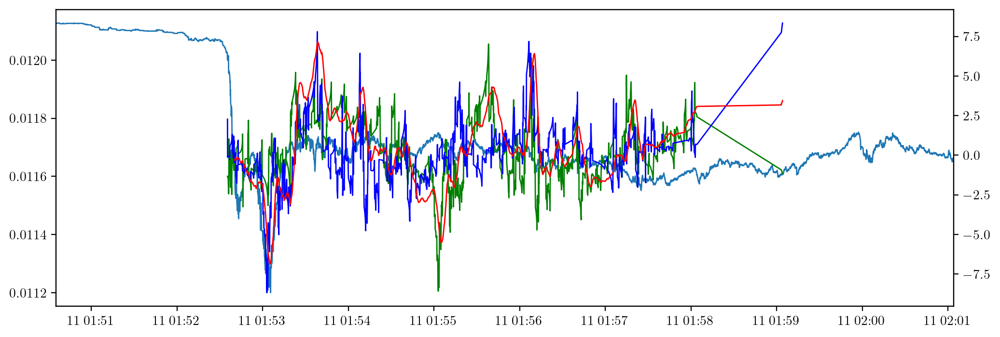

In [ ]:
weight_plot(1)

0.26625047683252745
0.26625047683252745


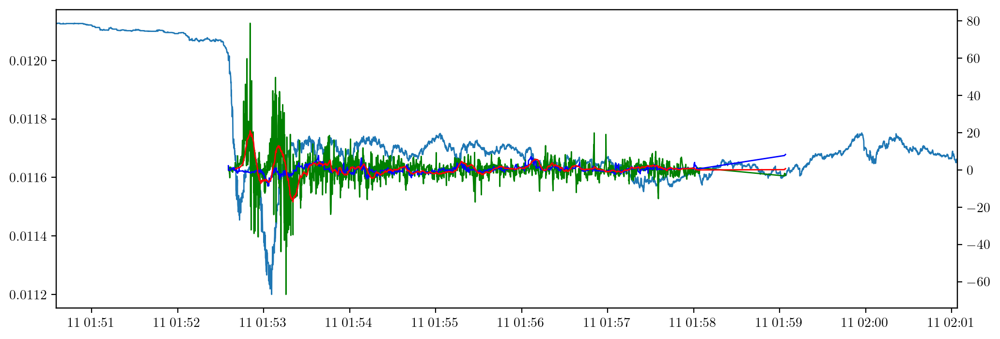

In [ ]:
weight_plot(1, t_len = 10)

0.26625047683252745
0.26625047683252745


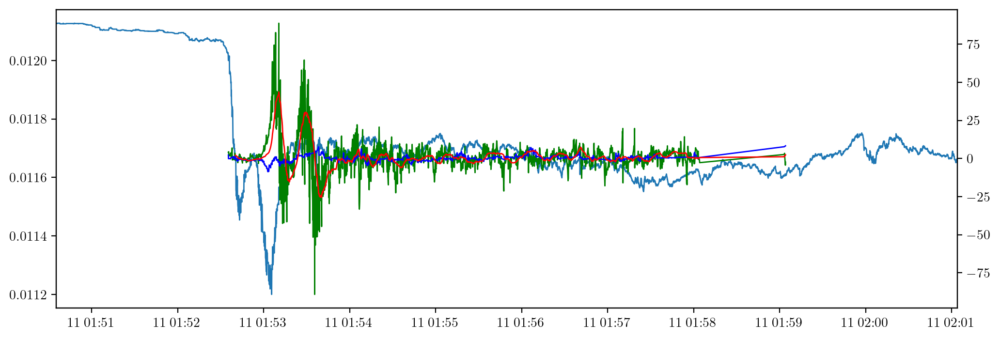

In [ ]:
weight_plot(1, t_len = 30)

0.26625047683252745
0.26625047683252745


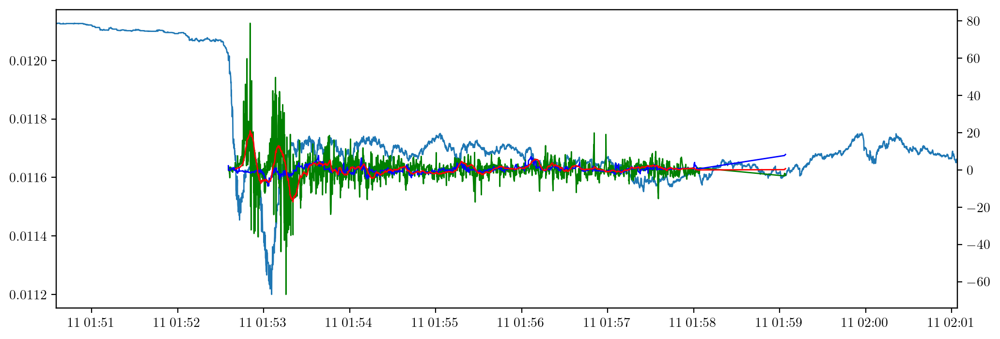

In [ ]:
weight_plot(1, t_len = 10)

0.26625047683252745
0.26625047683252745


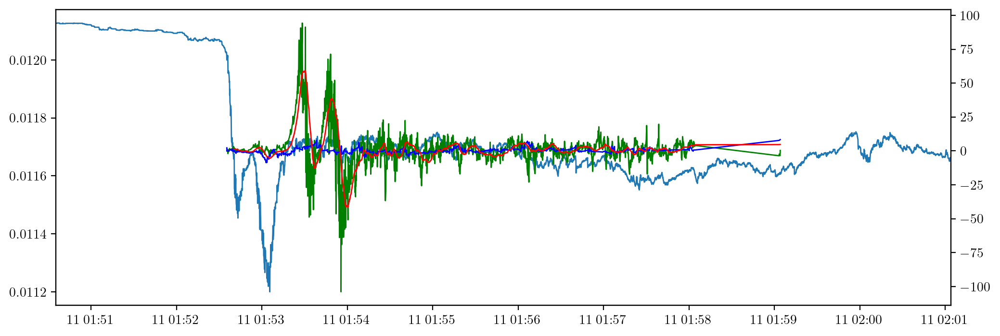

In [ ]:
weight_plot(1, t_len = 50)

0.26625047683252745
0.26625047683252745


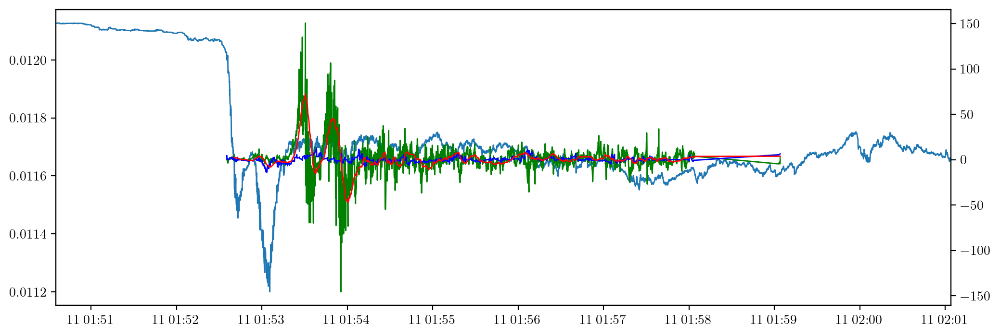

In [ ]:
weight_plot(1, t_len = 50, weight=50)

0.26625047683252745
0.26625047683252745


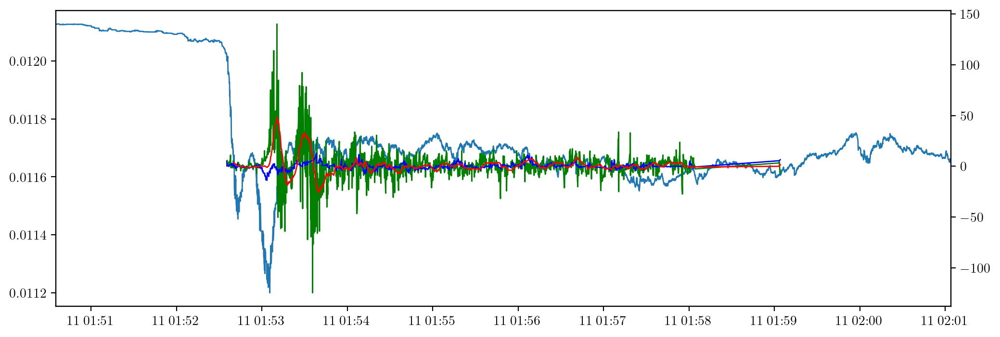

In [ ]:
weight_plot(1, t_len = 30, weight=50)

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def weight_plot(id, weight = 100, t_len = 600):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()
    short = fast_scoring(id, t_len, weight=weight)
    long = fast_scoring(id, 480, weight = weight)
    ax1.plot(short, c = 'g')
    ax1.plot(long, c='b')
    #ax1.axhline(-0.7, c = 'black')
    ax1.plot((short + long).rolling(15).mean(), c = 'r')

0.26625047683252745
0.26625047683252745


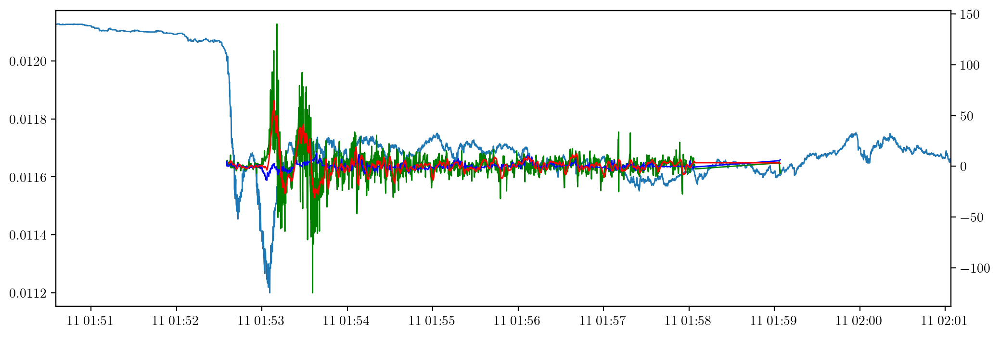

In [ ]:
weight_plot(1, t_len = 30, weight=50)

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def weight_plot(id, weight = 100, t_len = 600):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()
    short = fast_scoring(id, t_len, weight=weight)
    long = fast_scoring(id, 480, weight = weight)
    ax1.plot(short, c = 'g', alpha = 0.5)
    ax1.plot(long, c='b')
    #ax1.axhline(-0.7, c = 'black')
    ax1.plot((short + long).rolling(30).mean(), c = 'r')

0.26625047683252745
0.26625047683252745


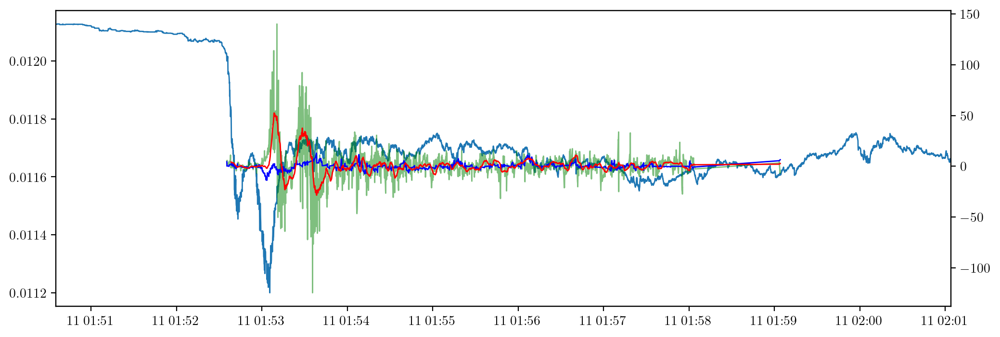

In [ ]:
weight_plot(1, t_len = 30, weight=50)

0.26625047683252745
0.26625047683252745


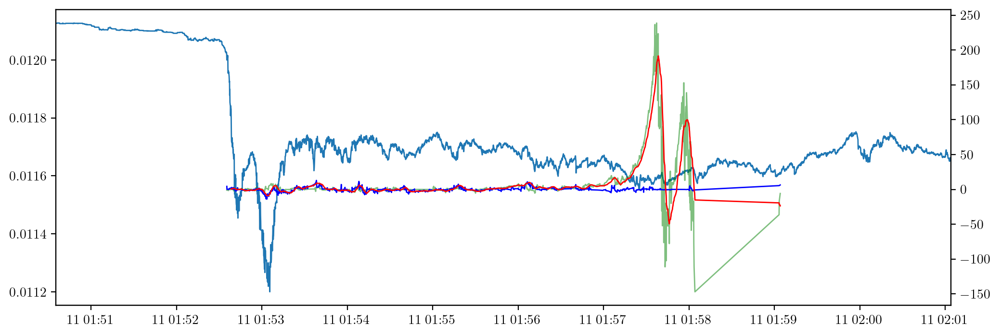

In [ ]:
weight_plot(1, t_len = 300, weight=50)

0.26625047683252745
0.26625047683252745


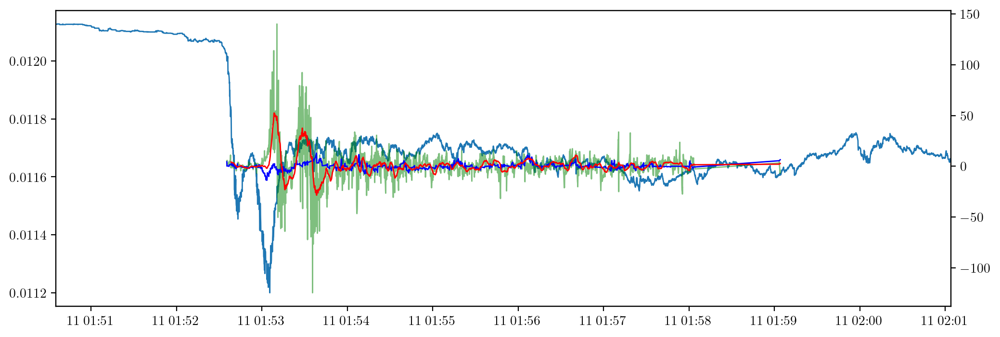

In [ ]:
weight_plot(1, t_len = 30, weight=50)

0.26625047683252745
0.26625047683252745


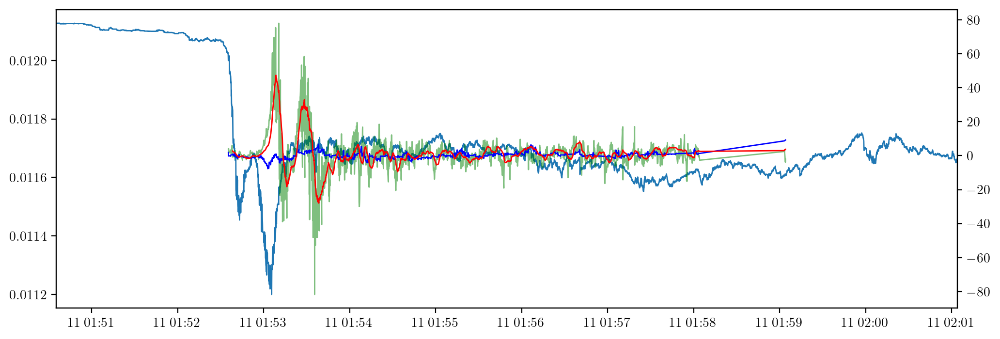

In [ ]:
weight_plot(1, t_len = 30, weight=120)

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def weight_plot(id, weight = 100, t_len = 600):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()
    short = fast_scoring(id, t_len, weight=weight)
    long = fast_scoring(id, 600, weight = 2* weight)
    ax1.plot(short, c = 'g', alpha = 0.5)
    ax1.plot(long, c='b')
    #ax1.axhline(-0.7, c = 'black')
    ax1.plot((short + long).rolling(30).mean(), c = 'r')

0.26625047683252745
0.26625047683252745


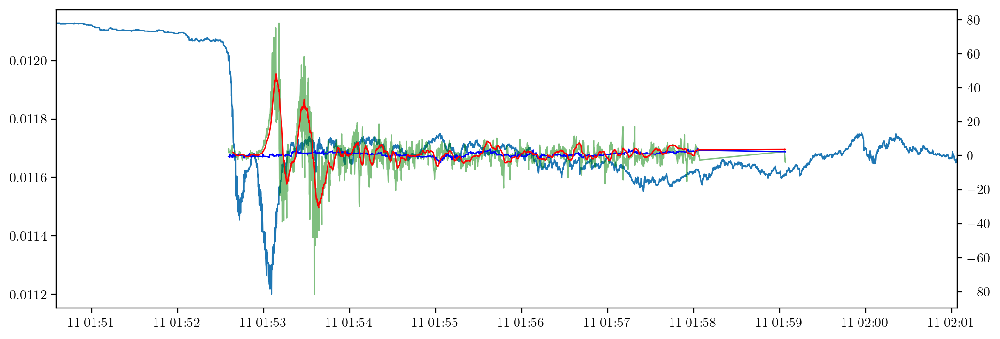

In [ ]:
weight_plot(1, t_len = 30, weight=120)

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def weight_plot(id, weight = 100, t_len = 600):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()
    short = fast_scoring(id, t_len, weight=weight)
    long = fast_scoring(id, 4800, weight = 2* weight)
    ax1.plot(short, c = 'g', alpha = 0.5)
    ax1.plot(long, c='b')
    #ax1.axhline(-0.7, c = 'black')
    ax1.plot((short + long).rolling(30).mean(), c = 'r')

0.26625047683252745


KeyError: Timestamp('2024-06-11 00:32:35.400000')

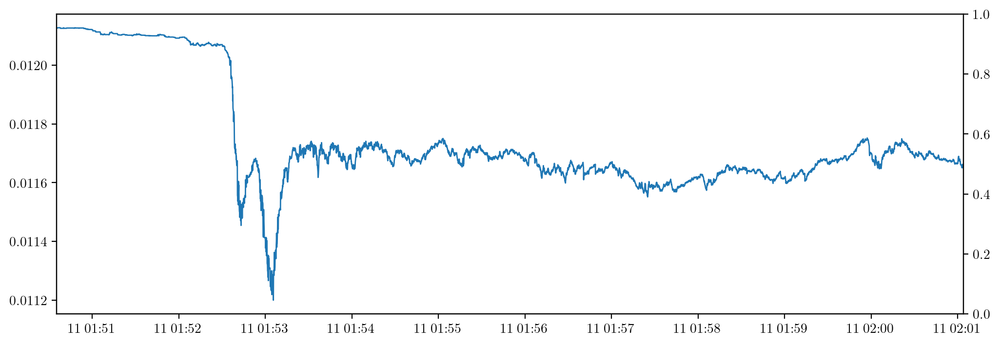

In [ ]:
weight_plot(1, t_len = 30, weight=120)

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def weight_plot(id, weight = 100, t_len = 600):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()
    short = fast_scoring(id, t_len, weight=weight)
    long = fast_scoring(id, 480, weight = 2* weight)
    ax1.plot(short, c = 'g', alpha = 0.5)
    ax1.plot(long, c='b')
    #ax1.axhline(-0.7, c = 'black')
    ax1.plot((short + long).rolling(30).mean(), c = 'r')

0.26625047683252745
0.26625047683252745


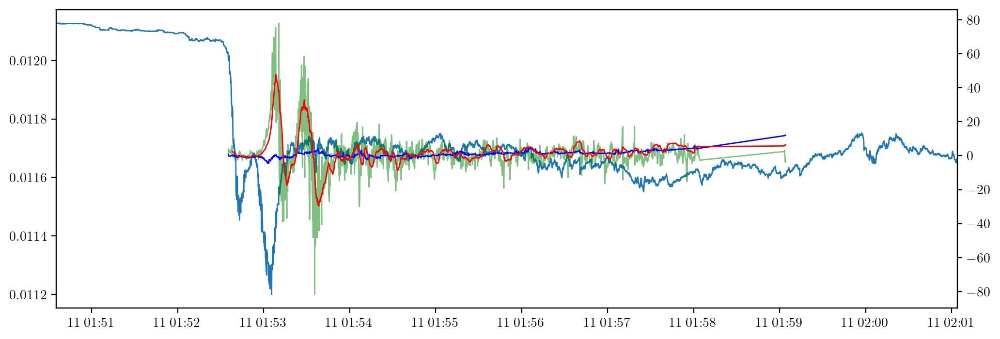

In [ ]:
weight_plot(1, t_len = 30, weight=120)

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def weight_plot(id, weight = 100, t_len = 600):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()
    #short = fast_scoring(id, t_len, weight=weight)
    long = fast_scoring(id, 480, weight = 2* weight)
    ax1.plot(short, c = 'g', alpha = 0.5)
    ax1.plot(long, c='b')
    #ax1.axhline(-0.7, c = 'black')
    ax1.plot((short + long).rolling(30).mean(), c = 'r')

0.26625047683252745


NameError: name 'short' is not defined

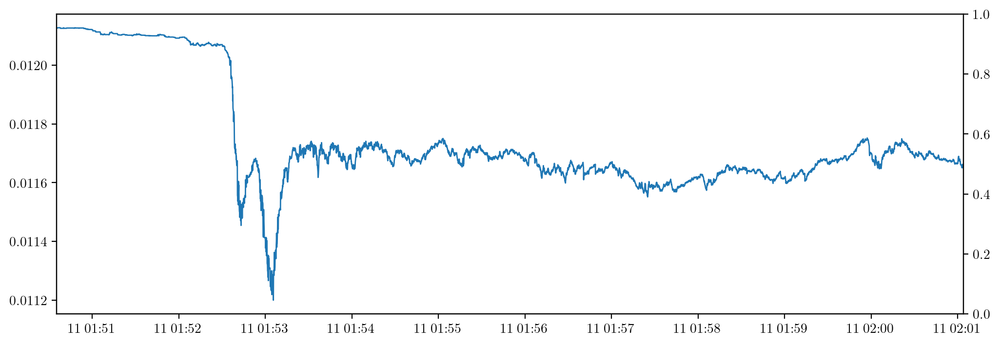

In [ ]:
weight_plot(1, t_len = 30, weight=120)

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def weight_plot(id, weight = 100, t_len = 600):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()
    short = fast_scoring(id, t_len, weight=weight)
    long = fast_scoring(id, 480, weight = 2* weight)
    #ax1.plot(short, c = 'g', alpha = 0.5)
    ax1.plot(long, c='b')
    #ax1.axhline(-0.7, c = 'black')
    ax1.plot((short + long).rolling(30).mean(), c = 'r')

0.26625047683252745
0.26625047683252745


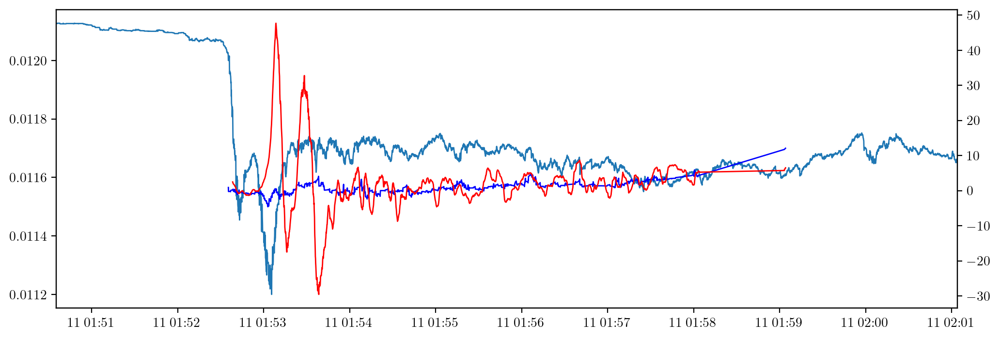

In [ ]:

weight_plot(1, t_len = 30, weight=120)

0.26625047683252745
0.26625047683252745


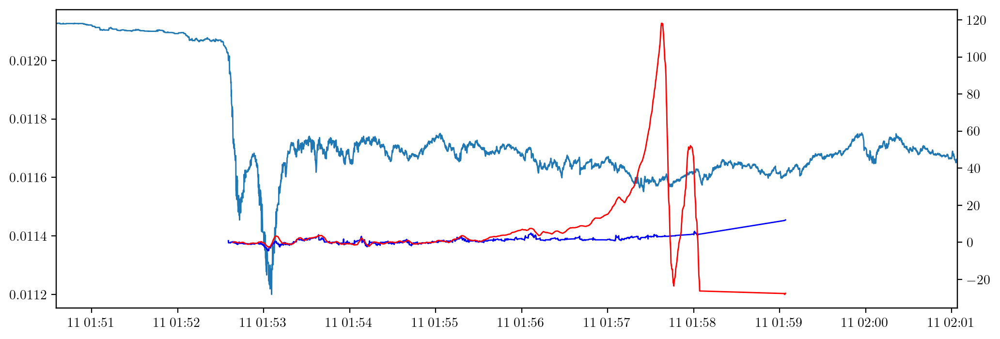

In [ ]:

weight_plot(1, t_len = 300, weight=120)

0.26625047683252745
0.26625047683252745


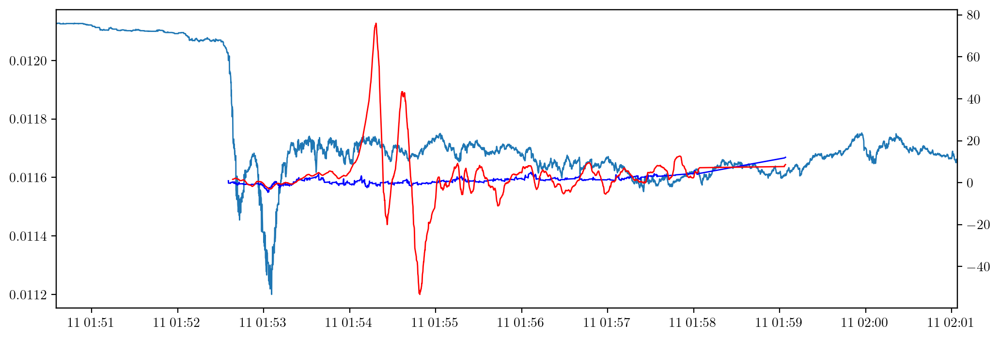

In [ ]:
weight_plot(1, t_len = 100, weight=120)

0.26625047683252745
0.26625047683252745


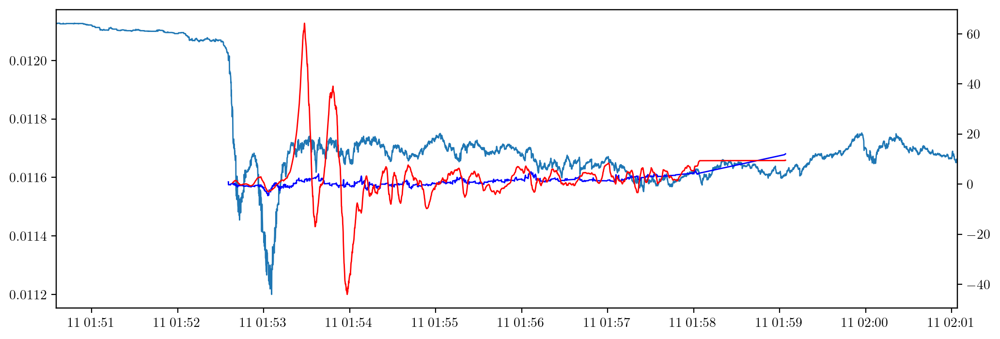

In [ ]:
weight_plot(1, t_len = 50, weight=120)

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def weight_plot(id, weight = 100, t_len = 600):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()
    short = fast_scoring(id, t_len, weight=weight)
    long = fast_scoring(id, 480, weight = 2* weight)
    ax1.plot(short, c = 'g', alpha = 0.5)
    ax1.plot(long, c='b')
    #ax1.axhline(-0.7, c = 'black')
    ax1.plot((short + long).rolling(30).mean(), c = 'r')

0.26625047683252745
0.26625047683252745


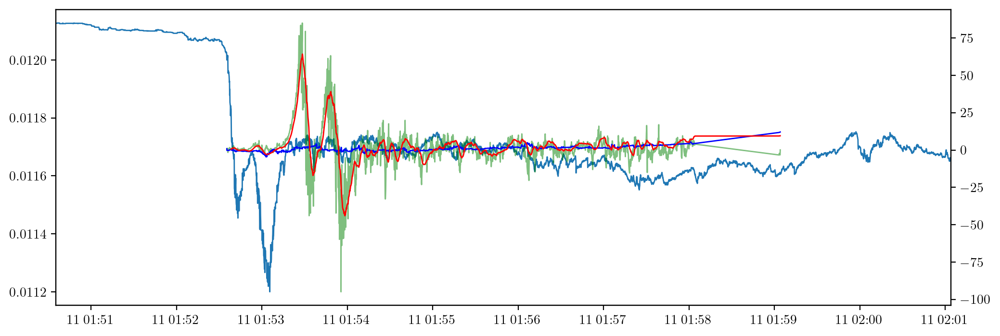

In [ ]:
weight_plot(1, t_len = 50, weight=120)

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def weight_plot(id, weight = 100, t_len = 600):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()
    short = fast_scoring(id, t_len, weight=weight)
    long = fast_scoring(id, 480, weight = 200)
    ax1.plot(short, c = 'g', alpha = 0.5)
    ax1.plot(long, c='b')
    #ax1.axhline(-0.7, c = 'black')
    ax1.plot((short + long).rolling(30).mean(), c = 'r')

0.26625047683252745
0.26625047683252745


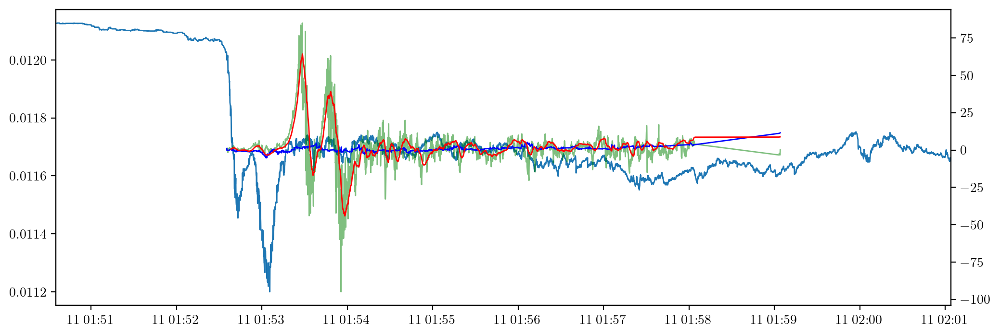

In [ ]:
weight_plot(1, t_len = 50, weight=120)

0.26625047683252745
0.26625047683252745


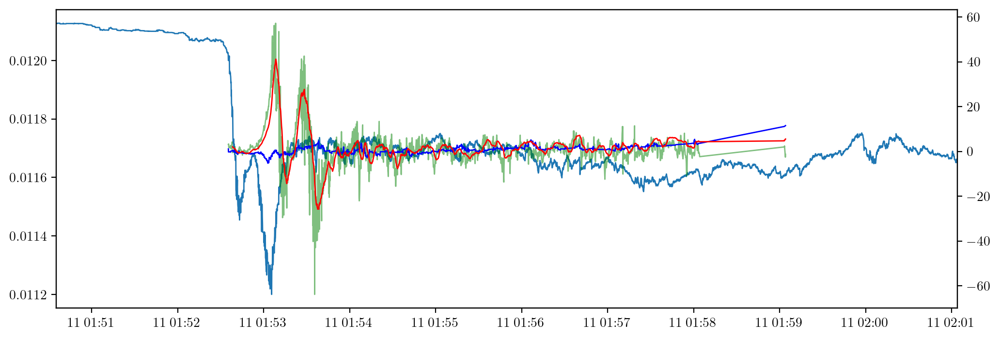

In [ ]:
weight_plot(1, t_len = 30, weight=200)

0.26625047683252745
0.26625047683252745


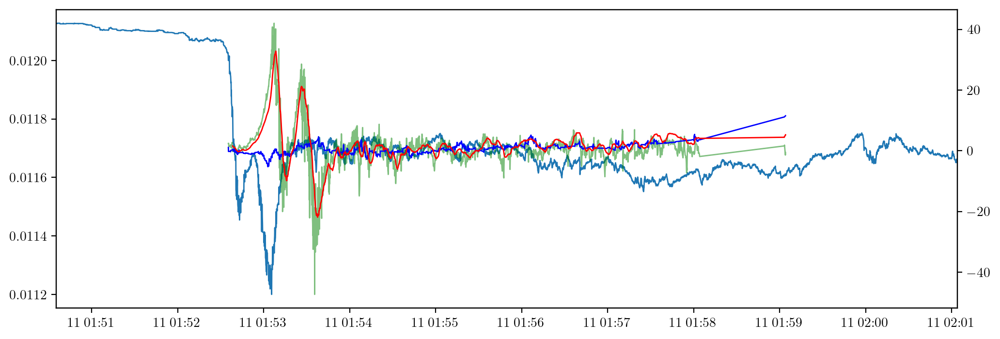

In [ ]:
weight_plot(1, t_len = 30, weight=400)

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def weight_plot(id, weight = 100, t_len = 600):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()
    short = fast_scoring(id, t_len, weight=weight)
    long = fast_scoring(id, 480, weight = 500)
    ax1.plot(short, c = 'g', alpha = 0.5)
    ax1.plot(long, c='b')
    #ax1.axhline(-0.7, c = 'black')
    ax1.plot((short + long).rolling(30).mean(), c = 'r')

0.26625047683252745
0.26625047683252745


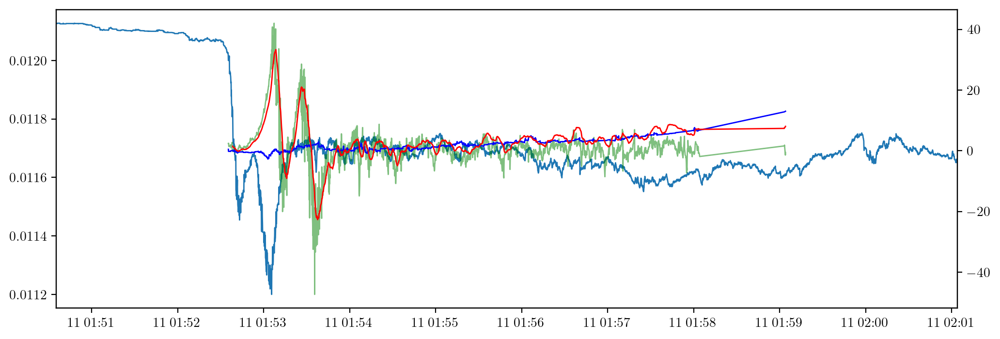

In [ ]:
weight_plot(1, t_len = 30, weight=400)

0.26625047683252745
0.26625047683252745


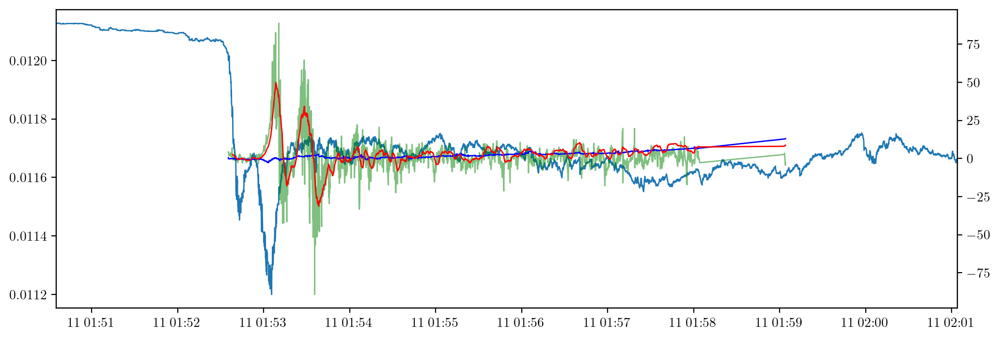

In [ ]:
weight_plot(1, t_len = 30, weight=100)

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def weight_plot(id, weight = 100, t_len = 600):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()
    short = fast_scoring(id, t_len, weight=weight)
    long = fast_scoring(id, 480, weight = 500)
    ax1.plot(short, c = 'g', alpha = 0.5)
    ax1.plot(long, c='b')
    ax1.axhline(0, c = 'black')
    ax1.plot((short + long).rolling(30).mean(), c = 'r')

0.26625047683252745
0.26625047683252745


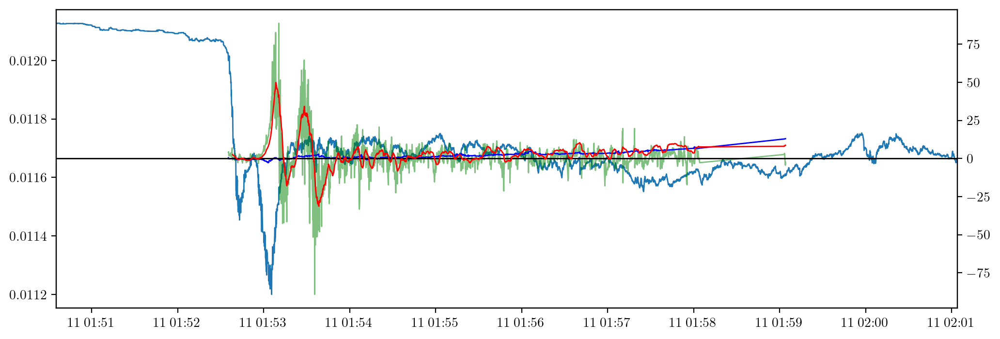

In [ ]:
weight_plot(1, t_len = 30, weight=100)

0.26625047683252745
0.26625047683252745


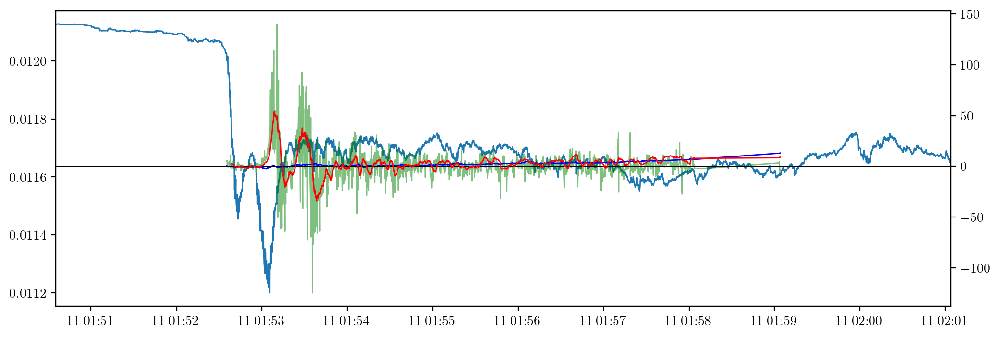

In [ ]:
weight_plot(1, t_len = 30, weight=50)

0.26625047683252745
0.26625047683252745


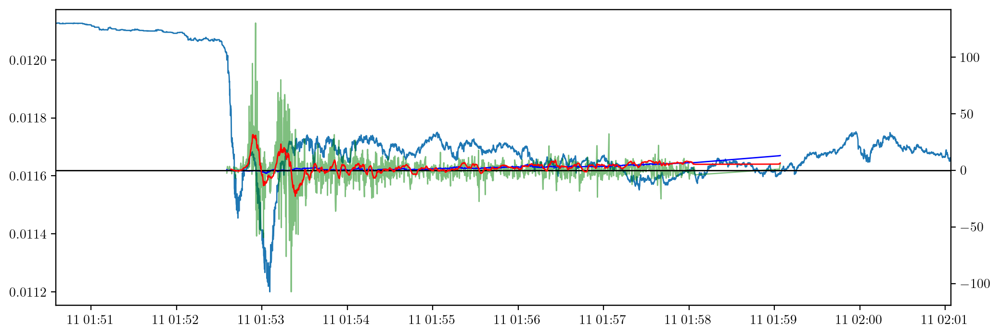

In [ ]:
weight_plot(1, t_len = 15, weight=50)

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def weight_plot(id, weight = 100, t_len = 600):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()
    short = fast_scoring(id, t_len, weight=weight)
    long = fast_scoring(id, 480, weight = 10000)
    ax1.plot(short, c = 'g', alpha = 0.5)
    ax1.plot(long, c='b')
    ax1.axhline(0, c = 'black')
    ax1.plot((short + long).rolling(30).mean(), c = 'r')

0.26625047683252745
0.26625047683252745


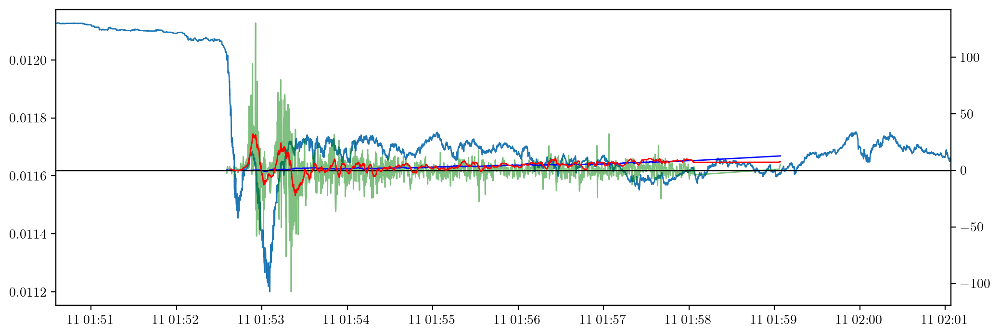

In [ ]:
weight_plot(1, t_len = 15, weight=50)

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def weight_plot(id, weight = 100, t_len = 600):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()
    short = fast_scoring(id, t_len, weight=weight)
    long = fast_scoring(id, 1, weight = 10000)
    ax1.plot(short, c = 'g', alpha = 0.5)
    ax1.plot(long, c='b')
    ax1.axhline(0, c = 'black')
    ax1.plot((short + long).rolling(30).mean(), c = 'r')

0.26625047683252745
0.26625047683252745


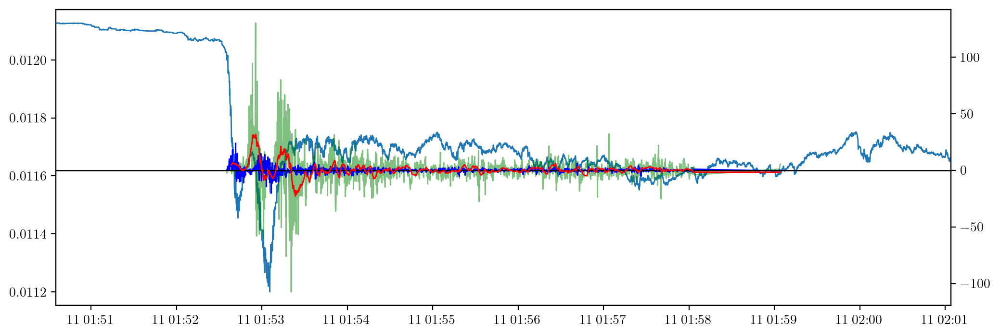

In [ ]:
weight_plot(1, t_len = 15, weight=50)

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def weight_plot(id, weight = 100, t_len = 600):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()
    short = fast_scoring(id, t_len, weight=weight)
    long = fast_scoring(id, t_len, weight = 10000)
    ax1.plot(short, c = 'g', alpha = 0.5)
    ax1.plot(long, c='b')
    ax1.axhline(0, c = 'black')
    ax1.plot((short + long).rolling(30).mean(), c = 'r')

0.26625047683252745
0.26625047683252745


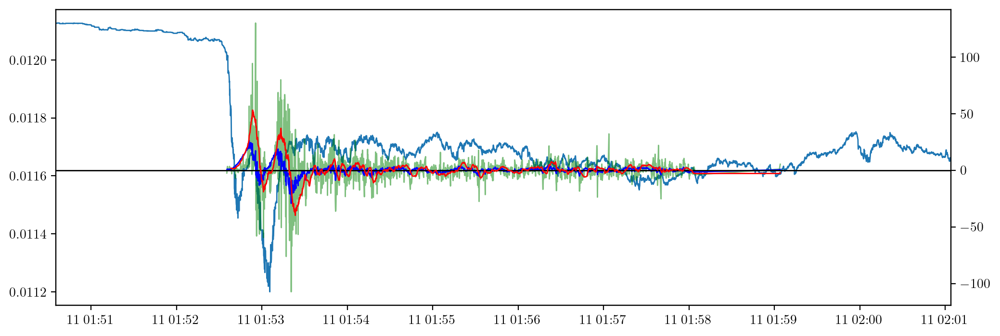

In [ ]:
weight_plot(1, t_len = 15, weight=50)

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def weight_plot(id, weight = 100, t_len = 600):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()
    short = fast_scoring(id, t_len, weight=weight)
    long = fast_scoring(id, t_len, weight = 2000)
    ax1.plot(short, c = 'g', alpha = 0.5)
    ax1.plot(long, c='b')
    ax1.axhline(0, c = 'black')
    ax1.plot((short + long).rolling(30).mean(), c = 'r')

0.26625047683252745
0.26625047683252745


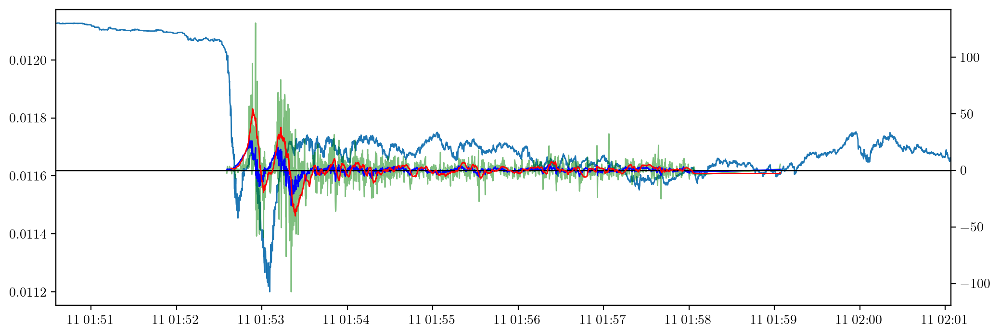

In [ ]:
weight_plot(1, t_len = 15, weight=50)

0.26625047683252745
0.26625047683252745


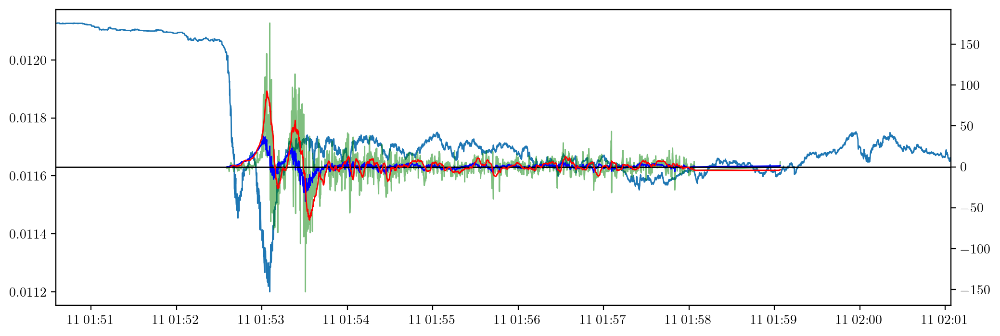

In [ ]:
weight_plot(1, t_len = 25, weight=50)

0.26625047683252745
0.26625047683252745


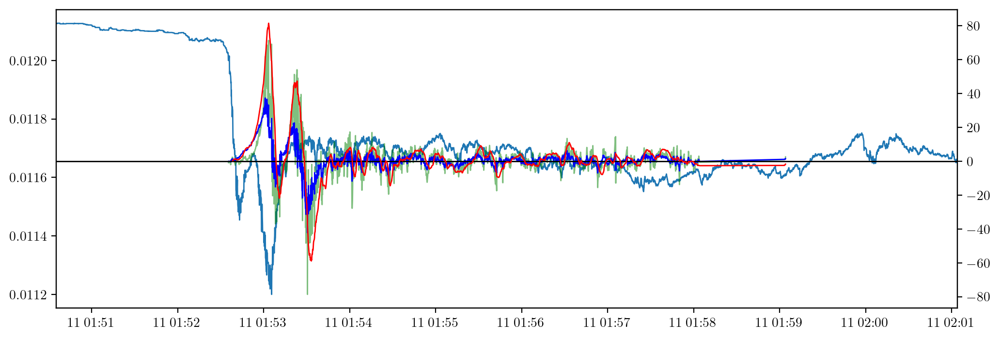

In [ ]:
weight_plot(1, t_len = 25, weight=200)

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def weight_plot(id, weight = 100, t_len = 600):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()
    short = fast_scoring(id, t_len, weight=weight)
    long = fast_scoring(id, 10, weight = 2000)
    ax1.plot(short, c = 'g', alpha = 0.5)
    ax1.plot(long, c='b')
    ax1.axhline(0, c = 'black')
    ax1.plot((short + long).rolling(30).mean(), c = 'r')

0.26625047683252745
0.26625047683252745


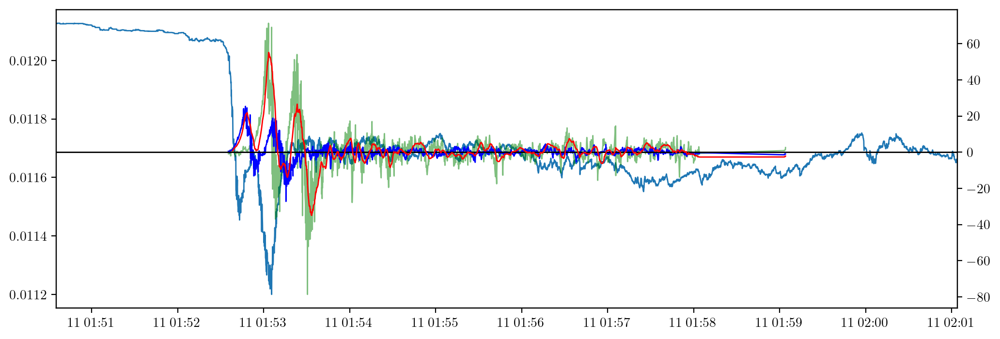

In [ ]:
weight_plot(1, t_len = 25, weight=200)

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def weight_plot(id, weight = 100, t_len = 600):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()
    short = fast_scoring(id, t_len, weight=weight)
    long = fast_scoring(id, 10000, weight = 2000)
    ax1.plot(short, c = 'g', alpha = 0.5)
    ax1.plot(long, c='b')
    ax1.axhline(0, c = 'black')
    ax1.plot((short + long).rolling(30).mean(), c = 'r')

0.26625047683252745


KeyError: Timestamp('2024-06-10 23:05:55.400000')

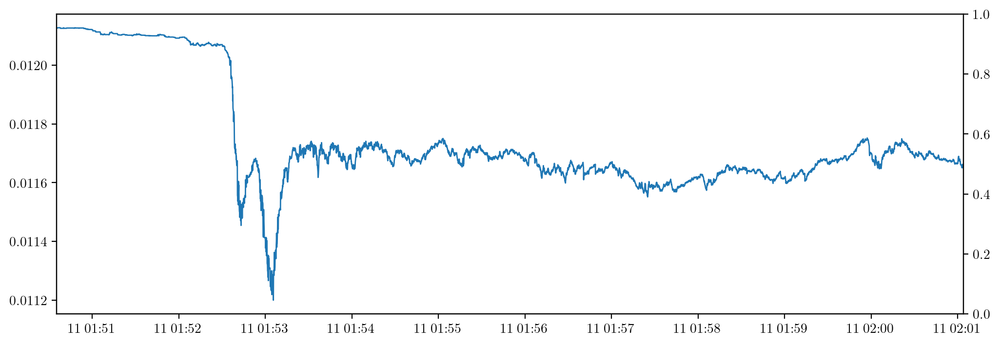

In [ ]:
weight_plot(1, t_len = 25, weight=200)

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def weight_plot(id, weight = 100, t_len = 600):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()
    short = fast_scoring(id, t_len, weight=weight)
    long = fast_scoring(id, 1000, weight = 2000)
    ax1.plot(short, c = 'g', alpha = 0.5)
    ax1.plot(long, c='b')
    ax1.axhline(0, c = 'black')
    ax1.plot((short + long).rolling(30).mean(), c = 'r')

0.26625047683252745
0.26625047683252745


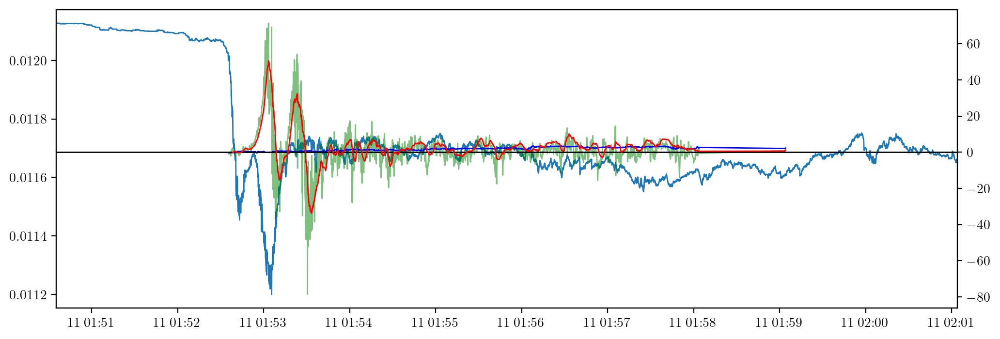

In [ ]:
weight_plot(1, t_len = 25, weight=200)

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def weight_plot(id, weight = 100, t_len = 600):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()
    short = fast_scoring(id, t_len, weight=weight)
    long = fast_scoring(id, 1000, weight = 2000)
    ax1.plot(short, c = 'g', alpha = 0.5)
    ax1.plot(100*long, c='b')
    ax1.axhline(0, c = 'black')
    ax1.plot((short + long).rolling(30).mean(), c = 'r')

0.26625047683252745
0.26625047683252745


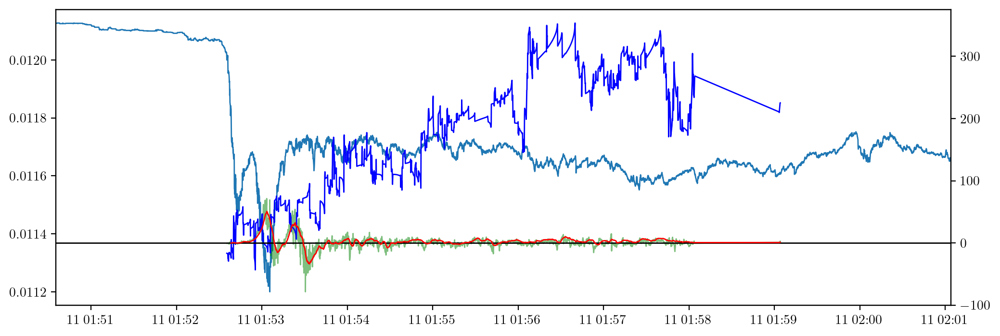

In [ ]:
weight_plot(1, t_len = 25, weight=200)

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def weight_plot(id, weight = 100, t_len = 600):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()
    short = fast_scoring(id, t_len, weight=weight)
    long = fast_scoring(id, 400, weight = 2000)
    ax1.plot(short, c = 'g', alpha = 0.5)
    ax1.plot(100*long, c='b')
    ax1.axhline(0, c = 'black')
    ax1.plot((short + long).rolling(30).mean(), c = 'r')

0.26625047683252745
0.26625047683252745


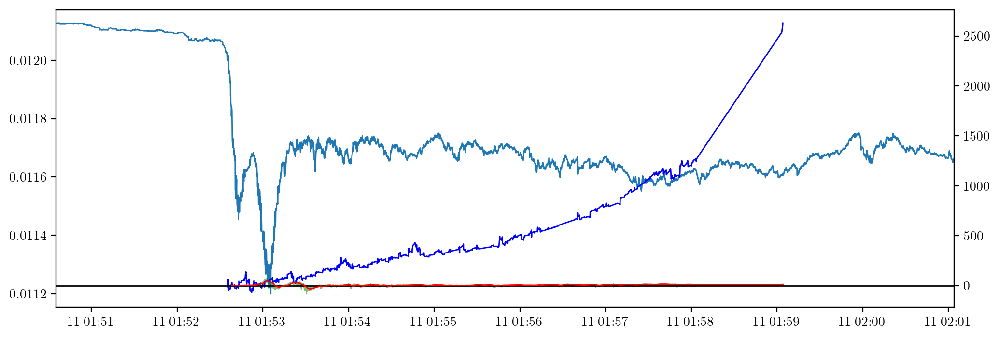

In [ ]:
weight_plot(1, t_len = 25, weight=200)

In [ ]:
score(1, show_all=True)

,score,mean volume,volatility,short mom,long mom,short unweighted mom,long unweighted mom
timestamp,,,,,,,
2024-06-11 01:52:35.400,-610.19343,"208,390.25600",0.00030,"-1,036.60213",-214.61675,-59.34077,-19.46257
2024-06-11 01:52:35.500,-384.04783,"208,390.25600",0.00030,-649.83051,-137.39794,-55.72376,-18.73972
2024-06-11 01:52:35.600,-192.29594,"208,390.25600",0.00030,-322.31182,-71.22191,-42.24767,-15.40753
2024-06-11 01:52:35.700,-166.63000,"208,390.25600",0.00030,-277.99159,-62.35100,-42.27813,-15.43778
2024-06-11 01:52:35.800,-208.19173,"208,390.25600",0.00030,-348.90151,-76.84858,-47.01384,-16.67442
...,...,...,...,...,...,...,...
2024-06-11 01:58:04.200,-347.59621,"208,390.25600",0.00030,-363.27308,-130.28373,-285.39402,-257.49437
2024-06-11 01:59:03.300,-287.98461,"208,390.25600",0.00030,-250.69258,-104.25639,-236.29799,-245.35369
2024-06-11 01:59:03.400,-286.93327,"208,390.25600",0.00030,-249.56061,-104.02555,-234.46393,-244.97126


In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def weight_plot(id, weight = 100, t_len = 600):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()
    scores = score(id, show_all=True)
    short = scores['short unweighted mom']
    long = scores['long unweighted mom']
    #short = fast_scoring(id, t_len, weight=weight)
    #long = fast_scoring(id, 400, weight = 2000)
    ax1.plot(short, c = 'g', alpha = 0.5)
    ax1.plot(100*long, c='b')
    ax1.axhline(0, c = 'black')
    ax1.plot((short + long).rolling(30).mean(), c = 'r')

In [ ]:
score(1, show_all=True)

,score,mean volume,volatility,short mom,long mom,short unweighted mom,long unweighted mom
timestamp,,,,,,,
2024-06-11 01:52:35.400,-610.19343,"208,390.25600",0.00030,"-1,036.60213",-214.61675,-59.34077,-19.46257
2024-06-11 01:52:35.500,-384.04783,"208,390.25600",0.00030,-649.83051,-137.39794,-55.72376,-18.73972
2024-06-11 01:52:35.600,-192.29594,"208,390.25600",0.00030,-322.31182,-71.22191,-42.24767,-15.40753
2024-06-11 01:52:35.700,-166.63000,"208,390.25600",0.00030,-277.99159,-62.35100,-42.27813,-15.43778
2024-06-11 01:52:35.800,-208.19173,"208,390.25600",0.00030,-348.90151,-76.84858,-47.01384,-16.67442
...,...,...,...,...,...,...,...
2024-06-11 01:58:04.200,-347.59621,"208,390.25600",0.00030,-363.27308,-130.28373,-285.39402,-257.49437
2024-06-11 01:59:03.300,-287.98461,"208,390.25600",0.00030,-250.69258,-104.25639,-236.29799,-245.35369
2024-06-11 01:59:03.400,-286.93327,"208,390.25600",0.00030,-249.56061,-104.02555,-234.46393,-244.97126


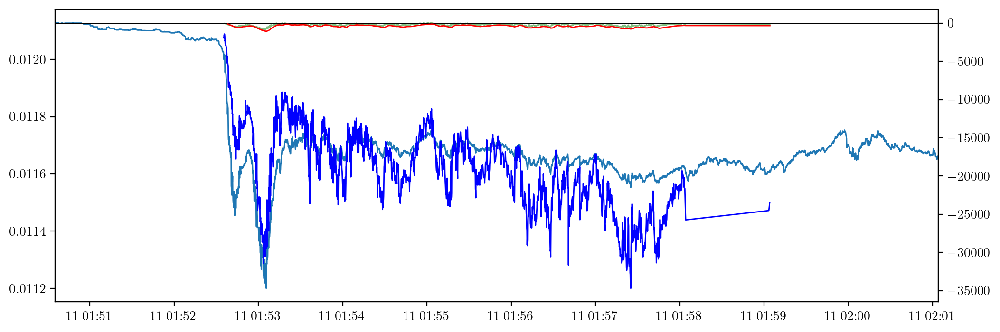

In [ ]:
weight_plot(1, t_len = 25, weight=200)

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def weight_plot(id, weight = 100, t_len = 600):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()
    scores = score(id, show_all=True)
    short = scores['short unweighted mom']
    long = scores['long unweighted mom']
    #short = fast_scoring(id, t_len, weight=weight)
    #long = fast_scoring(id, 400, weight = 2000)
    ax1.plot(short, c = 'g', alpha = 0.5)
    ax1.plot(long, c='b')
    ax1.axhline(0, c = 'black')
    ax1.plot((short + long).rolling(30).mean(), c = 'r')

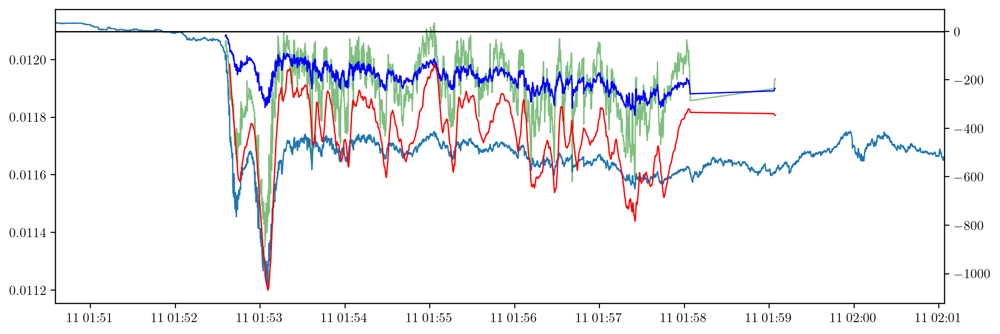

In [ ]:
weight_plot(1, t_len = 25, weight=200)

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def weight_plot(id, weight = 100, t_len = 600):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()
    scores = score(id, show_all=True)
    
    vol = scores['volatility'][0] * 10**4
    short = scores['short unweighted mom']/vol
    long = scores['long unweighted mom']/vol
    #short = fast_scoring(id, t_len, weight=weight)
    #long = fast_scoring(id, 400, weight = 2000)
    ax1.plot(short, c = 'g', alpha = 0.5)
    ax1.plot(long, c='b')
    ax1.axhline(0, c = 'black')
    ax1.plot((short + long).rolling(30).mean(), c = 'r')

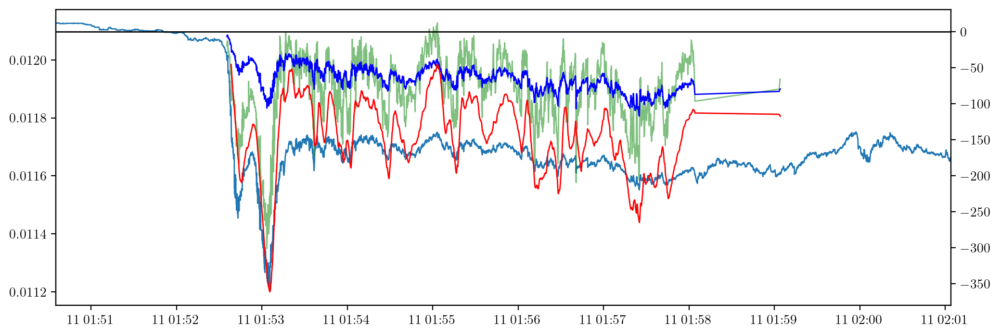

In [ ]:
weight_plot(1, t_len = 25, weight=200)

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def weight_plot(id, weight = 100, t_len = 600):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()
    scores = score(id, show_all=True)
    
    vol = scores['volatility'][0] * 10**4
    print(vol)

    short = scores['short unweighted mom']/vol
    long = scores['long unweighted mom']/vol
    #short = fast_scoring(id, t_len, weight=weight)
    #long = fast_scoring(id, 400, weight = 2000)
    ax1.plot(short, c = 'g', alpha = 0.5)
    ax1.plot(long, c='b')
    ax1.axhline(0, c = 'black')
    ax1.plot((short + long).rolling(30).mean(), c = 'r')

2.9556241779777586


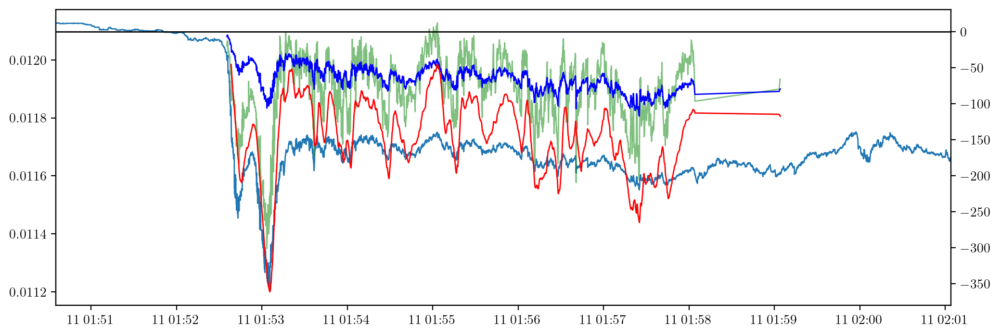

In [ ]:

weight_plot(1, t_len = 25, weight=200)

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def weight_plot(id, weight = 100, t_len = 600):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()
    scores = score(id, show_all=True)
    
    vol = scores['volatility'][0] * 10**4
    print(vol)

    short = scores['short unweighted mom']/vol
    long = scores['long unweighted mom']/vol
    #short = fast_scoring(id, t_len, weight=weight)
    #long = fast_scoring(id, 400, weight = 2000)
    ax1.plot(short, c = 'g', alpha = 0.5)
    ax1.plot(long, c='b')
    ax1.axhline(0, c = 'black')
    ax1.plot((0.2 * short + long).rolling(30).mean(), c = 'r')

2.9556241779777586


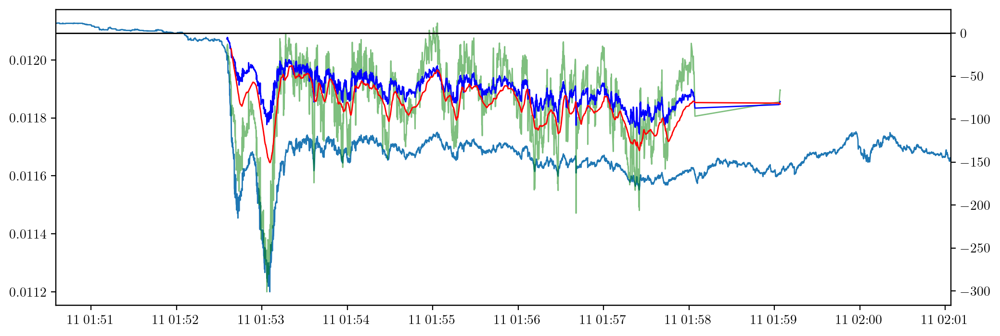

In [ ]:

weight_plot(1, t_len = 25, weight=200)

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def weight_plot(id, weight = 100, t_len = 600):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()
    scores = score(id, show_all=True)
    
    vol = scores['volatility'][0] * 10**4
    print(vol)

    #short = scores['short unweighted mom']/vol
    long = scores['long unweighted mom']/vol
    short = fast_scoring(id, t_len, weight=weight)
    #long = fast_scoring(id, 400, weight = 2000)
    ax1.plot(short, c = 'g', alpha = 0.5)
    ax1.plot(long, c='b')
    ax1.axhline(0, c = 'black')
    ax1.plot((0.2 * short + long).rolling(30).mean(), c = 'r')

2.9556241779777586
0.26625047683252745


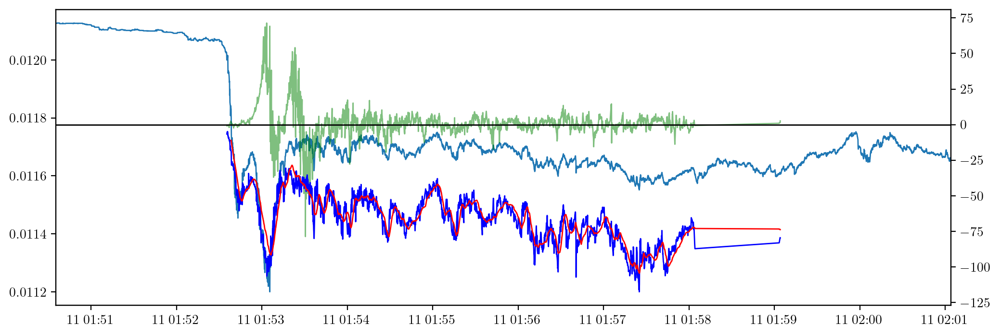

In [ ]:

weight_plot(1, t_len = 25, weight=200)

2.9556241779777586
0.26625047683252745


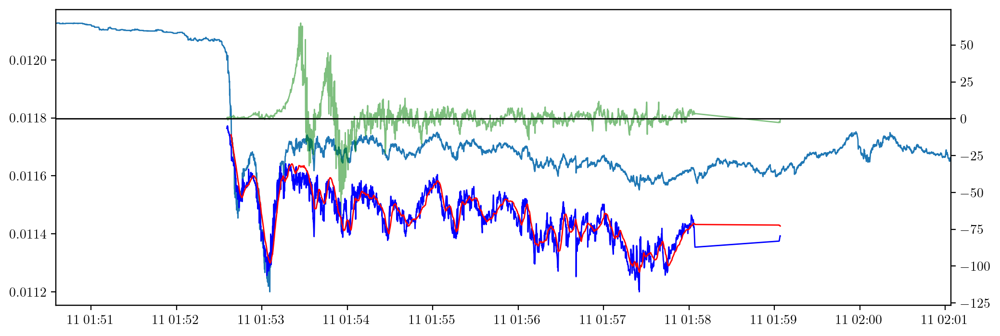

In [ ]:

weight_plot(1, t_len = 50, weight=200)

2.9556241779777586
0.26625047683252745


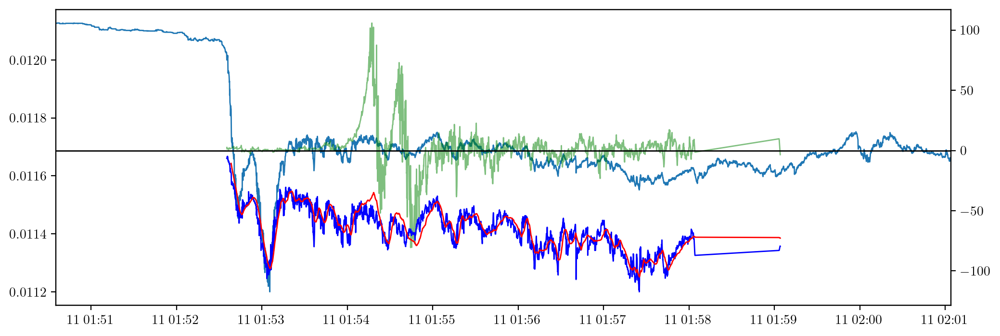

In [ ]:

weight_plot(1, t_len = 100, weight=100)

2.9556241779777586
0.26625047683252745


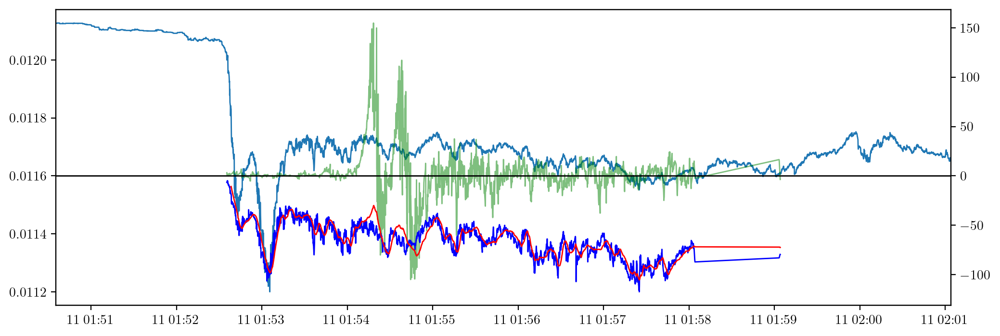

In [ ]:

weight_plot(1, t_len = 100, weight=50)

2.9556241779777586
0.26625047683252745


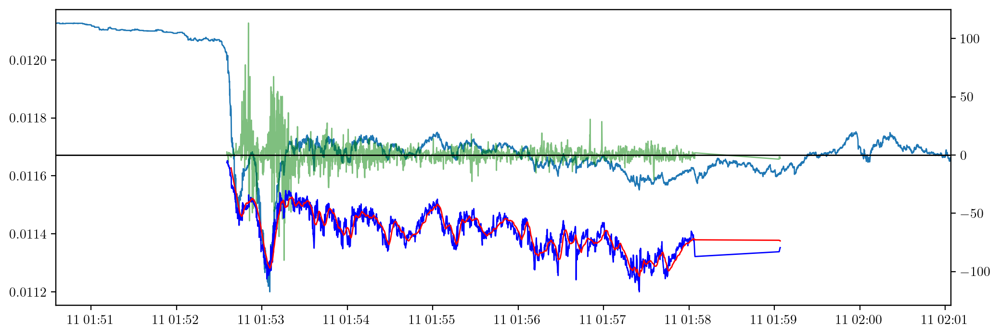

In [ ]:

weight_plot(1, t_len = 10, weight=50)

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def weight_plot(id, weight = 100, t_len = 600):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()
    scores = score(id, show_all=True)
    
    vol = scores['volatility'][0] * 10**4
    print(vol)

    #short = scores['short unweighted mom']/vol
    long = scores['long unweighted mom']/vol
    short = fast_scoring(id, t_len, weight=weight)
    #long = fast_scoring(id, 400, weight = 2000)
    ax1.plot(short, c = 'g', alpha = 0.5)
    ax1.plot(long, c='b')
    ax1.axhline(0, c = 'black')
    ax1.plot(0.5 * (short + long).rolling(30).mean(), c = 'r')

2.9556241779777586
0.26625047683252745


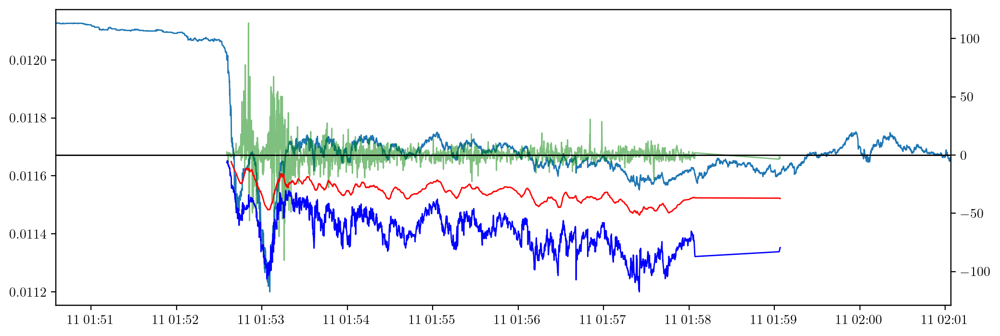

In [ ]:

weight_plot(1, t_len = 10, weight=50)

0.9474763745901881
0.24852930887941063


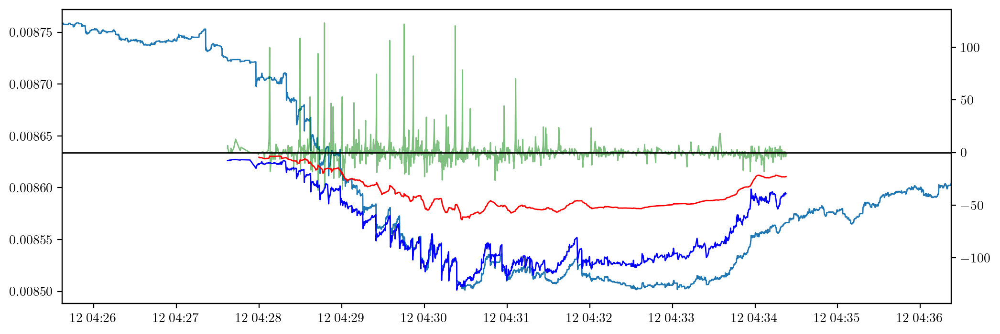

In [ ]:
weight_plot(137, t_len = 10, weight=50)

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def weight_plot(id, weight = 100, t_len = 600):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()
    scores = score(id, show_all=True)
    
    vol = scores['volatility'][0] * 10**4
    print(vol)

    #short = scores['short unweighted mom']/vol
    long = scores['long unweighted mom']/vol
    short = fast_scoring(id, t_len, weight=weight)
    #long = fast_scoring(id, 400, weight = 2000)
    ax1.plot(short.rolling(50).mean(), c = 'g', alpha = 0.5)
    ax1.plot(long, c='b')
    ax1.axhline(0, c = 'black')
    ax1.plot(0.5 * (short + long).rolling(30).mean(), c = 'r')

0.9474763745901881
0.24852930887941063


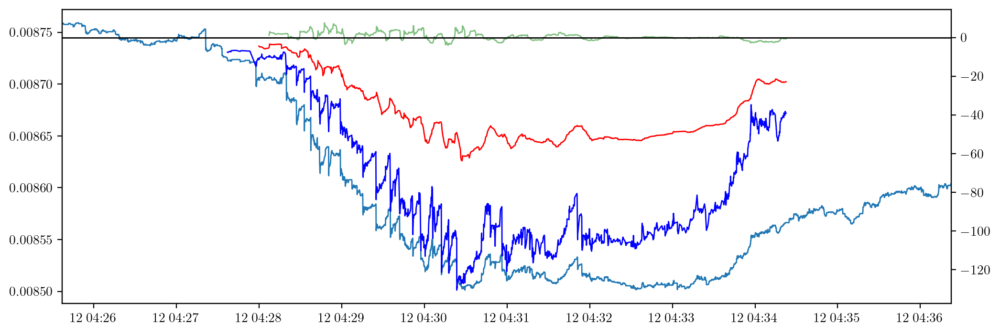

In [ ]:
weight_plot(137, t_len = 10, weight=50)

0.9474763745901881
0.24852930887941063


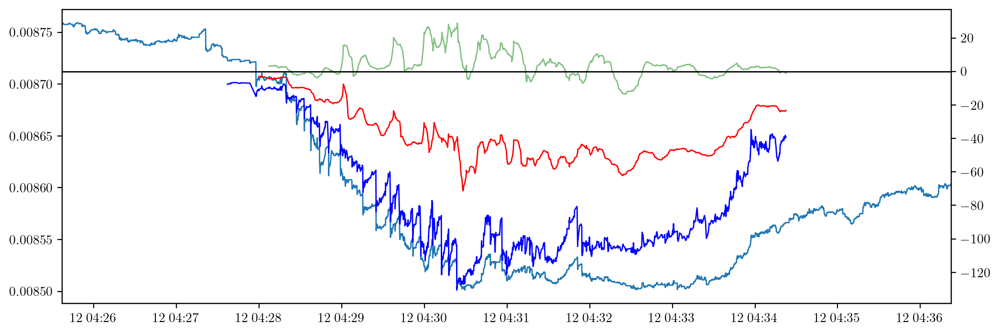

In [ ]:
weight_plot(137, t_len = 100, weight=50)

0.9474763745901881
0.24852930887941063


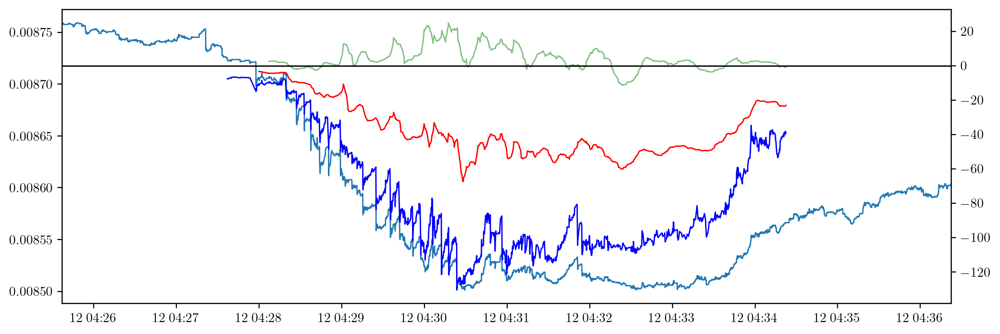

In [ ]:
weight_plot(137, t_len = 100, weight=100)

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def weight_plot(id, weight = 100, t_len = 600):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()
    scores = score(id, show_all=True)
    
    vol = scores['volatility'][0] * 10**4
    print(vol)

    #short = scores['short unweighted mom']/vol
    long = scores['long unweighted mom']/vol
    short = fast_scoring(id, t_len, weight=weight)
    #long = fast_scoring(id, 400, weight = 2000)
    ax1.plot(short.rolling(50).mean(), c = 'g', alpha = 0.5)
    ax1.plot(long, c='b')
    ax1.axhline(0, c = 'black')
    ax1.plot(0.5 * (2*short.rolling(50).mean() + long).rolling(30).mean(), c = 'r')

0.9474763745901881
0.24852930887941063


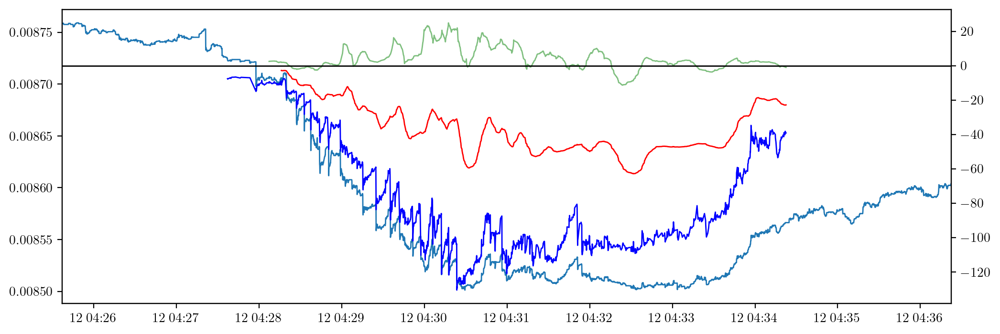

In [ ]:
weight_plot(137, t_len = 100, weight=100)

1.479621260902882
0.6278062239740367


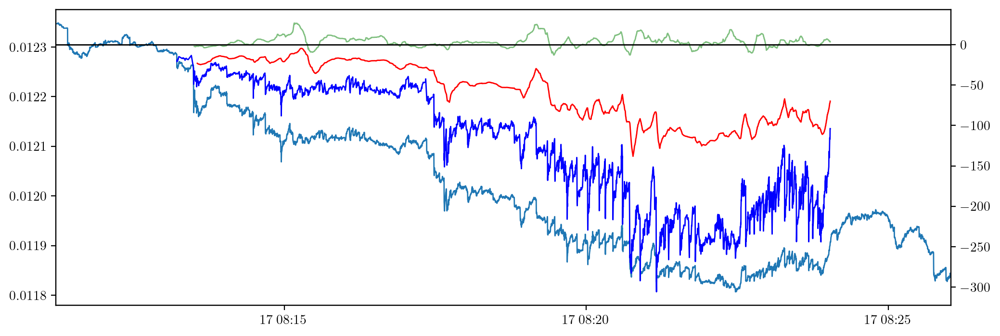

In [ ]:
weight_plot(161, t_len = 100, weight=100)

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def weight_plot(id, weight = 100, t_len = 600):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()
    scores = score(id, show_all=True)
    
    vol = scores['volatility'][0] * 10**4
    print(vol)

    #short = scores['short unweighted mom']/vol
    long = scores['long unweighted mom']/vol
    short = fast_scoring(id, t_len, weight=weight)
    #long = fast_scoring(id, 400, weight = 2000)
    ax1.plot(short.rolling(50).mean(), c = 'g', alpha = 0.5)
    ax1.plot(long, c='b')
    ax1.axhline(0, c = 'black')
    ax1.plot(0.5 * (4*short.rolling(50).mean() + long).rolling(30).mean(), c = 'r')

1.479621260902882
0.6278062239740367


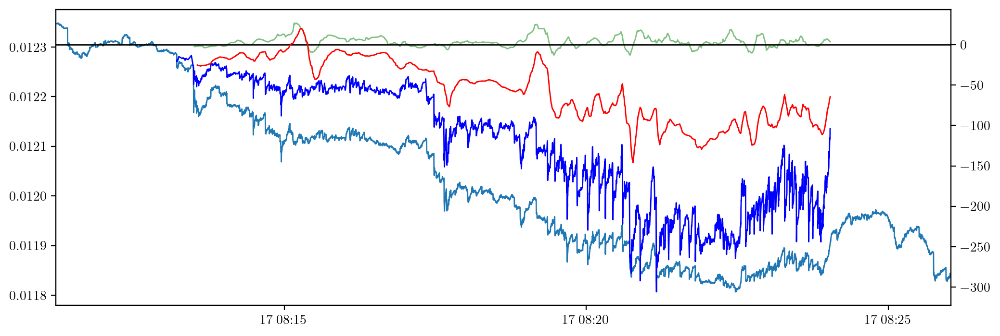

In [ ]:
weight_plot(161, t_len = 100, weight=100)

2.002171159344175
1.8509913617883917


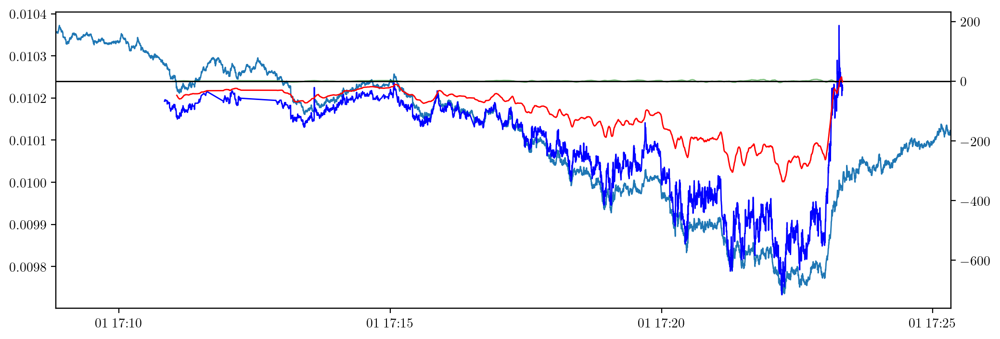

In [ ]:
weight_plot(497, t_len = 100, weight=100)

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def weight_plot(id, weight = 100, t_len = 600):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()
    scores = score(id, show_all=True)
    
    vol = scores['volatility'][0] * 10**4
    print(vol)

    #short = scores['short unweighted mom']/vol
    long = scores['long unweighted mom']/vol
    short = fast_scoring(id, t_len, weight=weight)
    #long = fast_scoring(id, 400, weight = 2000)
    ax1.plot(short.rolling(50).mean(), c = 'g', alpha = 0.5)
    ax1.plot(scores['score'], c = 'orange', alpha = '0.3')
    ax1.plot(long, c='b')
    ax1.axhline(0, c = 'black')
    ax1.plot(0.5 * (4*short.rolling(50).mean() + long).rolling(30).mean(), c = 'r')

2.002171159344175
1.8509913617883917


TypeError: alpha must be numeric or None, not <class 'str'>

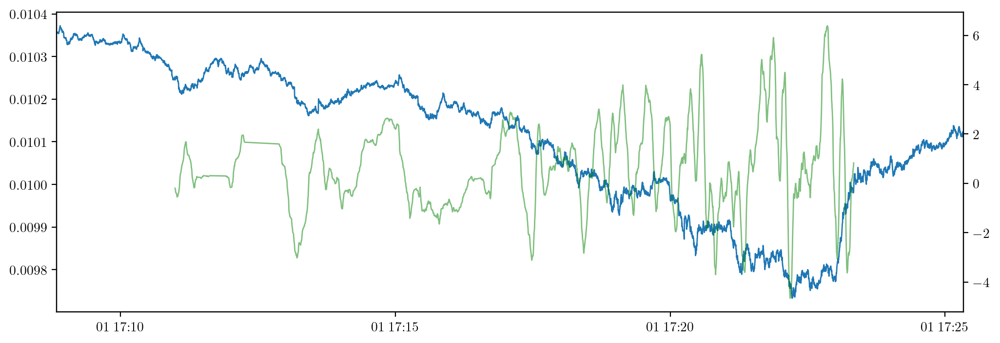

In [ ]:
weight_plot(497, t_len = 100, weight=100)

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def weight_plot(id, weight = 100, t_len = 600):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()
    scores = score(id, show_all=True)
    
    vol = scores['volatility'][0] * 10**4
    print(vol)

    #short = scores['short unweighted mom']/vol
    long = scores['long unweighted mom']/vol
    short = fast_scoring(id, t_len, weight=weight)
    #long = fast_scoring(id, 400, weight = 2000)
    ax1.plot(short.rolling(50).mean(), c = 'g', alpha = 0.5)
    ax1.plot(scores['score'], c = 'orange', alpha = 0.3)
    ax1.plot(long, c='b')
    ax1.axhline(0, c = 'black')
    ax1.plot(0.5 * (4*short.rolling(50).mean() + long).rolling(30).mean(), c = 'r')

2.002171159344175
1.8509913617883917


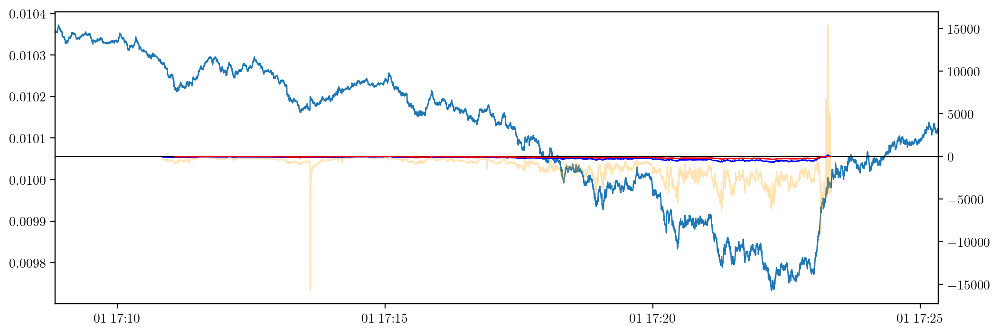

In [ ]:
weight_plot(497, t_len = 100, weight=100)

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def weight_plot(id, weight = 100, t_len = 600):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()
    scores = score(id, show_all=True)
    
    vol = scores['volatility'][0] * 10**4
    print(vol)

    #short = scores['short unweighted mom']/vol
    long = scores['long unweighted mom']/vol
    short = fast_scoring(id, t_len, weight=weight)
    #long = fast_scoring(id, 400, weight = 2000)
    ax1.plot(short.rolling(50).mean(), c = 'g', alpha = 0.5)
    ax1.plot(scores['score']/vol, c = 'orange', alpha = 0.3)
    ax1.plot(long, c='b')
    ax1.axhline(0, c = 'black')
    ax1.plot(0.5 * (4*short.rolling(50).mean() + long).rolling(30).mean(), c = 'r')

2.002171159344175
1.8509913617883917


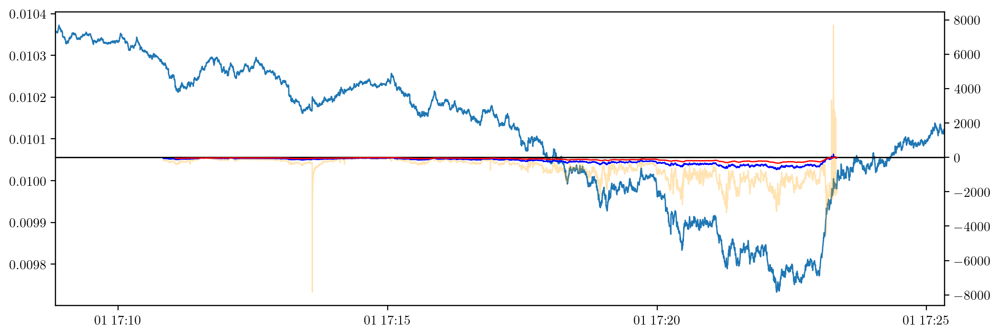

In [ ]:
weight_plot(497, t_len = 100, weight=100)

2.002171159344175
1.8509913617883917


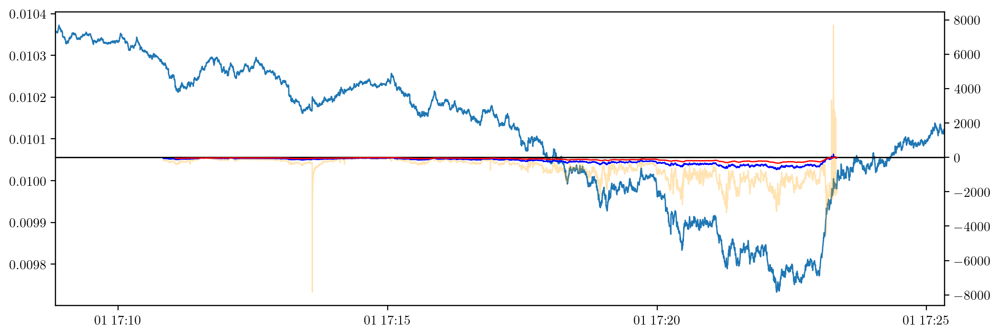

In [ ]:
weight_plot(497, t_len = 100, weight=100)

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def weight_plot(id, weight = 100, t_len = 600):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()
    scores = score(id, show_all=True)
    
    vol = scores['volatility'][0] * 10**4
    print(vol)

    #short = scores['short unweighted mom']/vol
    long = scores['long unweighted mom']/vol
    short = fast_scoring(id, t_len, weight=weight)
    #long = fast_scoring(id, 400, weight = 2000)
    ax1.plot(short.rolling(50).mean(), c = 'g', alpha = 0.5)
    ax1.plot(scores['score']/10*vol, c = 'orange', alpha = 0.3)
    ax1.set(ylim = [-250, 250])
    ax1.plot(long, c='b')
    ax1.axhline(0, c = 'black')
    ax1.plot(0.5 * (4*short.rolling(50).mean() + long).rolling(30).mean(), c = 'r')

2.002171159344175
1.8509913617883917


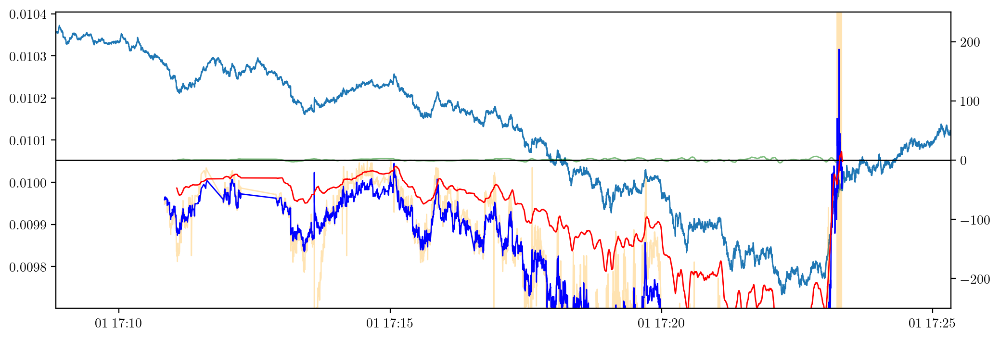

In [ ]:
weight_plot(497, t_len = 100, weight=100)

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def weight_plot(id, weight = 100, t_len = 600):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()
    scores = score(id, show_all=True)
    
    vol = scores['volatility'][0] * 10**4
    print(vol)

    #short = scores['short unweighted mom']/vol
    long = scores['long unweighted mom']/1200 * vol
    short = fast_scoring(id, t_len, weight=weight)
    #long = fast_scoring(id, 400, weight = 2000)
    ax1.plot(short.rolling(50).mean(), c = 'g', alpha = 0.5)
    ax1.plot(scores['score']/100*vol, c = 'orange', alpha = 0.3)
    ax1.set(ylim = [-250, 250])
    ax1.plot(long, c='b')
    ax1.axhline(0, c = 'black')
    ax1.plot(0.5 * (4*short.rolling(50).mean() + long).rolling(30).mean(), c = 'r')

2.002171159344175
1.8509913617883917


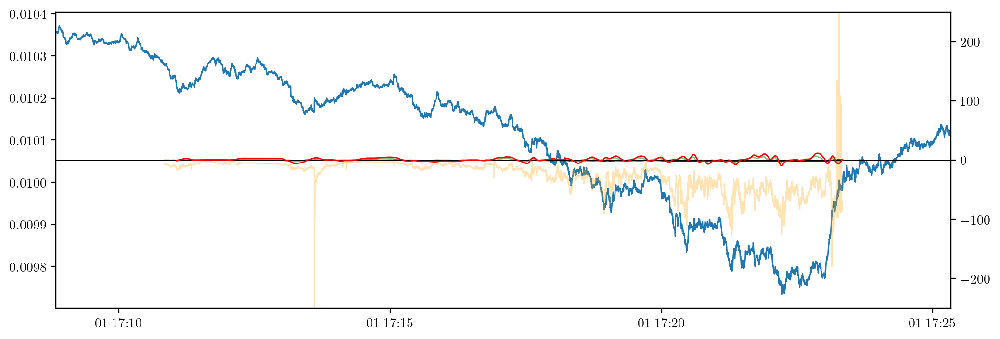

In [ ]:
weight_plot(497, t_len = 100, weight=100)

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def weight_plot(id, weight = 100, t_len = 600):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()
    scores = score(id, show_all=True)
    
    vol = scores['volatility'][0] * 10**4
    print(vol)

    #short = scores['short unweighted mom']/vol
    long = scores['long unweighted mom']/1200 * vol
    short = fast_scoring(id, t_len, weight=weight)
    #long = fast_scoring(id, 400, weight = 2000)
    ax1.plot(short.rolling(50).mean(), c = 'g', alpha = 0.5)
    ax1.plot(scores['score']/1200*vol, c = 'orange', alpha = 0.3)
    ax1.set(ylim = [-100, 100])
    ax1.plot(long, c='b')
    ax1.axhline(0, c = 'black')
    ax1.plot(0.5 * (4*short.rolling(50).mean() + long).rolling(30).mean(), c = 'r')

2.002171159344175
1.8509913617883917


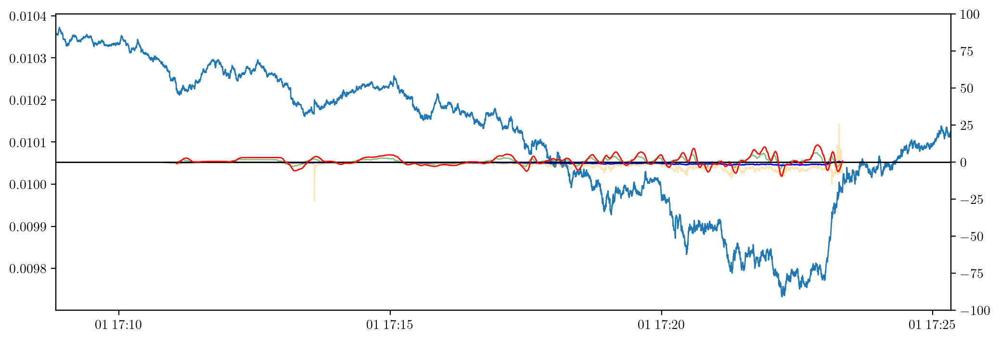

In [ ]:
weight_plot(497, t_len = 100, weight=100)

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def weight_plot(id, weight = 100, t_len = 600):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()
    scores = score(id, show_all=True)
    
    vol = scores['volatility'][0] * 10**4
    print(vol)

    #short = scores['short unweighted mom']/vol
    long = scores['long unweighted mom']/1200 * vol
    short = fast_scoring(id, t_len, weight=weight)
    #long = fast_scoring(id, 400, weight = 2000)
    ax1.plot(short.rolling(50).mean(), c = 'g', alpha = 0.5)
    ax1.plot(scores['score']/1200*vol, c = 'orange', alpha = 0.3)
    ax1.set(ylim = [-20, 20])
    ax1.plot(long, c='b')
    ax1.axhline(0, c = 'black')
    ax1.plot(0.5 * (4*short.rolling(50).mean() + long).rolling(30).mean(), c = 'r')

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def weight_plot(id, weight = 100, t_len = 600):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()
    scores = score(id, show_all=True)
    
    vol = scores['volatility'][0] * 10**4
    print(vol)

    #short = scores['short unweighted mom']/vol
    long = scores['long unweighted mom']/1200 * vol
    short = fast_scoring(id, t_len, weight=weight)
    #long = fast_scoring(id, 400, weight = 2000)
    ax1.plot(short.rolling(50).mean(), c = 'g', alpha = 0.5)
    ax1.plot(scores['score']/1200*vol, c = 'orange', alpha = 0.3)
    ax1.plot(long, c='b')
    ax1.axhline(0, c = 'black')
    ax1.plot(0.5 * (4*short.rolling(50).mean() + long).rolling(30).mean(), c = 'r')

2.002171159344175
1.8509913617883917


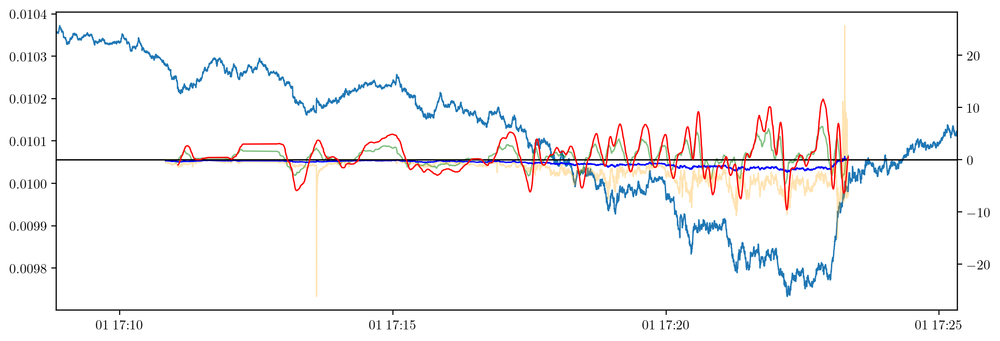

In [ ]:
weight_plot(497, t_len = 100, weight=100)

In [ ]:
from util_funcs import * 

max_len_id = 'case_4430_depth_trade.csv'
max_prop_id = 'case_2510_depth_trade.csv'

def momentum(id, time = 0, weight = 200, fixed_vol = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    t = pos_data.index[0] if time == 0 else time

    select = trade_data[:t]['ask_p1']
    times = select.index
    diff = trade_data['ask_p1'][t] - select
    tdiff = (times - t).to_numpy(dtype = 'float64')
        
    #   normalises time diff to be between 0 and 100 
    tdiff = -tdiff/tdiff[0]* 100
    gradient = (-diff/tdiff).dropna()

    vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
    if fixed_vol == True:
        vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
    #   normalises weighted mean correctly
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    #   returns momentum as sum of gradient * volume at time t * weighting
    #   where weighting exponentially decays; small weight = closer values weighted more
    return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const

def score(id, log = False, plot = False, show_all = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    def mmtm(time, weight, fixed_vol = False):
        select = trade_data[:time]['ask_p1'] 

        times = select.index

        diff = trade_data['ask_p1'][time] - select
        tdiff = (times - time).to_numpy(dtype = 'float64')
        
        #   normalises time diff to be between 0 and 100 
        tdiff = -tdiff/tdiff[0]* 100
        gradient = (-diff/tdiff).dropna()

        vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
        if fixed_vol == True:
            vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
        #   normalises weighted mean correctly
        norm_const = weight/10 *(1-np.exp(-1000/weight))

        #   returns momentum as sum of gradient * volume at time t * weighting
        #   where weighting exponentially decays; small weight = closer values weighted more
        return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const
    
    pre_short_mom = np.array([mmtm(t, 200) for t in pos_data.index])
    pre_long_mom = np.array([mmtm(t, 100000) for t in pos_data.index])
    pre_short_mom_unweighted = np.array([mmtm(t, 200, fixed_vol=True) for t in pos_data.index])
    pre_long_mom_unweighted = np.array([mmtm(t, 100000, fixed_vol=True) for t in pos_data.index])
    
    if plot == True:
        fig, ax = plt.subplots()
        ax.plot(pos_data.index, pre_short_mom, label = 'short mom')
        ax.plot(pos_data.index, pre_long_mom, label = 'long mom')
        ax.plot(pos_data.index, pre_short_mom_unweighted, label = 'short unw mom')
        ax.plot(pos_data.index, pre_long_mom_unweighted, label = 'long unw mom')
        ax.set(xmargin = 0, title = 'Momentum score at buy times')
        ax.grid()
        ax.legend()

    mean_vol = 1/2*(np.mean(trade_data['ask_tt_volume']) + np.mean(trade_data['bid_tt_volume']))
    
    #   note that momentum approx. is linear with mean volume, so maybe consider normalising if we don't care about trade volume as much? 
    volatility = np.std(returns)
    if log == True:
        volatility = np.log(volatility * 10**5) * 100
    
    if show_all == True:
        #   calculate overall momentum score, weighting long term momentum more; essentially this is 3 parts long momentum 1 part short momentum (unweighted, since weighted short fluctuates like crazy) 
        mom_rms = 1/6 * np.sqrt(abs(np.sign(pre_short_mom)*pre_short_mom**2 + 2* np.sign(pre_long_mom)*pre_long_mom**2 + 2* np.sign(pre_long_mom_unweighted)*pre_long_mom_unweighted**2 + np.sign(pre_short_mom_unweighted) * pre_short_mom_unweighted**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(pre_long_mom_unweighted) * mom_rms / (1000*volatility)

        n = len(pos_data.index)
        df = pd.DataFrame(data = np.array([wghted_score, mean_vol * np.ones(n), volatility * np.ones(n), pre_short_mom, pre_long_mom, pre_short_mom_unweighted, pre_long_mom_unweighted]).transpose(), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = pos_data.index)
        
        return df
    else: 
        short_mom = np.mean(pre_short_mom)
        long_mom = np.mean(pre_long_mom)
        unwghted_short_mom = np.mean(pre_short_mom_unweighted)
        unwghted_long_mom = np.mean(pre_long_mom_unweighted)

        mom_rms = 1/6 * np.sqrt(abs(np.sign(short_mom)*short_mom**2 + 2* np.sign(long_mom)*long_mom**2 + 2* np.sign(unwghted_long_mom)*unwghted_long_mom**2 + np.sign(unwghted_short_mom) * unwghted_short_mom**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(unwghted_long_mom) * mom_rms / (1000*volatility)

        df = pd.DataFrame(data = np.array([wghted_score, mean_vol, volatility, short_mom, long_mom, unwghted_short_mom, unwghted_long_mom]).reshape(1, 7), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = [td[id][5:-16]])
        
        return df

def fast_scoring(id, weight = 100):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    times = pos_data.index
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    vol = 10 **8 * np.var(get_returns(td[id])[times[0] - timedelta(seconds = 600):times[0]])
    grad_scale = trade_data['bid_p1'][times[0]] - trade_data['bid_p1'][times[0] - timedelta(seconds=t_len)]
    print(vol)
    select = lambda t: trade_data['bid_p1'][0:t]
    def score(t):
        s = select(t)
        s_ind = (s.index - s.index[0]).to_numpy(dtype = 'float64')/(t_len * 10**7)
        grad = (s - s[0])[1:]/(s_ind[1:] * (grad_scale * 10**3))
        #return np.mean(grad)
        return np.sum(grad * np.exp(-10 * (s_ind)[1:]/weight))/norm_const

    return pd.Series(data=[10**5 * score(t) for t in times], index=times)/(np.sqrt(vol) * t_len) * 10
    
all_scores = pd.read_csv('files/scored_cases.csv')


#   analysis / diagnostics
def plot_score_vol_cor():
    res = sp.stats.linregress(all_scores['score'], all_scores['mean volume'])
    x = np.linspace(-400,100)
    fig, ax = plt.subplots()
    ax.scatter(all_scores['score'], all_scores['mean volume'], s= 2, label = 'score vs mean volume')
    ax.plot(x, res.intercept - 30000 + res.slope*x, 'g', label = '(intercept adjusted) linear regression on score vs mean volume')
    ax.set(xlim = [-400, 100], ylim = [0, 200000], xlabel = 'score', ylabel = 'mean volume')
    ax.legend(loc = 'lower left')

corr = np.corrcoef(all_scores['score'], all_scores['mean volume'])
#   correlation between them is approx -0.4, pretty sufficiently negatively correlated between score and mean vol

def pnl_by_thres(upper = -200.0, scoring = 'vol'):
    scoring_systems = {'log': 'log vol score', 'no_vol':'no vol score', 'vol': 'score'}
    score = scoring_systems[scoring]
    tradeid = all_scores[all_scores[score] <= upper]['id']
    res = np.zeros((len(pos), 5))
    print(len(tradeid))
    for i in tqdm(tradeid):
        j = int(str(i)[:-1]) if i != 0 else 0
        res[j, :] = pnl_fast(to_df(pos[j]), to_df(td[j]), 1000)
    
    pos_id = [x[5:-8] for x in pos]
    df_res = pd.DataFrame(data = res, index = pos_id, columns = ['profit', 'loss', 'net', 'avg bid', 'avg ask'])
    winrate = len(df_res[df_res['net'] > 0].index)/len(tradeid)
    df_res = df_res[df_res != 0].dropna()
    
    prof_given_w = np.mean(df_res[df_res['net']>0]['net'])
    loss_given_l = np.mean(df_res[df_res['net']<0]['net'])

    pnl = -prof_given_w/loss_given_l

    print(winrate, pnl)
    return df_res.dropna()

def vol_ratio(id):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_before = np.std(data[:start])
    vol_after = np.std(data[start:])

    return vol_after/vol_before

def est_vol(id, n):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_after = np.std(data[start:])
    vol_est = np.std(data[start:][:n])

    return vol_est/vol_after - 1

def plot_price_rolling_c(id, n):
    data = dev_from_rolling_price(td[id], n)

    price = data['price'][n-1:]
    rolling = data['rolling_mean'].dropna()
    gradient = rolling.values[1:]/rolling.values[:-1] * 10
    time = price.index

    fig, (ax, ax1) = plt.subplots(nrows = 2)
    ax.plot(time, price, label = 'price')
    ax.plot(time, rolling, label = 'rolling (n = {0})'.format(n))
    ax1.plot(time[1:], gradient, label = 'gradient')
    ax.set(xmargin = 0, title = 'price and rolling price')
    ax1.set(xmargin=0, title = 'gradient')
    ax.legend()
    ax1.legend()

def pre_vol(id, start = True):
    data = get_returns(td[id])
    start = to_df(pos[id]).index[0] if start == True else to_df(pos[id]).index[-1] 
    return np.std(data[:start])

def plot_price_rolling_diff(id):
    data = dev_from_rolling_price(td[id])
    price_diffs = data['price'].values[499:] - data['price'].values[:-499]
    means = data['diff'].dropna().rolling(500, center=True).mean().dropna()

    price_diffs_centred = price_diffs - price_diffs.mean()
    diff = data.dropna()['diff']
    diff_centred = diff - diff.mean()
    scale = price_diffs @ diff_centred / (diff_centred @ diff_centred)
    print(scale,  price_diffs.mean(),  1.5 * diff.mean())

    fig, ax = plt.subplots()
    ax.set(xmargin = 0)

    ax.plot(data.dropna().index, price_diffs)
    ax.plot(data.dropna().index, 1.5 * diff_centred, c = 'g')
    ax.plot(data.dropna().index, abs(price_diffs - 1.5 * diff_centred), c = 'r')
    ax.axhline(0, c = 'black')
    #ax.plot(data.dropna().index[250:-249], scale * means,)
    #ax.plot(data.dropna().index[250:-249], price_diffs[250:-249] - scale*means)

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def weight_plot(id, weight = 100, t_len = 600):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()
    #scores = score(id, show_all=True)
    
    #vol = scores['volatility'][0] * 10**4
    print(vol)

    #short = scores['short unweighted mom']/vol
    #long = scores['long unweighted mom']/1200 * vol
    short = fast_scoring(id, weight=weight)
    long = fast_scoring(id, weight = 2000)
    ax1.plot(short.rolling(50).mean(), c = 'g', alpha = 0.5)
    ax1.plot(scores['score']/1200*vol, c = 'orange', alpha = 0.3)
    ax1.plot(long, c='b')
    ax1.axhline(0, c = 'black')
    ax1.plot(0.5 * (4*short.rolling(50).mean() + long).rolling(30).mean(), c = 'r')

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def weight_plot(id, weight = 100, t_len = 600):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()
    #scores = score(id, show_all=True)
    
    #vol = scores['volatility'][0] * 10**4
    print(vol)

    #short = scores['short unweighted mom']/vol
    #long = scores['long unweighted mom']/1200 * vol
    short = fast_scoring(id, weight=weight)
    long = fast_scoring(id, weight = 2000)
    ax1.plot(short.rolling(50).mean(), c = 'g', alpha = 0.5)
    #ax1.plot(scores['score']/1200*vol, c = 'orange', alpha = 0.3)
    ax1.plot(long, c='b')
    ax1.axhline(0, c = 'black')
    ax1.plot(0.5 * (4*short.rolling(50).mean() + long).rolling(30).mean(), c = 'r')

NameError: name 'vol' is not defined

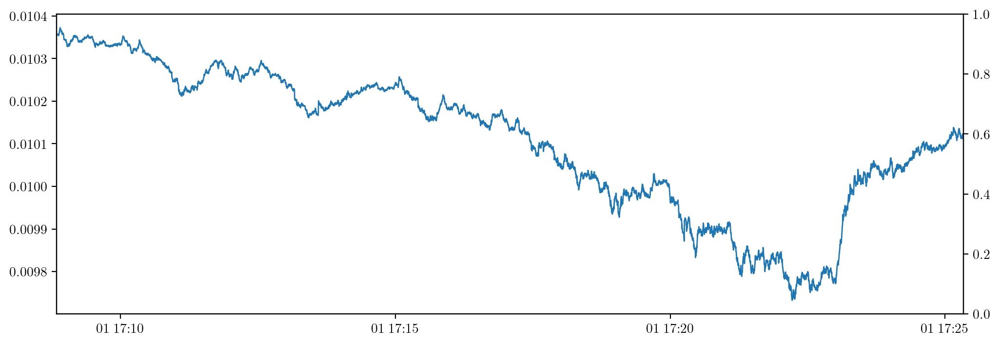

In [ ]:
weight_plot(497, t_len = 100, weight=100)

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def weight_plot(id, weight = 100, t_len = 600):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()
    #scores = score(id, show_all=True)
    
    #vol = scores['volatility'][0] * 10**4
    #print(vol)

    #short = scores['short unweighted mom']/vol
    #long = scores['long unweighted mom']/1200 * vol
    short = fast_scoring(id, weight=weight)
    long = fast_scoring(id, weight = 2000)
    ax1.plot(short.rolling(50).mean(), c = 'g', alpha = 0.5)
    #ax1.plot(scores['score']/1200*vol, c = 'orange', alpha = 0.3)
    ax1.plot(long, c='b')
    ax1.axhline(0, c = 'black')
    ax1.plot(0.5 * (4*short.rolling(50).mean() + long).rolling(30).mean(), c = 'r')

1.8509913617883917
1.8509913617883917


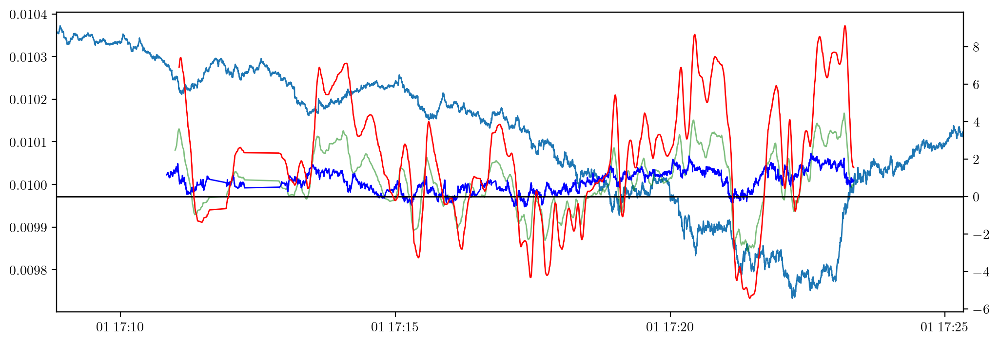

In [ ]:
weight_plot(497, t_len = 100, weight=100)

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def weight_plot(id, weight = 100, t_len = 600):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()
    #scores = score(id, show_all=True)
    
    #vol = scores['volatility'][0] * 10**4
    #print(vol)

    #short = scores['short unweighted mom']/vol
    #long = scores['long unweighted mom']/1200 * vol
    short = fast_scoring(id, weight=weight)
    long = fast_scoring(id, weight = 2000)
    ax1.plot(short.rolling(50).mean(), c = 'g', alpha = 0.5)
    #ax1.plot(scores['score']/1200*vol, c = 'orange', alpha = 0.3)
    ax1.plot(long, c='b')
    ax1.axhline(0, c = 'black')
    ax1.plot(0.5 * (short.rolling(50).mean() + long).rolling(30).mean(), c = 'r')

1.8509913617883917
1.8509913617883917


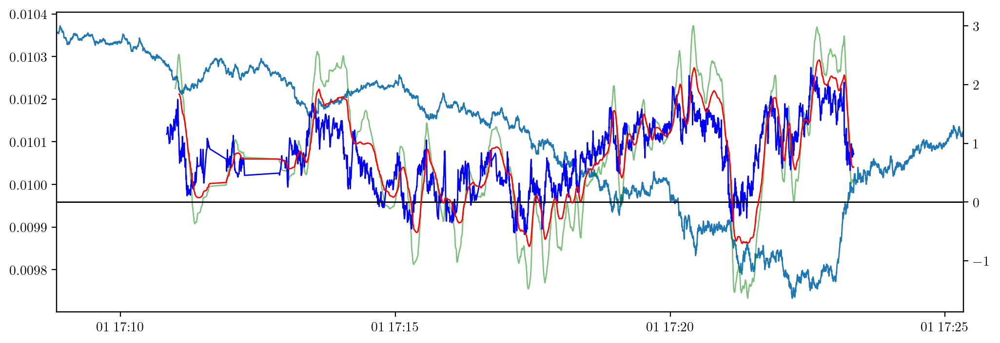

In [ ]:
weight_plot(497, weight=200)

1.8509913617883917
1.8509913617883917


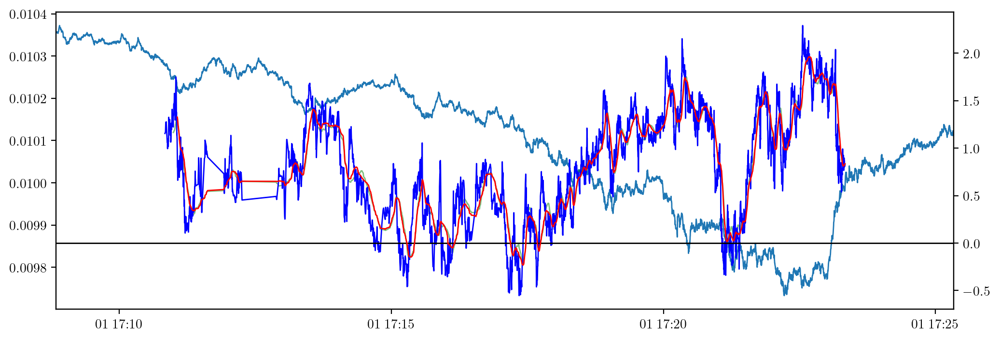

In [ ]:
weight_plot(497, weight=5000)

In [ ]:
from util_funcs import * 

max_len_id = 'case_4430_depth_trade.csv'
max_prop_id = 'case_2510_depth_trade.csv'

def momentum(id, time = 0, weight = 200, fixed_vol = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    t = pos_data.index[0] if time == 0 else time

    select = trade_data[:t]['ask_p1']
    times = select.index
    diff = trade_data['ask_p1'][t] - select
    tdiff = (times - t).to_numpy(dtype = 'float64')
        
    #   normalises time diff to be between 0 and 100 
    tdiff = -tdiff/tdiff[0]* 100
    gradient = (-diff/tdiff).dropna()

    vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
    if fixed_vol == True:
        vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
    #   normalises weighted mean correctly
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    #   returns momentum as sum of gradient * volume at time t * weighting
    #   where weighting exponentially decays; small weight = closer values weighted more
    return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const

def score(id, log = False, plot = False, show_all = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    def mmtm(time, weight, fixed_vol = False):
        select = trade_data[:time]['ask_p1'] 

        times = select.index

        diff = trade_data['ask_p1'][time] - select
        tdiff = (times - time).to_numpy(dtype = 'float64')
        
        #   normalises time diff to be between 0 and 100 
        tdiff = -tdiff/tdiff[0]* 100
        gradient = (-diff/tdiff).dropna()

        vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
        if fixed_vol == True:
            vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
        #   normalises weighted mean correctly
        norm_const = weight/10 *(1-np.exp(-1000/weight))

        #   returns momentum as sum of gradient * volume at time t * weighting
        #   where weighting exponentially decays; small weight = closer values weighted more
        return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const
    
    pre_short_mom = np.array([mmtm(t, 200) for t in pos_data.index])
    pre_long_mom = np.array([mmtm(t, 100000) for t in pos_data.index])
    pre_short_mom_unweighted = np.array([mmtm(t, 200, fixed_vol=True) for t in pos_data.index])
    pre_long_mom_unweighted = np.array([mmtm(t, 100000, fixed_vol=True) for t in pos_data.index])
    
    if plot == True:
        fig, ax = plt.subplots()
        ax.plot(pos_data.index, pre_short_mom, label = 'short mom')
        ax.plot(pos_data.index, pre_long_mom, label = 'long mom')
        ax.plot(pos_data.index, pre_short_mom_unweighted, label = 'short unw mom')
        ax.plot(pos_data.index, pre_long_mom_unweighted, label = 'long unw mom')
        ax.set(xmargin = 0, title = 'Momentum score at buy times')
        ax.grid()
        ax.legend()

    mean_vol = 1/2*(np.mean(trade_data['ask_tt_volume']) + np.mean(trade_data['bid_tt_volume']))
    
    #   note that momentum approx. is linear with mean volume, so maybe consider normalising if we don't care about trade volume as much? 
    volatility = np.std(returns)
    if log == True:
        volatility = np.log(volatility * 10**5) * 100
    
    if show_all == True:
        #   calculate overall momentum score, weighting long term momentum more; essentially this is 3 parts long momentum 1 part short momentum (unweighted, since weighted short fluctuates like crazy) 
        mom_rms = 1/6 * np.sqrt(abs(np.sign(pre_short_mom)*pre_short_mom**2 + 2* np.sign(pre_long_mom)*pre_long_mom**2 + 2* np.sign(pre_long_mom_unweighted)*pre_long_mom_unweighted**2 + np.sign(pre_short_mom_unweighted) * pre_short_mom_unweighted**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(pre_long_mom_unweighted) * mom_rms / (1000*volatility)

        n = len(pos_data.index)
        df = pd.DataFrame(data = np.array([wghted_score, mean_vol * np.ones(n), volatility * np.ones(n), pre_short_mom, pre_long_mom, pre_short_mom_unweighted, pre_long_mom_unweighted]).transpose(), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = pos_data.index)
        
        return df
    else: 
        short_mom = np.mean(pre_short_mom)
        long_mom = np.mean(pre_long_mom)
        unwghted_short_mom = np.mean(pre_short_mom_unweighted)
        unwghted_long_mom = np.mean(pre_long_mom_unweighted)

        mom_rms = 1/6 * np.sqrt(abs(np.sign(short_mom)*short_mom**2 + 2* np.sign(long_mom)*long_mom**2 + 2* np.sign(unwghted_long_mom)*unwghted_long_mom**2 + np.sign(unwghted_short_mom) * unwghted_short_mom**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(unwghted_long_mom) * mom_rms / (1000*volatility)

        df = pd.DataFrame(data = np.array([wghted_score, mean_vol, volatility, short_mom, long_mom, unwghted_short_mom, unwghted_long_mom]).reshape(1, 7), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = [td[id][5:-16]])
        
        return df

def fast_scoring(id, weight = 100):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    times = pos_data.index
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    vol = 10 **8 * np.var(get_returns(td[id])[times[0] - timedelta(seconds = 600):times[0]])
    grad_scale = trade_data['bid_p1'][times[0]] - trade_data['bid_p1'][0]
    print(vol)
    select = lambda t: trade_data['bid_p1'][0:t]
    def score(t):
        s = select(t)
        s_ind = (s.index - s.index[0]).to_numpy(dtype = 'float64')/(t_len * 10**7)
        grad = (s - s[0])[1:]/(s_ind[1:] * (grad_scale * 10**3))
        #return np.mean(grad)
        return np.sum(grad * np.exp(-10 * (s_ind)[1:]/weight))/norm_const

    return pd.Series(data=[10**5 * score(t) for t in times], index=times)/(np.sqrt(vol)) * 10
    
all_scores = pd.read_csv('files/scored_cases.csv')


#   analysis / diagnostics
def plot_score_vol_cor():
    res = sp.stats.linregress(all_scores['score'], all_scores['mean volume'])
    x = np.linspace(-400,100)
    fig, ax = plt.subplots()
    ax.scatter(all_scores['score'], all_scores['mean volume'], s= 2, label = 'score vs mean volume')
    ax.plot(x, res.intercept - 30000 + res.slope*x, 'g', label = '(intercept adjusted) linear regression on score vs mean volume')
    ax.set(xlim = [-400, 100], ylim = [0, 200000], xlabel = 'score', ylabel = 'mean volume')
    ax.legend(loc = 'lower left')

corr = np.corrcoef(all_scores['score'], all_scores['mean volume'])
#   correlation between them is approx -0.4, pretty sufficiently negatively correlated between score and mean vol

def pnl_by_thres(upper = -200.0, scoring = 'vol'):
    scoring_systems = {'log': 'log vol score', 'no_vol':'no vol score', 'vol': 'score'}
    score = scoring_systems[scoring]
    tradeid = all_scores[all_scores[score] <= upper]['id']
    res = np.zeros((len(pos), 5))
    print(len(tradeid))
    for i in tqdm(tradeid):
        j = int(str(i)[:-1]) if i != 0 else 0
        res[j, :] = pnl_fast(to_df(pos[j]), to_df(td[j]), 1000)
    
    pos_id = [x[5:-8] for x in pos]
    df_res = pd.DataFrame(data = res, index = pos_id, columns = ['profit', 'loss', 'net', 'avg bid', 'avg ask'])
    winrate = len(df_res[df_res['net'] > 0].index)/len(tradeid)
    df_res = df_res[df_res != 0].dropna()
    
    prof_given_w = np.mean(df_res[df_res['net']>0]['net'])
    loss_given_l = np.mean(df_res[df_res['net']<0]['net'])

    pnl = -prof_given_w/loss_given_l

    print(winrate, pnl)
    return df_res.dropna()

def vol_ratio(id):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_before = np.std(data[:start])
    vol_after = np.std(data[start:])

    return vol_after/vol_before

def est_vol(id, n):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_after = np.std(data[start:])
    vol_est = np.std(data[start:][:n])

    return vol_est/vol_after - 1

def plot_price_rolling_c(id, n):
    data = dev_from_rolling_price(td[id], n)

    price = data['price'][n-1:]
    rolling = data['rolling_mean'].dropna()
    gradient = rolling.values[1:]/rolling.values[:-1] * 10
    time = price.index

    fig, (ax, ax1) = plt.subplots(nrows = 2)
    ax.plot(time, price, label = 'price')
    ax.plot(time, rolling, label = 'rolling (n = {0})'.format(n))
    ax1.plot(time[1:], gradient, label = 'gradient')
    ax.set(xmargin = 0, title = 'price and rolling price')
    ax1.set(xmargin=0, title = 'gradient')
    ax.legend()
    ax1.legend()

def pre_vol(id, start = True):
    data = get_returns(td[id])
    start = to_df(pos[id]).index[0] if start == True else to_df(pos[id]).index[-1] 
    return np.std(data[:start])

def plot_price_rolling_diff(id):
    data = dev_from_rolling_price(td[id])
    price_diffs = data['price'].values[499:] - data['price'].values[:-499]
    means = data['diff'].dropna().rolling(500, center=True).mean().dropna()

    price_diffs_centred = price_diffs - price_diffs.mean()
    diff = data.dropna()['diff']
    diff_centred = diff - diff.mean()
    scale = price_diffs @ diff_centred / (diff_centred @ diff_centred)
    print(scale,  price_diffs.mean(),  1.5 * diff.mean())

    fig, ax = plt.subplots()
    ax.set(xmargin = 0)

    ax.plot(data.dropna().index, price_diffs)
    ax.plot(data.dropna().index, 1.5 * diff_centred, c = 'g')
    ax.plot(data.dropna().index, abs(price_diffs - 1.5 * diff_centred), c = 'r')
    ax.axhline(0, c = 'black')
    #ax.plot(data.dropna().index[250:-249], scale * means,)
    #ax.plot(data.dropna().index[250:-249], price_diffs[250:-249] - scale*means)

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def weight_plot(id, weight = 100):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()
    #scores = score(id, show_all=True)
    
    #vol = scores['volatility'][0] * 10**4
    #print(vol)

    #short = scores['short unweighted mom']/vol
    #long = scores['long unweighted mom']/1200 * vol
    short = fast_scoring(id, weight=weight)
    long = fast_scoring(id, weight = 2000)
    ax1.plot(short.rolling(50).mean(), c = 'g', alpha = 0.5)
    #ax1.plot(scores['score']/1200*vol, c = 'orange', alpha = 0.3)
    ax1.plot(long, c='b')
    ax1.axhline(0, c = 'black')
    ax1.plot(0.5 * (short.rolling(50).mean() + long).rolling(30).mean(), c = 'r')

1.8509913617883917


TypeError: cannot do slice indexing on DatetimeIndex with these indexers [0] of type int

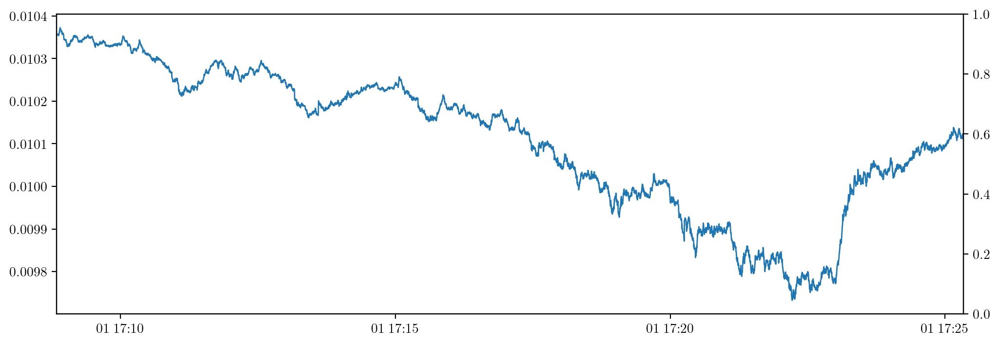

In [ ]:
weight_plot(497, weight=5000)

In [ ]:
from util_funcs import * 

max_len_id = 'case_4430_depth_trade.csv'
max_prop_id = 'case_2510_depth_trade.csv'

def momentum(id, time = 0, weight = 200, fixed_vol = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    t = pos_data.index[0] if time == 0 else time

    select = trade_data[:t]['ask_p1']
    times = select.index
    diff = trade_data['ask_p1'][t] - select
    tdiff = (times - t).to_numpy(dtype = 'float64')
        
    #   normalises time diff to be between 0 and 100 
    tdiff = -tdiff/tdiff[0]* 100
    gradient = (-diff/tdiff).dropna()

    vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
    if fixed_vol == True:
        vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
    #   normalises weighted mean correctly
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    #   returns momentum as sum of gradient * volume at time t * weighting
    #   where weighting exponentially decays; small weight = closer values weighted more
    return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const

def score(id, log = False, plot = False, show_all = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    def mmtm(time, weight, fixed_vol = False):
        select = trade_data[:time]['ask_p1'] 

        times = select.index

        diff = trade_data['ask_p1'][time] - select
        tdiff = (times - time).to_numpy(dtype = 'float64')
        
        #   normalises time diff to be between 0 and 100 
        tdiff = -tdiff/tdiff[0]* 100
        gradient = (-diff/tdiff).dropna()

        vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
        if fixed_vol == True:
            vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
        #   normalises weighted mean correctly
        norm_const = weight/10 *(1-np.exp(-1000/weight))

        #   returns momentum as sum of gradient * volume at time t * weighting
        #   where weighting exponentially decays; small weight = closer values weighted more
        return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const
    
    pre_short_mom = np.array([mmtm(t, 200) for t in pos_data.index])
    pre_long_mom = np.array([mmtm(t, 100000) for t in pos_data.index])
    pre_short_mom_unweighted = np.array([mmtm(t, 200, fixed_vol=True) for t in pos_data.index])
    pre_long_mom_unweighted = np.array([mmtm(t, 100000, fixed_vol=True) for t in pos_data.index])
    
    if plot == True:
        fig, ax = plt.subplots()
        ax.plot(pos_data.index, pre_short_mom, label = 'short mom')
        ax.plot(pos_data.index, pre_long_mom, label = 'long mom')
        ax.plot(pos_data.index, pre_short_mom_unweighted, label = 'short unw mom')
        ax.plot(pos_data.index, pre_long_mom_unweighted, label = 'long unw mom')
        ax.set(xmargin = 0, title = 'Momentum score at buy times')
        ax.grid()
        ax.legend()

    mean_vol = 1/2*(np.mean(trade_data['ask_tt_volume']) + np.mean(trade_data['bid_tt_volume']))
    
    #   note that momentum approx. is linear with mean volume, so maybe consider normalising if we don't care about trade volume as much? 
    volatility = np.std(returns)
    if log == True:
        volatility = np.log(volatility * 10**5) * 100
    
    if show_all == True:
        #   calculate overall momentum score, weighting long term momentum more; essentially this is 3 parts long momentum 1 part short momentum (unweighted, since weighted short fluctuates like crazy) 
        mom_rms = 1/6 * np.sqrt(abs(np.sign(pre_short_mom)*pre_short_mom**2 + 2* np.sign(pre_long_mom)*pre_long_mom**2 + 2* np.sign(pre_long_mom_unweighted)*pre_long_mom_unweighted**2 + np.sign(pre_short_mom_unweighted) * pre_short_mom_unweighted**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(pre_long_mom_unweighted) * mom_rms / (1000*volatility)

        n = len(pos_data.index)
        df = pd.DataFrame(data = np.array([wghted_score, mean_vol * np.ones(n), volatility * np.ones(n), pre_short_mom, pre_long_mom, pre_short_mom_unweighted, pre_long_mom_unweighted]).transpose(), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = pos_data.index)
        
        return df
    else: 
        short_mom = np.mean(pre_short_mom)
        long_mom = np.mean(pre_long_mom)
        unwghted_short_mom = np.mean(pre_short_mom_unweighted)
        unwghted_long_mom = np.mean(pre_long_mom_unweighted)

        mom_rms = 1/6 * np.sqrt(abs(np.sign(short_mom)*short_mom**2 + 2* np.sign(long_mom)*long_mom**2 + 2* np.sign(unwghted_long_mom)*unwghted_long_mom**2 + np.sign(unwghted_short_mom) * unwghted_short_mom**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(unwghted_long_mom) * mom_rms / (1000*volatility)

        df = pd.DataFrame(data = np.array([wghted_score, mean_vol, volatility, short_mom, long_mom, unwghted_short_mom, unwghted_long_mom]).reshape(1, 7), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = [td[id][5:-16]])
        
        return df

def fast_scoring(id, weight = 100):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    times = pos_data.index
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    vol = 10 **8 * np.var(get_returns(td[id]))
    grad_scale = trade_data['bid_p1'][times[0]] - trade_data['bid_p1'].values[0]
    print(vol)
    select = lambda t: trade_data['bid_p1'][0:t]
    def score(t):
        s = select(t)
        s_ind = (s.index - s.index[0]).to_numpy(dtype = 'float64')/(t_len * 10**7)
        grad = (s - s[0])[1:]/(s_ind[1:] * (grad_scale * 10**3))
        #return np.mean(grad)
        return np.sum(grad * np.exp(-10 * (s_ind)[1:]/weight))/norm_const

    return score(start)
    #return pd.Series(data=[10**5 * score(t) for t in times], index=times)/(np.sqrt(vol)) * 10
    
all_scores = pd.read_csv('files/scored_cases.csv')


#   analysis / diagnostics
def plot_score_vol_cor():
    res = sp.stats.linregress(all_scores['score'], all_scores['mean volume'])
    x = np.linspace(-400,100)
    fig, ax = plt.subplots()
    ax.scatter(all_scores['score'], all_scores['mean volume'], s= 2, label = 'score vs mean volume')
    ax.plot(x, res.intercept - 30000 + res.slope*x, 'g', label = '(intercept adjusted) linear regression on score vs mean volume')
    ax.set(xlim = [-400, 100], ylim = [0, 200000], xlabel = 'score', ylabel = 'mean volume')
    ax.legend(loc = 'lower left')

corr = np.corrcoef(all_scores['score'], all_scores['mean volume'])
#   correlation between them is approx -0.4, pretty sufficiently negatively correlated between score and mean vol

def pnl_by_thres(upper = -200.0, scoring = 'vol'):
    scoring_systems = {'log': 'log vol score', 'no_vol':'no vol score', 'vol': 'score'}
    score = scoring_systems[scoring]
    tradeid = all_scores[all_scores[score] <= upper]['id']
    res = np.zeros((len(pos), 5))
    print(len(tradeid))
    for i in tqdm(tradeid):
        j = int(str(i)[:-1]) if i != 0 else 0
        res[j, :] = pnl_fast(to_df(pos[j]), to_df(td[j]), 1000)
    
    pos_id = [x[5:-8] for x in pos]
    df_res = pd.DataFrame(data = res, index = pos_id, columns = ['profit', 'loss', 'net', 'avg bid', 'avg ask'])
    winrate = len(df_res[df_res['net'] > 0].index)/len(tradeid)
    df_res = df_res[df_res != 0].dropna()
    
    prof_given_w = np.mean(df_res[df_res['net']>0]['net'])
    loss_given_l = np.mean(df_res[df_res['net']<0]['net'])

    pnl = -prof_given_w/loss_given_l

    print(winrate, pnl)
    return df_res.dropna()

def vol_ratio(id):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_before = np.std(data[:start])
    vol_after = np.std(data[start:])

    return vol_after/vol_before

def est_vol(id, n):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_after = np.std(data[start:])
    vol_est = np.std(data[start:][:n])

    return vol_est/vol_after - 1

def plot_price_rolling_c(id, n):
    data = dev_from_rolling_price(td[id], n)

    price = data['price'][n-1:]
    rolling = data['rolling_mean'].dropna()
    gradient = rolling.values[1:]/rolling.values[:-1] * 10
    time = price.index

    fig, (ax, ax1) = plt.subplots(nrows = 2)
    ax.plot(time, price, label = 'price')
    ax.plot(time, rolling, label = 'rolling (n = {0})'.format(n))
    ax1.plot(time[1:], gradient, label = 'gradient')
    ax.set(xmargin = 0, title = 'price and rolling price')
    ax1.set(xmargin=0, title = 'gradient')
    ax.legend()
    ax1.legend()

def pre_vol(id, start = True):
    data = get_returns(td[id])
    start = to_df(pos[id]).index[0] if start == True else to_df(pos[id]).index[-1] 
    return np.std(data[:start])

def plot_price_rolling_diff(id):
    data = dev_from_rolling_price(td[id])
    price_diffs = data['price'].values[499:] - data['price'].values[:-499]
    means = data['diff'].dropna().rolling(500, center=True).mean().dropna()

    price_diffs_centred = price_diffs - price_diffs.mean()
    diff = data.dropna()['diff']
    diff_centred = diff - diff.mean()
    scale = price_diffs @ diff_centred / (diff_centred @ diff_centred)
    print(scale,  price_diffs.mean(),  1.5 * diff.mean())

    fig, ax = plt.subplots()
    ax.set(xmargin = 0)

    ax.plot(data.dropna().index, price_diffs)
    ax.plot(data.dropna().index, 1.5 * diff_centred, c = 'g')
    ax.plot(data.dropna().index, abs(price_diffs - 1.5 * diff_centred), c = 'r')
    ax.axhline(0, c = 'black')
    #ax.plot(data.dropna().index[250:-249], scale * means,)
    #ax.plot(data.dropna().index[250:-249], price_diffs[250:-249] - scale*means)

In [ ]:
fast_scoring(10, 100)

0.3027722978169995


NameError: name 'start' is not defined

In [ ]:
from util_funcs import * 

max_len_id = 'case_4430_depth_trade.csv'
max_prop_id = 'case_2510_depth_trade.csv'

def momentum(id, time = 0, weight = 200, fixed_vol = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    t = pos_data.index[0] if time == 0 else time

    select = trade_data[:t]['ask_p1']
    times = select.index
    diff = trade_data['ask_p1'][t] - select
    tdiff = (times - t).to_numpy(dtype = 'float64')
        
    #   normalises time diff to be between 0 and 100 
    tdiff = -tdiff/tdiff[0]* 100
    gradient = (-diff/tdiff).dropna()

    vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
    if fixed_vol == True:
        vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
    #   normalises weighted mean correctly
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    #   returns momentum as sum of gradient * volume at time t * weighting
    #   where weighting exponentially decays; small weight = closer values weighted more
    return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const

def score(id, log = False, plot = False, show_all = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    def mmtm(time, weight, fixed_vol = False):
        select = trade_data[:time]['ask_p1'] 

        times = select.index

        diff = trade_data['ask_p1'][time] - select
        tdiff = (times - time).to_numpy(dtype = 'float64')
        
        #   normalises time diff to be between 0 and 100 
        tdiff = -tdiff/tdiff[0]* 100
        gradient = (-diff/tdiff).dropna()

        vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
        if fixed_vol == True:
            vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
        #   normalises weighted mean correctly
        norm_const = weight/10 *(1-np.exp(-1000/weight))

        #   returns momentum as sum of gradient * volume at time t * weighting
        #   where weighting exponentially decays; small weight = closer values weighted more
        return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const
    
    pre_short_mom = np.array([mmtm(t, 200) for t in pos_data.index])
    pre_long_mom = np.array([mmtm(t, 100000) for t in pos_data.index])
    pre_short_mom_unweighted = np.array([mmtm(t, 200, fixed_vol=True) for t in pos_data.index])
    pre_long_mom_unweighted = np.array([mmtm(t, 100000, fixed_vol=True) for t in pos_data.index])
    
    if plot == True:
        fig, ax = plt.subplots()
        ax.plot(pos_data.index, pre_short_mom, label = 'short mom')
        ax.plot(pos_data.index, pre_long_mom, label = 'long mom')
        ax.plot(pos_data.index, pre_short_mom_unweighted, label = 'short unw mom')
        ax.plot(pos_data.index, pre_long_mom_unweighted, label = 'long unw mom')
        ax.set(xmargin = 0, title = 'Momentum score at buy times')
        ax.grid()
        ax.legend()

    mean_vol = 1/2*(np.mean(trade_data['ask_tt_volume']) + np.mean(trade_data['bid_tt_volume']))
    
    #   note that momentum approx. is linear with mean volume, so maybe consider normalising if we don't care about trade volume as much? 
    volatility = np.std(returns)
    if log == True:
        volatility = np.log(volatility * 10**5) * 100
    
    if show_all == True:
        #   calculate overall momentum score, weighting long term momentum more; essentially this is 3 parts long momentum 1 part short momentum (unweighted, since weighted short fluctuates like crazy) 
        mom_rms = 1/6 * np.sqrt(abs(np.sign(pre_short_mom)*pre_short_mom**2 + 2* np.sign(pre_long_mom)*pre_long_mom**2 + 2* np.sign(pre_long_mom_unweighted)*pre_long_mom_unweighted**2 + np.sign(pre_short_mom_unweighted) * pre_short_mom_unweighted**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(pre_long_mom_unweighted) * mom_rms / (1000*volatility)

        n = len(pos_data.index)
        df = pd.DataFrame(data = np.array([wghted_score, mean_vol * np.ones(n), volatility * np.ones(n), pre_short_mom, pre_long_mom, pre_short_mom_unweighted, pre_long_mom_unweighted]).transpose(), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = pos_data.index)
        
        return df
    else: 
        short_mom = np.mean(pre_short_mom)
        long_mom = np.mean(pre_long_mom)
        unwghted_short_mom = np.mean(pre_short_mom_unweighted)
        unwghted_long_mom = np.mean(pre_long_mom_unweighted)

        mom_rms = 1/6 * np.sqrt(abs(np.sign(short_mom)*short_mom**2 + 2* np.sign(long_mom)*long_mom**2 + 2* np.sign(unwghted_long_mom)*unwghted_long_mom**2 + np.sign(unwghted_short_mom) * unwghted_short_mom**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(unwghted_long_mom) * mom_rms / (1000*volatility)

        df = pd.DataFrame(data = np.array([wghted_score, mean_vol, volatility, short_mom, long_mom, unwghted_short_mom, unwghted_long_mom]).reshape(1, 7), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = [td[id][5:-16]])
        
        return df

def fast_scoring(id, weight = 100):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    times = pos_data.index
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    vol = 10 **8 * np.var(get_returns(td[id]))
    grad_scale = trade_data['bid_p1'][times[0]] - trade_data['bid_p1'].values[0]
    print(vol)
    select = lambda t: trade_data['bid_p1'][0:t]
    def score(t):
        s = select(t)
        s_ind = (s.index - s.index[0]).to_numpy(dtype = 'float64')/(t_len * 10**7)
        grad = (s - s[0])[1:]/(s_ind[1:] * (grad_scale * 10**3))
        #return np.mean(grad)
        return np.sum(grad * np.exp(-10 * (s_ind)[1:]/weight))/norm_const

    return score(times[0])
    #return pd.Series(data=[10**5 * score(t) for t in times], index=times)/(np.sqrt(vol)) * 10
    
all_scores = pd.read_csv('files/scored_cases.csv')


#   analysis / diagnostics
def plot_score_vol_cor():
    res = sp.stats.linregress(all_scores['score'], all_scores['mean volume'])
    x = np.linspace(-400,100)
    fig, ax = plt.subplots()
    ax.scatter(all_scores['score'], all_scores['mean volume'], s= 2, label = 'score vs mean volume')
    ax.plot(x, res.intercept - 30000 + res.slope*x, 'g', label = '(intercept adjusted) linear regression on score vs mean volume')
    ax.set(xlim = [-400, 100], ylim = [0, 200000], xlabel = 'score', ylabel = 'mean volume')
    ax.legend(loc = 'lower left')

corr = np.corrcoef(all_scores['score'], all_scores['mean volume'])
#   correlation between them is approx -0.4, pretty sufficiently negatively correlated between score and mean vol

def pnl_by_thres(upper = -200.0, scoring = 'vol'):
    scoring_systems = {'log': 'log vol score', 'no_vol':'no vol score', 'vol': 'score'}
    score = scoring_systems[scoring]
    tradeid = all_scores[all_scores[score] <= upper]['id']
    res = np.zeros((len(pos), 5))
    print(len(tradeid))
    for i in tqdm(tradeid):
        j = int(str(i)[:-1]) if i != 0 else 0
        res[j, :] = pnl_fast(to_df(pos[j]), to_df(td[j]), 1000)
    
    pos_id = [x[5:-8] for x in pos]
    df_res = pd.DataFrame(data = res, index = pos_id, columns = ['profit', 'loss', 'net', 'avg bid', 'avg ask'])
    winrate = len(df_res[df_res['net'] > 0].index)/len(tradeid)
    df_res = df_res[df_res != 0].dropna()
    
    prof_given_w = np.mean(df_res[df_res['net']>0]['net'])
    loss_given_l = np.mean(df_res[df_res['net']<0]['net'])

    pnl = -prof_given_w/loss_given_l

    print(winrate, pnl)
    return df_res.dropna()

def vol_ratio(id):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_before = np.std(data[:start])
    vol_after = np.std(data[start:])

    return vol_after/vol_before

def est_vol(id, n):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_after = np.std(data[start:])
    vol_est = np.std(data[start:][:n])

    return vol_est/vol_after - 1

def plot_price_rolling_c(id, n):
    data = dev_from_rolling_price(td[id], n)

    price = data['price'][n-1:]
    rolling = data['rolling_mean'].dropna()
    gradient = rolling.values[1:]/rolling.values[:-1] * 10
    time = price.index

    fig, (ax, ax1) = plt.subplots(nrows = 2)
    ax.plot(time, price, label = 'price')
    ax.plot(time, rolling, label = 'rolling (n = {0})'.format(n))
    ax1.plot(time[1:], gradient, label = 'gradient')
    ax.set(xmargin = 0, title = 'price and rolling price')
    ax1.set(xmargin=0, title = 'gradient')
    ax.legend()
    ax1.legend()

def pre_vol(id, start = True):
    data = get_returns(td[id])
    start = to_df(pos[id]).index[0] if start == True else to_df(pos[id]).index[-1] 
    return np.std(data[:start])

def plot_price_rolling_diff(id):
    data = dev_from_rolling_price(td[id])
    price_diffs = data['price'].values[499:] - data['price'].values[:-499]
    means = data['diff'].dropna().rolling(500, center=True).mean().dropna()

    price_diffs_centred = price_diffs - price_diffs.mean()
    diff = data.dropna()['diff']
    diff_centred = diff - diff.mean()
    scale = price_diffs @ diff_centred / (diff_centred @ diff_centred)
    print(scale,  price_diffs.mean(),  1.5 * diff.mean())

    fig, ax = plt.subplots()
    ax.set(xmargin = 0)

    ax.plot(data.dropna().index, price_diffs)
    ax.plot(data.dropna().index, 1.5 * diff_centred, c = 'g')
    ax.plot(data.dropna().index, abs(price_diffs - 1.5 * diff_centred), c = 'r')
    ax.axhline(0, c = 'black')
    #ax.plot(data.dropna().index[250:-249], scale * means,)
    #ax.plot(data.dropna().index[250:-249], price_diffs[250:-249] - scale*means)

In [ ]:
fast_scoring(10, 100)

0.3027722978169995


TypeError: cannot do slice indexing on DatetimeIndex with these indexers [0] of type int

In [ ]:
from util_funcs import * 

max_len_id = 'case_4430_depth_trade.csv'
max_prop_id = 'case_2510_depth_trade.csv'

def momentum(id, time = 0, weight = 200, fixed_vol = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    t = pos_data.index[0] if time == 0 else time

    select = trade_data[:t]['ask_p1']
    times = select.index
    diff = trade_data['ask_p1'][t] - select
    tdiff = (times - t).to_numpy(dtype = 'float64')
        
    #   normalises time diff to be between 0 and 100 
    tdiff = -tdiff/tdiff[0]* 100
    gradient = (-diff/tdiff).dropna()

    vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
    if fixed_vol == True:
        vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
    #   normalises weighted mean correctly
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    #   returns momentum as sum of gradient * volume at time t * weighting
    #   where weighting exponentially decays; small weight = closer values weighted more
    return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const

def score(id, log = False, plot = False, show_all = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    def mmtm(time, weight, fixed_vol = False):
        select = trade_data[:time]['ask_p1'] 

        times = select.index

        diff = trade_data['ask_p1'][time] - select
        tdiff = (times - time).to_numpy(dtype = 'float64')
        
        #   normalises time diff to be between 0 and 100 
        tdiff = -tdiff/tdiff[0]* 100
        gradient = (-diff/tdiff).dropna()

        vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
        if fixed_vol == True:
            vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
        #   normalises weighted mean correctly
        norm_const = weight/10 *(1-np.exp(-1000/weight))

        #   returns momentum as sum of gradient * volume at time t * weighting
        #   where weighting exponentially decays; small weight = closer values weighted more
        return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const
    
    pre_short_mom = np.array([mmtm(t, 200) for t in pos_data.index])
    pre_long_mom = np.array([mmtm(t, 100000) for t in pos_data.index])
    pre_short_mom_unweighted = np.array([mmtm(t, 200, fixed_vol=True) for t in pos_data.index])
    pre_long_mom_unweighted = np.array([mmtm(t, 100000, fixed_vol=True) for t in pos_data.index])
    
    if plot == True:
        fig, ax = plt.subplots()
        ax.plot(pos_data.index, pre_short_mom, label = 'short mom')
        ax.plot(pos_data.index, pre_long_mom, label = 'long mom')
        ax.plot(pos_data.index, pre_short_mom_unweighted, label = 'short unw mom')
        ax.plot(pos_data.index, pre_long_mom_unweighted, label = 'long unw mom')
        ax.set(xmargin = 0, title = 'Momentum score at buy times')
        ax.grid()
        ax.legend()

    mean_vol = 1/2*(np.mean(trade_data['ask_tt_volume']) + np.mean(trade_data['bid_tt_volume']))
    
    #   note that momentum approx. is linear with mean volume, so maybe consider normalising if we don't care about trade volume as much? 
    volatility = np.std(returns)
    if log == True:
        volatility = np.log(volatility * 10**5) * 100
    
    if show_all == True:
        #   calculate overall momentum score, weighting long term momentum more; essentially this is 3 parts long momentum 1 part short momentum (unweighted, since weighted short fluctuates like crazy) 
        mom_rms = 1/6 * np.sqrt(abs(np.sign(pre_short_mom)*pre_short_mom**2 + 2* np.sign(pre_long_mom)*pre_long_mom**2 + 2* np.sign(pre_long_mom_unweighted)*pre_long_mom_unweighted**2 + np.sign(pre_short_mom_unweighted) * pre_short_mom_unweighted**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(pre_long_mom_unweighted) * mom_rms / (1000*volatility)

        n = len(pos_data.index)
        df = pd.DataFrame(data = np.array([wghted_score, mean_vol * np.ones(n), volatility * np.ones(n), pre_short_mom, pre_long_mom, pre_short_mom_unweighted, pre_long_mom_unweighted]).transpose(), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = pos_data.index)
        
        return df
    else: 
        short_mom = np.mean(pre_short_mom)
        long_mom = np.mean(pre_long_mom)
        unwghted_short_mom = np.mean(pre_short_mom_unweighted)
        unwghted_long_mom = np.mean(pre_long_mom_unweighted)

        mom_rms = 1/6 * np.sqrt(abs(np.sign(short_mom)*short_mom**2 + 2* np.sign(long_mom)*long_mom**2 + 2* np.sign(unwghted_long_mom)*unwghted_long_mom**2 + np.sign(unwghted_short_mom) * unwghted_short_mom**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(unwghted_long_mom) * mom_rms / (1000*volatility)

        df = pd.DataFrame(data = np.array([wghted_score, mean_vol, volatility, short_mom, long_mom, unwghted_short_mom, unwghted_long_mom]).reshape(1, 7), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = [td[id][5:-16]])
        
        return df

def fast_scoring(id, weight = 100):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    times = pos_data.index
    start = trade_data.index[0]
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    vol = 10 **8 * np.var(get_returns(td[id]))
    grad_scale = trade_data['bid_p1'][times[0]] - trade_data['bid_p1'].values[0]
    print(vol)
    select = lambda t: trade_data['bid_p1'][start:t]
    def score(t):
        s = select(t)
        s_ind = (s.index - s.index[0]).to_numpy(dtype = 'float64')/(t_len * 10**7)
        grad = (s - s[0])[1:]/(s_ind[1:] * (grad_scale * 10**3))
        #return np.mean(grad)
        return np.sum(grad * np.exp(-10 * (s_ind)[1:]/weight))/norm_const

    return score(times[0])
    #return pd.Series(data=[10**5 * score(t) for t in times], index=times)/(np.sqrt(vol)) * 10
    
all_scores = pd.read_csv('files/scored_cases.csv')


#   analysis / diagnostics
def plot_score_vol_cor():
    res = sp.stats.linregress(all_scores['score'], all_scores['mean volume'])
    x = np.linspace(-400,100)
    fig, ax = plt.subplots()
    ax.scatter(all_scores['score'], all_scores['mean volume'], s= 2, label = 'score vs mean volume')
    ax.plot(x, res.intercept - 30000 + res.slope*x, 'g', label = '(intercept adjusted) linear regression on score vs mean volume')
    ax.set(xlim = [-400, 100], ylim = [0, 200000], xlabel = 'score', ylabel = 'mean volume')
    ax.legend(loc = 'lower left')

corr = np.corrcoef(all_scores['score'], all_scores['mean volume'])
#   correlation between them is approx -0.4, pretty sufficiently negatively correlated between score and mean vol

def pnl_by_thres(upper = -200.0, scoring = 'vol'):
    scoring_systems = {'log': 'log vol score', 'no_vol':'no vol score', 'vol': 'score'}
    score = scoring_systems[scoring]
    tradeid = all_scores[all_scores[score] <= upper]['id']
    res = np.zeros((len(pos), 5))
    print(len(tradeid))
    for i in tqdm(tradeid):
        j = int(str(i)[:-1]) if i != 0 else 0
        res[j, :] = pnl_fast(to_df(pos[j]), to_df(td[j]), 1000)
    
    pos_id = [x[5:-8] for x in pos]
    df_res = pd.DataFrame(data = res, index = pos_id, columns = ['profit', 'loss', 'net', 'avg bid', 'avg ask'])
    winrate = len(df_res[df_res['net'] > 0].index)/len(tradeid)
    df_res = df_res[df_res != 0].dropna()
    
    prof_given_w = np.mean(df_res[df_res['net']>0]['net'])
    loss_given_l = np.mean(df_res[df_res['net']<0]['net'])

    pnl = -prof_given_w/loss_given_l

    print(winrate, pnl)
    return df_res.dropna()

def vol_ratio(id):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_before = np.std(data[:start])
    vol_after = np.std(data[start:])

    return vol_after/vol_before

def est_vol(id, n):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_after = np.std(data[start:])
    vol_est = np.std(data[start:][:n])

    return vol_est/vol_after - 1

def plot_price_rolling_c(id, n):
    data = dev_from_rolling_price(td[id], n)

    price = data['price'][n-1:]
    rolling = data['rolling_mean'].dropna()
    gradient = rolling.values[1:]/rolling.values[:-1] * 10
    time = price.index

    fig, (ax, ax1) = plt.subplots(nrows = 2)
    ax.plot(time, price, label = 'price')
    ax.plot(time, rolling, label = 'rolling (n = {0})'.format(n))
    ax1.plot(time[1:], gradient, label = 'gradient')
    ax.set(xmargin = 0, title = 'price and rolling price')
    ax1.set(xmargin=0, title = 'gradient')
    ax.legend()
    ax1.legend()

def pre_vol(id, start = True):
    data = get_returns(td[id])
    start = to_df(pos[id]).index[0] if start == True else to_df(pos[id]).index[-1] 
    return np.std(data[:start])

def plot_price_rolling_diff(id):
    data = dev_from_rolling_price(td[id])
    price_diffs = data['price'].values[499:] - data['price'].values[:-499]
    means = data['diff'].dropna().rolling(500, center=True).mean().dropna()

    price_diffs_centred = price_diffs - price_diffs.mean()
    diff = data.dropna()['diff']
    diff_centred = diff - diff.mean()
    scale = price_diffs @ diff_centred / (diff_centred @ diff_centred)
    print(scale,  price_diffs.mean(),  1.5 * diff.mean())

    fig, ax = plt.subplots()
    ax.set(xmargin = 0)

    ax.plot(data.dropna().index, price_diffs)
    ax.plot(data.dropna().index, 1.5 * diff_centred, c = 'g')
    ax.plot(data.dropna().index, abs(price_diffs - 1.5 * diff_centred), c = 'r')
    ax.axhline(0, c = 'black')
    #ax.plot(data.dropna().index[250:-249], scale * means,)
    #ax.plot(data.dropna().index[250:-249], price_diffs[250:-249] - scale*means)

In [ ]:
fast_scoring(10, 100)

0.3027722978169995


NameError: name 't_len' is not defined

In [ ]:
from util_funcs import * 

max_len_id = 'case_4430_depth_trade.csv'
max_prop_id = 'case_2510_depth_trade.csv'

def momentum(id, time = 0, weight = 200, fixed_vol = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    t = pos_data.index[0] if time == 0 else time

    select = trade_data[:t]['ask_p1']
    times = select.index
    diff = trade_data['ask_p1'][t] - select
    tdiff = (times - t).to_numpy(dtype = 'float64')
        
    #   normalises time diff to be between 0 and 100 
    tdiff = -tdiff/tdiff[0]* 100
    gradient = (-diff/tdiff).dropna()

    vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
    if fixed_vol == True:
        vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
    #   normalises weighted mean correctly
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    #   returns momentum as sum of gradient * volume at time t * weighting
    #   where weighting exponentially decays; small weight = closer values weighted more
    return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const

def score(id, log = False, plot = False, show_all = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    def mmtm(time, weight, fixed_vol = False):
        select = trade_data[:time]['ask_p1'] 

        times = select.index

        diff = trade_data['ask_p1'][time] - select
        tdiff = (times - time).to_numpy(dtype = 'float64')
        
        #   normalises time diff to be between 0 and 100 
        tdiff = -tdiff/tdiff[0]* 100
        gradient = (-diff/tdiff).dropna()

        vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
        if fixed_vol == True:
            vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
        #   normalises weighted mean correctly
        norm_const = weight/10 *(1-np.exp(-1000/weight))

        #   returns momentum as sum of gradient * volume at time t * weighting
        #   where weighting exponentially decays; small weight = closer values weighted more
        return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const
    
    pre_short_mom = np.array([mmtm(t, 200) for t in pos_data.index])
    pre_long_mom = np.array([mmtm(t, 100000) for t in pos_data.index])
    pre_short_mom_unweighted = np.array([mmtm(t, 200, fixed_vol=True) for t in pos_data.index])
    pre_long_mom_unweighted = np.array([mmtm(t, 100000, fixed_vol=True) for t in pos_data.index])
    
    if plot == True:
        fig, ax = plt.subplots()
        ax.plot(pos_data.index, pre_short_mom, label = 'short mom')
        ax.plot(pos_data.index, pre_long_mom, label = 'long mom')
        ax.plot(pos_data.index, pre_short_mom_unweighted, label = 'short unw mom')
        ax.plot(pos_data.index, pre_long_mom_unweighted, label = 'long unw mom')
        ax.set(xmargin = 0, title = 'Momentum score at buy times')
        ax.grid()
        ax.legend()

    mean_vol = 1/2*(np.mean(trade_data['ask_tt_volume']) + np.mean(trade_data['bid_tt_volume']))
    
    #   note that momentum approx. is linear with mean volume, so maybe consider normalising if we don't care about trade volume as much? 
    volatility = np.std(returns)
    if log == True:
        volatility = np.log(volatility * 10**5) * 100
    
    if show_all == True:
        #   calculate overall momentum score, weighting long term momentum more; essentially this is 3 parts long momentum 1 part short momentum (unweighted, since weighted short fluctuates like crazy) 
        mom_rms = 1/6 * np.sqrt(abs(np.sign(pre_short_mom)*pre_short_mom**2 + 2* np.sign(pre_long_mom)*pre_long_mom**2 + 2* np.sign(pre_long_mom_unweighted)*pre_long_mom_unweighted**2 + np.sign(pre_short_mom_unweighted) * pre_short_mom_unweighted**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(pre_long_mom_unweighted) * mom_rms / (1000*volatility)

        n = len(pos_data.index)
        df = pd.DataFrame(data = np.array([wghted_score, mean_vol * np.ones(n), volatility * np.ones(n), pre_short_mom, pre_long_mom, pre_short_mom_unweighted, pre_long_mom_unweighted]).transpose(), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = pos_data.index)
        
        return df
    else: 
        short_mom = np.mean(pre_short_mom)
        long_mom = np.mean(pre_long_mom)
        unwghted_short_mom = np.mean(pre_short_mom_unweighted)
        unwghted_long_mom = np.mean(pre_long_mom_unweighted)

        mom_rms = 1/6 * np.sqrt(abs(np.sign(short_mom)*short_mom**2 + 2* np.sign(long_mom)*long_mom**2 + 2* np.sign(unwghted_long_mom)*unwghted_long_mom**2 + np.sign(unwghted_short_mom) * unwghted_short_mom**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(unwghted_long_mom) * mom_rms / (1000*volatility)

        df = pd.DataFrame(data = np.array([wghted_score, mean_vol, volatility, short_mom, long_mom, unwghted_short_mom, unwghted_long_mom]).reshape(1, 7), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = [td[id][5:-16]])
        
        return df

def fast_scoring(id, weight = 100):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    times = pos_data.index
    start = trade_data.index[0]
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    vol = 10 **8 * np.var(get_returns(td[id]))
    grad_scale = trade_data['bid_p1'][times[0]] - trade_data['bid_p1'].values[0]
    print(vol)
    select = lambda t: trade_data['bid_p1'][start:t]
    def score(t):
        s = select(t)
        s_ind = (s.index - s.index[0]).to_numpy(dtype = 'float64')/(10**7)
        grad = (s - s[0])[1:]/(s_ind[1:] * (grad_scale * 10**3))
        #return np.mean(grad)
        return np.sum(grad * np.exp(-10 * (s_ind)[1:]/weight))/norm_const

    return score(times[0])
    #return pd.Series(data=[10**5 * score(t) for t in times], index=times)/(np.sqrt(vol)) * 10
    
all_scores = pd.read_csv('files/scored_cases.csv')


#   analysis / diagnostics
def plot_score_vol_cor():
    res = sp.stats.linregress(all_scores['score'], all_scores['mean volume'])
    x = np.linspace(-400,100)
    fig, ax = plt.subplots()
    ax.scatter(all_scores['score'], all_scores['mean volume'], s= 2, label = 'score vs mean volume')
    ax.plot(x, res.intercept - 30000 + res.slope*x, 'g', label = '(intercept adjusted) linear regression on score vs mean volume')
    ax.set(xlim = [-400, 100], ylim = [0, 200000], xlabel = 'score', ylabel = 'mean volume')
    ax.legend(loc = 'lower left')

corr = np.corrcoef(all_scores['score'], all_scores['mean volume'])
#   correlation between them is approx -0.4, pretty sufficiently negatively correlated between score and mean vol

def pnl_by_thres(upper = -200.0, scoring = 'vol'):
    scoring_systems = {'log': 'log vol score', 'no_vol':'no vol score', 'vol': 'score'}
    score = scoring_systems[scoring]
    tradeid = all_scores[all_scores[score] <= upper]['id']
    res = np.zeros((len(pos), 5))
    print(len(tradeid))
    for i in tqdm(tradeid):
        j = int(str(i)[:-1]) if i != 0 else 0
        res[j, :] = pnl_fast(to_df(pos[j]), to_df(td[j]), 1000)
    
    pos_id = [x[5:-8] for x in pos]
    df_res = pd.DataFrame(data = res, index = pos_id, columns = ['profit', 'loss', 'net', 'avg bid', 'avg ask'])
    winrate = len(df_res[df_res['net'] > 0].index)/len(tradeid)
    df_res = df_res[df_res != 0].dropna()
    
    prof_given_w = np.mean(df_res[df_res['net']>0]['net'])
    loss_given_l = np.mean(df_res[df_res['net']<0]['net'])

    pnl = -prof_given_w/loss_given_l

    print(winrate, pnl)
    return df_res.dropna()

def vol_ratio(id):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_before = np.std(data[:start])
    vol_after = np.std(data[start:])

    return vol_after/vol_before

def est_vol(id, n):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_after = np.std(data[start:])
    vol_est = np.std(data[start:][:n])

    return vol_est/vol_after - 1

def plot_price_rolling_c(id, n):
    data = dev_from_rolling_price(td[id], n)

    price = data['price'][n-1:]
    rolling = data['rolling_mean'].dropna()
    gradient = rolling.values[1:]/rolling.values[:-1] * 10
    time = price.index

    fig, (ax, ax1) = plt.subplots(nrows = 2)
    ax.plot(time, price, label = 'price')
    ax.plot(time, rolling, label = 'rolling (n = {0})'.format(n))
    ax1.plot(time[1:], gradient, label = 'gradient')
    ax.set(xmargin = 0, title = 'price and rolling price')
    ax1.set(xmargin=0, title = 'gradient')
    ax.legend()
    ax1.legend()

def pre_vol(id, start = True):
    data = get_returns(td[id])
    start = to_df(pos[id]).index[0] if start == True else to_df(pos[id]).index[-1] 
    return np.std(data[:start])

def plot_price_rolling_diff(id):
    data = dev_from_rolling_price(td[id])
    price_diffs = data['price'].values[499:] - data['price'].values[:-499]
    means = data['diff'].dropna().rolling(500, center=True).mean().dropna()

    price_diffs_centred = price_diffs - price_diffs.mean()
    diff = data.dropna()['diff']
    diff_centred = diff - diff.mean()
    scale = price_diffs @ diff_centred / (diff_centred @ diff_centred)
    print(scale,  price_diffs.mean(),  1.5 * diff.mean())

    fig, ax = plt.subplots()
    ax.set(xmargin = 0)

    ax.plot(data.dropna().index, price_diffs)
    ax.plot(data.dropna().index, 1.5 * diff_centred, c = 'g')
    ax.plot(data.dropna().index, abs(price_diffs - 1.5 * diff_centred), c = 'r')
    ax.axhline(0, c = 'black')
    #ax.plot(data.dropna().index[250:-249], scale * means,)
    #ax.plot(data.dropna().index[250:-249], price_diffs[250:-249] - scale*means)

In [ ]:
fast_scoring(10, 100)

0.3027722978169995


4.567483126590942e-07

In [ ]:
from util_funcs import * 

max_len_id = 'case_4430_depth_trade.csv'
max_prop_id = 'case_2510_depth_trade.csv'

def momentum(id, time = 0, weight = 200, fixed_vol = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    t = pos_data.index[0] if time == 0 else time

    select = trade_data[:t]['ask_p1']
    times = select.index
    diff = trade_data['ask_p1'][t] - select
    tdiff = (times - t).to_numpy(dtype = 'float64')
        
    #   normalises time diff to be between 0 and 100 
    tdiff = -tdiff/tdiff[0]* 100
    gradient = (-diff/tdiff).dropna()

    vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
    if fixed_vol == True:
        vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
    #   normalises weighted mean correctly
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    #   returns momentum as sum of gradient * volume at time t * weighting
    #   where weighting exponentially decays; small weight = closer values weighted more
    return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const

def score(id, log = False, plot = False, show_all = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    def mmtm(time, weight, fixed_vol = False):
        select = trade_data[:time]['ask_p1'] 

        times = select.index

        diff = trade_data['ask_p1'][time] - select
        tdiff = (times - time).to_numpy(dtype = 'float64')
        
        #   normalises time diff to be between 0 and 100 
        tdiff = -tdiff/tdiff[0]* 100
        gradient = (-diff/tdiff).dropna()

        vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
        if fixed_vol == True:
            vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
        #   normalises weighted mean correctly
        norm_const = weight/10 *(1-np.exp(-1000/weight))

        #   returns momentum as sum of gradient * volume at time t * weighting
        #   where weighting exponentially decays; small weight = closer values weighted more
        return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const
    
    pre_short_mom = np.array([mmtm(t, 200) for t in pos_data.index])
    pre_long_mom = np.array([mmtm(t, 100000) for t in pos_data.index])
    pre_short_mom_unweighted = np.array([mmtm(t, 200, fixed_vol=True) for t in pos_data.index])
    pre_long_mom_unweighted = np.array([mmtm(t, 100000, fixed_vol=True) for t in pos_data.index])
    
    if plot == True:
        fig, ax = plt.subplots()
        ax.plot(pos_data.index, pre_short_mom, label = 'short mom')
        ax.plot(pos_data.index, pre_long_mom, label = 'long mom')
        ax.plot(pos_data.index, pre_short_mom_unweighted, label = 'short unw mom')
        ax.plot(pos_data.index, pre_long_mom_unweighted, label = 'long unw mom')
        ax.set(xmargin = 0, title = 'Momentum score at buy times')
        ax.grid()
        ax.legend()

    mean_vol = 1/2*(np.mean(trade_data['ask_tt_volume']) + np.mean(trade_data['bid_tt_volume']))
    
    #   note that momentum approx. is linear with mean volume, so maybe consider normalising if we don't care about trade volume as much? 
    volatility = np.std(returns)
    if log == True:
        volatility = np.log(volatility * 10**5) * 100
    
    if show_all == True:
        #   calculate overall momentum score, weighting long term momentum more; essentially this is 3 parts long momentum 1 part short momentum (unweighted, since weighted short fluctuates like crazy) 
        mom_rms = 1/6 * np.sqrt(abs(np.sign(pre_short_mom)*pre_short_mom**2 + 2* np.sign(pre_long_mom)*pre_long_mom**2 + 2* np.sign(pre_long_mom_unweighted)*pre_long_mom_unweighted**2 + np.sign(pre_short_mom_unweighted) * pre_short_mom_unweighted**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(pre_long_mom_unweighted) * mom_rms / (1000*volatility)

        n = len(pos_data.index)
        df = pd.DataFrame(data = np.array([wghted_score, mean_vol * np.ones(n), volatility * np.ones(n), pre_short_mom, pre_long_mom, pre_short_mom_unweighted, pre_long_mom_unweighted]).transpose(), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = pos_data.index)
        
        return df
    else: 
        short_mom = np.mean(pre_short_mom)
        long_mom = np.mean(pre_long_mom)
        unwghted_short_mom = np.mean(pre_short_mom_unweighted)
        unwghted_long_mom = np.mean(pre_long_mom_unweighted)

        mom_rms = 1/6 * np.sqrt(abs(np.sign(short_mom)*short_mom**2 + 2* np.sign(long_mom)*long_mom**2 + 2* np.sign(unwghted_long_mom)*unwghted_long_mom**2 + np.sign(unwghted_short_mom) * unwghted_short_mom**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(unwghted_long_mom) * mom_rms / (1000*volatility)

        df = pd.DataFrame(data = np.array([wghted_score, mean_vol, volatility, short_mom, long_mom, unwghted_short_mom, unwghted_long_mom]).reshape(1, 7), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = [td[id][5:-16]])
        
        return df

def fast_scoring(id, weight = 100):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    times = pos_data.index
    start = trade_data.index[0]
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    vol = 10 **8 * np.var(get_returns(td[id]))
    grad_scale = trade_data['bid_p1'][times[0]] - trade_data['bid_p1'].values[0]
    print(vol)
    select = lambda t: trade_data['bid_p1'][start:t]
    def score(t):
        s = select(t)
        s_ind = (s.index - s.index[0]).to_numpy(dtype = 'float64')
        grad = (s - s[0])[1:]/(s_ind[1:] * (grad_scale * 10**3))
        #return np.mean(grad)
        return np.sum(grad * np.exp(-10 * (s_ind)[1:]/weight))/norm_const

    return score(times[0])
    #return pd.Series(data=[10**5 * score(t) for t in times], index=times)/(np.sqrt(vol)) * 10
    
all_scores = pd.read_csv('files/scored_cases.csv')


#   analysis / diagnostics
def plot_score_vol_cor():
    res = sp.stats.linregress(all_scores['score'], all_scores['mean volume'])
    x = np.linspace(-400,100)
    fig, ax = plt.subplots()
    ax.scatter(all_scores['score'], all_scores['mean volume'], s= 2, label = 'score vs mean volume')
    ax.plot(x, res.intercept - 30000 + res.slope*x, 'g', label = '(intercept adjusted) linear regression on score vs mean volume')
    ax.set(xlim = [-400, 100], ylim = [0, 200000], xlabel = 'score', ylabel = 'mean volume')
    ax.legend(loc = 'lower left')

corr = np.corrcoef(all_scores['score'], all_scores['mean volume'])
#   correlation between them is approx -0.4, pretty sufficiently negatively correlated between score and mean vol

def pnl_by_thres(upper = -200.0, scoring = 'vol'):
    scoring_systems = {'log': 'log vol score', 'no_vol':'no vol score', 'vol': 'score'}
    score = scoring_systems[scoring]
    tradeid = all_scores[all_scores[score] <= upper]['id']
    res = np.zeros((len(pos), 5))
    print(len(tradeid))
    for i in tqdm(tradeid):
        j = int(str(i)[:-1]) if i != 0 else 0
        res[j, :] = pnl_fast(to_df(pos[j]), to_df(td[j]), 1000)
    
    pos_id = [x[5:-8] for x in pos]
    df_res = pd.DataFrame(data = res, index = pos_id, columns = ['profit', 'loss', 'net', 'avg bid', 'avg ask'])
    winrate = len(df_res[df_res['net'] > 0].index)/len(tradeid)
    df_res = df_res[df_res != 0].dropna()
    
    prof_given_w = np.mean(df_res[df_res['net']>0]['net'])
    loss_given_l = np.mean(df_res[df_res['net']<0]['net'])

    pnl = -prof_given_w/loss_given_l

    print(winrate, pnl)
    return df_res.dropna()

def vol_ratio(id):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_before = np.std(data[:start])
    vol_after = np.std(data[start:])

    return vol_after/vol_before

def est_vol(id, n):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_after = np.std(data[start:])
    vol_est = np.std(data[start:][:n])

    return vol_est/vol_after - 1

def plot_price_rolling_c(id, n):
    data = dev_from_rolling_price(td[id], n)

    price = data['price'][n-1:]
    rolling = data['rolling_mean'].dropna()
    gradient = rolling.values[1:]/rolling.values[:-1] * 10
    time = price.index

    fig, (ax, ax1) = plt.subplots(nrows = 2)
    ax.plot(time, price, label = 'price')
    ax.plot(time, rolling, label = 'rolling (n = {0})'.format(n))
    ax1.plot(time[1:], gradient, label = 'gradient')
    ax.set(xmargin = 0, title = 'price and rolling price')
    ax1.set(xmargin=0, title = 'gradient')
    ax.legend()
    ax1.legend()

def pre_vol(id, start = True):
    data = get_returns(td[id])
    start = to_df(pos[id]).index[0] if start == True else to_df(pos[id]).index[-1] 
    return np.std(data[:start])

def plot_price_rolling_diff(id):
    data = dev_from_rolling_price(td[id])
    price_diffs = data['price'].values[499:] - data['price'].values[:-499]
    means = data['diff'].dropna().rolling(500, center=True).mean().dropna()

    price_diffs_centred = price_diffs - price_diffs.mean()
    diff = data.dropna()['diff']
    diff_centred = diff - diff.mean()
    scale = price_diffs @ diff_centred / (diff_centred @ diff_centred)
    print(scale,  price_diffs.mean(),  1.5 * diff.mean())

    fig, ax = plt.subplots()
    ax.set(xmargin = 0)

    ax.plot(data.dropna().index, price_diffs)
    ax.plot(data.dropna().index, 1.5 * diff_centred, c = 'g')
    ax.plot(data.dropna().index, abs(price_diffs - 1.5 * diff_centred), c = 'r')
    ax.axhline(0, c = 'black')
    #ax.plot(data.dropna().index[250:-249], scale * means,)
    #ax.plot(data.dropna().index[250:-249], price_diffs[250:-249] - scale*means)

In [ ]:
fast_scoring(10, 100)

0.3027722978169995


0.0

In [ ]:
from util_funcs import * 

max_len_id = 'case_4430_depth_trade.csv'
max_prop_id = 'case_2510_depth_trade.csv'

def momentum(id, time = 0, weight = 200, fixed_vol = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    t = pos_data.index[0] if time == 0 else time

    select = trade_data[:t]['ask_p1']
    times = select.index
    diff = trade_data['ask_p1'][t] - select
    tdiff = (times - t).to_numpy(dtype = 'float64')
        
    #   normalises time diff to be between 0 and 100 
    tdiff = -tdiff/tdiff[0]* 100
    gradient = (-diff/tdiff).dropna()

    vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
    if fixed_vol == True:
        vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
    #   normalises weighted mean correctly
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    #   returns momentum as sum of gradient * volume at time t * weighting
    #   where weighting exponentially decays; small weight = closer values weighted more
    return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const

def score(id, log = False, plot = False, show_all = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    def mmtm(time, weight, fixed_vol = False):
        select = trade_data[:time]['ask_p1'] 

        times = select.index

        diff = trade_data['ask_p1'][time] - select
        tdiff = (times - time).to_numpy(dtype = 'float64')
        
        #   normalises time diff to be between 0 and 100 
        tdiff = -tdiff/tdiff[0]* 100
        gradient = (-diff/tdiff).dropna()

        vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
        if fixed_vol == True:
            vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
        #   normalises weighted mean correctly
        norm_const = weight/10 *(1-np.exp(-1000/weight))

        #   returns momentum as sum of gradient * volume at time t * weighting
        #   where weighting exponentially decays; small weight = closer values weighted more
        return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const
    
    pre_short_mom = np.array([mmtm(t, 200) for t in pos_data.index])
    pre_long_mom = np.array([mmtm(t, 100000) for t in pos_data.index])
    pre_short_mom_unweighted = np.array([mmtm(t, 200, fixed_vol=True) for t in pos_data.index])
    pre_long_mom_unweighted = np.array([mmtm(t, 100000, fixed_vol=True) for t in pos_data.index])
    
    if plot == True:
        fig, ax = plt.subplots()
        ax.plot(pos_data.index, pre_short_mom, label = 'short mom')
        ax.plot(pos_data.index, pre_long_mom, label = 'long mom')
        ax.plot(pos_data.index, pre_short_mom_unweighted, label = 'short unw mom')
        ax.plot(pos_data.index, pre_long_mom_unweighted, label = 'long unw mom')
        ax.set(xmargin = 0, title = 'Momentum score at buy times')
        ax.grid()
        ax.legend()

    mean_vol = 1/2*(np.mean(trade_data['ask_tt_volume']) + np.mean(trade_data['bid_tt_volume']))
    
    #   note that momentum approx. is linear with mean volume, so maybe consider normalising if we don't care about trade volume as much? 
    volatility = np.std(returns)
    if log == True:
        volatility = np.log(volatility * 10**5) * 100
    
    if show_all == True:
        #   calculate overall momentum score, weighting long term momentum more; essentially this is 3 parts long momentum 1 part short momentum (unweighted, since weighted short fluctuates like crazy) 
        mom_rms = 1/6 * np.sqrt(abs(np.sign(pre_short_mom)*pre_short_mom**2 + 2* np.sign(pre_long_mom)*pre_long_mom**2 + 2* np.sign(pre_long_mom_unweighted)*pre_long_mom_unweighted**2 + np.sign(pre_short_mom_unweighted) * pre_short_mom_unweighted**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(pre_long_mom_unweighted) * mom_rms / (1000*volatility)

        n = len(pos_data.index)
        df = pd.DataFrame(data = np.array([wghted_score, mean_vol * np.ones(n), volatility * np.ones(n), pre_short_mom, pre_long_mom, pre_short_mom_unweighted, pre_long_mom_unweighted]).transpose(), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = pos_data.index)
        
        return df
    else: 
        short_mom = np.mean(pre_short_mom)
        long_mom = np.mean(pre_long_mom)
        unwghted_short_mom = np.mean(pre_short_mom_unweighted)
        unwghted_long_mom = np.mean(pre_long_mom_unweighted)

        mom_rms = 1/6 * np.sqrt(abs(np.sign(short_mom)*short_mom**2 + 2* np.sign(long_mom)*long_mom**2 + 2* np.sign(unwghted_long_mom)*unwghted_long_mom**2 + np.sign(unwghted_short_mom) * unwghted_short_mom**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(unwghted_long_mom) * mom_rms / (1000*volatility)

        df = pd.DataFrame(data = np.array([wghted_score, mean_vol, volatility, short_mom, long_mom, unwghted_short_mom, unwghted_long_mom]).reshape(1, 7), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = [td[id][5:-16]])
        
        return df

def fast_scoring(id, weight = 100):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    times = pos_data.index
    start = trade_data.index[0]
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    vol = 10 **8 * np.var(get_returns(td[id]))
    grad_scale = trade_data['bid_p1'][times[0]] - trade_data['bid_p1'].values[0]
    print(vol)
    select = lambda t: trade_data['bid_p1'][start:t]
    def score(t):
        s = select(t)
        s_ind = (s.index - s.index[0]).to_numpy(dtype = 'float64')/(10**7)
        grad = (s - s[0])[1:]/(s_ind[1:] * (grad_scale * 10**3))
        #return np.mean(grad)
        return np.sum(grad * np.exp(-10 * (s_ind)[1:]/weight))/norm_const

    return score(times[0])
    #return pd.Series(data=[10**5 * score(t) for t in times], index=times)/(np.sqrt(vol)) * 10
    
all_scores = pd.read_csv('files/scored_cases.csv')


#   analysis / diagnostics
def plot_score_vol_cor():
    res = sp.stats.linregress(all_scores['score'], all_scores['mean volume'])
    x = np.linspace(-400,100)
    fig, ax = plt.subplots()
    ax.scatter(all_scores['score'], all_scores['mean volume'], s= 2, label = 'score vs mean volume')
    ax.plot(x, res.intercept - 30000 + res.slope*x, 'g', label = '(intercept adjusted) linear regression on score vs mean volume')
    ax.set(xlim = [-400, 100], ylim = [0, 200000], xlabel = 'score', ylabel = 'mean volume')
    ax.legend(loc = 'lower left')

corr = np.corrcoef(all_scores['score'], all_scores['mean volume'])
#   correlation between them is approx -0.4, pretty sufficiently negatively correlated between score and mean vol

def pnl_by_thres(upper = -200.0, scoring = 'vol'):
    scoring_systems = {'log': 'log vol score', 'no_vol':'no vol score', 'vol': 'score'}
    score = scoring_systems[scoring]
    tradeid = all_scores[all_scores[score] <= upper]['id']
    res = np.zeros((len(pos), 5))
    print(len(tradeid))
    for i in tqdm(tradeid):
        j = int(str(i)[:-1]) if i != 0 else 0
        res[j, :] = pnl_fast(to_df(pos[j]), to_df(td[j]), 1000)
    
    pos_id = [x[5:-8] for x in pos]
    df_res = pd.DataFrame(data = res, index = pos_id, columns = ['profit', 'loss', 'net', 'avg bid', 'avg ask'])
    winrate = len(df_res[df_res['net'] > 0].index)/len(tradeid)
    df_res = df_res[df_res != 0].dropna()
    
    prof_given_w = np.mean(df_res[df_res['net']>0]['net'])
    loss_given_l = np.mean(df_res[df_res['net']<0]['net'])

    pnl = -prof_given_w/loss_given_l

    print(winrate, pnl)
    return df_res.dropna()

def vol_ratio(id):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_before = np.std(data[:start])
    vol_after = np.std(data[start:])

    return vol_after/vol_before

def est_vol(id, n):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_after = np.std(data[start:])
    vol_est = np.std(data[start:][:n])

    return vol_est/vol_after - 1

def plot_price_rolling_c(id, n):
    data = dev_from_rolling_price(td[id], n)

    price = data['price'][n-1:]
    rolling = data['rolling_mean'].dropna()
    gradient = rolling.values[1:]/rolling.values[:-1] * 10
    time = price.index

    fig, (ax, ax1) = plt.subplots(nrows = 2)
    ax.plot(time, price, label = 'price')
    ax.plot(time, rolling, label = 'rolling (n = {0})'.format(n))
    ax1.plot(time[1:], gradient, label = 'gradient')
    ax.set(xmargin = 0, title = 'price and rolling price')
    ax1.set(xmargin=0, title = 'gradient')
    ax.legend()
    ax1.legend()

def pre_vol(id, start = True):
    data = get_returns(td[id])
    start = to_df(pos[id]).index[0] if start == True else to_df(pos[id]).index[-1] 
    return np.std(data[:start])

def plot_price_rolling_diff(id):
    data = dev_from_rolling_price(td[id])
    price_diffs = data['price'].values[499:] - data['price'].values[:-499]
    means = data['diff'].dropna().rolling(500, center=True).mean().dropna()

    price_diffs_centred = price_diffs - price_diffs.mean()
    diff = data.dropna()['diff']
    diff_centred = diff - diff.mean()
    scale = price_diffs @ diff_centred / (diff_centred @ diff_centred)
    print(scale,  price_diffs.mean(),  1.5 * diff.mean())

    fig, ax = plt.subplots()
    ax.set(xmargin = 0)

    ax.plot(data.dropna().index, price_diffs)
    ax.plot(data.dropna().index, 1.5 * diff_centred, c = 'g')
    ax.plot(data.dropna().index, abs(price_diffs - 1.5 * diff_centred), c = 'r')
    ax.axhline(0, c = 'black')
    #ax.plot(data.dropna().index[250:-249], scale * means,)
    #ax.plot(data.dropna().index[250:-249], price_diffs[250:-249] - scale*means)

In [ ]:
fast_scoring(10, 100)

0.3027722978169995


0.0

In [ ]:
from util_funcs import * 

max_len_id = 'case_4430_depth_trade.csv'
max_prop_id = 'case_2510_depth_trade.csv'

def momentum(id, time = 0, weight = 200, fixed_vol = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    t = pos_data.index[0] if time == 0 else time

    select = trade_data[:t]['ask_p1']
    times = select.index
    diff = trade_data['ask_p1'][t] - select
    tdiff = (times - t).to_numpy(dtype = 'float64')
        
    #   normalises time diff to be between 0 and 100 
    tdiff = -tdiff/tdiff[0]* 100
    gradient = (-diff/tdiff).dropna()

    vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
    if fixed_vol == True:
        vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
    #   normalises weighted mean correctly
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    #   returns momentum as sum of gradient * volume at time t * weighting
    #   where weighting exponentially decays; small weight = closer values weighted more
    return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const

def score(id, log = False, plot = False, show_all = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    def mmtm(time, weight, fixed_vol = False):
        select = trade_data[:time]['ask_p1'] 

        times = select.index

        diff = trade_data['ask_p1'][time] - select
        tdiff = (times - time).to_numpy(dtype = 'float64')
        
        #   normalises time diff to be between 0 and 100 
        tdiff = -tdiff/tdiff[0]* 100
        gradient = (-diff/tdiff).dropna()

        vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
        if fixed_vol == True:
            vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
        #   normalises weighted mean correctly
        norm_const = weight/10 *(1-np.exp(-1000/weight))

        #   returns momentum as sum of gradient * volume at time t * weighting
        #   where weighting exponentially decays; small weight = closer values weighted more
        return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const
    
    pre_short_mom = np.array([mmtm(t, 200) for t in pos_data.index])
    pre_long_mom = np.array([mmtm(t, 100000) for t in pos_data.index])
    pre_short_mom_unweighted = np.array([mmtm(t, 200, fixed_vol=True) for t in pos_data.index])
    pre_long_mom_unweighted = np.array([mmtm(t, 100000, fixed_vol=True) for t in pos_data.index])
    
    if plot == True:
        fig, ax = plt.subplots()
        ax.plot(pos_data.index, pre_short_mom, label = 'short mom')
        ax.plot(pos_data.index, pre_long_mom, label = 'long mom')
        ax.plot(pos_data.index, pre_short_mom_unweighted, label = 'short unw mom')
        ax.plot(pos_data.index, pre_long_mom_unweighted, label = 'long unw mom')
        ax.set(xmargin = 0, title = 'Momentum score at buy times')
        ax.grid()
        ax.legend()

    mean_vol = 1/2*(np.mean(trade_data['ask_tt_volume']) + np.mean(trade_data['bid_tt_volume']))
    
    #   note that momentum approx. is linear with mean volume, so maybe consider normalising if we don't care about trade volume as much? 
    volatility = np.std(returns)
    if log == True:
        volatility = np.log(volatility * 10**5) * 100
    
    if show_all == True:
        #   calculate overall momentum score, weighting long term momentum more; essentially this is 3 parts long momentum 1 part short momentum (unweighted, since weighted short fluctuates like crazy) 
        mom_rms = 1/6 * np.sqrt(abs(np.sign(pre_short_mom)*pre_short_mom**2 + 2* np.sign(pre_long_mom)*pre_long_mom**2 + 2* np.sign(pre_long_mom_unweighted)*pre_long_mom_unweighted**2 + np.sign(pre_short_mom_unweighted) * pre_short_mom_unweighted**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(pre_long_mom_unweighted) * mom_rms / (1000*volatility)

        n = len(pos_data.index)
        df = pd.DataFrame(data = np.array([wghted_score, mean_vol * np.ones(n), volatility * np.ones(n), pre_short_mom, pre_long_mom, pre_short_mom_unweighted, pre_long_mom_unweighted]).transpose(), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = pos_data.index)
        
        return df
    else: 
        short_mom = np.mean(pre_short_mom)
        long_mom = np.mean(pre_long_mom)
        unwghted_short_mom = np.mean(pre_short_mom_unweighted)
        unwghted_long_mom = np.mean(pre_long_mom_unweighted)

        mom_rms = 1/6 * np.sqrt(abs(np.sign(short_mom)*short_mom**2 + 2* np.sign(long_mom)*long_mom**2 + 2* np.sign(unwghted_long_mom)*unwghted_long_mom**2 + np.sign(unwghted_short_mom) * unwghted_short_mom**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(unwghted_long_mom) * mom_rms / (1000*volatility)

        df = pd.DataFrame(data = np.array([wghted_score, mean_vol, volatility, short_mom, long_mom, unwghted_short_mom, unwghted_long_mom]).reshape(1, 7), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = [td[id][5:-16]])
        
        return df

def fast_scoring(id, weight = 100):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    times = pos_data.index
    start = trade_data.index[0]
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    vol = 10 **8 * np.var(get_returns(td[id]))
    grad_scale = trade_data['bid_p1'][times[0]] - trade_data['bid_p1'].values[0]
    print(vol)
    select = lambda t: trade_data['bid_p1'][start:t]
    def score(t):
        s = select(t)
        s_ind = (s.index - s.index[0]).to_numpy(dtype = 'float64')/(10**4)
        grad = (s - s[0])[1:]/(s_ind[1:] * (grad_scale * 10**3))
        #return np.mean(grad)
        return np.sum(grad * np.exp(-10 * (s_ind)[1:]/weight))/norm_const

    return score(times[0])
    #return pd.Series(data=[10**5 * score(t) for t in times], index=times)/(np.sqrt(vol)) * 10
    
all_scores = pd.read_csv('files/scored_cases.csv')


#   analysis / diagnostics
def plot_score_vol_cor():
    res = sp.stats.linregress(all_scores['score'], all_scores['mean volume'])
    x = np.linspace(-400,100)
    fig, ax = plt.subplots()
    ax.scatter(all_scores['score'], all_scores['mean volume'], s= 2, label = 'score vs mean volume')
    ax.plot(x, res.intercept - 30000 + res.slope*x, 'g', label = '(intercept adjusted) linear regression on score vs mean volume')
    ax.set(xlim = [-400, 100], ylim = [0, 200000], xlabel = 'score', ylabel = 'mean volume')
    ax.legend(loc = 'lower left')

corr = np.corrcoef(all_scores['score'], all_scores['mean volume'])
#   correlation between them is approx -0.4, pretty sufficiently negatively correlated between score and mean vol

def pnl_by_thres(upper = -200.0, scoring = 'vol'):
    scoring_systems = {'log': 'log vol score', 'no_vol':'no vol score', 'vol': 'score'}
    score = scoring_systems[scoring]
    tradeid = all_scores[all_scores[score] <= upper]['id']
    res = np.zeros((len(pos), 5))
    print(len(tradeid))
    for i in tqdm(tradeid):
        j = int(str(i)[:-1]) if i != 0 else 0
        res[j, :] = pnl_fast(to_df(pos[j]), to_df(td[j]), 1000)
    
    pos_id = [x[5:-8] for x in pos]
    df_res = pd.DataFrame(data = res, index = pos_id, columns = ['profit', 'loss', 'net', 'avg bid', 'avg ask'])
    winrate = len(df_res[df_res['net'] > 0].index)/len(tradeid)
    df_res = df_res[df_res != 0].dropna()
    
    prof_given_w = np.mean(df_res[df_res['net']>0]['net'])
    loss_given_l = np.mean(df_res[df_res['net']<0]['net'])

    pnl = -prof_given_w/loss_given_l

    print(winrate, pnl)
    return df_res.dropna()

def vol_ratio(id):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_before = np.std(data[:start])
    vol_after = np.std(data[start:])

    return vol_after/vol_before

def est_vol(id, n):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_after = np.std(data[start:])
    vol_est = np.std(data[start:][:n])

    return vol_est/vol_after - 1

def plot_price_rolling_c(id, n):
    data = dev_from_rolling_price(td[id], n)

    price = data['price'][n-1:]
    rolling = data['rolling_mean'].dropna()
    gradient = rolling.values[1:]/rolling.values[:-1] * 10
    time = price.index

    fig, (ax, ax1) = plt.subplots(nrows = 2)
    ax.plot(time, price, label = 'price')
    ax.plot(time, rolling, label = 'rolling (n = {0})'.format(n))
    ax1.plot(time[1:], gradient, label = 'gradient')
    ax.set(xmargin = 0, title = 'price and rolling price')
    ax1.set(xmargin=0, title = 'gradient')
    ax.legend()
    ax1.legend()

def pre_vol(id, start = True):
    data = get_returns(td[id])
    start = to_df(pos[id]).index[0] if start == True else to_df(pos[id]).index[-1] 
    return np.std(data[:start])

def plot_price_rolling_diff(id):
    data = dev_from_rolling_price(td[id])
    price_diffs = data['price'].values[499:] - data['price'].values[:-499]
    means = data['diff'].dropna().rolling(500, center=True).mean().dropna()

    price_diffs_centred = price_diffs - price_diffs.mean()
    diff = data.dropna()['diff']
    diff_centred = diff - diff.mean()
    scale = price_diffs @ diff_centred / (diff_centred @ diff_centred)
    print(scale,  price_diffs.mean(),  1.5 * diff.mean())

    fig, ax = plt.subplots()
    ax.set(xmargin = 0)

    ax.plot(data.dropna().index, price_diffs)
    ax.plot(data.dropna().index, 1.5 * diff_centred, c = 'g')
    ax.plot(data.dropna().index, abs(price_diffs - 1.5 * diff_centred), c = 'r')
    ax.axhline(0, c = 'black')
    #ax.plot(data.dropna().index[250:-249], scale * means,)
    #ax.plot(data.dropna().index[250:-249], price_diffs[250:-249] - scale*means)

In [ ]:
fast_scoring(10, 100)

0.3027722978169995


0.0

In [ ]:
from util_funcs import * 

max_len_id = 'case_4430_depth_trade.csv'
max_prop_id = 'case_2510_depth_trade.csv'

def momentum(id, time = 0, weight = 200, fixed_vol = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    t = pos_data.index[0] if time == 0 else time

    select = trade_data[:t]['ask_p1']
    times = select.index
    diff = trade_data['ask_p1'][t] - select
    tdiff = (times - t).to_numpy(dtype = 'float64')
        
    #   normalises time diff to be between 0 and 100 
    tdiff = -tdiff/tdiff[0]* 100
    gradient = (-diff/tdiff).dropna()

    vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
    if fixed_vol == True:
        vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
    #   normalises weighted mean correctly
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    #   returns momentum as sum of gradient * volume at time t * weighting
    #   where weighting exponentially decays; small weight = closer values weighted more
    return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const

def score(id, log = False, plot = False, show_all = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    def mmtm(time, weight, fixed_vol = False):
        select = trade_data[:time]['ask_p1'] 

        times = select.index

        diff = trade_data['ask_p1'][time] - select
        tdiff = (times - time).to_numpy(dtype = 'float64')
        
        #   normalises time diff to be between 0 and 100 
        tdiff = -tdiff/tdiff[0]* 100
        gradient = (-diff/tdiff).dropna()

        vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
        if fixed_vol == True:
            vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
        #   normalises weighted mean correctly
        norm_const = weight/10 *(1-np.exp(-1000/weight))

        #   returns momentum as sum of gradient * volume at time t * weighting
        #   where weighting exponentially decays; small weight = closer values weighted more
        return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const
    
    pre_short_mom = np.array([mmtm(t, 200) for t in pos_data.index])
    pre_long_mom = np.array([mmtm(t, 100000) for t in pos_data.index])
    pre_short_mom_unweighted = np.array([mmtm(t, 200, fixed_vol=True) for t in pos_data.index])
    pre_long_mom_unweighted = np.array([mmtm(t, 100000, fixed_vol=True) for t in pos_data.index])
    
    if plot == True:
        fig, ax = plt.subplots()
        ax.plot(pos_data.index, pre_short_mom, label = 'short mom')
        ax.plot(pos_data.index, pre_long_mom, label = 'long mom')
        ax.plot(pos_data.index, pre_short_mom_unweighted, label = 'short unw mom')
        ax.plot(pos_data.index, pre_long_mom_unweighted, label = 'long unw mom')
        ax.set(xmargin = 0, title = 'Momentum score at buy times')
        ax.grid()
        ax.legend()

    mean_vol = 1/2*(np.mean(trade_data['ask_tt_volume']) + np.mean(trade_data['bid_tt_volume']))
    
    #   note that momentum approx. is linear with mean volume, so maybe consider normalising if we don't care about trade volume as much? 
    volatility = np.std(returns)
    if log == True:
        volatility = np.log(volatility * 10**5) * 100
    
    if show_all == True:
        #   calculate overall momentum score, weighting long term momentum more; essentially this is 3 parts long momentum 1 part short momentum (unweighted, since weighted short fluctuates like crazy) 
        mom_rms = 1/6 * np.sqrt(abs(np.sign(pre_short_mom)*pre_short_mom**2 + 2* np.sign(pre_long_mom)*pre_long_mom**2 + 2* np.sign(pre_long_mom_unweighted)*pre_long_mom_unweighted**2 + np.sign(pre_short_mom_unweighted) * pre_short_mom_unweighted**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(pre_long_mom_unweighted) * mom_rms / (1000*volatility)

        n = len(pos_data.index)
        df = pd.DataFrame(data = np.array([wghted_score, mean_vol * np.ones(n), volatility * np.ones(n), pre_short_mom, pre_long_mom, pre_short_mom_unweighted, pre_long_mom_unweighted]).transpose(), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = pos_data.index)
        
        return df
    else: 
        short_mom = np.mean(pre_short_mom)
        long_mom = np.mean(pre_long_mom)
        unwghted_short_mom = np.mean(pre_short_mom_unweighted)
        unwghted_long_mom = np.mean(pre_long_mom_unweighted)

        mom_rms = 1/6 * np.sqrt(abs(np.sign(short_mom)*short_mom**2 + 2* np.sign(long_mom)*long_mom**2 + 2* np.sign(unwghted_long_mom)*unwghted_long_mom**2 + np.sign(unwghted_short_mom) * unwghted_short_mom**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(unwghted_long_mom) * mom_rms / (1000*volatility)

        df = pd.DataFrame(data = np.array([wghted_score, mean_vol, volatility, short_mom, long_mom, unwghted_short_mom, unwghted_long_mom]).reshape(1, 7), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = [td[id][5:-16]])
        
        return df

def fast_scoring(id, weight = 100):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    times = pos_data.index
    start = trade_data.index[0]
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    vol = 10 **8 * np.var(get_returns(td[id]))
    grad_scale = trade_data['bid_p1'][times[0]] - trade_data['bid_p1'].values[0]
    print(vol)
    select = lambda t: trade_data['bid_p1'][start:t]
    def score(t):
        s = select(t)
        s_ind = (s.index - s.index[0]).to_numpy(dtype = 'float64')/(10**10)
        grad = (s - s[0])[1:]/(s_ind[1:] * (grad_scale * 10**3))
        #return np.mean(grad)
        return np.sum(grad * np.exp(-10 * (s_ind)[1:]/weight))/norm_const

    return score(times[0])
    #return pd.Series(data=[10**5 * score(t) for t in times], index=times)/(np.sqrt(vol)) * 10
    
all_scores = pd.read_csv('files/scored_cases.csv')


#   analysis / diagnostics
def plot_score_vol_cor():
    res = sp.stats.linregress(all_scores['score'], all_scores['mean volume'])
    x = np.linspace(-400,100)
    fig, ax = plt.subplots()
    ax.scatter(all_scores['score'], all_scores['mean volume'], s= 2, label = 'score vs mean volume')
    ax.plot(x, res.intercept - 30000 + res.slope*x, 'g', label = '(intercept adjusted) linear regression on score vs mean volume')
    ax.set(xlim = [-400, 100], ylim = [0, 200000], xlabel = 'score', ylabel = 'mean volume')
    ax.legend(loc = 'lower left')

corr = np.corrcoef(all_scores['score'], all_scores['mean volume'])
#   correlation between them is approx -0.4, pretty sufficiently negatively correlated between score and mean vol

def pnl_by_thres(upper = -200.0, scoring = 'vol'):
    scoring_systems = {'log': 'log vol score', 'no_vol':'no vol score', 'vol': 'score'}
    score = scoring_systems[scoring]
    tradeid = all_scores[all_scores[score] <= upper]['id']
    res = np.zeros((len(pos), 5))
    print(len(tradeid))
    for i in tqdm(tradeid):
        j = int(str(i)[:-1]) if i != 0 else 0
        res[j, :] = pnl_fast(to_df(pos[j]), to_df(td[j]), 1000)
    
    pos_id = [x[5:-8] for x in pos]
    df_res = pd.DataFrame(data = res, index = pos_id, columns = ['profit', 'loss', 'net', 'avg bid', 'avg ask'])
    winrate = len(df_res[df_res['net'] > 0].index)/len(tradeid)
    df_res = df_res[df_res != 0].dropna()
    
    prof_given_w = np.mean(df_res[df_res['net']>0]['net'])
    loss_given_l = np.mean(df_res[df_res['net']<0]['net'])

    pnl = -prof_given_w/loss_given_l

    print(winrate, pnl)
    return df_res.dropna()

def vol_ratio(id):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_before = np.std(data[:start])
    vol_after = np.std(data[start:])

    return vol_after/vol_before

def est_vol(id, n):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_after = np.std(data[start:])
    vol_est = np.std(data[start:][:n])

    return vol_est/vol_after - 1

def plot_price_rolling_c(id, n):
    data = dev_from_rolling_price(td[id], n)

    price = data['price'][n-1:]
    rolling = data['rolling_mean'].dropna()
    gradient = rolling.values[1:]/rolling.values[:-1] * 10
    time = price.index

    fig, (ax, ax1) = plt.subplots(nrows = 2)
    ax.plot(time, price, label = 'price')
    ax.plot(time, rolling, label = 'rolling (n = {0})'.format(n))
    ax1.plot(time[1:], gradient, label = 'gradient')
    ax.set(xmargin = 0, title = 'price and rolling price')
    ax1.set(xmargin=0, title = 'gradient')
    ax.legend()
    ax1.legend()

def pre_vol(id, start = True):
    data = get_returns(td[id])
    start = to_df(pos[id]).index[0] if start == True else to_df(pos[id]).index[-1] 
    return np.std(data[:start])

def plot_price_rolling_diff(id):
    data = dev_from_rolling_price(td[id])
    price_diffs = data['price'].values[499:] - data['price'].values[:-499]
    means = data['diff'].dropna().rolling(500, center=True).mean().dropna()

    price_diffs_centred = price_diffs - price_diffs.mean()
    diff = data.dropna()['diff']
    diff_centred = diff - diff.mean()
    scale = price_diffs @ diff_centred / (diff_centred @ diff_centred)
    print(scale,  price_diffs.mean(),  1.5 * diff.mean())

    fig, ax = plt.subplots()
    ax.set(xmargin = 0)

    ax.plot(data.dropna().index, price_diffs)
    ax.plot(data.dropna().index, 1.5 * diff_centred, c = 'g')
    ax.plot(data.dropna().index, abs(price_diffs - 1.5 * diff_centred), c = 'r')
    ax.axhline(0, c = 'black')
    #ax.plot(data.dropna().index[250:-249], scale * means,)
    #ax.plot(data.dropna().index[250:-249], price_diffs[250:-249] - scale*means)

In [ ]:
fast_scoring(10, 100)

0.3027722978169995


0.027682040899635885

In [ ]:
from util_funcs import * 

max_len_id = 'case_4430_depth_trade.csv'
max_prop_id = 'case_2510_depth_trade.csv'

def momentum(id, time = 0, weight = 200, fixed_vol = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    t = pos_data.index[0] if time == 0 else time

    select = trade_data[:t]['ask_p1']
    times = select.index
    diff = trade_data['ask_p1'][t] - select
    tdiff = (times - t).to_numpy(dtype = 'float64')
        
    #   normalises time diff to be between 0 and 100 
    tdiff = -tdiff/tdiff[0]* 100
    gradient = (-diff/tdiff).dropna()

    vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
    if fixed_vol == True:
        vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
    #   normalises weighted mean correctly
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    #   returns momentum as sum of gradient * volume at time t * weighting
    #   where weighting exponentially decays; small weight = closer values weighted more
    return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const

def score(id, log = False, plot = False, show_all = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    def mmtm(time, weight, fixed_vol = False):
        select = trade_data[:time]['ask_p1'] 

        times = select.index

        diff = trade_data['ask_p1'][time] - select
        tdiff = (times - time).to_numpy(dtype = 'float64')
        
        #   normalises time diff to be between 0 and 100 
        tdiff = -tdiff/tdiff[0]* 100
        gradient = (-diff/tdiff).dropna()

        vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
        if fixed_vol == True:
            vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
        #   normalises weighted mean correctly
        norm_const = weight/10 *(1-np.exp(-1000/weight))

        #   returns momentum as sum of gradient * volume at time t * weighting
        #   where weighting exponentially decays; small weight = closer values weighted more
        return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const
    
    pre_short_mom = np.array([mmtm(t, 200) for t in pos_data.index])
    pre_long_mom = np.array([mmtm(t, 100000) for t in pos_data.index])
    pre_short_mom_unweighted = np.array([mmtm(t, 200, fixed_vol=True) for t in pos_data.index])
    pre_long_mom_unweighted = np.array([mmtm(t, 100000, fixed_vol=True) for t in pos_data.index])
    
    if plot == True:
        fig, ax = plt.subplots()
        ax.plot(pos_data.index, pre_short_mom, label = 'short mom')
        ax.plot(pos_data.index, pre_long_mom, label = 'long mom')
        ax.plot(pos_data.index, pre_short_mom_unweighted, label = 'short unw mom')
        ax.plot(pos_data.index, pre_long_mom_unweighted, label = 'long unw mom')
        ax.set(xmargin = 0, title = 'Momentum score at buy times')
        ax.grid()
        ax.legend()

    mean_vol = 1/2*(np.mean(trade_data['ask_tt_volume']) + np.mean(trade_data['bid_tt_volume']))
    
    #   note that momentum approx. is linear with mean volume, so maybe consider normalising if we don't care about trade volume as much? 
    volatility = np.std(returns)
    if log == True:
        volatility = np.log(volatility * 10**5) * 100
    
    if show_all == True:
        #   calculate overall momentum score, weighting long term momentum more; essentially this is 3 parts long momentum 1 part short momentum (unweighted, since weighted short fluctuates like crazy) 
        mom_rms = 1/6 * np.sqrt(abs(np.sign(pre_short_mom)*pre_short_mom**2 + 2* np.sign(pre_long_mom)*pre_long_mom**2 + 2* np.sign(pre_long_mom_unweighted)*pre_long_mom_unweighted**2 + np.sign(pre_short_mom_unweighted) * pre_short_mom_unweighted**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(pre_long_mom_unweighted) * mom_rms / (1000*volatility)

        n = len(pos_data.index)
        df = pd.DataFrame(data = np.array([wghted_score, mean_vol * np.ones(n), volatility * np.ones(n), pre_short_mom, pre_long_mom, pre_short_mom_unweighted, pre_long_mom_unweighted]).transpose(), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = pos_data.index)
        
        return df
    else: 
        short_mom = np.mean(pre_short_mom)
        long_mom = np.mean(pre_long_mom)
        unwghted_short_mom = np.mean(pre_short_mom_unweighted)
        unwghted_long_mom = np.mean(pre_long_mom_unweighted)

        mom_rms = 1/6 * np.sqrt(abs(np.sign(short_mom)*short_mom**2 + 2* np.sign(long_mom)*long_mom**2 + 2* np.sign(unwghted_long_mom)*unwghted_long_mom**2 + np.sign(unwghted_short_mom) * unwghted_short_mom**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(unwghted_long_mom) * mom_rms / (1000*volatility)

        df = pd.DataFrame(data = np.array([wghted_score, mean_vol, volatility, short_mom, long_mom, unwghted_short_mom, unwghted_long_mom]).reshape(1, 7), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = [td[id][5:-16]])
        
        return df

def fast_scoring(id, weight = 100):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    times = pos_data.index
    start = trade_data.index[0]
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    vol = 10 **8 * np.var(get_returns(td[id]))
    grad_scale = trade_data['bid_p1'][times[0]] - trade_data['bid_p1'].values[0]
    print(vol)
    select = lambda t: trade_data['bid_p1'][start:t]
    def score(t):
        s = select(t)
        s_ind = (s.index - s.index[0]).to_numpy(dtype = 'float64')/(10**7 * grad_scale)
        grad = (s - s[0])[1:]/(s_ind[1:] * (grad_scale * 10**3))
        #return np.mean(grad)
        return np.sum(grad * np.exp(-10 * (s_ind)[1:]/weight))/norm_const

    return score(times[0])
    #return pd.Series(data=[10**5 * score(t) for t in times], index=times)/(np.sqrt(vol)) * 10
    
all_scores = pd.read_csv('files/scored_cases.csv')


#   analysis / diagnostics
def plot_score_vol_cor():
    res = sp.stats.linregress(all_scores['score'], all_scores['mean volume'])
    x = np.linspace(-400,100)
    fig, ax = plt.subplots()
    ax.scatter(all_scores['score'], all_scores['mean volume'], s= 2, label = 'score vs mean volume')
    ax.plot(x, res.intercept - 30000 + res.slope*x, 'g', label = '(intercept adjusted) linear regression on score vs mean volume')
    ax.set(xlim = [-400, 100], ylim = [0, 200000], xlabel = 'score', ylabel = 'mean volume')
    ax.legend(loc = 'lower left')

corr = np.corrcoef(all_scores['score'], all_scores['mean volume'])
#   correlation between them is approx -0.4, pretty sufficiently negatively correlated between score and mean vol

def pnl_by_thres(upper = -200.0, scoring = 'vol'):
    scoring_systems = {'log': 'log vol score', 'no_vol':'no vol score', 'vol': 'score'}
    score = scoring_systems[scoring]
    tradeid = all_scores[all_scores[score] <= upper]['id']
    res = np.zeros((len(pos), 5))
    print(len(tradeid))
    for i in tqdm(tradeid):
        j = int(str(i)[:-1]) if i != 0 else 0
        res[j, :] = pnl_fast(to_df(pos[j]), to_df(td[j]), 1000)
    
    pos_id = [x[5:-8] for x in pos]
    df_res = pd.DataFrame(data = res, index = pos_id, columns = ['profit', 'loss', 'net', 'avg bid', 'avg ask'])
    winrate = len(df_res[df_res['net'] > 0].index)/len(tradeid)
    df_res = df_res[df_res != 0].dropna()
    
    prof_given_w = np.mean(df_res[df_res['net']>0]['net'])
    loss_given_l = np.mean(df_res[df_res['net']<0]['net'])

    pnl = -prof_given_w/loss_given_l

    print(winrate, pnl)
    return df_res.dropna()

def vol_ratio(id):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_before = np.std(data[:start])
    vol_after = np.std(data[start:])

    return vol_after/vol_before

def est_vol(id, n):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_after = np.std(data[start:])
    vol_est = np.std(data[start:][:n])

    return vol_est/vol_after - 1

def plot_price_rolling_c(id, n):
    data = dev_from_rolling_price(td[id], n)

    price = data['price'][n-1:]
    rolling = data['rolling_mean'].dropna()
    gradient = rolling.values[1:]/rolling.values[:-1] * 10
    time = price.index

    fig, (ax, ax1) = plt.subplots(nrows = 2)
    ax.plot(time, price, label = 'price')
    ax.plot(time, rolling, label = 'rolling (n = {0})'.format(n))
    ax1.plot(time[1:], gradient, label = 'gradient')
    ax.set(xmargin = 0, title = 'price and rolling price')
    ax1.set(xmargin=0, title = 'gradient')
    ax.legend()
    ax1.legend()

def pre_vol(id, start = True):
    data = get_returns(td[id])
    start = to_df(pos[id]).index[0] if start == True else to_df(pos[id]).index[-1] 
    return np.std(data[:start])

def plot_price_rolling_diff(id):
    data = dev_from_rolling_price(td[id])
    price_diffs = data['price'].values[499:] - data['price'].values[:-499]
    means = data['diff'].dropna().rolling(500, center=True).mean().dropna()

    price_diffs_centred = price_diffs - price_diffs.mean()
    diff = data.dropna()['diff']
    diff_centred = diff - diff.mean()
    scale = price_diffs @ diff_centred / (diff_centred @ diff_centred)
    print(scale,  price_diffs.mean(),  1.5 * diff.mean())

    fig, ax = plt.subplots()
    ax.set(xmargin = 0)

    ax.plot(data.dropna().index, price_diffs)
    ax.plot(data.dropna().index, 1.5 * diff_centred, c = 'g')
    ax.plot(data.dropna().index, abs(price_diffs - 1.5 * diff_centred), c = 'r')
    ax.axhline(0, c = 'black')
    #ax.plot(data.dropna().index[250:-249], scale * means,)
    #ax.plot(data.dropna().index[250:-249], price_diffs[250:-249] - scale*means)

In [ ]:
fast_scoring(10, 100)

0.3027722978169995


0.0

In [ ]:
from util_funcs import * 

max_len_id = 'case_4430_depth_trade.csv'
max_prop_id = 'case_2510_depth_trade.csv'

def momentum(id, time = 0, weight = 200, fixed_vol = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    t = pos_data.index[0] if time == 0 else time

    select = trade_data[:t]['ask_p1']
    times = select.index
    diff = trade_data['ask_p1'][t] - select
    tdiff = (times - t).to_numpy(dtype = 'float64')
        
    #   normalises time diff to be between 0 and 100 
    tdiff = -tdiff/tdiff[0]* 100
    gradient = (-diff/tdiff).dropna()

    vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
    if fixed_vol == True:
        vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
    #   normalises weighted mean correctly
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    #   returns momentum as sum of gradient * volume at time t * weighting
    #   where weighting exponentially decays; small weight = closer values weighted more
    return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const

def score(id, log = False, plot = False, show_all = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    def mmtm(time, weight, fixed_vol = False):
        select = trade_data[:time]['ask_p1'] 

        times = select.index

        diff = trade_data['ask_p1'][time] - select
        tdiff = (times - time).to_numpy(dtype = 'float64')
        
        #   normalises time diff to be between 0 and 100 
        tdiff = -tdiff/tdiff[0]* 100
        gradient = (-diff/tdiff).dropna()

        vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
        if fixed_vol == True:
            vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
        #   normalises weighted mean correctly
        norm_const = weight/10 *(1-np.exp(-1000/weight))

        #   returns momentum as sum of gradient * volume at time t * weighting
        #   where weighting exponentially decays; small weight = closer values weighted more
        return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const
    
    pre_short_mom = np.array([mmtm(t, 200) for t in pos_data.index])
    pre_long_mom = np.array([mmtm(t, 100000) for t in pos_data.index])
    pre_short_mom_unweighted = np.array([mmtm(t, 200, fixed_vol=True) for t in pos_data.index])
    pre_long_mom_unweighted = np.array([mmtm(t, 100000, fixed_vol=True) for t in pos_data.index])
    
    if plot == True:
        fig, ax = plt.subplots()
        ax.plot(pos_data.index, pre_short_mom, label = 'short mom')
        ax.plot(pos_data.index, pre_long_mom, label = 'long mom')
        ax.plot(pos_data.index, pre_short_mom_unweighted, label = 'short unw mom')
        ax.plot(pos_data.index, pre_long_mom_unweighted, label = 'long unw mom')
        ax.set(xmargin = 0, title = 'Momentum score at buy times')
        ax.grid()
        ax.legend()

    mean_vol = 1/2*(np.mean(trade_data['ask_tt_volume']) + np.mean(trade_data['bid_tt_volume']))
    
    #   note that momentum approx. is linear with mean volume, so maybe consider normalising if we don't care about trade volume as much? 
    volatility = np.std(returns)
    if log == True:
        volatility = np.log(volatility * 10**5) * 100
    
    if show_all == True:
        #   calculate overall momentum score, weighting long term momentum more; essentially this is 3 parts long momentum 1 part short momentum (unweighted, since weighted short fluctuates like crazy) 
        mom_rms = 1/6 * np.sqrt(abs(np.sign(pre_short_mom)*pre_short_mom**2 + 2* np.sign(pre_long_mom)*pre_long_mom**2 + 2* np.sign(pre_long_mom_unweighted)*pre_long_mom_unweighted**2 + np.sign(pre_short_mom_unweighted) * pre_short_mom_unweighted**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(pre_long_mom_unweighted) * mom_rms / (1000*volatility)

        n = len(pos_data.index)
        df = pd.DataFrame(data = np.array([wghted_score, mean_vol * np.ones(n), volatility * np.ones(n), pre_short_mom, pre_long_mom, pre_short_mom_unweighted, pre_long_mom_unweighted]).transpose(), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = pos_data.index)
        
        return df
    else: 
        short_mom = np.mean(pre_short_mom)
        long_mom = np.mean(pre_long_mom)
        unwghted_short_mom = np.mean(pre_short_mom_unweighted)
        unwghted_long_mom = np.mean(pre_long_mom_unweighted)

        mom_rms = 1/6 * np.sqrt(abs(np.sign(short_mom)*short_mom**2 + 2* np.sign(long_mom)*long_mom**2 + 2* np.sign(unwghted_long_mom)*unwghted_long_mom**2 + np.sign(unwghted_short_mom) * unwghted_short_mom**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(unwghted_long_mom) * mom_rms / (1000*volatility)

        df = pd.DataFrame(data = np.array([wghted_score, mean_vol, volatility, short_mom, long_mom, unwghted_short_mom, unwghted_long_mom]).reshape(1, 7), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = [td[id][5:-16]])
        
        return df

def fast_scoring(id, weight = 100):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    times = pos_data.index
    start = trade_data.index[0]
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    vol = 10 **8 * np.var(get_returns(td[id]))
    grad_scale = trade_data['bid_p1'][times[0]] - trade_data['bid_p1'].values[0]
    print(vol)
    select = lambda t: trade_data['bid_p1'][start:t]
    def score(t):
        s = select(t)
        s_ind = (s.index - s.index[0]).to_numpy(dtype = 'float64')/(10**7)
        grad = (s - s[0])[1:]/(s_ind[1:] * (grad_scale))
        #return np.mean(grad)
        print()
        return np.sum(grad * np.exp(-10 * (s_ind)[1:]/weight))/norm_const

    return score(times[0])
    #return pd.Series(data=[10**5 * score(t) for t in times], index=times)/(np.sqrt(vol)) * 10
    
all_scores = pd.read_csv('files/scored_cases.csv')


#   analysis / diagnostics
def plot_score_vol_cor():
    res = sp.stats.linregress(all_scores['score'], all_scores['mean volume'])
    x = np.linspace(-400,100)
    fig, ax = plt.subplots()
    ax.scatter(all_scores['score'], all_scores['mean volume'], s= 2, label = 'score vs mean volume')
    ax.plot(x, res.intercept - 30000 + res.slope*x, 'g', label = '(intercept adjusted) linear regression on score vs mean volume')
    ax.set(xlim = [-400, 100], ylim = [0, 200000], xlabel = 'score', ylabel = 'mean volume')
    ax.legend(loc = 'lower left')

corr = np.corrcoef(all_scores['score'], all_scores['mean volume'])
#   correlation between them is approx -0.4, pretty sufficiently negatively correlated between score and mean vol

def pnl_by_thres(upper = -200.0, scoring = 'vol'):
    scoring_systems = {'log': 'log vol score', 'no_vol':'no vol score', 'vol': 'score'}
    score = scoring_systems[scoring]
    tradeid = all_scores[all_scores[score] <= upper]['id']
    res = np.zeros((len(pos), 5))
    print(len(tradeid))
    for i in tqdm(tradeid):
        j = int(str(i)[:-1]) if i != 0 else 0
        res[j, :] = pnl_fast(to_df(pos[j]), to_df(td[j]), 1000)
    
    pos_id = [x[5:-8] for x in pos]
    df_res = pd.DataFrame(data = res, index = pos_id, columns = ['profit', 'loss', 'net', 'avg bid', 'avg ask'])
    winrate = len(df_res[df_res['net'] > 0].index)/len(tradeid)
    df_res = df_res[df_res != 0].dropna()
    
    prof_given_w = np.mean(df_res[df_res['net']>0]['net'])
    loss_given_l = np.mean(df_res[df_res['net']<0]['net'])

    pnl = -prof_given_w/loss_given_l

    print(winrate, pnl)
    return df_res.dropna()

def vol_ratio(id):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_before = np.std(data[:start])
    vol_after = np.std(data[start:])

    return vol_after/vol_before

def est_vol(id, n):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_after = np.std(data[start:])
    vol_est = np.std(data[start:][:n])

    return vol_est/vol_after - 1

def plot_price_rolling_c(id, n):
    data = dev_from_rolling_price(td[id], n)

    price = data['price'][n-1:]
    rolling = data['rolling_mean'].dropna()
    gradient = rolling.values[1:]/rolling.values[:-1] * 10
    time = price.index

    fig, (ax, ax1) = plt.subplots(nrows = 2)
    ax.plot(time, price, label = 'price')
    ax.plot(time, rolling, label = 'rolling (n = {0})'.format(n))
    ax1.plot(time[1:], gradient, label = 'gradient')
    ax.set(xmargin = 0, title = 'price and rolling price')
    ax1.set(xmargin=0, title = 'gradient')
    ax.legend()
    ax1.legend()

def pre_vol(id, start = True):
    data = get_returns(td[id])
    start = to_df(pos[id]).index[0] if start == True else to_df(pos[id]).index[-1] 
    return np.std(data[:start])

def plot_price_rolling_diff(id):
    data = dev_from_rolling_price(td[id])
    price_diffs = data['price'].values[499:] - data['price'].values[:-499]
    means = data['diff'].dropna().rolling(500, center=True).mean().dropna()

    price_diffs_centred = price_diffs - price_diffs.mean()
    diff = data.dropna()['diff']
    diff_centred = diff - diff.mean()
    scale = price_diffs @ diff_centred / (diff_centred @ diff_centred)
    print(scale,  price_diffs.mean(),  1.5 * diff.mean())

    fig, ax = plt.subplots()
    ax.set(xmargin = 0)

    ax.plot(data.dropna().index, price_diffs)
    ax.plot(data.dropna().index, 1.5 * diff_centred, c = 'g')
    ax.plot(data.dropna().index, abs(price_diffs - 1.5 * diff_centred), c = 'r')
    ax.axhline(0, c = 'black')
    #ax.plot(data.dropna().index[250:-249], scale * means,)
    #ax.plot(data.dropna().index[250:-249], price_diffs[250:-249] - scale*means)

In [ ]:
fast_scoring(10, 100)

0.3027722978169995



0.0004567483126590941

In [ ]:
from util_funcs import * 

max_len_id = 'case_4430_depth_trade.csv'
max_prop_id = 'case_2510_depth_trade.csv'

def momentum(id, time = 0, weight = 200, fixed_vol = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    t = pos_data.index[0] if time == 0 else time

    select = trade_data[:t]['ask_p1']
    times = select.index
    diff = trade_data['ask_p1'][t] - select
    tdiff = (times - t).to_numpy(dtype = 'float64')
        
    #   normalises time diff to be between 0 and 100 
    tdiff = -tdiff/tdiff[0]* 100
    gradient = (-diff/tdiff).dropna()

    vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
    if fixed_vol == True:
        vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
    #   normalises weighted mean correctly
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    #   returns momentum as sum of gradient * volume at time t * weighting
    #   where weighting exponentially decays; small weight = closer values weighted more
    return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const

def score(id, log = False, plot = False, show_all = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    def mmtm(time, weight, fixed_vol = False):
        select = trade_data[:time]['ask_p1'] 

        times = select.index

        diff = trade_data['ask_p1'][time] - select
        tdiff = (times - time).to_numpy(dtype = 'float64')
        
        #   normalises time diff to be between 0 and 100 
        tdiff = -tdiff/tdiff[0]* 100
        gradient = (-diff/tdiff).dropna()

        vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
        if fixed_vol == True:
            vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
        #   normalises weighted mean correctly
        norm_const = weight/10 *(1-np.exp(-1000/weight))

        #   returns momentum as sum of gradient * volume at time t * weighting
        #   where weighting exponentially decays; small weight = closer values weighted more
        return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const
    
    pre_short_mom = np.array([mmtm(t, 200) for t in pos_data.index])
    pre_long_mom = np.array([mmtm(t, 100000) for t in pos_data.index])
    pre_short_mom_unweighted = np.array([mmtm(t, 200, fixed_vol=True) for t in pos_data.index])
    pre_long_mom_unweighted = np.array([mmtm(t, 100000, fixed_vol=True) for t in pos_data.index])
    
    if plot == True:
        fig, ax = plt.subplots()
        ax.plot(pos_data.index, pre_short_mom, label = 'short mom')
        ax.plot(pos_data.index, pre_long_mom, label = 'long mom')
        ax.plot(pos_data.index, pre_short_mom_unweighted, label = 'short unw mom')
        ax.plot(pos_data.index, pre_long_mom_unweighted, label = 'long unw mom')
        ax.set(xmargin = 0, title = 'Momentum score at buy times')
        ax.grid()
        ax.legend()

    mean_vol = 1/2*(np.mean(trade_data['ask_tt_volume']) + np.mean(trade_data['bid_tt_volume']))
    
    #   note that momentum approx. is linear with mean volume, so maybe consider normalising if we don't care about trade volume as much? 
    volatility = np.std(returns)
    if log == True:
        volatility = np.log(volatility * 10**5) * 100
    
    if show_all == True:
        #   calculate overall momentum score, weighting long term momentum more; essentially this is 3 parts long momentum 1 part short momentum (unweighted, since weighted short fluctuates like crazy) 
        mom_rms = 1/6 * np.sqrt(abs(np.sign(pre_short_mom)*pre_short_mom**2 + 2* np.sign(pre_long_mom)*pre_long_mom**2 + 2* np.sign(pre_long_mom_unweighted)*pre_long_mom_unweighted**2 + np.sign(pre_short_mom_unweighted) * pre_short_mom_unweighted**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(pre_long_mom_unweighted) * mom_rms / (1000*volatility)

        n = len(pos_data.index)
        df = pd.DataFrame(data = np.array([wghted_score, mean_vol * np.ones(n), volatility * np.ones(n), pre_short_mom, pre_long_mom, pre_short_mom_unweighted, pre_long_mom_unweighted]).transpose(), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = pos_data.index)
        
        return df
    else: 
        short_mom = np.mean(pre_short_mom)
        long_mom = np.mean(pre_long_mom)
        unwghted_short_mom = np.mean(pre_short_mom_unweighted)
        unwghted_long_mom = np.mean(pre_long_mom_unweighted)

        mom_rms = 1/6 * np.sqrt(abs(np.sign(short_mom)*short_mom**2 + 2* np.sign(long_mom)*long_mom**2 + 2* np.sign(unwghted_long_mom)*unwghted_long_mom**2 + np.sign(unwghted_short_mom) * unwghted_short_mom**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(unwghted_long_mom) * mom_rms / (1000*volatility)

        df = pd.DataFrame(data = np.array([wghted_score, mean_vol, volatility, short_mom, long_mom, unwghted_short_mom, unwghted_long_mom]).reshape(1, 7), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = [td[id][5:-16]])
        
        return df

def fast_scoring(id, weight = 100):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    times = pos_data.index
    start = trade_data.index[0]
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    vol = 10 **8 * np.var(get_returns(td[id]))
    grad_scale = trade_data['bid_p1'][times[0]] - trade_data['bid_p1'].values[0]
    print(vol)
    select = lambda t: trade_data['bid_p1'][start:t]
    def score(t):
        s = select(t)
        s_ind = (s.index - s.index[0]).to_numpy(dtype = 'float64')/(10**7)
        grad = (s - s[0])[1:]/(s_ind[1:] * (grad_scale))
        #return np.mean(grad)
        print(grad_scale)
        return np.sum(grad * np.exp(-10 * (s_ind)[1:]/weight))/norm_const

    return score(times[0])
    #return pd.Series(data=[10**5 * score(t) for t in times], index=times)/(np.sqrt(vol)) * 10
    
all_scores = pd.read_csv('files/scored_cases.csv')


#   analysis / diagnostics
def plot_score_vol_cor():
    res = sp.stats.linregress(all_scores['score'], all_scores['mean volume'])
    x = np.linspace(-400,100)
    fig, ax = plt.subplots()
    ax.scatter(all_scores['score'], all_scores['mean volume'], s= 2, label = 'score vs mean volume')
    ax.plot(x, res.intercept - 30000 + res.slope*x, 'g', label = '(intercept adjusted) linear regression on score vs mean volume')
    ax.set(xlim = [-400, 100], ylim = [0, 200000], xlabel = 'score', ylabel = 'mean volume')
    ax.legend(loc = 'lower left')

corr = np.corrcoef(all_scores['score'], all_scores['mean volume'])
#   correlation between them is approx -0.4, pretty sufficiently negatively correlated between score and mean vol

def pnl_by_thres(upper = -200.0, scoring = 'vol'):
    scoring_systems = {'log': 'log vol score', 'no_vol':'no vol score', 'vol': 'score'}
    score = scoring_systems[scoring]
    tradeid = all_scores[all_scores[score] <= upper]['id']
    res = np.zeros((len(pos), 5))
    print(len(tradeid))
    for i in tqdm(tradeid):
        j = int(str(i)[:-1]) if i != 0 else 0
        res[j, :] = pnl_fast(to_df(pos[j]), to_df(td[j]), 1000)
    
    pos_id = [x[5:-8] for x in pos]
    df_res = pd.DataFrame(data = res, index = pos_id, columns = ['profit', 'loss', 'net', 'avg bid', 'avg ask'])
    winrate = len(df_res[df_res['net'] > 0].index)/len(tradeid)
    df_res = df_res[df_res != 0].dropna()
    
    prof_given_w = np.mean(df_res[df_res['net']>0]['net'])
    loss_given_l = np.mean(df_res[df_res['net']<0]['net'])

    pnl = -prof_given_w/loss_given_l

    print(winrate, pnl)
    return df_res.dropna()

def vol_ratio(id):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_before = np.std(data[:start])
    vol_after = np.std(data[start:])

    return vol_after/vol_before

def est_vol(id, n):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_after = np.std(data[start:])
    vol_est = np.std(data[start:][:n])

    return vol_est/vol_after - 1

def plot_price_rolling_c(id, n):
    data = dev_from_rolling_price(td[id], n)

    price = data['price'][n-1:]
    rolling = data['rolling_mean'].dropna()
    gradient = rolling.values[1:]/rolling.values[:-1] * 10
    time = price.index

    fig, (ax, ax1) = plt.subplots(nrows = 2)
    ax.plot(time, price, label = 'price')
    ax.plot(time, rolling, label = 'rolling (n = {0})'.format(n))
    ax1.plot(time[1:], gradient, label = 'gradient')
    ax.set(xmargin = 0, title = 'price and rolling price')
    ax1.set(xmargin=0, title = 'gradient')
    ax.legend()
    ax1.legend()

def pre_vol(id, start = True):
    data = get_returns(td[id])
    start = to_df(pos[id]).index[0] if start == True else to_df(pos[id]).index[-1] 
    return np.std(data[:start])

def plot_price_rolling_diff(id):
    data = dev_from_rolling_price(td[id])
    price_diffs = data['price'].values[499:] - data['price'].values[:-499]
    means = data['diff'].dropna().rolling(500, center=True).mean().dropna()

    price_diffs_centred = price_diffs - price_diffs.mean()
    diff = data.dropna()['diff']
    diff_centred = diff - diff.mean()
    scale = price_diffs @ diff_centred / (diff_centred @ diff_centred)
    print(scale,  price_diffs.mean(),  1.5 * diff.mean())

    fig, ax = plt.subplots()
    ax.set(xmargin = 0)

    ax.plot(data.dropna().index, price_diffs)
    ax.plot(data.dropna().index, 1.5 * diff_centred, c = 'g')
    ax.plot(data.dropna().index, abs(price_diffs - 1.5 * diff_centred), c = 'r')
    ax.axhline(0, c = 'black')
    #ax.plot(data.dropna().index[250:-249], scale * means,)
    #ax.plot(data.dropna().index[250:-249], price_diffs[250:-249] - scale*means)

In [ ]:
fast_scoring(10, 100)

0.3027722978169995
2.519999999999953e-05


0.0004567483126590941

In [ ]:
from util_funcs import * 

max_len_id = 'case_4430_depth_trade.csv'
max_prop_id = 'case_2510_depth_trade.csv'

def momentum(id, time = 0, weight = 200, fixed_vol = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    t = pos_data.index[0] if time == 0 else time

    select = trade_data[:t]['ask_p1']
    times = select.index
    diff = trade_data['ask_p1'][t] - select
    tdiff = (times - t).to_numpy(dtype = 'float64')
        
    #   normalises time diff to be between 0 and 100 
    tdiff = -tdiff/tdiff[0]* 100
    gradient = (-diff/tdiff).dropna()

    vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
    if fixed_vol == True:
        vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
    #   normalises weighted mean correctly
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    #   returns momentum as sum of gradient * volume at time t * weighting
    #   where weighting exponentially decays; small weight = closer values weighted more
    return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const

def score(id, log = False, plot = False, show_all = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    def mmtm(time, weight, fixed_vol = False):
        select = trade_data[:time]['ask_p1'] 

        times = select.index

        diff = trade_data['ask_p1'][time] - select
        tdiff = (times - time).to_numpy(dtype = 'float64')
        
        #   normalises time diff to be between 0 and 100 
        tdiff = -tdiff/tdiff[0]* 100
        gradient = (-diff/tdiff).dropna()

        vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
        if fixed_vol == True:
            vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
        #   normalises weighted mean correctly
        norm_const = weight/10 *(1-np.exp(-1000/weight))

        #   returns momentum as sum of gradient * volume at time t * weighting
        #   where weighting exponentially decays; small weight = closer values weighted more
        return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const
    
    pre_short_mom = np.array([mmtm(t, 200) for t in pos_data.index])
    pre_long_mom = np.array([mmtm(t, 100000) for t in pos_data.index])
    pre_short_mom_unweighted = np.array([mmtm(t, 200, fixed_vol=True) for t in pos_data.index])
    pre_long_mom_unweighted = np.array([mmtm(t, 100000, fixed_vol=True) for t in pos_data.index])
    
    if plot == True:
        fig, ax = plt.subplots()
        ax.plot(pos_data.index, pre_short_mom, label = 'short mom')
        ax.plot(pos_data.index, pre_long_mom, label = 'long mom')
        ax.plot(pos_data.index, pre_short_mom_unweighted, label = 'short unw mom')
        ax.plot(pos_data.index, pre_long_mom_unweighted, label = 'long unw mom')
        ax.set(xmargin = 0, title = 'Momentum score at buy times')
        ax.grid()
        ax.legend()

    mean_vol = 1/2*(np.mean(trade_data['ask_tt_volume']) + np.mean(trade_data['bid_tt_volume']))
    
    #   note that momentum approx. is linear with mean volume, so maybe consider normalising if we don't care about trade volume as much? 
    volatility = np.std(returns)
    if log == True:
        volatility = np.log(volatility * 10**5) * 100
    
    if show_all == True:
        #   calculate overall momentum score, weighting long term momentum more; essentially this is 3 parts long momentum 1 part short momentum (unweighted, since weighted short fluctuates like crazy) 
        mom_rms = 1/6 * np.sqrt(abs(np.sign(pre_short_mom)*pre_short_mom**2 + 2* np.sign(pre_long_mom)*pre_long_mom**2 + 2* np.sign(pre_long_mom_unweighted)*pre_long_mom_unweighted**2 + np.sign(pre_short_mom_unweighted) * pre_short_mom_unweighted**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(pre_long_mom_unweighted) * mom_rms / (1000*volatility)

        n = len(pos_data.index)
        df = pd.DataFrame(data = np.array([wghted_score, mean_vol * np.ones(n), volatility * np.ones(n), pre_short_mom, pre_long_mom, pre_short_mom_unweighted, pre_long_mom_unweighted]).transpose(), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = pos_data.index)
        
        return df
    else: 
        short_mom = np.mean(pre_short_mom)
        long_mom = np.mean(pre_long_mom)
        unwghted_short_mom = np.mean(pre_short_mom_unweighted)
        unwghted_long_mom = np.mean(pre_long_mom_unweighted)

        mom_rms = 1/6 * np.sqrt(abs(np.sign(short_mom)*short_mom**2 + 2* np.sign(long_mom)*long_mom**2 + 2* np.sign(unwghted_long_mom)*unwghted_long_mom**2 + np.sign(unwghted_short_mom) * unwghted_short_mom**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(unwghted_long_mom) * mom_rms / (1000*volatility)

        df = pd.DataFrame(data = np.array([wghted_score, mean_vol, volatility, short_mom, long_mom, unwghted_short_mom, unwghted_long_mom]).reshape(1, 7), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = [td[id][5:-16]])
        
        return df

def fast_scoring(id, weight = 100):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    times = pos_data.index
    start = trade_data.index[0]
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    vol = 10 **8 * np.var(get_returns(td[id]))
    grad_scale = trade_data['bid_p1'][times[0]] - trade_data['bid_p1'].values[0]
    print(vol)
    select = lambda t: trade_data['bid_p1'][start:t]
    def score(t):
        s = select(t)
        s_ind = (s.index - s.index[0]).to_numpy(dtype = 'float64')/(10**5)
        grad = (s - s[0])[1:]/(s_ind[1:] * (grad_scale))
        #return np.mean(grad)
        print(grad_scale)
        return np.sum(grad * np.exp(-10 * (s_ind)[1:]/weight))/norm_const

    return score(times[0])
    #return pd.Series(data=[10**5 * score(t) for t in times], index=times)/(np.sqrt(vol)) * 10
    
all_scores = pd.read_csv('files/scored_cases.csv')


#   analysis / diagnostics
def plot_score_vol_cor():
    res = sp.stats.linregress(all_scores['score'], all_scores['mean volume'])
    x = np.linspace(-400,100)
    fig, ax = plt.subplots()
    ax.scatter(all_scores['score'], all_scores['mean volume'], s= 2, label = 'score vs mean volume')
    ax.plot(x, res.intercept - 30000 + res.slope*x, 'g', label = '(intercept adjusted) linear regression on score vs mean volume')
    ax.set(xlim = [-400, 100], ylim = [0, 200000], xlabel = 'score', ylabel = 'mean volume')
    ax.legend(loc = 'lower left')

corr = np.corrcoef(all_scores['score'], all_scores['mean volume'])
#   correlation between them is approx -0.4, pretty sufficiently negatively correlated between score and mean vol

def pnl_by_thres(upper = -200.0, scoring = 'vol'):
    scoring_systems = {'log': 'log vol score', 'no_vol':'no vol score', 'vol': 'score'}
    score = scoring_systems[scoring]
    tradeid = all_scores[all_scores[score] <= upper]['id']
    res = np.zeros((len(pos), 5))
    print(len(tradeid))
    for i in tqdm(tradeid):
        j = int(str(i)[:-1]) if i != 0 else 0
        res[j, :] = pnl_fast(to_df(pos[j]), to_df(td[j]), 1000)
    
    pos_id = [x[5:-8] for x in pos]
    df_res = pd.DataFrame(data = res, index = pos_id, columns = ['profit', 'loss', 'net', 'avg bid', 'avg ask'])
    winrate = len(df_res[df_res['net'] > 0].index)/len(tradeid)
    df_res = df_res[df_res != 0].dropna()
    
    prof_given_w = np.mean(df_res[df_res['net']>0]['net'])
    loss_given_l = np.mean(df_res[df_res['net']<0]['net'])

    pnl = -prof_given_w/loss_given_l

    print(winrate, pnl)
    return df_res.dropna()

def vol_ratio(id):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_before = np.std(data[:start])
    vol_after = np.std(data[start:])

    return vol_after/vol_before

def est_vol(id, n):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_after = np.std(data[start:])
    vol_est = np.std(data[start:][:n])

    return vol_est/vol_after - 1

def plot_price_rolling_c(id, n):
    data = dev_from_rolling_price(td[id], n)

    price = data['price'][n-1:]
    rolling = data['rolling_mean'].dropna()
    gradient = rolling.values[1:]/rolling.values[:-1] * 10
    time = price.index

    fig, (ax, ax1) = plt.subplots(nrows = 2)
    ax.plot(time, price, label = 'price')
    ax.plot(time, rolling, label = 'rolling (n = {0})'.format(n))
    ax1.plot(time[1:], gradient, label = 'gradient')
    ax.set(xmargin = 0, title = 'price and rolling price')
    ax1.set(xmargin=0, title = 'gradient')
    ax.legend()
    ax1.legend()

def pre_vol(id, start = True):
    data = get_returns(td[id])
    start = to_df(pos[id]).index[0] if start == True else to_df(pos[id]).index[-1] 
    return np.std(data[:start])

def plot_price_rolling_diff(id):
    data = dev_from_rolling_price(td[id])
    price_diffs = data['price'].values[499:] - data['price'].values[:-499]
    means = data['diff'].dropna().rolling(500, center=True).mean().dropna()

    price_diffs_centred = price_diffs - price_diffs.mean()
    diff = data.dropna()['diff']
    diff_centred = diff - diff.mean()
    scale = price_diffs @ diff_centred / (diff_centred @ diff_centred)
    print(scale,  price_diffs.mean(),  1.5 * diff.mean())

    fig, ax = plt.subplots()
    ax.set(xmargin = 0)

    ax.plot(data.dropna().index, price_diffs)
    ax.plot(data.dropna().index, 1.5 * diff_centred, c = 'g')
    ax.plot(data.dropna().index, abs(price_diffs - 1.5 * diff_centred), c = 'r')
    ax.axhline(0, c = 'black')
    #ax.plot(data.dropna().index[250:-249], scale * means,)
    #ax.plot(data.dropna().index[250:-249], price_diffs[250:-249] - scale*means)

In [ ]:
fast_scoring(10, 100)

0.3027722978169995
2.519999999999953e-05


3.6907191219028404e-49

In [ ]:
from util_funcs import * 

max_len_id = 'case_4430_depth_trade.csv'
max_prop_id = 'case_2510_depth_trade.csv'

def momentum(id, time = 0, weight = 200, fixed_vol = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    t = pos_data.index[0] if time == 0 else time

    select = trade_data[:t]['ask_p1']
    times = select.index
    diff = trade_data['ask_p1'][t] - select
    tdiff = (times - t).to_numpy(dtype = 'float64')
        
    #   normalises time diff to be between 0 and 100 
    tdiff = -tdiff/tdiff[0]* 100
    gradient = (-diff/tdiff).dropna()

    vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
    if fixed_vol == True:
        vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
    #   normalises weighted mean correctly
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    #   returns momentum as sum of gradient * volume at time t * weighting
    #   where weighting exponentially decays; small weight = closer values weighted more
    return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const

def score(id, log = False, plot = False, show_all = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    def mmtm(time, weight, fixed_vol = False):
        select = trade_data[:time]['ask_p1'] 

        times = select.index

        diff = trade_data['ask_p1'][time] - select
        tdiff = (times - time).to_numpy(dtype = 'float64')
        
        #   normalises time diff to be between 0 and 100 
        tdiff = -tdiff/tdiff[0]* 100
        gradient = (-diff/tdiff).dropna()

        vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
        if fixed_vol == True:
            vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
        #   normalises weighted mean correctly
        norm_const = weight/10 *(1-np.exp(-1000/weight))

        #   returns momentum as sum of gradient * volume at time t * weighting
        #   where weighting exponentially decays; small weight = closer values weighted more
        return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const
    
    pre_short_mom = np.array([mmtm(t, 200) for t in pos_data.index])
    pre_long_mom = np.array([mmtm(t, 100000) for t in pos_data.index])
    pre_short_mom_unweighted = np.array([mmtm(t, 200, fixed_vol=True) for t in pos_data.index])
    pre_long_mom_unweighted = np.array([mmtm(t, 100000, fixed_vol=True) for t in pos_data.index])
    
    if plot == True:
        fig, ax = plt.subplots()
        ax.plot(pos_data.index, pre_short_mom, label = 'short mom')
        ax.plot(pos_data.index, pre_long_mom, label = 'long mom')
        ax.plot(pos_data.index, pre_short_mom_unweighted, label = 'short unw mom')
        ax.plot(pos_data.index, pre_long_mom_unweighted, label = 'long unw mom')
        ax.set(xmargin = 0, title = 'Momentum score at buy times')
        ax.grid()
        ax.legend()

    mean_vol = 1/2*(np.mean(trade_data['ask_tt_volume']) + np.mean(trade_data['bid_tt_volume']))
    
    #   note that momentum approx. is linear with mean volume, so maybe consider normalising if we don't care about trade volume as much? 
    volatility = np.std(returns)
    if log == True:
        volatility = np.log(volatility * 10**5) * 100
    
    if show_all == True:
        #   calculate overall momentum score, weighting long term momentum more; essentially this is 3 parts long momentum 1 part short momentum (unweighted, since weighted short fluctuates like crazy) 
        mom_rms = 1/6 * np.sqrt(abs(np.sign(pre_short_mom)*pre_short_mom**2 + 2* np.sign(pre_long_mom)*pre_long_mom**2 + 2* np.sign(pre_long_mom_unweighted)*pre_long_mom_unweighted**2 + np.sign(pre_short_mom_unweighted) * pre_short_mom_unweighted**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(pre_long_mom_unweighted) * mom_rms / (1000*volatility)

        n = len(pos_data.index)
        df = pd.DataFrame(data = np.array([wghted_score, mean_vol * np.ones(n), volatility * np.ones(n), pre_short_mom, pre_long_mom, pre_short_mom_unweighted, pre_long_mom_unweighted]).transpose(), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = pos_data.index)
        
        return df
    else: 
        short_mom = np.mean(pre_short_mom)
        long_mom = np.mean(pre_long_mom)
        unwghted_short_mom = np.mean(pre_short_mom_unweighted)
        unwghted_long_mom = np.mean(pre_long_mom_unweighted)

        mom_rms = 1/6 * np.sqrt(abs(np.sign(short_mom)*short_mom**2 + 2* np.sign(long_mom)*long_mom**2 + 2* np.sign(unwghted_long_mom)*unwghted_long_mom**2 + np.sign(unwghted_short_mom) * unwghted_short_mom**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(unwghted_long_mom) * mom_rms / (1000*volatility)

        df = pd.DataFrame(data = np.array([wghted_score, mean_vol, volatility, short_mom, long_mom, unwghted_short_mom, unwghted_long_mom]).reshape(1, 7), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = [td[id][5:-16]])
        
        return df

def fast_scoring(id, weight = 100):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    times = pos_data.index
    start = trade_data.index[0]
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    vol = 10 **8 * np.var(get_returns(td[id]))
    grad_scale = trade_data['bid_p1'][times[0]] - trade_data['bid_p1'].values[0]
    print(vol)
    select = lambda t: trade_data['bid_p1'][start:t]
    def score(t):
        s = select(t)
        s_ind = (s.index - s.index[0]).to_numpy(dtype = 'float64')/(10**5)
        grad = (s - s[0])[1:]/(s_ind[1:] * (grad_scale))
        #return np.mean(grad)
        print(s_ind)
        return np.sum(grad * np.exp(-10 * (s_ind)[1:]/weight))/norm_const

    return score(times[0])
    #return pd.Series(data=[10**5 * score(t) for t in times], index=times)/(np.sqrt(vol)) * 10
    
all_scores = pd.read_csv('files/scored_cases.csv')


#   analysis / diagnostics
def plot_score_vol_cor():
    res = sp.stats.linregress(all_scores['score'], all_scores['mean volume'])
    x = np.linspace(-400,100)
    fig, ax = plt.subplots()
    ax.scatter(all_scores['score'], all_scores['mean volume'], s= 2, label = 'score vs mean volume')
    ax.plot(x, res.intercept - 30000 + res.slope*x, 'g', label = '(intercept adjusted) linear regression on score vs mean volume')
    ax.set(xlim = [-400, 100], ylim = [0, 200000], xlabel = 'score', ylabel = 'mean volume')
    ax.legend(loc = 'lower left')

corr = np.corrcoef(all_scores['score'], all_scores['mean volume'])
#   correlation between them is approx -0.4, pretty sufficiently negatively correlated between score and mean vol

def pnl_by_thres(upper = -200.0, scoring = 'vol'):
    scoring_systems = {'log': 'log vol score', 'no_vol':'no vol score', 'vol': 'score'}
    score = scoring_systems[scoring]
    tradeid = all_scores[all_scores[score] <= upper]['id']
    res = np.zeros((len(pos), 5))
    print(len(tradeid))
    for i in tqdm(tradeid):
        j = int(str(i)[:-1]) if i != 0 else 0
        res[j, :] = pnl_fast(to_df(pos[j]), to_df(td[j]), 1000)
    
    pos_id = [x[5:-8] for x in pos]
    df_res = pd.DataFrame(data = res, index = pos_id, columns = ['profit', 'loss', 'net', 'avg bid', 'avg ask'])
    winrate = len(df_res[df_res['net'] > 0].index)/len(tradeid)
    df_res = df_res[df_res != 0].dropna()
    
    prof_given_w = np.mean(df_res[df_res['net']>0]['net'])
    loss_given_l = np.mean(df_res[df_res['net']<0]['net'])

    pnl = -prof_given_w/loss_given_l

    print(winrate, pnl)
    return df_res.dropna()

def vol_ratio(id):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_before = np.std(data[:start])
    vol_after = np.std(data[start:])

    return vol_after/vol_before

def est_vol(id, n):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_after = np.std(data[start:])
    vol_est = np.std(data[start:][:n])

    return vol_est/vol_after - 1

def plot_price_rolling_c(id, n):
    data = dev_from_rolling_price(td[id], n)

    price = data['price'][n-1:]
    rolling = data['rolling_mean'].dropna()
    gradient = rolling.values[1:]/rolling.values[:-1] * 10
    time = price.index

    fig, (ax, ax1) = plt.subplots(nrows = 2)
    ax.plot(time, price, label = 'price')
    ax.plot(time, rolling, label = 'rolling (n = {0})'.format(n))
    ax1.plot(time[1:], gradient, label = 'gradient')
    ax.set(xmargin = 0, title = 'price and rolling price')
    ax1.set(xmargin=0, title = 'gradient')
    ax.legend()
    ax1.legend()

def pre_vol(id, start = True):
    data = get_returns(td[id])
    start = to_df(pos[id]).index[0] if start == True else to_df(pos[id]).index[-1] 
    return np.std(data[:start])

def plot_price_rolling_diff(id):
    data = dev_from_rolling_price(td[id])
    price_diffs = data['price'].values[499:] - data['price'].values[:-499]
    means = data['diff'].dropna().rolling(500, center=True).mean().dropna()

    price_diffs_centred = price_diffs - price_diffs.mean()
    diff = data.dropna()['diff']
    diff_centred = diff - diff.mean()
    scale = price_diffs @ diff_centred / (diff_centred @ diff_centred)
    print(scale,  price_diffs.mean(),  1.5 * diff.mean())

    fig, ax = plt.subplots()
    ax.set(xmargin = 0)

    ax.plot(data.dropna().index, price_diffs)
    ax.plot(data.dropna().index, 1.5 * diff_centred, c = 'g')
    ax.plot(data.dropna().index, abs(price_diffs - 1.5 * diff_centred), c = 'r')
    ax.axhline(0, c = 'black')
    #ax.plot(data.dropna().index[250:-249], scale * means,)
    #ax.plot(data.dropna().index[250:-249], price_diffs[250:-249] - scale*means)

In [ ]:
fast_scoring(10, 100)

0.3027722978169995
[0.0000e+00 1.0000e+03 2.0000e+03 ... 1.1998e+07 1.1999e+07 1.2000e+07]


3.6907191219028404e-49

In [ ]:
from util_funcs import * 

max_len_id = 'case_4430_depth_trade.csv'
max_prop_id = 'case_2510_depth_trade.csv'

def momentum(id, time = 0, weight = 200, fixed_vol = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    t = pos_data.index[0] if time == 0 else time

    select = trade_data[:t]['ask_p1']
    times = select.index
    diff = trade_data['ask_p1'][t] - select
    tdiff = (times - t).to_numpy(dtype = 'float64')
        
    #   normalises time diff to be between 0 and 100 
    tdiff = -tdiff/tdiff[0]* 100
    gradient = (-diff/tdiff).dropna()

    vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
    if fixed_vol == True:
        vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
    #   normalises weighted mean correctly
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    #   returns momentum as sum of gradient * volume at time t * weighting
    #   where weighting exponentially decays; small weight = closer values weighted more
    return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const

def score(id, log = False, plot = False, show_all = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    def mmtm(time, weight, fixed_vol = False):
        select = trade_data[:time]['ask_p1'] 

        times = select.index

        diff = trade_data['ask_p1'][time] - select
        tdiff = (times - time).to_numpy(dtype = 'float64')
        
        #   normalises time diff to be between 0 and 100 
        tdiff = -tdiff/tdiff[0]* 100
        gradient = (-diff/tdiff).dropna()

        vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
        if fixed_vol == True:
            vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
        #   normalises weighted mean correctly
        norm_const = weight/10 *(1-np.exp(-1000/weight))

        #   returns momentum as sum of gradient * volume at time t * weighting
        #   where weighting exponentially decays; small weight = closer values weighted more
        return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const
    
    pre_short_mom = np.array([mmtm(t, 200) for t in pos_data.index])
    pre_long_mom = np.array([mmtm(t, 100000) for t in pos_data.index])
    pre_short_mom_unweighted = np.array([mmtm(t, 200, fixed_vol=True) for t in pos_data.index])
    pre_long_mom_unweighted = np.array([mmtm(t, 100000, fixed_vol=True) for t in pos_data.index])
    
    if plot == True:
        fig, ax = plt.subplots()
        ax.plot(pos_data.index, pre_short_mom, label = 'short mom')
        ax.plot(pos_data.index, pre_long_mom, label = 'long mom')
        ax.plot(pos_data.index, pre_short_mom_unweighted, label = 'short unw mom')
        ax.plot(pos_data.index, pre_long_mom_unweighted, label = 'long unw mom')
        ax.set(xmargin = 0, title = 'Momentum score at buy times')
        ax.grid()
        ax.legend()

    mean_vol = 1/2*(np.mean(trade_data['ask_tt_volume']) + np.mean(trade_data['bid_tt_volume']))
    
    #   note that momentum approx. is linear with mean volume, so maybe consider normalising if we don't care about trade volume as much? 
    volatility = np.std(returns)
    if log == True:
        volatility = np.log(volatility * 10**5) * 100
    
    if show_all == True:
        #   calculate overall momentum score, weighting long term momentum more; essentially this is 3 parts long momentum 1 part short momentum (unweighted, since weighted short fluctuates like crazy) 
        mom_rms = 1/6 * np.sqrt(abs(np.sign(pre_short_mom)*pre_short_mom**2 + 2* np.sign(pre_long_mom)*pre_long_mom**2 + 2* np.sign(pre_long_mom_unweighted)*pre_long_mom_unweighted**2 + np.sign(pre_short_mom_unweighted) * pre_short_mom_unweighted**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(pre_long_mom_unweighted) * mom_rms / (1000*volatility)

        n = len(pos_data.index)
        df = pd.DataFrame(data = np.array([wghted_score, mean_vol * np.ones(n), volatility * np.ones(n), pre_short_mom, pre_long_mom, pre_short_mom_unweighted, pre_long_mom_unweighted]).transpose(), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = pos_data.index)
        
        return df
    else: 
        short_mom = np.mean(pre_short_mom)
        long_mom = np.mean(pre_long_mom)
        unwghted_short_mom = np.mean(pre_short_mom_unweighted)
        unwghted_long_mom = np.mean(pre_long_mom_unweighted)

        mom_rms = 1/6 * np.sqrt(abs(np.sign(short_mom)*short_mom**2 + 2* np.sign(long_mom)*long_mom**2 + 2* np.sign(unwghted_long_mom)*unwghted_long_mom**2 + np.sign(unwghted_short_mom) * unwghted_short_mom**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(unwghted_long_mom) * mom_rms / (1000*volatility)

        df = pd.DataFrame(data = np.array([wghted_score, mean_vol, volatility, short_mom, long_mom, unwghted_short_mom, unwghted_long_mom]).reshape(1, 7), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = [td[id][5:-16]])
        
        return df

def fast_scoring(id, weight = 100):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    times = pos_data.index
    start = trade_data.index[0]
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    vol = 10 **8 * np.var(get_returns(td[id]))
    grad_scale = trade_data['bid_p1'][times[0]] - trade_data['bid_p1'].values[0]
    print(vol)
    select = lambda t: trade_data['bid_p1'][start:t]
    def score(t):
        s = select(t)
        s_ind = (s.index - s.index[0]).to_numpy(dtype = 'float64')/(10**12)
        grad = (s - s[0])[1:]/(s_ind[1:] * (grad_scale))
        #return np.mean(grad)
        print(s_ind)
        return np.sum(grad * np.exp(-10 * (s_ind)[1:]/weight))/norm_const

    return score(times[0])
    #return pd.Series(data=[10**5 * score(t) for t in times], index=times)/(np.sqrt(vol)) * 10
    
all_scores = pd.read_csv('files/scored_cases.csv')


#   analysis / diagnostics
def plot_score_vol_cor():
    res = sp.stats.linregress(all_scores['score'], all_scores['mean volume'])
    x = np.linspace(-400,100)
    fig, ax = plt.subplots()
    ax.scatter(all_scores['score'], all_scores['mean volume'], s= 2, label = 'score vs mean volume')
    ax.plot(x, res.intercept - 30000 + res.slope*x, 'g', label = '(intercept adjusted) linear regression on score vs mean volume')
    ax.set(xlim = [-400, 100], ylim = [0, 200000], xlabel = 'score', ylabel = 'mean volume')
    ax.legend(loc = 'lower left')

corr = np.corrcoef(all_scores['score'], all_scores['mean volume'])
#   correlation between them is approx -0.4, pretty sufficiently negatively correlated between score and mean vol

def pnl_by_thres(upper = -200.0, scoring = 'vol'):
    scoring_systems = {'log': 'log vol score', 'no_vol':'no vol score', 'vol': 'score'}
    score = scoring_systems[scoring]
    tradeid = all_scores[all_scores[score] <= upper]['id']
    res = np.zeros((len(pos), 5))
    print(len(tradeid))
    for i in tqdm(tradeid):
        j = int(str(i)[:-1]) if i != 0 else 0
        res[j, :] = pnl_fast(to_df(pos[j]), to_df(td[j]), 1000)
    
    pos_id = [x[5:-8] for x in pos]
    df_res = pd.DataFrame(data = res, index = pos_id, columns = ['profit', 'loss', 'net', 'avg bid', 'avg ask'])
    winrate = len(df_res[df_res['net'] > 0].index)/len(tradeid)
    df_res = df_res[df_res != 0].dropna()
    
    prof_given_w = np.mean(df_res[df_res['net']>0]['net'])
    loss_given_l = np.mean(df_res[df_res['net']<0]['net'])

    pnl = -prof_given_w/loss_given_l

    print(winrate, pnl)
    return df_res.dropna()

def vol_ratio(id):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_before = np.std(data[:start])
    vol_after = np.std(data[start:])

    return vol_after/vol_before

def est_vol(id, n):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_after = np.std(data[start:])
    vol_est = np.std(data[start:][:n])

    return vol_est/vol_after - 1

def plot_price_rolling_c(id, n):
    data = dev_from_rolling_price(td[id], n)

    price = data['price'][n-1:]
    rolling = data['rolling_mean'].dropna()
    gradient = rolling.values[1:]/rolling.values[:-1] * 10
    time = price.index

    fig, (ax, ax1) = plt.subplots(nrows = 2)
    ax.plot(time, price, label = 'price')
    ax.plot(time, rolling, label = 'rolling (n = {0})'.format(n))
    ax1.plot(time[1:], gradient, label = 'gradient')
    ax.set(xmargin = 0, title = 'price and rolling price')
    ax1.set(xmargin=0, title = 'gradient')
    ax.legend()
    ax1.legend()

def pre_vol(id, start = True):
    data = get_returns(td[id])
    start = to_df(pos[id]).index[0] if start == True else to_df(pos[id]).index[-1] 
    return np.std(data[:start])

def plot_price_rolling_diff(id):
    data = dev_from_rolling_price(td[id])
    price_diffs = data['price'].values[499:] - data['price'].values[:-499]
    means = data['diff'].dropna().rolling(500, center=True).mean().dropna()

    price_diffs_centred = price_diffs - price_diffs.mean()
    diff = data.dropna()['diff']
    diff_centred = diff - diff.mean()
    scale = price_diffs @ diff_centred / (diff_centred @ diff_centred)
    print(scale,  price_diffs.mean(),  1.5 * diff.mean())

    fig, ax = plt.subplots()
    ax.set(xmargin = 0)

    ax.plot(data.dropna().index, price_diffs)
    ax.plot(data.dropna().index, 1.5 * diff_centred, c = 'g')
    ax.plot(data.dropna().index, abs(price_diffs - 1.5 * diff_centred), c = 'r')
    ax.axhline(0, c = 'black')
    #ax.plot(data.dropna().index[250:-249], scale * means,)
    #ax.plot(data.dropna().index[250:-249], price_diffs[250:-249] - scale*means)

In [ ]:
fast_scoring(10, 100)

0.3027722978169995
[0.0000e+00 1.0000e-04 2.0000e-04 ... 1.1998e+00 1.1999e+00 1.2000e+00]


6931.48485765981

In [ ]:
from util_funcs import * 

max_len_id = 'case_4430_depth_trade.csv'
max_prop_id = 'case_2510_depth_trade.csv'

def momentum(id, time = 0, weight = 200, fixed_vol = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    t = pos_data.index[0] if time == 0 else time

    select = trade_data[:t]['ask_p1']
    times = select.index
    diff = trade_data['ask_p1'][t] - select
    tdiff = (times - t).to_numpy(dtype = 'float64')
        
    #   normalises time diff to be between 0 and 100 
    tdiff = -tdiff/tdiff[0]* 100
    gradient = (-diff/tdiff).dropna()

    vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
    if fixed_vol == True:
        vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
    #   normalises weighted mean correctly
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    #   returns momentum as sum of gradient * volume at time t * weighting
    #   where weighting exponentially decays; small weight = closer values weighted more
    return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const

def score(id, log = False, plot = False, show_all = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    def mmtm(time, weight, fixed_vol = False):
        select = trade_data[:time]['ask_p1'] 

        times = select.index

        diff = trade_data['ask_p1'][time] - select
        tdiff = (times - time).to_numpy(dtype = 'float64')
        
        #   normalises time diff to be between 0 and 100 
        tdiff = -tdiff/tdiff[0]* 100
        gradient = (-diff/tdiff).dropna()

        vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
        if fixed_vol == True:
            vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
        #   normalises weighted mean correctly
        norm_const = weight/10 *(1-np.exp(-1000/weight))

        #   returns momentum as sum of gradient * volume at time t * weighting
        #   where weighting exponentially decays; small weight = closer values weighted more
        return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const
    
    pre_short_mom = np.array([mmtm(t, 200) for t in pos_data.index])
    pre_long_mom = np.array([mmtm(t, 100000) for t in pos_data.index])
    pre_short_mom_unweighted = np.array([mmtm(t, 200, fixed_vol=True) for t in pos_data.index])
    pre_long_mom_unweighted = np.array([mmtm(t, 100000, fixed_vol=True) for t in pos_data.index])
    
    if plot == True:
        fig, ax = plt.subplots()
        ax.plot(pos_data.index, pre_short_mom, label = 'short mom')
        ax.plot(pos_data.index, pre_long_mom, label = 'long mom')
        ax.plot(pos_data.index, pre_short_mom_unweighted, label = 'short unw mom')
        ax.plot(pos_data.index, pre_long_mom_unweighted, label = 'long unw mom')
        ax.set(xmargin = 0, title = 'Momentum score at buy times')
        ax.grid()
        ax.legend()

    mean_vol = 1/2*(np.mean(trade_data['ask_tt_volume']) + np.mean(trade_data['bid_tt_volume']))
    
    #   note that momentum approx. is linear with mean volume, so maybe consider normalising if we don't care about trade volume as much? 
    volatility = np.std(returns)
    if log == True:
        volatility = np.log(volatility * 10**5) * 100
    
    if show_all == True:
        #   calculate overall momentum score, weighting long term momentum more; essentially this is 3 parts long momentum 1 part short momentum (unweighted, since weighted short fluctuates like crazy) 
        mom_rms = 1/6 * np.sqrt(abs(np.sign(pre_short_mom)*pre_short_mom**2 + 2* np.sign(pre_long_mom)*pre_long_mom**2 + 2* np.sign(pre_long_mom_unweighted)*pre_long_mom_unweighted**2 + np.sign(pre_short_mom_unweighted) * pre_short_mom_unweighted**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(pre_long_mom_unweighted) * mom_rms / (1000*volatility)

        n = len(pos_data.index)
        df = pd.DataFrame(data = np.array([wghted_score, mean_vol * np.ones(n), volatility * np.ones(n), pre_short_mom, pre_long_mom, pre_short_mom_unweighted, pre_long_mom_unweighted]).transpose(), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = pos_data.index)
        
        return df
    else: 
        short_mom = np.mean(pre_short_mom)
        long_mom = np.mean(pre_long_mom)
        unwghted_short_mom = np.mean(pre_short_mom_unweighted)
        unwghted_long_mom = np.mean(pre_long_mom_unweighted)

        mom_rms = 1/6 * np.sqrt(abs(np.sign(short_mom)*short_mom**2 + 2* np.sign(long_mom)*long_mom**2 + 2* np.sign(unwghted_long_mom)*unwghted_long_mom**2 + np.sign(unwghted_short_mom) * unwghted_short_mom**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(unwghted_long_mom) * mom_rms / (1000*volatility)

        df = pd.DataFrame(data = np.array([wghted_score, mean_vol, volatility, short_mom, long_mom, unwghted_short_mom, unwghted_long_mom]).reshape(1, 7), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = [td[id][5:-16]])
        
        return df

def fast_scoring(id, weight = 100):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    times = pos_data.index
    start = trade_data.index[0]
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    vol = 10 **8 * np.var(get_returns(td[id]))
    grad_scale = trade_data['bid_p1'][times[0]] - trade_data['bid_p1'].values[0]
    print(vol)
    select = lambda t: trade_data['bid_p1'][start:t]
    def score(t):
        s = select(t)
        s_ind = (s.index - s.index[0]).to_numpy(dtype = 'float64')/(10**10)
        grad = (s - s[0])[1:]/(s_ind[1:] * (grad_scale))
        #return np.mean(grad)
        print(s_ind)
        return np.sum(grad * np.exp(-10 * (s_ind)[1:]/weight))/norm_const

    return score(times[0])
    #return pd.Series(data=[10**5 * score(t) for t in times], index=times)/(np.sqrt(vol)) * 10
    
all_scores = pd.read_csv('files/scored_cases.csv')


#   analysis / diagnostics
def plot_score_vol_cor():
    res = sp.stats.linregress(all_scores['score'], all_scores['mean volume'])
    x = np.linspace(-400,100)
    fig, ax = plt.subplots()
    ax.scatter(all_scores['score'], all_scores['mean volume'], s= 2, label = 'score vs mean volume')
    ax.plot(x, res.intercept - 30000 + res.slope*x, 'g', label = '(intercept adjusted) linear regression on score vs mean volume')
    ax.set(xlim = [-400, 100], ylim = [0, 200000], xlabel = 'score', ylabel = 'mean volume')
    ax.legend(loc = 'lower left')

corr = np.corrcoef(all_scores['score'], all_scores['mean volume'])
#   correlation between them is approx -0.4, pretty sufficiently negatively correlated between score and mean vol

def pnl_by_thres(upper = -200.0, scoring = 'vol'):
    scoring_systems = {'log': 'log vol score', 'no_vol':'no vol score', 'vol': 'score'}
    score = scoring_systems[scoring]
    tradeid = all_scores[all_scores[score] <= upper]['id']
    res = np.zeros((len(pos), 5))
    print(len(tradeid))
    for i in tqdm(tradeid):
        j = int(str(i)[:-1]) if i != 0 else 0
        res[j, :] = pnl_fast(to_df(pos[j]), to_df(td[j]), 1000)
    
    pos_id = [x[5:-8] for x in pos]
    df_res = pd.DataFrame(data = res, index = pos_id, columns = ['profit', 'loss', 'net', 'avg bid', 'avg ask'])
    winrate = len(df_res[df_res['net'] > 0].index)/len(tradeid)
    df_res = df_res[df_res != 0].dropna()
    
    prof_given_w = np.mean(df_res[df_res['net']>0]['net'])
    loss_given_l = np.mean(df_res[df_res['net']<0]['net'])

    pnl = -prof_given_w/loss_given_l

    print(winrate, pnl)
    return df_res.dropna()

def vol_ratio(id):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_before = np.std(data[:start])
    vol_after = np.std(data[start:])

    return vol_after/vol_before

def est_vol(id, n):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_after = np.std(data[start:])
    vol_est = np.std(data[start:][:n])

    return vol_est/vol_after - 1

def plot_price_rolling_c(id, n):
    data = dev_from_rolling_price(td[id], n)

    price = data['price'][n-1:]
    rolling = data['rolling_mean'].dropna()
    gradient = rolling.values[1:]/rolling.values[:-1] * 10
    time = price.index

    fig, (ax, ax1) = plt.subplots(nrows = 2)
    ax.plot(time, price, label = 'price')
    ax.plot(time, rolling, label = 'rolling (n = {0})'.format(n))
    ax1.plot(time[1:], gradient, label = 'gradient')
    ax.set(xmargin = 0, title = 'price and rolling price')
    ax1.set(xmargin=0, title = 'gradient')
    ax.legend()
    ax1.legend()

def pre_vol(id, start = True):
    data = get_returns(td[id])
    start = to_df(pos[id]).index[0] if start == True else to_df(pos[id]).index[-1] 
    return np.std(data[:start])

def plot_price_rolling_diff(id):
    data = dev_from_rolling_price(td[id])
    price_diffs = data['price'].values[499:] - data['price'].values[:-499]
    means = data['diff'].dropna().rolling(500, center=True).mean().dropna()

    price_diffs_centred = price_diffs - price_diffs.mean()
    diff = data.dropna()['diff']
    diff_centred = diff - diff.mean()
    scale = price_diffs @ diff_centred / (diff_centred @ diff_centred)
    print(scale,  price_diffs.mean(),  1.5 * diff.mean())

    fig, ax = plt.subplots()
    ax.set(xmargin = 0)

    ax.plot(data.dropna().index, price_diffs)
    ax.plot(data.dropna().index, 1.5 * diff_centred, c = 'g')
    ax.plot(data.dropna().index, abs(price_diffs - 1.5 * diff_centred), c = 'r')
    ax.axhline(0, c = 'black')
    #ax.plot(data.dropna().index[250:-249], scale * means,)
    #ax.plot(data.dropna().index[250:-249], price_diffs[250:-249] - scale*means)

In [ ]:
fast_scoring(10, 100)

0.3027722978169995
[0.0000e+00 1.0000e-02 2.0000e-02 ... 1.1998e+02 1.1999e+02 1.2000e+02]


27.682040899635883

In [ ]:
from util_funcs import * 

max_len_id = 'case_4430_depth_trade.csv'
max_prop_id = 'case_2510_depth_trade.csv'

def momentum(id, time = 0, weight = 200, fixed_vol = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    t = pos_data.index[0] if time == 0 else time

    select = trade_data[:t]['ask_p1']
    times = select.index
    diff = trade_data['ask_p1'][t] - select
    tdiff = (times - t).to_numpy(dtype = 'float64')
        
    #   normalises time diff to be between 0 and 100 
    tdiff = -tdiff/tdiff[0]* 100
    gradient = (-diff/tdiff).dropna()

    vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
    if fixed_vol == True:
        vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
    #   normalises weighted mean correctly
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    #   returns momentum as sum of gradient * volume at time t * weighting
    #   where weighting exponentially decays; small weight = closer values weighted more
    return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const

def score(id, log = False, plot = False, show_all = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    def mmtm(time, weight, fixed_vol = False):
        select = trade_data[:time]['ask_p1'] 

        times = select.index

        diff = trade_data['ask_p1'][time] - select
        tdiff = (times - time).to_numpy(dtype = 'float64')
        
        #   normalises time diff to be between 0 and 100 
        tdiff = -tdiff/tdiff[0]* 100
        gradient = (-diff/tdiff).dropna()

        vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
        if fixed_vol == True:
            vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
        #   normalises weighted mean correctly
        norm_const = weight/10 *(1-np.exp(-1000/weight))

        #   returns momentum as sum of gradient * volume at time t * weighting
        #   where weighting exponentially decays; small weight = closer values weighted more
        return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const
    
    pre_short_mom = np.array([mmtm(t, 200) for t in pos_data.index])
    pre_long_mom = np.array([mmtm(t, 100000) for t in pos_data.index])
    pre_short_mom_unweighted = np.array([mmtm(t, 200, fixed_vol=True) for t in pos_data.index])
    pre_long_mom_unweighted = np.array([mmtm(t, 100000, fixed_vol=True) for t in pos_data.index])
    
    if plot == True:
        fig, ax = plt.subplots()
        ax.plot(pos_data.index, pre_short_mom, label = 'short mom')
        ax.plot(pos_data.index, pre_long_mom, label = 'long mom')
        ax.plot(pos_data.index, pre_short_mom_unweighted, label = 'short unw mom')
        ax.plot(pos_data.index, pre_long_mom_unweighted, label = 'long unw mom')
        ax.set(xmargin = 0, title = 'Momentum score at buy times')
        ax.grid()
        ax.legend()

    mean_vol = 1/2*(np.mean(trade_data['ask_tt_volume']) + np.mean(trade_data['bid_tt_volume']))
    
    #   note that momentum approx. is linear with mean volume, so maybe consider normalising if we don't care about trade volume as much? 
    volatility = np.std(returns)
    if log == True:
        volatility = np.log(volatility * 10**5) * 100
    
    if show_all == True:
        #   calculate overall momentum score, weighting long term momentum more; essentially this is 3 parts long momentum 1 part short momentum (unweighted, since weighted short fluctuates like crazy) 
        mom_rms = 1/6 * np.sqrt(abs(np.sign(pre_short_mom)*pre_short_mom**2 + 2* np.sign(pre_long_mom)*pre_long_mom**2 + 2* np.sign(pre_long_mom_unweighted)*pre_long_mom_unweighted**2 + np.sign(pre_short_mom_unweighted) * pre_short_mom_unweighted**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(pre_long_mom_unweighted) * mom_rms / (1000*volatility)

        n = len(pos_data.index)
        df = pd.DataFrame(data = np.array([wghted_score, mean_vol * np.ones(n), volatility * np.ones(n), pre_short_mom, pre_long_mom, pre_short_mom_unweighted, pre_long_mom_unweighted]).transpose(), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = pos_data.index)
        
        return df
    else: 
        short_mom = np.mean(pre_short_mom)
        long_mom = np.mean(pre_long_mom)
        unwghted_short_mom = np.mean(pre_short_mom_unweighted)
        unwghted_long_mom = np.mean(pre_long_mom_unweighted)

        mom_rms = 1/6 * np.sqrt(abs(np.sign(short_mom)*short_mom**2 + 2* np.sign(long_mom)*long_mom**2 + 2* np.sign(unwghted_long_mom)*unwghted_long_mom**2 + np.sign(unwghted_short_mom) * unwghted_short_mom**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(unwghted_long_mom) * mom_rms / (1000*volatility)

        df = pd.DataFrame(data = np.array([wghted_score, mean_vol, volatility, short_mom, long_mom, unwghted_short_mom, unwghted_long_mom]).reshape(1, 7), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = [td[id][5:-16]])
        
        return df

def fast_scoring(id, weight = 100):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    times = pos_data.index
    start = trade_data.index[0]
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    vol = 10 **8 * np.var(get_returns(td[id]))
    grad_scale = trade_data['bid_p1'][times[0]] - trade_data['bid_p1'].values[0]
    print(vol)
    select = lambda t: trade_data['bid_p1'][start:t]
    def score(t):
        s = select(t)
        s_ind = (s.index - s.index[0]).to_numpy(dtype = 'float64')/(10**10)
        grad = (s - s[0])[1:]/(s_ind[1:] * (grad_scale))
        #return np.mean(grad)
        print(grad)
        return np.sum(grad * np.exp(-10 * (s_ind)[1:]/weight))/norm_const

    return score(times[0])
    #return pd.Series(data=[10**5 * score(t) for t in times], index=times)/(np.sqrt(vol)) * 10
    
all_scores = pd.read_csv('files/scored_cases.csv')


#   analysis / diagnostics
def plot_score_vol_cor():
    res = sp.stats.linregress(all_scores['score'], all_scores['mean volume'])
    x = np.linspace(-400,100)
    fig, ax = plt.subplots()
    ax.scatter(all_scores['score'], all_scores['mean volume'], s= 2, label = 'score vs mean volume')
    ax.plot(x, res.intercept - 30000 + res.slope*x, 'g', label = '(intercept adjusted) linear regression on score vs mean volume')
    ax.set(xlim = [-400, 100], ylim = [0, 200000], xlabel = 'score', ylabel = 'mean volume')
    ax.legend(loc = 'lower left')

corr = np.corrcoef(all_scores['score'], all_scores['mean volume'])
#   correlation between them is approx -0.4, pretty sufficiently negatively correlated between score and mean vol

def pnl_by_thres(upper = -200.0, scoring = 'vol'):
    scoring_systems = {'log': 'log vol score', 'no_vol':'no vol score', 'vol': 'score'}
    score = scoring_systems[scoring]
    tradeid = all_scores[all_scores[score] <= upper]['id']
    res = np.zeros((len(pos), 5))
    print(len(tradeid))
    for i in tqdm(tradeid):
        j = int(str(i)[:-1]) if i != 0 else 0
        res[j, :] = pnl_fast(to_df(pos[j]), to_df(td[j]), 1000)
    
    pos_id = [x[5:-8] for x in pos]
    df_res = pd.DataFrame(data = res, index = pos_id, columns = ['profit', 'loss', 'net', 'avg bid', 'avg ask'])
    winrate = len(df_res[df_res['net'] > 0].index)/len(tradeid)
    df_res = df_res[df_res != 0].dropna()
    
    prof_given_w = np.mean(df_res[df_res['net']>0]['net'])
    loss_given_l = np.mean(df_res[df_res['net']<0]['net'])

    pnl = -prof_given_w/loss_given_l

    print(winrate, pnl)
    return df_res.dropna()

def vol_ratio(id):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_before = np.std(data[:start])
    vol_after = np.std(data[start:])

    return vol_after/vol_before

def est_vol(id, n):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_after = np.std(data[start:])
    vol_est = np.std(data[start:][:n])

    return vol_est/vol_after - 1

def plot_price_rolling_c(id, n):
    data = dev_from_rolling_price(td[id], n)

    price = data['price'][n-1:]
    rolling = data['rolling_mean'].dropna()
    gradient = rolling.values[1:]/rolling.values[:-1] * 10
    time = price.index

    fig, (ax, ax1) = plt.subplots(nrows = 2)
    ax.plot(time, price, label = 'price')
    ax.plot(time, rolling, label = 'rolling (n = {0})'.format(n))
    ax1.plot(time[1:], gradient, label = 'gradient')
    ax.set(xmargin = 0, title = 'price and rolling price')
    ax1.set(xmargin=0, title = 'gradient')
    ax.legend()
    ax1.legend()

def pre_vol(id, start = True):
    data = get_returns(td[id])
    start = to_df(pos[id]).index[0] if start == True else to_df(pos[id]).index[-1] 
    return np.std(data[:start])

def plot_price_rolling_diff(id):
    data = dev_from_rolling_price(td[id])
    price_diffs = data['price'].values[499:] - data['price'].values[:-499]
    means = data['diff'].dropna().rolling(500, center=True).mean().dropna()

    price_diffs_centred = price_diffs - price_diffs.mean()
    diff = data.dropna()['diff']
    diff_centred = diff - diff.mean()
    scale = price_diffs @ diff_centred / (diff_centred @ diff_centred)
    print(scale,  price_diffs.mean(),  1.5 * diff.mean())

    fig, ax = plt.subplots()
    ax.set(xmargin = 0)

    ax.plot(data.dropna().index, price_diffs)
    ax.plot(data.dropna().index, 1.5 * diff_centred, c = 'g')
    ax.plot(data.dropna().index, abs(price_diffs - 1.5 * diff_centred), c = 'r')
    ax.axhline(0, c = 'black')
    #ax.plot(data.dropna().index[250:-249], scale * means,)
    #ax.plot(data.dropna().index[250:-249], price_diffs[250:-249] - scale*means)

In [ ]:
fast_scoring(10, 100)

0.3027722978169995
timestamp
2024-06-14 11:15:29.200   9.92063
2024-06-14 11:15:29.300   4.96032
2024-06-14 11:15:29.400   3.30688
2024-06-14 11:15:29.500   3.07540
2024-06-14 11:15:29.600   2.46032
                            ...  
2024-06-14 11:35:28.700   0.00857
2024-06-14 11:35:28.800   0.00857
2024-06-14 11:35:28.900   0.00857
2024-06-14 11:35:29.000   0.00857
2024-06-14 11:35:29.100   0.00833
Name: bid_p1, Length: 12000, dtype: float64


27.682040899635883

In [ ]:
from util_funcs import * 

max_len_id = 'case_4430_depth_trade.csv'
max_prop_id = 'case_2510_depth_trade.csv'

def momentum(id, time = 0, weight = 200, fixed_vol = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    t = pos_data.index[0] if time == 0 else time

    select = trade_data[:t]['ask_p1']
    times = select.index
    diff = trade_data['ask_p1'][t] - select
    tdiff = (times - t).to_numpy(dtype = 'float64')
        
    #   normalises time diff to be between 0 and 100 
    tdiff = -tdiff/tdiff[0]* 100
    gradient = (-diff/tdiff).dropna()

    vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
    if fixed_vol == True:
        vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
    #   normalises weighted mean correctly
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    #   returns momentum as sum of gradient * volume at time t * weighting
    #   where weighting exponentially decays; small weight = closer values weighted more
    return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const

def score(id, log = False, plot = False, show_all = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    def mmtm(time, weight, fixed_vol = False):
        select = trade_data[:time]['ask_p1'] 

        times = select.index

        diff = trade_data['ask_p1'][time] - select
        tdiff = (times - time).to_numpy(dtype = 'float64')
        
        #   normalises time diff to be between 0 and 100 
        tdiff = -tdiff/tdiff[0]* 100
        gradient = (-diff/tdiff).dropna()

        vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
        if fixed_vol == True:
            vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
        #   normalises weighted mean correctly
        norm_const = weight/10 *(1-np.exp(-1000/weight))

        #   returns momentum as sum of gradient * volume at time t * weighting
        #   where weighting exponentially decays; small weight = closer values weighted more
        return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const
    
    pre_short_mom = np.array([mmtm(t, 200) for t in pos_data.index])
    pre_long_mom = np.array([mmtm(t, 100000) for t in pos_data.index])
    pre_short_mom_unweighted = np.array([mmtm(t, 200, fixed_vol=True) for t in pos_data.index])
    pre_long_mom_unweighted = np.array([mmtm(t, 100000, fixed_vol=True) for t in pos_data.index])
    
    if plot == True:
        fig, ax = plt.subplots()
        ax.plot(pos_data.index, pre_short_mom, label = 'short mom')
        ax.plot(pos_data.index, pre_long_mom, label = 'long mom')
        ax.plot(pos_data.index, pre_short_mom_unweighted, label = 'short unw mom')
        ax.plot(pos_data.index, pre_long_mom_unweighted, label = 'long unw mom')
        ax.set(xmargin = 0, title = 'Momentum score at buy times')
        ax.grid()
        ax.legend()

    mean_vol = 1/2*(np.mean(trade_data['ask_tt_volume']) + np.mean(trade_data['bid_tt_volume']))
    
    #   note that momentum approx. is linear with mean volume, so maybe consider normalising if we don't care about trade volume as much? 
    volatility = np.std(returns)
    if log == True:
        volatility = np.log(volatility * 10**5) * 100
    
    if show_all == True:
        #   calculate overall momentum score, weighting long term momentum more; essentially this is 3 parts long momentum 1 part short momentum (unweighted, since weighted short fluctuates like crazy) 
        mom_rms = 1/6 * np.sqrt(abs(np.sign(pre_short_mom)*pre_short_mom**2 + 2* np.sign(pre_long_mom)*pre_long_mom**2 + 2* np.sign(pre_long_mom_unweighted)*pre_long_mom_unweighted**2 + np.sign(pre_short_mom_unweighted) * pre_short_mom_unweighted**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(pre_long_mom_unweighted) * mom_rms / (1000*volatility)

        n = len(pos_data.index)
        df = pd.DataFrame(data = np.array([wghted_score, mean_vol * np.ones(n), volatility * np.ones(n), pre_short_mom, pre_long_mom, pre_short_mom_unweighted, pre_long_mom_unweighted]).transpose(), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = pos_data.index)
        
        return df
    else: 
        short_mom = np.mean(pre_short_mom)
        long_mom = np.mean(pre_long_mom)
        unwghted_short_mom = np.mean(pre_short_mom_unweighted)
        unwghted_long_mom = np.mean(pre_long_mom_unweighted)

        mom_rms = 1/6 * np.sqrt(abs(np.sign(short_mom)*short_mom**2 + 2* np.sign(long_mom)*long_mom**2 + 2* np.sign(unwghted_long_mom)*unwghted_long_mom**2 + np.sign(unwghted_short_mom) * unwghted_short_mom**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(unwghted_long_mom) * mom_rms / (1000*volatility)

        df = pd.DataFrame(data = np.array([wghted_score, mean_vol, volatility, short_mom, long_mom, unwghted_short_mom, unwghted_long_mom]).reshape(1, 7), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = [td[id][5:-16]])
        
        return df

def fast_scoring(id, weight = 100):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    times = pos_data.index
    start = trade_data.index[0]
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    vol = 10 **8 * np.var(get_returns(td[id]))
    grad_scale = trade_data['bid_p1'][times[0]] - trade_data['bid_p1'].values[0]
    print(vol)
    select = lambda t: trade_data['bid_p1'][start:t]
    def score(t):
        s = select(t)
        s_ind = (s.index - s.index[0]).to_numpy(dtype = 'float64')/(10**10)
        grad = -(s - s[0])[1:]/(s_ind[1:] * (grad_scale))
        #return np.mean(grad)
        print(grad)
        return np.sum(grad * np.exp(-10 * (s_ind)[1:]/weight))/norm_const

    return score(times[0])
    #return pd.Series(data=[10**5 * score(t) for t in times], index=times)/(np.sqrt(vol)) * 10
    
all_scores = pd.read_csv('files/scored_cases.csv')


#   analysis / diagnostics
def plot_score_vol_cor():
    res = sp.stats.linregress(all_scores['score'], all_scores['mean volume'])
    x = np.linspace(-400,100)
    fig, ax = plt.subplots()
    ax.scatter(all_scores['score'], all_scores['mean volume'], s= 2, label = 'score vs mean volume')
    ax.plot(x, res.intercept - 30000 + res.slope*x, 'g', label = '(intercept adjusted) linear regression on score vs mean volume')
    ax.set(xlim = [-400, 100], ylim = [0, 200000], xlabel = 'score', ylabel = 'mean volume')
    ax.legend(loc = 'lower left')

corr = np.corrcoef(all_scores['score'], all_scores['mean volume'])
#   correlation between them is approx -0.4, pretty sufficiently negatively correlated between score and mean vol

def pnl_by_thres(upper = -200.0, scoring = 'vol'):
    scoring_systems = {'log': 'log vol score', 'no_vol':'no vol score', 'vol': 'score'}
    score = scoring_systems[scoring]
    tradeid = all_scores[all_scores[score] <= upper]['id']
    res = np.zeros((len(pos), 5))
    print(len(tradeid))
    for i in tqdm(tradeid):
        j = int(str(i)[:-1]) if i != 0 else 0
        res[j, :] = pnl_fast(to_df(pos[j]), to_df(td[j]), 1000)
    
    pos_id = [x[5:-8] for x in pos]
    df_res = pd.DataFrame(data = res, index = pos_id, columns = ['profit', 'loss', 'net', 'avg bid', 'avg ask'])
    winrate = len(df_res[df_res['net'] > 0].index)/len(tradeid)
    df_res = df_res[df_res != 0].dropna()
    
    prof_given_w = np.mean(df_res[df_res['net']>0]['net'])
    loss_given_l = np.mean(df_res[df_res['net']<0]['net'])

    pnl = -prof_given_w/loss_given_l

    print(winrate, pnl)
    return df_res.dropna()

def vol_ratio(id):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_before = np.std(data[:start])
    vol_after = np.std(data[start:])

    return vol_after/vol_before

def est_vol(id, n):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_after = np.std(data[start:])
    vol_est = np.std(data[start:][:n])

    return vol_est/vol_after - 1

def plot_price_rolling_c(id, n):
    data = dev_from_rolling_price(td[id], n)

    price = data['price'][n-1:]
    rolling = data['rolling_mean'].dropna()
    gradient = rolling.values[1:]/rolling.values[:-1] * 10
    time = price.index

    fig, (ax, ax1) = plt.subplots(nrows = 2)
    ax.plot(time, price, label = 'price')
    ax.plot(time, rolling, label = 'rolling (n = {0})'.format(n))
    ax1.plot(time[1:], gradient, label = 'gradient')
    ax.set(xmargin = 0, title = 'price and rolling price')
    ax1.set(xmargin=0, title = 'gradient')
    ax.legend()
    ax1.legend()

def pre_vol(id, start = True):
    data = get_returns(td[id])
    start = to_df(pos[id]).index[0] if start == True else to_df(pos[id]).index[-1] 
    return np.std(data[:start])

def plot_price_rolling_diff(id):
    data = dev_from_rolling_price(td[id])
    price_diffs = data['price'].values[499:] - data['price'].values[:-499]
    means = data['diff'].dropna().rolling(500, center=True).mean().dropna()

    price_diffs_centred = price_diffs - price_diffs.mean()
    diff = data.dropna()['diff']
    diff_centred = diff - diff.mean()
    scale = price_diffs @ diff_centred / (diff_centred @ diff_centred)
    print(scale,  price_diffs.mean(),  1.5 * diff.mean())

    fig, ax = plt.subplots()
    ax.set(xmargin = 0)

    ax.plot(data.dropna().index, price_diffs)
    ax.plot(data.dropna().index, 1.5 * diff_centred, c = 'g')
    ax.plot(data.dropna().index, abs(price_diffs - 1.5 * diff_centred), c = 'r')
    ax.axhline(0, c = 'black')
    #ax.plot(data.dropna().index[250:-249], scale * means,)
    #ax.plot(data.dropna().index[250:-249], price_diffs[250:-249] - scale*means)

In [ ]:
fast_scoring(10, 100)

0.3027722978169995
timestamp
2024-06-14 11:15:29.200   -9.92063
2024-06-14 11:15:29.300   -4.96032
2024-06-14 11:15:29.400   -3.30688
2024-06-14 11:15:29.500   -3.07540
2024-06-14 11:15:29.600   -2.46032
                            ...   
2024-06-14 11:35:28.700   -0.00857
2024-06-14 11:35:28.800   -0.00857
2024-06-14 11:35:28.900   -0.00857
2024-06-14 11:35:29.000   -0.00857
2024-06-14 11:35:29.100   -0.00833
Name: bid_p1, Length: 12000, dtype: float64


-27.682040899635883

In [ ]:
from util_funcs import * 

max_len_id = 'case_4430_depth_trade.csv'
max_prop_id = 'case_2510_depth_trade.csv'

def momentum(id, time = 0, weight = 200, fixed_vol = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    t = pos_data.index[0] if time == 0 else time

    select = trade_data[:t]['ask_p1']
    times = select.index
    diff = trade_data['ask_p1'][t] - select
    tdiff = (times - t).to_numpy(dtype = 'float64')
        
    #   normalises time diff to be between 0 and 100 
    tdiff = -tdiff/tdiff[0]* 100
    gradient = (-diff/tdiff).dropna()

    vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
    if fixed_vol == True:
        vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
    #   normalises weighted mean correctly
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    #   returns momentum as sum of gradient * volume at time t * weighting
    #   where weighting exponentially decays; small weight = closer values weighted more
    return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const

def score(id, log = False, plot = False, show_all = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    def mmtm(time, weight, fixed_vol = False):
        select = trade_data[:time]['ask_p1'] 

        times = select.index

        diff = trade_data['ask_p1'][time] - select
        tdiff = (times - time).to_numpy(dtype = 'float64')
        
        #   normalises time diff to be between 0 and 100 
        tdiff = -tdiff/tdiff[0]* 100
        gradient = (-diff/tdiff).dropna()

        vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
        if fixed_vol == True:
            vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
        #   normalises weighted mean correctly
        norm_const = weight/10 *(1-np.exp(-1000/weight))

        #   returns momentum as sum of gradient * volume at time t * weighting
        #   where weighting exponentially decays; small weight = closer values weighted more
        return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const
    
    pre_short_mom = np.array([mmtm(t, 200) for t in pos_data.index])
    pre_long_mom = np.array([mmtm(t, 100000) for t in pos_data.index])
    pre_short_mom_unweighted = np.array([mmtm(t, 200, fixed_vol=True) for t in pos_data.index])
    pre_long_mom_unweighted = np.array([mmtm(t, 100000, fixed_vol=True) for t in pos_data.index])
    
    if plot == True:
        fig, ax = plt.subplots()
        ax.plot(pos_data.index, pre_short_mom, label = 'short mom')
        ax.plot(pos_data.index, pre_long_mom, label = 'long mom')
        ax.plot(pos_data.index, pre_short_mom_unweighted, label = 'short unw mom')
        ax.plot(pos_data.index, pre_long_mom_unweighted, label = 'long unw mom')
        ax.set(xmargin = 0, title = 'Momentum score at buy times')
        ax.grid()
        ax.legend()

    mean_vol = 1/2*(np.mean(trade_data['ask_tt_volume']) + np.mean(trade_data['bid_tt_volume']))
    
    #   note that momentum approx. is linear with mean volume, so maybe consider normalising if we don't care about trade volume as much? 
    volatility = np.std(returns)
    if log == True:
        volatility = np.log(volatility * 10**5) * 100
    
    if show_all == True:
        #   calculate overall momentum score, weighting long term momentum more; essentially this is 3 parts long momentum 1 part short momentum (unweighted, since weighted short fluctuates like crazy) 
        mom_rms = 1/6 * np.sqrt(abs(np.sign(pre_short_mom)*pre_short_mom**2 + 2* np.sign(pre_long_mom)*pre_long_mom**2 + 2* np.sign(pre_long_mom_unweighted)*pre_long_mom_unweighted**2 + np.sign(pre_short_mom_unweighted) * pre_short_mom_unweighted**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(pre_long_mom_unweighted) * mom_rms / (1000*volatility)

        n = len(pos_data.index)
        df = pd.DataFrame(data = np.array([wghted_score, mean_vol * np.ones(n), volatility * np.ones(n), pre_short_mom, pre_long_mom, pre_short_mom_unweighted, pre_long_mom_unweighted]).transpose(), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = pos_data.index)
        
        return df
    else: 
        short_mom = np.mean(pre_short_mom)
        long_mom = np.mean(pre_long_mom)
        unwghted_short_mom = np.mean(pre_short_mom_unweighted)
        unwghted_long_mom = np.mean(pre_long_mom_unweighted)

        mom_rms = 1/6 * np.sqrt(abs(np.sign(short_mom)*short_mom**2 + 2* np.sign(long_mom)*long_mom**2 + 2* np.sign(unwghted_long_mom)*unwghted_long_mom**2 + np.sign(unwghted_short_mom) * unwghted_short_mom**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(unwghted_long_mom) * mom_rms / (1000*volatility)

        df = pd.DataFrame(data = np.array([wghted_score, mean_vol, volatility, short_mom, long_mom, unwghted_short_mom, unwghted_long_mom]).reshape(1, 7), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = [td[id][5:-16]])
        
        return df

def fast_scoring(id, weight = 100):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    times = pos_data.index
    start = trade_data.index[0]
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    vol = 10 **8 * np.var(get_returns(td[id]))
    grad_scale = trade_data['bid_p1'][times[0]] - trade_data['bid_p1'].values[0]
    print(vol)
    select = lambda t: trade_data['bid_p1'][start:t]
    def score(t):
        s = select(t)
        s_ind = (s.index - s.index[0]).to_numpy(dtype = 'float64')/(10**10)
        grad = -(s - s[0])[1:]/(s_ind[1:] * (grad_scale))
        #return np.mean(grad)
        return np.sum(grad * np.exp(-10 * (s_ind)[1:]/weight))/norm_const

    return pd.Series(data=[score(t) for t in times], index=times)/(np.sqrt(vol)) * 10
    
all_scores = pd.read_csv('files/scored_cases.csv')


#   analysis / diagnostics
def plot_score_vol_cor():
    res = sp.stats.linregress(all_scores['score'], all_scores['mean volume'])
    x = np.linspace(-400,100)
    fig, ax = plt.subplots()
    ax.scatter(all_scores['score'], all_scores['mean volume'], s= 2, label = 'score vs mean volume')
    ax.plot(x, res.intercept - 30000 + res.slope*x, 'g', label = '(intercept adjusted) linear regression on score vs mean volume')
    ax.set(xlim = [-400, 100], ylim = [0, 200000], xlabel = 'score', ylabel = 'mean volume')
    ax.legend(loc = 'lower left')

corr = np.corrcoef(all_scores['score'], all_scores['mean volume'])
#   correlation between them is approx -0.4, pretty sufficiently negatively correlated between score and mean vol

def pnl_by_thres(upper = -200.0, scoring = 'vol'):
    scoring_systems = {'log': 'log vol score', 'no_vol':'no vol score', 'vol': 'score'}
    score = scoring_systems[scoring]
    tradeid = all_scores[all_scores[score] <= upper]['id']
    res = np.zeros((len(pos), 5))
    print(len(tradeid))
    for i in tqdm(tradeid):
        j = int(str(i)[:-1]) if i != 0 else 0
        res[j, :] = pnl_fast(to_df(pos[j]), to_df(td[j]), 1000)
    
    pos_id = [x[5:-8] for x in pos]
    df_res = pd.DataFrame(data = res, index = pos_id, columns = ['profit', 'loss', 'net', 'avg bid', 'avg ask'])
    winrate = len(df_res[df_res['net'] > 0].index)/len(tradeid)
    df_res = df_res[df_res != 0].dropna()
    
    prof_given_w = np.mean(df_res[df_res['net']>0]['net'])
    loss_given_l = np.mean(df_res[df_res['net']<0]['net'])

    pnl = -prof_given_w/loss_given_l

    print(winrate, pnl)
    return df_res.dropna()

def vol_ratio(id):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_before = np.std(data[:start])
    vol_after = np.std(data[start:])

    return vol_after/vol_before

def est_vol(id, n):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_after = np.std(data[start:])
    vol_est = np.std(data[start:][:n])

    return vol_est/vol_after - 1

def plot_price_rolling_c(id, n):
    data = dev_from_rolling_price(td[id], n)

    price = data['price'][n-1:]
    rolling = data['rolling_mean'].dropna()
    gradient = rolling.values[1:]/rolling.values[:-1] * 10
    time = price.index

    fig, (ax, ax1) = plt.subplots(nrows = 2)
    ax.plot(time, price, label = 'price')
    ax.plot(time, rolling, label = 'rolling (n = {0})'.format(n))
    ax1.plot(time[1:], gradient, label = 'gradient')
    ax.set(xmargin = 0, title = 'price and rolling price')
    ax1.set(xmargin=0, title = 'gradient')
    ax.legend()
    ax1.legend()

def pre_vol(id, start = True):
    data = get_returns(td[id])
    start = to_df(pos[id]).index[0] if start == True else to_df(pos[id]).index[-1] 
    return np.std(data[:start])

def plot_price_rolling_diff(id):
    data = dev_from_rolling_price(td[id])
    price_diffs = data['price'].values[499:] - data['price'].values[:-499]
    means = data['diff'].dropna().rolling(500, center=True).mean().dropna()

    price_diffs_centred = price_diffs - price_diffs.mean()
    diff = data.dropna()['diff']
    diff_centred = diff - diff.mean()
    scale = price_diffs @ diff_centred / (diff_centred @ diff_centred)
    print(scale,  price_diffs.mean(),  1.5 * diff.mean())

    fig, ax = plt.subplots()
    ax.set(xmargin = 0)

    ax.plot(data.dropna().index, price_diffs)
    ax.plot(data.dropna().index, 1.5 * diff_centred, c = 'g')
    ax.plot(data.dropna().index, abs(price_diffs - 1.5 * diff_centred), c = 'r')
    ax.axhline(0, c = 'black')
    #ax.plot(data.dropna().index[250:-249], scale * means,)
    #ax.plot(data.dropna().index[250:-249], price_diffs[250:-249] - scale*means)

In [ ]:
fast_scoring(10, 100)

0.3027722978169995


timestamp
2024-06-14 11:35:29.100   -503.08346
2024-06-14 11:35:29.200   -503.08346
2024-06-14 11:35:29.300   -503.08346
2024-06-14 11:35:29.400   -503.08346
2024-06-14 11:35:32.500   -503.08346
2024-06-14 11:35:33.500   -503.08346
2024-06-14 11:35:34.700   -503.08346
2024-06-14 11:35:34.900   -503.08346
2024-06-14 11:35:35.400   -503.08346
2024-06-14 11:35:36.100   -503.08346
2024-06-14 11:35:38.100   -503.08347
2024-06-14 11:35:39.200   -503.08347
2024-06-14 11:35:39.300   -503.08347
2024-06-14 11:35:39.400   -503.08347
2024-06-14 11:35:41.000   -503.08347
2024-06-14 11:35:41.100   -503.08347
2024-06-14 11:35:44.900   -503.08347
2024-06-14 11:35:46.300   -503.08347
2024-06-14 11:35:47.700   -503.08347
2024-06-14 11:35:47.900   -503.08347
2024-06-14 11:35:48.300   -503.08347
2024-06-14 11:35:49.000   -503.08347
2024-06-14 11:35:51.200   -503.08348
2024-06-14 11:35:52.400   -503.08348
2024-06-14 11:35:55.000   -503.08348
2024-06-14 11:35:55.900   -503.08348
2024-06-14 11:35:57.600   -5

In [ ]:
from util_funcs import * 

max_len_id = 'case_4430_depth_trade.csv'
max_prop_id = 'case_2510_depth_trade.csv'

def momentum(id, time = 0, weight = 200, fixed_vol = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    t = pos_data.index[0] if time == 0 else time

    select = trade_data[:t]['ask_p1']
    times = select.index
    diff = trade_data['ask_p1'][t] - select
    tdiff = (times - t).to_numpy(dtype = 'float64')
        
    #   normalises time diff to be between 0 and 100 
    tdiff = -tdiff/tdiff[0]* 100
    gradient = (-diff/tdiff).dropna()

    vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
    if fixed_vol == True:
        vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
    #   normalises weighted mean correctly
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    #   returns momentum as sum of gradient * volume at time t * weighting
    #   where weighting exponentially decays; small weight = closer values weighted more
    return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const

def score(id, log = False, plot = False, show_all = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    def mmtm(time, weight, fixed_vol = False):
        select = trade_data[:time]['ask_p1'] 

        times = select.index

        diff = trade_data['ask_p1'][time] - select
        tdiff = (times - time).to_numpy(dtype = 'float64')
        
        #   normalises time diff to be between 0 and 100 
        tdiff = -tdiff/tdiff[0]* 100
        gradient = (-diff/tdiff).dropna()

        vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
        if fixed_vol == True:
            vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
        #   normalises weighted mean correctly
        norm_const = weight/10 *(1-np.exp(-1000/weight))

        #   returns momentum as sum of gradient * volume at time t * weighting
        #   where weighting exponentially decays; small weight = closer values weighted more
        return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const
    
    pre_short_mom = np.array([mmtm(t, 200) for t in pos_data.index])
    pre_long_mom = np.array([mmtm(t, 100000) for t in pos_data.index])
    pre_short_mom_unweighted = np.array([mmtm(t, 200, fixed_vol=True) for t in pos_data.index])
    pre_long_mom_unweighted = np.array([mmtm(t, 100000, fixed_vol=True) for t in pos_data.index])
    
    if plot == True:
        fig, ax = plt.subplots()
        ax.plot(pos_data.index, pre_short_mom, label = 'short mom')
        ax.plot(pos_data.index, pre_long_mom, label = 'long mom')
        ax.plot(pos_data.index, pre_short_mom_unweighted, label = 'short unw mom')
        ax.plot(pos_data.index, pre_long_mom_unweighted, label = 'long unw mom')
        ax.set(xmargin = 0, title = 'Momentum score at buy times')
        ax.grid()
        ax.legend()

    mean_vol = 1/2*(np.mean(trade_data['ask_tt_volume']) + np.mean(trade_data['bid_tt_volume']))
    
    #   note that momentum approx. is linear with mean volume, so maybe consider normalising if we don't care about trade volume as much? 
    volatility = np.std(returns)
    if log == True:
        volatility = np.log(volatility * 10**5) * 100
    
    if show_all == True:
        #   calculate overall momentum score, weighting long term momentum more; essentially this is 3 parts long momentum 1 part short momentum (unweighted, since weighted short fluctuates like crazy) 
        mom_rms = 1/6 * np.sqrt(abs(np.sign(pre_short_mom)*pre_short_mom**2 + 2* np.sign(pre_long_mom)*pre_long_mom**2 + 2* np.sign(pre_long_mom_unweighted)*pre_long_mom_unweighted**2 + np.sign(pre_short_mom_unweighted) * pre_short_mom_unweighted**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(pre_long_mom_unweighted) * mom_rms / (1000*volatility)

        n = len(pos_data.index)
        df = pd.DataFrame(data = np.array([wghted_score, mean_vol * np.ones(n), volatility * np.ones(n), pre_short_mom, pre_long_mom, pre_short_mom_unweighted, pre_long_mom_unweighted]).transpose(), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = pos_data.index)
        
        return df
    else: 
        short_mom = np.mean(pre_short_mom)
        long_mom = np.mean(pre_long_mom)
        unwghted_short_mom = np.mean(pre_short_mom_unweighted)
        unwghted_long_mom = np.mean(pre_long_mom_unweighted)

        mom_rms = 1/6 * np.sqrt(abs(np.sign(short_mom)*short_mom**2 + 2* np.sign(long_mom)*long_mom**2 + 2* np.sign(unwghted_long_mom)*unwghted_long_mom**2 + np.sign(unwghted_short_mom) * unwghted_short_mom**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(unwghted_long_mom) * mom_rms / (1000*volatility)

        df = pd.DataFrame(data = np.array([wghted_score, mean_vol, volatility, short_mom, long_mom, unwghted_short_mom, unwghted_long_mom]).reshape(1, 7), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = [td[id][5:-16]])
        
        return df

def fast_scoring(id, weight = 100):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    times = pos_data.index
    start = trade_data.index[0]
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    vol = 10 **8 * np.var(get_returns(td[id]))
    grad_scale = trade_data['bid_p1'][times[0]] - trade_data['bid_p1'].values[0]
    print(vol)
    select = lambda t: trade_data['bid_p1'][start:t]
    def score(t):
        s = select(t)
        s_ind = (s.index - s.index[0]).to_numpy(dtype = 'float64')/(10**10)
        grad = -(s - s[0])[1:]/(s_ind[1:] * (grad_scale))
        #return np.mean(grad)
        return np.sum(grad * np.exp(-10 * (s_ind)[1:]/weight))/norm_const

    return pd.Series(data=[score(t) for t in times], index=times)/(np.sqrt(vol))
    
all_scores = pd.read_csv('files/scored_cases.csv')


#   analysis / diagnostics
def plot_score_vol_cor():
    res = sp.stats.linregress(all_scores['score'], all_scores['mean volume'])
    x = np.linspace(-400,100)
    fig, ax = plt.subplots()
    ax.scatter(all_scores['score'], all_scores['mean volume'], s= 2, label = 'score vs mean volume')
    ax.plot(x, res.intercept - 30000 + res.slope*x, 'g', label = '(intercept adjusted) linear regression on score vs mean volume')
    ax.set(xlim = [-400, 100], ylim = [0, 200000], xlabel = 'score', ylabel = 'mean volume')
    ax.legend(loc = 'lower left')

corr = np.corrcoef(all_scores['score'], all_scores['mean volume'])
#   correlation between them is approx -0.4, pretty sufficiently negatively correlated between score and mean vol

def pnl_by_thres(upper = -200.0, scoring = 'vol'):
    scoring_systems = {'log': 'log vol score', 'no_vol':'no vol score', 'vol': 'score'}
    score = scoring_systems[scoring]
    tradeid = all_scores[all_scores[score] <= upper]['id']
    res = np.zeros((len(pos), 5))
    print(len(tradeid))
    for i in tqdm(tradeid):
        j = int(str(i)[:-1]) if i != 0 else 0
        res[j, :] = pnl_fast(to_df(pos[j]), to_df(td[j]), 1000)
    
    pos_id = [x[5:-8] for x in pos]
    df_res = pd.DataFrame(data = res, index = pos_id, columns = ['profit', 'loss', 'net', 'avg bid', 'avg ask'])
    winrate = len(df_res[df_res['net'] > 0].index)/len(tradeid)
    df_res = df_res[df_res != 0].dropna()
    
    prof_given_w = np.mean(df_res[df_res['net']>0]['net'])
    loss_given_l = np.mean(df_res[df_res['net']<0]['net'])

    pnl = -prof_given_w/loss_given_l

    print(winrate, pnl)
    return df_res.dropna()

def vol_ratio(id):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_before = np.std(data[:start])
    vol_after = np.std(data[start:])

    return vol_after/vol_before

def est_vol(id, n):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_after = np.std(data[start:])
    vol_est = np.std(data[start:][:n])

    return vol_est/vol_after - 1

def plot_price_rolling_c(id, n):
    data = dev_from_rolling_price(td[id], n)

    price = data['price'][n-1:]
    rolling = data['rolling_mean'].dropna()
    gradient = rolling.values[1:]/rolling.values[:-1] * 10
    time = price.index

    fig, (ax, ax1) = plt.subplots(nrows = 2)
    ax.plot(time, price, label = 'price')
    ax.plot(time, rolling, label = 'rolling (n = {0})'.format(n))
    ax1.plot(time[1:], gradient, label = 'gradient')
    ax.set(xmargin = 0, title = 'price and rolling price')
    ax1.set(xmargin=0, title = 'gradient')
    ax.legend()
    ax1.legend()

def pre_vol(id, start = True):
    data = get_returns(td[id])
    start = to_df(pos[id]).index[0] if start == True else to_df(pos[id]).index[-1] 
    return np.std(data[:start])

def plot_price_rolling_diff(id):
    data = dev_from_rolling_price(td[id])
    price_diffs = data['price'].values[499:] - data['price'].values[:-499]
    means = data['diff'].dropna().rolling(500, center=True).mean().dropna()

    price_diffs_centred = price_diffs - price_diffs.mean()
    diff = data.dropna()['diff']
    diff_centred = diff - diff.mean()
    scale = price_diffs @ diff_centred / (diff_centred @ diff_centred)
    print(scale,  price_diffs.mean(),  1.5 * diff.mean())

    fig, ax = plt.subplots()
    ax.set(xmargin = 0)

    ax.plot(data.dropna().index, price_diffs)
    ax.plot(data.dropna().index, 1.5 * diff_centred, c = 'g')
    ax.plot(data.dropna().index, abs(price_diffs - 1.5 * diff_centred), c = 'r')
    ax.axhline(0, c = 'black')
    #ax.plot(data.dropna().index[250:-249], scale * means,)
    #ax.plot(data.dropna().index[250:-249], price_diffs[250:-249] - scale*means)

In [ ]:
fast_scoring(10, 100)

0.3027722978169995


timestamp
2024-06-14 11:35:29.100   -50.30835
2024-06-14 11:35:29.200   -50.30835
2024-06-14 11:35:29.300   -50.30835
2024-06-14 11:35:29.400   -50.30835
2024-06-14 11:35:32.500   -50.30835
2024-06-14 11:35:33.500   -50.30835
2024-06-14 11:35:34.700   -50.30835
2024-06-14 11:35:34.900   -50.30835
2024-06-14 11:35:35.400   -50.30835
2024-06-14 11:35:36.100   -50.30835
2024-06-14 11:35:38.100   -50.30835
2024-06-14 11:35:39.200   -50.30835
2024-06-14 11:35:39.300   -50.30835
2024-06-14 11:35:39.400   -50.30835
2024-06-14 11:35:41.000   -50.30835
2024-06-14 11:35:41.100   -50.30835
2024-06-14 11:35:44.900   -50.30835
2024-06-14 11:35:46.300   -50.30835
2024-06-14 11:35:47.700   -50.30835
2024-06-14 11:35:47.900   -50.30835
2024-06-14 11:35:48.300   -50.30835
2024-06-14 11:35:49.000   -50.30835
2024-06-14 11:35:51.200   -50.30835
2024-06-14 11:35:52.400   -50.30835
2024-06-14 11:35:55.000   -50.30835
2024-06-14 11:35:55.900   -50.30835
2024-06-14 11:35:57.600   -50.30835
dtype: float64

In [ ]:
from util_funcs import * 

max_len_id = 'case_4430_depth_trade.csv'
max_prop_id = 'case_2510_depth_trade.csv'

def momentum(id, time = 0, weight = 200, fixed_vol = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    t = pos_data.index[0] if time == 0 else time

    select = trade_data[:t]['ask_p1']
    times = select.index
    diff = trade_data['ask_p1'][t] - select
    tdiff = (times - t).to_numpy(dtype = 'float64')
        
    #   normalises time diff to be between 0 and 100 
    tdiff = -tdiff/tdiff[0]* 100
    gradient = (-diff/tdiff).dropna()

    vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
    if fixed_vol == True:
        vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
    #   normalises weighted mean correctly
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    #   returns momentum as sum of gradient * volume at time t * weighting
    #   where weighting exponentially decays; small weight = closer values weighted more
    return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const

def score(id, log = False, plot = False, show_all = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    def mmtm(time, weight, fixed_vol = False):
        select = trade_data[:time]['ask_p1'] 

        times = select.index

        diff = trade_data['ask_p1'][time] - select
        tdiff = (times - time).to_numpy(dtype = 'float64')
        
        #   normalises time diff to be between 0 and 100 
        tdiff = -tdiff/tdiff[0]* 100
        gradient = (-diff/tdiff).dropna()

        vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
        if fixed_vol == True:
            vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
        #   normalises weighted mean correctly
        norm_const = weight/10 *(1-np.exp(-1000/weight))

        #   returns momentum as sum of gradient * volume at time t * weighting
        #   where weighting exponentially decays; small weight = closer values weighted more
        return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const
    
    pre_short_mom = np.array([mmtm(t, 200) for t in pos_data.index])
    pre_long_mom = np.array([mmtm(t, 100000) for t in pos_data.index])
    pre_short_mom_unweighted = np.array([mmtm(t, 200, fixed_vol=True) for t in pos_data.index])
    pre_long_mom_unweighted = np.array([mmtm(t, 100000, fixed_vol=True) for t in pos_data.index])
    
    if plot == True:
        fig, ax = plt.subplots()
        ax.plot(pos_data.index, pre_short_mom, label = 'short mom')
        ax.plot(pos_data.index, pre_long_mom, label = 'long mom')
        ax.plot(pos_data.index, pre_short_mom_unweighted, label = 'short unw mom')
        ax.plot(pos_data.index, pre_long_mom_unweighted, label = 'long unw mom')
        ax.set(xmargin = 0, title = 'Momentum score at buy times')
        ax.grid()
        ax.legend()

    mean_vol = 1/2*(np.mean(trade_data['ask_tt_volume']) + np.mean(trade_data['bid_tt_volume']))
    
    #   note that momentum approx. is linear with mean volume, so maybe consider normalising if we don't care about trade volume as much? 
    volatility = np.std(returns)
    if log == True:
        volatility = np.log(volatility * 10**5) * 100
    
    if show_all == True:
        #   calculate overall momentum score, weighting long term momentum more; essentially this is 3 parts long momentum 1 part short momentum (unweighted, since weighted short fluctuates like crazy) 
        mom_rms = 1/6 * np.sqrt(abs(np.sign(pre_short_mom)*pre_short_mom**2 + 2* np.sign(pre_long_mom)*pre_long_mom**2 + 2* np.sign(pre_long_mom_unweighted)*pre_long_mom_unweighted**2 + np.sign(pre_short_mom_unweighted) * pre_short_mom_unweighted**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(pre_long_mom_unweighted) * mom_rms / (1000*volatility)

        n = len(pos_data.index)
        df = pd.DataFrame(data = np.array([wghted_score, mean_vol * np.ones(n), volatility * np.ones(n), pre_short_mom, pre_long_mom, pre_short_mom_unweighted, pre_long_mom_unweighted]).transpose(), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = pos_data.index)
        
        return df
    else: 
        short_mom = np.mean(pre_short_mom)
        long_mom = np.mean(pre_long_mom)
        unwghted_short_mom = np.mean(pre_short_mom_unweighted)
        unwghted_long_mom = np.mean(pre_long_mom_unweighted)

        mom_rms = 1/6 * np.sqrt(abs(np.sign(short_mom)*short_mom**2 + 2* np.sign(long_mom)*long_mom**2 + 2* np.sign(unwghted_long_mom)*unwghted_long_mom**2 + np.sign(unwghted_short_mom) * unwghted_short_mom**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(unwghted_long_mom) * mom_rms / (1000*volatility)

        df = pd.DataFrame(data = np.array([wghted_score, mean_vol, volatility, short_mom, long_mom, unwghted_short_mom, unwghted_long_mom]).reshape(1, 7), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = [td[id][5:-16]])
        
        return df

def fast_scoring(id, weight = 100):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    times = pos_data.index
    start = trade_data.index[0]
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    vol = 10 **8 * np.var(get_returns(td[id]))
    grad_scale = trade_data['bid_p1'][times[0]] - trade_data['bid_p1'].values[0]
    print(vol)
    select = lambda t: trade_data['bid_p1'][start:t]
    def score(t):
        s = select(t)
        s_ind = (s.index - s.index[0]).to_numpy(dtype = 'float64')/(10**10)
        grad = -(s - s[0])[1:]/(s_ind[1:] * (grad_scale))
        #return np.mean(grad)
        return np.sum(grad * np.exp(-10 * (s_ind)[1:]/weight))/norm_const

    return pd.Series(data=[score(t) for t in times], index=times)/(np.sqrt(vol)*10)
    
all_scores = pd.read_csv('files/scored_cases.csv')


#   analysis / diagnostics
def plot_score_vol_cor():
    res = sp.stats.linregress(all_scores['score'], all_scores['mean volume'])
    x = np.linspace(-400,100)
    fig, ax = plt.subplots()
    ax.scatter(all_scores['score'], all_scores['mean volume'], s= 2, label = 'score vs mean volume')
    ax.plot(x, res.intercept - 30000 + res.slope*x, 'g', label = '(intercept adjusted) linear regression on score vs mean volume')
    ax.set(xlim = [-400, 100], ylim = [0, 200000], xlabel = 'score', ylabel = 'mean volume')
    ax.legend(loc = 'lower left')

corr = np.corrcoef(all_scores['score'], all_scores['mean volume'])
#   correlation between them is approx -0.4, pretty sufficiently negatively correlated between score and mean vol

def pnl_by_thres(upper = -200.0, scoring = 'vol'):
    scoring_systems = {'log': 'log vol score', 'no_vol':'no vol score', 'vol': 'score'}
    score = scoring_systems[scoring]
    tradeid = all_scores[all_scores[score] <= upper]['id']
    res = np.zeros((len(pos), 5))
    print(len(tradeid))
    for i in tqdm(tradeid):
        j = int(str(i)[:-1]) if i != 0 else 0
        res[j, :] = pnl_fast(to_df(pos[j]), to_df(td[j]), 1000)
    
    pos_id = [x[5:-8] for x in pos]
    df_res = pd.DataFrame(data = res, index = pos_id, columns = ['profit', 'loss', 'net', 'avg bid', 'avg ask'])
    winrate = len(df_res[df_res['net'] > 0].index)/len(tradeid)
    df_res = df_res[df_res != 0].dropna()
    
    prof_given_w = np.mean(df_res[df_res['net']>0]['net'])
    loss_given_l = np.mean(df_res[df_res['net']<0]['net'])

    pnl = -prof_given_w/loss_given_l

    print(winrate, pnl)
    return df_res.dropna()

def vol_ratio(id):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_before = np.std(data[:start])
    vol_after = np.std(data[start:])

    return vol_after/vol_before

def est_vol(id, n):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_after = np.std(data[start:])
    vol_est = np.std(data[start:][:n])

    return vol_est/vol_after - 1

def plot_price_rolling_c(id, n):
    data = dev_from_rolling_price(td[id], n)

    price = data['price'][n-1:]
    rolling = data['rolling_mean'].dropna()
    gradient = rolling.values[1:]/rolling.values[:-1] * 10
    time = price.index

    fig, (ax, ax1) = plt.subplots(nrows = 2)
    ax.plot(time, price, label = 'price')
    ax.plot(time, rolling, label = 'rolling (n = {0})'.format(n))
    ax1.plot(time[1:], gradient, label = 'gradient')
    ax.set(xmargin = 0, title = 'price and rolling price')
    ax1.set(xmargin=0, title = 'gradient')
    ax.legend()
    ax1.legend()

def pre_vol(id, start = True):
    data = get_returns(td[id])
    start = to_df(pos[id]).index[0] if start == True else to_df(pos[id]).index[-1] 
    return np.std(data[:start])

def plot_price_rolling_diff(id):
    data = dev_from_rolling_price(td[id])
    price_diffs = data['price'].values[499:] - data['price'].values[:-499]
    means = data['diff'].dropna().rolling(500, center=True).mean().dropna()

    price_diffs_centred = price_diffs - price_diffs.mean()
    diff = data.dropna()['diff']
    diff_centred = diff - diff.mean()
    scale = price_diffs @ diff_centred / (diff_centred @ diff_centred)
    print(scale,  price_diffs.mean(),  1.5 * diff.mean())

    fig, ax = plt.subplots()
    ax.set(xmargin = 0)

    ax.plot(data.dropna().index, price_diffs)
    ax.plot(data.dropna().index, 1.5 * diff_centred, c = 'g')
    ax.plot(data.dropna().index, abs(price_diffs - 1.5 * diff_centred), c = 'r')
    ax.axhline(0, c = 'black')
    #ax.plot(data.dropna().index[250:-249], scale * means,)
    #ax.plot(data.dropna().index[250:-249], price_diffs[250:-249] - scale*means)

In [ ]:
fast_scoring(10, 100)

0.3027722978169995


timestamp
2024-06-14 11:35:29.100   -5.03083
2024-06-14 11:35:29.200   -5.03083
2024-06-14 11:35:29.300   -5.03083
2024-06-14 11:35:29.400   -5.03083
2024-06-14 11:35:32.500   -5.03083
2024-06-14 11:35:33.500   -5.03083
2024-06-14 11:35:34.700   -5.03083
2024-06-14 11:35:34.900   -5.03083
2024-06-14 11:35:35.400   -5.03083
2024-06-14 11:35:36.100   -5.03083
2024-06-14 11:35:38.100   -5.03083
2024-06-14 11:35:39.200   -5.03083
2024-06-14 11:35:39.300   -5.03083
2024-06-14 11:35:39.400   -5.03083
2024-06-14 11:35:41.000   -5.03083
2024-06-14 11:35:41.100   -5.03083
2024-06-14 11:35:44.900   -5.03083
2024-06-14 11:35:46.300   -5.03083
2024-06-14 11:35:47.700   -5.03083
2024-06-14 11:35:47.900   -5.03083
2024-06-14 11:35:48.300   -5.03083
2024-06-14 11:35:49.000   -5.03083
2024-06-14 11:35:51.200   -5.03083
2024-06-14 11:35:52.400   -5.03083
2024-06-14 11:35:55.000   -5.03083
2024-06-14 11:35:55.900   -5.03083
2024-06-14 11:35:57.600   -5.03083
dtype: float64

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def weight_plot(id, weight = 100):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()
    #scores = score(id, show_all=True)
    
    #vol = scores['volatility'][0] * 10**4
    #print(vol)

    #short = scores['short unweighted mom']/vol
    #long = scores['long unweighted mom']/1200 * vol
    short = fast_scoring(id, weight=weight)
    long = fast_scoring(id, weight = 2000)
    ax1.plot(short.rolling(50).mean(), c = 'g', alpha = 0.5)
    #ax1.plot(scores['score']/1200*vol, c = 'orange', alpha = 0.3)
    ax1.plot(long, c='b')
    ax1.axhline(0, c = 'black')
    ax1.plot(0.5 * (short.rolling(50).mean() + long).rolling(30).mean(), c = 'r')

1.8509913617883917


TypeError: cannot do slice indexing on DatetimeIndex with these indexers [0] of type int

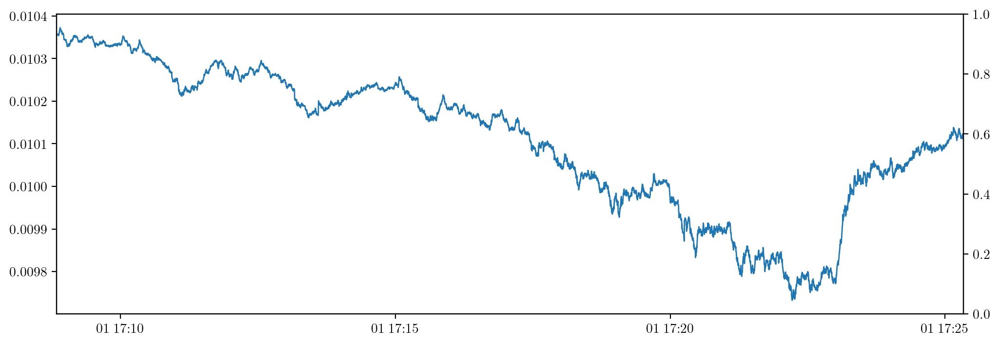

In [ ]:
weight_plot(497, weight=5000)

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def weight_plot(id, weight = 100):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()
    #scores = score(id, show_all=True)
    
    #vol = scores['volatility'][0] * 10**4
    #print(vol)

    #short = scores['short unweighted mom']/vol
    #long = scores['long unweighted mom']/1200 * vol
    short = fast_scoring(id, weight=weight)
    long = fast_scoring(id, weight = 2000)
    ax1.plot(short.rolling(50).mean(), c = 'g', alpha = 0.5)
    #ax1.plot(scores['score']/1200*vol, c = 'orange', alpha = 0.3)
    ax1.plot(long, c='b')
    ax1.axhline(0, c = 'black')
    ax1.plot(0.5 * (short.rolling(50).mean() + long).rolling(30).mean(), c = 'r')

4.008689351309597
4.008689351309597


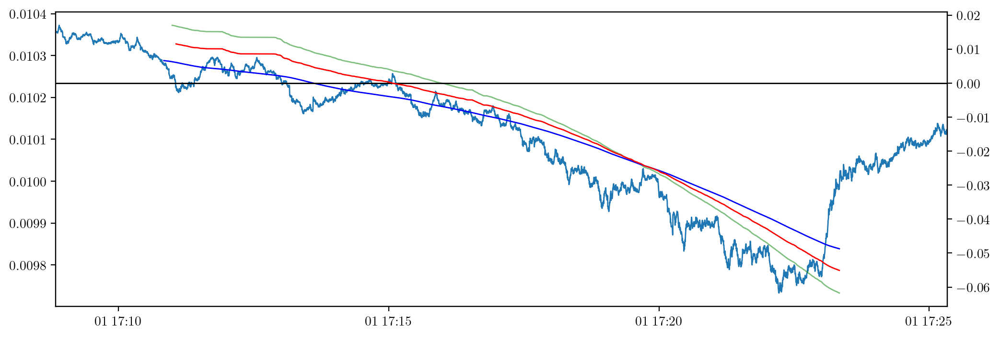

In [ ]:
weight_plot(497, weight=5000)

4.008689351309597
4.008689351309597


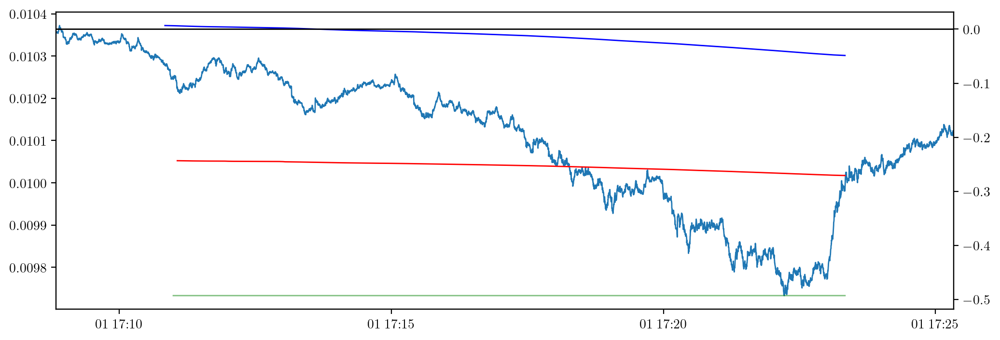

In [ ]:
weight_plot(497, weight=100)

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def weight_plot(id, weight = 100):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()
    #scores = score(id, show_all=True)
    
    #vol = scores['volatility'][0] * 10**4
    #print(vol)

    #short = scores['short unweighted mom']/vol
    #long = scores['long unweighted mom']/1200 * vol
    short = fast_scoring(id, weight=weight)
    long = fast_scoring(id, weight = weight)
    ax1.plot(short.rolling(50).mean(), c = 'g', alpha = 0.5)
    #ax1.plot(scores['score']/1200*vol, c = 'orange', alpha = 0.3)
    ax1.plot(long, c='b')
    ax1.axhline(0, c = 'black')
    ax1.plot(0.5 * (short.rolling(50).mean() + long).rolling(30).mean(), c = 'r')

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def weight_plot(id, weight = 100):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()
    #scores = score(id, show_all=True)
    
    #vol = scores['volatility'][0] * 10**4
    #print(vol)

    #short = scores['short unweighted mom']/vol
    #long = scores['long unweighted mom']/1200 * vol
    #short = fast_scoring(id, weight=weight)
    long = fast_scoring(id, weight = weight)
    ax1.plot(short.rolling(50).mean(), c = 'g', alpha = 0.5)
    #ax1.plot(scores['score']/1200*vol, c = 'orange', alpha = 0.3)
    ax1.plot(long, c='b')
    ax1.axhline(0, c = 'black')
    ax1.plot(0.5 * (short.rolling(50).mean() + long).rolling(30).mean(), c = 'r')

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def weight_plot(id, weight = 100):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()
    #scores = score(id, show_all=True)
    
    #vol = scores['volatility'][0] * 10**4
    #print(vol)

    #short = scores['short unweighted mom']/vol
    #long = scores['long unweighted mom']/1200 * vol
    short = fast_scoring(id, weight=weight)
    long = fast_scoring(id, weight = weight)
    ax1.plot(short.rolling(50).mean(), c = 'g', alpha = 0.5)
    #ax1.plot(scores['score']/1200*vol, c = 'orange', alpha = 0.3)
    ax1.plot(long, c='b')
    ax1.axhline(0, c = 'black')
    #ax1.plot(0.5 * (short.rolling(50).mean() + long).rolling(30).mean(), c = 'r')

4.008689351309597
4.008689351309597


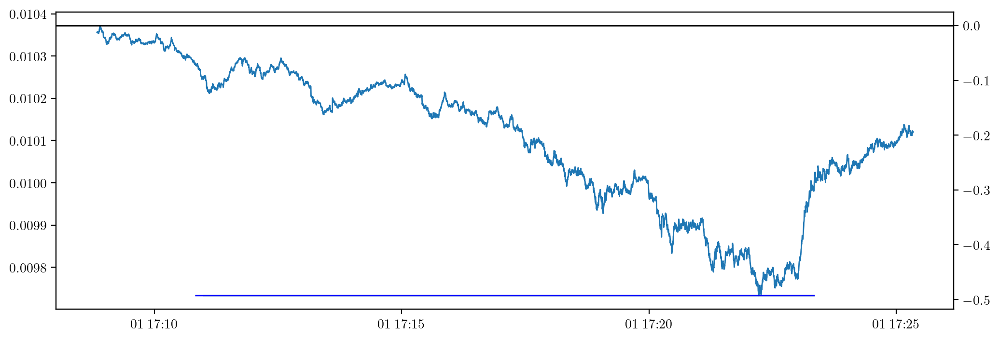

In [ ]:
weight_plot(497, weight=100)

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def weight_plot(id, weight = 100):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()
    #scores = score(id, show_all=True)
    
    #vol = scores['volatility'][0] * 10**4
    #print(vol)

    #short = scores['short unweighted mom']/vol
    #long = scores['long unweighted mom']/1200 * vol
    short = fast_scoring(id, weight=weight)
    long = fast_scoring(id, weight = weight)
    #ax1.plot(short.rolling(50).mean(), c = 'g', alpha = 0.5)
    #ax1.plot(scores['score']/1200*vol, c = 'orange', alpha = 0.3)
    ax1.plot(long, c='b')
    ax1.axhline(0, c = 'black')
    #ax1.plot(0.5 * (short.rolling(50).mean() + long).rolling(30).mean(), c = 'r')

4.008689351309597
4.008689351309597


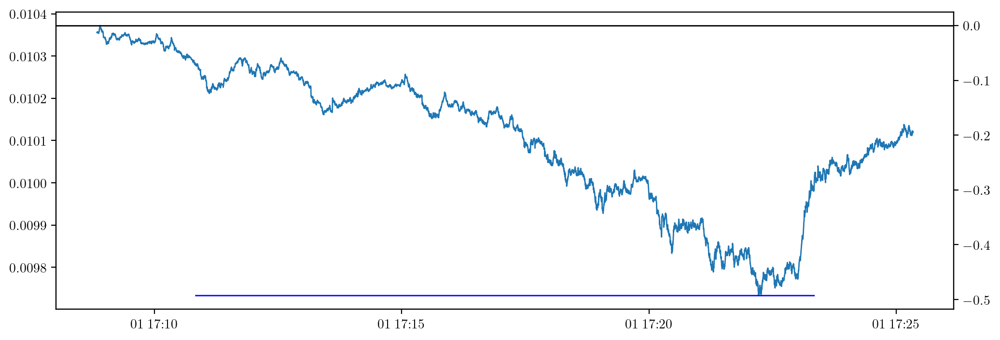

In [ ]:
weight_plot(497, weight=100)

In [ ]:
fast_scoring(497, 100)

4.008689351309597


timestamp
2024-10-01 17:10:50.200   -0.49286
2024-10-01 17:10:50.800   -0.49286
2024-10-01 17:10:51.100   -0.49286
2024-10-01 17:10:51.200   -0.49286
2024-10-01 17:10:51.300   -0.49286
                            ...   
2024-10-01 17:23:19.800   -0.49286
2024-10-01 17:23:19.900   -0.49286
2024-10-01 17:23:20.000   -0.49286
2024-10-01 17:23:20.100   -0.49286
2024-10-01 17:23:20.200   -0.49286
Length: 4313, dtype: float64

4.008689351309597


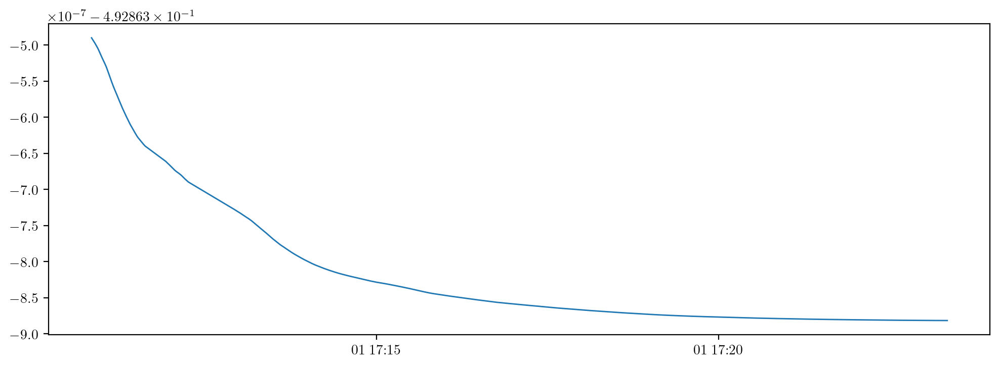

In [ ]:
plt.plot(fast_scoring(497, 100))

In [ ]:
from util_funcs import * 

max_len_id = 'case_4430_depth_trade.csv'
max_prop_id = 'case_2510_depth_trade.csv'

def momentum(id, time = 0, weight = 200, fixed_vol = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    t = pos_data.index[0] if time == 0 else time

    select = trade_data[:t]['ask_p1']
    times = select.index
    diff = trade_data['ask_p1'][t] - select
    tdiff = (times - t).to_numpy(dtype = 'float64')
        
    #   normalises time diff to be between 0 and 100 
    tdiff = -tdiff/tdiff[0]* 100
    gradient = (-diff/tdiff).dropna()

    vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
    if fixed_vol == True:
        vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
    #   normalises weighted mean correctly
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    #   returns momentum as sum of gradient * volume at time t * weighting
    #   where weighting exponentially decays; small weight = closer values weighted more
    return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const

def score(id, log = False, plot = False, show_all = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    def mmtm(time, weight, fixed_vol = False):
        select = trade_data[:time]['ask_p1'] 

        times = select.index

        diff = trade_data['ask_p1'][time] - select
        tdiff = (times - time).to_numpy(dtype = 'float64')
        
        #   normalises time diff to be between 0 and 100 
        tdiff = -tdiff/tdiff[0]* 100
        gradient = (-diff/tdiff).dropna()

        vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
        if fixed_vol == True:
            vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
        #   normalises weighted mean correctly
        norm_const = weight/10 *(1-np.exp(-1000/weight))

        #   returns momentum as sum of gradient * volume at time t * weighting
        #   where weighting exponentially decays; small weight = closer values weighted more
        return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const
    
    pre_short_mom = np.array([mmtm(t, 200) for t in pos_data.index])
    pre_long_mom = np.array([mmtm(t, 100000) for t in pos_data.index])
    pre_short_mom_unweighted = np.array([mmtm(t, 200, fixed_vol=True) for t in pos_data.index])
    pre_long_mom_unweighted = np.array([mmtm(t, 100000, fixed_vol=True) for t in pos_data.index])
    
    if plot == True:
        fig, ax = plt.subplots()
        ax.plot(pos_data.index, pre_short_mom, label = 'short mom')
        ax.plot(pos_data.index, pre_long_mom, label = 'long mom')
        ax.plot(pos_data.index, pre_short_mom_unweighted, label = 'short unw mom')
        ax.plot(pos_data.index, pre_long_mom_unweighted, label = 'long unw mom')
        ax.set(xmargin = 0, title = 'Momentum score at buy times')
        ax.grid()
        ax.legend()

    mean_vol = 1/2*(np.mean(trade_data['ask_tt_volume']) + np.mean(trade_data['bid_tt_volume']))
    
    #   note that momentum approx. is linear with mean volume, so maybe consider normalising if we don't care about trade volume as much? 
    volatility = np.std(returns)
    if log == True:
        volatility = np.log(volatility * 10**5) * 100
    
    if show_all == True:
        #   calculate overall momentum score, weighting long term momentum more; essentially this is 3 parts long momentum 1 part short momentum (unweighted, since weighted short fluctuates like crazy) 
        mom_rms = 1/6 * np.sqrt(abs(np.sign(pre_short_mom)*pre_short_mom**2 + 2* np.sign(pre_long_mom)*pre_long_mom**2 + 2* np.sign(pre_long_mom_unweighted)*pre_long_mom_unweighted**2 + np.sign(pre_short_mom_unweighted) * pre_short_mom_unweighted**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(pre_long_mom_unweighted) * mom_rms / (1000*volatility)

        n = len(pos_data.index)
        df = pd.DataFrame(data = np.array([wghted_score, mean_vol * np.ones(n), volatility * np.ones(n), pre_short_mom, pre_long_mom, pre_short_mom_unweighted, pre_long_mom_unweighted]).transpose(), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = pos_data.index)
        
        return df
    else: 
        short_mom = np.mean(pre_short_mom)
        long_mom = np.mean(pre_long_mom)
        unwghted_short_mom = np.mean(pre_short_mom_unweighted)
        unwghted_long_mom = np.mean(pre_long_mom_unweighted)

        mom_rms = 1/6 * np.sqrt(abs(np.sign(short_mom)*short_mom**2 + 2* np.sign(long_mom)*long_mom**2 + 2* np.sign(unwghted_long_mom)*unwghted_long_mom**2 + np.sign(unwghted_short_mom) * unwghted_short_mom**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(unwghted_long_mom) * mom_rms / (1000*volatility)

        df = pd.DataFrame(data = np.array([wghted_score, mean_vol, volatility, short_mom, long_mom, unwghted_short_mom, unwghted_long_mom]).reshape(1, 7), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = [td[id][5:-16]])
        
        return df

def fast_scoring(id, weight = 100):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    times = pos_data.index
    start = trade_data.index[0]
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    vol = 10 **8 * np.var(get_returns(td[id]))
    grad_scale = trade_data['bid_p1'][times[0]] - trade_data['bid_p1'].values[0]
    print(vol)
    select = lambda t: trade_data['bid_p1'][start:t]
    def score(t):
        s = select(t)
        s_ind = (s.index - s.index[0]).to_numpy(dtype = 'float64')/(10**10)
        grad = -(s - s[0])[1:]/(s_ind[1:] * (grad_scale))
        #return np.mean(grad)
        return np.sum(grad * np.exp(-10 * (s_ind)[1:]/weight))/norm_const

    return pd.Series(data=[score(t) for t in times], index=times)/(np.sqrt(vol))
    
all_scores = pd.read_csv('files/scored_cases.csv')


#   analysis / diagnostics
def plot_score_vol_cor():
    res = sp.stats.linregress(all_scores['score'], all_scores['mean volume'])
    x = np.linspace(-400,100)
    fig, ax = plt.subplots()
    ax.scatter(all_scores['score'], all_scores['mean volume'], s= 2, label = 'score vs mean volume')
    ax.plot(x, res.intercept - 30000 + res.slope*x, 'g', label = '(intercept adjusted) linear regression on score vs mean volume')
    ax.set(xlim = [-400, 100], ylim = [0, 200000], xlabel = 'score', ylabel = 'mean volume')
    ax.legend(loc = 'lower left')

corr = np.corrcoef(all_scores['score'], all_scores['mean volume'])
#   correlation between them is approx -0.4, pretty sufficiently negatively correlated between score and mean vol

def pnl_by_thres(upper = -200.0, scoring = 'vol'):
    scoring_systems = {'log': 'log vol score', 'no_vol':'no vol score', 'vol': 'score'}
    score = scoring_systems[scoring]
    tradeid = all_scores[all_scores[score] <= upper]['id']
    res = np.zeros((len(pos), 5))
    print(len(tradeid))
    for i in tqdm(tradeid):
        j = int(str(i)[:-1]) if i != 0 else 0
        res[j, :] = pnl_fast(to_df(pos[j]), to_df(td[j]), 1000)
    
    pos_id = [x[5:-8] for x in pos]
    df_res = pd.DataFrame(data = res, index = pos_id, columns = ['profit', 'loss', 'net', 'avg bid', 'avg ask'])
    winrate = len(df_res[df_res['net'] > 0].index)/len(tradeid)
    df_res = df_res[df_res != 0].dropna()
    
    prof_given_w = np.mean(df_res[df_res['net']>0]['net'])
    loss_given_l = np.mean(df_res[df_res['net']<0]['net'])

    pnl = -prof_given_w/loss_given_l

    print(winrate, pnl)
    return df_res.dropna()

def vol_ratio(id):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_before = np.std(data[:start])
    vol_after = np.std(data[start:])

    return vol_after/vol_before

def est_vol(id, n):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_after = np.std(data[start:])
    vol_est = np.std(data[start:][:n])

    return vol_est/vol_after - 1

def plot_price_rolling_c(id, n):
    data = dev_from_rolling_price(td[id], n)

    price = data['price'][n-1:]
    rolling = data['rolling_mean'].dropna()
    gradient = rolling.values[1:]/rolling.values[:-1] * 10
    time = price.index

    fig, (ax, ax1) = plt.subplots(nrows = 2)
    ax.plot(time, price, label = 'price')
    ax.plot(time, rolling, label = 'rolling (n = {0})'.format(n))
    ax1.plot(time[1:], gradient, label = 'gradient')
    ax.set(xmargin = 0, title = 'price and rolling price')
    ax1.set(xmargin=0, title = 'gradient')
    ax.legend()
    ax1.legend()

def pre_vol(id, start = True):
    data = get_returns(td[id])
    start = to_df(pos[id]).index[0] if start == True else to_df(pos[id]).index[-1] 
    return np.std(data[:start])

def plot_price_rolling_diff(id):
    data = dev_from_rolling_price(td[id])
    price_diffs = data['price'].values[499:] - data['price'].values[:-499]
    means = data['diff'].dropna().rolling(500, center=True).mean().dropna()

    price_diffs_centred = price_diffs - price_diffs.mean()
    diff = data.dropna()['diff']
    diff_centred = diff - diff.mean()
    scale = price_diffs @ diff_centred / (diff_centred @ diff_centred)
    print(scale,  price_diffs.mean(),  1.5 * diff.mean())

    fig, ax = plt.subplots()
    ax.set(xmargin = 0)

    ax.plot(data.dropna().index, price_diffs)
    ax.plot(data.dropna().index, 1.5 * diff_centred, c = 'g')
    ax.plot(data.dropna().index, abs(price_diffs - 1.5 * diff_centred), c = 'r')
    ax.axhline(0, c = 'black')
    #ax.plot(data.dropna().index[250:-249], scale * means,)
    #ax.plot(data.dropna().index[250:-249], price_diffs[250:-249] - scale*means)

4.008689351309597


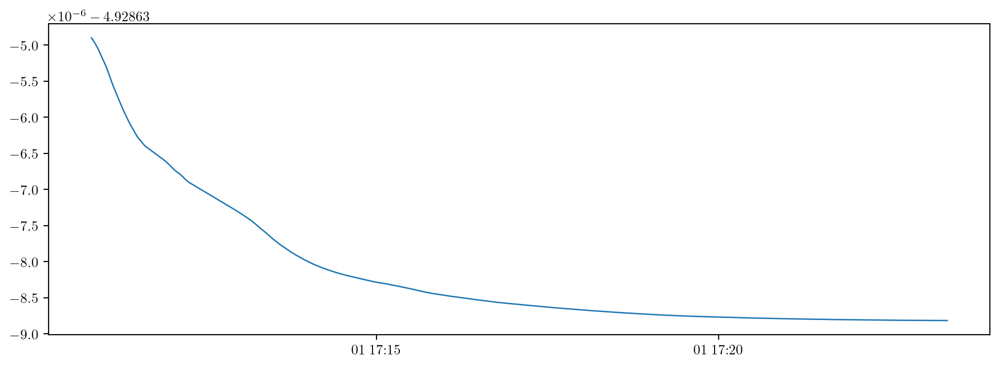

In [ ]:
plt.plot(fast_scoring(497, 100))

In [ ]:
from util_funcs import * 

max_len_id = 'case_4430_depth_trade.csv'
max_prop_id = 'case_2510_depth_trade.csv'

def momentum(id, time = 0, weight = 200, fixed_vol = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    t = pos_data.index[0] if time == 0 else time

    select = trade_data[:t]['ask_p1']
    times = select.index
    diff = trade_data['ask_p1'][t] - select
    tdiff = (times - t).to_numpy(dtype = 'float64')
        
    #   normalises time diff to be between 0 and 100 
    tdiff = -tdiff/tdiff[0]* 100
    gradient = (-diff/tdiff).dropna()

    vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
    if fixed_vol == True:
        vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
    #   normalises weighted mean correctly
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    #   returns momentum as sum of gradient * volume at time t * weighting
    #   where weighting exponentially decays; small weight = closer values weighted more
    return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const

def score(id, log = False, plot = False, show_all = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    def mmtm(time, weight, fixed_vol = False):
        select = trade_data[:time]['ask_p1'] 

        times = select.index

        diff = trade_data['ask_p1'][time] - select
        tdiff = (times - time).to_numpy(dtype = 'float64')
        
        #   normalises time diff to be between 0 and 100 
        tdiff = -tdiff/tdiff[0]* 100
        gradient = (-diff/tdiff).dropna()

        vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
        if fixed_vol == True:
            vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
        #   normalises weighted mean correctly
        norm_const = weight/10 *(1-np.exp(-1000/weight))

        #   returns momentum as sum of gradient * volume at time t * weighting
        #   where weighting exponentially decays; small weight = closer values weighted more
        return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const
    
    pre_short_mom = np.array([mmtm(t, 200) for t in pos_data.index])
    pre_long_mom = np.array([mmtm(t, 100000) for t in pos_data.index])
    pre_short_mom_unweighted = np.array([mmtm(t, 200, fixed_vol=True) for t in pos_data.index])
    pre_long_mom_unweighted = np.array([mmtm(t, 100000, fixed_vol=True) for t in pos_data.index])
    
    if plot == True:
        fig, ax = plt.subplots()
        ax.plot(pos_data.index, pre_short_mom, label = 'short mom')
        ax.plot(pos_data.index, pre_long_mom, label = 'long mom')
        ax.plot(pos_data.index, pre_short_mom_unweighted, label = 'short unw mom')
        ax.plot(pos_data.index, pre_long_mom_unweighted, label = 'long unw mom')
        ax.set(xmargin = 0, title = 'Momentum score at buy times')
        ax.grid()
        ax.legend()

    mean_vol = 1/2*(np.mean(trade_data['ask_tt_volume']) + np.mean(trade_data['bid_tt_volume']))
    
    #   note that momentum approx. is linear with mean volume, so maybe consider normalising if we don't care about trade volume as much? 
    volatility = np.std(returns)
    if log == True:
        volatility = np.log(volatility * 10**5) * 100
    
    if show_all == True:
        #   calculate overall momentum score, weighting long term momentum more; essentially this is 3 parts long momentum 1 part short momentum (unweighted, since weighted short fluctuates like crazy) 
        mom_rms = 1/6 * np.sqrt(abs(np.sign(pre_short_mom)*pre_short_mom**2 + 2* np.sign(pre_long_mom)*pre_long_mom**2 + 2* np.sign(pre_long_mom_unweighted)*pre_long_mom_unweighted**2 + np.sign(pre_short_mom_unweighted) * pre_short_mom_unweighted**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(pre_long_mom_unweighted) * mom_rms / (1000*volatility)

        n = len(pos_data.index)
        df = pd.DataFrame(data = np.array([wghted_score, mean_vol * np.ones(n), volatility * np.ones(n), pre_short_mom, pre_long_mom, pre_short_mom_unweighted, pre_long_mom_unweighted]).transpose(), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = pos_data.index)
        
        return df
    else: 
        short_mom = np.mean(pre_short_mom)
        long_mom = np.mean(pre_long_mom)
        unwghted_short_mom = np.mean(pre_short_mom_unweighted)
        unwghted_long_mom = np.mean(pre_long_mom_unweighted)

        mom_rms = 1/6 * np.sqrt(abs(np.sign(short_mom)*short_mom**2 + 2* np.sign(long_mom)*long_mom**2 + 2* np.sign(unwghted_long_mom)*unwghted_long_mom**2 + np.sign(unwghted_short_mom) * unwghted_short_mom**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(unwghted_long_mom) * mom_rms / (1000*volatility)

        df = pd.DataFrame(data = np.array([wghted_score, mean_vol, volatility, short_mom, long_mom, unwghted_short_mom, unwghted_long_mom]).reshape(1, 7), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = [td[id][5:-16]])
        
        return df

def fast_scoring(id, weight = 100):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    times = pos_data.index
    start = trade_data.index[0]
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    vol = 10 **8 * np.var(get_returns(td[id]))
    grad_scale = trade_data['bid_p1'][times[0]] - trade_data['bid_p1'].values[0]
    print(vol, norm_const)
    select = lambda t: trade_data['bid_p1'][start:t]
    def score(t):
        s = select(t)
        s_ind = (s.index - s.index[0]).to_numpy(dtype = 'float64')/(10**10)
        grad = -(s - s[0])[1:]/(s_ind[1:] * (grad_scale))
        #return np.mean(grad)
        return np.sum(grad * np.exp(-10 * (s_ind)[1:]/weight))/norm_const

    return pd.Series(data=[score(t) for t in times], index=times)/(np.sqrt(vol))
    
all_scores = pd.read_csv('files/scored_cases.csv')


#   analysis / diagnostics
def plot_score_vol_cor():
    res = sp.stats.linregress(all_scores['score'], all_scores['mean volume'])
    x = np.linspace(-400,100)
    fig, ax = plt.subplots()
    ax.scatter(all_scores['score'], all_scores['mean volume'], s= 2, label = 'score vs mean volume')
    ax.plot(x, res.intercept - 30000 + res.slope*x, 'g', label = '(intercept adjusted) linear regression on score vs mean volume')
    ax.set(xlim = [-400, 100], ylim = [0, 200000], xlabel = 'score', ylabel = 'mean volume')
    ax.legend(loc = 'lower left')

corr = np.corrcoef(all_scores['score'], all_scores['mean volume'])
#   correlation between them is approx -0.4, pretty sufficiently negatively correlated between score and mean vol

def pnl_by_thres(upper = -200.0, scoring = 'vol'):
    scoring_systems = {'log': 'log vol score', 'no_vol':'no vol score', 'vol': 'score'}
    score = scoring_systems[scoring]
    tradeid = all_scores[all_scores[score] <= upper]['id']
    res = np.zeros((len(pos), 5))
    print(len(tradeid))
    for i in tqdm(tradeid):
        j = int(str(i)[:-1]) if i != 0 else 0
        res[j, :] = pnl_fast(to_df(pos[j]), to_df(td[j]), 1000)
    
    pos_id = [x[5:-8] for x in pos]
    df_res = pd.DataFrame(data = res, index = pos_id, columns = ['profit', 'loss', 'net', 'avg bid', 'avg ask'])
    winrate = len(df_res[df_res['net'] > 0].index)/len(tradeid)
    df_res = df_res[df_res != 0].dropna()
    
    prof_given_w = np.mean(df_res[df_res['net']>0]['net'])
    loss_given_l = np.mean(df_res[df_res['net']<0]['net'])

    pnl = -prof_given_w/loss_given_l

    print(winrate, pnl)
    return df_res.dropna()

def vol_ratio(id):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_before = np.std(data[:start])
    vol_after = np.std(data[start:])

    return vol_after/vol_before

def est_vol(id, n):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_after = np.std(data[start:])
    vol_est = np.std(data[start:][:n])

    return vol_est/vol_after - 1

def plot_price_rolling_c(id, n):
    data = dev_from_rolling_price(td[id], n)

    price = data['price'][n-1:]
    rolling = data['rolling_mean'].dropna()
    gradient = rolling.values[1:]/rolling.values[:-1] * 10
    time = price.index

    fig, (ax, ax1) = plt.subplots(nrows = 2)
    ax.plot(time, price, label = 'price')
    ax.plot(time, rolling, label = 'rolling (n = {0})'.format(n))
    ax1.plot(time[1:], gradient, label = 'gradient')
    ax.set(xmargin = 0, title = 'price and rolling price')
    ax1.set(xmargin=0, title = 'gradient')
    ax.legend()
    ax1.legend()

def pre_vol(id, start = True):
    data = get_returns(td[id])
    start = to_df(pos[id]).index[0] if start == True else to_df(pos[id]).index[-1] 
    return np.std(data[:start])

def plot_price_rolling_diff(id):
    data = dev_from_rolling_price(td[id])
    price_diffs = data['price'].values[499:] - data['price'].values[:-499]
    means = data['diff'].dropna().rolling(500, center=True).mean().dropna()

    price_diffs_centred = price_diffs - price_diffs.mean()
    diff = data.dropna()['diff']
    diff_centred = diff - diff.mean()
    scale = price_diffs @ diff_centred / (diff_centred @ diff_centred)
    print(scale,  price_diffs.mean(),  1.5 * diff.mean())

    fig, ax = plt.subplots()
    ax.set(xmargin = 0)

    ax.plot(data.dropna().index, price_diffs)
    ax.plot(data.dropna().index, 1.5 * diff_centred, c = 'g')
    ax.plot(data.dropna().index, abs(price_diffs - 1.5 * diff_centred), c = 'r')
    ax.axhline(0, c = 'black')
    #ax.plot(data.dropna().index[250:-249], scale * means,)
    #ax.plot(data.dropna().index[250:-249], price_diffs[250:-249] - scale*means)

4.008689351309597 9.999546000702376


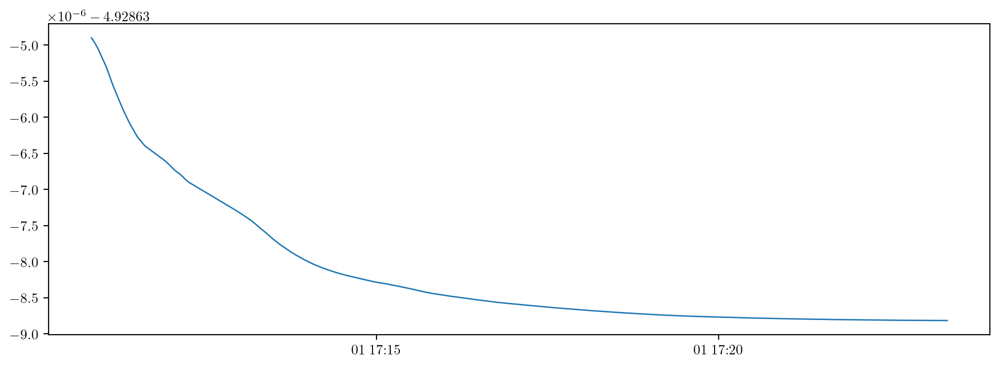

In [ ]:
plt.plot(fast_scoring(497, 100))

In [ ]:
from util_funcs import * 

max_len_id = 'case_4430_depth_trade.csv'
max_prop_id = 'case_2510_depth_trade.csv'

def momentum(id, time = 0, weight = 200, fixed_vol = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    t = pos_data.index[0] if time == 0 else time

    select = trade_data[:t]['ask_p1']
    times = select.index
    diff = trade_data['ask_p1'][t] - select
    tdiff = (times - t).to_numpy(dtype = 'float64')
        
    #   normalises time diff to be between 0 and 100 
    tdiff = -tdiff/tdiff[0]* 100
    gradient = (-diff/tdiff).dropna()

    vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
    if fixed_vol == True:
        vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
    #   normalises weighted mean correctly
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    #   returns momentum as sum of gradient * volume at time t * weighting
    #   where weighting exponentially decays; small weight = closer values weighted more
    return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const

def score(id, log = False, plot = False, show_all = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    def mmtm(time, weight, fixed_vol = False):
        select = trade_data[:time]['ask_p1'] 

        times = select.index

        diff = trade_data['ask_p1'][time] - select
        tdiff = (times - time).to_numpy(dtype = 'float64')
        
        #   normalises time diff to be between 0 and 100 
        tdiff = -tdiff/tdiff[0]* 100
        gradient = (-diff/tdiff).dropna()

        vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
        if fixed_vol == True:
            vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
        #   normalises weighted mean correctly
        norm_const = weight/10 *(1-np.exp(-1000/weight))

        #   returns momentum as sum of gradient * volume at time t * weighting
        #   where weighting exponentially decays; small weight = closer values weighted more
        return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const
    
    pre_short_mom = np.array([mmtm(t, 200) for t in pos_data.index])
    pre_long_mom = np.array([mmtm(t, 100000) for t in pos_data.index])
    pre_short_mom_unweighted = np.array([mmtm(t, 200, fixed_vol=True) for t in pos_data.index])
    pre_long_mom_unweighted = np.array([mmtm(t, 100000, fixed_vol=True) for t in pos_data.index])
    
    if plot == True:
        fig, ax = plt.subplots()
        ax.plot(pos_data.index, pre_short_mom, label = 'short mom')
        ax.plot(pos_data.index, pre_long_mom, label = 'long mom')
        ax.plot(pos_data.index, pre_short_mom_unweighted, label = 'short unw mom')
        ax.plot(pos_data.index, pre_long_mom_unweighted, label = 'long unw mom')
        ax.set(xmargin = 0, title = 'Momentum score at buy times')
        ax.grid()
        ax.legend()

    mean_vol = 1/2*(np.mean(trade_data['ask_tt_volume']) + np.mean(trade_data['bid_tt_volume']))
    
    #   note that momentum approx. is linear with mean volume, so maybe consider normalising if we don't care about trade volume as much? 
    volatility = np.std(returns)
    if log == True:
        volatility = np.log(volatility * 10**5) * 100
    
    if show_all == True:
        #   calculate overall momentum score, weighting long term momentum more; essentially this is 3 parts long momentum 1 part short momentum (unweighted, since weighted short fluctuates like crazy) 
        mom_rms = 1/6 * np.sqrt(abs(np.sign(pre_short_mom)*pre_short_mom**2 + 2* np.sign(pre_long_mom)*pre_long_mom**2 + 2* np.sign(pre_long_mom_unweighted)*pre_long_mom_unweighted**2 + np.sign(pre_short_mom_unweighted) * pre_short_mom_unweighted**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(pre_long_mom_unweighted) * mom_rms / (1000*volatility)

        n = len(pos_data.index)
        df = pd.DataFrame(data = np.array([wghted_score, mean_vol * np.ones(n), volatility * np.ones(n), pre_short_mom, pre_long_mom, pre_short_mom_unweighted, pre_long_mom_unweighted]).transpose(), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = pos_data.index)
        
        return df
    else: 
        short_mom = np.mean(pre_short_mom)
        long_mom = np.mean(pre_long_mom)
        unwghted_short_mom = np.mean(pre_short_mom_unweighted)
        unwghted_long_mom = np.mean(pre_long_mom_unweighted)

        mom_rms = 1/6 * np.sqrt(abs(np.sign(short_mom)*short_mom**2 + 2* np.sign(long_mom)*long_mom**2 + 2* np.sign(unwghted_long_mom)*unwghted_long_mom**2 + np.sign(unwghted_short_mom) * unwghted_short_mom**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(unwghted_long_mom) * mom_rms / (1000*volatility)

        df = pd.DataFrame(data = np.array([wghted_score, mean_vol, volatility, short_mom, long_mom, unwghted_short_mom, unwghted_long_mom]).reshape(1, 7), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = [td[id][5:-16]])
        
        return df

def fast_scoring(id, weight = 100):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    times = pos_data.index
    start = trade_data.index[0]
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    vol = 10 **8 * np.var(get_returns(td[id]))
    grad_scale = trade_data['bid_p1'][times[0]] - trade_data['bid_p1'].values[0]
    print(vol, norm_const)
    select = lambda t: trade_data['bid_p1'][start:t]
    def score(t):
        s = select(t)
        s_ind = (s.index - s.index[0]).to_numpy(dtype = 'float64')/(10**10)
        grad = -(s - s[0])[1:]/(s_ind[1:] * (grad_scale))
        #return np.mean(grad)
        return np.sum(grad * np.exp(-10 * (s_ind)[1:]/weight))/norm_const

    return pd.Series(data=[10**7 * score(t) for t in times], index=times)/(np.sqrt(vol))
    
all_scores = pd.read_csv('files/scored_cases.csv')


#   analysis / diagnostics
def plot_score_vol_cor():
    res = sp.stats.linregress(all_scores['score'], all_scores['mean volume'])
    x = np.linspace(-400,100)
    fig, ax = plt.subplots()
    ax.scatter(all_scores['score'], all_scores['mean volume'], s= 2, label = 'score vs mean volume')
    ax.plot(x, res.intercept - 30000 + res.slope*x, 'g', label = '(intercept adjusted) linear regression on score vs mean volume')
    ax.set(xlim = [-400, 100], ylim = [0, 200000], xlabel = 'score', ylabel = 'mean volume')
    ax.legend(loc = 'lower left')

corr = np.corrcoef(all_scores['score'], all_scores['mean volume'])
#   correlation between them is approx -0.4, pretty sufficiently negatively correlated between score and mean vol

def pnl_by_thres(upper = -200.0, scoring = 'vol'):
    scoring_systems = {'log': 'log vol score', 'no_vol':'no vol score', 'vol': 'score'}
    score = scoring_systems[scoring]
    tradeid = all_scores[all_scores[score] <= upper]['id']
    res = np.zeros((len(pos), 5))
    print(len(tradeid))
    for i in tqdm(tradeid):
        j = int(str(i)[:-1]) if i != 0 else 0
        res[j, :] = pnl_fast(to_df(pos[j]), to_df(td[j]), 1000)
    
    pos_id = [x[5:-8] for x in pos]
    df_res = pd.DataFrame(data = res, index = pos_id, columns = ['profit', 'loss', 'net', 'avg bid', 'avg ask'])
    winrate = len(df_res[df_res['net'] > 0].index)/len(tradeid)
    df_res = df_res[df_res != 0].dropna()
    
    prof_given_w = np.mean(df_res[df_res['net']>0]['net'])
    loss_given_l = np.mean(df_res[df_res['net']<0]['net'])

    pnl = -prof_given_w/loss_given_l

    print(winrate, pnl)
    return df_res.dropna()

def vol_ratio(id):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_before = np.std(data[:start])
    vol_after = np.std(data[start:])

    return vol_after/vol_before

def est_vol(id, n):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_after = np.std(data[start:])
    vol_est = np.std(data[start:][:n])

    return vol_est/vol_after - 1

def plot_price_rolling_c(id, n):
    data = dev_from_rolling_price(td[id], n)

    price = data['price'][n-1:]
    rolling = data['rolling_mean'].dropna()
    gradient = rolling.values[1:]/rolling.values[:-1] * 10
    time = price.index

    fig, (ax, ax1) = plt.subplots(nrows = 2)
    ax.plot(time, price, label = 'price')
    ax.plot(time, rolling, label = 'rolling (n = {0})'.format(n))
    ax1.plot(time[1:], gradient, label = 'gradient')
    ax.set(xmargin = 0, title = 'price and rolling price')
    ax1.set(xmargin=0, title = 'gradient')
    ax.legend()
    ax1.legend()

def pre_vol(id, start = True):
    data = get_returns(td[id])
    start = to_df(pos[id]).index[0] if start == True else to_df(pos[id]).index[-1] 
    return np.std(data[:start])

def plot_price_rolling_diff(id):
    data = dev_from_rolling_price(td[id])
    price_diffs = data['price'].values[499:] - data['price'].values[:-499]
    means = data['diff'].dropna().rolling(500, center=True).mean().dropna()

    price_diffs_centred = price_diffs - price_diffs.mean()
    diff = data.dropna()['diff']
    diff_centred = diff - diff.mean()
    scale = price_diffs @ diff_centred / (diff_centred @ diff_centred)
    print(scale,  price_diffs.mean(),  1.5 * diff.mean())

    fig, ax = plt.subplots()
    ax.set(xmargin = 0)

    ax.plot(data.dropna().index, price_diffs)
    ax.plot(data.dropna().index, 1.5 * diff_centred, c = 'g')
    ax.plot(data.dropna().index, abs(price_diffs - 1.5 * diff_centred), c = 'r')
    ax.axhline(0, c = 'black')
    #ax.plot(data.dropna().index[250:-249], scale * means,)
    #ax.plot(data.dropna().index[250:-249], price_diffs[250:-249] - scale*means)

4.008689351309597 9.999546000702376


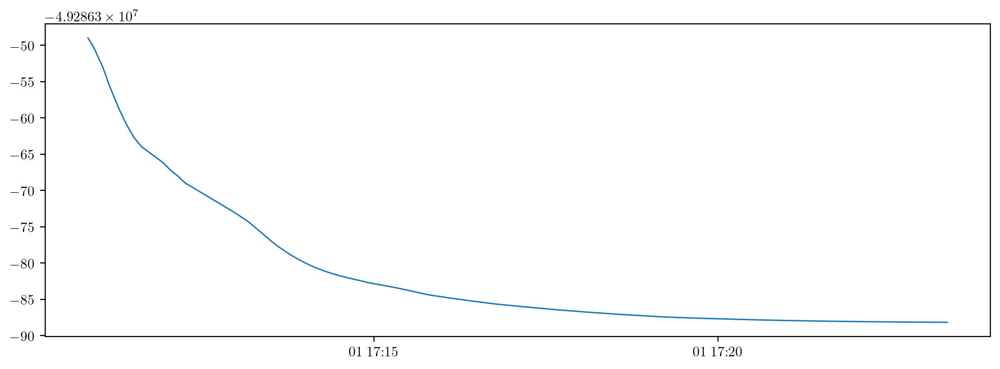

In [ ]:
plt.plot(fast_scoring(497, 100))

In [ ]:
from util_funcs import * 

max_len_id = 'case_4430_depth_trade.csv'
max_prop_id = 'case_2510_depth_trade.csv'

def momentum(id, time = 0, weight = 200, fixed_vol = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    t = pos_data.index[0] if time == 0 else time

    select = trade_data[:t]['ask_p1']
    times = select.index
    diff = trade_data['ask_p1'][t] - select
    tdiff = (times - t).to_numpy(dtype = 'float64')
        
    #   normalises time diff to be between 0 and 100 
    tdiff = -tdiff/tdiff[0]* 100
    gradient = (-diff/tdiff).dropna()

    vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
    if fixed_vol == True:
        vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
    #   normalises weighted mean correctly
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    #   returns momentum as sum of gradient * volume at time t * weighting
    #   where weighting exponentially decays; small weight = closer values weighted more
    return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const

def score(id, log = False, plot = False, show_all = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    def mmtm(time, weight, fixed_vol = False):
        select = trade_data[:time]['ask_p1'] 

        times = select.index

        diff = trade_data['ask_p1'][time] - select
        tdiff = (times - time).to_numpy(dtype = 'float64')
        
        #   normalises time diff to be between 0 and 100 
        tdiff = -tdiff/tdiff[0]* 100
        gradient = (-diff/tdiff).dropna()

        vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
        if fixed_vol == True:
            vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
        #   normalises weighted mean correctly
        norm_const = weight/10 *(1-np.exp(-1000/weight))

        #   returns momentum as sum of gradient * volume at time t * weighting
        #   where weighting exponentially decays; small weight = closer values weighted more
        return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const
    
    pre_short_mom = np.array([mmtm(t, 200) for t in pos_data.index])
    pre_long_mom = np.array([mmtm(t, 100000) for t in pos_data.index])
    pre_short_mom_unweighted = np.array([mmtm(t, 200, fixed_vol=True) for t in pos_data.index])
    pre_long_mom_unweighted = np.array([mmtm(t, 100000, fixed_vol=True) for t in pos_data.index])
    
    if plot == True:
        fig, ax = plt.subplots()
        ax.plot(pos_data.index, pre_short_mom, label = 'short mom')
        ax.plot(pos_data.index, pre_long_mom, label = 'long mom')
        ax.plot(pos_data.index, pre_short_mom_unweighted, label = 'short unw mom')
        ax.plot(pos_data.index, pre_long_mom_unweighted, label = 'long unw mom')
        ax.set(xmargin = 0, title = 'Momentum score at buy times')
        ax.grid()
        ax.legend()

    mean_vol = 1/2*(np.mean(trade_data['ask_tt_volume']) + np.mean(trade_data['bid_tt_volume']))
    
    #   note that momentum approx. is linear with mean volume, so maybe consider normalising if we don't care about trade volume as much? 
    volatility = np.std(returns)
    if log == True:
        volatility = np.log(volatility * 10**5) * 100
    
    if show_all == True:
        #   calculate overall momentum score, weighting long term momentum more; essentially this is 3 parts long momentum 1 part short momentum (unweighted, since weighted short fluctuates like crazy) 
        mom_rms = 1/6 * np.sqrt(abs(np.sign(pre_short_mom)*pre_short_mom**2 + 2* np.sign(pre_long_mom)*pre_long_mom**2 + 2* np.sign(pre_long_mom_unweighted)*pre_long_mom_unweighted**2 + np.sign(pre_short_mom_unweighted) * pre_short_mom_unweighted**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(pre_long_mom_unweighted) * mom_rms / (1000*volatility)

        n = len(pos_data.index)
        df = pd.DataFrame(data = np.array([wghted_score, mean_vol * np.ones(n), volatility * np.ones(n), pre_short_mom, pre_long_mom, pre_short_mom_unweighted, pre_long_mom_unweighted]).transpose(), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = pos_data.index)
        
        return df
    else: 
        short_mom = np.mean(pre_short_mom)
        long_mom = np.mean(pre_long_mom)
        unwghted_short_mom = np.mean(pre_short_mom_unweighted)
        unwghted_long_mom = np.mean(pre_long_mom_unweighted)

        mom_rms = 1/6 * np.sqrt(abs(np.sign(short_mom)*short_mom**2 + 2* np.sign(long_mom)*long_mom**2 + 2* np.sign(unwghted_long_mom)*unwghted_long_mom**2 + np.sign(unwghted_short_mom) * unwghted_short_mom**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(unwghted_long_mom) * mom_rms / (1000*volatility)

        df = pd.DataFrame(data = np.array([wghted_score, mean_vol, volatility, short_mom, long_mom, unwghted_short_mom, unwghted_long_mom]).reshape(1, 7), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = [td[id][5:-16]])
        
        return df

def fast_scoring(id, weight = 100):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    times = pos_data.index
    start = trade_data.index[0]
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    vol = 10 **8 * np.var(get_returns(td[id]))
    grad_scale = trade_data['bid_p1'][times[0]] - trade_data['bid_p1'].values[0]
    print(vol, norm_const)
    select = lambda t: trade_data['bid_p1'][start:t]
    def score(t):
        s = select(t)
        s_ind = (s.index - s.index[0]).to_numpy(dtype = 'float64')/(10**10)
        grad = -(s - s[0])[1:]/(s_ind[1:] * (grad_scale))
        #return np.mean(grad)
        return np.sum(grad * np.exp(-10 * (s_ind)[1:]/weight))/norm_const

    return pd.Series(data=[score(t) for t in times], index=times)/(np.sqrt(vol))
    
all_scores = pd.read_csv('files/scored_cases.csv')


#   analysis / diagnostics
def plot_score_vol_cor():
    res = sp.stats.linregress(all_scores['score'], all_scores['mean volume'])
    x = np.linspace(-400,100)
    fig, ax = plt.subplots()
    ax.scatter(all_scores['score'], all_scores['mean volume'], s= 2, label = 'score vs mean volume')
    ax.plot(x, res.intercept - 30000 + res.slope*x, 'g', label = '(intercept adjusted) linear regression on score vs mean volume')
    ax.set(xlim = [-400, 100], ylim = [0, 200000], xlabel = 'score', ylabel = 'mean volume')
    ax.legend(loc = 'lower left')

corr = np.corrcoef(all_scores['score'], all_scores['mean volume'])
#   correlation between them is approx -0.4, pretty sufficiently negatively correlated between score and mean vol

def pnl_by_thres(upper = -200.0, scoring = 'vol'):
    scoring_systems = {'log': 'log vol score', 'no_vol':'no vol score', 'vol': 'score'}
    score = scoring_systems[scoring]
    tradeid = all_scores[all_scores[score] <= upper]['id']
    res = np.zeros((len(pos), 5))
    print(len(tradeid))
    for i in tqdm(tradeid):
        j = int(str(i)[:-1]) if i != 0 else 0
        res[j, :] = pnl_fast(to_df(pos[j]), to_df(td[j]), 1000)
    
    pos_id = [x[5:-8] for x in pos]
    df_res = pd.DataFrame(data = res, index = pos_id, columns = ['profit', 'loss', 'net', 'avg bid', 'avg ask'])
    winrate = len(df_res[df_res['net'] > 0].index)/len(tradeid)
    df_res = df_res[df_res != 0].dropna()
    
    prof_given_w = np.mean(df_res[df_res['net']>0]['net'])
    loss_given_l = np.mean(df_res[df_res['net']<0]['net'])

    pnl = -prof_given_w/loss_given_l

    print(winrate, pnl)
    return df_res.dropna()

def vol_ratio(id):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_before = np.std(data[:start])
    vol_after = np.std(data[start:])

    return vol_after/vol_before

def est_vol(id, n):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_after = np.std(data[start:])
    vol_est = np.std(data[start:][:n])

    return vol_est/vol_after - 1

def plot_price_rolling_c(id, n):
    data = dev_from_rolling_price(td[id], n)

    price = data['price'][n-1:]
    rolling = data['rolling_mean'].dropna()
    gradient = rolling.values[1:]/rolling.values[:-1] * 10
    time = price.index

    fig, (ax, ax1) = plt.subplots(nrows = 2)
    ax.plot(time, price, label = 'price')
    ax.plot(time, rolling, label = 'rolling (n = {0})'.format(n))
    ax1.plot(time[1:], gradient, label = 'gradient')
    ax.set(xmargin = 0, title = 'price and rolling price')
    ax1.set(xmargin=0, title = 'gradient')
    ax.legend()
    ax1.legend()

def pre_vol(id, start = True):
    data = get_returns(td[id])
    start = to_df(pos[id]).index[0] if start == True else to_df(pos[id]).index[-1] 
    return np.std(data[:start])

def plot_price_rolling_diff(id):
    data = dev_from_rolling_price(td[id])
    price_diffs = data['price'].values[499:] - data['price'].values[:-499]
    means = data['diff'].dropna().rolling(500, center=True).mean().dropna()

    price_diffs_centred = price_diffs - price_diffs.mean()
    diff = data.dropna()['diff']
    diff_centred = diff - diff.mean()
    scale = price_diffs @ diff_centred / (diff_centred @ diff_centred)
    print(scale,  price_diffs.mean(),  1.5 * diff.mean())

    fig, ax = plt.subplots()
    ax.set(xmargin = 0)

    ax.plot(data.dropna().index, price_diffs)
    ax.plot(data.dropna().index, 1.5 * diff_centred, c = 'g')
    ax.plot(data.dropna().index, abs(price_diffs - 1.5 * diff_centred), c = 'r')
    ax.axhline(0, c = 'black')
    #ax.plot(data.dropna().index[250:-249], scale * means,)
    #ax.plot(data.dropna().index[250:-249], price_diffs[250:-249] - scale*means)

4.008689351309597 9.999546000702376


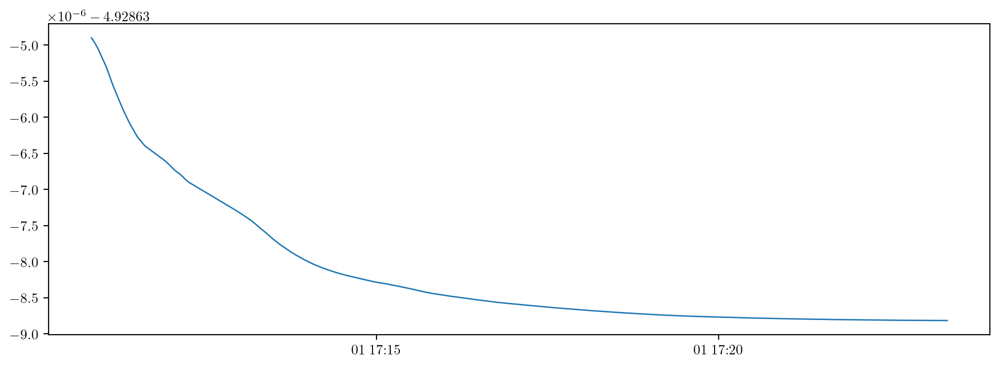

In [ ]:
plt.plot(fast_scoring(497, 100))

In [ ]:
from util_funcs import * 

max_len_id = 'case_4430_depth_trade.csv'
max_prop_id = 'case_2510_depth_trade.csv'

def momentum(id, time = 0, weight = 200, fixed_vol = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    t = pos_data.index[0] if time == 0 else time

    select = trade_data[:t]['ask_p1']
    times = select.index
    diff = trade_data['ask_p1'][t] - select
    tdiff = (times - t).to_numpy(dtype = 'float64')
        
    #   normalises time diff to be between 0 and 100 
    tdiff = -tdiff/tdiff[0]* 100
    gradient = (-diff/tdiff).dropna()

    vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
    if fixed_vol == True:
        vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
    #   normalises weighted mean correctly
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    #   returns momentum as sum of gradient * volume at time t * weighting
    #   where weighting exponentially decays; small weight = closer values weighted more
    return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const

def score(id, log = False, plot = False, show_all = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    def mmtm(time, weight, fixed_vol = False):
        select = trade_data[:time]['ask_p1'] 

        times = select.index

        diff = trade_data['ask_p1'][time] - select
        tdiff = (times - time).to_numpy(dtype = 'float64')
        
        #   normalises time diff to be between 0 and 100 
        tdiff = -tdiff/tdiff[0]* 100
        gradient = (-diff/tdiff).dropna()

        vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
        if fixed_vol == True:
            vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
        #   normalises weighted mean correctly
        norm_const = weight/10 *(1-np.exp(-1000/weight))

        #   returns momentum as sum of gradient * volume at time t * weighting
        #   where weighting exponentially decays; small weight = closer values weighted more
        return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const
    
    pre_short_mom = np.array([mmtm(t, 200) for t in pos_data.index])
    pre_long_mom = np.array([mmtm(t, 100000) for t in pos_data.index])
    pre_short_mom_unweighted = np.array([mmtm(t, 200, fixed_vol=True) for t in pos_data.index])
    pre_long_mom_unweighted = np.array([mmtm(t, 100000, fixed_vol=True) for t in pos_data.index])
    
    if plot == True:
        fig, ax = plt.subplots()
        ax.plot(pos_data.index, pre_short_mom, label = 'short mom')
        ax.plot(pos_data.index, pre_long_mom, label = 'long mom')
        ax.plot(pos_data.index, pre_short_mom_unweighted, label = 'short unw mom')
        ax.plot(pos_data.index, pre_long_mom_unweighted, label = 'long unw mom')
        ax.set(xmargin = 0, title = 'Momentum score at buy times')
        ax.grid()
        ax.legend()

    mean_vol = 1/2*(np.mean(trade_data['ask_tt_volume']) + np.mean(trade_data['bid_tt_volume']))
    
    #   note that momentum approx. is linear with mean volume, so maybe consider normalising if we don't care about trade volume as much? 
    volatility = np.std(returns)
    if log == True:
        volatility = np.log(volatility * 10**5) * 100
    
    if show_all == True:
        #   calculate overall momentum score, weighting long term momentum more; essentially this is 3 parts long momentum 1 part short momentum (unweighted, since weighted short fluctuates like crazy) 
        mom_rms = 1/6 * np.sqrt(abs(np.sign(pre_short_mom)*pre_short_mom**2 + 2* np.sign(pre_long_mom)*pre_long_mom**2 + 2* np.sign(pre_long_mom_unweighted)*pre_long_mom_unweighted**2 + np.sign(pre_short_mom_unweighted) * pre_short_mom_unweighted**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(pre_long_mom_unweighted) * mom_rms / (1000*volatility)

        n = len(pos_data.index)
        df = pd.DataFrame(data = np.array([wghted_score, mean_vol * np.ones(n), volatility * np.ones(n), pre_short_mom, pre_long_mom, pre_short_mom_unweighted, pre_long_mom_unweighted]).transpose(), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = pos_data.index)
        
        return df
    else: 
        short_mom = np.mean(pre_short_mom)
        long_mom = np.mean(pre_long_mom)
        unwghted_short_mom = np.mean(pre_short_mom_unweighted)
        unwghted_long_mom = np.mean(pre_long_mom_unweighted)

        mom_rms = 1/6 * np.sqrt(abs(np.sign(short_mom)*short_mom**2 + 2* np.sign(long_mom)*long_mom**2 + 2* np.sign(unwghted_long_mom)*unwghted_long_mom**2 + np.sign(unwghted_short_mom) * unwghted_short_mom**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(unwghted_long_mom) * mom_rms / (1000*volatility)

        df = pd.DataFrame(data = np.array([wghted_score, mean_vol, volatility, short_mom, long_mom, unwghted_short_mom, unwghted_long_mom]).reshape(1, 7), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = [td[id][5:-16]])
        
        return df

def fast_scoring(id, weight = 100):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    times = pos_data.index
    start = trade_data.index[0]
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    vol = 10 **8 * np.var(get_returns(td[id]))
    grad_scale = trade_data['bid_p1'][times[0]] - trade_data['bid_p1'].values[0]
    print(vol, norm_const)
    select = lambda t: trade_data['bid_p1'][start:t]
    def score(t):
        s = select(t)
        s_ind = (s.index - s.index[0]).to_numpy(dtype = 'float64')/(10**10)
        grad = -(s - s[0])[1:]/(s_ind[1:] * (grad_scale))
        #return np.mean(grad)
        return np.sum(grad * np.exp(-10 * (s_ind)[1:]/weight))/norm_const

    return 10**3 * pd.Series(data=[score(t) for t in times], index=times)/(np.sqrt(vol))
    
all_scores = pd.read_csv('files/scored_cases.csv')


#   analysis / diagnostics
def plot_score_vol_cor():
    res = sp.stats.linregress(all_scores['score'], all_scores['mean volume'])
    x = np.linspace(-400,100)
    fig, ax = plt.subplots()
    ax.scatter(all_scores['score'], all_scores['mean volume'], s= 2, label = 'score vs mean volume')
    ax.plot(x, res.intercept - 30000 + res.slope*x, 'g', label = '(intercept adjusted) linear regression on score vs mean volume')
    ax.set(xlim = [-400, 100], ylim = [0, 200000], xlabel = 'score', ylabel = 'mean volume')
    ax.legend(loc = 'lower left')

corr = np.corrcoef(all_scores['score'], all_scores['mean volume'])
#   correlation between them is approx -0.4, pretty sufficiently negatively correlated between score and mean vol

def pnl_by_thres(upper = -200.0, scoring = 'vol'):
    scoring_systems = {'log': 'log vol score', 'no_vol':'no vol score', 'vol': 'score'}
    score = scoring_systems[scoring]
    tradeid = all_scores[all_scores[score] <= upper]['id']
    res = np.zeros((len(pos), 5))
    print(len(tradeid))
    for i in tqdm(tradeid):
        j = int(str(i)[:-1]) if i != 0 else 0
        res[j, :] = pnl_fast(to_df(pos[j]), to_df(td[j]), 1000)
    
    pos_id = [x[5:-8] for x in pos]
    df_res = pd.DataFrame(data = res, index = pos_id, columns = ['profit', 'loss', 'net', 'avg bid', 'avg ask'])
    winrate = len(df_res[df_res['net'] > 0].index)/len(tradeid)
    df_res = df_res[df_res != 0].dropna()
    
    prof_given_w = np.mean(df_res[df_res['net']>0]['net'])
    loss_given_l = np.mean(df_res[df_res['net']<0]['net'])

    pnl = -prof_given_w/loss_given_l

    print(winrate, pnl)
    return df_res.dropna()

def vol_ratio(id):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_before = np.std(data[:start])
    vol_after = np.std(data[start:])

    return vol_after/vol_before

def est_vol(id, n):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_after = np.std(data[start:])
    vol_est = np.std(data[start:][:n])

    return vol_est/vol_after - 1

def plot_price_rolling_c(id, n):
    data = dev_from_rolling_price(td[id], n)

    price = data['price'][n-1:]
    rolling = data['rolling_mean'].dropna()
    gradient = rolling.values[1:]/rolling.values[:-1] * 10
    time = price.index

    fig, (ax, ax1) = plt.subplots(nrows = 2)
    ax.plot(time, price, label = 'price')
    ax.plot(time, rolling, label = 'rolling (n = {0})'.format(n))
    ax1.plot(time[1:], gradient, label = 'gradient')
    ax.set(xmargin = 0, title = 'price and rolling price')
    ax1.set(xmargin=0, title = 'gradient')
    ax.legend()
    ax1.legend()

def pre_vol(id, start = True):
    data = get_returns(td[id])
    start = to_df(pos[id]).index[0] if start == True else to_df(pos[id]).index[-1] 
    return np.std(data[:start])

def plot_price_rolling_diff(id):
    data = dev_from_rolling_price(td[id])
    price_diffs = data['price'].values[499:] - data['price'].values[:-499]
    means = data['diff'].dropna().rolling(500, center=True).mean().dropna()

    price_diffs_centred = price_diffs - price_diffs.mean()
    diff = data.dropna()['diff']
    diff_centred = diff - diff.mean()
    scale = price_diffs @ diff_centred / (diff_centred @ diff_centred)
    print(scale,  price_diffs.mean(),  1.5 * diff.mean())

    fig, ax = plt.subplots()
    ax.set(xmargin = 0)

    ax.plot(data.dropna().index, price_diffs)
    ax.plot(data.dropna().index, 1.5 * diff_centred, c = 'g')
    ax.plot(data.dropna().index, abs(price_diffs - 1.5 * diff_centred), c = 'r')
    ax.axhline(0, c = 'black')
    #ax.plot(data.dropna().index[250:-249], scale * means,)
    #ax.plot(data.dropna().index[250:-249], price_diffs[250:-249] - scale*means)

4.008689351309597 9.999546000702376


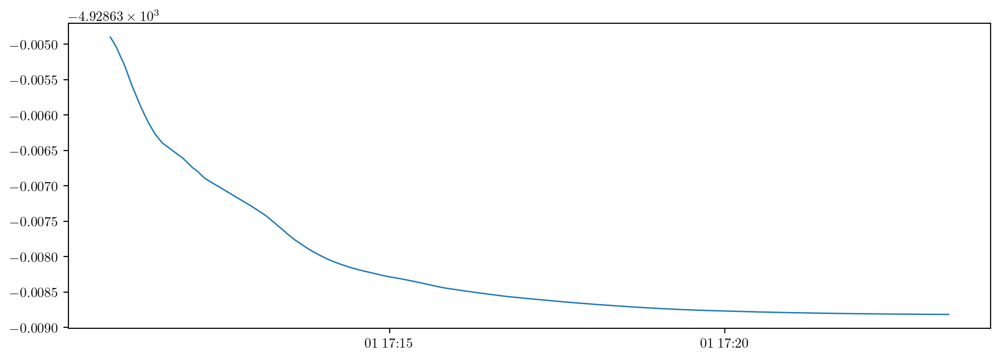

In [ ]:
plt.plot(fast_scoring(497, 100))

In [ ]:
from util_funcs import * 

max_len_id = 'case_4430_depth_trade.csv'
max_prop_id = 'case_2510_depth_trade.csv'

def momentum(id, time = 0, weight = 200, fixed_vol = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    t = pos_data.index[0] if time == 0 else time

    select = trade_data[:t]['ask_p1']
    times = select.index
    diff = trade_data['ask_p1'][t] - select
    tdiff = (times - t).to_numpy(dtype = 'float64')
        
    #   normalises time diff to be between 0 and 100 
    tdiff = -tdiff/tdiff[0]* 100
    gradient = (-diff/tdiff).dropna()

    vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
    if fixed_vol == True:
        vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
    #   normalises weighted mean correctly
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    #   returns momentum as sum of gradient * volume at time t * weighting
    #   where weighting exponentially decays; small weight = closer values weighted more
    return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const

def score(id, log = False, plot = False, show_all = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    def mmtm(time, weight, fixed_vol = False):
        select = trade_data[:time]['ask_p1'] 

        times = select.index

        diff = trade_data['ask_p1'][time] - select
        tdiff = (times - time).to_numpy(dtype = 'float64')
        
        #   normalises time diff to be between 0 and 100 
        tdiff = -tdiff/tdiff[0]* 100
        gradient = (-diff/tdiff).dropna()

        vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
        if fixed_vol == True:
            vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
        #   normalises weighted mean correctly
        norm_const = weight/10 *(1-np.exp(-1000/weight))

        #   returns momentum as sum of gradient * volume at time t * weighting
        #   where weighting exponentially decays; small weight = closer values weighted more
        return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const
    
    pre_short_mom = np.array([mmtm(t, 200) for t in pos_data.index])
    pre_long_mom = np.array([mmtm(t, 100000) for t in pos_data.index])
    pre_short_mom_unweighted = np.array([mmtm(t, 200, fixed_vol=True) for t in pos_data.index])
    pre_long_mom_unweighted = np.array([mmtm(t, 100000, fixed_vol=True) for t in pos_data.index])
    
    if plot == True:
        fig, ax = plt.subplots()
        ax.plot(pos_data.index, pre_short_mom, label = 'short mom')
        ax.plot(pos_data.index, pre_long_mom, label = 'long mom')
        ax.plot(pos_data.index, pre_short_mom_unweighted, label = 'short unw mom')
        ax.plot(pos_data.index, pre_long_mom_unweighted, label = 'long unw mom')
        ax.set(xmargin = 0, title = 'Momentum score at buy times')
        ax.grid()
        ax.legend()

    mean_vol = 1/2*(np.mean(trade_data['ask_tt_volume']) + np.mean(trade_data['bid_tt_volume']))
    
    #   note that momentum approx. is linear with mean volume, so maybe consider normalising if we don't care about trade volume as much? 
    volatility = np.std(returns)
    if log == True:
        volatility = np.log(volatility * 10**5) * 100
    
    if show_all == True:
        #   calculate overall momentum score, weighting long term momentum more; essentially this is 3 parts long momentum 1 part short momentum (unweighted, since weighted short fluctuates like crazy) 
        mom_rms = 1/6 * np.sqrt(abs(np.sign(pre_short_mom)*pre_short_mom**2 + 2* np.sign(pre_long_mom)*pre_long_mom**2 + 2* np.sign(pre_long_mom_unweighted)*pre_long_mom_unweighted**2 + np.sign(pre_short_mom_unweighted) * pre_short_mom_unweighted**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(pre_long_mom_unweighted) * mom_rms / (1000*volatility)

        n = len(pos_data.index)
        df = pd.DataFrame(data = np.array([wghted_score, mean_vol * np.ones(n), volatility * np.ones(n), pre_short_mom, pre_long_mom, pre_short_mom_unweighted, pre_long_mom_unweighted]).transpose(), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = pos_data.index)
        
        return df
    else: 
        short_mom = np.mean(pre_short_mom)
        long_mom = np.mean(pre_long_mom)
        unwghted_short_mom = np.mean(pre_short_mom_unweighted)
        unwghted_long_mom = np.mean(pre_long_mom_unweighted)

        mom_rms = 1/6 * np.sqrt(abs(np.sign(short_mom)*short_mom**2 + 2* np.sign(long_mom)*long_mom**2 + 2* np.sign(unwghted_long_mom)*unwghted_long_mom**2 + np.sign(unwghted_short_mom) * unwghted_short_mom**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(unwghted_long_mom) * mom_rms / (1000*volatility)

        df = pd.DataFrame(data = np.array([wghted_score, mean_vol, volatility, short_mom, long_mom, unwghted_short_mom, unwghted_long_mom]).reshape(1, 7), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = [td[id][5:-16]])
        
        return df

def fast_scoring(id, weight = 100):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    times = pos_data.index
    start = trade_data.index[0]
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    vol = 10 **8 * np.var(get_returns(td[id]))
    grad_scale = trade_data['bid_p1'][times[0]] - trade_data['bid_p1'].values[0]
    print(vol, norm_const)
    select = lambda t: trade_data['bid_p1'][start:t]
    def score(t):
        s = select(t)
        s_ind = (s.index - s.index[0]).to_numpy(dtype = 'float64')/(10**10)
        grad = -(s - s[0])[1:]/(s_ind[1:] * (grad_scale))
        #return np.mean(grad)
        return np.sum(grad * np.exp(-10 * (s_ind)[1:]/weight))/norm_const

    return 10**4 * pd.Series(data=[score(t) for t in times], index=times)/(np.sqrt(vol))
    
all_scores = pd.read_csv('files/scored_cases.csv')


#   analysis / diagnostics
def plot_score_vol_cor():
    res = sp.stats.linregress(all_scores['score'], all_scores['mean volume'])
    x = np.linspace(-400,100)
    fig, ax = plt.subplots()
    ax.scatter(all_scores['score'], all_scores['mean volume'], s= 2, label = 'score vs mean volume')
    ax.plot(x, res.intercept - 30000 + res.slope*x, 'g', label = '(intercept adjusted) linear regression on score vs mean volume')
    ax.set(xlim = [-400, 100], ylim = [0, 200000], xlabel = 'score', ylabel = 'mean volume')
    ax.legend(loc = 'lower left')

corr = np.corrcoef(all_scores['score'], all_scores['mean volume'])
#   correlation between them is approx -0.4, pretty sufficiently negatively correlated between score and mean vol

def pnl_by_thres(upper = -200.0, scoring = 'vol'):
    scoring_systems = {'log': 'log vol score', 'no_vol':'no vol score', 'vol': 'score'}
    score = scoring_systems[scoring]
    tradeid = all_scores[all_scores[score] <= upper]['id']
    res = np.zeros((len(pos), 5))
    print(len(tradeid))
    for i in tqdm(tradeid):
        j = int(str(i)[:-1]) if i != 0 else 0
        res[j, :] = pnl_fast(to_df(pos[j]), to_df(td[j]), 1000)
    
    pos_id = [x[5:-8] for x in pos]
    df_res = pd.DataFrame(data = res, index = pos_id, columns = ['profit', 'loss', 'net', 'avg bid', 'avg ask'])
    winrate = len(df_res[df_res['net'] > 0].index)/len(tradeid)
    df_res = df_res[df_res != 0].dropna()
    
    prof_given_w = np.mean(df_res[df_res['net']>0]['net'])
    loss_given_l = np.mean(df_res[df_res['net']<0]['net'])

    pnl = -prof_given_w/loss_given_l

    print(winrate, pnl)
    return df_res.dropna()

def vol_ratio(id):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_before = np.std(data[:start])
    vol_after = np.std(data[start:])

    return vol_after/vol_before

def est_vol(id, n):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_after = np.std(data[start:])
    vol_est = np.std(data[start:][:n])

    return vol_est/vol_after - 1

def plot_price_rolling_c(id, n):
    data = dev_from_rolling_price(td[id], n)

    price = data['price'][n-1:]
    rolling = data['rolling_mean'].dropna()
    gradient = rolling.values[1:]/rolling.values[:-1] * 10
    time = price.index

    fig, (ax, ax1) = plt.subplots(nrows = 2)
    ax.plot(time, price, label = 'price')
    ax.plot(time, rolling, label = 'rolling (n = {0})'.format(n))
    ax1.plot(time[1:], gradient, label = 'gradient')
    ax.set(xmargin = 0, title = 'price and rolling price')
    ax1.set(xmargin=0, title = 'gradient')
    ax.legend()
    ax1.legend()

def pre_vol(id, start = True):
    data = get_returns(td[id])
    start = to_df(pos[id]).index[0] if start == True else to_df(pos[id]).index[-1] 
    return np.std(data[:start])

def plot_price_rolling_diff(id):
    data = dev_from_rolling_price(td[id])
    price_diffs = data['price'].values[499:] - data['price'].values[:-499]
    means = data['diff'].dropna().rolling(500, center=True).mean().dropna()

    price_diffs_centred = price_diffs - price_diffs.mean()
    diff = data.dropna()['diff']
    diff_centred = diff - diff.mean()
    scale = price_diffs @ diff_centred / (diff_centred @ diff_centred)
    print(scale,  price_diffs.mean(),  1.5 * diff.mean())

    fig, ax = plt.subplots()
    ax.set(xmargin = 0)

    ax.plot(data.dropna().index, price_diffs)
    ax.plot(data.dropna().index, 1.5 * diff_centred, c = 'g')
    ax.plot(data.dropna().index, abs(price_diffs - 1.5 * diff_centred), c = 'r')
    ax.axhline(0, c = 'black')
    #ax.plot(data.dropna().index[250:-249], scale * means,)
    #ax.plot(data.dropna().index[250:-249], price_diffs[250:-249] - scale*means)

4.008689351309597 9.999546000702376


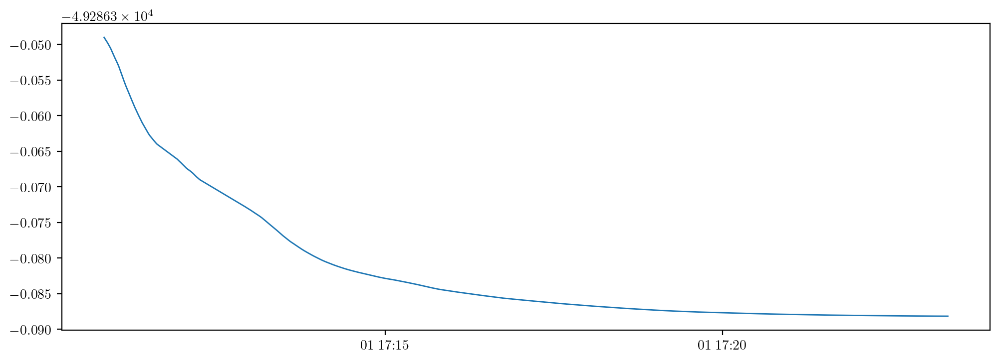

In [ ]:
plt.plot(fast_scoring(497, 100))

In [ ]:
from util_funcs import * 

max_len_id = 'case_4430_depth_trade.csv'
max_prop_id = 'case_2510_depth_trade.csv'

def momentum(id, time = 0, weight = 200, fixed_vol = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    t = pos_data.index[0] if time == 0 else time

    select = trade_data[:t]['ask_p1']
    times = select.index
    diff = trade_data['ask_p1'][t] - select
    tdiff = (times - t).to_numpy(dtype = 'float64')
        
    #   normalises time diff to be between 0 and 100 
    tdiff = -tdiff/tdiff[0]* 100
    gradient = (-diff/tdiff).dropna()

    vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
    if fixed_vol == True:
        vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
    #   normalises weighted mean correctly
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    #   returns momentum as sum of gradient * volume at time t * weighting
    #   where weighting exponentially decays; small weight = closer values weighted more
    return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const

def score(id, log = False, plot = False, show_all = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    def mmtm(time, weight, fixed_vol = False):
        select = trade_data[:time]['ask_p1'] 

        times = select.index

        diff = trade_data['ask_p1'][time] - select
        tdiff = (times - time).to_numpy(dtype = 'float64')
        
        #   normalises time diff to be between 0 and 100 
        tdiff = -tdiff/tdiff[0]* 100
        gradient = (-diff/tdiff).dropna()

        vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
        if fixed_vol == True:
            vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
        #   normalises weighted mean correctly
        norm_const = weight/10 *(1-np.exp(-1000/weight))

        #   returns momentum as sum of gradient * volume at time t * weighting
        #   where weighting exponentially decays; small weight = closer values weighted more
        return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const
    
    pre_short_mom = np.array([mmtm(t, 200) for t in pos_data.index])
    pre_long_mom = np.array([mmtm(t, 100000) for t in pos_data.index])
    pre_short_mom_unweighted = np.array([mmtm(t, 200, fixed_vol=True) for t in pos_data.index])
    pre_long_mom_unweighted = np.array([mmtm(t, 100000, fixed_vol=True) for t in pos_data.index])
    
    if plot == True:
        fig, ax = plt.subplots()
        ax.plot(pos_data.index, pre_short_mom, label = 'short mom')
        ax.plot(pos_data.index, pre_long_mom, label = 'long mom')
        ax.plot(pos_data.index, pre_short_mom_unweighted, label = 'short unw mom')
        ax.plot(pos_data.index, pre_long_mom_unweighted, label = 'long unw mom')
        ax.set(xmargin = 0, title = 'Momentum score at buy times')
        ax.grid()
        ax.legend()

    mean_vol = 1/2*(np.mean(trade_data['ask_tt_volume']) + np.mean(trade_data['bid_tt_volume']))
    
    #   note that momentum approx. is linear with mean volume, so maybe consider normalising if we don't care about trade volume as much? 
    volatility = np.std(returns)
    if log == True:
        volatility = np.log(volatility * 10**5) * 100
    
    if show_all == True:
        #   calculate overall momentum score, weighting long term momentum more; essentially this is 3 parts long momentum 1 part short momentum (unweighted, since weighted short fluctuates like crazy) 
        mom_rms = 1/6 * np.sqrt(abs(np.sign(pre_short_mom)*pre_short_mom**2 + 2* np.sign(pre_long_mom)*pre_long_mom**2 + 2* np.sign(pre_long_mom_unweighted)*pre_long_mom_unweighted**2 + np.sign(pre_short_mom_unweighted) * pre_short_mom_unweighted**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(pre_long_mom_unweighted) * mom_rms / (1000*volatility)

        n = len(pos_data.index)
        df = pd.DataFrame(data = np.array([wghted_score, mean_vol * np.ones(n), volatility * np.ones(n), pre_short_mom, pre_long_mom, pre_short_mom_unweighted, pre_long_mom_unweighted]).transpose(), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = pos_data.index)
        
        return df
    else: 
        short_mom = np.mean(pre_short_mom)
        long_mom = np.mean(pre_long_mom)
        unwghted_short_mom = np.mean(pre_short_mom_unweighted)
        unwghted_long_mom = np.mean(pre_long_mom_unweighted)

        mom_rms = 1/6 * np.sqrt(abs(np.sign(short_mom)*short_mom**2 + 2* np.sign(long_mom)*long_mom**2 + 2* np.sign(unwghted_long_mom)*unwghted_long_mom**2 + np.sign(unwghted_short_mom) * unwghted_short_mom**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(unwghted_long_mom) * mom_rms / (1000*volatility)

        df = pd.DataFrame(data = np.array([wghted_score, mean_vol, volatility, short_mom, long_mom, unwghted_short_mom, unwghted_long_mom]).reshape(1, 7), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = [td[id][5:-16]])
        
        return df

def fast_scoring(id, weight = 100):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    times = pos_data.index
    start = trade_data.index[0]
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    vol = 10 **8 * np.var(get_returns(td[id]))
    grad_scale = trade_data['bid_p1'][times[0]] - trade_data['bid_p1'].values[0]
    print(vol, norm_const)
    select = lambda t: trade_data['bid_p1'][start:t]
    def score(t):
        s = select(t)
        s_ind = (s.index - s.index[0]).to_numpy(dtype = 'float64')/(10**10)
        grad = -(s - s[0])[1:]/(s_ind[1:] * (grad_scale))
        #return np.mean(grad)
        return np.sum(grad * np.exp(-10 * (s_ind)[1:]/weight))/norm_const

    return pd.Series(data=[score(t) for t in times], index=times)
    
all_scores = pd.read_csv('files/scored_cases.csv')


#   analysis / diagnostics
def plot_score_vol_cor():
    res = sp.stats.linregress(all_scores['score'], all_scores['mean volume'])
    x = np.linspace(-400,100)
    fig, ax = plt.subplots()
    ax.scatter(all_scores['score'], all_scores['mean volume'], s= 2, label = 'score vs mean volume')
    ax.plot(x, res.intercept - 30000 + res.slope*x, 'g', label = '(intercept adjusted) linear regression on score vs mean volume')
    ax.set(xlim = [-400, 100], ylim = [0, 200000], xlabel = 'score', ylabel = 'mean volume')
    ax.legend(loc = 'lower left')

corr = np.corrcoef(all_scores['score'], all_scores['mean volume'])
#   correlation between them is approx -0.4, pretty sufficiently negatively correlated between score and mean vol

def pnl_by_thres(upper = -200.0, scoring = 'vol'):
    scoring_systems = {'log': 'log vol score', 'no_vol':'no vol score', 'vol': 'score'}
    score = scoring_systems[scoring]
    tradeid = all_scores[all_scores[score] <= upper]['id']
    res = np.zeros((len(pos), 5))
    print(len(tradeid))
    for i in tqdm(tradeid):
        j = int(str(i)[:-1]) if i != 0 else 0
        res[j, :] = pnl_fast(to_df(pos[j]), to_df(td[j]), 1000)
    
    pos_id = [x[5:-8] for x in pos]
    df_res = pd.DataFrame(data = res, index = pos_id, columns = ['profit', 'loss', 'net', 'avg bid', 'avg ask'])
    winrate = len(df_res[df_res['net'] > 0].index)/len(tradeid)
    df_res = df_res[df_res != 0].dropna()
    
    prof_given_w = np.mean(df_res[df_res['net']>0]['net'])
    loss_given_l = np.mean(df_res[df_res['net']<0]['net'])

    pnl = -prof_given_w/loss_given_l

    print(winrate, pnl)
    return df_res.dropna()

def vol_ratio(id):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_before = np.std(data[:start])
    vol_after = np.std(data[start:])

    return vol_after/vol_before

def est_vol(id, n):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_after = np.std(data[start:])
    vol_est = np.std(data[start:][:n])

    return vol_est/vol_after - 1

def plot_price_rolling_c(id, n):
    data = dev_from_rolling_price(td[id], n)

    price = data['price'][n-1:]
    rolling = data['rolling_mean'].dropna()
    gradient = rolling.values[1:]/rolling.values[:-1] * 10
    time = price.index

    fig, (ax, ax1) = plt.subplots(nrows = 2)
    ax.plot(time, price, label = 'price')
    ax.plot(time, rolling, label = 'rolling (n = {0})'.format(n))
    ax1.plot(time[1:], gradient, label = 'gradient')
    ax.set(xmargin = 0, title = 'price and rolling price')
    ax1.set(xmargin=0, title = 'gradient')
    ax.legend()
    ax1.legend()

def pre_vol(id, start = True):
    data = get_returns(td[id])
    start = to_df(pos[id]).index[0] if start == True else to_df(pos[id]).index[-1] 
    return np.std(data[:start])

def plot_price_rolling_diff(id):
    data = dev_from_rolling_price(td[id])
    price_diffs = data['price'].values[499:] - data['price'].values[:-499]
    means = data['diff'].dropna().rolling(500, center=True).mean().dropna()

    price_diffs_centred = price_diffs - price_diffs.mean()
    diff = data.dropna()['diff']
    diff_centred = diff - diff.mean()
    scale = price_diffs @ diff_centred / (diff_centred @ diff_centred)
    print(scale,  price_diffs.mean(),  1.5 * diff.mean())

    fig, ax = plt.subplots()
    ax.set(xmargin = 0)

    ax.plot(data.dropna().index, price_diffs)
    ax.plot(data.dropna().index, 1.5 * diff_centred, c = 'g')
    ax.plot(data.dropna().index, abs(price_diffs - 1.5 * diff_centred), c = 'r')
    ax.axhline(0, c = 'black')
    #ax.plot(data.dropna().index[250:-249], scale * means,)
    #ax.plot(data.dropna().index[250:-249], price_diffs[250:-249] - scale*means)

4.008689351309597 9.999546000702376


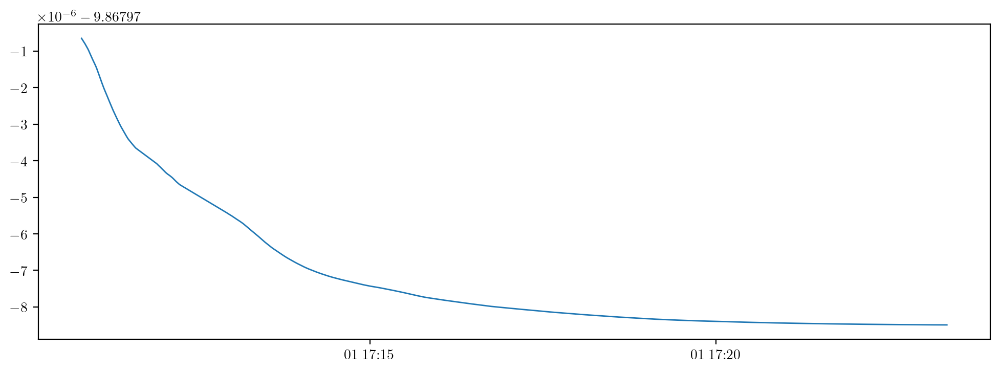

In [ ]:
plt.plot(fast_scoring(497, 100))

4.008689351309597 19.865241060018292


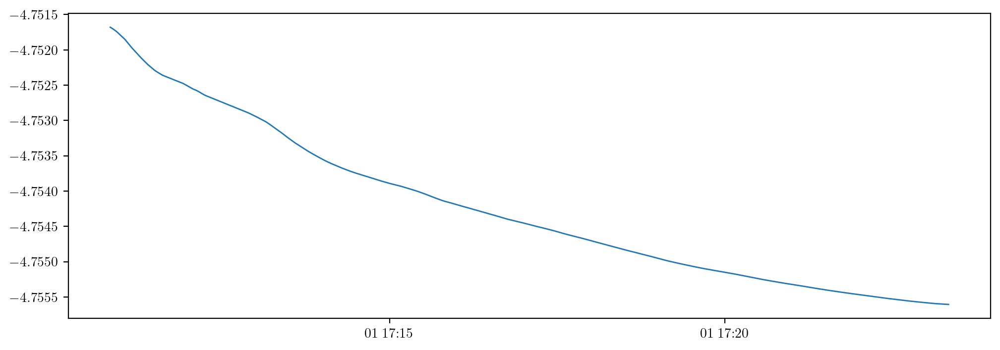

In [ ]:
plt.plot(fast_scoring(497, 200))

In [ ]:
from util_funcs import * 

max_len_id = 'case_4430_depth_trade.csv'
max_prop_id = 'case_2510_depth_trade.csv'

def momentum(id, time = 0, weight = 200, fixed_vol = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    t = pos_data.index[0] if time == 0 else time

    select = trade_data[:t]['ask_p1']
    times = select.index
    diff = trade_data['ask_p1'][t] - select
    tdiff = (times - t).to_numpy(dtype = 'float64')
        
    #   normalises time diff to be between 0 and 100 
    tdiff = -tdiff/tdiff[0]* 100
    gradient = (-diff/tdiff).dropna()

    vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
    if fixed_vol == True:
        vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
    #   normalises weighted mean correctly
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    #   returns momentum as sum of gradient * volume at time t * weighting
    #   where weighting exponentially decays; small weight = closer values weighted more
    return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const

def score(id, log = False, plot = False, show_all = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    def mmtm(time, weight, fixed_vol = False):
        select = trade_data[:time]['ask_p1'] 

        times = select.index

        diff = trade_data['ask_p1'][time] - select
        tdiff = (times - time).to_numpy(dtype = 'float64')
        
        #   normalises time diff to be between 0 and 100 
        tdiff = -tdiff/tdiff[0]* 100
        gradient = (-diff/tdiff).dropna()

        vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
        if fixed_vol == True:
            vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
        #   normalises weighted mean correctly
        norm_const = weight/10 *(1-np.exp(-1000/weight))

        #   returns momentum as sum of gradient * volume at time t * weighting
        #   where weighting exponentially decays; small weight = closer values weighted more
        return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const
    
    pre_short_mom = np.array([mmtm(t, 200) for t in pos_data.index])
    pre_long_mom = np.array([mmtm(t, 100000) for t in pos_data.index])
    pre_short_mom_unweighted = np.array([mmtm(t, 200, fixed_vol=True) for t in pos_data.index])
    pre_long_mom_unweighted = np.array([mmtm(t, 100000, fixed_vol=True) for t in pos_data.index])
    
    if plot == True:
        fig, ax = plt.subplots()
        ax.plot(pos_data.index, pre_short_mom, label = 'short mom')
        ax.plot(pos_data.index, pre_long_mom, label = 'long mom')
        ax.plot(pos_data.index, pre_short_mom_unweighted, label = 'short unw mom')
        ax.plot(pos_data.index, pre_long_mom_unweighted, label = 'long unw mom')
        ax.set(xmargin = 0, title = 'Momentum score at buy times')
        ax.grid()
        ax.legend()

    mean_vol = 1/2*(np.mean(trade_data['ask_tt_volume']) + np.mean(trade_data['bid_tt_volume']))
    
    #   note that momentum approx. is linear with mean volume, so maybe consider normalising if we don't care about trade volume as much? 
    volatility = np.std(returns)
    if log == True:
        volatility = np.log(volatility * 10**5) * 100
    
    if show_all == True:
        #   calculate overall momentum score, weighting long term momentum more; essentially this is 3 parts long momentum 1 part short momentum (unweighted, since weighted short fluctuates like crazy) 
        mom_rms = 1/6 * np.sqrt(abs(np.sign(pre_short_mom)*pre_short_mom**2 + 2* np.sign(pre_long_mom)*pre_long_mom**2 + 2* np.sign(pre_long_mom_unweighted)*pre_long_mom_unweighted**2 + np.sign(pre_short_mom_unweighted) * pre_short_mom_unweighted**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(pre_long_mom_unweighted) * mom_rms / (1000*volatility)

        n = len(pos_data.index)
        df = pd.DataFrame(data = np.array([wghted_score, mean_vol * np.ones(n), volatility * np.ones(n), pre_short_mom, pre_long_mom, pre_short_mom_unweighted, pre_long_mom_unweighted]).transpose(), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = pos_data.index)
        
        return df
    else: 
        short_mom = np.mean(pre_short_mom)
        long_mom = np.mean(pre_long_mom)
        unwghted_short_mom = np.mean(pre_short_mom_unweighted)
        unwghted_long_mom = np.mean(pre_long_mom_unweighted)

        mom_rms = 1/6 * np.sqrt(abs(np.sign(short_mom)*short_mom**2 + 2* np.sign(long_mom)*long_mom**2 + 2* np.sign(unwghted_long_mom)*unwghted_long_mom**2 + np.sign(unwghted_short_mom) * unwghted_short_mom**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(unwghted_long_mom) * mom_rms / (1000*volatility)

        df = pd.DataFrame(data = np.array([wghted_score, mean_vol, volatility, short_mom, long_mom, unwghted_short_mom, unwghted_long_mom]).reshape(1, 7), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = [td[id][5:-16]])
        
        return df

def fast_scoring(id, weight = 100):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    times = pos_data.index
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    vol = 10 **8 * np.var(get_returns(td[id]))
    grad_scale = trade_data['bid_p1'][times[0]] - trade_data['bid_p1'].values[0]
    print(vol, norm_const)
    select = lambda t: trade_data['bid_p1'][:t]
    def score(t):
        s = select(t)
        s_ind = (s.index - s.index[0]).to_numpy(dtype = 'float64')/(10**10)
        grad = -(s - s[0])[1:]/(s_ind[1:] * (grad_scale))
        #return np.mean(grad)
        return np.sum(grad * np.exp(-10 * (s_ind)[1:]/weight))/norm_const

    return pd.Series(data=[score(t) for t in times], index=times)
    
all_scores = pd.read_csv('files/scored_cases.csv')


#   analysis / diagnostics
def plot_score_vol_cor():
    res = sp.stats.linregress(all_scores['score'], all_scores['mean volume'])
    x = np.linspace(-400,100)
    fig, ax = plt.subplots()
    ax.scatter(all_scores['score'], all_scores['mean volume'], s= 2, label = 'score vs mean volume')
    ax.plot(x, res.intercept - 30000 + res.slope*x, 'g', label = '(intercept adjusted) linear regression on score vs mean volume')
    ax.set(xlim = [-400, 100], ylim = [0, 200000], xlabel = 'score', ylabel = 'mean volume')
    ax.legend(loc = 'lower left')

corr = np.corrcoef(all_scores['score'], all_scores['mean volume'])
#   correlation between them is approx -0.4, pretty sufficiently negatively correlated between score and mean vol

def pnl_by_thres(upper = -200.0, scoring = 'vol'):
    scoring_systems = {'log': 'log vol score', 'no_vol':'no vol score', 'vol': 'score'}
    score = scoring_systems[scoring]
    tradeid = all_scores[all_scores[score] <= upper]['id']
    res = np.zeros((len(pos), 5))
    print(len(tradeid))
    for i in tqdm(tradeid):
        j = int(str(i)[:-1]) if i != 0 else 0
        res[j, :] = pnl_fast(to_df(pos[j]), to_df(td[j]), 1000)
    
    pos_id = [x[5:-8] for x in pos]
    df_res = pd.DataFrame(data = res, index = pos_id, columns = ['profit', 'loss', 'net', 'avg bid', 'avg ask'])
    winrate = len(df_res[df_res['net'] > 0].index)/len(tradeid)
    df_res = df_res[df_res != 0].dropna()
    
    prof_given_w = np.mean(df_res[df_res['net']>0]['net'])
    loss_given_l = np.mean(df_res[df_res['net']<0]['net'])

    pnl = -prof_given_w/loss_given_l

    print(winrate, pnl)
    return df_res.dropna()

def vol_ratio(id):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_before = np.std(data[:start])
    vol_after = np.std(data[start:])

    return vol_after/vol_before

def est_vol(id, n):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_after = np.std(data[start:])
    vol_est = np.std(data[start:][:n])

    return vol_est/vol_after - 1

def plot_price_rolling_c(id, n):
    data = dev_from_rolling_price(td[id], n)

    price = data['price'][n-1:]
    rolling = data['rolling_mean'].dropna()
    gradient = rolling.values[1:]/rolling.values[:-1] * 10
    time = price.index

    fig, (ax, ax1) = plt.subplots(nrows = 2)
    ax.plot(time, price, label = 'price')
    ax.plot(time, rolling, label = 'rolling (n = {0})'.format(n))
    ax1.plot(time[1:], gradient, label = 'gradient')
    ax.set(xmargin = 0, title = 'price and rolling price')
    ax1.set(xmargin=0, title = 'gradient')
    ax.legend()
    ax1.legend()

def pre_vol(id, start = True):
    data = get_returns(td[id])
    start = to_df(pos[id]).index[0] if start == True else to_df(pos[id]).index[-1] 
    return np.std(data[:start])

def plot_price_rolling_diff(id):
    data = dev_from_rolling_price(td[id])
    price_diffs = data['price'].values[499:] - data['price'].values[:-499]
    means = data['diff'].dropna().rolling(500, center=True).mean().dropna()

    price_diffs_centred = price_diffs - price_diffs.mean()
    diff = data.dropna()['diff']
    diff_centred = diff - diff.mean()
    scale = price_diffs @ diff_centred / (diff_centred @ diff_centred)
    print(scale,  price_diffs.mean(),  1.5 * diff.mean())

    fig, ax = plt.subplots()
    ax.set(xmargin = 0)

    ax.plot(data.dropna().index, price_diffs)
    ax.plot(data.dropna().index, 1.5 * diff_centred, c = 'g')
    ax.plot(data.dropna().index, abs(price_diffs - 1.5 * diff_centred), c = 'r')
    ax.axhline(0, c = 'black')
    #ax.plot(data.dropna().index[250:-249], scale * means,)
    #ax.plot(data.dropna().index[250:-249], price_diffs[250:-249] - scale*means)

4.008689351309597 19.865241060018292


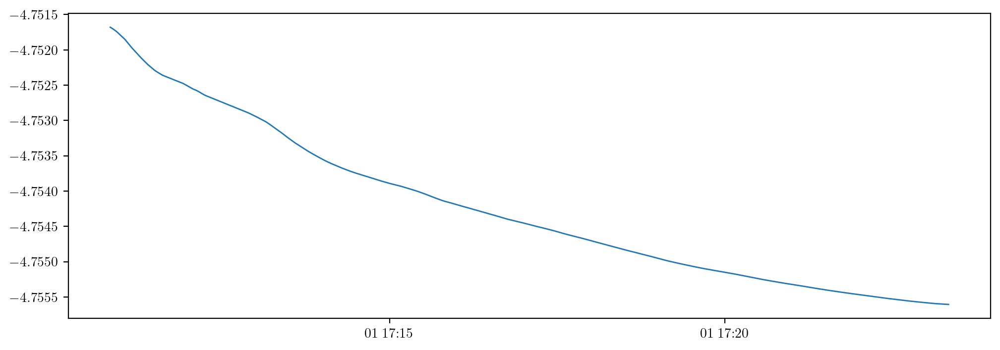

In [ ]:
plt.plot(fast_scoring(497, 200))

In [ ]:
from util_funcs import * 

max_len_id = 'case_4430_depth_trade.csv'
max_prop_id = 'case_2510_depth_trade.csv'

def momentum(id, time = 0, weight = 200, fixed_vol = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    t = pos_data.index[0] if time == 0 else time

    select = trade_data[:t]['ask_p1']
    times = select.index
    diff = trade_data['ask_p1'][t] - select
    tdiff = (times - t).to_numpy(dtype = 'float64')
        
    #   normalises time diff to be between 0 and 100 
    tdiff = -tdiff/tdiff[0]* 100
    gradient = (-diff/tdiff).dropna()

    vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
    if fixed_vol == True:
        vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
    #   normalises weighted mean correctly
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    #   returns momentum as sum of gradient * volume at time t * weighting
    #   where weighting exponentially decays; small weight = closer values weighted more
    return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const

def score(id, log = False, plot = False, show_all = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    def mmtm(time, weight, fixed_vol = False):
        select = trade_data[:time]['ask_p1'] 

        times = select.index

        diff = trade_data['ask_p1'][time] - select
        tdiff = (times - time).to_numpy(dtype = 'float64')
        
        #   normalises time diff to be between 0 and 100 
        tdiff = -tdiff/tdiff[0]* 100
        gradient = (-diff/tdiff).dropna()

        vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
        if fixed_vol == True:
            vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
        #   normalises weighted mean correctly
        norm_const = weight/10 *(1-np.exp(-1000/weight))

        #   returns momentum as sum of gradient * volume at time t * weighting
        #   where weighting exponentially decays; small weight = closer values weighted more
        return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const
    
    pre_short_mom = np.array([mmtm(t, 200) for t in pos_data.index])
    pre_long_mom = np.array([mmtm(t, 100000) for t in pos_data.index])
    pre_short_mom_unweighted = np.array([mmtm(t, 200, fixed_vol=True) for t in pos_data.index])
    pre_long_mom_unweighted = np.array([mmtm(t, 100000, fixed_vol=True) for t in pos_data.index])
    
    if plot == True:
        fig, ax = plt.subplots()
        ax.plot(pos_data.index, pre_short_mom, label = 'short mom')
        ax.plot(pos_data.index, pre_long_mom, label = 'long mom')
        ax.plot(pos_data.index, pre_short_mom_unweighted, label = 'short unw mom')
        ax.plot(pos_data.index, pre_long_mom_unweighted, label = 'long unw mom')
        ax.set(xmargin = 0, title = 'Momentum score at buy times')
        ax.grid()
        ax.legend()

    mean_vol = 1/2*(np.mean(trade_data['ask_tt_volume']) + np.mean(trade_data['bid_tt_volume']))
    
    #   note that momentum approx. is linear with mean volume, so maybe consider normalising if we don't care about trade volume as much? 
    volatility = np.std(returns)
    if log == True:
        volatility = np.log(volatility * 10**5) * 100
    
    if show_all == True:
        #   calculate overall momentum score, weighting long term momentum more; essentially this is 3 parts long momentum 1 part short momentum (unweighted, since weighted short fluctuates like crazy) 
        mom_rms = 1/6 * np.sqrt(abs(np.sign(pre_short_mom)*pre_short_mom**2 + 2* np.sign(pre_long_mom)*pre_long_mom**2 + 2* np.sign(pre_long_mom_unweighted)*pre_long_mom_unweighted**2 + np.sign(pre_short_mom_unweighted) * pre_short_mom_unweighted**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(pre_long_mom_unweighted) * mom_rms / (1000*volatility)

        n = len(pos_data.index)
        df = pd.DataFrame(data = np.array([wghted_score, mean_vol * np.ones(n), volatility * np.ones(n), pre_short_mom, pre_long_mom, pre_short_mom_unweighted, pre_long_mom_unweighted]).transpose(), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = pos_data.index)
        
        return df
    else: 
        short_mom = np.mean(pre_short_mom)
        long_mom = np.mean(pre_long_mom)
        unwghted_short_mom = np.mean(pre_short_mom_unweighted)
        unwghted_long_mom = np.mean(pre_long_mom_unweighted)

        mom_rms = 1/6 * np.sqrt(abs(np.sign(short_mom)*short_mom**2 + 2* np.sign(long_mom)*long_mom**2 + 2* np.sign(unwghted_long_mom)*unwghted_long_mom**2 + np.sign(unwghted_short_mom) * unwghted_short_mom**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(unwghted_long_mom) * mom_rms / (1000*volatility)

        df = pd.DataFrame(data = np.array([wghted_score, mean_vol, volatility, short_mom, long_mom, unwghted_short_mom, unwghted_long_mom]).reshape(1, 7), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = [td[id][5:-16]])
        
        return df

def fast_scoring(id, weight = 100):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    times = pos_data.index
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    vol = 10 **8 * np.var(get_returns(td[id]))
    grad_scale = trade_data['bid_p1'][times[0]] - trade_data['bid_p1'].values[0]
    print(vol, norm_const)
    def score(t):
        s = trade_data['bid_p1'][:t]
        s_ind = (s.index - s.index[0]).to_numpy(dtype = 'float64')/(10**10)
        grad = -(s - s[0])[1:]/(s_ind[1:] * (grad_scale))
        #return np.mean(grad)
        return np.sum(grad * np.exp(-10 * (s_ind)[1:]/weight))/norm_const

    return pd.Series(data=[score(t) for t in times], index=times)
    
all_scores = pd.read_csv('files/scored_cases.csv')


#   analysis / diagnostics
def plot_score_vol_cor():
    res = sp.stats.linregress(all_scores['score'], all_scores['mean volume'])
    x = np.linspace(-400,100)
    fig, ax = plt.subplots()
    ax.scatter(all_scores['score'], all_scores['mean volume'], s= 2, label = 'score vs mean volume')
    ax.plot(x, res.intercept - 30000 + res.slope*x, 'g', label = '(intercept adjusted) linear regression on score vs mean volume')
    ax.set(xlim = [-400, 100], ylim = [0, 200000], xlabel = 'score', ylabel = 'mean volume')
    ax.legend(loc = 'lower left')

corr = np.corrcoef(all_scores['score'], all_scores['mean volume'])
#   correlation between them is approx -0.4, pretty sufficiently negatively correlated between score and mean vol

def pnl_by_thres(upper = -200.0, scoring = 'vol'):
    scoring_systems = {'log': 'log vol score', 'no_vol':'no vol score', 'vol': 'score'}
    score = scoring_systems[scoring]
    tradeid = all_scores[all_scores[score] <= upper]['id']
    res = np.zeros((len(pos), 5))
    print(len(tradeid))
    for i in tqdm(tradeid):
        j = int(str(i)[:-1]) if i != 0 else 0
        res[j, :] = pnl_fast(to_df(pos[j]), to_df(td[j]), 1000)
    
    pos_id = [x[5:-8] for x in pos]
    df_res = pd.DataFrame(data = res, index = pos_id, columns = ['profit', 'loss', 'net', 'avg bid', 'avg ask'])
    winrate = len(df_res[df_res['net'] > 0].index)/len(tradeid)
    df_res = df_res[df_res != 0].dropna()
    
    prof_given_w = np.mean(df_res[df_res['net']>0]['net'])
    loss_given_l = np.mean(df_res[df_res['net']<0]['net'])

    pnl = -prof_given_w/loss_given_l

    print(winrate, pnl)
    return df_res.dropna()

def vol_ratio(id):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_before = np.std(data[:start])
    vol_after = np.std(data[start:])

    return vol_after/vol_before

def est_vol(id, n):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_after = np.std(data[start:])
    vol_est = np.std(data[start:][:n])

    return vol_est/vol_after - 1

def plot_price_rolling_c(id, n):
    data = dev_from_rolling_price(td[id], n)

    price = data['price'][n-1:]
    rolling = data['rolling_mean'].dropna()
    gradient = rolling.values[1:]/rolling.values[:-1] * 10
    time = price.index

    fig, (ax, ax1) = plt.subplots(nrows = 2)
    ax.plot(time, price, label = 'price')
    ax.plot(time, rolling, label = 'rolling (n = {0})'.format(n))
    ax1.plot(time[1:], gradient, label = 'gradient')
    ax.set(xmargin = 0, title = 'price and rolling price')
    ax1.set(xmargin=0, title = 'gradient')
    ax.legend()
    ax1.legend()

def pre_vol(id, start = True):
    data = get_returns(td[id])
    start = to_df(pos[id]).index[0] if start == True else to_df(pos[id]).index[-1] 
    return np.std(data[:start])

def plot_price_rolling_diff(id):
    data = dev_from_rolling_price(td[id])
    price_diffs = data['price'].values[499:] - data['price'].values[:-499]
    means = data['diff'].dropna().rolling(500, center=True).mean().dropna()

    price_diffs_centred = price_diffs - price_diffs.mean()
    diff = data.dropna()['diff']
    diff_centred = diff - diff.mean()
    scale = price_diffs @ diff_centred / (diff_centred @ diff_centred)
    print(scale,  price_diffs.mean(),  1.5 * diff.mean())

    fig, ax = plt.subplots()
    ax.set(xmargin = 0)

    ax.plot(data.dropna().index, price_diffs)
    ax.plot(data.dropna().index, 1.5 * diff_centred, c = 'g')
    ax.plot(data.dropna().index, abs(price_diffs - 1.5 * diff_centred), c = 'r')
    ax.axhline(0, c = 'black')
    #ax.plot(data.dropna().index[250:-249], scale * means,)
    #ax.plot(data.dropna().index[250:-249], price_diffs[250:-249] - scale*means)

4.008689351309597 19.865241060018292


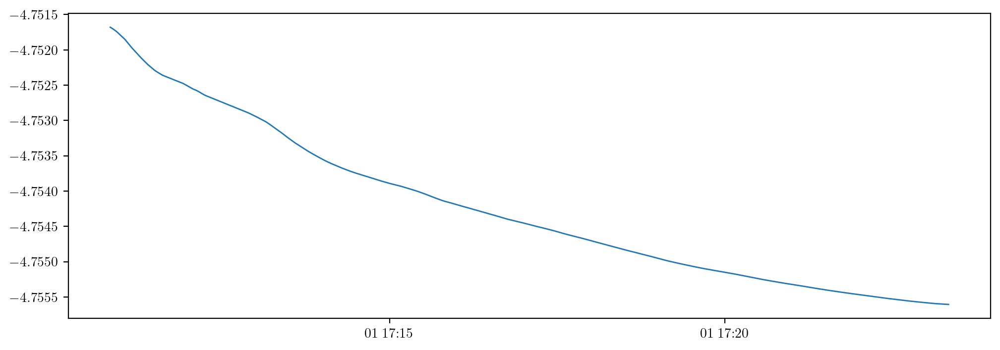

In [ ]:
plt.plot(fast_scoring(497, 200))

In [ ]:
from util_funcs import * 

max_len_id = 'case_4430_depth_trade.csv'
max_prop_id = 'case_2510_depth_trade.csv'

def momentum(id, time = 0, weight = 200, fixed_vol = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    t = pos_data.index[0] if time == 0 else time

    select = trade_data[:t]['ask_p1']
    times = select.index
    diff = trade_data['ask_p1'][t] - select
    tdiff = (times - t).to_numpy(dtype = 'float64')
        
    #   normalises time diff to be between 0 and 100 
    tdiff = -tdiff/tdiff[0]* 100
    gradient = (-diff/tdiff).dropna()

    vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
    if fixed_vol == True:
        vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
    #   normalises weighted mean correctly
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    #   returns momentum as sum of gradient * volume at time t * weighting
    #   where weighting exponentially decays; small weight = closer values weighted more
    return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const

def score(id, log = False, plot = False, show_all = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    def mmtm(time, weight, fixed_vol = False):
        select = trade_data[:time]['ask_p1'] 

        times = select.index

        diff = trade_data['ask_p1'][time] - select
        tdiff = (times - time).to_numpy(dtype = 'float64')
        
        #   normalises time diff to be between 0 and 100 
        tdiff = -tdiff/tdiff[0]* 100
        gradient = (-diff/tdiff).dropna()

        vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
        if fixed_vol == True:
            vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
        #   normalises weighted mean correctly
        norm_const = weight/10 *(1-np.exp(-1000/weight))

        #   returns momentum as sum of gradient * volume at time t * weighting
        #   where weighting exponentially decays; small weight = closer values weighted more
        return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const
    
    pre_short_mom = np.array([mmtm(t, 200) for t in pos_data.index])
    pre_long_mom = np.array([mmtm(t, 100000) for t in pos_data.index])
    pre_short_mom_unweighted = np.array([mmtm(t, 200, fixed_vol=True) for t in pos_data.index])
    pre_long_mom_unweighted = np.array([mmtm(t, 100000, fixed_vol=True) for t in pos_data.index])
    
    if plot == True:
        fig, ax = plt.subplots()
        ax.plot(pos_data.index, pre_short_mom, label = 'short mom')
        ax.plot(pos_data.index, pre_long_mom, label = 'long mom')
        ax.plot(pos_data.index, pre_short_mom_unweighted, label = 'short unw mom')
        ax.plot(pos_data.index, pre_long_mom_unweighted, label = 'long unw mom')
        ax.set(xmargin = 0, title = 'Momentum score at buy times')
        ax.grid()
        ax.legend()

    mean_vol = 1/2*(np.mean(trade_data['ask_tt_volume']) + np.mean(trade_data['bid_tt_volume']))
    
    #   note that momentum approx. is linear with mean volume, so maybe consider normalising if we don't care about trade volume as much? 
    volatility = np.std(returns)
    if log == True:
        volatility = np.log(volatility * 10**5) * 100
    
    if show_all == True:
        #   calculate overall momentum score, weighting long term momentum more; essentially this is 3 parts long momentum 1 part short momentum (unweighted, since weighted short fluctuates like crazy) 
        mom_rms = 1/6 * np.sqrt(abs(np.sign(pre_short_mom)*pre_short_mom**2 + 2* np.sign(pre_long_mom)*pre_long_mom**2 + 2* np.sign(pre_long_mom_unweighted)*pre_long_mom_unweighted**2 + np.sign(pre_short_mom_unweighted) * pre_short_mom_unweighted**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(pre_long_mom_unweighted) * mom_rms / (1000*volatility)

        n = len(pos_data.index)
        df = pd.DataFrame(data = np.array([wghted_score, mean_vol * np.ones(n), volatility * np.ones(n), pre_short_mom, pre_long_mom, pre_short_mom_unweighted, pre_long_mom_unweighted]).transpose(), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = pos_data.index)
        
        return df
    else: 
        short_mom = np.mean(pre_short_mom)
        long_mom = np.mean(pre_long_mom)
        unwghted_short_mom = np.mean(pre_short_mom_unweighted)
        unwghted_long_mom = np.mean(pre_long_mom_unweighted)

        mom_rms = 1/6 * np.sqrt(abs(np.sign(short_mom)*short_mom**2 + 2* np.sign(long_mom)*long_mom**2 + 2* np.sign(unwghted_long_mom)*unwghted_long_mom**2 + np.sign(unwghted_short_mom) * unwghted_short_mom**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(unwghted_long_mom) * mom_rms / (1000*volatility)

        df = pd.DataFrame(data = np.array([wghted_score, mean_vol, volatility, short_mom, long_mom, unwghted_short_mom, unwghted_long_mom]).reshape(1, 7), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = [td[id][5:-16]])
        
        return df

def fast_scoring(id, weight = 100):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    times = pos_data.index
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    vol = 10 **8 * np.var(get_returns(td[id]))
    print(vol, norm_const)
    def score(t):
        s = trade_data['bid_p1'][:t]
        s_ind = (s.index - s.index[0]).to_numpy(dtype = 'float64')/(10**10)
        grad = -(s - s[0])[1:]/(s_ind[1:])
        #return np.mean(grad)
        return np.sum(grad * np.exp(-10 * (s_ind)[1:]/weight))/norm_const

    return pd.Series(data=[score(t) for t in times], index=times)
    
all_scores = pd.read_csv('files/scored_cases.csv')


#   analysis / diagnostics
def plot_score_vol_cor():
    res = sp.stats.linregress(all_scores['score'], all_scores['mean volume'])
    x = np.linspace(-400,100)
    fig, ax = plt.subplots()
    ax.scatter(all_scores['score'], all_scores['mean volume'], s= 2, label = 'score vs mean volume')
    ax.plot(x, res.intercept - 30000 + res.slope*x, 'g', label = '(intercept adjusted) linear regression on score vs mean volume')
    ax.set(xlim = [-400, 100], ylim = [0, 200000], xlabel = 'score', ylabel = 'mean volume')
    ax.legend(loc = 'lower left')

corr = np.corrcoef(all_scores['score'], all_scores['mean volume'])
#   correlation between them is approx -0.4, pretty sufficiently negatively correlated between score and mean vol

def pnl_by_thres(upper = -200.0, scoring = 'vol'):
    scoring_systems = {'log': 'log vol score', 'no_vol':'no vol score', 'vol': 'score'}
    score = scoring_systems[scoring]
    tradeid = all_scores[all_scores[score] <= upper]['id']
    res = np.zeros((len(pos), 5))
    print(len(tradeid))
    for i in tqdm(tradeid):
        j = int(str(i)[:-1]) if i != 0 else 0
        res[j, :] = pnl_fast(to_df(pos[j]), to_df(td[j]), 1000)
    
    pos_id = [x[5:-8] for x in pos]
    df_res = pd.DataFrame(data = res, index = pos_id, columns = ['profit', 'loss', 'net', 'avg bid', 'avg ask'])
    winrate = len(df_res[df_res['net'] > 0].index)/len(tradeid)
    df_res = df_res[df_res != 0].dropna()
    
    prof_given_w = np.mean(df_res[df_res['net']>0]['net'])
    loss_given_l = np.mean(df_res[df_res['net']<0]['net'])

    pnl = -prof_given_w/loss_given_l

    print(winrate, pnl)
    return df_res.dropna()

def vol_ratio(id):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_before = np.std(data[:start])
    vol_after = np.std(data[start:])

    return vol_after/vol_before

def est_vol(id, n):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_after = np.std(data[start:])
    vol_est = np.std(data[start:][:n])

    return vol_est/vol_after - 1

def plot_price_rolling_c(id, n):
    data = dev_from_rolling_price(td[id], n)

    price = data['price'][n-1:]
    rolling = data['rolling_mean'].dropna()
    gradient = rolling.values[1:]/rolling.values[:-1] * 10
    time = price.index

    fig, (ax, ax1) = plt.subplots(nrows = 2)
    ax.plot(time, price, label = 'price')
    ax.plot(time, rolling, label = 'rolling (n = {0})'.format(n))
    ax1.plot(time[1:], gradient, label = 'gradient')
    ax.set(xmargin = 0, title = 'price and rolling price')
    ax1.set(xmargin=0, title = 'gradient')
    ax.legend()
    ax1.legend()

def pre_vol(id, start = True):
    data = get_returns(td[id])
    start = to_df(pos[id]).index[0] if start == True else to_df(pos[id]).index[-1] 
    return np.std(data[:start])

def plot_price_rolling_diff(id):
    data = dev_from_rolling_price(td[id])
    price_diffs = data['price'].values[499:] - data['price'].values[:-499]
    means = data['diff'].dropna().rolling(500, center=True).mean().dropna()

    price_diffs_centred = price_diffs - price_diffs.mean()
    diff = data.dropna()['diff']
    diff_centred = diff - diff.mean()
    scale = price_diffs @ diff_centred / (diff_centred @ diff_centred)
    print(scale,  price_diffs.mean(),  1.5 * diff.mean())

    fig, ax = plt.subplots()
    ax.set(xmargin = 0)

    ax.plot(data.dropna().index, price_diffs)
    ax.plot(data.dropna().index, 1.5 * diff_centred, c = 'g')
    ax.plot(data.dropna().index, abs(price_diffs - 1.5 * diff_centred), c = 'r')
    ax.axhline(0, c = 'black')
    #ax.plot(data.dropna().index[250:-249], scale * means,)
    #ax.plot(data.dropna().index[250:-249], price_diffs[250:-249] - scale*means)

4.008689351309597 19.865241060018292


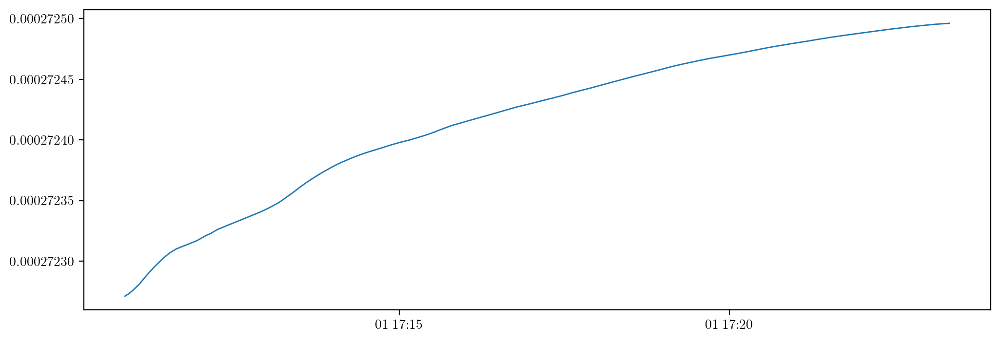

In [ ]:
plt.plot(fast_scoring(497, 200))

In [ ]:
from util_funcs import * 

max_len_id = 'case_4430_depth_trade.csv'
max_prop_id = 'case_2510_depth_trade.csv'

def momentum(id, time = 0, weight = 200, fixed_vol = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    t = pos_data.index[0] if time == 0 else time

    select = trade_data[:t]['ask_p1']
    times = select.index
    diff = trade_data['ask_p1'][t] - select
    tdiff = (times - t).to_numpy(dtype = 'float64')
        
    #   normalises time diff to be between 0 and 100 
    tdiff = -tdiff/tdiff[0]* 100
    gradient = (-diff/tdiff).dropna()

    vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
    if fixed_vol == True:
        vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
    #   normalises weighted mean correctly
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    #   returns momentum as sum of gradient * volume at time t * weighting
    #   where weighting exponentially decays; small weight = closer values weighted more
    return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const

def score(id, log = False, plot = False, show_all = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    def mmtm(time, weight, fixed_vol = False):
        select = trade_data[:time]['ask_p1'] 

        times = select.index

        diff = trade_data['ask_p1'][time] - select
        tdiff = (times - time).to_numpy(dtype = 'float64')
        
        #   normalises time diff to be between 0 and 100 
        tdiff = -tdiff/tdiff[0]* 100
        gradient = (-diff/tdiff).dropna()

        vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
        if fixed_vol == True:
            vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
        #   normalises weighted mean correctly
        norm_const = weight/10 *(1-np.exp(-1000/weight))

        #   returns momentum as sum of gradient * volume at time t * weighting
        #   where weighting exponentially decays; small weight = closer values weighted more
        return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const
    
    pre_short_mom = np.array([mmtm(t, 200) for t in pos_data.index])
    pre_long_mom = np.array([mmtm(t, 100000) for t in pos_data.index])
    pre_short_mom_unweighted = np.array([mmtm(t, 200, fixed_vol=True) for t in pos_data.index])
    pre_long_mom_unweighted = np.array([mmtm(t, 100000, fixed_vol=True) for t in pos_data.index])
    
    if plot == True:
        fig, ax = plt.subplots()
        ax.plot(pos_data.index, pre_short_mom, label = 'short mom')
        ax.plot(pos_data.index, pre_long_mom, label = 'long mom')
        ax.plot(pos_data.index, pre_short_mom_unweighted, label = 'short unw mom')
        ax.plot(pos_data.index, pre_long_mom_unweighted, label = 'long unw mom')
        ax.set(xmargin = 0, title = 'Momentum score at buy times')
        ax.grid()
        ax.legend()

    mean_vol = 1/2*(np.mean(trade_data['ask_tt_volume']) + np.mean(trade_data['bid_tt_volume']))
    
    #   note that momentum approx. is linear with mean volume, so maybe consider normalising if we don't care about trade volume as much? 
    volatility = np.std(returns)
    if log == True:
        volatility = np.log(volatility * 10**5) * 100
    
    if show_all == True:
        #   calculate overall momentum score, weighting long term momentum more; essentially this is 3 parts long momentum 1 part short momentum (unweighted, since weighted short fluctuates like crazy) 
        mom_rms = 1/6 * np.sqrt(abs(np.sign(pre_short_mom)*pre_short_mom**2 + 2* np.sign(pre_long_mom)*pre_long_mom**2 + 2* np.sign(pre_long_mom_unweighted)*pre_long_mom_unweighted**2 + np.sign(pre_short_mom_unweighted) * pre_short_mom_unweighted**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(pre_long_mom_unweighted) * mom_rms / (1000*volatility)

        n = len(pos_data.index)
        df = pd.DataFrame(data = np.array([wghted_score, mean_vol * np.ones(n), volatility * np.ones(n), pre_short_mom, pre_long_mom, pre_short_mom_unweighted, pre_long_mom_unweighted]).transpose(), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = pos_data.index)
        
        return df
    else: 
        short_mom = np.mean(pre_short_mom)
        long_mom = np.mean(pre_long_mom)
        unwghted_short_mom = np.mean(pre_short_mom_unweighted)
        unwghted_long_mom = np.mean(pre_long_mom_unweighted)

        mom_rms = 1/6 * np.sqrt(abs(np.sign(short_mom)*short_mom**2 + 2* np.sign(long_mom)*long_mom**2 + 2* np.sign(unwghted_long_mom)*unwghted_long_mom**2 + np.sign(unwghted_short_mom) * unwghted_short_mom**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(unwghted_long_mom) * mom_rms / (1000*volatility)

        df = pd.DataFrame(data = np.array([wghted_score, mean_vol, volatility, short_mom, long_mom, unwghted_short_mom, unwghted_long_mom]).reshape(1, 7), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = [td[id][5:-16]])
        
        return df

def fast_scoring(id, weight = 100):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    times = pos_data.index
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    vol = 10 **8 * np.var(get_returns(td[id]))
    print(vol, norm_const)
    def score(t):
        s = trade_data['bid_p1'][:t]
        s_ind = (s.index - s.index[0]).to_numpy(dtype = 'float64')/(10**10)
        print(s_ind)
        grad = (s - s[0])[1:]/(s_ind[1:])
        #return np.mean(grad)
        return np.sum(grad * np.exp(-10 * (s_ind)[1:]/weight))/norm_const

    return pd.Series(data=[score(t) for t in times], index=times)
    
all_scores = pd.read_csv('files/scored_cases.csv')


#   analysis / diagnostics
def plot_score_vol_cor():
    res = sp.stats.linregress(all_scores['score'], all_scores['mean volume'])
    x = np.linspace(-400,100)
    fig, ax = plt.subplots()
    ax.scatter(all_scores['score'], all_scores['mean volume'], s= 2, label = 'score vs mean volume')
    ax.plot(x, res.intercept - 30000 + res.slope*x, 'g', label = '(intercept adjusted) linear regression on score vs mean volume')
    ax.set(xlim = [-400, 100], ylim = [0, 200000], xlabel = 'score', ylabel = 'mean volume')
    ax.legend(loc = 'lower left')

corr = np.corrcoef(all_scores['score'], all_scores['mean volume'])
#   correlation between them is approx -0.4, pretty sufficiently negatively correlated between score and mean vol

def pnl_by_thres(upper = -200.0, scoring = 'vol'):
    scoring_systems = {'log': 'log vol score', 'no_vol':'no vol score', 'vol': 'score'}
    score = scoring_systems[scoring]
    tradeid = all_scores[all_scores[score] <= upper]['id']
    res = np.zeros((len(pos), 5))
    print(len(tradeid))
    for i in tqdm(tradeid):
        j = int(str(i)[:-1]) if i != 0 else 0
        res[j, :] = pnl_fast(to_df(pos[j]), to_df(td[j]), 1000)
    
    pos_id = [x[5:-8] for x in pos]
    df_res = pd.DataFrame(data = res, index = pos_id, columns = ['profit', 'loss', 'net', 'avg bid', 'avg ask'])
    winrate = len(df_res[df_res['net'] > 0].index)/len(tradeid)
    df_res = df_res[df_res != 0].dropna()
    
    prof_given_w = np.mean(df_res[df_res['net']>0]['net'])
    loss_given_l = np.mean(df_res[df_res['net']<0]['net'])

    pnl = -prof_given_w/loss_given_l

    print(winrate, pnl)
    return df_res.dropna()

def vol_ratio(id):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_before = np.std(data[:start])
    vol_after = np.std(data[start:])

    return vol_after/vol_before

def est_vol(id, n):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_after = np.std(data[start:])
    vol_est = np.std(data[start:][:n])

    return vol_est/vol_after - 1

def plot_price_rolling_c(id, n):
    data = dev_from_rolling_price(td[id], n)

    price = data['price'][n-1:]
    rolling = data['rolling_mean'].dropna()
    gradient = rolling.values[1:]/rolling.values[:-1] * 10
    time = price.index

    fig, (ax, ax1) = plt.subplots(nrows = 2)
    ax.plot(time, price, label = 'price')
    ax.plot(time, rolling, label = 'rolling (n = {0})'.format(n))
    ax1.plot(time[1:], gradient, label = 'gradient')
    ax.set(xmargin = 0, title = 'price and rolling price')
    ax1.set(xmargin=0, title = 'gradient')
    ax.legend()
    ax1.legend()

def pre_vol(id, start = True):
    data = get_returns(td[id])
    start = to_df(pos[id]).index[0] if start == True else to_df(pos[id]).index[-1] 
    return np.std(data[:start])

def plot_price_rolling_diff(id):
    data = dev_from_rolling_price(td[id])
    price_diffs = data['price'].values[499:] - data['price'].values[:-499]
    means = data['diff'].dropna().rolling(500, center=True).mean().dropna()

    price_diffs_centred = price_diffs - price_diffs.mean()
    diff = data.dropna()['diff']
    diff_centred = diff - diff.mean()
    scale = price_diffs @ diff_centred / (diff_centred @ diff_centred)
    print(scale,  price_diffs.mean(),  1.5 * diff.mean())

    fig, ax = plt.subplots()
    ax.set(xmargin = 0)

    ax.plot(data.dropna().index, price_diffs)
    ax.plot(data.dropna().index, 1.5 * diff_centred, c = 'g')
    ax.plot(data.dropna().index, abs(price_diffs - 1.5 * diff_centred), c = 'r')
    ax.axhline(0, c = 'black')
    #ax.plot(data.dropna().index[250:-249], scale * means,)
    #ax.plot(data.dropna().index[250:-249], price_diffs[250:-249] - scale*means)

4.008689351309597 19.865241060018292
[0.0000e+00 1.0000e-02 2.0000e-02 ... 1.1998e+02 1.1999e+02 1.2000e+02]
[0.0000e+00 1.0000e-02 2.0000e-02 ... 1.2004e+02 1.2005e+02 1.2006e+02]
[0.0000e+00 1.0000e-02 2.0000e-02 ... 1.2007e+02 1.2008e+02 1.2009e+02]
[0.0000e+00 1.0000e-02 2.0000e-02 ... 1.2008e+02 1.2009e+02 1.2010e+02]
[0.0000e+00 1.0000e-02 2.0000e-02 ... 1.2009e+02 1.2010e+02 1.2011e+02]
[0.0000e+00 1.0000e-02 2.0000e-02 ... 1.2012e+02 1.2013e+02 1.2014e+02]
[0.0000e+00 1.0000e-02 2.0000e-02 ... 1.2023e+02 1.2024e+02 1.2025e+02]
[0.0000e+00 1.0000e-02 2.0000e-02 ... 1.2025e+02 1.2026e+02 1.2027e+02]
[0.0000e+00 1.0000e-02 2.0000e-02 ... 1.2026e+02 1.2027e+02 1.2028e+02]
[0.0000e+00 1.0000e-02 2.0000e-02 ... 1.2027e+02 1.2028e+02 1.2029e+02]
[0.0000e+00 1.0000e-02 2.0000e-02 ... 1.2028e+02 1.2029e+02 1.2030e+02]
[0.0000e+00 1.0000e-02 2.0000e-02 ... 1.2029e+02 1.2030e+02 1.2031e+02]
[0.0000e+00 1.0000e-02 2.0000e-02 ... 1.2035e+02 1.2036e+02 1.2037e+02]
[0.0000e+00 1.0000e-02 2.00

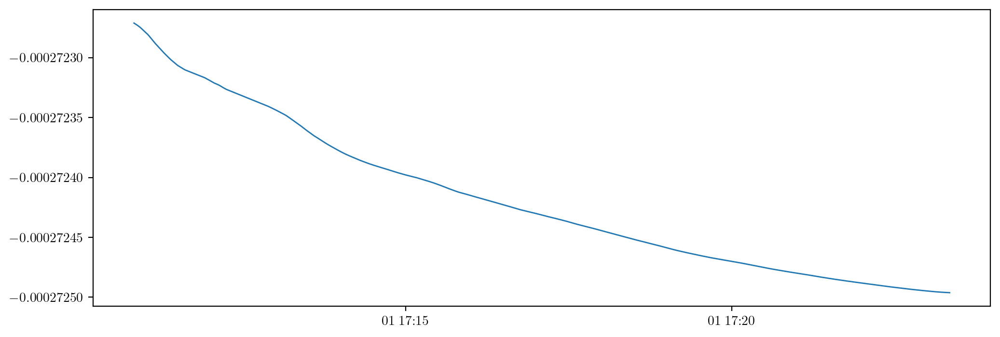

In [ ]:
plt.plot(fast_scoring(497, 200))

In [ ]:
from util_funcs import * 

max_len_id = 'case_4430_depth_trade.csv'
max_prop_id = 'case_2510_depth_trade.csv'

def momentum(id, time = 0, weight = 200, fixed_vol = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    t = pos_data.index[0] if time == 0 else time

    select = trade_data[:t]['ask_p1']
    times = select.index
    diff = trade_data['ask_p1'][t] - select
    tdiff = (times - t).to_numpy(dtype = 'float64')
        
    #   normalises time diff to be between 0 and 100 
    tdiff = -tdiff/tdiff[0]* 100
    gradient = (-diff/tdiff).dropna()

    vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
    if fixed_vol == True:
        vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
    #   normalises weighted mean correctly
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    #   returns momentum as sum of gradient * volume at time t * weighting
    #   where weighting exponentially decays; small weight = closer values weighted more
    return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const

def score(id, log = False, plot = False, show_all = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    def mmtm(time, weight, fixed_vol = False):
        select = trade_data[:time]['ask_p1'] 

        times = select.index

        diff = trade_data['ask_p1'][time] - select
        tdiff = (times - time).to_numpy(dtype = 'float64')
        
        #   normalises time diff to be between 0 and 100 
        tdiff = -tdiff/tdiff[0]* 100
        gradient = (-diff/tdiff).dropna()

        vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
        if fixed_vol == True:
            vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
        #   normalises weighted mean correctly
        norm_const = weight/10 *(1-np.exp(-1000/weight))

        #   returns momentum as sum of gradient * volume at time t * weighting
        #   where weighting exponentially decays; small weight = closer values weighted more
        return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const
    
    pre_short_mom = np.array([mmtm(t, 200) for t in pos_data.index])
    pre_long_mom = np.array([mmtm(t, 100000) for t in pos_data.index])
    pre_short_mom_unweighted = np.array([mmtm(t, 200, fixed_vol=True) for t in pos_data.index])
    pre_long_mom_unweighted = np.array([mmtm(t, 100000, fixed_vol=True) for t in pos_data.index])
    
    if plot == True:
        fig, ax = plt.subplots()
        ax.plot(pos_data.index, pre_short_mom, label = 'short mom')
        ax.plot(pos_data.index, pre_long_mom, label = 'long mom')
        ax.plot(pos_data.index, pre_short_mom_unweighted, label = 'short unw mom')
        ax.plot(pos_data.index, pre_long_mom_unweighted, label = 'long unw mom')
        ax.set(xmargin = 0, title = 'Momentum score at buy times')
        ax.grid()
        ax.legend()

    mean_vol = 1/2*(np.mean(trade_data['ask_tt_volume']) + np.mean(trade_data['bid_tt_volume']))
    
    #   note that momentum approx. is linear with mean volume, so maybe consider normalising if we don't care about trade volume as much? 
    volatility = np.std(returns)
    if log == True:
        volatility = np.log(volatility * 10**5) * 100
    
    if show_all == True:
        #   calculate overall momentum score, weighting long term momentum more; essentially this is 3 parts long momentum 1 part short momentum (unweighted, since weighted short fluctuates like crazy) 
        mom_rms = 1/6 * np.sqrt(abs(np.sign(pre_short_mom)*pre_short_mom**2 + 2* np.sign(pre_long_mom)*pre_long_mom**2 + 2* np.sign(pre_long_mom_unweighted)*pre_long_mom_unweighted**2 + np.sign(pre_short_mom_unweighted) * pre_short_mom_unweighted**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(pre_long_mom_unweighted) * mom_rms / (1000*volatility)

        n = len(pos_data.index)
        df = pd.DataFrame(data = np.array([wghted_score, mean_vol * np.ones(n), volatility * np.ones(n), pre_short_mom, pre_long_mom, pre_short_mom_unweighted, pre_long_mom_unweighted]).transpose(), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = pos_data.index)
        
        return df
    else: 
        short_mom = np.mean(pre_short_mom)
        long_mom = np.mean(pre_long_mom)
        unwghted_short_mom = np.mean(pre_short_mom_unweighted)
        unwghted_long_mom = np.mean(pre_long_mom_unweighted)

        mom_rms = 1/6 * np.sqrt(abs(np.sign(short_mom)*short_mom**2 + 2* np.sign(long_mom)*long_mom**2 + 2* np.sign(unwghted_long_mom)*unwghted_long_mom**2 + np.sign(unwghted_short_mom) * unwghted_short_mom**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(unwghted_long_mom) * mom_rms / (1000*volatility)

        df = pd.DataFrame(data = np.array([wghted_score, mean_vol, volatility, short_mom, long_mom, unwghted_short_mom, unwghted_long_mom]).reshape(1, 7), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = [td[id][5:-16]])
        
        return df

def fast_scoring(id, weight = 100):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    times = pos_data.index
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    vol = 10 **8 * np.var(get_returns(td[id]))
    print(vol, norm_const)
    def score(t):
        s = trade_data['bid_p1'][:t]
        s_ind = (s.index - s.index[0]).to_numpy(dtype = 'float64')/(10**12 * len(s.index))
        print(s_ind)
        grad = (s - s[0])[1:]/(s_ind[1:])
        #return np.mean(grad)
        return np.sum(grad * np.exp(-10 * (s_ind)[1:]/weight))/norm_const

    return pd.Series(data=[score(t) for t in times], index=times)
    
all_scores = pd.read_csv('files/scored_cases.csv')


#   analysis / diagnostics
def plot_score_vol_cor():
    res = sp.stats.linregress(all_scores['score'], all_scores['mean volume'])
    x = np.linspace(-400,100)
    fig, ax = plt.subplots()
    ax.scatter(all_scores['score'], all_scores['mean volume'], s= 2, label = 'score vs mean volume')
    ax.plot(x, res.intercept - 30000 + res.slope*x, 'g', label = '(intercept adjusted) linear regression on score vs mean volume')
    ax.set(xlim = [-400, 100], ylim = [0, 200000], xlabel = 'score', ylabel = 'mean volume')
    ax.legend(loc = 'lower left')

corr = np.corrcoef(all_scores['score'], all_scores['mean volume'])
#   correlation between them is approx -0.4, pretty sufficiently negatively correlated between score and mean vol

def pnl_by_thres(upper = -200.0, scoring = 'vol'):
    scoring_systems = {'log': 'log vol score', 'no_vol':'no vol score', 'vol': 'score'}
    score = scoring_systems[scoring]
    tradeid = all_scores[all_scores[score] <= upper]['id']
    res = np.zeros((len(pos), 5))
    print(len(tradeid))
    for i in tqdm(tradeid):
        j = int(str(i)[:-1]) if i != 0 else 0
        res[j, :] = pnl_fast(to_df(pos[j]), to_df(td[j]), 1000)
    
    pos_id = [x[5:-8] for x in pos]
    df_res = pd.DataFrame(data = res, index = pos_id, columns = ['profit', 'loss', 'net', 'avg bid', 'avg ask'])
    winrate = len(df_res[df_res['net'] > 0].index)/len(tradeid)
    df_res = df_res[df_res != 0].dropna()
    
    prof_given_w = np.mean(df_res[df_res['net']>0]['net'])
    loss_given_l = np.mean(df_res[df_res['net']<0]['net'])

    pnl = -prof_given_w/loss_given_l

    print(winrate, pnl)
    return df_res.dropna()

def vol_ratio(id):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_before = np.std(data[:start])
    vol_after = np.std(data[start:])

    return vol_after/vol_before

def est_vol(id, n):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_after = np.std(data[start:])
    vol_est = np.std(data[start:][:n])

    return vol_est/vol_after - 1

def plot_price_rolling_c(id, n):
    data = dev_from_rolling_price(td[id], n)

    price = data['price'][n-1:]
    rolling = data['rolling_mean'].dropna()
    gradient = rolling.values[1:]/rolling.values[:-1] * 10
    time = price.index

    fig, (ax, ax1) = plt.subplots(nrows = 2)
    ax.plot(time, price, label = 'price')
    ax.plot(time, rolling, label = 'rolling (n = {0})'.format(n))
    ax1.plot(time[1:], gradient, label = 'gradient')
    ax.set(xmargin = 0, title = 'price and rolling price')
    ax1.set(xmargin=0, title = 'gradient')
    ax.legend()
    ax1.legend()

def pre_vol(id, start = True):
    data = get_returns(td[id])
    start = to_df(pos[id]).index[0] if start == True else to_df(pos[id]).index[-1] 
    return np.std(data[:start])

def plot_price_rolling_diff(id):
    data = dev_from_rolling_price(td[id])
    price_diffs = data['price'].values[499:] - data['price'].values[:-499]
    means = data['diff'].dropna().rolling(500, center=True).mean().dropna()

    price_diffs_centred = price_diffs - price_diffs.mean()
    diff = data.dropna()['diff']
    diff_centred = diff - diff.mean()
    scale = price_diffs @ diff_centred / (diff_centred @ diff_centred)
    print(scale,  price_diffs.mean(),  1.5 * diff.mean())

    fig, ax = plt.subplots()
    ax.set(xmargin = 0)

    ax.plot(data.dropna().index, price_diffs)
    ax.plot(data.dropna().index, 1.5 * diff_centred, c = 'g')
    ax.plot(data.dropna().index, abs(price_diffs - 1.5 * diff_centred), c = 'r')
    ax.axhline(0, c = 'black')
    #ax.plot(data.dropna().index[250:-249], scale * means,)
    #ax.plot(data.dropna().index[250:-249], price_diffs[250:-249] - scale*means)

4.008689351309597 19.865241060018292
[0.00000000e+00 8.33263895e-09 1.66652779e-08 ... 9.99750021e-05
 9.99833347e-05 9.99916674e-05]
[0.00000000e+00 8.32847506e-09 1.66569501e-08 ... 9.99750146e-05
 9.99833430e-05 9.99916715e-05]
[0.00000000e+00 8.32639467e-09 1.66527893e-08 ... 9.99750208e-05
 9.99833472e-05 9.99916736e-05]
[0.00000000e+00 8.32570144e-09 1.66514029e-08 ... 9.99750229e-05
 9.99833486e-05 9.99916743e-05]
[0.00000000e+00 8.32500833e-09 1.66500167e-08 ... 9.99750250e-05
 9.99833500e-05 9.99916750e-05]
[0.00000000e+00 8.32292967e-09 1.66458593e-08 ... 9.99750312e-05
 9.99833541e-05 9.99916771e-05]
[0.00000000e+00 8.31531681e-09 1.66306336e-08 ... 9.99750540e-05
 9.99833694e-05 9.99916847e-05]
[0.00000000e+00 8.31393415e-09 1.66278683e-08 ... 9.99750582e-05
 9.99833721e-05 9.99916861e-05]
[0.00000000e+00 8.31324300e-09 1.66264860e-08 ... 9.99750603e-05
 9.99833735e-05 9.99916868e-05]
[0.00000000e+00 8.31255195e-09 1.66251039e-08 ... 9.99750623e-05
 9.99833749e-05 9.9991687

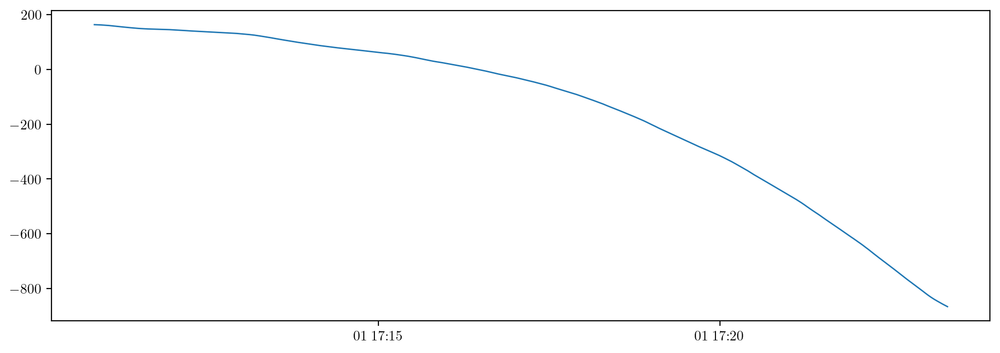

In [ ]:
plt.plot(fast_scoring(497, 200))

In [ ]:
from util_funcs import * 

max_len_id = 'case_4430_depth_trade.csv'
max_prop_id = 'case_2510_depth_trade.csv'

def momentum(id, time = 0, weight = 200, fixed_vol = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    t = pos_data.index[0] if time == 0 else time

    select = trade_data[:t]['ask_p1']
    times = select.index
    diff = trade_data['ask_p1'][t] - select
    tdiff = (times - t).to_numpy(dtype = 'float64')
        
    #   normalises time diff to be between 0 and 100 
    tdiff = -tdiff/tdiff[0]* 100
    gradient = (-diff/tdiff).dropna()

    vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
    if fixed_vol == True:
        vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
    #   normalises weighted mean correctly
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    #   returns momentum as sum of gradient * volume at time t * weighting
    #   where weighting exponentially decays; small weight = closer values weighted more
    return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const

def score(id, log = False, plot = False, show_all = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    def mmtm(time, weight, fixed_vol = False):
        select = trade_data[:time]['ask_p1'] 

        times = select.index

        diff = trade_data['ask_p1'][time] - select
        tdiff = (times - time).to_numpy(dtype = 'float64')
        
        #   normalises time diff to be between 0 and 100 
        tdiff = -tdiff/tdiff[0]* 100
        gradient = (-diff/tdiff).dropna()

        vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
        if fixed_vol == True:
            vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
        #   normalises weighted mean correctly
        norm_const = weight/10 *(1-np.exp(-1000/weight))

        #   returns momentum as sum of gradient * volume at time t * weighting
        #   where weighting exponentially decays; small weight = closer values weighted more
        return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const
    
    pre_short_mom = np.array([mmtm(t, 200) for t in pos_data.index])
    pre_long_mom = np.array([mmtm(t, 100000) for t in pos_data.index])
    pre_short_mom_unweighted = np.array([mmtm(t, 200, fixed_vol=True) for t in pos_data.index])
    pre_long_mom_unweighted = np.array([mmtm(t, 100000, fixed_vol=True) for t in pos_data.index])
    
    if plot == True:
        fig, ax = plt.subplots()
        ax.plot(pos_data.index, pre_short_mom, label = 'short mom')
        ax.plot(pos_data.index, pre_long_mom, label = 'long mom')
        ax.plot(pos_data.index, pre_short_mom_unweighted, label = 'short unw mom')
        ax.plot(pos_data.index, pre_long_mom_unweighted, label = 'long unw mom')
        ax.set(xmargin = 0, title = 'Momentum score at buy times')
        ax.grid()
        ax.legend()

    mean_vol = 1/2*(np.mean(trade_data['ask_tt_volume']) + np.mean(trade_data['bid_tt_volume']))
    
    #   note that momentum approx. is linear with mean volume, so maybe consider normalising if we don't care about trade volume as much? 
    volatility = np.std(returns)
    if log == True:
        volatility = np.log(volatility * 10**5) * 100
    
    if show_all == True:
        #   calculate overall momentum score, weighting long term momentum more; essentially this is 3 parts long momentum 1 part short momentum (unweighted, since weighted short fluctuates like crazy) 
        mom_rms = 1/6 * np.sqrt(abs(np.sign(pre_short_mom)*pre_short_mom**2 + 2* np.sign(pre_long_mom)*pre_long_mom**2 + 2* np.sign(pre_long_mom_unweighted)*pre_long_mom_unweighted**2 + np.sign(pre_short_mom_unweighted) * pre_short_mom_unweighted**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(pre_long_mom_unweighted) * mom_rms / (1000*volatility)

        n = len(pos_data.index)
        df = pd.DataFrame(data = np.array([wghted_score, mean_vol * np.ones(n), volatility * np.ones(n), pre_short_mom, pre_long_mom, pre_short_mom_unweighted, pre_long_mom_unweighted]).transpose(), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = pos_data.index)
        
        return df
    else: 
        short_mom = np.mean(pre_short_mom)
        long_mom = np.mean(pre_long_mom)
        unwghted_short_mom = np.mean(pre_short_mom_unweighted)
        unwghted_long_mom = np.mean(pre_long_mom_unweighted)

        mom_rms = 1/6 * np.sqrt(abs(np.sign(short_mom)*short_mom**2 + 2* np.sign(long_mom)*long_mom**2 + 2* np.sign(unwghted_long_mom)*unwghted_long_mom**2 + np.sign(unwghted_short_mom) * unwghted_short_mom**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(unwghted_long_mom) * mom_rms / (1000*volatility)

        df = pd.DataFrame(data = np.array([wghted_score, mean_vol, volatility, short_mom, long_mom, unwghted_short_mom, unwghted_long_mom]).reshape(1, 7), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = [td[id][5:-16]])
        
        return df

def fast_scoring(id, weight = 100):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    times = pos_data.index
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    vol = 10 **8 * np.var(get_returns(td[id]))
    print(vol, norm_const)
    def score(t):
        s = trade_data['bid_p1'][:t]
        s_ind = (s.index - s.index[0]).to_numpy(dtype = 'float64')/(10**7 * len(s.index))
        print(s_ind)
        grad = (s - s[0])[1:]/(s_ind[1:])
        #return np.mean(grad)
        return np.sum(grad * np.exp(-10 * (s_ind)[1:]/weight))/norm_const

    return pd.Series(data=[score(t) for t in times], index=times)
    
all_scores = pd.read_csv('files/scored_cases.csv')


#   analysis / diagnostics
def plot_score_vol_cor():
    res = sp.stats.linregress(all_scores['score'], all_scores['mean volume'])
    x = np.linspace(-400,100)
    fig, ax = plt.subplots()
    ax.scatter(all_scores['score'], all_scores['mean volume'], s= 2, label = 'score vs mean volume')
    ax.plot(x, res.intercept - 30000 + res.slope*x, 'g', label = '(intercept adjusted) linear regression on score vs mean volume')
    ax.set(xlim = [-400, 100], ylim = [0, 200000], xlabel = 'score', ylabel = 'mean volume')
    ax.legend(loc = 'lower left')

corr = np.corrcoef(all_scores['score'], all_scores['mean volume'])
#   correlation between them is approx -0.4, pretty sufficiently negatively correlated between score and mean vol

def pnl_by_thres(upper = -200.0, scoring = 'vol'):
    scoring_systems = {'log': 'log vol score', 'no_vol':'no vol score', 'vol': 'score'}
    score = scoring_systems[scoring]
    tradeid = all_scores[all_scores[score] <= upper]['id']
    res = np.zeros((len(pos), 5))
    print(len(tradeid))
    for i in tqdm(tradeid):
        j = int(str(i)[:-1]) if i != 0 else 0
        res[j, :] = pnl_fast(to_df(pos[j]), to_df(td[j]), 1000)
    
    pos_id = [x[5:-8] for x in pos]
    df_res = pd.DataFrame(data = res, index = pos_id, columns = ['profit', 'loss', 'net', 'avg bid', 'avg ask'])
    winrate = len(df_res[df_res['net'] > 0].index)/len(tradeid)
    df_res = df_res[df_res != 0].dropna()
    
    prof_given_w = np.mean(df_res[df_res['net']>0]['net'])
    loss_given_l = np.mean(df_res[df_res['net']<0]['net'])

    pnl = -prof_given_w/loss_given_l

    print(winrate, pnl)
    return df_res.dropna()

def vol_ratio(id):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_before = np.std(data[:start])
    vol_after = np.std(data[start:])

    return vol_after/vol_before

def est_vol(id, n):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_after = np.std(data[start:])
    vol_est = np.std(data[start:][:n])

    return vol_est/vol_after - 1

def plot_price_rolling_c(id, n):
    data = dev_from_rolling_price(td[id], n)

    price = data['price'][n-1:]
    rolling = data['rolling_mean'].dropna()
    gradient = rolling.values[1:]/rolling.values[:-1] * 10
    time = price.index

    fig, (ax, ax1) = plt.subplots(nrows = 2)
    ax.plot(time, price, label = 'price')
    ax.plot(time, rolling, label = 'rolling (n = {0})'.format(n))
    ax1.plot(time[1:], gradient, label = 'gradient')
    ax.set(xmargin = 0, title = 'price and rolling price')
    ax1.set(xmargin=0, title = 'gradient')
    ax.legend()
    ax1.legend()

def pre_vol(id, start = True):
    data = get_returns(td[id])
    start = to_df(pos[id]).index[0] if start == True else to_df(pos[id]).index[-1] 
    return np.std(data[:start])

def plot_price_rolling_diff(id):
    data = dev_from_rolling_price(td[id])
    price_diffs = data['price'].values[499:] - data['price'].values[:-499]
    means = data['diff'].dropna().rolling(500, center=True).mean().dropna()

    price_diffs_centred = price_diffs - price_diffs.mean()
    diff = data.dropna()['diff']
    diff_centred = diff - diff.mean()
    scale = price_diffs @ diff_centred / (diff_centred @ diff_centred)
    print(scale,  price_diffs.mean(),  1.5 * diff.mean())

    fig, ax = plt.subplots()
    ax.set(xmargin = 0)

    ax.plot(data.dropna().index, price_diffs)
    ax.plot(data.dropna().index, 1.5 * diff_centred, c = 'g')
    ax.plot(data.dropna().index, abs(price_diffs - 1.5 * diff_centred), c = 'r')
    ax.axhline(0, c = 'black')
    #ax.plot(data.dropna().index[250:-249], scale * means,)
    #ax.plot(data.dropna().index[250:-249], price_diffs[250:-249] - scale*means)

4.008689351309597 19.865241060018292
[0.00000000e+00 8.33263895e-04 1.66652779e-03 ... 9.99750021e+00
 9.99833347e+00 9.99916674e+00]
[0.00000000e+00 8.32847506e-04 1.66569501e-03 ... 9.99750146e+00
 9.99833430e+00 9.99916715e+00]
[0.00000000e+00 8.32639467e-04 1.66527893e-03 ... 9.99750208e+00
 9.99833472e+00 9.99916736e+00]
[0.00000000e+00 8.32570144e-04 1.66514029e-03 ... 9.99750229e+00
 9.99833486e+00 9.99916743e+00]
[0.00000000e+00 8.32500833e-04 1.66500167e-03 ... 9.99750250e+00
 9.99833500e+00 9.99916750e+00]
[0.00000000e+00 8.32292967e-04 1.66458593e-03 ... 9.99750312e+00
 9.99833541e+00 9.99916771e+00]
[0.00000000e+00 8.31531681e-04 1.66306336e-03 ... 9.99750540e+00
 9.99833694e+00 9.99916847e+00]
[0.00000000e+00 8.31393415e-04 1.66278683e-03 ... 9.99750582e+00
 9.99833721e+00 9.99916861e+00]
[0.00000000e+00 8.31324300e-04 1.66264860e-03 ... 9.99750603e+00
 9.99833735e+00 9.99916868e+00]
[0.00000000e+00 8.31255195e-04 1.66251039e-03 ... 9.99750623e+00
 9.99833749e+00 9.9991687

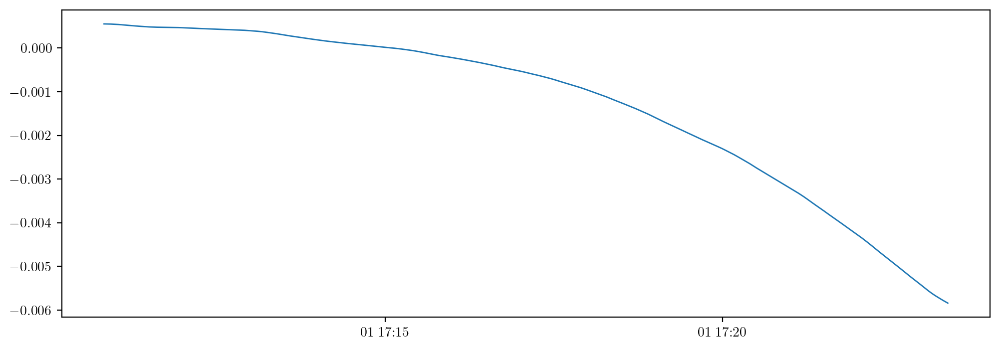

In [ ]:
plt.plot(fast_scoring(497, 200))

In [ ]:
from util_funcs import * 

max_len_id = 'case_4430_depth_trade.csv'
max_prop_id = 'case_2510_depth_trade.csv'

def momentum(id, time = 0, weight = 200, fixed_vol = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    t = pos_data.index[0] if time == 0 else time

    select = trade_data[:t]['ask_p1']
    times = select.index
    diff = trade_data['ask_p1'][t] - select
    tdiff = (times - t).to_numpy(dtype = 'float64')
        
    #   normalises time diff to be between 0 and 100 
    tdiff = -tdiff/tdiff[0]* 100
    gradient = (-diff/tdiff).dropna()

    vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
    if fixed_vol == True:
        vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
    #   normalises weighted mean correctly
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    #   returns momentum as sum of gradient * volume at time t * weighting
    #   where weighting exponentially decays; small weight = closer values weighted more
    return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const

def score(id, log = False, plot = False, show_all = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    def mmtm(time, weight, fixed_vol = False):
        select = trade_data[:time]['ask_p1'] 

        times = select.index

        diff = trade_data['ask_p1'][time] - select
        tdiff = (times - time).to_numpy(dtype = 'float64')
        
        #   normalises time diff to be between 0 and 100 
        tdiff = -tdiff/tdiff[0]* 100
        gradient = (-diff/tdiff).dropna()

        vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
        if fixed_vol == True:
            vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
        #   normalises weighted mean correctly
        norm_const = weight/10 *(1-np.exp(-1000/weight))

        #   returns momentum as sum of gradient * volume at time t * weighting
        #   where weighting exponentially decays; small weight = closer values weighted more
        return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const
    
    pre_short_mom = np.array([mmtm(t, 200) for t in pos_data.index])
    pre_long_mom = np.array([mmtm(t, 100000) for t in pos_data.index])
    pre_short_mom_unweighted = np.array([mmtm(t, 200, fixed_vol=True) for t in pos_data.index])
    pre_long_mom_unweighted = np.array([mmtm(t, 100000, fixed_vol=True) for t in pos_data.index])
    
    if plot == True:
        fig, ax = plt.subplots()
        ax.plot(pos_data.index, pre_short_mom, label = 'short mom')
        ax.plot(pos_data.index, pre_long_mom, label = 'long mom')
        ax.plot(pos_data.index, pre_short_mom_unweighted, label = 'short unw mom')
        ax.plot(pos_data.index, pre_long_mom_unweighted, label = 'long unw mom')
        ax.set(xmargin = 0, title = 'Momentum score at buy times')
        ax.grid()
        ax.legend()

    mean_vol = 1/2*(np.mean(trade_data['ask_tt_volume']) + np.mean(trade_data['bid_tt_volume']))
    
    #   note that momentum approx. is linear with mean volume, so maybe consider normalising if we don't care about trade volume as much? 
    volatility = np.std(returns)
    if log == True:
        volatility = np.log(volatility * 10**5) * 100
    
    if show_all == True:
        #   calculate overall momentum score, weighting long term momentum more; essentially this is 3 parts long momentum 1 part short momentum (unweighted, since weighted short fluctuates like crazy) 
        mom_rms = 1/6 * np.sqrt(abs(np.sign(pre_short_mom)*pre_short_mom**2 + 2* np.sign(pre_long_mom)*pre_long_mom**2 + 2* np.sign(pre_long_mom_unweighted)*pre_long_mom_unweighted**2 + np.sign(pre_short_mom_unweighted) * pre_short_mom_unweighted**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(pre_long_mom_unweighted) * mom_rms / (1000*volatility)

        n = len(pos_data.index)
        df = pd.DataFrame(data = np.array([wghted_score, mean_vol * np.ones(n), volatility * np.ones(n), pre_short_mom, pre_long_mom, pre_short_mom_unweighted, pre_long_mom_unweighted]).transpose(), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = pos_data.index)
        
        return df
    else: 
        short_mom = np.mean(pre_short_mom)
        long_mom = np.mean(pre_long_mom)
        unwghted_short_mom = np.mean(pre_short_mom_unweighted)
        unwghted_long_mom = np.mean(pre_long_mom_unweighted)

        mom_rms = 1/6 * np.sqrt(abs(np.sign(short_mom)*short_mom**2 + 2* np.sign(long_mom)*long_mom**2 + 2* np.sign(unwghted_long_mom)*unwghted_long_mom**2 + np.sign(unwghted_short_mom) * unwghted_short_mom**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(unwghted_long_mom) * mom_rms / (1000*volatility)

        df = pd.DataFrame(data = np.array([wghted_score, mean_vol, volatility, short_mom, long_mom, unwghted_short_mom, unwghted_long_mom]).reshape(1, 7), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = [td[id][5:-16]])
        
        return df

def fast_scoring(id, weight = 100):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    times = pos_data.index
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    vol = 10 **8 * np.var(get_returns(td[id]))
    print(vol, norm_const)
    def score(t):
        s = trade_data['bid_p1'][:t]
        s_ind = (s.index - s.index[0]).to_numpy(dtype = 'float64')/(10**5 * len(s.index))
        print(s_ind)
        grad = (s - s[0])[1:]/(s_ind[1:])
        #return np.mean(grad)
        return np.sum(grad * np.exp(-10 * (s_ind)[1:]/weight))/norm_const

    return pd.Series(data=[score(t) for t in times], index=times)
    
all_scores = pd.read_csv('files/scored_cases.csv')


#   analysis / diagnostics
def plot_score_vol_cor():
    res = sp.stats.linregress(all_scores['score'], all_scores['mean volume'])
    x = np.linspace(-400,100)
    fig, ax = plt.subplots()
    ax.scatter(all_scores['score'], all_scores['mean volume'], s= 2, label = 'score vs mean volume')
    ax.plot(x, res.intercept - 30000 + res.slope*x, 'g', label = '(intercept adjusted) linear regression on score vs mean volume')
    ax.set(xlim = [-400, 100], ylim = [0, 200000], xlabel = 'score', ylabel = 'mean volume')
    ax.legend(loc = 'lower left')

corr = np.corrcoef(all_scores['score'], all_scores['mean volume'])
#   correlation between them is approx -0.4, pretty sufficiently negatively correlated between score and mean vol

def pnl_by_thres(upper = -200.0, scoring = 'vol'):
    scoring_systems = {'log': 'log vol score', 'no_vol':'no vol score', 'vol': 'score'}
    score = scoring_systems[scoring]
    tradeid = all_scores[all_scores[score] <= upper]['id']
    res = np.zeros((len(pos), 5))
    print(len(tradeid))
    for i in tqdm(tradeid):
        j = int(str(i)[:-1]) if i != 0 else 0
        res[j, :] = pnl_fast(to_df(pos[j]), to_df(td[j]), 1000)
    
    pos_id = [x[5:-8] for x in pos]
    df_res = pd.DataFrame(data = res, index = pos_id, columns = ['profit', 'loss', 'net', 'avg bid', 'avg ask'])
    winrate = len(df_res[df_res['net'] > 0].index)/len(tradeid)
    df_res = df_res[df_res != 0].dropna()
    
    prof_given_w = np.mean(df_res[df_res['net']>0]['net'])
    loss_given_l = np.mean(df_res[df_res['net']<0]['net'])

    pnl = -prof_given_w/loss_given_l

    print(winrate, pnl)
    return df_res.dropna()

def vol_ratio(id):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_before = np.std(data[:start])
    vol_after = np.std(data[start:])

    return vol_after/vol_before

def est_vol(id, n):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_after = np.std(data[start:])
    vol_est = np.std(data[start:][:n])

    return vol_est/vol_after - 1

def plot_price_rolling_c(id, n):
    data = dev_from_rolling_price(td[id], n)

    price = data['price'][n-1:]
    rolling = data['rolling_mean'].dropna()
    gradient = rolling.values[1:]/rolling.values[:-1] * 10
    time = price.index

    fig, (ax, ax1) = plt.subplots(nrows = 2)
    ax.plot(time, price, label = 'price')
    ax.plot(time, rolling, label = 'rolling (n = {0})'.format(n))
    ax1.plot(time[1:], gradient, label = 'gradient')
    ax.set(xmargin = 0, title = 'price and rolling price')
    ax1.set(xmargin=0, title = 'gradient')
    ax.legend()
    ax1.legend()

def pre_vol(id, start = True):
    data = get_returns(td[id])
    start = to_df(pos[id]).index[0] if start == True else to_df(pos[id]).index[-1] 
    return np.std(data[:start])

def plot_price_rolling_diff(id):
    data = dev_from_rolling_price(td[id])
    price_diffs = data['price'].values[499:] - data['price'].values[:-499]
    means = data['diff'].dropna().rolling(500, center=True).mean().dropna()

    price_diffs_centred = price_diffs - price_diffs.mean()
    diff = data.dropna()['diff']
    diff_centred = diff - diff.mean()
    scale = price_diffs @ diff_centred / (diff_centred @ diff_centred)
    print(scale,  price_diffs.mean(),  1.5 * diff.mean())

    fig, ax = plt.subplots()
    ax.set(xmargin = 0)

    ax.plot(data.dropna().index, price_diffs)
    ax.plot(data.dropna().index, 1.5 * diff_centred, c = 'g')
    ax.plot(data.dropna().index, abs(price_diffs - 1.5 * diff_centred), c = 'r')
    ax.axhline(0, c = 'black')
    #ax.plot(data.dropna().index[250:-249], scale * means,)
    #ax.plot(data.dropna().index[250:-249], price_diffs[250:-249] - scale*means)

4.008689351309597 19.865241060018292
[0.00000000e+00 8.33263895e-02 1.66652779e-01 ... 9.99750021e+02
 9.99833347e+02 9.99916674e+02]
[0.00000000e+00 8.32847506e-02 1.66569501e-01 ... 9.99750146e+02
 9.99833430e+02 9.99916715e+02]
[0.00000000e+00 8.32639467e-02 1.66527893e-01 ... 9.99750208e+02
 9.99833472e+02 9.99916736e+02]
[0.00000000e+00 8.32570144e-02 1.66514029e-01 ... 9.99750229e+02
 9.99833486e+02 9.99916743e+02]
[0.00000000e+00 8.32500833e-02 1.66500167e-01 ... 9.99750250e+02
 9.99833500e+02 9.99916750e+02]
[0.00000000e+00 8.32292967e-02 1.66458593e-01 ... 9.99750312e+02
 9.99833541e+02 9.99916771e+02]
[0.00000000e+00 8.31531681e-02 1.66306336e-01 ... 9.99750540e+02
 9.99833694e+02 9.99916847e+02]
[0.00000000e+00 8.31393415e-02 1.66278683e-01 ... 9.99750582e+02
 9.99833721e+02 9.99916861e+02]
[0.00000000e+00 8.31324300e-02 1.66264860e-01 ... 9.99750603e+02
 9.99833735e+02 9.99916868e+02]
[0.00000000e+00 8.31255195e-02 1.66251039e-01 ... 9.99750623e+02
 9.99833749e+02 9.9991687

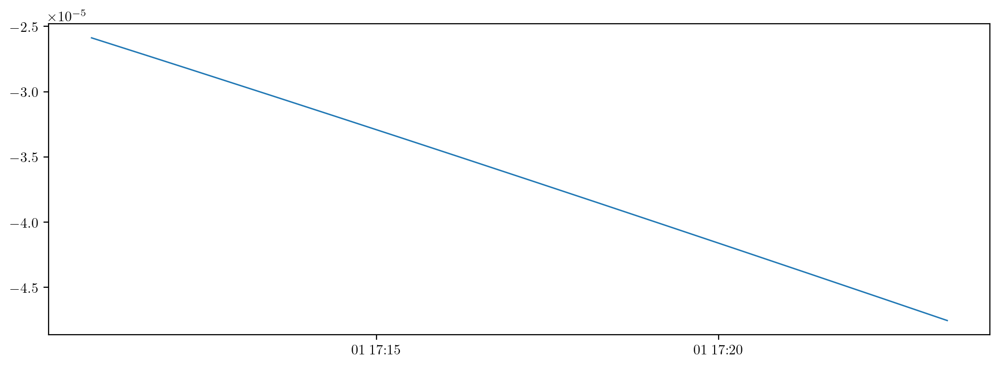

In [ ]:
plt.plot(fast_scoring(497, 200))

In [ ]:
from util_funcs import * 

max_len_id = 'case_4430_depth_trade.csv'
max_prop_id = 'case_2510_depth_trade.csv'

def momentum(id, time = 0, weight = 200, fixed_vol = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    t = pos_data.index[0] if time == 0 else time

    select = trade_data[:t]['ask_p1']
    times = select.index
    diff = trade_data['ask_p1'][t] - select
    tdiff = (times - t).to_numpy(dtype = 'float64')
        
    #   normalises time diff to be between 0 and 100 
    tdiff = -tdiff/tdiff[0]* 100
    gradient = (-diff/tdiff).dropna()

    vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
    if fixed_vol == True:
        vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
    #   normalises weighted mean correctly
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    #   returns momentum as sum of gradient * volume at time t * weighting
    #   where weighting exponentially decays; small weight = closer values weighted more
    return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const

def score(id, log = False, plot = False, show_all = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    def mmtm(time, weight, fixed_vol = False):
        select = trade_data[:time]['ask_p1'] 

        times = select.index

        diff = trade_data['ask_p1'][time] - select
        tdiff = (times - time).to_numpy(dtype = 'float64')
        
        #   normalises time diff to be between 0 and 100 
        tdiff = -tdiff/tdiff[0]* 100
        gradient = (-diff/tdiff).dropna()

        vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
        if fixed_vol == True:
            vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
        #   normalises weighted mean correctly
        norm_const = weight/10 *(1-np.exp(-1000/weight))

        #   returns momentum as sum of gradient * volume at time t * weighting
        #   where weighting exponentially decays; small weight = closer values weighted more
        return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const
    
    pre_short_mom = np.array([mmtm(t, 200) for t in pos_data.index])
    pre_long_mom = np.array([mmtm(t, 100000) for t in pos_data.index])
    pre_short_mom_unweighted = np.array([mmtm(t, 200, fixed_vol=True) for t in pos_data.index])
    pre_long_mom_unweighted = np.array([mmtm(t, 100000, fixed_vol=True) for t in pos_data.index])
    
    if plot == True:
        fig, ax = plt.subplots()
        ax.plot(pos_data.index, pre_short_mom, label = 'short mom')
        ax.plot(pos_data.index, pre_long_mom, label = 'long mom')
        ax.plot(pos_data.index, pre_short_mom_unweighted, label = 'short unw mom')
        ax.plot(pos_data.index, pre_long_mom_unweighted, label = 'long unw mom')
        ax.set(xmargin = 0, title = 'Momentum score at buy times')
        ax.grid()
        ax.legend()

    mean_vol = 1/2*(np.mean(trade_data['ask_tt_volume']) + np.mean(trade_data['bid_tt_volume']))
    
    #   note that momentum approx. is linear with mean volume, so maybe consider normalising if we don't care about trade volume as much? 
    volatility = np.std(returns)
    if log == True:
        volatility = np.log(volatility * 10**5) * 100
    
    if show_all == True:
        #   calculate overall momentum score, weighting long term momentum more; essentially this is 3 parts long momentum 1 part short momentum (unweighted, since weighted short fluctuates like crazy) 
        mom_rms = 1/6 * np.sqrt(abs(np.sign(pre_short_mom)*pre_short_mom**2 + 2* np.sign(pre_long_mom)*pre_long_mom**2 + 2* np.sign(pre_long_mom_unweighted)*pre_long_mom_unweighted**2 + np.sign(pre_short_mom_unweighted) * pre_short_mom_unweighted**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(pre_long_mom_unweighted) * mom_rms / (1000*volatility)

        n = len(pos_data.index)
        df = pd.DataFrame(data = np.array([wghted_score, mean_vol * np.ones(n), volatility * np.ones(n), pre_short_mom, pre_long_mom, pre_short_mom_unweighted, pre_long_mom_unweighted]).transpose(), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = pos_data.index)
        
        return df
    else: 
        short_mom = np.mean(pre_short_mom)
        long_mom = np.mean(pre_long_mom)
        unwghted_short_mom = np.mean(pre_short_mom_unweighted)
        unwghted_long_mom = np.mean(pre_long_mom_unweighted)

        mom_rms = 1/6 * np.sqrt(abs(np.sign(short_mom)*short_mom**2 + 2* np.sign(long_mom)*long_mom**2 + 2* np.sign(unwghted_long_mom)*unwghted_long_mom**2 + np.sign(unwghted_short_mom) * unwghted_short_mom**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(unwghted_long_mom) * mom_rms / (1000*volatility)

        df = pd.DataFrame(data = np.array([wghted_score, mean_vol, volatility, short_mom, long_mom, unwghted_short_mom, unwghted_long_mom]).reshape(1, 7), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = [td[id][5:-16]])
        
        return df

def fast_scoring(id, weight = 100):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    times = pos_data.index
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    vol = 10 **8 * np.var(get_returns(td[id]))
    print(vol, norm_const)
    def score(t):
        s = trade_data['bid_p1'][:t]
        s_ind = (s.index - s.index[0]).to_numpy(dtype = 'float64')/(10**5 * len(s.index))
        print(s_ind)
        grad = (s - s[0])[1:]/(s_ind[1:])
        #return np.mean(grad)
        return 1000 * np.sum(grad * np.exp(-10 * (s_ind)[1:]/weight))/norm_const

    return pd.Series(data=[score(t) for t in times], index=times)
    
all_scores = pd.read_csv('files/scored_cases.csv')


#   analysis / diagnostics
def plot_score_vol_cor():
    res = sp.stats.linregress(all_scores['score'], all_scores['mean volume'])
    x = np.linspace(-400,100)
    fig, ax = plt.subplots()
    ax.scatter(all_scores['score'], all_scores['mean volume'], s= 2, label = 'score vs mean volume')
    ax.plot(x, res.intercept - 30000 + res.slope*x, 'g', label = '(intercept adjusted) linear regression on score vs mean volume')
    ax.set(xlim = [-400, 100], ylim = [0, 200000], xlabel = 'score', ylabel = 'mean volume')
    ax.legend(loc = 'lower left')

corr = np.corrcoef(all_scores['score'], all_scores['mean volume'])
#   correlation between them is approx -0.4, pretty sufficiently negatively correlated between score and mean vol

def pnl_by_thres(upper = -200.0, scoring = 'vol'):
    scoring_systems = {'log': 'log vol score', 'no_vol':'no vol score', 'vol': 'score'}
    score = scoring_systems[scoring]
    tradeid = all_scores[all_scores[score] <= upper]['id']
    res = np.zeros((len(pos), 5))
    print(len(tradeid))
    for i in tqdm(tradeid):
        j = int(str(i)[:-1]) if i != 0 else 0
        res[j, :] = pnl_fast(to_df(pos[j]), to_df(td[j]), 1000)
    
    pos_id = [x[5:-8] for x in pos]
    df_res = pd.DataFrame(data = res, index = pos_id, columns = ['profit', 'loss', 'net', 'avg bid', 'avg ask'])
    winrate = len(df_res[df_res['net'] > 0].index)/len(tradeid)
    df_res = df_res[df_res != 0].dropna()
    
    prof_given_w = np.mean(df_res[df_res['net']>0]['net'])
    loss_given_l = np.mean(df_res[df_res['net']<0]['net'])

    pnl = -prof_given_w/loss_given_l

    print(winrate, pnl)
    return df_res.dropna()

def vol_ratio(id):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_before = np.std(data[:start])
    vol_after = np.std(data[start:])

    return vol_after/vol_before

def est_vol(id, n):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_after = np.std(data[start:])
    vol_est = np.std(data[start:][:n])

    return vol_est/vol_after - 1

def plot_price_rolling_c(id, n):
    data = dev_from_rolling_price(td[id], n)

    price = data['price'][n-1:]
    rolling = data['rolling_mean'].dropna()
    gradient = rolling.values[1:]/rolling.values[:-1] * 10
    time = price.index

    fig, (ax, ax1) = plt.subplots(nrows = 2)
    ax.plot(time, price, label = 'price')
    ax.plot(time, rolling, label = 'rolling (n = {0})'.format(n))
    ax1.plot(time[1:], gradient, label = 'gradient')
    ax.set(xmargin = 0, title = 'price and rolling price')
    ax1.set(xmargin=0, title = 'gradient')
    ax.legend()
    ax1.legend()

def pre_vol(id, start = True):
    data = get_returns(td[id])
    start = to_df(pos[id]).index[0] if start == True else to_df(pos[id]).index[-1] 
    return np.std(data[:start])

def plot_price_rolling_diff(id):
    data = dev_from_rolling_price(td[id])
    price_diffs = data['price'].values[499:] - data['price'].values[:-499]
    means = data['diff'].dropna().rolling(500, center=True).mean().dropna()

    price_diffs_centred = price_diffs - price_diffs.mean()
    diff = data.dropna()['diff']
    diff_centred = diff - diff.mean()
    scale = price_diffs @ diff_centred / (diff_centred @ diff_centred)
    print(scale,  price_diffs.mean(),  1.5 * diff.mean())

    fig, ax = plt.subplots()
    ax.set(xmargin = 0)

    ax.plot(data.dropna().index, price_diffs)
    ax.plot(data.dropna().index, 1.5 * diff_centred, c = 'g')
    ax.plot(data.dropna().index, abs(price_diffs - 1.5 * diff_centred), c = 'r')
    ax.axhline(0, c = 'black')
    #ax.plot(data.dropna().index[250:-249], scale * means,)
    #ax.plot(data.dropna().index[250:-249], price_diffs[250:-249] - scale*means)

4.008689351309597 19.865241060018292
[0.00000000e+00 8.33263895e-02 1.66652779e-01 ... 9.99750021e+02
 9.99833347e+02 9.99916674e+02]
[0.00000000e+00 8.32847506e-02 1.66569501e-01 ... 9.99750146e+02
 9.99833430e+02 9.99916715e+02]
[0.00000000e+00 8.32639467e-02 1.66527893e-01 ... 9.99750208e+02
 9.99833472e+02 9.99916736e+02]
[0.00000000e+00 8.32570144e-02 1.66514029e-01 ... 9.99750229e+02
 9.99833486e+02 9.99916743e+02]
[0.00000000e+00 8.32500833e-02 1.66500167e-01 ... 9.99750250e+02
 9.99833500e+02 9.99916750e+02]
[0.00000000e+00 8.32292967e-02 1.66458593e-01 ... 9.99750312e+02
 9.99833541e+02 9.99916771e+02]
[0.00000000e+00 8.31531681e-02 1.66306336e-01 ... 9.99750540e+02
 9.99833694e+02 9.99916847e+02]
[0.00000000e+00 8.31393415e-02 1.66278683e-01 ... 9.99750582e+02
 9.99833721e+02 9.99916861e+02]
[0.00000000e+00 8.31324300e-02 1.66264860e-01 ... 9.99750603e+02
 9.99833735e+02 9.99916868e+02]
[0.00000000e+00 8.31255195e-02 1.66251039e-01 ... 9.99750623e+02
 9.99833749e+02 9.9991687

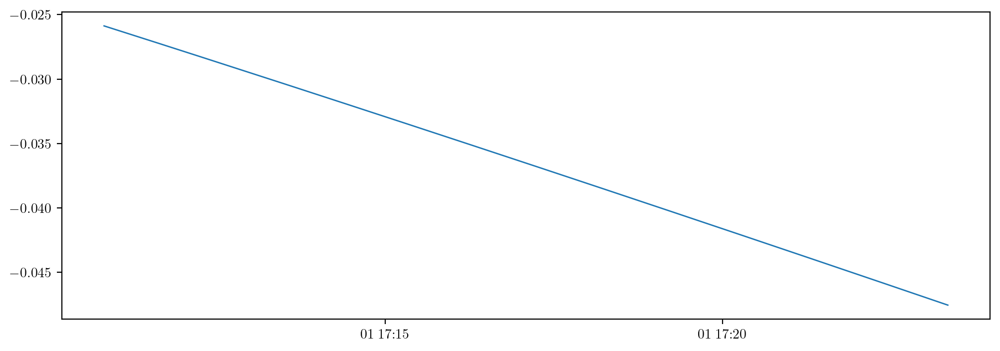

In [ ]:
plt.plot(fast_scoring(497, 200))

In [ ]:
from util_funcs import * 

max_len_id = 'case_4430_depth_trade.csv'
max_prop_id = 'case_2510_depth_trade.csv'

def momentum(id, time = 0, weight = 200, fixed_vol = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    t = pos_data.index[0] if time == 0 else time

    select = trade_data[:t]['ask_p1']
    times = select.index
    diff = trade_data['ask_p1'][t] - select
    tdiff = (times - t).to_numpy(dtype = 'float64')
        
    #   normalises time diff to be between 0 and 100 
    tdiff = -tdiff/tdiff[0]* 100
    gradient = (-diff/tdiff).dropna()

    vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
    if fixed_vol == True:
        vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
    #   normalises weighted mean correctly
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    #   returns momentum as sum of gradient * volume at time t * weighting
    #   where weighting exponentially decays; small weight = closer values weighted more
    return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const

def score(id, log = False, plot = False, show_all = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    def mmtm(time, weight, fixed_vol = False):
        select = trade_data[:time]['ask_p1'] 

        times = select.index

        diff = trade_data['ask_p1'][time] - select
        tdiff = (times - time).to_numpy(dtype = 'float64')
        
        #   normalises time diff to be between 0 and 100 
        tdiff = -tdiff/tdiff[0]* 100
        gradient = (-diff/tdiff).dropna()

        vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
        if fixed_vol == True:
            vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
        #   normalises weighted mean correctly
        norm_const = weight/10 *(1-np.exp(-1000/weight))

        #   returns momentum as sum of gradient * volume at time t * weighting
        #   where weighting exponentially decays; small weight = closer values weighted more
        return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const
    
    pre_short_mom = np.array([mmtm(t, 200) for t in pos_data.index])
    pre_long_mom = np.array([mmtm(t, 100000) for t in pos_data.index])
    pre_short_mom_unweighted = np.array([mmtm(t, 200, fixed_vol=True) for t in pos_data.index])
    pre_long_mom_unweighted = np.array([mmtm(t, 100000, fixed_vol=True) for t in pos_data.index])
    
    if plot == True:
        fig, ax = plt.subplots()
        ax.plot(pos_data.index, pre_short_mom, label = 'short mom')
        ax.plot(pos_data.index, pre_long_mom, label = 'long mom')
        ax.plot(pos_data.index, pre_short_mom_unweighted, label = 'short unw mom')
        ax.plot(pos_data.index, pre_long_mom_unweighted, label = 'long unw mom')
        ax.set(xmargin = 0, title = 'Momentum score at buy times')
        ax.grid()
        ax.legend()

    mean_vol = 1/2*(np.mean(trade_data['ask_tt_volume']) + np.mean(trade_data['bid_tt_volume']))
    
    #   note that momentum approx. is linear with mean volume, so maybe consider normalising if we don't care about trade volume as much? 
    volatility = np.std(returns)
    if log == True:
        volatility = np.log(volatility * 10**5) * 100
    
    if show_all == True:
        #   calculate overall momentum score, weighting long term momentum more; essentially this is 3 parts long momentum 1 part short momentum (unweighted, since weighted short fluctuates like crazy) 
        mom_rms = 1/6 * np.sqrt(abs(np.sign(pre_short_mom)*pre_short_mom**2 + 2* np.sign(pre_long_mom)*pre_long_mom**2 + 2* np.sign(pre_long_mom_unweighted)*pre_long_mom_unweighted**2 + np.sign(pre_short_mom_unweighted) * pre_short_mom_unweighted**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(pre_long_mom_unweighted) * mom_rms / (1000*volatility)

        n = len(pos_data.index)
        df = pd.DataFrame(data = np.array([wghted_score, mean_vol * np.ones(n), volatility * np.ones(n), pre_short_mom, pre_long_mom, pre_short_mom_unweighted, pre_long_mom_unweighted]).transpose(), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = pos_data.index)
        
        return df
    else: 
        short_mom = np.mean(pre_short_mom)
        long_mom = np.mean(pre_long_mom)
        unwghted_short_mom = np.mean(pre_short_mom_unweighted)
        unwghted_long_mom = np.mean(pre_long_mom_unweighted)

        mom_rms = 1/6 * np.sqrt(abs(np.sign(short_mom)*short_mom**2 + 2* np.sign(long_mom)*long_mom**2 + 2* np.sign(unwghted_long_mom)*unwghted_long_mom**2 + np.sign(unwghted_short_mom) * unwghted_short_mom**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(unwghted_long_mom) * mom_rms / (1000*volatility)

        df = pd.DataFrame(data = np.array([wghted_score, mean_vol, volatility, short_mom, long_mom, unwghted_short_mom, unwghted_long_mom]).reshape(1, 7), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = [td[id][5:-16]])
        
        return df

def fast_scoring(id, weight = 100):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    times = pos_data.index
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    vol = 10 **8 * np.var(get_returns(td[id]))
    print(vol, norm_const)
    def score(t):
        s = trade_data['bid_p1'][:t]
        s_ind = (s.index - s.index[0]).to_numpy(dtype = 'float64')/(10**5 * len(s.index))
        grad = (s - s[0])[1:]/(s_ind[1:])
        print(grad)
        #return np.mean(grad)
        return 1000 * np.sum(grad * np.exp(-10 * (s_ind)[1:]/weight))/norm_const

    return pd.Series(data=[score(t) for t in times], index=times)
    
all_scores = pd.read_csv('files/scored_cases.csv')


#   analysis / diagnostics
def plot_score_vol_cor():
    res = sp.stats.linregress(all_scores['score'], all_scores['mean volume'])
    x = np.linspace(-400,100)
    fig, ax = plt.subplots()
    ax.scatter(all_scores['score'], all_scores['mean volume'], s= 2, label = 'score vs mean volume')
    ax.plot(x, res.intercept - 30000 + res.slope*x, 'g', label = '(intercept adjusted) linear regression on score vs mean volume')
    ax.set(xlim = [-400, 100], ylim = [0, 200000], xlabel = 'score', ylabel = 'mean volume')
    ax.legend(loc = 'lower left')

corr = np.corrcoef(all_scores['score'], all_scores['mean volume'])
#   correlation between them is approx -0.4, pretty sufficiently negatively correlated between score and mean vol

def pnl_by_thres(upper = -200.0, scoring = 'vol'):
    scoring_systems = {'log': 'log vol score', 'no_vol':'no vol score', 'vol': 'score'}
    score = scoring_systems[scoring]
    tradeid = all_scores[all_scores[score] <= upper]['id']
    res = np.zeros((len(pos), 5))
    print(len(tradeid))
    for i in tqdm(tradeid):
        j = int(str(i)[:-1]) if i != 0 else 0
        res[j, :] = pnl_fast(to_df(pos[j]), to_df(td[j]), 1000)
    
    pos_id = [x[5:-8] for x in pos]
    df_res = pd.DataFrame(data = res, index = pos_id, columns = ['profit', 'loss', 'net', 'avg bid', 'avg ask'])
    winrate = len(df_res[df_res['net'] > 0].index)/len(tradeid)
    df_res = df_res[df_res != 0].dropna()
    
    prof_given_w = np.mean(df_res[df_res['net']>0]['net'])
    loss_given_l = np.mean(df_res[df_res['net']<0]['net'])

    pnl = -prof_given_w/loss_given_l

    print(winrate, pnl)
    return df_res.dropna()

def vol_ratio(id):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_before = np.std(data[:start])
    vol_after = np.std(data[start:])

    return vol_after/vol_before

def est_vol(id, n):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_after = np.std(data[start:])
    vol_est = np.std(data[start:][:n])

    return vol_est/vol_after - 1

def plot_price_rolling_c(id, n):
    data = dev_from_rolling_price(td[id], n)

    price = data['price'][n-1:]
    rolling = data['rolling_mean'].dropna()
    gradient = rolling.values[1:]/rolling.values[:-1] * 10
    time = price.index

    fig, (ax, ax1) = plt.subplots(nrows = 2)
    ax.plot(time, price, label = 'price')
    ax.plot(time, rolling, label = 'rolling (n = {0})'.format(n))
    ax1.plot(time[1:], gradient, label = 'gradient')
    ax.set(xmargin = 0, title = 'price and rolling price')
    ax1.set(xmargin=0, title = 'gradient')
    ax.legend()
    ax1.legend()

def pre_vol(id, start = True):
    data = get_returns(td[id])
    start = to_df(pos[id]).index[0] if start == True else to_df(pos[id]).index[-1] 
    return np.std(data[:start])

def plot_price_rolling_diff(id):
    data = dev_from_rolling_price(td[id])
    price_diffs = data['price'].values[499:] - data['price'].values[:-499]
    means = data['diff'].dropna().rolling(500, center=True).mean().dropna()

    price_diffs_centred = price_diffs - price_diffs.mean()
    diff = data.dropna()['diff']
    diff_centred = diff - diff.mean()
    scale = price_diffs @ diff_centred / (diff_centred @ diff_centred)
    print(scale,  price_diffs.mean(),  1.5 * diff.mean())

    fig, ax = plt.subplots()
    ax.set(xmargin = 0)

    ax.plot(data.dropna().index, price_diffs)
    ax.plot(data.dropna().index, 1.5 * diff_centred, c = 'g')
    ax.plot(data.dropna().index, abs(price_diffs - 1.5 * diff_centred), c = 'r')
    ax.axhline(0, c = 'black')
    #ax.plot(data.dropna().index[250:-249], scale * means,)
    #ax.plot(data.dropna().index[250:-249], price_diffs[250:-249] - scale*means)

4.008689351309597 19.865241060018292
timestamp
2024-10-01 16:50:50.300    0.00000
2024-10-01 16:50:50.400    0.00001
2024-10-01 16:50:50.500   -0.00002
2024-10-01 16:50:50.600   -0.00002
2024-10-01 16:50:50.700   -0.00002
                            ...   
2024-10-01 17:10:49.800   -0.00000
2024-10-01 17:10:49.900   -0.00000
2024-10-01 17:10:50.000   -0.00000
2024-10-01 17:10:50.100   -0.00000
2024-10-01 17:10:50.200   -0.00000
Name: bid_p1, Length: 12000, dtype: float64
timestamp
2024-10-01 16:50:50.300    0.00000
2024-10-01 16:50:50.400    0.00001
2024-10-01 16:50:50.500   -0.00002
2024-10-01 16:50:50.600   -0.00002
2024-10-01 16:50:50.700   -0.00002
                            ...   
2024-10-01 17:10:50.400   -0.00000
2024-10-01 17:10:50.500   -0.00000
2024-10-01 17:10:50.600   -0.00000
2024-10-01 17:10:50.700   -0.00000
2024-10-01 17:10:50.800   -0.00000
Name: bid_p1, Length: 12006, dtype: float64
timestamp
2024-10-01 16:50:50.300    0.00000
2024-10-01 16:50:50.400    0.00001
2024-

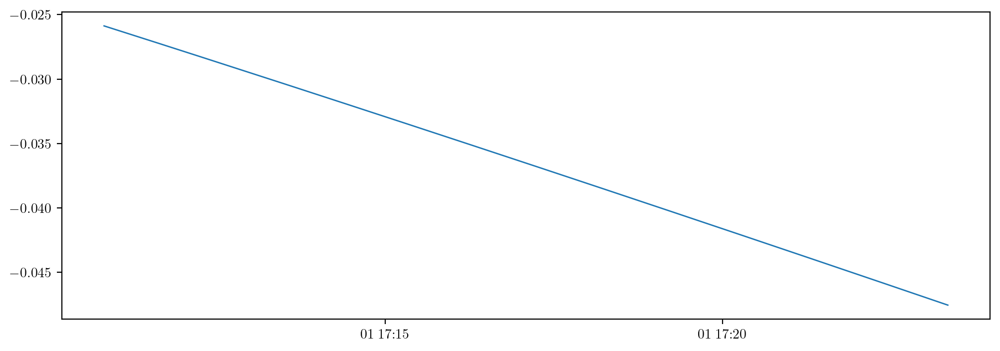

In [ ]:
plt.plot(fast_scoring(497, 200))

In [ ]:
from util_funcs import * 

max_len_id = 'case_4430_depth_trade.csv'
max_prop_id = 'case_2510_depth_trade.csv'

def momentum(id, time = 0, weight = 200, fixed_vol = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    t = pos_data.index[0] if time == 0 else time

    select = trade_data[:t]['ask_p1']
    times = select.index
    diff = trade_data['ask_p1'][t] - select
    tdiff = (times - t).to_numpy(dtype = 'float64')
        
    #   normalises time diff to be between 0 and 100 
    tdiff = -tdiff/tdiff[0]* 100
    gradient = (-diff/tdiff).dropna()

    vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
    if fixed_vol == True:
        vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
    #   normalises weighted mean correctly
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    #   returns momentum as sum of gradient * volume at time t * weighting
    #   where weighting exponentially decays; small weight = closer values weighted more
    return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const

def score(id, log = False, plot = False, show_all = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    def mmtm(time, weight, fixed_vol = False):
        select = trade_data[:time]['ask_p1'] 

        times = select.index

        diff = trade_data['ask_p1'][time] - select
        tdiff = (times - time).to_numpy(dtype = 'float64')
        
        #   normalises time diff to be between 0 and 100 
        tdiff = -tdiff/tdiff[0]* 100
        gradient = (-diff/tdiff).dropna()

        vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
        if fixed_vol == True:
            vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
        #   normalises weighted mean correctly
        norm_const = weight/10 *(1-np.exp(-1000/weight))

        #   returns momentum as sum of gradient * volume at time t * weighting
        #   where weighting exponentially decays; small weight = closer values weighted more
        return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const
    
    pre_short_mom = np.array([mmtm(t, 200) for t in pos_data.index])
    pre_long_mom = np.array([mmtm(t, 100000) for t in pos_data.index])
    pre_short_mom_unweighted = np.array([mmtm(t, 200, fixed_vol=True) for t in pos_data.index])
    pre_long_mom_unweighted = np.array([mmtm(t, 100000, fixed_vol=True) for t in pos_data.index])
    
    if plot == True:
        fig, ax = plt.subplots()
        ax.plot(pos_data.index, pre_short_mom, label = 'short mom')
        ax.plot(pos_data.index, pre_long_mom, label = 'long mom')
        ax.plot(pos_data.index, pre_short_mom_unweighted, label = 'short unw mom')
        ax.plot(pos_data.index, pre_long_mom_unweighted, label = 'long unw mom')
        ax.set(xmargin = 0, title = 'Momentum score at buy times')
        ax.grid()
        ax.legend()

    mean_vol = 1/2*(np.mean(trade_data['ask_tt_volume']) + np.mean(trade_data['bid_tt_volume']))
    
    #   note that momentum approx. is linear with mean volume, so maybe consider normalising if we don't care about trade volume as much? 
    volatility = np.std(returns)
    if log == True:
        volatility = np.log(volatility * 10**5) * 100
    
    if show_all == True:
        #   calculate overall momentum score, weighting long term momentum more; essentially this is 3 parts long momentum 1 part short momentum (unweighted, since weighted short fluctuates like crazy) 
        mom_rms = 1/6 * np.sqrt(abs(np.sign(pre_short_mom)*pre_short_mom**2 + 2* np.sign(pre_long_mom)*pre_long_mom**2 + 2* np.sign(pre_long_mom_unweighted)*pre_long_mom_unweighted**2 + np.sign(pre_short_mom_unweighted) * pre_short_mom_unweighted**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(pre_long_mom_unweighted) * mom_rms / (1000*volatility)

        n = len(pos_data.index)
        df = pd.DataFrame(data = np.array([wghted_score, mean_vol * np.ones(n), volatility * np.ones(n), pre_short_mom, pre_long_mom, pre_short_mom_unweighted, pre_long_mom_unweighted]).transpose(), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = pos_data.index)
        
        return df
    else: 
        short_mom = np.mean(pre_short_mom)
        long_mom = np.mean(pre_long_mom)
        unwghted_short_mom = np.mean(pre_short_mom_unweighted)
        unwghted_long_mom = np.mean(pre_long_mom_unweighted)

        mom_rms = 1/6 * np.sqrt(abs(np.sign(short_mom)*short_mom**2 + 2* np.sign(long_mom)*long_mom**2 + 2* np.sign(unwghted_long_mom)*unwghted_long_mom**2 + np.sign(unwghted_short_mom) * unwghted_short_mom**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(unwghted_long_mom) * mom_rms / (1000*volatility)

        df = pd.DataFrame(data = np.array([wghted_score, mean_vol, volatility, short_mom, long_mom, unwghted_short_mom, unwghted_long_mom]).reshape(1, 7), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = [td[id][5:-16]])
        
        return df
def fast_mmtm(id, weight = 200):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])

    #   normalises weighted mean correctly
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    def score(t):
        select = trade_data[:t]['ask_p1']
        times = select.index
        diff = trade_data['ask_p1'][t] - select
        tdiff = (times - t).to_numpy(dtype = 'float64')
            
        #   normalises time diff to be between 0 and 100 
        tdiff = -tdiff/tdiff[0]* 100
        gradient = (-diff/tdiff).dropna()
         #   returns momentum as sum of gradient * volume at time t * weighting
        #   where weighting exponentially decays; small weight = closer values weighted more
        return 10000 * np.sum(gradient * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const
    
    return pd.Series(data = [score(t) for t in pos_data.index], index = pos_data.index)

   

def fast_scoring(id, weight = 100):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    times = pos_data.index
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    vol = 10 **8 * np.var(get_returns(td[id]))
    print(vol, norm_const)
    def score(t):
        s = trade_data['bid_p1'][:t]
        s_ind = (s.index - s.index[0]).to_numpy(dtype = 'float64')/(10**5 * len(s.index))
        grad = (s - s[0])[1:]/(s_ind[1:])
        print(grad)
        #return np.mean(grad)
        return 1000 * np.sum(grad * np.exp(-10 * (s_ind)[1:]/weight))/norm_const

    return pd.Series(data=[score(t) for t in times], index=times)
    
all_scores = pd.read_csv('files/scored_cases.csv')


#   analysis / diagnostics
def plot_score_vol_cor():
    res = sp.stats.linregress(all_scores['score'], all_scores['mean volume'])
    x = np.linspace(-400,100)
    fig, ax = plt.subplots()
    ax.scatter(all_scores['score'], all_scores['mean volume'], s= 2, label = 'score vs mean volume')
    ax.plot(x, res.intercept - 30000 + res.slope*x, 'g', label = '(intercept adjusted) linear regression on score vs mean volume')
    ax.set(xlim = [-400, 100], ylim = [0, 200000], xlabel = 'score', ylabel = 'mean volume')
    ax.legend(loc = 'lower left')

corr = np.corrcoef(all_scores['score'], all_scores['mean volume'])
#   correlation between them is approx -0.4, pretty sufficiently negatively correlated between score and mean vol

def pnl_by_thres(upper = -200.0, scoring = 'vol'):
    scoring_systems = {'log': 'log vol score', 'no_vol':'no vol score', 'vol': 'score'}
    score = scoring_systems[scoring]
    tradeid = all_scores[all_scores[score] <= upper]['id']
    res = np.zeros((len(pos), 5))
    print(len(tradeid))
    for i in tqdm(tradeid):
        j = int(str(i)[:-1]) if i != 0 else 0
        res[j, :] = pnl_fast(to_df(pos[j]), to_df(td[j]), 1000)
    
    pos_id = [x[5:-8] for x in pos]
    df_res = pd.DataFrame(data = res, index = pos_id, columns = ['profit', 'loss', 'net', 'avg bid', 'avg ask'])
    winrate = len(df_res[df_res['net'] > 0].index)/len(tradeid)
    df_res = df_res[df_res != 0].dropna()
    
    prof_given_w = np.mean(df_res[df_res['net']>0]['net'])
    loss_given_l = np.mean(df_res[df_res['net']<0]['net'])

    pnl = -prof_given_w/loss_given_l

    print(winrate, pnl)
    return df_res.dropna()

def vol_ratio(id):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_before = np.std(data[:start])
    vol_after = np.std(data[start:])

    return vol_after/vol_before

def est_vol(id, n):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_after = np.std(data[start:])
    vol_est = np.std(data[start:][:n])

    return vol_est/vol_after - 1

def plot_price_rolling_c(id, n):
    data = dev_from_rolling_price(td[id], n)

    price = data['price'][n-1:]
    rolling = data['rolling_mean'].dropna()
    gradient = rolling.values[1:]/rolling.values[:-1] * 10
    time = price.index

    fig, (ax, ax1) = plt.subplots(nrows = 2)
    ax.plot(time, price, label = 'price')
    ax.plot(time, rolling, label = 'rolling (n = {0})'.format(n))
    ax1.plot(time[1:], gradient, label = 'gradient')
    ax.set(xmargin = 0, title = 'price and rolling price')
    ax1.set(xmargin=0, title = 'gradient')
    ax.legend()
    ax1.legend()

def pre_vol(id, start = True):
    data = get_returns(td[id])
    start = to_df(pos[id]).index[0] if start == True else to_df(pos[id]).index[-1] 
    return np.std(data[:start])

def plot_price_rolling_diff(id):
    data = dev_from_rolling_price(td[id])
    price_diffs = data['price'].values[499:] - data['price'].values[:-499]
    means = data['diff'].dropna().rolling(500, center=True).mean().dropna()

    price_diffs_centred = price_diffs - price_diffs.mean()
    diff = data.dropna()['diff']
    diff_centred = diff - diff.mean()
    scale = price_diffs @ diff_centred / (diff_centred @ diff_centred)
    print(scale,  price_diffs.mean(),  1.5 * diff.mean())

    fig, ax = plt.subplots()
    ax.set(xmargin = 0)

    ax.plot(data.dropna().index, price_diffs)
    ax.plot(data.dropna().index, 1.5 * diff_centred, c = 'g')
    ax.plot(data.dropna().index, abs(price_diffs - 1.5 * diff_centred), c = 'r')
    ax.axhline(0, c = 'black')
    #ax.plot(data.dropna().index[250:-249], scale * means,)
    #ax.plot(data.dropna().index[250:-249], price_diffs[250:-249] - scale*means)

In [ ]:
fast_mmtm(1)

timestamp
2024-06-11 01:52:35.400   -26.61080
2024-06-11 01:52:35.500   -24.98877
2024-06-11 01:52:35.600   -18.93805
2024-06-11 01:52:35.700   -18.83687
2024-06-11 01:52:35.800   -20.90391
                             ...   
2024-06-11 01:58:04.200   -16.47193
2024-06-11 01:59:03.300   -13.37127
2024-06-11 01:59:03.400   -13.26792
2024-06-11 01:59:04.000   -10.98696
2024-06-11 01:59:04.100   -11.07943
Length: 2728, dtype: float64

In [ ]:
from util_funcs import * 

max_len_id = 'case_4430_depth_trade.csv'
max_prop_id = 'case_2510_depth_trade.csv'

def momentum(id, time = 0, weight = 200, fixed_vol = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    t = pos_data.index[0] if time == 0 else time

    select = trade_data[:t]['ask_p1']
    times = select.index
    diff = trade_data['ask_p1'][t] - select
    tdiff = (times - t).to_numpy(dtype = 'float64')
        
    #   normalises time diff to be between 0 and 100 
    tdiff = -tdiff/tdiff[0]* 100
    gradient = (-diff/tdiff).dropna()

    vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
    if fixed_vol == True:
        vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
    #   normalises weighted mean correctly
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    #   returns momentum as sum of gradient * volume at time t * weighting
    #   where weighting exponentially decays; small weight = closer values weighted more
    return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const

def score(id, log = False, plot = False, show_all = False):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    returns = get_returns(td[id])

    def mmtm(time, weight, fixed_vol = False):
        select = trade_data[:time]['ask_p1'] 

        times = select.index

        diff = trade_data['ask_p1'][time] - select
        tdiff = (times - time).to_numpy(dtype = 'float64')
        
        #   normalises time diff to be between 0 and 100 
        tdiff = -tdiff/tdiff[0]* 100
        gradient = (-diff/tdiff).dropna()

        vols = trade_data['ask_tt_volume'][times].to_numpy()[:-1]
        if fixed_vol == True:
            vols = np.mean(vols)*np.ones(len(tdiff)-1)
        
        #   normalises weighted mean correctly
        norm_const = weight/10 *(1-np.exp(-1000/weight))

        #   returns momentum as sum of gradient * volume at time t * weighting
        #   where weighting exponentially decays; small weight = closer values weighted more
        return np.sum(gradient * vols * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const
    
    pre_short_mom = np.array([mmtm(t, 200) for t in pos_data.index])
    pre_long_mom = np.array([mmtm(t, 100000) for t in pos_data.index])
    pre_short_mom_unweighted = np.array([mmtm(t, 200, fixed_vol=True) for t in pos_data.index])
    pre_long_mom_unweighted = np.array([mmtm(t, 100000, fixed_vol=True) for t in pos_data.index])
    
    if plot == True:
        fig, ax = plt.subplots()
        ax.plot(pos_data.index, pre_short_mom, label = 'short mom')
        ax.plot(pos_data.index, pre_long_mom, label = 'long mom')
        ax.plot(pos_data.index, pre_short_mom_unweighted, label = 'short unw mom')
        ax.plot(pos_data.index, pre_long_mom_unweighted, label = 'long unw mom')
        ax.set(xmargin = 0, title = 'Momentum score at buy times')
        ax.grid()
        ax.legend()

    mean_vol = 1/2*(np.mean(trade_data['ask_tt_volume']) + np.mean(trade_data['bid_tt_volume']))
    
    #   note that momentum approx. is linear with mean volume, so maybe consider normalising if we don't care about trade volume as much? 
    volatility = np.std(returns)
    if log == True:
        volatility = np.log(volatility * 10**5) * 100
    
    if show_all == True:
        #   calculate overall momentum score, weighting long term momentum more; essentially this is 3 parts long momentum 1 part short momentum (unweighted, since weighted short fluctuates like crazy) 
        mom_rms = 1/6 * np.sqrt(abs(np.sign(pre_short_mom)*pre_short_mom**2 + 2* np.sign(pre_long_mom)*pre_long_mom**2 + 2* np.sign(pre_long_mom_unweighted)*pre_long_mom_unweighted**2 + np.sign(pre_short_mom_unweighted) * pre_short_mom_unweighted**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(pre_long_mom_unweighted) * mom_rms / (1000*volatility)

        n = len(pos_data.index)
        df = pd.DataFrame(data = np.array([wghted_score, mean_vol * np.ones(n), volatility * np.ones(n), pre_short_mom, pre_long_mom, pre_short_mom_unweighted, pre_long_mom_unweighted]).transpose(), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = pos_data.index)
        
        return df
    else: 
        short_mom = np.mean(pre_short_mom)
        long_mom = np.mean(pre_long_mom)
        unwghted_short_mom = np.mean(pre_short_mom_unweighted)
        unwghted_long_mom = np.mean(pre_long_mom_unweighted)

        mom_rms = 1/6 * np.sqrt(abs(np.sign(short_mom)*short_mom**2 + 2* np.sign(long_mom)*long_mom**2 + 2* np.sign(unwghted_long_mom)*unwghted_long_mom**2 + np.sign(unwghted_short_mom) * unwghted_short_mom**2))

        #   calculate overall score by taking rms of momentums & divide by volatility * 1000
        wghted_score = np.sign(unwghted_long_mom) * mom_rms / (1000*volatility)

        df = pd.DataFrame(data = np.array([wghted_score, mean_vol, volatility, short_mom, long_mom, unwghted_short_mom, unwghted_long_mom]).reshape(1, 7), columns = ['{0}score'.format("log " if log == True else ""), 'mean volume', '{0}volatility'.format("log " if log == True else ""), 'short mom', 'long mom', 'short unweighted mom', 'long unweighted mom'], index = [td[id][5:-16]])
        
        return df
def fast_mmtm(id, weight = 200):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])

    #   normalises weighted mean correctly
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    def score(t):
        select = trade_data[:t]['ask_p1']
        times = select.index
        diff = trade_data['ask_p1'][t] - select
        tdiff = (times - t).to_numpy(dtype = 'float64')
            
        #   normalises time diff to be between 0 and 100 
        tdiff = -tdiff/tdiff[0]* 100
        gradient = (-diff/tdiff).dropna()
         #   returns momentum as sum of gradient * volume at time t * weighting
        #   where weighting exponentially decays; small weight = closer values weighted more
        return 10000 * np.sum(gradient * np.exp(-10 * np.abs(np.trim_zeros(tdiff)/weight)))/norm_const
    
    return pd.Series(data = [score(t) for t in pos_data.index], index = pos_data.index)

def fast_scoring(id, weight = 100):
    trade_data = to_df(td[id])
    pos_data = to_df(pos[id])
    times = pos_data.index
    norm_const = weight/10 *(1-np.exp(-1000/weight))

    vol = 10 **8 * np.var(get_returns(td[id]))
    print(vol, norm_const)
    def score(t):
        s = trade_data['bid_p1'][:t]
        s_ind = (s.index - s.index[0]).to_numpy(dtype = 'float64')/(10**5 * len(s.index))
        grad = (s - s[0])[1:]/(s_ind[1:])
        print(grad)
        #return np.mean(grad)
        return 1000 * np.sum(grad * np.exp(-10 * (s_ind)[1:]/weight))/norm_const

    return pd.Series(data=[score(t) for t in times], index=times)
    
all_scores = pd.read_csv('files/scored_cases.csv')


#   analysis / diagnostics
def plot_score_vol_cor():
    res = sp.stats.linregress(all_scores['score'], all_scores['mean volume'])
    x = np.linspace(-400,100)
    fig, ax = plt.subplots()
    ax.scatter(all_scores['score'], all_scores['mean volume'], s= 2, label = 'score vs mean volume')
    ax.plot(x, res.intercept - 30000 + res.slope*x, 'g', label = '(intercept adjusted) linear regression on score vs mean volume')
    ax.set(xlim = [-400, 100], ylim = [0, 200000], xlabel = 'score', ylabel = 'mean volume')
    ax.legend(loc = 'lower left')

corr = np.corrcoef(all_scores['score'], all_scores['mean volume'])
#   correlation between them is approx -0.4, pretty sufficiently negatively correlated between score and mean vol

def pnl_by_thres(upper = -200.0, scoring = 'vol'):
    scoring_systems = {'log': 'log vol score', 'no_vol':'no vol score', 'vol': 'score'}
    score = scoring_systems[scoring]
    tradeid = all_scores[all_scores[score] <= upper]['id']
    res = np.zeros((len(pos), 5))
    print(len(tradeid))
    for i in tqdm(tradeid):
        j = int(str(i)[:-1]) if i != 0 else 0
        res[j, :] = pnl_fast(to_df(pos[j]), to_df(td[j]), 1000)
    
    pos_id = [x[5:-8] for x in pos]
    df_res = pd.DataFrame(data = res, index = pos_id, columns = ['profit', 'loss', 'net', 'avg bid', 'avg ask'])
    winrate = len(df_res[df_res['net'] > 0].index)/len(tradeid)
    df_res = df_res[df_res != 0].dropna()
    
    prof_given_w = np.mean(df_res[df_res['net']>0]['net'])
    loss_given_l = np.mean(df_res[df_res['net']<0]['net'])

    pnl = -prof_given_w/loss_given_l

    print(winrate, pnl)
    return df_res.dropna()

def vol_ratio(id):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_before = np.std(data[:start])
    vol_after = np.std(data[start:])

    return vol_after/vol_before

def est_vol(id, n):
    data = get_returns(td[id])
    start = pos_drop_zero(to_df(pos[id])).index[0]

    vol_after = np.std(data[start:])
    vol_est = np.std(data[start:][:n])

    return vol_est/vol_after - 1

def plot_price_rolling_c(id, n):
    data = dev_from_rolling_price(td[id], n)

    price = data['price'][n-1:]
    rolling = data['rolling_mean'].dropna()
    gradient = rolling.values[1:]/rolling.values[:-1] * 10
    time = price.index

    fig, (ax, ax1) = plt.subplots(nrows = 2)
    ax.plot(time, price, label = 'price')
    ax.plot(time, rolling, label = 'rolling (n = {0})'.format(n))
    ax1.plot(time[1:], gradient, label = 'gradient')
    ax.set(xmargin = 0, title = 'price and rolling price')
    ax1.set(xmargin=0, title = 'gradient')
    ax.legend()
    ax1.legend()

def pre_vol(id, start = True):
    data = get_returns(td[id])
    start = to_df(pos[id]).index[0] if start == True else to_df(pos[id]).index[-1] 
    return np.std(data[:start])

def plot_price_rolling_diff(id):
    data = dev_from_rolling_price(td[id])
    price_diffs = data['price'].values[499:] - data['price'].values[:-499]
    means = data['diff'].dropna().rolling(500, center=True).mean().dropna()

    price_diffs_centred = price_diffs - price_diffs.mean()
    diff = data.dropna()['diff']
    diff_centred = diff - diff.mean()
    scale = price_diffs @ diff_centred / (diff_centred @ diff_centred)
    print(scale,  price_diffs.mean(),  1.5 * diff.mean())

    fig, ax = plt.subplots()
    ax.set(xmargin = 0)

    ax.plot(data.dropna().index, price_diffs)
    ax.plot(data.dropna().index, 1.5 * diff_centred, c = 'g')
    ax.plot(data.dropna().index, abs(price_diffs - 1.5 * diff_centred), c = 'r')
    ax.axhline(0, c = 'black')
    #ax.plot(data.dropna().index[250:-249], scale * means,)
    #ax.plot(data.dropna().index[250:-249], price_diffs[250:-249] - scale*means)

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def weight_plot(id, weight = 100):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()
    #scores = score(id, show_all=True)
    
    #vol = scores['volatility'][0] * 10**4
    #print(vol)

    #short = scores['short unweighted mom']/vol
    #long = scores['long unweighted mom']/1200 * vol
    short = fast_mmtm(id, weight=weight)
    long = fast_mmtm(id, weight = weight)
    #ax1.plot(short.rolling(50).mean(), c = 'g', alpha = 0.5)
    #ax1.plot(scores['score']/1200*vol, c = 'orange', alpha = 0.3)
    ax1.plot(long, c='b')
    ax1.axhline(0, c = 'black')
    #ax1.plot(0.5 * (short.rolling(50).mean() + long).rolling(30).mean(), c = 'r')

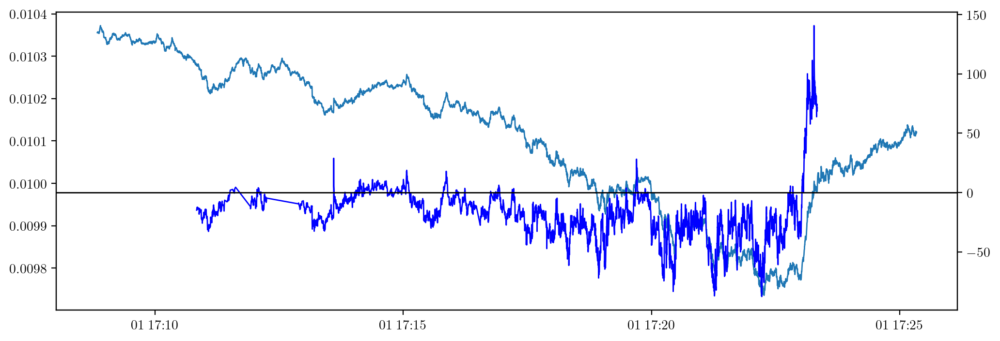

In [ ]:
weight_plot(497, weight=100)

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def weight_plot(id, weight = 100):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()
    #scores = score(id, show_all=True)
    
    #vol = scores['volatility'][0] * 10**4
    #print(vol)

    #short = scores['short unweighted mom']/vol
    #long = scores['long unweighted mom']/1200 * vol
    short = fast_mmtm(id, weight=weight)
    long = fast_mmtm(id, weight = 5*weight)
    #ax1.plot(short.rolling(50).mean(), c = 'g', alpha = 0.5)
    #ax1.plot(scores['score']/1200*vol, c = 'orange', alpha = 0.3)
    ax1.plot(long, c='b')
    ax1.axhline(0, c = 'black')
    #ax1.plot(0.5 * (short.rolling(50).mean() + long).rolling(30).mean(), c = 'r')

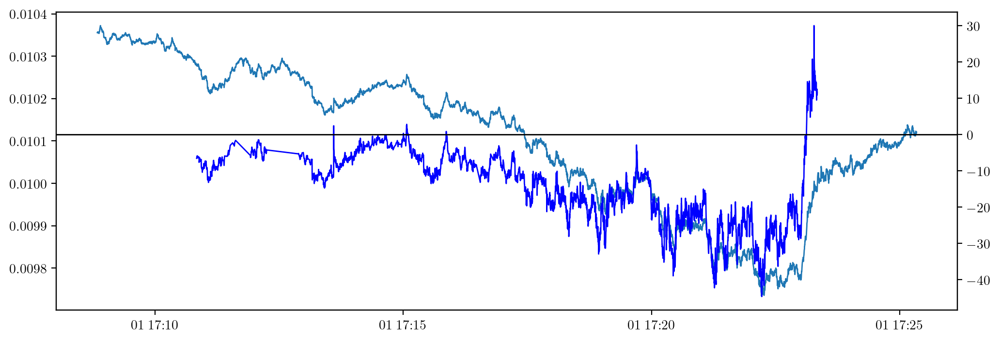

In [ ]:
weight_plot(497, weight=100)

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def weight_plot(id, weight = 100):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()
    
    #short = scores['short unweighted mom']/vol
    #long = scores['long unweighted mom']/1200 * vol
    short = fast_mmtm(id, weight=weight)
    long = fast_mmtm(id, weight = 10*weight)
    ax1.plot(short.rolling(50).mean(), c = 'g', alpha = 0.5)
    #ax1.plot(scores['score']/1200*vol, c = 'orange', alpha = 0.3)
    ax1.plot(long, c='b')
    ax1.axhline(0, c = 'black')
    #ax1.plot(0.5 * (short.rolling(50).mean() + long).rolling(30).mean(), c = 'r')

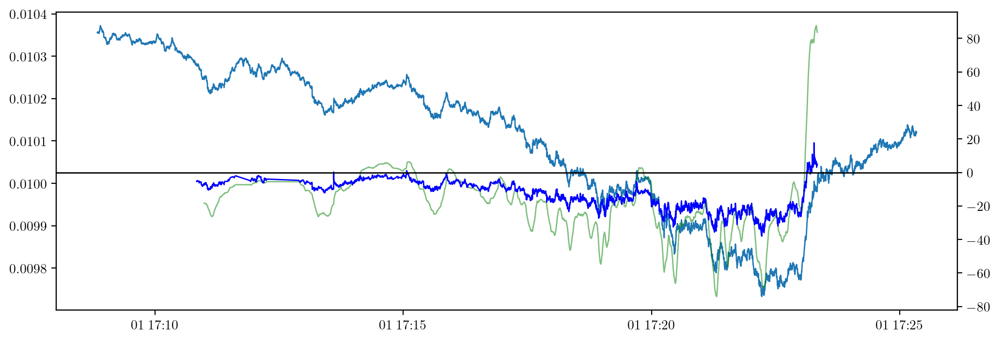

In [ ]:
weight_plot(497, weight=100)

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def weight_plot(id, weight = 100):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()
    
    #short = scores['short unweighted mom']/vol
    #long = scores['long unweighted mom']/1200 * vol
    short = fast_mmtm(id, weight=weight)
    long = fast_mmtm(id, weight = 100*weight)
    ax1.plot(short.rolling(50).mean(), c = 'g', alpha = 0.5)
    #ax1.plot(scores['score']/1200*vol, c = 'orange', alpha = 0.3)
    ax1.plot(long, c='b')
    ax1.axhline(0, c = 'black')
    #ax1.plot(0.5 * (short.rolling(50).mean() + long).rolling(30).mean(), c = 'r')

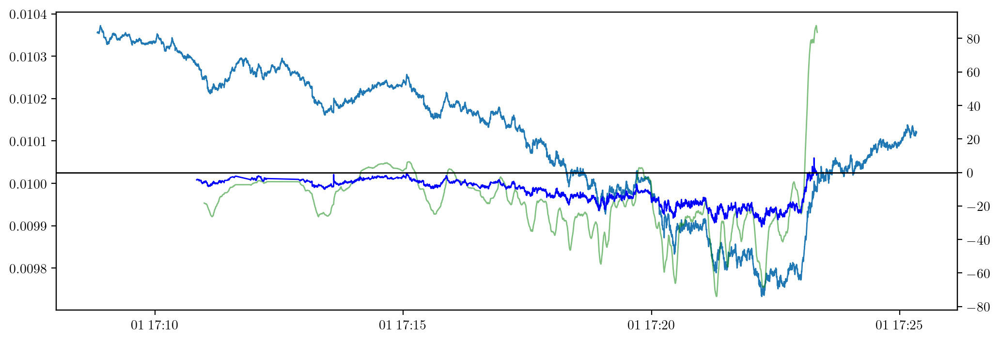

In [ ]:
weight_plot(497, weight=100)

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def weight_plot(id, weight = 100):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()

    long = fast_mmtm(id, weight = 2000)
    ax1.plot(long, c='b')
    ax1.axhline(0, c = 'black')

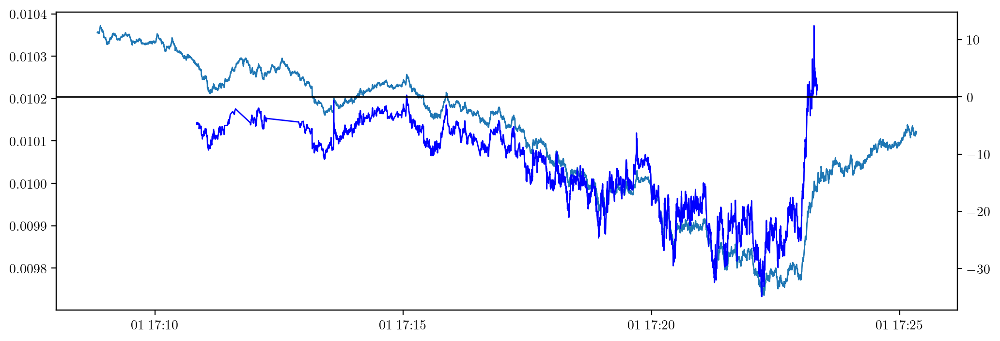

In [ ]:
weight_plot(497, weight=100)

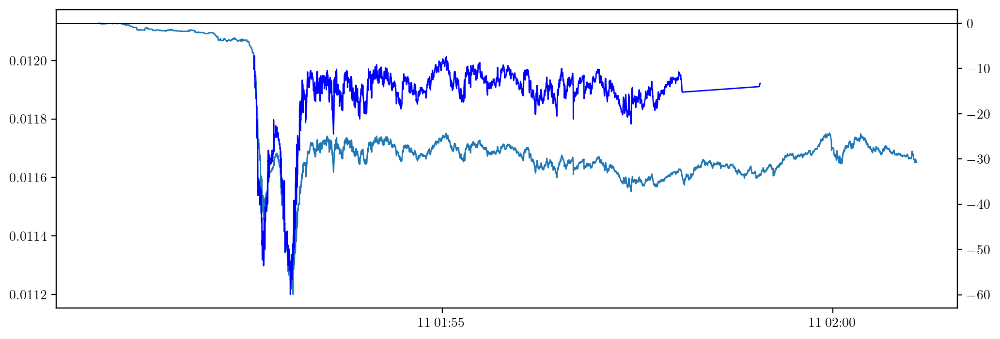

In [ ]:
weight_plot(1, weight=100)

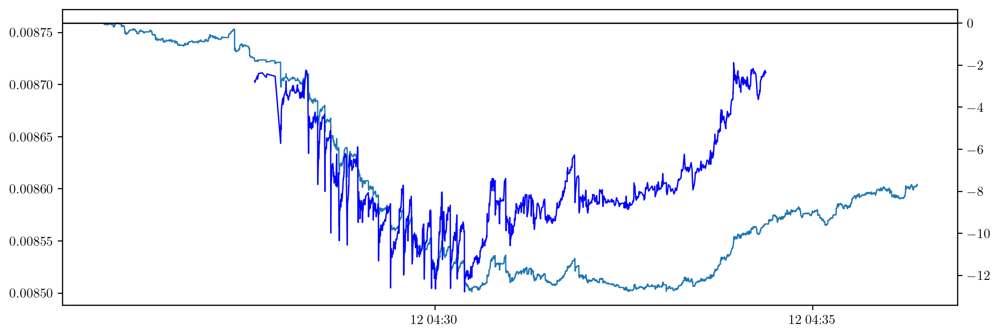

In [ ]:
weight_plot(137, weight=100)

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def weight_plot(id, weight = 100):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()

    long = fast_mmtm(id, weight = 2000)
    ax1.plot(long, c='b')

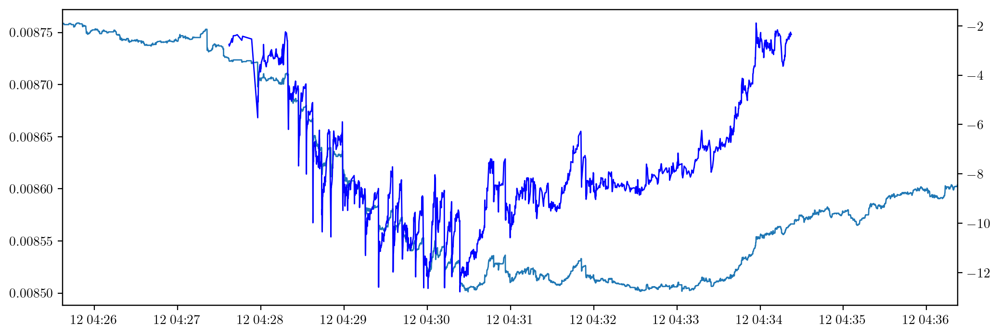

In [ ]:
weight_plot(137, weight=100)

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def weight_plot(id, weight = 100):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ret = get_returns(td[id])
    print(np.std(ret))
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()

    long = fast_mmtm(id, weight = 2000)
    ax1.plot(long, c='b')

9.47476374590188e-05


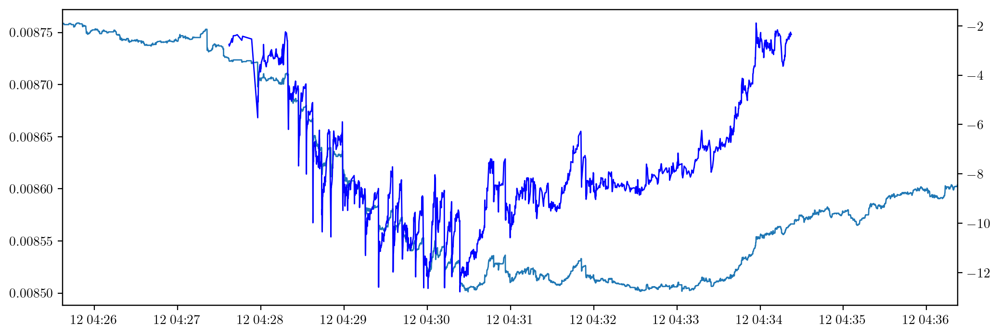

In [ ]:
weight_plot(137, weight=100)

0.00029556241779777584


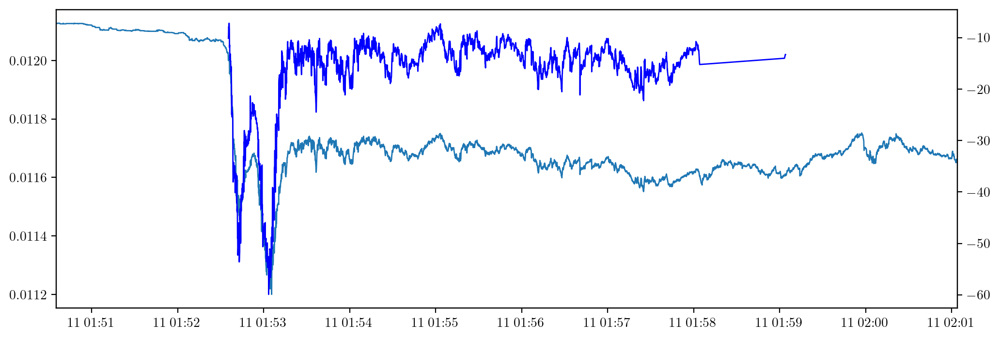

In [ ]:
weight_plot(1, weight=100)

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def weight_plot(id, weight = 100):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ret = get_returns(td[id])
    print(np.std(ret))
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()

    long = fast_mmtm(id, weight = 2000) / (10**4 * np.std(ret))
    ax1.plot(long, c='b')

0.00029556241779777584


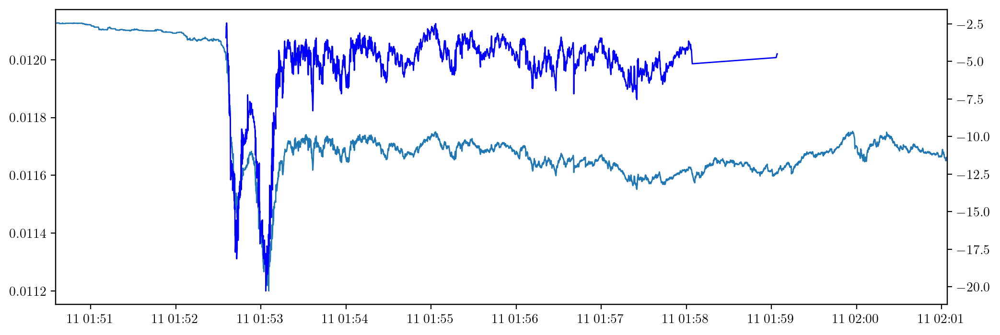

In [ ]:
weight_plot(1, weight=100)

9.47476374590188e-05


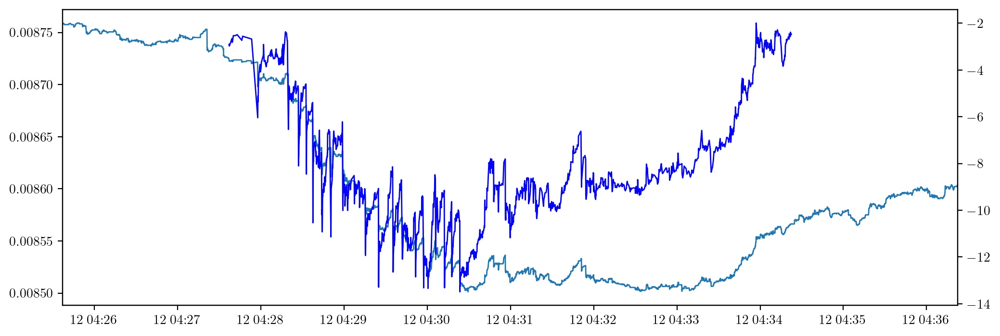

In [ ]:
weight_plot(137, weight=100)

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def weight_plot(id, weight = 100):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ret = get_returns(td[id])
    print(np.std(ret))
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()

    long = fast_mmtm(id, weight = 2000) / (10**4 * np.std(ret))
    ax1.plot(long, c='b')
    ax1.axhline(-10, c = 'black')

9.47476374590188e-05


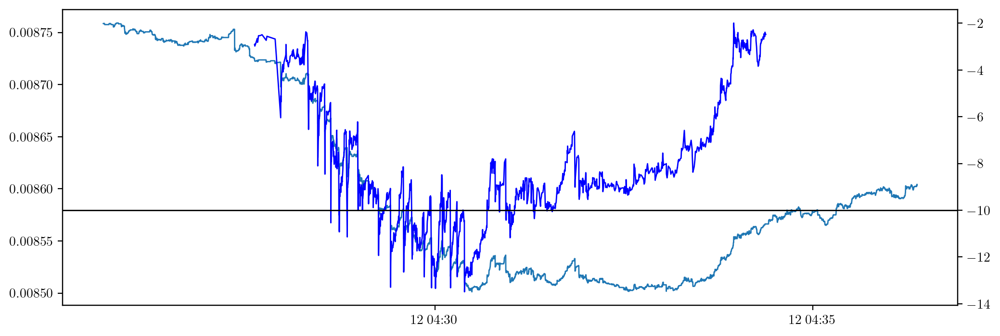

In [ ]:
weight_plot(137, weight=100)

5.815863067340077e-05


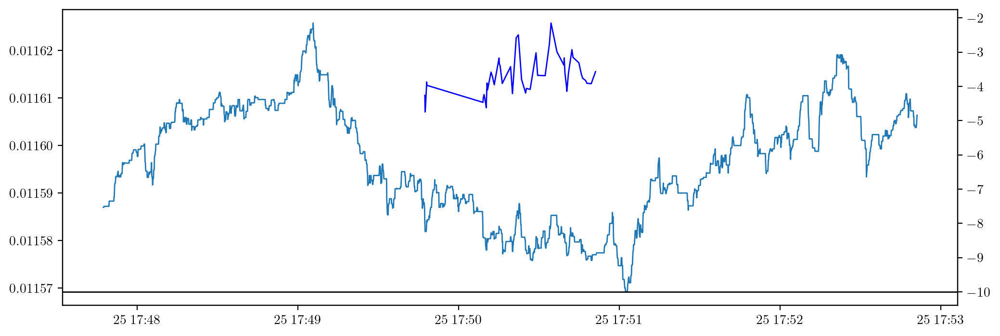

In [ ]:
weight_plot(196, weight=100)

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def weight_plot(id, weight = 100):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ret = get_returns(td[id])
    print(np.std(ret))
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()

    long = fast_mmtm(id, weight = 2000) / (10**4 * np.std(ret))**2
    ax1.plot(long, c='b')
    ax1.axhline(-10, c = 'black')

5.815863067340077e-05


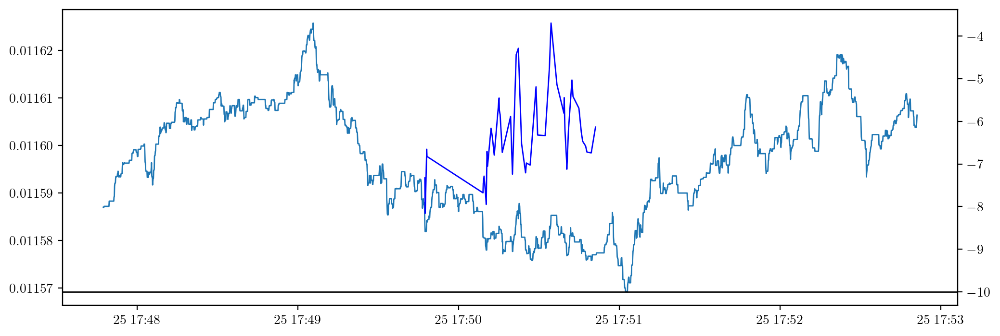

In [ ]:
weight_plot(196, weight=100)

0.00029556241779777584


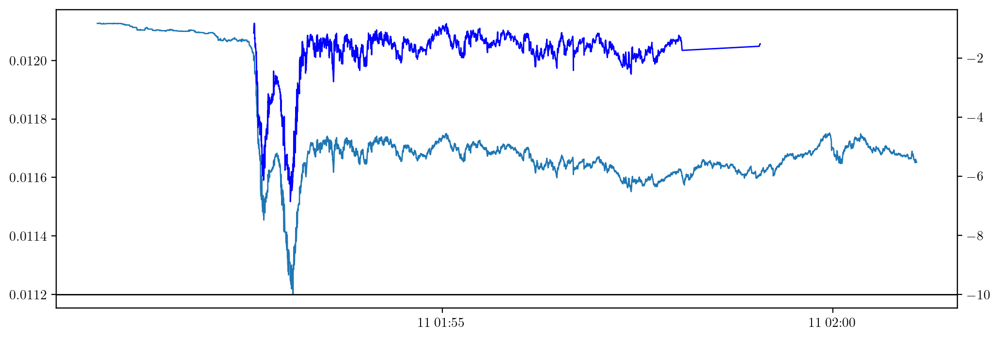

In [ ]:
weight_plot(1, weight=100)

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def weight_plot(id, weight = 100):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ret = get_returns(td[id])
    print(np.std(ret))
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()

    long = fast_mmtm(id, weight = 2000) / (10**4 * np.std(ret))**2
    ax1.plot(long, c='b')
    ax1.axhline(-5, c = 'black')

0.00029556241779777584


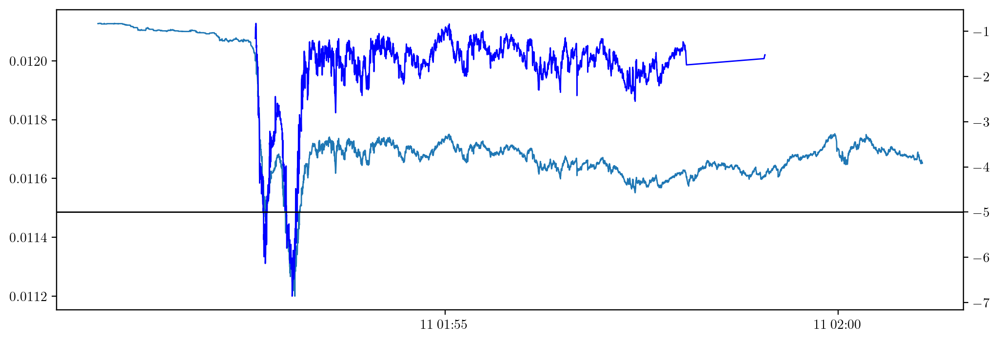

In [ ]:
weight_plot(1, weight=100)

0.0001479621260902882


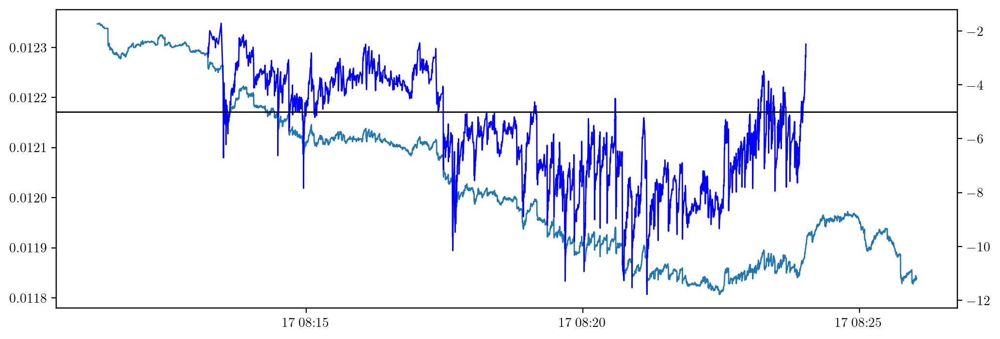

In [ ]:
weight_plot(161, weight=100)

6.608270894668561e-05


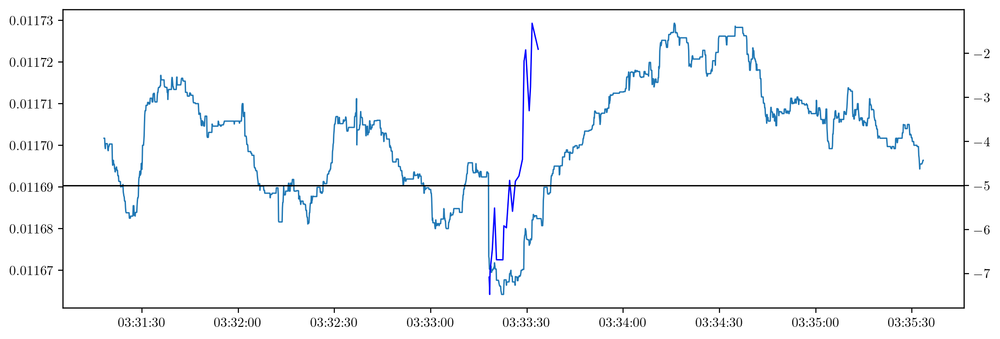

In [ ]:
weight_plot(192, weight=100)

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def weight_plot(id, weight = 100):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ret = get_returns(td[id])
    print(np.std(ret))
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()

    long = fast_mmtm(id, weight = 2000) / (10**4 * np.std(ret))**2
    ax1.plot(long, c='b')
    ax1.axhline(-4.5, c = 'black')

6.608270894668561e-05


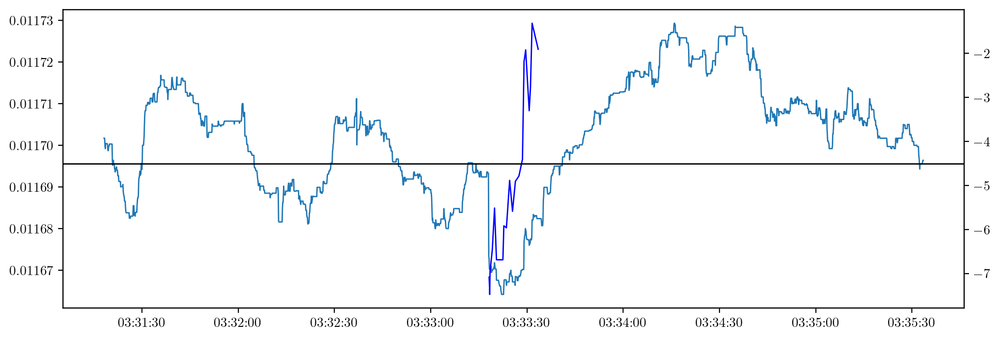

In [ ]:
weight_plot(192, weight=100)

0.00010900952209532135


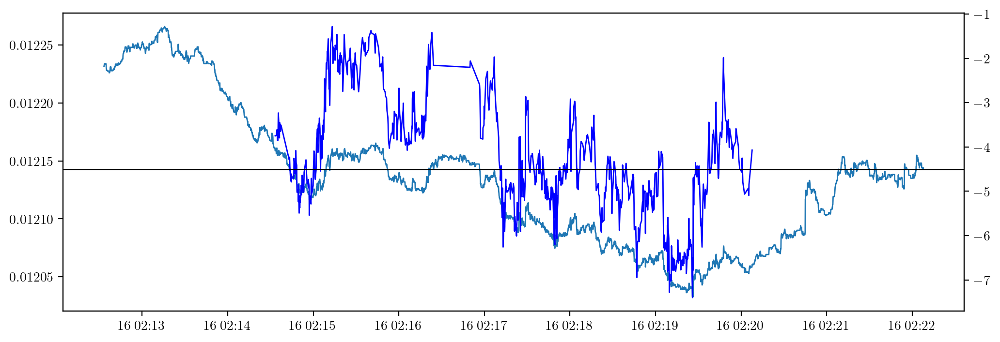

In [ ]:
weight_plot(151, weight=100)

5.8014484410971415e-05


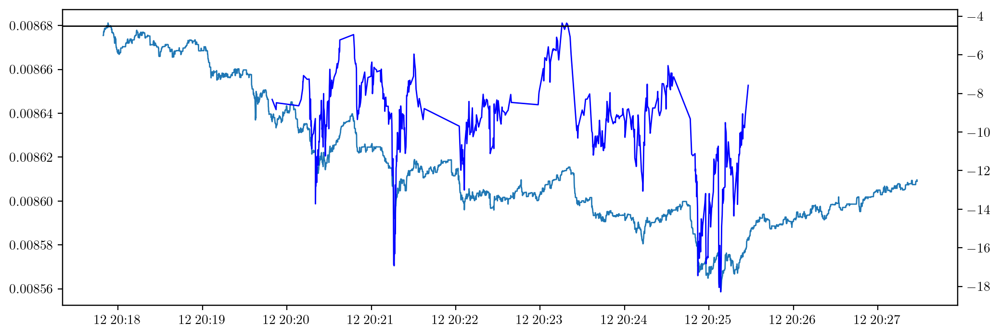

In [ ]:
weight_plot(139, weight=100)

In [ ]:
all_scores

,id,no vol score,log vol score,score,mean volume,volatility,short mom,long mom,short unweighted mom,long unweighted mom
0,4970,-209.23772,-698.19980,"-1,045.05411","494,639.02140",0.00020,-726.46418,-420.48956,-580.17481,-423.15441
1,1610,-98.99802,-367.42530,-669.07674,"234,070.74098",0.00015,-413.65109,-187.51934,-213.47048,-181.40837
2,1370,-50.65602,-225.27486,-534.64153,"116,549.25311",0.00009,-246.32055,-85.28280,-83.98175,-71.07782
3,540,-51.19419,-226.00764,-531.46808,"117,429.66413",0.00010,-180.91636,-51.33948,-222.18234,-59.08987
4,4710,-35.75236,-174.70748,-461.91174,"160,623.11340",0.00008,-126.58964,-67.36785,-94.69233,-77.29130
...,...,...,...,...,...,...,...,...,...,...
518,2440,9.48673,42.87659,103.80334,"87,724.93517",0.00009,-50.95715,-12.08727,-26.38267,13.13304
519,1650,11.42784,51.02345,121.69280,"79,376.24523",0.00009,-52.59065,-20.67695,-33.36481,4.03877
520,3750,15.38016,71.16380,177.15327,"153,350.68526",0.00009,-63.27176,-36.49449,-43.01129,0.77818
521,3080,14.80589,73.35108,196.70375,"138,948.44130",0.00008,-56.04995,1.14220,-69.39275,5.59577


0.00015433572654362422


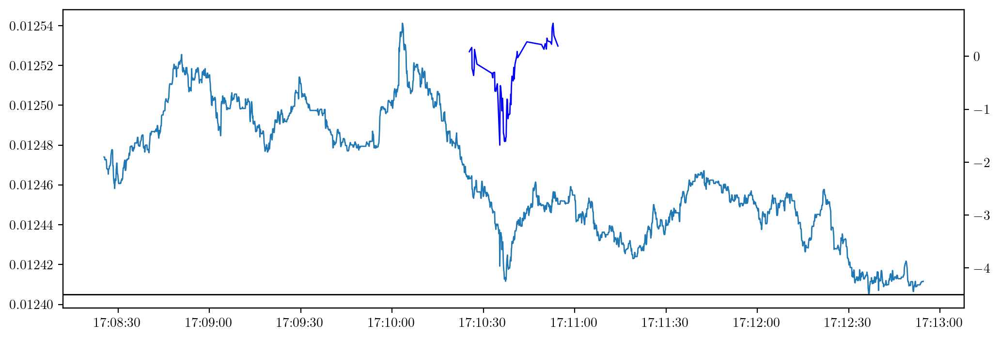

In [ ]:
weight_plot(157, weight=100)

7.526998044036179e-05


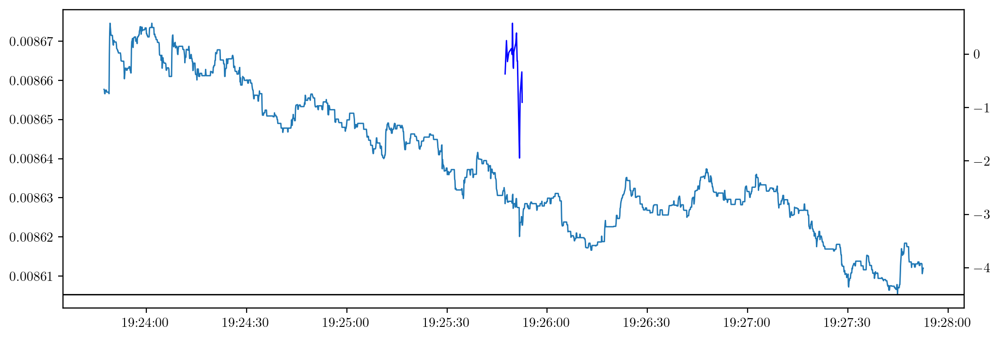

In [ ]:
weight_plot(308, weight=100)

8.681835556615789e-05


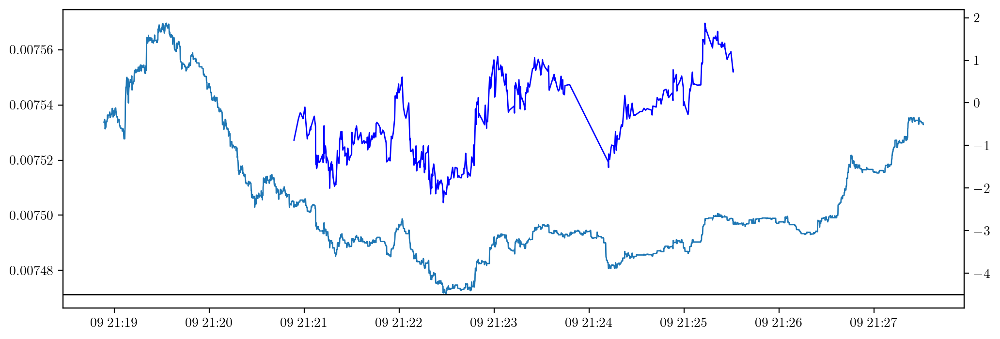

In [ ]:
weight_plot(375, weight=100)

In [ ]:
tdd = to_df(td[10])
post = to_df(pos[10])
fulfill_order(tdd, post[0], 10, 1)

KeyError: 0

In [ ]:
tdd = to_df(td[10])
post = to_df(pos[10])
fulfill_order(tdd, post.index[0], 10, 1)

0.12074599999999999

In [ ]:
timeit fulfill_order(tdd, post.index[0], 10, 1)

468 µs ± 5.18 µs per loop (mean ± std. dev. of 7 runs, 1,000 loops each)


In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, start, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def score_plot(id, weight = 2000):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ret = get_returns(td[id])
    print(np.std(ret))
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()

    long = fast_mmtm(id, weight = weight) / (10**4 * np.std(ret))**2
    ax1.plot(long, c='b')
    ax1.axhline(-4.5, c = 'black')

def buy_thres(id, thres = -4.5, interval = 10):
    score = fast_mmtm(id, weight = 2000) / (10**4 * np.std(ret))**2
    buy_pos = score[score <= thres]
    trade_data = to_df(td[id])

    if len(buy_pos) == 0:
        return 'no times in pos that are below threshold. no trades performed'
    
    stopping_time = get_opt_stopping_time_batched(id, buy_pos.index[0], N, 50, 2, 10, interval=interval, batches=[10, 2])

    orders = np.zeros((len(buy_pos) *2, 2))

    for i in range(len(buy_pos)):
        orders[i, :] = [fulfill_order(trade_data, buy_pos.index[i], 1000 * abs(buy_pos[i]), -1), 1000 * abs(buy_pos[i])]
        orders[i + len(buy_pos), :] = [fulfill_order(trade_data, buy_pos.index[i] + timedelta(seconds=0.1 * interval * int(stopping_time), 1000 * abs(buy_pos[i]), 1)), 1000 * abs(buy_pos[i])]

    return pd.DataFrame(data = orders, index = buy_pos.index, columns = ['channge', 'vol'])

SyntaxError: positional argument follows keyword argument (<ipython-input-59-0ef80dec6918>, line 47)

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, start, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def score_plot(id, weight = 2000):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ret = get_returns(td[id])
    print(np.std(ret))
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()

    long = fast_mmtm(id, weight = weight) / (10**4 * np.std(ret))**2
    ax1.plot(long, c='b')
    ax1.axhline(-4.5, c = 'black')

def buy_thres(id, thres = -4.5, interval = 10):
    score = fast_mmtm(id, weight = 2000) / (10**4 * np.std(ret))**2
    buy_pos = score[score <= thres]
    trade_data = to_df(td[id])

    if len(buy_pos) == 0:
        return 'no times in pos that are below threshold. no trades performed'
    
    stopping_time = get_opt_stopping_time_batched(id, buy_pos.index[0], N, 50, 2, 10, interval=interval, batches=[10, 2])

    orders = np.zeros((len(buy_pos) *2, 2))

    for i in range(len(buy_pos)):
        orders[i, :] = [fulfill_order(trade_data, buy_pos.index[i], 1000 * abs(buy_pos[i]), -1), 1000 * abs(buy_pos[i])]
        orders[i + len(buy_pos), :] = [fulfill_order(trade_data, buy_pos.index[i] + timedelta(seconds=0.1 * interval * int(stopping_time)), 1000 * abs(buy_pos[i]), 1), 1000 * abs(buy_pos[i])]

    return pd.DataFrame(data = orders, index = buy_pos.index, columns = ['channge', 'vol'])

In [ ]:
buy_thres(1)

NameError: name 'ret' is not defined

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, start, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def score_plot(id, weight = 2000):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ret = get_returns(td[id])
    print(np.std(ret))
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()

    long = fast_mmtm(id, weight = weight) / (10**4 * np.std(ret))**2
    ax1.plot(long, c='b')
    ax1.axhline(-4.5, c = 'black')

def buy_thres(id, thres = -4.5, interval = 10):
    ret = get_returns(td[id])
    score = fast_mmtm(id, weight = 2000) / (10**4 * np.std(ret))**2
    buy_pos = score[score <= thres]
    trade_data = to_df(td[id])

    if len(buy_pos) == 0:
        return 'no times in pos that are below threshold. no trades performed'
    
    stopping_time = get_opt_stopping_time_batched(id, buy_pos.index[0], N, 50, 2, 10, interval=interval, batches=[10, 2])

    orders = np.zeros((len(buy_pos) *2, 2))

    for i in range(len(buy_pos)):
        orders[i, :] = [fulfill_order(trade_data, buy_pos.index[i], 1000 * abs(buy_pos[i]), -1), 1000 * abs(buy_pos[i])]
        orders[i + len(buy_pos), :] = [fulfill_order(trade_data, buy_pos.index[i] + timedelta(seconds=0.1 * interval * int(stopping_time)), 1000 * abs(buy_pos[i]), 1), 1000 * abs(buy_pos[i])]

    return pd.DataFrame(data = orders, index = buy_pos.index, columns = ['channge', 'vol'])

In [ ]:
buy_thres(1)

NameError: name 'N' is not defined

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, start, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def score_plot(id, weight = 2000):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ret = get_returns(td[id])
    print(np.std(ret))
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()

    long = fast_mmtm(id, weight = weight) / (10**4 * np.std(ret))**2
    ax1.plot(long, c='b')
    ax1.axhline(-4.5, c = 'black')

def buy_thres(id, thres = -4.5, interval = 10, N = 600):
    ret = get_returns(td[id])
    score = fast_mmtm(id, weight = 2000) / (10**4 * np.std(ret))**2
    buy_pos = score[score <= thres]
    trade_data = to_df(td[id])

    if len(buy_pos) == 0:
        return 'no times in pos that are below threshold. no trades performed'
    
    stopping_time = get_opt_stopping_time_batched(id, buy_pos.index[0], N, 50, 2, 10, interval=interval, batches=[10, 2])

    orders = np.zeros((len(buy_pos) *2, 2))

    for i in range(len(buy_pos)):
        orders[i, :] = [fulfill_order(trade_data, buy_pos.index[i], 1000 * abs(buy_pos[i]), -1), 1000 * abs(buy_pos[i])]
        orders[i + len(buy_pos), :] = [fulfill_order(trade_data, buy_pos.index[i] + timedelta(seconds=0.1 * interval * int(stopping_time)), 1000 * abs(buy_pos[i]), 1), 1000 * abs(buy_pos[i])]

    return pd.DataFrame(data = orders, index = buy_pos.index, columns = ['channge', 'vol'])

In [ ]:
buy_thres(1)

TypeError: get_opt_stopping_time_batched() got multiple values for argument 'interval'

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, start, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def score_plot(id, weight = 2000):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ret = get_returns(td[id])
    print(np.std(ret))
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()

    long = fast_mmtm(id, weight = weight) / (10**4 * np.std(ret))**2
    ax1.plot(long, c='b')
    ax1.axhline(-4.5, c = 'black')

def buy_thres(id, thres = -4.5, interval = 10, N = 600):
    ret = get_returns(td[id])
    score = fast_mmtm(id, weight = 2000) / (10**4 * np.std(ret))**2
    buy_pos = score[score <= thres]
    trade_data = to_df(td[id])

    if len(buy_pos) == 0:
        return 'no times in pos that are below threshold. no trades performed'
    
    stopping_time = get_opt_stopping_time_batched(id, buy_pos.index[0], N, 50, 2, interval=interval, batches=[10, 2])

    orders = np.zeros((len(buy_pos) *2, 2))

    for i in range(len(buy_pos)):
        orders[i, :] = [fulfill_order(trade_data, buy_pos.index[i], 1000 * abs(buy_pos[i]), -1), 1000 * abs(buy_pos[i])]
        orders[i + len(buy_pos), :] = [fulfill_order(trade_data, buy_pos.index[i] + timedelta(seconds=0.1 * interval * int(stopping_time)), 1000 * abs(buy_pos[i]), 1), 1000 * abs(buy_pos[i])]

    return pd.DataFrame(data = orders, index = buy_pos.index, columns = ['channge', 'vol'])

In [ ]:
buy_thres(1)

  0%|          | 0/10 [00:00<?, ?it/s]

TypeError: 'Timestamp' object cannot be interpreted as an integer

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, start, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def score_plot(id, weight = 2000):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ret = get_returns(td[id])
    print(np.std(ret))
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()

    long = fast_mmtm(id, weight = weight) / (10**4 * np.std(ret))**2
    ax1.plot(long, c='b')
    ax1.axhline(-4.5, c = 'black')

def buy_thres(id, thres = -4.5, interval = 10, N = 600):
    ret = get_returns(td[id])
    score = fast_mmtm(id, weight = 2000) / (10**4 * np.std(ret))**2
    buy_pos = score[score <= thres]
    trade_data = to_df(td[id])

    if len(buy_pos) == 0:
        return 'no times in pos that are below threshold. no trades performed'
    
    stopping_time = get_opt_stopping_time_batched(id, buy_pos.index[0], N, 50, 2, interval=interval, batches=[10, 2])

    orders = np.zeros((len(buy_pos) *2, 2))

    for i in range(len(buy_pos)):
        orders[i, :] = [fulfill_order(trade_data, buy_pos.index[i], 1000 * abs(buy_pos[i]), -1), 1000 * abs(buy_pos[i])]
        orders[i + len(buy_pos), :] = [fulfill_order(trade_data, buy_pos.index[i] + timedelta(seconds=0.1 * interval * int(stopping_time)), 1000 * abs(buy_pos[i]), 1), 1000 * abs(buy_pos[i])]

    return pd.DataFrame(data = orders, index = buy_pos.index, columns = ['channge', 'vol'])

In [ ]:
import iisignature as iis

from analysis import * 
from OU import gen_OU_sample
from pytorch_opt import adam_opt

def aug_sig(id, end_time = 'pos', log = True, depth = 3, price = False, structure = 1, interval = 1):
    data = get_rolling(id, log = log, interval = interval).dropna()
    if end_time == 'pos':
        end = to_df(pos[id]).index[0]
        data = data[:end]
    else:
        data = data[:end_time]
    
    n = len(data.index)

    if price == False:
        data = data['diff'].values.reshape(n, 1)
    else:
        data = data[['price', 'diff']].values.reshape(n, 2)

    index = np.arange(0, n).reshape(n, 1) * dt
    aug_path = np.hstack((index, data))
    signature =  iis.sig(aug_path, depth, structure)
    return signature

def gen_partial_sigs(id, time, N, M, depth, interval = 1, emp = True, v = False, b_cor = 1):
    paths, time_index = gen_OU_sample(id, time, N = N, M = M, emp = emp, v= v, interval = interval)

    #estimated the 1/n(Y_i+n - Y_i) term by b_cor * 1.5 * (X_i+n - E(X))
    payoffs = paths[:, 1:] - paths[:, :-1] + b_cor * 1.5/500 * (paths[:, :-1] - np.mean(paths[:, :-1], axis=1, keepdims = True))

    sl = iis.siglength(2, depth)

    partial_sigs = np.zeros((M, N-1, sl+1))
    partial_sigs[:, :, 0] = 1
    
    ticker = tqdm(range(M)) if v == True else range(M)

    for i in ticker:
        aug_path = np.vstack((time_index, paths[i, :])).transpose()
        partial_sigs[i, :, 1:] = iis.sig(aug_path, depth, 2)

    return partial_sigs, payoffs

def gen_partial_sigs_real_data(id, N, depth, interval = 1):
    pos_data = to_df(pos[id])
    start = pos_data.index[0]
    data = get_rolling(id, interval = interval, log = True).dropna()[:start]
    payoffs = ((data['price'] - data['price'][0]).values)[-N:]
    path = (data['diff'].values)[-N:]
    sl = iis.siglength(2, depth)

    time_index = np.arange(0, N * (interval * 0.1), interval * 0.1)
    partial_sigs = np.zeros((1, N-1, sl+1))
    partial_sigs[0, :, 0] = 1
    partial_sigs[0, :, 1:] = iis.sig(np.vstack((time_index, path)).transpose(), depth, 2)

    return partial_sigs, payoffs[:-1]

#   calculates optimal stopping time (single sample, no mc validation)
def get_opt_stopping_time(id, N, M, depth, k, interval = 1, emp=True, v= False):
    partial_sigs, payoffs = gen_partial_sigs(id, N, M, depth, emp = emp, v = v, interval = interval)

    l_opt, loss = adam_opt(partial_sigs, payoffs, k, epochs = 500, v = v)
    print(loss)
    #print(l_opt)

    #   performs inner product and squares it 
    in_prod = np.apply_along_axis(lambda x: np.inner(l_opt, x), -1, partial_sigs)
    sig_dist = in_prod**2

    sig_dist_cumsum = np.apply_along_axis(np.cumsum, -1, sig_dist)
    opt_stopping_times = np.argmax(sig_dist_cumsum > k, axis = 1) + 1

    #opt_stopping_time = dt * np.argmin(mean_sig_dist_cumsum < k)
    return np.mean(opt_stopping_times)

#   using AdamW: N = 600, interval = 10(1s), k = 5, depth 2 
def get_opt_stopping_time_from_real(id, N, depth, k, interval = 1, v= False):
    partial_sigs, payoffs = gen_partial_sigs_real_data(id, N, depth, interval = interval)
    losses = []
    stop_times = []
    for i in tqdm(range(20)):
        l_opt, loss = adam_opt(partial_sigs, payoffs, k, epochs = 3000, v = v)
        losses.append(loss)
        l_opts.append(l_opt)
        #print(loss)
        #print(l_opt)
        #print('-')

        #   performs inner product and squares it 
        in_prod = np.apply_along_axis(lambda x: np.inner(l_opt, x), -1, partial_sigs)
        sig_dist = in_prod**2

        sig_dist_cumsum = np.apply_along_axis(np.cumsum, -1, sig_dist)
        opt_stopping_times = np.argmax(sig_dist_cumsum > k, axis = 1) + 1
        stop_time = np.mean(opt_stopping_times)
        stop_times.append(stop_time)
        #opt_stopping_time = dt * np.argmin(mean_sig_dist_cumsum < k)

    print(np.mean(sig_dist_cumsum, axis = 0)[:10])
    losses = np.array(losses)
    stop_times = np.array(stop_times)
    print(stop_times[np.flatnonzero(stop_times != 1)[np.argmin(losses[np.flatnonzero(stop_times != 1)])]])
    return stop_times

#   monte carlo it to remedy sensitivity to initial l choice
#   final params decided were M = 50, depth = 2, k = 10, int = 10, (N = 600/900)

def get_opt_stopping_time_batched(id, time, N, M, depth, k, interval = 1, emp=True, v= False, batches = [10, 2]):
    res = [gen_partial_sigs(id, time, N, M, depth, interval, emp) for i in tqdm(range(batches[0]))]

    def batch(i):
        ps, pf = res[i]
        losses = np.zeros(batches[1])
        stop_times = np.zeros(batches[1])

        for i in range(batches[1]):
            l_opt, loss = adam_opt(ps, pf, k, epochs = 1500, v = v)

            #   performs inner product and squares it 
            in_prod = ps @ l_opt
            sig_dist = in_prod**2

            sig_dist_cumsum = np.apply_along_axis(np.cumsum, -1, sig_dist)
            opt_stopping_times = np.argmax(sig_dist_cumsum > k, axis = 1) + 1

            stop_times[i] = np.mean(opt_stopping_times)
            losses[i] = loss
        return np.array([losses, stop_times]).transpose()

    all_res = np.vstack(tuple([batch(i) for i in tqdm(range(batches[0]))]))
    stop_times = all_res[:, 1]
    losses = all_res[:, 0]
    
    st_nz = np.flatnonzero(stop_times != np.min(stop_times))
    losses_nz = losses[st_nz]
    st_nz = stop_times[st_nz]

    losses_min = np.argsort(losses_nz)[:max(batches[1], 2)]
    if v == True:
        print(stop_times.reshape(batches)) 
        print(losses.reshape(batches))
    return np.mean(st_nz[losses_min])

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, start, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def score_plot(id, weight = 2000):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ret = get_returns(td[id])
    print(np.std(ret))
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()

    long = fast_mmtm(id, weight = weight) / (10**4 * np.std(ret))**2
    ax1.plot(long, c='b')
    ax1.axhline(-4.5, c = 'black')

def buy_thres(id, thres = -4.5, interval = 10, N = 600):
    ret = get_returns(td[id])
    score = fast_mmtm(id, weight = 2000) / (10**4 * np.std(ret))**2
    buy_pos = score[score <= thres]
    trade_data = to_df(td[id])

    if len(buy_pos) == 0:
        return 'no times in pos that are below threshold. no trades performed'
    
    stopping_time = get_opt_stopping_time_batched(id, buy_pos.index[0], N, 50, 2, 10, interval=interval, batches=[10, 2])

    orders = np.zeros((len(buy_pos) *2, 2))

    for i in range(len(buy_pos)):
        orders[i, :] = [fulfill_order(trade_data, buy_pos.index[i], 1000 * abs(buy_pos[i]), -1), 1000 * abs(buy_pos[i])]
        orders[i + len(buy_pos), :] = [fulfill_order(trade_data, buy_pos.index[i] + timedelta(seconds=0.1 * interval * int(stopping_time)), 1000 * abs(buy_pos[i]), 1), 1000 * abs(buy_pos[i])]

    return pd.DataFrame(data = orders, index = buy_pos.index, columns = ['channge', 'vol'])

In [ ]:
buy_thres(1)

TypeError: get_opt_stopping_time_batched() got multiple values for argument 'interval'

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, start, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def score_plot(id, weight = 2000):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ret = get_returns(td[id])
    print(np.std(ret))
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()

    long = fast_mmtm(id, weight = weight) / (10**4 * np.std(ret))**2
    ax1.plot(long, c='b')
    ax1.axhline(-4.5, c = 'black')

def buy_thres(id, thres = -4.5, interval = 10, N = 600):
    ret = get_returns(td[id])
    score = fast_mmtm(id, weight = 2000) / (10**4 * np.std(ret))**2
    buy_pos = score[score <= thres]
    trade_data = to_df(td[id])

    if len(buy_pos) == 0:
        return 'no times in pos that are below threshold. no trades performed'
    
    stopping_time = get_opt_stopping_time_batched(id, buy_pos.index[0], N, 50, 2, 10, interval=interval, batches=[10, 2])

    orders = np.zeros((len(buy_pos) *2, 2))

    for i in range(len(buy_pos)):
        orders[i, :] = [fulfill_order(trade_data, buy_pos.index[i], 1000 * abs(buy_pos[i]), -1), 1000 * abs(buy_pos[i])]
        orders[i + len(buy_pos), :] = [fulfill_order(trade_data, buy_pos.index[i] + timedelta(seconds=0.1 * interval * int(stopping_time)), 1000 * abs(buy_pos[i]), 1), 1000 * abs(buy_pos[i])]

    return pd.DataFrame(data = orders, index = buy_pos.index, columns = ['channge', 'vol'])

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, start, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def score_plot(id, weight = 2000):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ret = get_returns(td[id])
    print(np.std(ret))
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()

    long = fast_mmtm(id, weight = weight) / (10**4 * np.std(ret))**2
    ax1.plot(long, c='b')
    ax1.axhline(-4.5, c = 'black')

def buy_thres(id, thres = -4.5, interval = 10, N = 600):
    ret = get_returns(td[id])
    score = fast_mmtm(id, weight = 2000) / (10**4 * np.std(ret))**2
    buy_pos = score[score <= thres]
    trade_data = to_df(td[id])

    if len(buy_pos) == 0:
        return 'no times in pos that are below threshold. no trades performed'
    
    stopping_time = get_opt_stopping_time_batched(id, buy_pos.index[0], N, 50, 2, 10, interval=interval, batches=[10, 2])

    orders = np.zeros((len(buy_pos) *2, 2))

    for i in range(len(buy_pos)):
        orders[i, :] = [fulfill_order(trade_data, buy_pos.index[i], 1000 * abs(buy_pos[i]), -1), 1000 * abs(buy_pos[i])]
        orders[i + len(buy_pos), :] = [fulfill_order(trade_data, buy_pos.index[i] + timedelta(seconds=0.1 * interval * int(stopping_time)), 1000 * abs(buy_pos[i]), 1), 1000 * abs(buy_pos[i])]

    return pd.DataFrame(data = orders, index = buy_pos.index, columns = ['channge', 'vol'])

buy_thres(1)

100%|██████████| 10/10 [00:25<00:00,  2.59s/it]


ValueError: Shape of passed values is (260, 2), indices imply (130, 2)

In [ ]:
import iisignature as iis

from analysis import * 
from OU import gen_OU_sample
from pytorch_opt import adam_opt

def aug_sig(id, end_time = 'pos', log = True, depth = 3, price = False, structure = 1, interval = 1):
    data = get_rolling(id, log = log, interval = interval).dropna()
    if end_time == 'pos':
        end = to_df(pos[id]).index[0]
        data = data[:end]
    else:
        data = data[:end_time]
    
    n = len(data.index)

    if price == False:
        data = data['diff'].values.reshape(n, 1)
    else:
        data = data[['price', 'diff']].values.reshape(n, 2)

    index = np.arange(0, n).reshape(n, 1) * dt
    aug_path = np.hstack((index, data))
    signature =  iis.sig(aug_path, depth, structure)
    return signature

def gen_partial_sigs(id, time, N, M, depth, interval = 1, emp = True, v = False, b_cor = 1):
    paths, time_index = gen_OU_sample(id, time, N = N, M = M, emp = emp, v= v, interval = interval)

    #estimated the 1/n(Y_i+n - Y_i) term by b_cor * 1.5 * (X_i+n - E(X))
    payoffs = paths[:, 1:] - paths[:, :-1] + b_cor * 1.5/500 * (paths[:, :-1] - np.mean(paths[:, :-1], axis=1, keepdims = True))

    sl = iis.siglength(2, depth)

    partial_sigs = np.zeros((M, N-1, sl+1))
    partial_sigs[:, :, 0] = 1
    
    ticker = tqdm(range(M)) if v == True else range(M)

    for i in ticker:
        aug_path = np.vstack((time_index, paths[i, :])).transpose()
        partial_sigs[i, :, 1:] = iis.sig(aug_path, depth, 2)

    return partial_sigs, payoffs

def gen_partial_sigs_real_data(id, N, depth, interval = 1):
    pos_data = to_df(pos[id])
    start = pos_data.index[0]
    data = get_rolling(id, interval = interval, log = True).dropna()[:start]
    payoffs = ((data['price'] - data['price'][0]).values)[-N:]
    path = (data['diff'].values)[-N:]
    sl = iis.siglength(2, depth)

    time_index = np.arange(0, N * (interval * 0.1), interval * 0.1)
    partial_sigs = np.zeros((1, N-1, sl+1))
    partial_sigs[0, :, 0] = 1
    partial_sigs[0, :, 1:] = iis.sig(np.vstack((time_index, path)).transpose(), depth, 2)

    return partial_sigs, payoffs[:-1]

#   calculates optimal stopping time (single sample, no mc validation)
def get_opt_stopping_time(id, N, M, depth, k, interval = 1, emp=True, v= False):
    partial_sigs, payoffs = gen_partial_sigs(id, N, M, depth, emp = emp, v = v, interval = interval)

    l_opt, loss = adam_opt(partial_sigs, payoffs, k, epochs = 500, v = v)
    print(loss)
    #print(l_opt)

    #   performs inner product and squares it 
    in_prod = np.apply_along_axis(lambda x: np.inner(l_opt, x), -1, partial_sigs)
    sig_dist = in_prod**2

    sig_dist_cumsum = np.apply_along_axis(np.cumsum, -1, sig_dist)
    opt_stopping_times = np.argmax(sig_dist_cumsum > k, axis = 1) + 1

    #opt_stopping_time = dt * np.argmin(mean_sig_dist_cumsum < k)
    return np.mean(opt_stopping_times)

#   using AdamW: N = 600, interval = 10(1s), k = 5, depth 2 
def get_opt_stopping_time_from_real(id, N, depth, k, interval = 1, v= False):
    partial_sigs, payoffs = gen_partial_sigs_real_data(id, N, depth, interval = interval)
    losses = []
    stop_times = []
    for i in tqdm(range(20)):
        l_opt, loss = adam_opt(partial_sigs, payoffs, k, epochs = 3000, v = v)
        losses.append(loss)
        l_opts.append(l_opt)
        #print(loss)
        #print(l_opt)
        #print('-')

        #   performs inner product and squares it 
        in_prod = np.apply_along_axis(lambda x: np.inner(l_opt, x), -1, partial_sigs)
        sig_dist = in_prod**2

        sig_dist_cumsum = np.apply_along_axis(np.cumsum, -1, sig_dist)
        opt_stopping_times = np.argmax(sig_dist_cumsum > k, axis = 1) + 1
        stop_time = np.mean(opt_stopping_times)
        stop_times.append(stop_time)
        #opt_stopping_time = dt * np.argmin(mean_sig_dist_cumsum < k)

    print(np.mean(sig_dist_cumsum, axis = 0)[:10])
    losses = np.array(losses)
    stop_times = np.array(stop_times)
    print(stop_times[np.flatnonzero(stop_times != 1)[np.argmin(losses[np.flatnonzero(stop_times != 1)])]])
    return stop_times

#   monte carlo it to remedy sensitivity to initial l choice
#   final params decided were M = 50, depth = 2, k = 10, int = 10, (N = 600/900)

def get_opt_stopping_time_batched(id, time, N, M, depth, k, interval = 1, emp=True, v= False, batches = [10, 2]):
    print(time)
    res = [gen_partial_sigs(id, time, N, M, depth, interval, emp) for i in tqdm(range(batches[0]))]

    def batch(i):
        ps, pf = res[i]
        losses = np.zeros(batches[1])
        stop_times = np.zeros(batches[1])

        for i in range(batches[1]):
            l_opt, loss = adam_opt(ps, pf, k, epochs = 1500, v = v)

            #   performs inner product and squares it 
            in_prod = ps @ l_opt
            sig_dist = in_prod**2

            sig_dist_cumsum = np.apply_along_axis(np.cumsum, -1, sig_dist)
            opt_stopping_times = np.argmax(sig_dist_cumsum > k, axis = 1) + 1

            stop_times[i] = np.mean(opt_stopping_times)
            losses[i] = loss
        return np.array([losses, stop_times]).transpose()

    all_res = np.vstack(tuple([batch(i) for i in tqdm(range(batches[0]))]))
    stop_times = all_res[:, 1]
    losses = all_res[:, 0]
    
    st_nz = np.flatnonzero(stop_times != np.min(stop_times))
    losses_nz = losses[st_nz]
    st_nz = stop_times[st_nz]

    losses_min = np.argsort(losses_nz)[:max(batches[1], 2)]
    if v == True:
        print(stop_times.reshape(batches)) 
        print(losses.reshape(batches))
    return np.mean(st_nz[losses_min])

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, start, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def score_plot(id, weight = 2000):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ret = get_returns(td[id])
    print(np.std(ret))
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()

    long = fast_mmtm(id, weight = weight) / (10**4 * np.std(ret))**2
    ax1.plot(long, c='b')
    ax1.axhline(-4.5, c = 'black')

def buy_thres(id, thres = -4.5, interval = 10, N = 600):
    ret = get_returns(td[id])
    score = fast_mmtm(id, weight = 2000) / (10**4 * np.std(ret))**2
    buy_pos = score[score <= thres]
    trade_data = to_df(td[id])
    print(buy_pos[0])

    if len(buy_pos) == 0:
        return 'no times in pos that are below threshold. no trades performed'
    
    stopping_time = get_opt_stopping_time_batched(id, buy_pos.index[0], N, 50, 2, 10, interval=interval, batches=[10, 2])

    sell_pos_ind = buy_pos.index + timedelta(seconds=0.1 * interval * int(stopping_time))

    orders = np.zeros((len(buy_pos) *2, 2))

    for i in range(len(buy_pos)):
        orders[i, :] = [fulfill_order(trade_data, buy_pos.index[i], 1000 * abs(buy_pos[i]), -1), 1000 * abs(buy_pos[i])]
        orders[i + len(buy_pos), :] = [fulfill_order(trade_data, buy_pos.index[i] + timedelta(seconds=0.1 * interval * int(stopping_time)), 1000 * abs(buy_pos[i]), 1), 1000 * abs(buy_pos[i])]

    return pd.DataFrame(data = orders, index = np.concatenate(buy_pos.index, sell_pos_ind), columns = ['change', 'vol'])

buy_thres(1)

-4.595308615399425


 20%|██        | 2/10 [00:05<00:22,  2.84s/it]

Unexpected exception formatting exception. Falling back to standard exception


Traceback (most recent call last):
  File "/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/IPython/core/interactiveshell.py", line 3508, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-4-ff1480b321f9>", line 55, in <module>
    buy_thres(1)
  File "<ipython-input-4-ff1480b321f9>", line 43, in buy_thres
    stopping_time = get_opt_stopping_time_batched(id, buy_pos.index[0], N, 50, 2, 10, interval=interval, batches=[10, 2])
                    ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/huangc/Documents/QR_SH/optimal_stopping_times.py", line 133, in get_opt_stopping_time_batched
  File "/Users/huangc/Documents/QR_SH/optimal_stopping_times.py", line 133, in <listcomp>
  File "/Users/huangc/Documents/QR_SH/optimal_stopping_times.py", line 120, in batch
    for i in range(batches[1]):
                      ^^^^^^^^^^
  File "/Users/huangc/Document

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, start, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def score_plot(id, weight = 2000):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ret = get_returns(td[id])
    print(np.std(ret))
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()

    long = fast_mmtm(id, weight = weight) / (10**4 * np.std(ret))**2
    ax1.plot(long, c='b')
    ax1.axhline(-4.5, c = 'black')

def buy_thres(id, thres = -4.5, interval = 10, N = 600):
    ret = get_returns(td[id])
    score = fast_mmtm(id, weight = 2000) / (10**4 * np.std(ret))**2
    buy_pos = score[score <= thres]
    trade_data = to_df(td[id])
    print(buy_pos.index[0])

    if len(buy_pos) == 0:
        return 'no times in pos that are below threshold. no trades performed'
    
    stopping_time = get_opt_stopping_time_batched(id, buy_pos.index[0], N, 50, 2, 10, interval=interval, batches=[10, 2])

    sell_pos_ind = buy_pos.index + timedelta(seconds=0.1 * interval * int(stopping_time))

    orders = np.zeros((len(buy_pos) *2, 2))

    for i in range(len(buy_pos)):
        orders[i, :] = [fulfill_order(trade_data, buy_pos.index[i], 1000 * abs(buy_pos[i]), -1), 1000 * abs(buy_pos[i])]
        orders[i + len(buy_pos), :] = [fulfill_order(trade_data, buy_pos.index[i] + timedelta(seconds=0.1 * interval * int(stopping_time)), 1000 * abs(buy_pos[i]), 1), 1000 * abs(buy_pos[i])]

    return pd.DataFrame(data = orders, index = np.concatenate(buy_pos.index, sell_pos_ind), columns = ['change', 'vol'])

buy_thres(1)

2024-06-11 01:52:40.100000
2024-06-11 01:52:40.100000


100%|██████████| 10/10 [00:25<00:00,  2.59s/it]


TypeError: 'DatetimeIndex' object cannot be interpreted as an integer

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, start, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def score_plot(id, weight = 2000):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ret = get_returns(td[id])
    print(np.std(ret))
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()

    long = fast_mmtm(id, weight = weight) / (10**4 * np.std(ret))**2
    ax1.plot(long, c='b')
    ax1.axhline(-4.5, c = 'black')

def buy_thres(id, thres = -4.5, interval = 10, N = 600):
    ret = get_returns(td[id])
    score = fast_mmtm(id, weight = 2000) / (10**4 * np.std(ret))**2
    buy_pos = score[score <= thres]
    trade_data = to_df(td[id])
    print(buy_pos.index[0])

    if len(buy_pos) == 0:
        return 'no times in pos that are below threshold. no trades performed'
    
    stopping_time = get_opt_stopping_time_batched(id, buy_pos.index[0], N, 50, 2, 10, interval=interval, batches=[10, 2])

    sell_pos_ind = buy_pos.index + timedelta(seconds=0.1 * interval * int(stopping_time))

    orders = np.zeros((len(buy_pos) *2, 2))

    for i in range(len(buy_pos)):
        orders[i, :] = [fulfill_order(trade_data, buy_pos.index[i], 1000 * abs(buy_pos[i]), -1), 1000 * abs(buy_pos[i])]
        orders[i + len(buy_pos), :] = [fulfill_order(trade_data, buy_pos.index[i] + timedelta(seconds=0.1 * interval * int(stopping_time)), 1000 * abs(buy_pos[i]), 1), 1000 * abs(buy_pos[i])]

    return pd.DataFrame(data = orders, index = buy_pos.index.union(sell_pos_ind), columns = ['change', 'vol'])

buy_thres(1)

2024-06-11 01:52:40.100000
2024-06-11 01:52:40.100000


100%|██████████| 10/10 [00:24<00:00,  2.45s/it]


,change,vol
timestamp,,
2024-06-11 01:52:40.100,-53.61255,"4,595.30862"
2024-06-11 01:52:41.100,-54.97163,"4,725.45005"
2024-06-11 01:52:41.200,-56.10660,"4,825.82387"
2024-06-11 01:52:41.400,-58.11838,"5,006.66581"
2024-06-11 01:52:41.500,-57.00247,"4,910.53493"
...,...,...
2024-06-11 01:53:52.100,53.36178,"4,565.54219"
2024-06-11 01:53:52.200,53.15647,"4,548.65919"
2024-06-11 01:53:52.300,55.39604,"4,740.06495"


In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, start, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def score_plot(id, weight = 2000):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ret = get_returns(td[id])
    print(np.std(ret))
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()

    long = fast_mmtm(id, weight = weight) / (10**4 * np.std(ret))**2
    ax1.plot(long, c='b')
    ax1.axhline(-4.5, c = 'black')

def buy_thres(id, thres = -4.5, interval = 10, N = 600):
    ret = get_returns(td[id])
    score = fast_mmtm(id, weight = 2000) / (10**4 * np.std(ret))**2
    buy_pos = score[score <= thres]
    trade_data = to_df(td[id])
    print(buy_pos.index[0])

    if len(buy_pos) == 0:
        return 'no times in pos that are below threshold. no trades performed'
    
    stopping_time = get_opt_stopping_time_batched(id, buy_pos.index[0], N, 50, 2, 10, interval=interval, batches=[10, 2])

    sell_pos_ind = buy_pos.index + timedelta(seconds=0.1 * interval * int(stopping_time))

    orders = np.zeros((len(buy_pos) *2, 2))

    for i in range(len(buy_pos)):
        orders[i, :] = [fulfill_order(trade_data, buy_pos.index[i], 1000 * abs(buy_pos[i]), -1), 1000 * abs(buy_pos[i])]
        orders[i + len(buy_pos), :] = [fulfill_order(trade_data, buy_pos.index[i] + timedelta(seconds=0.1 * interval * int(stopping_time)), 1000 * abs(buy_pos[i]), 1), 1000 * abs(buy_pos[i])]

    print(np.sum(orders[:, 0]))
    return pd.DataFrame(data = orders, index = buy_pos.index.union(sell_pos_ind), columns = ['change', 'vol'])

buy_thres(1)

2024-06-11 01:52:40.100000
2024-06-11 01:52:40.100000


100%|██████████| 10/10 [00:24<00:00,  2.41s/it]

209.61270620829055


,change,vol
timestamp,,
2024-06-11 01:52:40.100,-53.61255,"4,595.30862"
2024-06-11 01:52:41.100,-54.97163,"4,725.45005"
2024-06-11 01:52:41.200,-56.10660,"4,825.82387"
2024-06-11 01:52:41.400,-58.11838,"5,006.66581"
2024-06-11 01:52:41.500,-57.00247,"4,910.53493"
...,...,...
2024-06-11 01:53:49.100,53.49583,"4,565.54219"
2024-06-11 01:53:49.200,53.24115,"4,548.65919"
2024-06-11 01:53:49.300,55.46350,"4,740.06495"


In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, start, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def score_plot(id, weight = 2000):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ret = get_returns(td[id])
    print(np.std(ret))
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()

    long = fast_mmtm(id, weight = weight) / (10**4 * np.std(ret))**2
    ax1.plot(long, c='b')
    ax1.axhline(-4.5, c = 'black')

def buy_thres(id, thres = -4.5, interval = 10, N = 600):
    ret = get_returns(td[id])
    score = fast_mmtm(id, weight = 2000) / (10**4 * np.std(ret))**2
    buy_pos = score[score <= thres]
    trade_data = to_df(td[id])

    if len(buy_pos) == 0:
        return 'no times in pos that are below threshold. no trades performed'
    
    stopping_time = get_opt_stopping_time_batched(id, buy_pos.index[0], N, 50, 2, 10, interval=interval, batches=[10, 2])
    print(stopping_time)

    sell_pos_ind = buy_pos.index + timedelta(seconds=0.1 * interval * int(stopping_time))

    orders = np.zeros((len(buy_pos) *2, 2))

    for i in range(len(buy_pos)):
        orders[i, :] = [fulfill_order(trade_data, buy_pos.index[i], 1000 * abs(buy_pos[i]), -1), 1000 * abs(buy_pos[i])]
        orders[i + len(buy_pos), :] = [fulfill_order(trade_data, buy_pos.index[i] + timedelta(seconds=0.1 * interval * int(stopping_time)), 1000 * abs(buy_pos[i]), 1), 1000 * abs(buy_pos[i])]

    print(np.sum(orders[:, 0]))
    return pd.DataFrame(data = orders, index = buy_pos.index.union(sell_pos_ind), columns = ['change', 'vol'])

buy_thres(1)

2024-06-11 01:52:40.100000


 10%|█         | 1/10 [00:02<00:25,  2.84s/it]

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, start, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def score_plot(id, weight = 2000):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ret = get_returns(td[id])
    print(np.std(ret))
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()

    long = fast_mmtm(id, weight = weight) / (10**4 * np.std(ret))**2
    ax1.plot(long, c='b')
    ax1.axhline(-4.5, c = 'black')

def buy_thres(id, thres = -4.5, interval = 10, N = 600):
    ret = get_returns(td[id])
    score = fast_mmtm(id, weight = 2000) / (10**4 * np.std(ret))**2
    buy_pos = score[score <= thres]
    trade_data = to_df(td[id])

    if len(buy_pos) == 0:
        return 'no times in pos that are below threshold. no trades performed'
    
    stopping_time = get_opt_stopping_time_batched(id, buy_pos.index[0], N, 50, 2, 10, interval=interval, batches=[10, 2])
    print(stopping_time)

    sell_pos_ind = buy_pos.index + timedelta(seconds=0.1 * interval * int(stopping_time))

    orders = np.zeros((len(buy_pos) *2, 2))

    for i in range(len(buy_pos)):
        orders[i, :] = [fulfill_order(trade_data, buy_pos.index[i], 1000 * abs(buy_pos[i]), -1), 1000 * abs(buy_pos[i])]
        orders[i + len(buy_pos), :] = [fulfill_order(trade_data, buy_pos.index[i] + timedelta(seconds=0.1 * interval * int(stopping_time)), 1000 * abs(buy_pos[i]), 1), 1000 * abs(buy_pos[i])]

    print(np.sum(orders[:, 0]))
    return pd.DataFrame(data = orders, index = buy_pos.index.union(sell_pos_ind), columns = ['change', 'vol'])

buy_thres(1)

100%|██████████| 10/10 [00:26<00:00,  2.65s/it]

51.39
199.15866202484176


,change,vol
timestamp,,
2024-06-11 01:52:40.100,-53.61255,"4,595.30862"
2024-06-11 01:52:41.100,-54.97163,"4,725.45005"
2024-06-11 01:52:41.200,-56.10660,"4,825.82387"
2024-06-11 01:52:41.400,-58.11838,"5,006.66581"
2024-06-11 01:52:41.500,-57.00247,"4,910.53493"
...,...,...
2024-06-11 01:53:58.100,53.32583,"4,565.54219"
2024-06-11 01:53:58.200,53.12561,"4,548.65919"
2024-06-11 01:53:58.300,55.40709,"4,740.06495"


100%|██████████| 10/10 [00:26<00:00,  2.62s/it]

46.45
215.6028367897634


,change,vol
timestamp,,
2024-06-11 01:52:40.100,-53.61255,"4,595.30862"
2024-06-11 01:52:41.100,-54.97163,"4,725.45005"
2024-06-11 01:52:41.200,-56.10660,"4,825.82387"
2024-06-11 01:52:41.400,-58.11838,"5,006.66581"
2024-06-11 01:52:41.500,-57.00247,"4,910.53493"
...,...,...
2024-06-11 01:53:53.100,53.33877,"4,565.54219"
2024-06-11 01:53:53.200,53.12106,"4,548.65919"
2024-06-11 01:53:53.300,55.32651,"4,740.06495"


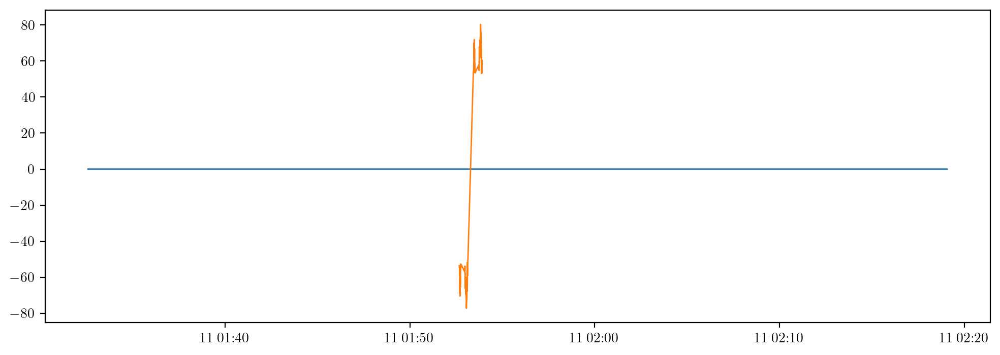

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, start, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def score_plot(id, weight = 2000):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ret = get_returns(td[id])
    print(np.std(ret))
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()

    long = fast_mmtm(id, weight = weight) / (10**4 * np.std(ret))**2
    ax1.plot(long, c='b')
    ax1.axhline(-4.5, c = 'black')

def buy_thres(id, thres = -4.5, interval = 10, N = 600):
    ret = get_returns(td[id])
    score = fast_mmtm(id, weight = 2000) / (10**4 * np.std(ret))**2
    buy_pos = score[score <= thres]
    trade_data = to_df(td[id])

    if len(buy_pos) == 0:
        return 'no times in pos that are below threshold. no trades performed'
    
    stopping_time = get_opt_stopping_time_batched(id, buy_pos.index[0], N, 50, 2, 10, interval=interval, batches=[10, 2])
    print(stopping_time)

    sell_pos_ind = buy_pos.index + timedelta(seconds=0.1 * interval * int(stopping_time))

    orders = np.zeros((len(buy_pos) *2, 2))

    for i in range(len(buy_pos)):
        orders[i, :] = [fulfill_order(trade_data, buy_pos.index[i], 1000 * abs(buy_pos[i]), -1), 1000 * abs(buy_pos[i])]
        orders[i + len(buy_pos), :] = [fulfill_order(trade_data, buy_pos.index[i] + timedelta(seconds=0.1 * interval * int(stopping_time)), 1000 * abs(buy_pos[i]), 1), 1000 * abs(buy_pos[i])]

    df = pd.DataFrame(data = orders, index = buy_pos.index.union(sell_pos_ind), columns = ['change', 'vol'])
    print(np.sum(orders[:, 0]))
    plt.plot(trade_data['bid_p1'])
    plt.plot(df['change'])
    return df


buy_thres(1)

100%|██████████| 10/10 [00:24<00:00,  2.46s/it]

47.11
215.0707828953582


,change,vol
timestamp,,
2024-06-11 01:52:40.100,-53.61255,"4,595.30862"
2024-06-11 01:52:41.100,-54.97163,"4,725.45005"
2024-06-11 01:52:41.200,-56.10660,"4,825.82387"
2024-06-11 01:52:41.400,-58.11838,"5,006.66581"
2024-06-11 01:52:41.500,-57.00247,"4,910.53493"
...,...,...
2024-06-11 01:53:54.100,53.40269,"4,565.54219"
2024-06-11 01:53:54.200,53.20567,"4,548.65919"
2024-06-11 01:53:54.300,55.42700,"4,740.06495"


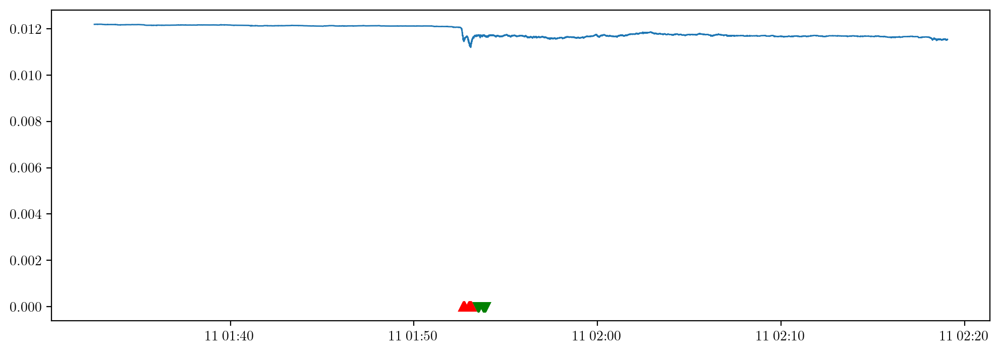

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, start, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def score_plot(id, weight = 2000):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ret = get_returns(td[id])
    print(np.std(ret))
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()

    long = fast_mmtm(id, weight = weight) / (10**4 * np.std(ret))**2
    ax1.plot(long, c='b')
    ax1.axhline(-4.5, c = 'black')

def buy_thres(id, thres = -4.5, interval = 10, N = 600):
    ret = get_returns(td[id])
    score = fast_mmtm(id, weight = 2000) / (10**4 * np.std(ret))**2
    buy_pos = score[score <= thres]
    trade_data = to_df(td[id])

    if len(buy_pos) == 0:
        return 'no times in pos that are below threshold. no trades performed'
    
    stopping_time = get_opt_stopping_time_batched(id, buy_pos.index[0], N, 50, 2, 10, interval=interval, batches=[10, 2])
    print(stopping_time)

    sell_pos_ind = buy_pos.index + timedelta(seconds=0.1 * interval * int(stopping_time))

    orders = np.zeros((len(buy_pos) *2, 2))

    for i in range(len(buy_pos)):
        orders[i, :] = [fulfill_order(trade_data, buy_pos.index[i], 1000 * abs(buy_pos[i]), -1), 1000 * abs(buy_pos[i])]
        orders[i + len(buy_pos), :] = [fulfill_order(trade_data, buy_pos.index[i] + timedelta(seconds=0.1 * interval * int(stopping_time)), 1000 * abs(buy_pos[i]), 1), 1000 * abs(buy_pos[i])]

    df = pd.DataFrame(data = orders, index = buy_pos.index.union(sell_pos_ind), columns = ['change', 'vol'])
    print(np.sum(orders[:, 0]))
    plt.plot(trade_data['bid_p1'])
    plt.plot(df.index[:len(buy_pos)], np.zeros(len(buy_pos)), marker = '^', c = 'r')
    plt.plot(df.index[len(buy_pos):], np.zeros(len(buy_pos)), marker = 'v', c = 'g')
    return df


buy_thres(1)

100%|██████████| 10/10 [00:27<00:00,  2.72s/it]

43.81
211.57725204141752


,change,vol
timestamp,,
2024-06-11 01:52:40.100,-53.61255,"4,595.30862"
2024-06-11 01:52:41.100,-54.97163,"4,725.45005"
2024-06-11 01:52:41.200,-56.10660,"4,825.82387"
2024-06-11 01:52:41.400,-58.11838,"5,006.66581"
2024-06-11 01:52:41.500,-57.00247,"4,910.53493"
...,...,...
2024-06-11 01:53:50.100,53.52550,"4,565.54219"
2024-06-11 01:53:50.200,53.33667,"4,548.65919"
2024-06-11 01:53:50.300,55.55735,"4,740.06495"


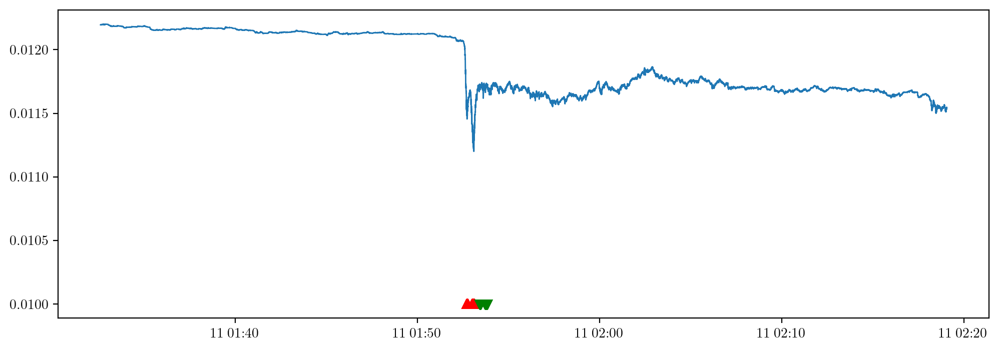

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, start, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def score_plot(id, weight = 2000):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ret = get_returns(td[id])
    print(np.std(ret))
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()

    long = fast_mmtm(id, weight = weight) / (10**4 * np.std(ret))**2
    ax1.plot(long, c='b')
    ax1.axhline(-4.5, c = 'black')

def buy_thres(id, thres = -4.5, interval = 10, N = 600):
    ret = get_returns(td[id])
    score = fast_mmtm(id, weight = 2000) / (10**4 * np.std(ret))**2
    buy_pos = score[score <= thres]
    trade_data = to_df(td[id])

    if len(buy_pos) == 0:
        return 'no times in pos that are below threshold. no trades performed'
    
    stopping_time = get_opt_stopping_time_batched(id, buy_pos.index[0], N, 50, 2, 10, interval=interval, batches=[10, 2])
    print(stopping_time)

    sell_pos_ind = buy_pos.index + timedelta(seconds=0.1 * interval * int(stopping_time))

    orders = np.zeros((len(buy_pos) *2, 2))

    for i in range(len(buy_pos)):
        orders[i, :] = [fulfill_order(trade_data, buy_pos.index[i], 1000 * abs(buy_pos[i]), -1), 1000 * abs(buy_pos[i])]
        orders[i + len(buy_pos), :] = [fulfill_order(trade_data, buy_pos.index[i] + timedelta(seconds=0.1 * interval * int(stopping_time)), 1000 * abs(buy_pos[i]), 1), 1000 * abs(buy_pos[i])]

    df = pd.DataFrame(data = orders, index = buy_pos.index.union(sell_pos_ind), columns = ['change', 'vol'])
    print(np.sum(orders[:, 0]))
    plt.plot(trade_data['bid_p1'])
    plt.plot(df.index[:len(buy_pos)], 0.01 + np.zeros(len(buy_pos)), marker = '^', c = 'r')
    plt.plot(df.index[len(buy_pos):], 0.01 + np.zeros(len(buy_pos)), marker = 'v', c = 'g')
    return df


buy_thres(1)

100%|██████████| 10/10 [00:26<00:00,  2.70s/it]

49.14
208.99544685741603


,change,vol
timestamp,,
2024-06-11 01:52:40.100,-53.61255,"4,595.30862"
2024-06-11 01:52:41.100,-54.97163,"4,725.45005"
2024-06-11 01:52:41.200,-56.10660,"4,825.82387"
2024-06-11 01:52:41.400,-58.11838,"5,006.66581"
2024-06-11 01:52:41.500,-57.00247,"4,910.53493"
...,...,...
2024-06-11 01:53:56.100,53.18891,"4,565.54219"
2024-06-11 01:53:56.200,52.98642,"4,548.65919"
2024-06-11 01:53:56.300,55.25067,"4,740.06495"


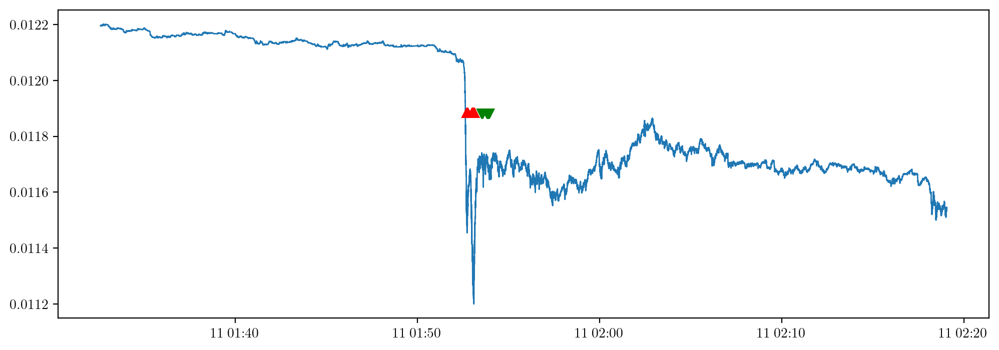

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, start, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def score_plot(id, weight = 2000):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ret = get_returns(td[id])
    print(np.std(ret))
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()

    long = fast_mmtm(id, weight = weight) / (10**4 * np.std(ret))**2
    ax1.plot(long, c='b')
    ax1.axhline(-4.5, c = 'black')

def buy_thres(id, thres = -4.5, interval = 10, N = 600):
    ret = get_returns(td[id])
    score = fast_mmtm(id, weight = 2000) / (10**4 * np.std(ret))**2
    buy_pos = score[score <= thres]
    trade_data = to_df(td[id])

    if len(buy_pos) == 0:
        return 'no times in pos that are below threshold. no trades performed'
    
    stopping_time = get_opt_stopping_time_batched(id, buy_pos.index[0], N, 50, 2, 10, interval=interval, batches=[10, 2])
    print(stopping_time)

    sell_pos_ind = buy_pos.index + timedelta(seconds=0.1 * interval * int(stopping_time))

    orders = np.zeros((len(buy_pos) *2, 2))

    for i in range(len(buy_pos)):
        orders[i, :] = [fulfill_order(trade_data, buy_pos.index[i], 1000 * abs(buy_pos[i]), -1), 1000 * abs(buy_pos[i])]
        orders[i + len(buy_pos), :] = [fulfill_order(trade_data, buy_pos.index[i] + timedelta(seconds=0.1 * interval * int(stopping_time)), 1000 * abs(buy_pos[i]), 1), 1000 * abs(buy_pos[i])]

    df = pd.DataFrame(data = orders, index = buy_pos.index.union(sell_pos_ind), columns = ['change', 'vol'])
    print(np.sum(orders[:, 0]))
    plt.plot(trade_data['bid_p1'])
    plt.plot(df.index[:len(buy_pos)], np.mean(trade_data['bid_p1']) * np.ones(len(buy_pos)), marker = '^', c = 'r')
    plt.plot(df.index[len(buy_pos):], np.mean(trade_data['bid_p1']) * np.ones(len(buy_pos)), marker = 'v', c = 'g')
    return df


buy_thres(1)

100%|██████████| 10/10 [00:26<00:00,  2.61s/it]

435.78999999999996
0.2663297435752554


,change,vol
timestamp,,
2024-06-17 13:31:27.100,-52.88904,"4,622.23885"
2024-06-17 13:31:28.500,-54.13864,"4,733.47426"
2024-06-17 13:31:28.600,-52.25122,"4,568.13284"
2024-06-17 13:32:23.800,-51.92559,"4,544.51136"
2024-06-17 13:32:25.500,-52.03944,"4,555.47289"
2024-06-17 13:38:42.100,52.90014,"4,622.23885"
2024-06-17 13:38:43.500,54.15947,"4,733.47426"
2024-06-17 13:38:43.600,52.26766,"4,568.13284"
2024-06-17 13:39:38.800,52.02647,"4,544.51136"


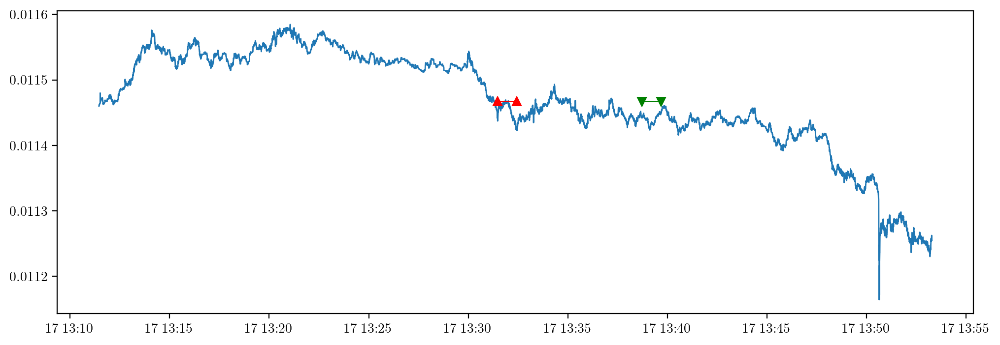

In [ ]:
buy_thres(20)

In [ ]:
buy_thres(13)

100%|██████████| 10/10 [00:25<00:00,  2.59s/it]


17.54


ValueError: Shape of passed values is (318, 2), indices imply (310, 2)

In [ ]:
buy_thres(13)

100%|██████████| 10/10 [00:29<00:00,  2.92s/it]


11.99


ValueError: Shape of passed values is (318, 2), indices imply (304, 2)

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, start, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def score_plot(id, weight = 2000):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ret = get_returns(td[id])
    print(np.std(ret))
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()

    long = fast_mmtm(id, weight = weight) / (10**4 * np.std(ret))**2
    ax1.plot(long, c='b')
    ax1.axhline(-4.5, c = 'black')

def buy_thres(id, thres = -4.5, interval = 10, N = 600):
    ret = get_returns(td[id])
    score = fast_mmtm(id, weight = 2000) / (10**4 * np.std(ret))**2
    buy_pos = score[score <= thres]
    trade_data = to_df(td[id])

    if len(buy_pos) == 0:
        return 'no times in pos that are below threshold. no trades performed'
    
    stopping_time = get_opt_stopping_time_batched(id, buy_pos.index[0], N, 50, 2, 10, interval=interval, batches=[10, 2])
    print(stopping_time)

    sell_pos_ind = buy_pos.index + timedelta(seconds=0.1 * interval * int(stopping_time))

    orders = np.zeros((len(buy_pos) *2, 2))

    for i in range(len(buy_pos)):
        orders[i, :] = [fulfill_order(trade_data, buy_pos.index[i], 1000 * abs(buy_pos[i]), -1), 1000 * abs(buy_pos[i])]
        orders[i + len(buy_pos), :] = [fulfill_order(trade_data, buy_pos.index[i] + timedelta(seconds=0.1 * interval * int(stopping_time)), 1000 * abs(buy_pos[i]), 1), 1000 * abs(buy_pos[i])]

    df = pd.DataFrame(data = orders, index = pd.concat(buy_pos.index, sell_pos_ind), columns = ['change', 'vol'])
    print(np.sum(orders[:, 0]))
    plt.plot(trade_data['bid_p1'])
    plt.plot(df.index[:len(buy_pos)], np.mean(trade_data['bid_p1']) * np.ones(len(buy_pos)), marker = '^', c = 'r',alpha = 0.2)
    plt.plot(df.index[len(buy_pos):], np.mean(trade_data['bid_p1']) * np.ones(len(buy_pos)), marker = 'v', c = 'g', alpha = 0.2)
    return df

In [ ]:
buy_thres(13)

100%|██████████| 10/10 [00:26<00:00,  2.62s/it]


15.04


TypeError: concat() takes 1 positional argument but 2 were given

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, start, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def score_plot(id, weight = 2000):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ret = get_returns(td[id])
    print(np.std(ret))
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()

    long = fast_mmtm(id, weight = weight) / (10**4 * np.std(ret))**2
    ax1.plot(long, c='b')
    ax1.axhline(-4.5, c = 'black')

def buy_thres(id, thres = -4.5, interval = 10, N = 600):
    ret = get_returns(td[id])
    score = fast_mmtm(id, weight = 2000) / (10**4 * np.std(ret))**2
    buy_pos = score[score <= thres]
    trade_data = to_df(td[id])

    if len(buy_pos) == 0:
        return 'no times in pos that are below threshold. no trades performed'
    
    stopping_time = get_opt_stopping_time_batched(id, buy_pos.index[0], N, 50, 2, 10, interval=interval, batches=[10, 2])
    print(stopping_time)

    sell_pos_ind = buy_pos.index + timedelta(seconds=0.1 * interval * int(stopping_time))

    orders = np.zeros((len(buy_pos) *2, 2))

    for i in range(len(buy_pos)):
        orders[i, :] = [fulfill_order(trade_data, buy_pos.index[i], 1000 * abs(buy_pos[i]), -1), 1000 * abs(buy_pos[i])]
        orders[i + len(buy_pos), :] = [fulfill_order(trade_data, buy_pos.index[i] + timedelta(seconds=0.1 * interval * int(stopping_time)), 1000 * abs(buy_pos[i]), 1), 1000 * abs(buy_pos[i])]

    df = pd.DataFrame(data = orders, index = pd.concat((buy_pos.index, sell_pos_ind)), columns = ['change', 'vol'])
    print(np.sum(orders[:, 0]))
    plt.plot(trade_data['bid_p1'])
    plt.plot(df.index[:len(buy_pos)], np.mean(trade_data['bid_p1']) * np.ones(len(buy_pos)), marker = '^', c = 'r',alpha = 0.2)
    plt.plot(df.index[len(buy_pos):], np.mean(trade_data['bid_p1']) * np.ones(len(buy_pos)), marker = 'v', c = 'g', alpha = 0.2)
    return df

In [ ]:
buy_thres(13)

100%|██████████| 10/10 [00:25<00:00,  2.56s/it]


19.45


TypeError: cannot concatenate object of type '<class 'pandas.core.indexes.datetimes.DatetimeIndex'>'; only Series and DataFrame objs are valid

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, start, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def score_plot(id, weight = 2000):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ret = get_returns(td[id])
    print(np.std(ret))
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()

    long = fast_mmtm(id, weight = weight) / (10**4 * np.std(ret))**2
    ax1.plot(long, c='b')
    ax1.axhline(-4.5, c = 'black')

def buy_thres(id, thres = -4.5, interval = 10, N = 600):
    ret = get_returns(td[id])
    score = fast_mmtm(id, weight = 2000) / (10**4 * np.std(ret))**2
    buy_pos = score[score <= thres]
    trade_data = to_df(td[id])

    if len(buy_pos) == 0:
        return 'no times in pos that are below threshold. no trades performed'
    
    stopping_time = get_opt_stopping_time_batched(id, buy_pos.index[0], N, 50, 2, 10, interval=interval, batches=[10, 2])
    print(stopping_time)

    sell_pos_ind = buy_pos.index + timedelta(seconds=0.1 * interval * int(stopping_time))

    buy = np.zeros((len(buy_pos), 2))
    sell = np.zeros((len(buy_pos), 2))

    for i in range(len(buy_pos)):
        buy[i, :] = [fulfill_order(trade_data, buy_pos.index[i], 1000 * abs(buy_pos[i]), -1), 1000 * abs(buy_pos[i])]
        sell[i, :] = [fulfill_order(trade_data, buy_pos.index[i] + timedelta(seconds=0.1 * interval * int(stopping_time)), 1000 * abs(buy_pos[i]), 1), 1000 * abs(buy_pos[i])]

    df_buy = pd.DataFrame(data = buy, index = buy_pos.index, columns = ['change', 'vol'])
    df_sell = pd.DataFrame(data = sell, index = sell_pos_ind, columns = ['change', 'vol'])
    print(np.sum(orders[:, 0]))
    plt.plot(trade_data['bid_p1'])
    plt.plot(df_buy.index, np.mean(trade_data['bid_p1']) * np.ones(len(buy_pos)), marker = '^', c = 'r',alpha = 0.2)
    plt.plot(df_sell.index, np.mean(trade_data['bid_p1']) * np.ones(len(buy_pos)), marker = 'v', c = 'g', alpha = 0.2)
    return pd.concat(df_buy, df_sell)

In [ ]:
buy_thres(13)

100%|██████████| 10/10 [00:26<00:00,  2.62s/it]


11.08


NameError: name 'orders' is not defined

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, start, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def score_plot(id, weight = 2000):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ret = get_returns(td[id])
    print(np.std(ret))
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()

    long = fast_mmtm(id, weight = weight) / (10**4 * np.std(ret))**2
    ax1.plot(long, c='b')
    ax1.axhline(-4.5, c = 'black')

def buy_thres(id, thres = -4.5, interval = 10, N = 600):
    ret = get_returns(td[id])
    score = fast_mmtm(id, weight = 2000) / (10**4 * np.std(ret))**2
    buy_pos = score[score <= thres]
    trade_data = to_df(td[id])

    if len(buy_pos) == 0:
        return 'no times in pos that are below threshold. no trades performed'
    
    stopping_time = get_opt_stopping_time_batched(id, buy_pos.index[0], N, 50, 2, 10, interval=interval, batches=[10, 2])
    print(stopping_time)

    sell_pos_ind = buy_pos.index + timedelta(seconds=0.1 * interval * int(stopping_time))

    buy = np.zeros((len(buy_pos), 2))
    sell = np.zeros((len(buy_pos), 2))

    for i in range(len(buy_pos)):
        buy[i, :] = [fulfill_order(trade_data, buy_pos.index[i], 1000 * abs(buy_pos[i]), -1), 1000 * abs(buy_pos[i])]
        sell[i, :] = [fulfill_order(trade_data, buy_pos.index[i] + timedelta(seconds=0.1 * interval * int(stopping_time)), 1000 * abs(buy_pos[i]), 1), 1000 * abs(buy_pos[i])]

    df_buy = pd.DataFrame(data = buy, index = buy_pos.index, columns = ['change', 'vol'])
    df_sell = pd.DataFrame(data = sell, index = sell_pos_ind, columns = ['change', 'vol'])
    print(np.sum(sell[:, 0]) - np.sum(buy[:, 0]) )
    plt.plot(trade_data['bid_p1'])
    plt.plot(df_buy.index, np.mean(trade_data['bid_p1']) * np.ones(len(buy_pos)), marker = '^', c = 'r',alpha = 0.2)
    plt.plot(df_sell.index, np.mean(trade_data['bid_p1']) * np.ones(len(buy_pos)), marker = 'v', c = 'g', alpha = 0.2)
    return pd.concat(df_buy, df_sell)

100%|██████████| 10/10 [00:23<00:00,  2.37s/it]

26.0
24064.869545714297


TypeError: concat() takes 1 positional argument but 2 were given

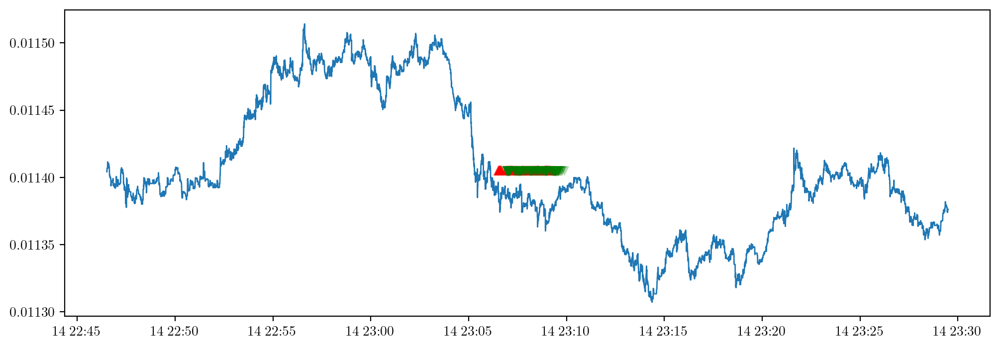

In [ ]:
buy_thres(13)

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, start, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def score_plot(id, weight = 2000):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ret = get_returns(td[id])
    print(np.std(ret))
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()

    long = fast_mmtm(id, weight = weight) / (10**4 * np.std(ret))**2
    ax1.plot(long, c='b')
    ax1.axhline(-4.5, c = 'black')

def buy_thres(id, thres = -4.5, interval = 10, N = 600):
    ret = get_returns(td[id])
    score = fast_mmtm(id, weight = 2000) / (10**4 * np.std(ret))**2
    buy_pos = score[score <= thres]
    trade_data = to_df(td[id])

    if len(buy_pos) == 0:
        return 'no times in pos that are below threshold. no trades performed'
    
    stopping_time = get_opt_stopping_time_batched(id, buy_pos.index[0], N, 50, 2, 10, interval=interval, batches=[10, 2])
    print(stopping_time)

    sell_pos_ind = buy_pos.index + timedelta(seconds=0.1 * interval * int(stopping_time))

    buy = np.zeros((len(buy_pos), 2))
    sell = np.zeros((len(buy_pos), 2))

    for i in range(len(buy_pos)):
        buy[i, :] = [fulfill_order(trade_data, buy_pos.index[i], 1000 * abs(buy_pos[i]), -1), 1000 * abs(buy_pos[i])]
        sell[i, :] = [fulfill_order(trade_data, buy_pos.index[i] + timedelta(seconds=0.1 * interval * int(stopping_time)), 1000 * abs(buy_pos[i]), 1), 1000 * abs(buy_pos[i])]

    df_buy = pd.DataFrame(data = buy, index = buy_pos.index, columns = ['change', 'vol'])
    df_sell = pd.DataFrame(data = sell, index = sell_pos_ind, columns = ['change', 'vol'])
    print(np.sum(sell[:, 0]) + np.sum(buy[:, 0]) )
    plt.plot(trade_data['bid_p1'])
    plt.plot(df_buy.index, np.mean(trade_data['bid_p1']) * np.ones(len(buy_pos)), marker = '^', c = 'r',alpha = 0.2)
    plt.plot(df_sell.index, np.mean(trade_data['bid_p1']) * np.ones(len(buy_pos)), marker = 'v', c = 'g', alpha = 0.2)
    return pd.concat((df_buy, df_sell))

100%|██████████| 10/10 [00:23<00:00,  2.31s/it]

17.62
4.33963568328727


,change,vol
timestamp,,
2024-06-14 23:06:30.600,-79.52786,"6,981.64001"
2024-06-14 23:06:30.700,-82.65669,"7,256.71212"
2024-06-14 23:06:31.300,-81.72244,"7,175.68525"
2024-06-14 23:06:31.900,-100.06071,"8,790.36394"
2024-06-14 23:06:32.000,-100.70545,"8,847.62585"
...,...,...
2024-06-14 23:09:31.400,56.39180,"4,953.88951"
2024-06-14 23:09:31.500,52.86048,"4,643.48308"
2024-06-14 23:09:35.600,53.14139,"4,667.32161"


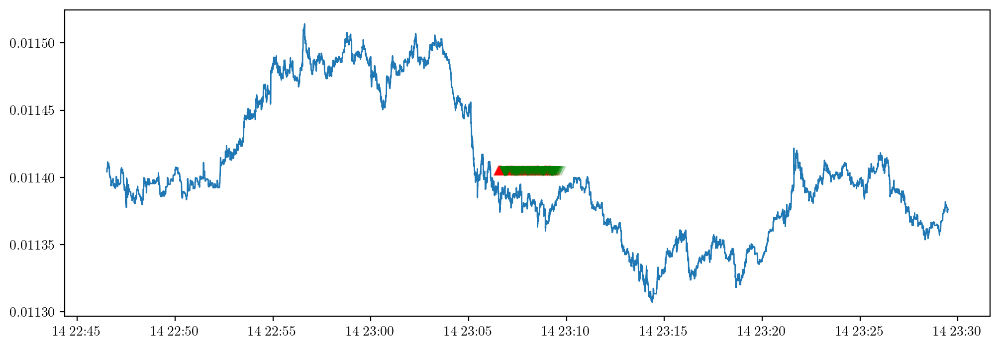

In [ ]:
buy_thres(13)

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, start, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def score_plot(id, weight = 2000):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ret = get_returns(td[id])
    print(np.std(ret))
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()

    long = fast_mmtm(id, weight = weight) / (10**4 * np.std(ret))**2
    ax1.plot(long, c='b')
    ax1.axhline(-4.5, c = 'black')

def buy_thres(id, thres = -4.5, interval = 10, N = 600):
    ret = get_returns(td[id])
    score = fast_mmtm(id, weight = 2000) / (10**4 * np.std(ret))**2
    buy_pos = score[score <= thres]
    trade_data = to_df(td[id])

    if len(buy_pos) == 0:
        return 'no times in pos that are below threshold. no trades performed'
    
    stopping_time = get_opt_stopping_time_batched(id, buy_pos.index[0], N, 50, 2, 10, interval=interval, batches=[10, 2])
    print(stopping_time)

    sell_pos_ind = buy_pos.index + timedelta(seconds=0.1 * interval * int(stopping_time))

    buy = np.zeros((len(buy_pos), 2))
    sell = np.zeros((len(buy_pos), 2))

    for i in range(len(buy_pos)):
        buy[i, :] = [fulfill_order(trade_data, buy_pos.index[i], int(1000 * abs(buy_pos[i]), -1)), int(1000 * abs(buy_pos[i]))]
        sell[i, :] = [fulfill_order(trade_data, buy_pos.index[i] + timedelta(seconds=0.1 * interval * int(stopping_time)), int(1000 * abs(buy_pos[i])), 1), int(1000 * abs(buy_pos[i]))]

    df_buy = pd.DataFrame(data = buy, index = buy_pos.index, columns = ['change', 'vol'])
    df_sell = pd.DataFrame(data = sell, index = sell_pos_ind, columns = ['change', 'vol'])
    print(np.sum(sell[:, 0]) + np.sum(buy[:, 0]) )
    plt.plot(trade_data['bid_p1'])
    plt.plot(df_buy.index, np.mean(trade_data['bid_p1']) * np.ones(len(buy_pos)), marker = '^', c = 'r',alpha = 0.2)
    plt.plot(df_sell.index, np.mean(trade_data['bid_p1']) * np.ones(len(buy_pos)), marker = 'v', c = 'g', alpha = 0.2)
    return pd.concat((df_buy, df_sell))

In [ ]:
buy_thres(130)

100%|██████████| 10/10 [00:23<00:00,  2.35s/it]

534.01


ValueError: int() base must be >= 2 and <= 36, or 0

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, start, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def score_plot(id, weight = 2000):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ret = get_returns(td[id])
    print(np.std(ret))
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()

    long = fast_mmtm(id, weight = weight) / (10**4 * np.std(ret))**2
    ax1.plot(long, c='b')
    ax1.axhline(-4.5, c = 'black')

def buy_thres(id, thres = -4.5, interval = 10, N = 600):
    ret = get_returns(td[id])
    score = fast_mmtm(id, weight = 2000) / (10**4 * np.std(ret))**2
    buy_pos = score[score <= thres]
    trade_data = to_df(td[id])

    if len(buy_pos) == 0:
        return 'no times in pos that are below threshold. no trades performed'
    
    stopping_time = get_opt_stopping_time_batched(id, buy_pos.index[0], N, 50, 2, 10, interval=interval, batches=[10, 2])
    print(stopping_time)

    sell_pos_ind = buy_pos.index + timedelta(seconds=0.1 * interval * int(stopping_time))

    buy = np.zeros((len(buy_pos), 2))
    sell = np.zeros((len(buy_pos), 2))

    for i in range(len(buy_pos)):
        buy[i, :] = [fulfill_order(trade_data, buy_pos.index[i], int(1000 * abs(buy_pos[i])), -1), int(1000 * abs(buy_pos[i]))]
        sell[i, :] = [fulfill_order(trade_data, buy_pos.index[i] + timedelta(seconds=0.1 * interval * int(stopping_time)), int(1000 * abs(buy_pos[i])), 1), int(1000 * abs(buy_pos[i]))]

    df_buy = pd.DataFrame(data = buy, index = buy_pos.index, columns = ['change', 'vol'])
    df_sell = pd.DataFrame(data = sell, index = sell_pos_ind, columns = ['change', 'vol'])
    print(np.sum(sell[:, 0]) + np.sum(buy[:, 0]) )
    plt.plot(trade_data['bid_p1'])
    plt.plot(df_buy.index, np.mean(trade_data['bid_p1']) * np.ones(len(buy_pos)), marker = '^', c = 'r',alpha = 0.2)
    plt.plot(df_sell.index, np.mean(trade_data['bid_p1']) * np.ones(len(buy_pos)), marker = 'v', c = 'g', alpha = 0.2)
    return pd.concat((df_buy, df_sell))

100%|██████████| 10/10 [00:22<00:00,  2.28s/it]


558.46
-46.757598000000144


,change,vol
timestamp,,
2024-07-09 13:40:38.900,-47.75291,"5,274.00000"
2024-07-09 13:40:41.000,-49.41978,"5,459.00000"
2024-07-09 13:41:33.700,-53.26211,"5,893.00000"
2024-07-09 13:41:34.100,-57.39985,"6,352.00000"
2024-07-09 13:41:34.200,-59.57171,"6,593.00000"
...,...,...
2024-07-09 13:54:01.600,53.26536,"5,927.00000"
2024-07-09 13:54:04.300,54.42001,"6,054.00000"
2024-07-09 13:54:04.900,51.80591,"5,763.00000"


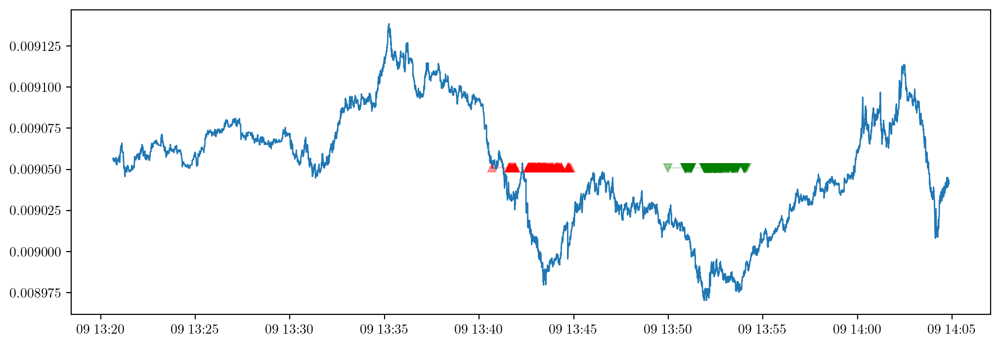

In [ ]:
buy_thres(130)

100%|██████████| 10/10 [00:23<00:00,  2.35s/it]


222.79999999999998
95.62281660000008


,change,vol
timestamp,,
2024-07-09 13:40:38.900,-47.75291,"5,274.00000"
2024-07-09 13:40:41.000,-49.41978,"5,459.00000"
2024-07-09 13:41:33.700,-53.26211,"5,893.00000"
2024-07-09 13:41:34.100,-57.39985,"6,352.00000"
2024-07-09 13:41:34.200,-59.57171,"6,593.00000"
...,...,...
2024-07-09 13:48:25.600,53.49295,"5,927.00000"
2024-07-09 13:48:28.300,54.64885,"6,054.00000"
2024-07-09 13:48:28.900,52.03009,"5,763.00000"


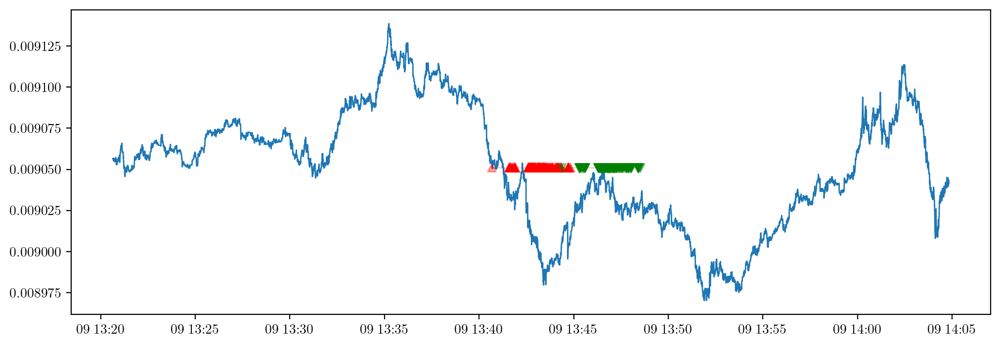

In [ ]:
buy_thres(130)

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, start, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def score_plot(id, weight = 2000):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ret = get_returns(td[id])
    print(np.std(ret))
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()

    long = fast_mmtm(id, weight = weight) / (10**4 * np.std(ret))**2
    ax1.plot(long, c='b')
    ax1.axhline(-4.5, c = 'black')

def buy_thres(id, thres = -4.5, interval = 10, N = 600, v = Trie):
    ret = get_returns(td[id])
    score = fast_mmtm(id, weight = 2000) / (10**4 * np.std(ret))**2
    buy_pos = score[score <= thres]
    trade_data = to_df(td[id])

    if len(buy_pos) == 0:
        return 'no times in pos that are below threshold. no trades performed'
    
    stopping_time = get_opt_stopping_time_batched(id, buy_pos.index[0], N, 50, 2, 10, interval=interval, batches=[10, 2])

    sell_pos_ind = buy_pos.index + timedelta(seconds=0.1 * interval * int(stopping_time))

    buy = np.zeros((len(buy_pos), 2))
    sell = np.zeros((len(buy_pos), 2))

    for i in range(len(buy_pos)):
        buy[i, :] = [fulfill_order(trade_data, buy_pos.index[i], int(1000 * abs(buy_pos[i])), -1), int(1000 * abs(buy_pos[i]))]
        sell[i, :] = [fulfill_order(trade_data, buy_pos.index[i] + timedelta(seconds=0.1 * interval * int(stopping_time)), int(1000 * abs(buy_pos[i])), 1), int(1000 * abs(buy_pos[i]))]

    df_buy = pd.DataFrame(data = buy, index = buy_pos.index, columns = ['change', 'vol'])
    df_sell = pd.DataFrame(data = sell, index = sell_pos_ind, columns = ['change', 'vol'])
    if v == True:
        print(stopping_time)
        print(np.sum(sell[:, 0]) + np.sum(buy[:, 0]) )
        plt.plot(trade_data['bid_p1'])
        plt.plot(df_buy.index, np.mean(trade_data['bid_p1']) * np.ones(len(buy_pos)), marker = '^', c = 'r',alpha = 0.2)
        plt.plot(df_sell.index, np.mean(trade_data['bid_p1']) * np.ones(len(buy_pos)), marker = 'v', c = 'g', alpha = 0.2)
        return pd.concat((df_buy, df_sell))
    else:
        return np.array([np.sum(buy[:, 0]), np.sum(sell[:, 0]), np.sum(sell[:, 0]) + np.sum(buy[:, 0]), np.sum(buy[:, 1])])

NameError: name 'Trie' is not defined

100%|██████████| 10/10 [00:23<00:00,  2.31s/it]


227.01999999999998
93.78431189999537


,change,vol
timestamp,,
2024-07-09 13:40:38.900,-47.75291,"5,274.00000"
2024-07-09 13:40:41.000,-49.41978,"5,459.00000"
2024-07-09 13:41:33.700,-53.26211,"5,893.00000"
2024-07-09 13:41:34.100,-57.39985,"6,352.00000"
2024-07-09 13:41:34.200,-59.57171,"6,593.00000"
...,...,...
2024-07-09 13:48:30.600,53.52081,"5,927.00000"
2024-07-09 13:48:33.300,54.67852,"6,054.00000"
2024-07-09 13:48:33.900,52.05718,"5,763.00000"


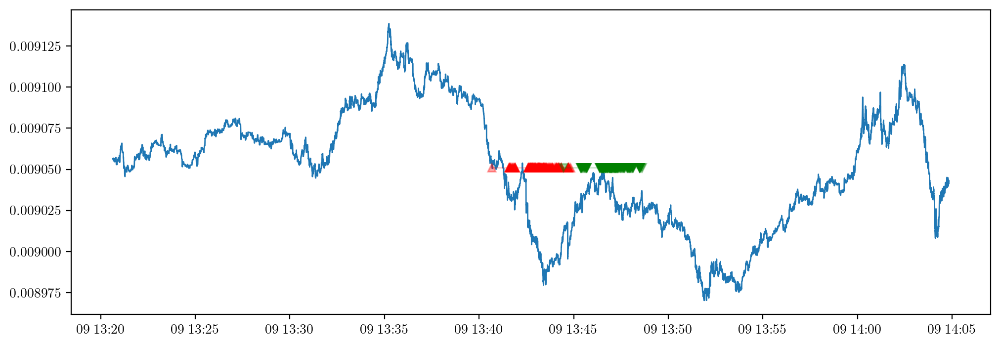

In [ ]:
buy_thres(130)

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched
from multiprocessing import Pool

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, start, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def score_plot(id, weight = 2000):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ret = get_returns(td[id])
    print(np.std(ret))
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()

    long = fast_mmtm(id, weight = weight) / (10**4 * np.std(ret))**2
    ax1.plot(long, c='b')
    ax1.axhline(-4.5, c = 'black')

def buy_thres(id, thres = -4.5, interval = 20, N = 600, v = True):
    ret = get_returns(td[id])
    score = fast_mmtm(id, weight = 2000) / (10**4 * np.std(ret))**2
    buy_pos = score[score <= thres]
    trade_data = to_df(td[id])

    if len(buy_pos) == 0:
        return 'no times in pos that are below threshold. no trades performed'
    
    stopping_time = get_opt_stopping_time_batched(id, buy_pos.index[0], N, 50, 2, 10, interval=interval, batches=[10, 2])

    sell_pos_ind = buy_pos.index + timedelta(seconds=0.1 * interval * int(stopping_time))

    buy = np.zeros((len(buy_pos), 2))
    sell = np.zeros((len(buy_pos), 2))

    for i in range(len(buy_pos)):
        buy[i, :] = [fulfill_order(trade_data, buy_pos.index[i], int(1000 * abs(buy_pos[i])), -1), int(1000 * abs(buy_pos[i]))]
        sell[i, :] = [fulfill_order(trade_data, buy_pos.index[i] + timedelta(seconds=0.1 * interval * int(stopping_time)), int(1000 * abs(buy_pos[i])), 1), int(1000 * abs(buy_pos[i]))]

    df_buy = pd.DataFrame(data = buy, index = buy_pos.index, columns = ['change', 'vol'])
    df_sell = pd.DataFrame(data = sell, index = sell_pos_ind, columns = ['change', 'vol'])
    if v == True:
        print(stopping_time)
        print(np.sum(sell[:, 0]) + np.sum(buy[:, 0]) )
        plt.plot(trade_data['bid_p1'])
        plt.plot(df_buy.index, np.mean(trade_data['bid_p1']) * np.ones(len(buy_pos)), marker = '^', c = 'r',alpha = 0.2)
        plt.plot(df_sell.index, np.mean(trade_data['bid_p1']) * np.ones(len(buy_pos)), marker = 'v', c = 'g', alpha = 0.2)
        return pd.concat((df_buy, df_sell))
    else:
        return np.array([np.sum(buy[:, 0]), np.sum(sell[:, 0]), np.sum(sell[:, 0]) + np.sum(buy[:, 0]), np.sum(buy[:, 1])])

100%|██████████| 10/10 [00:21<00:00,  2.18s/it]


472.47
120.52928140000222


,change,vol
timestamp,,
2024-07-09 13:40:38.900,-47.75291,"5,274.00000"
2024-07-09 13:40:41.000,-49.41978,"5,459.00000"
2024-07-09 13:41:33.700,-53.26211,"5,893.00000"
2024-07-09 13:41:34.100,-57.39985,"6,352.00000"
2024-07-09 13:41:34.200,-59.57171,"6,593.00000"
...,...,...
2024-07-09 14:00:27.600,53.84232,"5,927.00000"
2024-07-09 14:00:30.300,54.94145,"6,054.00000"
2024-07-09 14:00:30.900,52.29692,"5,763.00000"


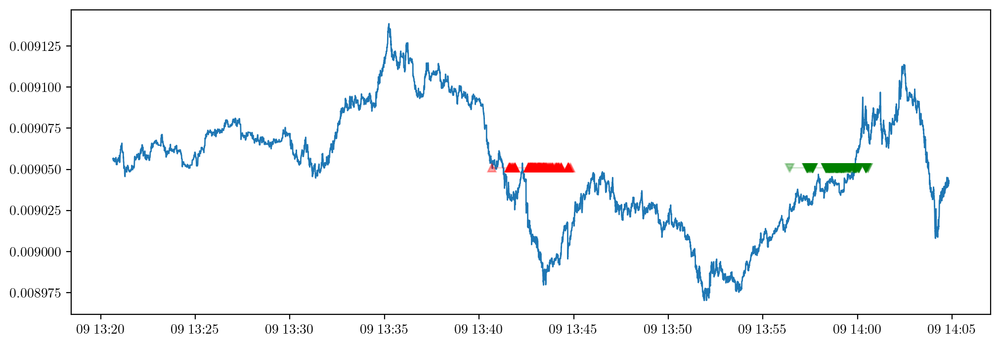

In [ ]:
buy_thres(130)

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched
from multiprocess import Pool

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, start, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def score_plot(id, weight = 2000):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ret = get_returns(td[id])
    print(np.std(ret))
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()

    long = fast_mmtm(id, weight = weight) / (10**4 * np.std(ret))**2
    ax1.plot(long, c='b')
    ax1.axhline(-4.5, c = 'black')

def buy_thres(id, thres = -4.5, interval = 20, N = 600, v = False):
    ret = get_returns(td[id])
    score = fast_mmtm(id, weight = 2000) / (10**4 * np.std(ret))**2
    buy_pos = score[score <= thres]
    trade_data = to_df(td[id])

    if len(buy_pos) == 0:
        return 'no times in pos that are below threshold. no trades performed'
    
    stopping_time = get_opt_stopping_time_batched(id, buy_pos.index[0], N, 50, 2, 10, interval=interval, batches=[10, 2])

    sell_pos_ind = buy_pos.index + timedelta(seconds=0.1 * interval * int(stopping_time))

    buy = np.zeros((len(buy_pos), 2))
    sell = np.zeros((len(buy_pos), 2))

    for i in range(len(buy_pos)):
        buy[i, :] = [fulfill_order(trade_data, buy_pos.index[i], int(1000 * abs(buy_pos[i])), -1), int(1000 * abs(buy_pos[i]))]
        sell[i, :] = [fulfill_order(trade_data, buy_pos.index[i] + timedelta(seconds=0.1 * interval * int(stopping_time)), int(1000 * abs(buy_pos[i])), 1), int(1000 * abs(buy_pos[i]))]

    df_buy = pd.DataFrame(data = buy, index = buy_pos.index, columns = ['change', 'vol'])
    df_sell = pd.DataFrame(data = sell, index = sell_pos_ind, columns = ['change', 'vol'])
    if v == True:
        print(stopping_time)
        print(np.sum(sell[:, 0]) + np.sum(buy[:, 0]) )
        plt.plot(trade_data['bid_p1'])
        plt.plot(df_buy.index, np.mean(trade_data['bid_p1']) * np.ones(len(buy_pos)), marker = '^', c = 'r',alpha = 0.2)
        plt.plot(df_sell.index, np.mean(trade_data['bid_p1']) * np.ones(len(buy_pos)), marker = 'v', c = 'g', alpha = 0.2)
        return pd.concat((df_buy, df_sell))
    else:
        return np.array([np.sum(buy[:, 0]), np.sum(sell[:, 0]), np.sum(sell[:, 0]) + np.sum(buy[:, 0]), np.sum(buy[:, 1])])

def get_res(i):
        print(i)
        return buy_thres(i, v = False)
    
if __name__ == '__main__':
    with Pool() as p:
        res = p.map(get_res, np.arange(523))

2814042567084


98112



126




  0%|          | 0/10 [00:00<?, ?it/s]

71

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

1


  0%|          | 0/10 [00:00<?, ?it/s]

113


 10%|█         | 1/10 [00:00<00:08,  1.11it/s]

114


  0%|          | 0/10 [00:00<?, ?it/s]

140


  0%|          | 0/10 [00:00<?, ?it/s]

154


  0%|          | 0/10 [00:00<?, ?it/s]

168


  0%|          | 0/10 [00:00<?, ?it/s]

182


 80%|████████  | 8/10 [00:07<00:01,  1.08it/s]

196
155
210
183
224


  0%|          | 0/10 [00:00<?, ?it/s]

238


  0%|          | 0/10 [00:00<?, ?it/s]

156


 90%|█████████ | 9/10 [00:08<00:00,  1.02it/s]

252
225


  0%|          | 0/10 [00:00<?, ?it/s]

157
253


  0%|          | 0/10 [00:00<?, ?it/s]

158
254
266


 20%|██        | 2/10 [00:01<00:07,  1.06it/s]

255


 30%|███       | 3/10 [00:02<00:06,  1.05it/s]

256


 20%|██        | 2/10 [00:01<00:07,  1.12it/s]

257


 40%|████      | 4/10 [00:03<00:05,  1.11it/s]

258


 50%|█████     | 5/10 [00:04<00:04,  1.12it/s]

259


 50%|█████     | 5/10 [00:04<00:04,  1.11it/s]

260


 50%|█████     | 5/10 [00:04<00:04,  1.11it/s]

261


 70%|███████   | 7/10 [00:06<00:02,  1.10it/s]

262


 60%|██████    | 6/10 [00:05<00:03,  1.09it/s]

263


 80%|████████  | 8/10 [00:07<00:01,  1.13it/s]

280


  0%|          | 0/10 [00:00<?, ?it/s]

294


 20%|██        | 2/10 [00:01<00:07,  1.07it/s]

308


 90%|█████████ | 9/10 [00:08<00:00,  1.10it/s]

322


  0%|          | 0/10 [00:00<?, ?it/s]

336
309


  0%|          | 0/10 [00:00<?, ?it/s]

350


 20%|██        | 2/10 [00:01<00:07,  1.10it/s]

364


 10%|█         | 1/10 [00:00<00:08,  1.07it/s]

365


  0%|          | 0/10 [00:00<?, ?it/s]

378


 10%|█         | 1/10 [00:00<00:08,  1.06it/s]

366


  0%|          | 0/10 [00:00<?, ?it/s]

392


 90%|█████████ | 9/10 [00:08<00:00,  1.13it/s]

406


  0%|          | 0/10 [00:00<?, ?it/s]

420


 10%|█         | 1/10 [00:00<00:07,  1.16it/s]

421


 80%|████████  | 8/10 [00:07<00:01,  1.13it/s]

434

 80%|████████  | 8/10 [00:07<00:01,  1.13it/s]

 20%|██        | 2/10 [00:01<00:07,  1.10it/s]

448


 90%|█████████ | 9/10 [00:07<00:00,  1.12it/s]

462

 90%|█████████ | 9/10 [00:08<00:00,  1.04it/s]

 10%|█         | 1/10 [00:00<00:08,  1.07it/s]

476


 90%|█████████ | 9/10 [00:08<00:00,  1.09it/s]

477


  0%|          | 0/10 [00:00<?, ?it/s]

490


 20%|██        | 2/10 [00:01<00:07,  1.05it/s]

504


 20%|██        | 2/10 [00:01<00:07,  1.06it/s]

518


  0%|          | 0/10 [00:00<?, ?it/s]

491


 20%|██        | 2/10 [00:01<00:07,  1.05it/s]

505


 30%|███       | 3/10 [00:02<00:06,  1.08it/s]

506


  0%|          | 0/10 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched
from multiprocess import Pool

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, start, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def score_plot(id, weight = 2000):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ret = get_returns(td[id])
    print(np.std(ret))
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()

    long = fast_mmtm(id, weight = weight) / (10**4 * np.std(ret))**2
    ax1.plot(long, c='b')
    ax1.axhline(-4.5, c = 'black')

def buy_thres(id, thres = -4.5, interval = 20, N = 600, v = False):
    ret = get_returns(td[id])
    score = fast_mmtm(id, weight = 2000) / (10**4 * np.std(ret))**2
    buy_pos = score[score <= thres]
    trade_data = to_df(td[id])

    if len(buy_pos) == 0:
        return 'no times in pos that are below threshold. no trades performed'
    
    stopping_time = get_opt_stopping_time_batched(id, buy_pos.index[0], N, 50, 2, 10, interval=interval, batches=[10, 2])

    sell_pos_ind = buy_pos.index + timedelta(seconds=0.1 * interval * int(stopping_time))

    buy = np.zeros((len(buy_pos), 2))
    sell = np.zeros((len(buy_pos), 2))

    for i in range(len(buy_pos)):
        buy[i, :] = [fulfill_order(trade_data, buy_pos.index[i], int(1000 * abs(buy_pos[i])), -1), int(1000 * abs(buy_pos[i]))]
        sell[i, :] = [fulfill_order(trade_data, buy_pos.index[i] + timedelta(seconds=0.1 * interval * int(stopping_time)), int(1000 * abs(buy_pos[i])), 1), int(1000 * abs(buy_pos[i]))]

    df_buy = pd.DataFrame(data = buy, index = buy_pos.index, columns = ['change', 'vol'])
    df_sell = pd.DataFrame(data = sell, index = sell_pos_ind, columns = ['change', 'vol'])
    if v == True:
        print(stopping_time)
        print(np.sum(sell[:, 0]) + np.sum(buy[:, 0]) )
        plt.plot(trade_data['bid_p1'])
        plt.plot(df_buy.index, np.mean(trade_data['bid_p1']) * np.ones(len(buy_pos)), marker = '^', c = 'r',alpha = 0.2)
        plt.plot(df_sell.index, np.mean(trade_data['bid_p1']) * np.ones(len(buy_pos)), marker = 'v', c = 'g', alpha = 0.2)
        return pd.concat((df_buy, df_sell))
    else:
        return np.array([np.sum(buy[:, 0]), np.sum(sell[:, 0]), np.sum(sell[:, 0]) + np.sum(buy[:, 0]), np.sum(buy[:, 1])])

def get_res(i):
        #print(i)
        return buy_thres(i, v = False)
    
if __name__ == '__main__':
    with Pool() as p:
        res = tqdm(p.imap(get_res, np.arange(523)))

0it [00:00, ?it/s]

In [ ]:
res

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched
from multiprocess import Pool

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, start, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def score_plot(id, weight = 2000):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ret = get_returns(td[id])
    print(np.std(ret))
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()

    long = fast_mmtm(id, weight = weight) / (10**4 * np.std(ret))**2
    ax1.plot(long, c='b')
    ax1.axhline(-4.5, c = 'black')

def buy_thres(id, thres = -4.5, interval = 20, N = 600, v = False):
    ret = get_returns(td[id])
    score = fast_mmtm(id, weight = 2000) / (10**4 * np.std(ret))**2
    buy_pos = score[score <= thres]
    trade_data = to_df(td[id])

    if len(buy_pos) == 0:
        return 'no times in pos that are below threshold. no trades performed'
    
    stopping_time = get_opt_stopping_time_batched(id, buy_pos.index[0], N, 50, 2, 10, interval=interval, batches=[10, 2])

    sell_pos_ind = buy_pos.index + timedelta(seconds=0.1 * interval * int(stopping_time))

    buy = np.zeros((len(buy_pos), 2))
    sell = np.zeros((len(buy_pos), 2))

    for i in range(len(buy_pos)):
        buy[i, :] = [fulfill_order(trade_data, buy_pos.index[i], int(1000 * abs(buy_pos[i])), -1), int(1000 * abs(buy_pos[i]))]
        sell[i, :] = [fulfill_order(trade_data, buy_pos.index[i] + timedelta(seconds=0.1 * interval * int(stopping_time)), int(1000 * abs(buy_pos[i])), 1), int(1000 * abs(buy_pos[i]))]

    df_buy = pd.DataFrame(data = buy, index = buy_pos.index, columns = ['change', 'vol'])
    df_sell = pd.DataFrame(data = sell, index = sell_pos_ind, columns = ['change', 'vol'])
    if v == True:
        print(stopping_time)
        print(np.sum(sell[:, 0]) + np.sum(buy[:, 0]) )
        plt.plot(trade_data['bid_p1'])
        plt.plot(df_buy.index, np.mean(trade_data['bid_p1']) * np.ones(len(buy_pos)), marker = '^', c = 'r',alpha = 0.2)
        plt.plot(df_sell.index, np.mean(trade_data['bid_p1']) * np.ones(len(buy_pos)), marker = 'v', c = 'g', alpha = 0.2)
        return pd.concat((df_buy, df_sell))
    else:
        return np.array([np.sum(buy[:, 0]), np.sum(sell[:, 0]), np.sum(sell[:, 0]) + np.sum(buy[:, 0]), np.sum(buy[:, 1])])

def get_res(i):
        print(i)
        return buy_thres(i, v = False)
    
if __name__ == '__main__':
    with Pool() as p:
        res = p.imap(get_res, np.arange(523))

In [ ]:
from analysis import *
from optimal_stopping_times import get_opt_stopping_time_batched
from multiprocess import Pool

def graph_opt_sell(id, interval, N = 600):
    pos_data = to_df(pos[id])
    td_data = to_df(td[id])
    start = pos_data.index[int((len(pos_data.index)/2))]
    opt_stop = get_opt_stopping_time_batched(id, start, N, 50, 2, 10, interval=interval, batches=[10, 2])
    end = start + timedelta(seconds= 0.1 * int(interval * opt_stop))
    print(opt_stop)

    fig, ax = plt.subplots()
    ax.set(xmargin = 0, title = maketitle(td[id], td_data), xlabel = "timestamp")
    ax.plot([start], td_data["ask_p1"].at_time(start) * (0.9987), marker = "^", color = "red", markersize = '4', alpha = 0.8)
    ax.plot([end], td_data["bid_p1"].at_time(end) * (1.0013), marker = "v", color = "green", markersize = '4', alpha = 0.8)
    ax.plot(td_data.index, td_data["bid_p1"])
    print(td_data["ask_p1"].at_time(end).values - td_data["bid_p1"].at_time(start).values)
    
def score_plot(id, weight = 2000):
    fig, ax = plt.subplots()
    p = to_df(pos[id])
    tdd = to_df(td[id])
    ret = get_returns(td[id])
    print(np.std(ret))
    ax.plot(tdd[p.index[0]-timedelta(minutes=2):p.index[-1] + timedelta(minutes=2)]['bid_p1'])
    ax.set(xmargin = 0)
    ax1 = ax.twinx()

    long = fast_mmtm(id, weight = weight) / (10**4 * np.std(ret))**2
    ax1.plot(long, c='b')
    ax1.axhline(-4.5, c = 'black')

def buy_thres(id, thres = -4.5, interval = 20, N = 600, v = False):
    ret = get_returns(td[id])
    score = fast_mmtm(id, weight = 2000) / (10**4 * np.std(ret))**2
    buy_pos = score[score <= thres]
    trade_data = to_df(td[id])

    if len(buy_pos) == 0:
        return 'no times in pos that are below threshold. no trades performed'
    
    stopping_time = get_opt_stopping_time_batched(id, buy_pos.index[0], N, 50, 2, 10, interval=interval, batches=[10, 2])

    sell_pos_ind = buy_pos.index + timedelta(seconds=0.1 * interval * int(stopping_time))

    buy = np.zeros((len(buy_pos), 2))
    sell = np.zeros((len(buy_pos), 2))

    for i in range(len(buy_pos)):
        buy[i, :] = [fulfill_order(trade_data, buy_pos.index[i], int(1000 * abs(buy_pos[i])), -1), int(1000 * abs(buy_pos[i]))]
        sell[i, :] = [fulfill_order(trade_data, buy_pos.index[i] + timedelta(seconds=0.1 * interval * int(stopping_time)), int(1000 * abs(buy_pos[i])), 1), int(1000 * abs(buy_pos[i]))]

    df_buy = pd.DataFrame(data = buy, index = buy_pos.index, columns = ['change', 'vol'])
    df_sell = pd.DataFrame(data = sell, index = sell_pos_ind, columns = ['change', 'vol'])
    if v == True:
        print(stopping_time)
        print(np.sum(sell[:, 0]) + np.sum(buy[:, 0]) )
        plt.plot(trade_data['bid_p1'])
        plt.plot(df_buy.index, np.mean(trade_data['bid_p1']) * np.ones(len(buy_pos)), marker = '^', c = 'r',alpha = 0.2)
        plt.plot(df_sell.index, np.mean(trade_data['bid_p1']) * np.ones(len(buy_pos)), marker = 'v', c = 'g', alpha = 0.2)
        return pd.concat((df_buy, df_sell))
    else:
        return np.array([np.sum(buy[:, 0]), np.sum(sell[:, 0]), np.sum(sell[:, 0]) + np.sum(buy[:, 0]), np.sum(buy[:, 1])])

def get_res(i):
        print(i)
        return buy_thres(i, v = False)
    
if __name__ == '__main__':
    with Pool() as p:
        res = p.map(get_res, np.arange(523))

1400285642708411298126









71
1
113
114
140
154
168
182
196
155
210
183
224
238
156
225
252
157
253
266
254158

255
256
257
258
259
260
261
262
263
280
294
308
322
309
336
350
364
378
392
365
366
406
420
421
434
448
462
476
490
504477

491
518
505
506
